In [1]:
%matplotlib inline

import gym
import matplotlib
import numpy as np
import sys

from collections import defaultdict

if "../" not in sys.path:
  sys.path.append("../") 
from lib.envs.blackjack import BlackjackEnv
from lib import plotting

matplotlib.style.use('ggplot')

In [2]:
env = BlackjackEnv()

In [6]:
def mc_prediction(policy, env, num_episodes, discount_factor=1.0):
    """
    Monte Carlo prediction algorithm. Calculates the value function
    for a given policy using sampling.
    
    Args:
        policy: A function that maps an observation to action probabilities.
        env: OpenAI gym environment.
        num_episodes: Number of episodes to sample.
        discount_factor: Gamma discount factor.
    
    Returns:
        A dictionary that maps from state -> value.
        The state is a tuple and the value is a float.
    """

    # Keeps track of sum and count of returns for each state
    # to calculate an average. We could use an array to save all
    # returns (like in the book) but that's memory inefficient.
    returns_sum = defaultdict(float)
    returns_count = defaultdict(float)
    
    # The final value function
    V = defaultdict(float)
    
    for i_episode in range(1, num_episodes + 1):
        # Print out which episode we're on, useful for debugging.
        if i_episode % 1000 == 0:
            print("\rEpisode {}/{}.".format(i_episode, num_episodes), end="")
            sys.stdout.flush()

        # Generate an episode.
        # An episode is an array of (state, action, reward) tuples
        episode = []
        state = env.reset()
        for t in range(100):
            action = policy(state)
            next_state, reward, done, _ = env.step(action)
            episode.append((state, action, reward))
            if done:
                break
            state = next_state
        # Find all states the we've visited in this episode
        # We convert each state to a tuple so that we can use it as a dict key
        states_in_episode = set([tuple(x[0]) for x in episode])
        for state in states_in_episode:
            # Find the first occurance of the state in the episode
            first_occurence_idx = next(i for i,x in enumerate(episode) if x[0] == state)
            # Sum up all rewards since the first occurance
            G = sum([x[2]*(discount_factor**i) for i,x in enumerate(episode[first_occurence_idx:])])
            # Calculate average return for this state over all sampled episodes
            returns_sum[state] += G
            returns_count[state] += 1.0
            V[state] = returns_sum[state] / returns_count[state]

    return V    

In [7]:
def sample_policy(observation):
    """
    A policy that sticks if the player score is >= 20 and hits otherwise.
    """
    score, dealer_score, usable_ace = observation
    return 0 if score >= 20 else 1

[((16, 1, False), 1, -1)]
[((12, 9, False), 1, 0), ((17, 9, False), 1, -1)]
[((12, 3, False), 1, 0), ((18, 3, False), 1, -1)]
[((15, 8, True), 1, 0), ((14, 8, False), 1, 0), ((20, 8, False), 0, 1)]
[((15, 8, False), 1, -1)]
[((19, 5, False), 1, 0), ((20, 5, False), 0, 1)]
[((17, 10, True), 1, 0), ((17, 10, False), 1, -1)]
[((17, 10, False), 1, 0), ((20, 10, False), 0, 0)]
[((13, 10, False), 1, -1)]
[((20, 5, False), 0, 1)]
[((15, 10, False), 1, 0), ((18, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((12, 2, False), 1, -1)]
[((13, 8, True), 1, 0), ((13, 8, False), 1, -1)]
[((13, 9, False), 1, 0), ((17, 9, False), 1, 0), ((18, 9, False), 1, -1)]
[((17, 3, False), 1, -1)]
[((12, 1, False), 1, -1)]
[((13, 3, False), 1, 0), ((15, 3, False), 1, 0), ((16, 3, False), 1, 0), ((17, 3, False), 1, -1)]
[((19, 9, False), 1, -1)]
[((20, 10, False), 0, 1)]
[((15, 2, False), 1, 0), ((21, 2, False), 0, 1)]
[((19, 7, False), 1, -1)]
[((20, 10, False), 0, 1)]
[((12, 9, False), 1, -1)]
[((15, 3, False), 

Episode 1000/10000.[((15, 2, True), 1, 0), ((15, 2, False), 1, -1)]
[((14, 10, False), 1, 0), ((17, 10, False), 1, -1)]
[((16, 4, False), 1, -1)]
[((20, 6, True), 0, 1)]
[((19, 10, False), 1, -1)]
[((12, 7, False), 1, -1)]
[((13, 3, False), 1, 0), ((17, 3, False), 1, -1)]
[((16, 4, True), 1, 0), ((19, 4, True), 1, 0), ((18, 4, False), 1, -1)]
[((17, 2, False), 1, -1)]
[((18, 9, False), 1, -1)]
[((19, 1, False), 1, -1)]
[((19, 10, False), 1, -1)]
[((13, 10, True), 1, 0), ((13, 10, False), 1, -1)]
[((21, 6, True), 0, 1)]
[((12, 10, False), 1, -1)]
[((15, 8, False), 1, 0), ((16, 8, False), 1, 0), ((18, 8, False), 1, 0), ((20, 8, False), 0, 0)]
[((13, 10, False), 1, -1)]
[((14, 5, False), 1, -1)]
[((15, 6, False), 1, 0), ((17, 6, False), 1, -1)]
[((17, 7, False), 1, -1)]
[((15, 10, False), 1, -1)]
[((15, 5, False), 1, -1)]
[((18, 10, False), 1, -1)]
[((14, 4, True), 1, 0), ((12, 4, False), 1, -1)]
[((16, 7, False), 1, -1)]
[((19, 2, False), 1, 0), ((21, 2, False), 0, 1)]
[((19, 4, False), 

[((18, 9, False), 1, 0), ((21, 9, False), 0, 1)]
[((14, 10, False), 1, 0), ((20, 10, False), 0, 0)]
[((16, 2, False), 1, 0), ((18, 2, False), 1, -1)]
[((20, 10, False), 0, 1)]
[((16, 4, False), 1, 0), ((19, 4, False), 1, 0), ((21, 4, False), 0, 0)]
[((21, 8, True), 0, 1)]
[((13, 9, False), 1, 0), ((20, 9, False), 0, 1)]
[((17, 9, False), 1, -1)]
[((17, 6, False), 1, 0), ((19, 6, False), 1, -1)]
[((18, 9, False), 1, -1)]
[((17, 10, False), 1, 0), ((20, 10, False), 0, 1)]
[((19, 10, False), 1, -1)]
[((15, 8, False), 1, -1)]
[((12, 10, False), 1, 0), ((17, 10, False), 1, -1)]
[((13, 1, False), 1, -1)]
[((14, 3, False), 1, 0), ((19, 3, False), 1, -1)]
[((21, 4, True), 0, 1)]
[((17, 1, False), 1, -1)]
[((15, 9, False), 1, 0), ((16, 9, False), 1, 0), ((18, 9, False), 1, -1)]
[((18, 6, False), 1, -1)]
[((20, 8, False), 0, 1)]
[((18, 7, False), 1, -1)]
[((21, 1, True), 0, 1)]
[((15, 10, False), 1, -1)]
[((18, 4, False), 1, -1)]
[((21, 2, True), 0, 1)]
[((20, 4, True), 0, 1)]
[((16, 10, False),

Episode 2000/10000.[((12, 2, False), 1, -1)]
[((12, 8, False), 1, 0), ((19, 8, False), 1, -1)]
[((13, 10, False), 1, -1)]
[((13, 7, False), 1, 0), ((21, 7, False), 0, 1)]
[((18, 10, True), 1, 0), ((16, 10, False), 1, -1)]
[((13, 10, False), 1, -1)]
[((17, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((16, 3, False), 1, 0), ((18, 3, False), 1, -1)]
[((12, 10, False), 1, -1)]
[((14, 5, False), 1, 0), ((19, 5, False), 1, 0), ((20, 5, False), 0, 1)]
[((13, 10, False), 1, 0), ((18, 10, False), 1, -1)]
[((15, 9, False), 1, -1)]
[((14, 9, False), 1, 0), ((21, 9, False), 0, 1)]
[((18, 10, False), 1, 0), ((20, 10, False), 0, 1)]
[((16, 1, False), 1, -1)]
[((14, 3, False), 1, -1)]
[((21, 6, True), 0, 1)]
[((19, 9, False), 1, -1)]
[((18, 3, False), 1, -1)]
[((20, 7, False), 0, 1)]
[((17, 9, False), 1, -1)]
[((20, 10, False), 0, 1)]
[((17, 4, False), 1, -1)]
[((14, 9, False), 1, 0), ((16, 9, False), 1, 0), ((19, 9, False), 1, 0), ((20, 9, False), 0, 0)]
[((17, 1, False), 1, 0), ((20, 1, False), 0

[((12, 2, False), 1, 0), ((19, 2, False), 1, -1)]
[((13, 8, False), 1, 0), ((17, 8, False), 1, -1)]
[((14, 7, False), 1, 0), ((17, 7, False), 1, -1)]
[((21, 3, True), 0, 1)]
[((17, 9, False), 1, 0), ((20, 9, False), 0, 1)]
[((14, 4, False), 1, -1)]
[((15, 10, False), 1, 0), ((20, 10, False), 0, 1)]
[((17, 10, True), 1, 0), ((17, 10, False), 1, -1)]
[((15, 7, False), 1, -1)]
[((14, 10, False), 1, -1)]
[((13, 2, False), 1, 0), ((18, 2, False), 1, -1)]
[((18, 5, False), 1, -1)]
[((17, 9, True), 1, 0), ((19, 9, True), 1, 0), ((13, 9, False), 1, 0), ((21, 9, False), 0, 1)]
[((17, 3, False), 1, -1)]
[((12, 8, False), 1, -1)]
[((15, 7, False), 1, -1)]
[((21, 10, True), 0, 1)]
[((13, 10, False), 1, 0), ((17, 10, False), 1, -1)]
[((16, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((17, 2, False), 1, -1)]
[((13, 8, True), 1, 0), ((21, 8, True), 0, 0)]
[((13, 10, False), 1, 0), ((20, 10, False), 0, 0)]
[((15, 10, False), 1, 0), ((20, 10, False), 0, 1)]
[((14, 5, False), 1, -1)]
[((18, 10, False),

Episode 3000/10000.[((12, 1, False), 1, 0), ((21, 1, False), 0, 0)]
[((17, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((19, 1, True), 1, 0), ((12, 1, False), 1, 0), ((15, 1, False), 1, -1)]
[((14, 5, False), 1, -1)]
[((20, 10, False), 0, 1)]
[((17, 1, False), 1, -1)]
[((12, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((21, 8, True), 0, 0)]
[((21, 2, True), 0, 1)]
[((12, 3, False), 1, 0), ((15, 3, False), 1, -1)]
[((12, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((12, 7, False), 1, 0), ((13, 7, False), 1, -1)]
[((21, 10, False), 0, 1)]
[((17, 8, False), 1, -1)]
[((15, 10, False), 1, 0), ((17, 10, False), 1, -1)]
[((13, 7, False), 1, -1)]
[((16, 1, False), 1, -1)]
[((17, 7, False), 1, -1)]
[((16, 5, False), 1, -1)]
[((14, 10, False), 1, -1)]
[((16, 9, False), 1, 0), ((20, 9, False), 0, 1)]
[((18, 10, False), 1, -1)]
[((13, 10, False), 1, 0), ((17, 10, False), 1, -1)]
[((18, 2, True), 1, 0), ((18, 2, False), 1, 0), ((21, 2, False), 0, 1)]
[((20, 2, False), 0, 1)]
[((14, 9, False), 

[((18, 2, False), 1, -1)]
[((18, 10, False), 1, -1)]
[((13, 10, False), 1, -1)]
[((14, 2, True), 1, 0), ((14, 2, False), 1, -1)]
[((15, 10, False), 1, 0), ((16, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((16, 3, False), 1, -1)]
[((13, 1, False), 1, 0), ((21, 1, False), 0, 0)]
[((21, 8, False), 0, 1)]
[((17, 2, False), 1, 0), ((21, 2, False), 0, 1)]
[((16, 1, False), 1, -1)]
[((20, 4, False), 0, 1)]
[((18, 6, False), 1, -1)]
[((19, 2, False), 1, 0), ((21, 2, False), 0, 1)]
[((18, 10, False), 1, -1)]
[((20, 8, False), 0, 1)]
[((14, 6, False), 1, 0), ((20, 6, False), 0, 1)]
[((17, 8, False), 1, -1)]
[((14, 5, True), 1, 0), ((14, 5, False), 1, -1)]
[((17, 6, False), 1, -1)]
[((17, 4, False), 1, -1)]
[((12, 10, False), 1, 0), ((17, 10, False), 1, -1)]
[((19, 2, False), 1, 0), ((20, 2, False), 0, 1)]
[((13, 9, False), 1, 0), ((19, 9, False), 1, -1)]
[((16, 7, False), 1, -1)]
[((20, 7, False), 0, 1)]
[((21, 4, True), 0, 0)]
[((16, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((14, 10, Fal

Episode 4000/10000.[((18, 3, False), 1, -1)]
[((16, 6, False), 1, -1)]
[((13, 4, False), 1, 0), ((17, 4, False), 1, 0), ((21, 4, False), 0, 1)]
[((21, 3, False), 0, 0)]
[((21, 7, True), 0, 1)]
[((19, 1, False), 1, -1)]
[((13, 2, False), 1, 0), ((19, 2, False), 1, -1)]
[((18, 10, False), 1, -1)]
[((16, 10, False), 1, -1)]
[((18, 9, False), 1, -1)]
[((14, 2, False), 1, -1)]
[((20, 1, False), 0, -1)]
[((16, 10, False), 1, -1)]
[((14, 1, False), 1, -1)]
[((18, 9, False), 1, -1)]
[((14, 9, False), 1, 0), ((16, 9, False), 1, 0), ((18, 9, False), 1, -1)]
[((13, 7, False), 1, 0), ((14, 7, False), 1, -1)]
[((13, 1, False), 1, 0), ((18, 1, False), 1, -1)]
[((18, 7, False), 1, -1)]
[((18, 10, False), 1, -1)]
[((14, 10, False), 1, -1)]
[((12, 8, True), 1, 0), ((17, 8, True), 1, 0), ((17, 8, False), 1, 0), ((21, 8, False), 0, 1)]
[((12, 2, False), 1, 0), ((13, 2, False), 1, 0), ((14, 2, False), 1, 0), ((21, 2, False), 0, 1)]
[((19, 7, False), 1, -1)]
[((13, 4, False), 1, 0), ((21, 4, False), 0, 1)]

[((13, 2, False), 1, 0), ((14, 2, False), 1, 0), ((21, 2, False), 0, 1)]
[((15, 4, False), 1, 0), ((20, 4, False), 0, 1)]
[((17, 6, False), 1, -1)]
[((18, 10, True), 1, 0), ((18, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((17, 7, True), 1, 0), ((17, 7, False), 1, -1)]
[((14, 4, False), 1, 0), ((16, 4, False), 1, 0), ((17, 4, False), 1, 0), ((19, 4, False), 1, -1)]
[((21, 8, False), 0, 1)]
[((13, 4, False), 1, 0), ((20, 4, False), 0, 1)]
[((14, 10, False), 1, 0), ((16, 10, False), 1, -1)]
[((16, 1, False), 1, 0), ((20, 1, False), 0, 0)]
[((14, 1, False), 1, 0), ((19, 1, False), 1, -1)]
[((12, 3, False), 1, 0), ((19, 3, False), 1, 0), ((21, 3, False), 0, 1)]
[((15, 4, False), 1, 0), ((20, 4, False), 0, 1)]
[((16, 6, False), 1, -1)]
[((15, 3, False), 1, 0), ((21, 3, False), 0, 1)]
[((21, 5, True), 0, 1)]
[((14, 10, False), 1, 0), ((16, 10, False), 1, -1)]
[((17, 4, False), 1, -1)]
[((16, 8, True), 1, 0), ((12, 8, False), 1, -1)]
[((20, 10, False), 0, 1)]
[((15, 10, True), 1, 0), ((18, 

[((12, 6, False), 1, -1)]
[((13, 10, False), 1, 0), ((20, 10, False), 0, 0)]
[((13, 4, False), 1, -1)]
[((16, 7, False), 1, -1)]
[((20, 5, False), 0, 1)]
[((16, 5, False), 1, -1)]
[((13, 4, True), 1, 0), ((14, 4, True), 1, 0), ((15, 4, True), 1, 0), ((13, 4, False), 1, -1)]
[((21, 2, False), 0, 1)]
[((16, 7, False), 1, -1)]
[((13, 10, False), 1, 0), ((18, 10, False), 1, -1)]
[((21, 4, False), 0, 0)]
[((21, 7, False), 0, 1)]
[((19, 7, False), 1, -1)]
[((18, 4, True), 1, 0), ((20, 4, True), 0, 1)]
[((12, 1, False), 1, 0), ((21, 1, False), 0, 1)]
[((15, 9, False), 1, -1)]
[((17, 3, False), 1, -1)]
[((13, 6, False), 1, -1)]
[((21, 4, True), 0, 1)]
[((19, 7, False), 1, -1)]
[((13, 5, False), 1, 0), ((19, 5, False), 1, -1)]
[((15, 6, True), 1, 0), ((14, 6, False), 1, 0), ((21, 6, False), 0, 1)]
[((19, 10, True), 1, 0), ((12, 10, False), 1, 0), ((13, 10, False), 1, 0), ((18, 10, False), 1, -1)]
[((15, 6, False), 1, 0), ((20, 6, False), 0, 1)]
[((14, 10, False), 1, 0), ((19, 10, False), 1, -1)

[((13, 10, False), 1, -1)]
[((14, 10, False), 1, 0), ((20, 10, False), 0, 1)]
[((13, 3, False), 1, 0), ((18, 3, False), 1, -1)]
[((19, 7, False), 1, -1)]
[((19, 5, True), 1, 0), ((14, 5, False), 1, -1)]
[((17, 10, False), 1, -1)]
[((20, 1, False), 0, -1)]
[((19, 3, False), 1, -1)]
[((19, 1, True), 1, 0), ((17, 1, False), 1, -1)]
[((13, 10, True), 1, 0), ((20, 10, True), 0, 1)]
[((16, 6, False), 1, 0), ((18, 6, False), 1, 0), ((21, 6, False), 0, 1)]
[((19, 7, False), 1, -1)]
[((13, 5, False), 1, 0), ((21, 5, False), 0, 1)]
[((12, 2, False), 1, -1)]
[((20, 3, False), 0, 1)]
[((14, 10, False), 1, 0), ((19, 10, False), 1, 0), ((21, 10, False), 0, 0)]
[((15, 1, True), 1, 0), ((15, 1, False), 1, 0), ((16, 1, False), 1, -1)]
[((20, 9, True), 0, 1)]
[((18, 1, True), 1, 0), ((16, 1, False), 1, 0), ((21, 1, False), 0, 1)]
[((18, 6, False), 1, -1)]
[((20, 3, False), 0, -1)]
[((12, 10, False), 1, 0), ((18, 10, False), 1, -1)]
[((19, 6, False), 1, -1)]
[((13, 6, False), 1, 0), ((15, 6, False), 1, -

[((21, 10, True), 0, 1)]
[((18, 3, False), 1, -1)]
[((13, 7, False), 1, 0), ((17, 7, False), 1, 0), ((21, 7, False), 0, 1)]
[((14, 5, True), 1, 0), ((14, 5, False), 1, 0), ((17, 5, False), 1, -1)]
[((13, 10, False), 1, 0), ((16, 10, False), 1, -1)]
[((14, 4, False), 1, 0), ((20, 4, False), 0, -1)]
[((16, 10, True), 1, 0), ((16, 10, False), 1, -1)]
[((14, 4, False), 1, 0), ((16, 4, False), 1, 0), ((21, 4, False), 0, 1)]
[((17, 10, True), 1, 0), ((17, 10, False), 1, 0), ((20, 10, False), 0, 0)]
[((16, 6, True), 1, 0), ((18, 6, True), 1, 0), ((18, 6, False), 1, -1)]
[((15, 10, False), 1, -1)]
[((20, 1, True), 0, 1)]
[((13, 4, False), 1, 0), ((21, 4, False), 0, 1)]
[((20, 10, False), 0, 0)]
[((18, 10, False), 1, -1)]
[((20, 10, False), 0, 1)]
[((16, 6, False), 1, 0), ((21, 6, False), 0, 1)]
[((14, 10, False), 1, 0), ((15, 10, False), 1, 0), ((18, 10, False), 1, -1)]
[((15, 10, False), 1, 0), ((20, 10, False), 0, 1)]
[((17, 8, False), 1, -1)]
[((19, 4, False), 1, -1)]
[((16, 2, False), 1, 0

Episode 6000/10000.[((14, 10, False), 1, -1)]
[((19, 2, False), 1, -1)]
[((21, 1, True), 0, 1)]
[((13, 10, False), 1, 0), ((18, 10, False), 1, -1)]
[((20, 3, False), 0, 1)]
[((18, 7, False), 1, -1)]
[((14, 3, False), 1, 0), ((15, 3, False), 1, 0), ((16, 3, False), 1, 0), ((17, 3, False), 1, 0), ((20, 3, False), 0, 1)]
[((13, 4, False), 1, 0), ((16, 4, False), 1, 0), ((21, 4, False), 0, 1)]
[((15, 10, False), 1, -1)]
[((15, 5, False), 1, 0), ((16, 5, False), 1, 0), ((20, 5, False), 0, 1)]
[((15, 10, False), 1, 0), ((20, 10, False), 0, -1)]
[((20, 3, False), 0, 1)]
[((17, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((21, 1, True), 0, 1)]
[((14, 1, True), 1, 0), ((15, 1, True), 1, 0), ((15, 1, False), 1, -1)]
[((20, 7, True), 0, 1)]
[((19, 2, False), 1, -1)]
[((18, 7, False), 1, -1)]
[((18, 10, False), 1, 0), ((20, 10, False), 0, 1)]
[((17, 9, False), 1, -1)]
[((12, 9, False), 1, 0), ((14, 9, False), 1, 0), ((21, 9, False), 0, 1)]
[((16, 10, True), 1, 0), ((16, 10, False), 1, 0), ((18, 1

[((13, 2, False), 1, -1)]
[((21, 10, True), 0, 1)]
[((19, 5, False), 1, -1)]
[((16, 6, False), 1, -1)]
[((13, 1, False), 1, 0), ((17, 1, False), 1, -1)]
[((19, 4, False), 1, -1)]
[((15, 10, True), 1, 0), ((15, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((12, 10, True), 1, 0), ((17, 10, True), 1, 0), ((15, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((18, 10, False), 1, -1)]
[((17, 9, False), 1, -1)]
[((15, 9, False), 1, 0), ((21, 9, False), 0, 1)]
[((21, 6, True), 0, 1)]
[((15, 10, True), 1, 0), ((15, 10, False), 1, 0), ((20, 10, False), 0, 1)]
[((17, 9, False), 1, 0), ((21, 9, False), 0, 1)]
[((17, 4, False), 1, -1)]
[((16, 1, True), 1, 0), ((16, 1, False), 1, 0), ((17, 1, False), 1, -1)]
[((20, 7, False), 0, 1)]
[((16, 4, True), 1, 0), ((15, 4, False), 1, 0), ((16, 4, False), 1, -1)]
[((16, 10, False), 1, -1)]
[((15, 10, False), 1, -1)]
[((15, 9, False), 1, -1)]
[((15, 7, False), 1, 0), ((21, 7, False), 0, 1)]
[((16, 2, False), 1, -1)]
[((14, 10, False), 1, -1)]
[((20, 9, False), 

Episode 7000/10000.[((19, 9, False), 1, -1)]
[((20, 9, False), 0, 1)]
[((21, 2, True), 0, 0)]
[((17, 10, False), 1, 0), ((21, 10, False), 0, 0)]
[((12, 10, False), 1, -1)]
[((17, 10, False), 1, -1)]
[((18, 8, True), 1, 0), ((18, 8, False), 1, -1)]
[((13, 8, False), 1, 0), ((19, 8, False), 1, -1)]
[((15, 10, True), 1, 0), ((15, 10, False), 1, -1)]
[((20, 10, True), 0, 0)]
[((19, 2, False), 1, -1)]
[((16, 1, False), 1, -1)]
[((16, 2, False), 1, -1)]
[((19, 10, False), 1, -1)]
[((19, 10, False), 1, -1)]
[((20, 10, False), 0, -1)]
[((19, 10, True), 1, 0), ((17, 10, False), 1, -1)]
[((13, 5, False), 1, -1)]
[((15, 7, False), 1, -1)]
[((15, 10, False), 1, -1)]
[((17, 10, False), 1, -1)]
[((17, 3, False), 1, -1)]
[((12, 10, False), 1, 0), ((14, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((13, 9, False), 1, 0), ((18, 9, False), 1, -1)]
[((12, 6, True), 1, 0), ((12, 6, False), 1, -1)]
[((12, 10, False), 1, 0), ((17, 10, False), 1, -1)]
[((17, 1, False), 1, -1)]
[((15, 10, False), 1, 0), ((19

[((20, 10, False), 0, 1)]
[((16, 3, False), 1, 0), ((18, 3, False), 1, -1)]
[((19, 6, True), 1, 0), ((17, 6, False), 1, 0), ((21, 6, False), 0, 0)]
[((16, 4, False), 1, -1)]
[((18, 1, False), 1, -1)]
[((17, 6, False), 1, -1)]
[((15, 10, False), 1, -1)]
[((12, 1, False), 1, 0), ((18, 1, False), 1, -1)]
[((15, 6, False), 1, -1)]
[((15, 6, False), 1, -1)]
[((15, 8, False), 1, -1)]
[((21, 4, True), 0, 1)]
[((13, 10, False), 1, -1)]
[((16, 10, True), 1, 0), ((21, 10, True), 0, 0)]
[((18, 3, False), 1, 0), ((19, 3, False), 1, -1)]
[((13, 9, False), 1, 0), ((21, 9, False), 0, 1)]
[((14, 6, False), 1, 0), ((21, 6, False), 0, 1)]
[((19, 10, False), 1, -1)]
[((15, 1, False), 1, 0), ((19, 1, False), 1, -1)]
[((16, 5, False), 1, -1)]
[((18, 10, False), 1, -1)]
[((15, 3, False), 1, -1)]
[((13, 4, False), 1, -1)]
[((19, 1, False), 1, -1)]
[((12, 9, False), 1, 0), ((16, 9, False), 1, -1)]
[((21, 5, True), 0, 1)]
[((19, 7, True), 1, 0), ((21, 7, True), 0, 1)]
[((15, 6, False), 1, -1)]
[((20, 3, False)

[((13, 9, False), 1, -1)]
[((17, 2, False), 1, -1)]
[((13, 10, False), 1, 0), ((16, 10, False), 1, -1)]
[((17, 8, False), 1, -1)]
[((18, 1, False), 1, 0), ((19, 1, False), 1, -1)]
[((21, 6, False), 0, 1)]
[((13, 3, False), 1, 0), ((15, 3, False), 1, 0), ((20, 3, False), 0, -1)]
[((12, 9, True), 1, 0), ((13, 9, True), 1, 0), ((13, 9, False), 1, 0), ((21, 9, False), 0, 1)]
[((18, 10, True), 1, 0), ((17, 10, False), 1, -1)]
[((18, 10, False), 1, -1)]
[((14, 5, False), 1, 0), ((20, 5, False), 0, -1)]
[((14, 4, True), 1, 0), ((17, 4, True), 1, 0), ((13, 4, False), 1, 0), ((18, 4, False), 1, -1)]
[((13, 7, False), 1, -1)]
[((12, 6, False), 1, 0), ((17, 6, False), 1, -1)]
[((20, 8, True), 0, 1)]
[((17, 10, False), 1, -1)]
[((14, 10, False), 1, -1)]
[((15, 10, False), 1, -1)]
[((12, 10, False), 1, 0), ((16, 10, False), 1, 0), ((18, 10, False), 1, -1)]
[((12, 2, False), 1, -1)]
[((15, 2, False), 1, -1)]
[((12, 10, False), 1, 0), ((13, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((20, 5, True),

[((14, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((20, 10, False), 0, 1)]
[((17, 9, False), 1, 0), ((20, 9, False), 0, 0)]
[((12, 6, False), 1, 0), ((16, 6, False), 1, 0), ((17, 6, False), 1, -1)]
[((14, 10, False), 1, 0), ((15, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((18, 8, False), 1, -1)]
[((12, 10, False), 1, -1)]
[((20, 2, False), 0, 1)]
[((14, 3, False), 1, 0), ((19, 3, False), 1, -1)]
[((12, 8, True), 1, 0), ((17, 8, True), 1, 0), ((15, 8, False), 1, -1)]
[((15, 10, False), 1, -1)]
[((14, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((13, 9, False), 1, -1)]
[((13, 10, True), 1, 0), ((21, 10, True), 0, 1)]
[((19, 10, False), 1, -1)]
[((21, 10, True), 0, 1)]
[((19, 3, True), 1, 0), ((19, 3, False), 1, -1)]
[((14, 4, False), 1, -1)]
[((14, 10, False), 1, 0), ((20, 10, False), 0, -1)]
[((21, 9, True), 0, 1)]
[((16, 7, False), 1, -1)]
[((18, 3, False), 1, -1)]
[((12, 3, False), 1, 0), ((17, 3, False), 1, -1)]
[((17, 10, False), 1, -1)]
[((14, 1, False), 1, 0), ((19, 1, Fals

[((15, 5, False), 1, -1)]
[((19, 3, True), 1, 0), ((12, 3, False), 1, -1)]
[((13, 10, False), 1, 0), ((18, 10, False), 1, -1)]
[((13, 6, False), 1, 0), ((18, 6, False), 1, -1)]
[((14, 10, False), 1, 0), ((17, 10, False), 1, 0), ((20, 10, False), 0, 1)]
[((12, 7, False), 1, 0), ((18, 7, False), 1, -1)]
[((16, 6, False), 1, -1)]
[((16, 9, True), 1, 0), ((20, 9, True), 0, 1)]
[((21, 7, True), 0, 1)]
[((12, 10, False), 1, 0), ((17, 10, False), 1, -1)]
[((17, 1, False), 1, 0), ((20, 1, False), 0, 0)]
[((20, 9, False), 0, 0)]
[((13, 4, False), 1, 0), ((16, 4, False), 1, -1)]
[((15, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((14, 8, False), 1, 0), ((21, 8, False), 0, 0)]
[((20, 10, False), 0, 1)]
[((13, 2, False), 1, 0), ((14, 2, False), 1, -1)]
[((21, 7, False), 0, 1)]
[((17, 9, False), 1, -1)]
[((18, 7, False), 1, -1)]
[((15, 9, False), 1, -1)]
[((17, 10, False), 1, -1)]
[((19, 10, True), 1, 0), ((16, 10, False), 1, -1)]
[((20, 6, False), 0, 0)]
[((15, 9, False), 1, 0), ((16, 9, False),

[((16, 3, False), 1, -1)]
[((13, 10, False), 1, -1)]
[((14, 10, False), 1, -1)]
[((12, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((20, 10, False), 0, 1)]
[((13, 10, True), 1, 0), ((15, 10, True), 1, 0), ((21, 10, True), 0, 1)]
[((16, 4, True), 1, 0), ((18, 4, True), 1, 0), ((15, 4, False), 1, 0), ((17, 4, False), 1, 0), ((18, 4, False), 1, -1)]
[((14, 7, False), 1, -1)]
[((21, 3, True), 0, 0)]
[((12, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((12, 3, False), 1, 0), ((13, 3, False), 1, 0), ((15, 3, False), 1, -1)]
[((17, 6, False), 1, -1)]
[((13, 10, False), 1, 0), ((20, 10, False), 0, 1)]
[((19, 9, False), 1, -1)]
[((17, 10, False), 1, -1)]
[((14, 10, False), 1, -1)]
[((20, 10, False), 0, 0)]
[((13, 3, False), 1, -1)]
[((14, 10, False), 1, 0), ((21, 10, False), 0, 0)]
[((14, 4, False), 1, 0), ((15, 4, False), 1, 0), ((18, 4, False), 1, -1)]
[((15, 2, True), 1, 0), ((19, 2, True), 1, 0), ((13, 2, False), 1, 0), ((19, 2, False), 1, -1)]
[((13, 7, False), 1, -1)]
[((18, 1, False),

[((13, 10, False), 1, -1)]
[((12, 9, False), 1, 0), ((18, 9, False), 1, -1)]
[((21, 2, True), 0, 1)]
[((20, 3, False), 0, 1)]
[((13, 10, False), 1, -1)]
[((19, 2, False), 1, -1)]
[((20, 5, False), 0, -1)]
[((16, 10, False), 1, -1)]
[((18, 1, False), 1, 0), ((20, 1, False), 0, -1)]
[((12, 10, False), 1, -1)]
[((15, 10, False), 1, 0), ((18, 10, False), 1, -1)]
[((17, 9, False), 1, -1)]
[((18, 10, False), 1, -1)]
[((18, 10, False), 1, -1)]
[((12, 9, False), 1, 0), ((16, 9, False), 1, -1)]
[((20, 10, False), 0, 0)]
[((19, 9, False), 1, -1)]
[((19, 1, False), 1, -1)]
[((17, 5, False), 1, 0), ((20, 5, False), 0, 1)]
[((16, 7, False), 1, -1)]
[((15, 3, True), 1, 0), ((12, 3, False), 1, -1)]
[((16, 5, False), 1, 0), ((19, 5, False), 1, -1)]
[((16, 2, False), 1, -1)]
[((12, 10, True), 1, 0), ((19, 10, True), 1, 0), ((15, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((12, 6, False), 1, -1)]
[((16, 4, False), 1, -1)]
[((18, 9, False), 1, -1)]
[((14, 10, False), 1, -1)]
[((12, 9, True), 1, 0), ((

[((17, 2, False), 1, -1)]
[((13, 8, False), 1, 0), ((21, 8, False), 0, 1)]
[((14, 6, False), 1, -1)]
[((18, 7, False), 1, -1)]
[((12, 5, False), 1, 0), ((18, 5, False), 1, -1)]
[((18, 9, True), 1, 0), ((16, 9, False), 1, -1)]
[((15, 4, False), 1, -1)]
[((15, 6, False), 1, -1)]
[((19, 10, False), 1, -1)]
[((21, 10, False), 0, 1)]
[((20, 9, False), 0, 1)]
[((20, 10, False), 0, 1)]
[((16, 7, False), 1, -1)]
[((12, 5, False), 1, 0), ((19, 5, False), 1, -1)]
[((13, 6, False), 1, 0), ((18, 6, False), 1, -1)]
[((18, 10, False), 1, -1)]
[((14, 10, False), 1, 0), ((18, 10, False), 1, -1)]
[((15, 2, False), 1, -1)]
[((14, 10, False), 1, 0), ((20, 10, False), 0, 1)]
[((20, 10, False), 0, 1)]
[((21, 10, True), 0, 1)]
[((15, 10, False), 1, -1)]
[((20, 4, False), 0, 1)]
[((12, 7, False), 1, -1)]
[((13, 10, False), 1, -1)]
[((15, 4, False), 1, 0), ((17, 4, False), 1, -1)]
[((13, 7, False), 1, 0), ((18, 7, False), 1, -1)]
[((18, 6, True), 1, 0), ((18, 6, False), 1, 0), ((20, 6, False), 0, 1)]
[((14, 2

[((14, 8, False), 1, 0), ((19, 8, False), 1, -1)]
[((17, 7, True), 1, 0), ((17, 7, False), 1, -1)]
[((20, 10, True), 0, 1)]
[((18, 4, False), 1, -1)]
[((18, 9, False), 1, -1)]
[((14, 10, False), 1, 0), ((17, 10, False), 1, -1)]
[((18, 3, False), 1, -1)]
[((18, 1, False), 1, -1)]
[((16, 6, False), 1, 0), ((17, 6, False), 1, -1)]
[((16, 10, False), 1, -1)]
[((13, 6, False), 1, 0), ((19, 6, False), 1, -1)]
[((14, 3, False), 1, -1)]
[((19, 10, False), 1, -1)]
[((19, 5, False), 1, -1)]
[((16, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((17, 10, True), 1, 0), ((20, 10, True), 0, 0)]
[((20, 8, False), 0, 1)]
[((15, 5, False), 1, 0), ((20, 5, False), 0, 1)]
[((20, 5, False), 0, 1)]
[((12, 6, False), 1, -1)]
[((16, 9, False), 1, 0), ((21, 9, False), 0, 1)]
[((13, 10, False), 1, -1)]
[((19, 10, False), 1, -1)]
[((12, 10, False), 1, 0), ((17, 10, False), 1, -1)]
[((21, 10, True), 0, 1)]
[((12, 9, False), 1, 0), ((16, 9, False), 1, 0), ((18, 9, False), 1, -1)]
[((13, 2, False), 1, -1)]
[((19, 10

[((17, 4, False), 1, 0), ((18, 4, False), 1, -1)]
[((12, 3, False), 1, -1)]
[((18, 3, False), 1, 0), ((19, 3, False), 1, -1)]
[((20, 10, False), 0, 0)]
[((17, 6, False), 1, -1)]
[((13, 10, False), 1, 0), ((18, 10, False), 1, -1)]
[((20, 1, False), 0, -1)]
[((18, 3, True), 1, 0), ((19, 3, True), 1, 0), ((14, 3, False), 1, 0), ((16, 3, False), 1, -1)]
[((21, 4, True), 0, 1)]
[((18, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((16, 10, False), 1, -1)]
[((13, 10, False), 1, -1)]
[((17, 7, False), 1, 0), ((19, 7, False), 1, -1)]
[((12, 10, False), 1, -1)]
[((17, 9, False), 1, -1)]
[((17, 10, False), 1, -1)]
[((19, 8, False), 1, -1)]
[((19, 10, False), 1, -1)]
[((16, 9, False), 1, 0), ((17, 9, False), 1, -1)]
[((19, 1, False), 1, 0), ((20, 1, False), 0, -1)]
[((20, 10, False), 0, 1)]
[((13, 5, False), 1, 0), ((14, 5, False), 1, -1)]
[((12, 10, False), 1, 0), ((13, 10, False), 1, -1)]
[((20, 6, False), 0, 1)]
[((15, 1, False), 1, -1)]
[((13, 10, False), 1, 0), ((16, 10, False), 1, 0), ((17, 

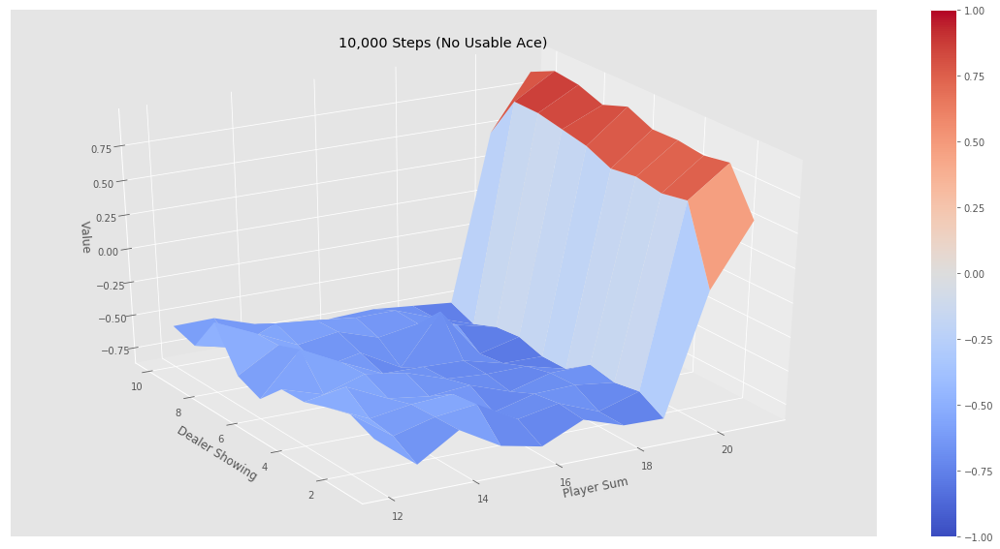

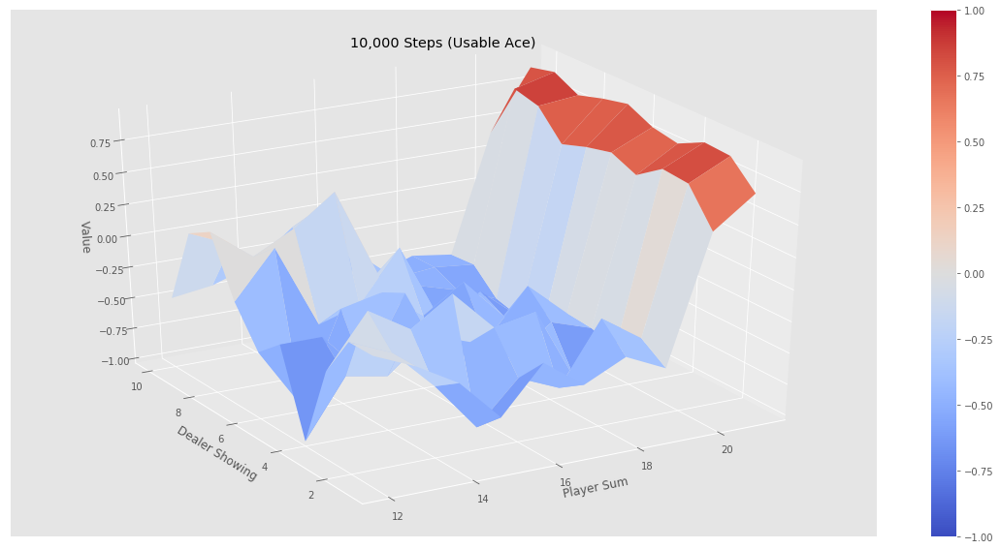

[((14, 6, False), 1, 0), ((21, 6, False), 0, 1)]
[((16, 5, False), 1, 0), ((20, 5, False), 0, 1)]
[((13, 1, False), 1, -1)]
[((19, 2, False), 1, -1)]
[((16, 10, True), 1, 0), ((16, 10, False), 1, -1)]
[((19, 2, False), 1, -1)]
[((17, 1, False), 1, -1)]
[((16, 8, False), 1, 0), ((19, 8, False), 1, 0), ((20, 8, False), 0, 1)]
[((17, 6, False), 1, -1)]
[((12, 3, False), 1, 0), ((21, 3, False), 0, 1)]
[((19, 10, False), 1, -1)]
[((13, 10, False), 1, -1)]
[((18, 7, False), 1, -1)]
[((12, 9, False), 1, 0), ((17, 9, False), 1, -1)]
[((16, 5, False), 1, 0), ((18, 5, False), 1, 0), ((20, 5, False), 0, 1)]
[((19, 1, False), 1, -1)]
[((20, 10, False), 0, 0)]
[((20, 9, False), 0, 1)]
[((12, 7, True), 1, 0), ((12, 7, False), 1, 0), ((20, 7, False), 0, 1)]
[((21, 7, False), 0, 1)]
[((12, 10, False), 1, -1)]
[((20, 4, False), 0, 1)]
[((12, 1, False), 1, 0), ((17, 1, False), 1, 0), ((21, 1, False), 0, 1)]
[((13, 7, False), 1, 0), ((19, 7, False), 1, -1)]
[((21, 1, True), 0, 0)]
[((18, 8, False), 1, 0)

Episode 1000/500000.[((15, 9, False), 1, -1)]
[((14, 4, False), 1, 0), ((17, 4, False), 1, 0), ((20, 4, False), 0, 1)]
[((14, 10, False), 1, -1)]
[((17, 6, False), 1, -1)]
[((16, 8, False), 1, 0), ((19, 8, False), 1, 0), ((20, 8, False), 0, 1)]
[((19, 9, False), 1, -1)]
[((15, 5, False), 1, -1)]
[((17, 9, False), 1, 0), ((19, 9, False), 1, -1)]
[((16, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((15, 1, False), 1, -1)]
[((15, 1, True), 1, 0), ((13, 1, False), 1, -1)]
[((20, 8, False), 0, 1)]
[((16, 5, False), 1, -1)]
[((14, 10, False), 1, -1)]
[((14, 10, False), 1, -1)]
[((12, 9, True), 1, 0), ((12, 9, False), 1, 0), ((14, 9, False), 1, -1)]
[((19, 10, False), 1, -1)]
[((21, 8, True), 0, 1)]
[((14, 8, False), 1, -1)]
[((18, 9, False), 1, -1)]
[((18, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((20, 3, False), 0, 1)]
[((12, 1, False), 1, 0), ((19, 1, False), 1, -1)]
[((20, 2, False), 0, 0)]
[((13, 1, False), 1, -1)]
[((16, 10, False), 1, -1)]
[((20, 8, False), 0, 1)]
[((15, 3, False

[((14, 2, False), 1, -1)]
[((20, 9, False), 0, 1)]
[((19, 3, False), 1, -1)]
[((14, 5, False), 1, -1)]
[((18, 10, False), 1, -1)]
[((20, 7, False), 0, 1)]
[((12, 5, False), 1, -1)]
[((14, 7, False), 1, 0), ((16, 7, False), 1, 0), ((20, 7, False), 0, 1)]
[((16, 10, False), 1, 0), ((18, 10, False), 1, -1)]
[((13, 6, False), 1, 0), ((15, 6, False), 1, 0), ((21, 6, False), 0, 1)]
[((20, 5, False), 0, 1)]
[((14, 5, False), 1, 0), ((19, 5, False), 1, 0), ((21, 5, False), 0, 1)]
[((19, 9, False), 1, 0), ((20, 9, False), 0, 1)]
[((19, 7, False), 1, -1)]
[((20, 10, False), 0, 1)]
[((21, 10, False), 0, 1)]
[((17, 10, False), 1, -1)]
[((21, 10, True), 0, 1)]
[((21, 5, True), 0, 1)]
[((15, 5, False), 1, -1)]
[((13, 2, False), 1, 0), ((21, 2, False), 0, 1)]
[((20, 8, False), 0, 1)]
[((19, 10, False), 1, -1)]
[((20, 2, False), 0, 1)]
[((14, 1, False), 1, -1)]
[((12, 2, False), 1, 0), ((19, 2, False), 1, -1)]
[((15, 5, True), 1, 0), ((12, 5, False), 1, 0), ((21, 5, False), 0, 1)]
[((12, 5, False), 1,

Episode 2000/500000.[((18, 10, False), 1, 0), ((20, 10, False), 0, 1)]
[((14, 5, False), 1, -1)]
[((12, 2, False), 1, 0), ((15, 2, False), 1, -1)]
[((20, 4, False), 0, 1)]
[((18, 6, False), 1, -1)]
[((12, 6, False), 1, 0), ((20, 6, False), 0, 0)]
[((21, 9, True), 0, 1)]
[((14, 3, False), 1, -1)]
[((17, 8, False), 1, -1)]
[((14, 10, False), 1, -1)]
[((14, 10, False), 1, -1)]
[((15, 8, False), 1, 0), ((21, 8, False), 0, 1)]
[((12, 10, False), 1, -1)]
[((12, 10, False), 1, 0), ((18, 10, False), 1, -1)]
[((18, 10, False), 1, -1)]
[((16, 2, False), 1, -1)]
[((13, 10, False), 1, 0), ((20, 10, False), 0, 1)]
[((13, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((18, 5, False), 1, -1)]
[((19, 3, False), 1, -1)]
[((12, 7, True), 1, 0), ((15, 7, True), 1, 0), ((19, 7, True), 1, 0), ((21, 7, True), 0, 1)]
[((12, 8, False), 1, 0), ((13, 8, False), 1, 0), ((20, 8, False), 0, 1)]
[((14, 10, False), 1, -1)]
[((15, 5, False), 1, -1)]
[((12, 9, False), 1, 0), ((14, 9, False), 1, 0), ((16, 9, False), 1,

[((19, 8, False), 1, -1)]
[((17, 8, False), 1, 0), ((19, 8, False), 1, -1)]
[((20, 10, False), 0, 0)]
[((14, 4, False), 1, 0), ((15, 4, False), 1, -1)]
[((17, 3, False), 1, -1)]
[((12, 10, False), 1, 0), ((17, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((14, 1, False), 1, -1)]
[((21, 6, True), 0, 1)]
[((15, 2, False), 1, -1)]
[((16, 10, False), 1, -1)]
[((16, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((19, 10, False), 1, -1)]
[((21, 8, False), 0, 1)]
[((15, 10, False), 1, 0), ((17, 10, False), 1, -1)]
[((17, 8, False), 1, -1)]
[((14, 10, False), 1, -1)]
[((21, 8, True), 0, 1)]
[((12, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((14, 10, False), 1, 0), ((16, 10, False), 1, 0), ((18, 10, False), 1, -1)]
[((20, 2, False), 0, 1)]
[((13, 6, False), 1, 0), ((19, 6, False), 1, -1)]
[((16, 10, True), 1, 0), ((18, 10, True), 1, 0), ((17, 10, False), 1, -1)]
[((20, 8, False), 0, 1)]
[((15, 10, False), 1, -1)]
[((12, 10, False), 1, 0), ((13, 10, False), 1, -1)]
[((19, 10, False), 1, -1)]
[(

[((20, 10, False), 0, 1)]
[((17, 10, False), 1, -1)]
[((17, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((20, 8, False), 0, 1)]
[((12, 7, True), 1, 0), ((20, 7, True), 0, 1)]
[((19, 2, False), 1, -1)]
[((20, 7, False), 0, 1)]
[((14, 8, False), 1, -1)]
[((21, 6, True), 0, 1)]
[((18, 6, False), 1, -1)]
[((16, 6, False), 1, -1)]
[((12, 4, False), 1, 0), ((14, 4, False), 1, 0), ((20, 4, False), 0, -1)]
[((21, 8, True), 0, 1)]
[((12, 7, False), 1, -1)]
[((16, 6, False), 1, 0), ((20, 6, False), 0, 1)]
[((13, 3, False), 1, -1)]
[((20, 8, False), 0, -1)]
[((17, 10, False), 1, 0), ((20, 10, False), 0, 1)]
[((15, 4, False), 1, 0), ((18, 4, False), 1, -1)]
[((15, 9, True), 1, 0), ((14, 9, False), 1, 0), ((18, 9, False), 1, -1)]
[((16, 8, False), 1, -1)]
[((21, 2, True), 0, 1)]
[((12, 2, False), 1, 0), ((21, 2, False), 0, 1)]
[((18, 9, False), 1, -1)]
[((19, 2, False), 1, -1)]
[((12, 10, False), 1, 0), ((14, 10, False), 1, 0), ((15, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((13, 10, False), 

Episode 3000/500000.[((13, 2, False), 1, 0), ((19, 2, False), 1, -1)]
[((21, 2, True), 0, 0)]
[((20, 8, False), 0, 1)]
[((17, 9, True), 1, 0), ((12, 9, False), 1, -1)]
[((18, 7, False), 1, 0), ((21, 7, False), 0, 0)]
[((13, 6, False), 1, -1)]
[((19, 4, False), 1, -1)]
[((15, 8, False), 1, -1)]
[((12, 5, True), 1, 0), ((17, 5, True), 1, 0), ((19, 5, True), 1, 0), ((19, 5, False), 1, 0), ((20, 5, False), 0, 0)]
[((15, 8, False), 1, 0), ((16, 8, False), 1, -1)]
[((15, 10, True), 1, 0), ((15, 10, False), 1, 0), ((20, 10, False), 0, 1)]
[((19, 3, False), 1, -1)]
[((15, 8, True), 1, 0), ((14, 8, False), 1, -1)]
[((17, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((19, 2, False), 1, -1)]
[((12, 5, False), 1, 0), ((14, 5, False), 1, -1)]
[((16, 3, False), 1, -1)]
[((13, 6, True), 1, 0), ((18, 6, True), 1, 0), ((13, 6, False), 1, 0), ((16, 6, False), 1, -1)]
[((21, 3, True), 0, 1)]
[((12, 10, False), 1, -1)]
[((14, 8, False), 1, 0), ((15, 8, False), 1, -1)]
[((13, 2, True), 1, 0), ((12, 2, Fals

[((20, 3, False), 0, 1)]
[((12, 7, False), 1, 0), ((13, 7, False), 1, 0), ((16, 7, False), 1, -1)]
[((16, 7, False), 1, -1)]
[((15, 1, False), 1, 0), ((19, 1, False), 1, -1)]
[((16, 10, True), 1, 0), ((16, 10, False), 1, 0), ((20, 10, False), 0, 1)]
[((16, 7, True), 1, 0), ((12, 7, False), 1, 0), ((16, 7, False), 1, 0), ((17, 7, False), 1, 0), ((18, 7, False), 1, -1)]
[((12, 5, False), 1, 0), ((20, 5, False), 0, 0)]
[((17, 7, False), 1, -1)]
[((20, 10, False), 0, 0)]
[((13, 2, False), 1, -1)]
[((17, 8, False), 1, -1)]
[((17, 1, False), 1, -1)]
[((13, 8, False), 1, 0), ((15, 8, False), 1, -1)]
[((18, 7, False), 1, -1)]
[((13, 7, False), 1, 0), ((19, 7, False), 1, -1)]
[((12, 3, False), 1, -1)]
[((18, 10, True), 1, 0), ((13, 10, False), 1, -1)]
[((18, 10, True), 1, 0), ((15, 10, False), 1, 0), ((16, 10, False), 1, -1)]
[((12, 6, False), 1, 0), ((14, 6, False), 1, -1)]
[((15, 10, False), 1, 0), ((16, 10, False), 1, 0), ((20, 10, False), 0, 0)]
[((17, 8, False), 1, -1)]
[((19, 9, True), 1,

[((17, 10, False), 1, 0), ((18, 10, False), 1, -1)]
[((13, 4, False), 1, -1)]
[((21, 7, True), 0, 1)]
[((16, 3, False), 1, -1)]
[((13, 6, False), 1, 0), ((21, 6, False), 0, 0)]
[((14, 8, False), 1, 0), ((19, 8, False), 1, -1)]
[((13, 7, False), 1, 0), ((19, 7, False), 1, -1)]
[((12, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((16, 3, False), 1, 0), ((18, 3, False), 1, -1)]
[((12, 9, False), 1, 0), ((18, 9, False), 1, 0), ((19, 9, False), 1, -1)]
[((19, 10, False), 1, -1)]
[((16, 3, False), 1, -1)]
[((12, 6, True), 1, 0), ((13, 6, True), 1, 0), ((12, 6, False), 1, -1)]
[((20, 10, False), 0, 0)]
[((15, 6, False), 1, -1)]
[((18, 7, False), 1, -1)]
[((14, 2, False), 1, -1)]
[((18, 1, False), 1, -1)]
[((17, 5, False), 1, -1)]
[((19, 2, False), 1, -1)]
[((17, 2, False), 1, 0), ((18, 2, False), 1, 0), ((20, 2, False), 0, 1)]
[((19, 2, False), 1, -1)]
[((12, 10, False), 1, 0), ((18, 10, False), 1, -1)]
[((15, 2, False), 1, 0), ((17, 2, False), 1, 0), ((19, 2, False), 1, 0), ((21, 2, False), 

Episode 4000/500000.[((20, 9, False), 0, 0)]
[((20, 5, True), 0, 1)]
[((16, 2, True), 1, 0), ((12, 2, False), 1, 0), ((19, 2, False), 1, -1)]
[((17, 3, False), 1, -1)]
[((15, 7, False), 1, -1)]
[((17, 4, False), 1, -1)]
[((15, 9, False), 1, -1)]
[((14, 10, False), 1, -1)]
[((14, 7, False), 1, -1)]
[((16, 8, False), 1, 0), ((20, 8, False), 0, 1)]
[((12, 3, False), 1, 0), ((16, 3, False), 1, -1)]
[((20, 8, False), 0, 1)]
[((16, 5, False), 1, -1)]
[((14, 3, True), 1, 0), ((14, 3, False), 1, 0), ((19, 3, False), 1, 0), ((21, 3, False), 0, 1)]
[((12, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((20, 10, True), 0, 0)]
[((21, 10, False), 0, 0)]
[((17, 3, True), 1, 0), ((12, 3, False), 1, 0), ((17, 3, False), 1, -1)]
[((18, 3, False), 1, 0), ((19, 3, False), 1, -1)]
[((13, 2, False), 1, 0), ((15, 2, False), 1, 0), ((16, 2, False), 1, -1)]
[((14, 6, False), 1, 0), ((21, 6, False), 0, 1)]
[((14, 1, False), 1, -1)]
[((14, 3, False), 1, -1)]
[((12, 10, False), 1, 0), ((16, 10, False), 1, 0), ((1

[((12, 2, False), 1, 0), ((16, 2, False), 1, 0), ((17, 2, False), 1, -1)]
[((19, 5, False), 1, -1)]
[((21, 10, False), 0, 1)]
[((12, 4, False), 1, 0), ((21, 4, False), 0, 1)]
[((20, 4, False), 0, 1)]
[((14, 1, False), 1, -1)]
[((20, 6, False), 0, 1)]
[((12, 7, False), 1, 0), ((21, 7, False), 0, 1)]
[((16, 7, False), 1, 0), ((21, 7, False), 0, 1)]
[((16, 2, False), 1, 0), ((19, 2, False), 1, -1)]
[((18, 9, False), 1, -1)]
[((15, 9, False), 1, -1)]
[((19, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((15, 7, True), 1, 0), ((20, 7, True), 0, 1)]
[((15, 3, False), 1, -1)]
[((12, 6, False), 1, -1)]
[((17, 6, False), 1, -1)]
[((12, 9, False), 1, 0), ((19, 9, False), 1, -1)]
[((15, 3, False), 1, -1)]
[((12, 3, False), 1, -1)]
[((14, 2, False), 1, 0), ((21, 2, False), 0, 1)]
[((14, 1, False), 1, 0), ((16, 1, False), 1, -1)]
[((19, 4, False), 1, -1)]
[((14, 6, False), 1, 0), ((18, 6, False), 1, -1)]
[((20, 7, False), 0, 1)]
[((17, 10, False), 1, -1)]
[((16, 6, False), 1, -1)]
[((13, 10, False),

[((19, 7, False), 1, -1)]
[((20, 6, False), 0, 1)]
[((18, 10, False), 1, -1)]
[((21, 10, True), 0, 1)]
[((21, 6, False), 0, 1)]
[((15, 10, False), 1, -1)]
[((15, 10, False), 1, -1)]
[((17, 10, False), 1, -1)]
[((18, 10, False), 1, -1)]
[((13, 10, False), 1, 0), ((15, 10, False), 1, -1)]
[((18, 4, False), 1, -1)]
[((16, 8, False), 1, -1)]
[((15, 4, False), 1, -1)]
[((21, 2, True), 0, 1)]
[((15, 10, False), 1, -1)]
[((13, 3, False), 1, -1)]
[((14, 10, False), 1, -1)]
[((14, 4, False), 1, 0), ((17, 4, False), 1, -1)]
[((12, 10, False), 1, 0), ((15, 10, False), 1, -1)]
[((16, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((15, 6, False), 1, -1)]
[((16, 8, False), 1, -1)]
[((12, 7, False), 1, 0), ((18, 7, False), 1, -1)]
[((17, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((16, 5, True), 1, 0), ((12, 5, False), 1, -1)]
[((16, 10, False), 1, -1)]
[((20, 7, False), 0, -1)]
[((15, 10, False), 1, 0), ((18, 10, False), 1, -1)]
[((12, 10, False), 1, -1)]
[((17, 4, False), 1, 0), ((21, 4, False), 

[((20, 2, False), 0, 1)]
[((15, 9, False), 1, 0), ((19, 9, False), 1, -1)]
[((12, 10, False), 1, -1)]
[((13, 2, False), 1, -1)]
[((18, 10, False), 1, -1)]
[((14, 10, False), 1, 0), ((16, 10, False), 1, 0), ((17, 10, False), 1, -1)]
[((13, 9, False), 1, 0), ((19, 9, False), 1, -1)]
[((19, 3, True), 1, 0), ((20, 3, True), 0, 1)]
[((13, 10, False), 1, 0), ((15, 10, False), 1, 0), ((17, 10, False), 1, -1)]
[((14, 6, True), 1, 0), ((13, 6, False), 1, -1)]
[((15, 10, False), 1, 0), ((17, 10, False), 1, -1)]
[((18, 9, False), 1, -1)]
[((20, 4, False), 0, 1)]
[((19, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((21, 1, True), 0, 1)]
[((18, 10, False), 1, -1)]
[((12, 3, False), 1, 0), ((15, 3, False), 1, 0), ((17, 3, False), 1, 0), ((18, 3, False), 1, -1)]
[((16, 10, False), 1, 0), ((18, 10, False), 1, -1)]
[((17, 3, False), 1, -1)]
[((15, 6, False), 1, -1)]
[((19, 6, True), 1, 0), ((16, 6, False), 1, -1)]
[((17, 9, True), 1, 0), ((21, 9, True), 0, 1)]
[((13, 10, False), 1, -1)]
[((20, 5, False

[((17, 10, False), 1, 0), ((20, 10, False), 0, 0)]
[((18, 10, False), 1, -1)]
[((21, 3, False), 0, 1)]
[((17, 10, False), 1, 0), ((18, 10, False), 1, -1)]
[((17, 4, False), 1, -1)]
[((17, 4, False), 1, -1)]
[((14, 9, False), 1, 0), ((18, 9, False), 1, -1)]
[((13, 4, False), 1, -1)]
[((12, 1, True), 1, 0), ((12, 1, False), 1, 0), ((14, 1, False), 1, 0), ((19, 1, False), 1, -1)]
[((18, 3, False), 1, -1)]
[((12, 10, False), 1, 0), ((15, 10, False), 1, -1)]
[((14, 5, False), 1, 0), ((19, 5, False), 1, -1)]
[((14, 3, False), 1, -1)]
[((21, 1, True), 0, 1)]
[((17, 5, False), 1, 0), ((20, 5, False), 0, 1)]
[((17, 5, False), 1, -1)]
[((18, 2, False), 1, -1)]
[((20, 3, False), 0, 1)]
[((14, 3, False), 1, -1)]
[((15, 3, False), 1, -1)]
[((12, 5, False), 1, 0), ((16, 5, False), 1, -1)]
[((12, 10, False), 1, 0), ((17, 10, False), 1, -1)]
[((20, 10, False), 0, 1)]
[((16, 3, False), 1, -1)]
[((17, 10, False), 1, -1)]
[((18, 4, False), 1, -1)]
[((13, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((20,

[((15, 4, True), 1, 0), ((18, 4, True), 1, 0), ((13, 4, False), 1, 0), ((21, 4, False), 0, 1)]
[((21, 4, True), 0, 1)]
[((15, 7, False), 1, 0), ((19, 7, False), 1, -1)]
[((17, 9, False), 1, -1)]
[((13, 10, False), 1, 0), ((17, 10, False), 1, -1)]
[((15, 10, False), 1, 0), ((20, 10, False), 0, 0)]
[((20, 5, False), 0, 0)]
[((20, 2, True), 0, 1)]
[((19, 10, False), 1, -1)]
[((21, 10, True), 0, 1)]
[((13, 8, False), 1, 0), ((21, 8, False), 0, 1)]
[((13, 7, False), 1, 0), ((21, 7, False), 0, 1)]
[((12, 10, False), 1, -1)]
[((12, 10, False), 1, -1)]
[((19, 6, False), 1, -1)]
[((12, 3, False), 1, 0), ((13, 3, False), 1, 0), ((19, 3, False), 1, -1)]
[((20, 10, False), 0, -1)]
[((14, 10, False), 1, -1)]
[((19, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((13, 10, False), 1, -1)]
[((16, 8, False), 1, -1)]
[((21, 10, True), 0, 1)]
[((18, 9, False), 1, -1)]
[((20, 3, False), 0, 1)]
[((15, 10, False), 1, 0), ((20, 10, False), 0, 0)]
[((12, 10, False), 1, 0), ((18, 10, False), 1, -1)]
[((20, 10, T

[((15, 6, True), 1, 0), ((15, 6, False), 1, -1)]
[((21, 10, True), 0, 0)]
[((18, 3, False), 1, -1)]
[((12, 3, False), 1, 0), ((13, 3, False), 1, -1)]
[((13, 10, True), 1, 0), ((15, 10, True), 1, 0), ((16, 10, True), 1, 0), ((16, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((15, 9, False), 1, -1)]
[((15, 10, False), 1, -1)]
[((13, 5, False), 1, 0), ((20, 5, False), 0, 1)]
[((18, 2, False), 1, -1)]
[((17, 5, True), 1, 0), ((20, 5, True), 0, 1)]
[((18, 9, False), 1, 0), ((19, 9, False), 1, 0), ((21, 9, False), 0, 1)]
[((14, 1, False), 1, -1)]
[((17, 9, False), 1, 0), ((19, 9, False), 1, -1)]
[((19, 1, True), 1, 0), ((19, 1, False), 1, 0), ((21, 1, False), 0, 1)]
[((13, 5, False), 1, 0), ((14, 5, False), 1, 0), ((18, 5, False), 1, -1)]
[((20, 1, False), 0, 1)]
[((16, 5, False), 1, 0), ((19, 5, False), 1, -1)]
[((19, 5, False), 1, -1)]
[((15, 10, False), 1, -1)]
[((17, 8, False), 1, -1)]
[((15, 1, False), 1, 0), ((19, 1, False), 1, -1)]
[((14, 10, True), 1, 0), ((21, 10, True), 0, 1)]
[((2

Episode 7000/500000.[((19, 10, False), 1, -1)]
[((17, 10, False), 1, -1)]
[((21, 6, True), 0, 1)]
[((12, 10, False), 1, 0), ((14, 10, False), 1, 0), ((19, 10, False), 1, 0), ((20, 10, False), 0, 0)]
[((19, 1, True), 1, 0), ((17, 1, False), 1, 0), ((21, 1, False), 0, 1)]
[((12, 4, False), 1, 0), ((13, 4, False), 1, -1)]
[((13, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((12, 6, True), 1, 0), ((16, 6, True), 1, 0), ((16, 6, False), 1, 0), ((18, 6, False), 1, -1)]
[((13, 3, False), 1, 0), ((15, 3, False), 1, -1)]
[((12, 10, False), 1, -1)]
[((18, 8, False), 1, 0), ((20, 8, False), 0, 0)]
[((17, 4, False), 1, 0), ((21, 4, False), 0, 1)]
[((17, 1, False), 1, 0), ((20, 1, False), 0, -1)]
[((18, 10, False), 1, -1)]
[((16, 10, False), 1, 0), ((20, 10, False), 0, 1)]
[((21, 10, False), 0, 1)]
[((13, 4, False), 1, -1)]
[((21, 2, False), 0, 1)]
[((12, 3, False), 1, -1)]
[((20, 2, False), 0, 1)]
[((17, 10, False), 1, -1)]
[((20, 10, False), 0, 1)]
[((14, 10, False), 1, 0), ((17, 10, False), 1, 0

[((19, 5, False), 1, 0), ((21, 5, False), 0, 1)]
[((20, 1, False), 0, -1)]
[((14, 8, False), 1, 0), ((15, 8, False), 1, 0), ((20, 8, False), 0, -1)]
[((15, 10, False), 1, 0), ((16, 10, False), 1, -1)]
[((20, 10, False), 0, 1)]
[((18, 10, False), 1, -1)]
[((13, 5, False), 1, 0), ((21, 5, False), 0, 1)]
[((16, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((20, 10, False), 0, 0)]
[((17, 8, False), 1, -1)]
[((18, 10, False), 1, -1)]
[((18, 3, False), 1, 0), ((21, 3, False), 0, 1)]
[((20, 6, False), 0, 1)]
[((21, 3, True), 0, 1)]
[((19, 9, False), 1, -1)]
[((19, 7, False), 1, -1)]
[((19, 10, False), 1, -1)]
[((20, 10, True), 0, 0)]
[((16, 10, False), 1, -1)]
[((19, 10, False), 1, -1)]
[((18, 2, False), 1, 0), ((21, 2, False), 0, 1)]
[((18, 8, False), 1, -1)]
[((12, 8, False), 1, 0), ((19, 8, False), 1, 0), ((21, 8, False), 0, 1)]
[((13, 7, False), 1, -1)]
[((19, 10, True), 1, 0), ((19, 10, False), 1, -1)]
[((14, 4, False), 1, -1)]
[((18, 4, False), 1, -1)]
[((21, 5, True), 0, 1)]
[((12, 2, 

[((14, 9, False), 1, -1)]
[((16, 10, True), 1, 0), ((18, 10, True), 1, 0), ((12, 10, False), 1, 0), ((18, 10, False), 1, -1)]
[((13, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((12, 2, False), 1, 0), ((21, 2, False), 0, 1)]
[((16, 7, False), 1, 0), ((18, 7, False), 1, -1)]
[((12, 9, False), 1, -1)]
[((20, 5, False), 0, 0)]
[((17, 10, True), 1, 0), ((17, 10, False), 1, -1)]
[((13, 10, False), 1, -1)]
[((20, 7, False), 0, 1)]
[((15, 3, False), 1, 0), ((17, 3, False), 1, 0), ((21, 3, False), 0, 1)]
[((12, 2, False), 1, 0), ((20, 2, False), 0, 1)]
[((13, 3, False), 1, 0), ((19, 3, False), 1, -1)]
[((21, 4, False), 0, 1)]
[((17, 6, False), 1, 0), ((19, 6, False), 1, -1)]
[((20, 10, False), 0, 0)]
[((12, 10, False), 1, 0), ((15, 10, False), 1, -1)]
[((13, 7, False), 1, 0), ((17, 7, False), 1, -1)]
[((17, 9, True), 1, 0), ((16, 9, False), 1, 0), ((21, 9, False), 0, 1)]
[((15, 10, False), 1, 0), ((16, 10, False), 1, -1)]
[((14, 8, False), 1, 0), ((17, 8, False), 1, 0), ((20, 8, False), 0, 1

[((16, 4, True), 1, 0), ((21, 4, True), 0, 1)]
[((13, 1, False), 1, -1)]
[((17, 2, True), 1, 0), ((14, 2, False), 1, -1)]
[((14, 5, False), 1, 0), ((21, 5, False), 0, 1)]
[((14, 9, False), 1, -1)]
[((17, 10, False), 1, -1)]
[((21, 4, True), 0, 1)]
[((18, 10, False), 1, -1)]
[((12, 4, False), 1, 0), ((13, 4, False), 1, 0), ((19, 4, False), 1, -1)]
[((18, 10, False), 1, -1)]
[((18, 10, False), 1, -1)]
[((19, 10, False), 1, -1)]
[((13, 3, False), 1, -1)]
[((19, 6, False), 1, -1)]
[((12, 9, False), 1, -1)]
[((15, 10, False), 1, 0), ((16, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((15, 2, False), 1, 0), ((21, 2, False), 0, 1)]
[((14, 10, False), 1, -1)]
[((15, 8, False), 1, -1)]
[((15, 10, False), 1, 0), ((18, 10, False), 1, 0), ((20, 10, False), 0, 1)]
[((21, 1, False), 0, 1)]
[((12, 2, False), 1, 0), ((21, 2, False), 0, 1)]
[((14, 9, False), 1, -1)]
[((12, 5, False), 1, 0), ((21, 5, False), 0, 0)]
[((13, 7, False), 1, 0), ((16, 7, False), 1, 0), ((18, 7, False), 1, 0), ((19, 7, False),

[((14, 5, False), 1, -1)]
[((20, 10, False), 0, 0)]
[((14, 9, False), 1, -1)]
[((15, 10, False), 1, -1)]
[((21, 4, True), 0, 1)]
[((15, 10, True), 1, 0), ((18, 10, True), 1, 0), ((19, 10, True), 1, 0), ((16, 10, False), 1, -1)]
[((20, 2, False), 0, 1)]
[((15, 10, False), 1, -1)]
[((15, 10, False), 1, 0), ((16, 10, False), 1, -1)]
[((14, 1, False), 1, 0), ((17, 1, False), 1, 0), ((18, 1, False), 1, -1)]
[((20, 4, False), 0, 0)]
[((15, 10, False), 1, 0), ((17, 10, False), 1, -1)]
[((14, 10, False), 1, 0), ((20, 10, False), 0, 0)]
[((13, 10, False), 1, 0), ((18, 10, False), 1, -1)]
[((17, 10, False), 1, -1)]
[((16, 4, True), 1, 0), ((16, 4, False), 1, -1)]
[((20, 2, False), 0, 1)]
[((17, 9, False), 1, 0), ((20, 9, False), 0, 1)]
[((16, 9, False), 1, 0), ((20, 9, False), 0, -1)]
[((19, 2, False), 1, 0), ((21, 2, False), 0, 1)]
[((20, 3, False), 0, 0)]
[((13, 6, False), 1, 0), ((21, 6, False), 0, 1)]
[((20, 4, False), 0, 1)]
[((15, 8, False), 1, 0), ((17, 8, False), 1, -1)]
[((17, 4, False)

[((17, 10, False), 1, -1)]
[((20, 8, False), 0, 1)]
[((15, 10, False), 1, 0), ((16, 10, False), 1, -1)]
[((17, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((19, 6, True), 1, 0), ((19, 6, False), 1, 0), ((20, 6, False), 0, 1)]
[((13, 10, True), 1, 0), ((13, 10, False), 1, 0), ((16, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((13, 2, False), 1, -1)]
[((17, 1, False), 1, -1)]
[((12, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((17, 10, False), 1, 0), ((20, 10, False), 0, 1)]
[((13, 10, False), 1, -1)]
[((15, 7, False), 1, -1)]
[((17, 10, False), 1, 0), ((18, 10, False), 1, -1)]
[((15, 3, False), 1, -1)]
[((17, 2, False), 1, -1)]
[((21, 7, True), 0, 1)]
[((18, 1, False), 1, -1)]
[((12, 10, False), 1, -1)]
[((12, 7, False), 1, 0), ((17, 7, False), 1, 0), ((19, 7, False), 1, -1)]
[((14, 4, False), 1, 0), ((15, 4, False), 1, 0), ((20, 4, False), 0, 0)]
[((21, 10, True), 0, 1)]
[((17, 1, False), 1, -1)]
[((14, 7, False), 1, 0), ((17, 7, False), 1, -1)]
[((17, 5, False), 1, -1)]
[((18, 10

[((13, 10, False), 1, 0), ((18, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((21, 10, True), 0, 1)]
[((15, 5, True), 1, 0), ((15, 5, False), 1, -1)]
[((16, 10, True), 1, 0), ((16, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((13, 4, False), 1, 0), ((18, 4, False), 1, -1)]
[((21, 1, True), 0, 1)]
[((13, 10, False), 1, 0), ((17, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((19, 10, False), 1, -1)]
[((18, 8, False), 1, -1)]
[((16, 2, False), 1, -1)]
[((21, 3, False), 0, 1)]
[((12, 1, False), 1, -1)]
[((12, 9, False), 1, 0), ((17, 9, False), 1, -1)]
[((18, 8, False), 1, -1)]
[((17, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((15, 4, False), 1, -1)]
[((14, 4, True), 1, 0), ((12, 4, False), 1, 0), ((16, 4, False), 1, 0), ((18, 4, False), 1, -1)]
[((15, 10, False), 1, 0), ((17, 10, False), 1, -1)]
[((19, 2, False), 1, 0), ((20, 2, False), 0, 1)]
[((15, 4, False), 1, 0), ((20, 4, False), 0, 1)]
[((17, 7, False), 1, 0), ((21, 7, False), 0, 1)]
[((20, 10, False), 0, 0)]
[((14, 6, False), 1,

[((12, 10, False), 1, 0), ((14, 10, False), 1, -1)]
[((15, 1, False), 1, -1)]
[((20, 2, False), 0, 1)]
[((15, 3, False), 1, 0), ((20, 3, False), 0, 1)]
[((17, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((17, 7, False), 1, -1)]
[((19, 10, False), 1, -1)]
[((16, 10, True), 1, 0), ((18, 10, True), 1, 0), ((12, 10, False), 1, 0), ((17, 10, False), 1, -1)]
[((13, 8, False), 1, 0), ((19, 8, False), 1, -1)]
[((13, 7, True), 1, 0), ((13, 7, False), 1, 0), ((16, 7, False), 1, -1)]
[((20, 9, False), 0, 1)]
[((19, 2, False), 1, 0), ((21, 2, False), 0, 1)]
[((12, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((14, 6, False), 1, -1)]
[((18, 10, False), 1, 0), ((19, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((15, 9, False), 1, 0), ((19, 9, False), 1, -1)]
[((20, 4, False), 0, 1)]
[((16, 10, False), 1, -1)]
[((17, 10, False), 1, -1)]
[((14, 10, False), 1, 0), ((17, 10, False), 1, -1)]
[((15, 10, False), 1, -1)]
[((20, 5, False), 0, 1)]
[((13, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((16, 

Episode 10000/500000.[((16, 10, False), 1, -1)]
[((21, 6, True), 0, 0)]
[((14, 3, False), 1, 0), ((18, 3, False), 1, 0), ((21, 3, False), 0, 1)]
[((13, 5, False), 1, 0), ((19, 5, False), 1, -1)]
[((18, 10, False), 1, -1)]
[((12, 6, False), 1, 0), ((13, 6, False), 1, 0), ((20, 6, False), 0, 1)]
[((20, 2, False), 0, 1)]
[((20, 10, False), 0, 1)]
[((15, 2, False), 1, -1)]
[((21, 10, True), 0, 1)]
[((16, 4, False), 1, 0), ((20, 4, False), 0, 1)]
[((12, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((13, 10, False), 1, -1)]
[((17, 2, False), 1, 0), ((20, 2, False), 0, 1)]
[((14, 7, False), 1, 0), ((21, 7, False), 0, 1)]
[((20, 10, False), 0, 0)]
[((14, 10, False), 1, -1)]
[((20, 7, False), 0, 1)]
[((16, 9, False), 1, 0), ((18, 9, False), 1, 0), ((21, 9, False), 0, 1)]
[((15, 4, False), 1, 0), ((20, 4, False), 0, 1)]
[((12, 10, False), 1, 0), ((17, 10, False), 1, 0), ((20, 10, False), 0, 0)]
[((19, 10, False), 1, -1)]
[((15, 3, False), 1, -1)]
[((16, 4, False), 1, -1)]
[((15, 10, False), 1, 

[((12, 4, False), 1, 0), ((16, 4, False), 1, 0), ((20, 4, False), 0, 1)]
[((19, 10, False), 1, -1)]
[((19, 3, False), 1, -1)]
[((17, 9, False), 1, -1)]
[((17, 10, True), 1, 0), ((14, 10, False), 1, 0), ((15, 10, False), 1, -1)]
[((13, 10, False), 1, 0), ((14, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((18, 10, False), 1, -1)]
[((15, 10, False), 1, -1)]
[((20, 10, False), 0, 1)]
[((18, 10, False), 1, -1)]
[((18, 10, True), 1, 0), ((18, 10, False), 1, -1)]
[((13, 4, False), 1, -1)]
[((12, 2, False), 1, -1)]
[((14, 10, False), 1, 0), ((18, 10, False), 1, -1)]
[((14, 4, False), 1, -1)]
[((14, 10, False), 1, 0), ((16, 10, False), 1, -1)]
[((19, 5, False), 1, -1)]
[((12, 10, False), 1, 0), ((18, 10, False), 1, -1)]
[((15, 10, False), 1, -1)]
[((21, 9, True), 0, 0)]
[((14, 7, False), 1, -1)]
[((12, 8, False), 1, 0), ((13, 8, False), 1, -1)]
[((21, 6, True), 0, 1)]
[((19, 6, False), 1, -1)]
[((21, 6, False), 0, 1)]
[((12, 7, False), 1, -1)]
[((14, 10, False), 1, -1)]
[((14, 4, True), 1, 0),

[((13, 6, False), 1, 0), ((21, 6, False), 0, 1)]
[((14, 1, False), 1, -1)]
[((12, 10, False), 1, 0), ((15, 10, False), 1, 0), ((16, 10, False), 1, -1)]
Episode 11000/500000.[((19, 5, False), 1, 0), ((20, 5, False), 0, 1)]
[((19, 8, False), 1, -1)]
[((17, 7, False), 1, -1)]
[((12, 6, False), 1, -1)]
[((19, 3, False), 1, -1)]
[((20, 10, False), 0, 1)]
[((15, 7, True), 1, 0), ((21, 7, True), 0, 1)]
[((18, 4, False), 1, -1)]
[((15, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((16, 10, False), 1, -1)]
[((12, 5, False), 1, 0), ((15, 5, False), 1, -1)]
[((15, 10, False), 1, -1)]
[((20, 6, False), 0, 1)]
[((21, 7, True), 0, 1)]
[((14, 9, False), 1, -1)]
[((14, 4, False), 1, -1)]
[((15, 4, False), 1, 0), ((17, 4, False), 1, -1)]
[((13, 7, False), 1, 0), ((21, 7, False), 0, 1)]
[((12, 7, False), 1, 0), ((20, 7, False), 0, -1)]
[((14, 10, False), 1, 0), ((17, 10, False), 1, 0), ((18, 10, False), 1, -1)]
[((16, 9, False), 1, 0), ((18, 9, False), 1, -1)]
[((20, 10, False), 0, 1)]
[((12, 10, False)

[((16, 10, True), 1, 0), ((16, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((12, 10, False), 1, 0), ((14, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((12, 1, False), 1, -1)]
[((13, 6, False), 1, 0), ((14, 6, False), 1, 0), ((21, 6, False), 0, 1)]
[((12, 2, False), 1, -1)]
[((17, 7, False), 1, -1)]
[((17, 2, False), 1, -1)]
[((12, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((13, 9, False), 1, 0), ((14, 9, False), 1, 0), ((15, 9, False), 1, -1)]
[((19, 5, False), 1, -1)]
[((13, 10, True), 1, 0), ((19, 10, True), 1, 0), ((19, 10, False), 1, -1)]
[((12, 3, False), 1, 0), ((13, 3, False), 1, 0), ((16, 3, False), 1, 0), ((18, 3, False), 1, -1)]
[((16, 10, False), 1, 0), ((17, 10, False), 1, -1)]
[((13, 7, False), 1, -1)]
[((18, 7, False), 1, -1)]
[((18, 10, False), 1, -1)]
[((19, 9, False), 1, -1)]
[((17, 10, False), 1, -1)]
[((15, 3, False), 1, 0), ((17, 3, False), 1, 0), ((21, 3, False), 0, 1)]
[((13, 1, True), 1, 0), ((13, 1, False), 1, -1)]
[((14, 1, False), 1, 0), ((15, 1, False)

[((18, 10, False), 1, 0), ((20, 10, False), 0, 0)]
[((19, 3, False), 1, -1)]
[((12, 3, False), 1, -1)]
[((12, 10, False), 1, -1)]
[((19, 10, False), 1, -1)]
[((20, 5, False), 0, 1)]
[((15, 10, False), 1, 0), ((17, 10, False), 1, 0), ((20, 10, False), 0, 1)]
[((13, 6, False), 1, 0), ((19, 6, False), 1, -1)]
[((13, 8, False), 1, -1)]
[((20, 10, True), 0, 1)]
[((12, 2, False), 1, 0), ((21, 2, False), 0, 1)]
[((13, 5, False), 1, -1)]
[((16, 4, False), 1, 0), ((21, 4, False), 0, 1)]
[((12, 8, False), 1, 0), ((21, 8, False), 0, 1)]
[((15, 3, False), 1, 0), ((20, 3, False), 0, 1)]
[((13, 3, False), 1, 0), ((21, 3, False), 0, 0)]
[((14, 3, False), 1, 0), ((17, 3, False), 1, -1)]
[((16, 10, False), 1, 0), ((20, 10, False), 0, 1)]
[((21, 2, True), 0, 1)]
[((20, 10, False), 0, 0)]
[((18, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((14, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((21, 7, True), 0, 1)]
[((19, 1, False), 1, -1)]
[((13, 10, False), 1, 0), ((15, 10, False), 1, 0), ((17, 10, Fals

Episode 12000/500000.[((13, 10, False), 1, -1)]
[((13, 3, False), 1, 0), ((18, 3, False), 1, -1)]
[((20, 6, False), 0, 1)]
[((21, 10, False), 0, 1)]
[((18, 3, False), 1, -1)]
[((15, 3, False), 1, 0), ((21, 3, False), 0, 1)]
[((16, 10, False), 1, 0), ((17, 10, False), 1, -1)]
[((20, 7, True), 0, -1)]
[((20, 4, False), 0, 1)]
[((14, 1, False), 1, 0), ((19, 1, False), 1, -1)]
[((19, 8, False), 1, 0), ((21, 8, False), 0, 1)]
[((20, 6, False), 0, 0)]
[((15, 6, False), 1, 0), ((20, 6, False), 0, 1)]
[((16, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((18, 9, False), 1, -1)]
[((20, 4, False), 0, 1)]
[((17, 10, True), 1, 0), ((12, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((13, 2, True), 1, 0), ((17, 2, True), 1, 0), ((21, 2, True), 0, 1)]
[((12, 6, False), 1, 0), ((14, 6, False), 1, -1)]
[((15, 10, False), 1, 0), ((18, 10, False), 1, -1)]
[((17, 10, False), 1, -1)]
[((13, 9, False), 1, -1)]
[((13, 8, False), 1, 0), ((20, 8, False), 0, -1)]
[((21, 8, True), 0, 1)]
[((16, 9, True), 1, 0), 

[((15, 8, False), 1, 0), ((17, 8, False), 1, 0), ((18, 8, False), 1, -1)]
[((13, 7, False), 1, 0), ((16, 7, False), 1, 0), ((17, 7, False), 1, 0), ((19, 7, False), 1, -1)]
[((17, 6, False), 1, 0), ((20, 6, False), 0, 1)]
[((16, 8, False), 1, -1)]
[((19, 10, False), 1, -1)]
[((17, 8, False), 1, -1)]
[((17, 7, False), 1, -1)]
[((20, 7, False), 0, 1)]
[((16, 6, False), 1, 0), ((20, 6, False), 0, 1)]
[((17, 2, False), 1, 0), ((18, 2, False), 1, -1)]
[((17, 10, True), 1, 0), ((12, 10, False), 1, -1)]
[((17, 3, False), 1, -1)]
[((17, 10, False), 1, -1)]
[((20, 9, False), 0, 1)]
[((13, 2, False), 1, 0), ((21, 2, False), 0, 1)]
[((17, 4, False), 1, 0), ((21, 4, False), 0, 1)]
[((20, 2, False), 0, 0)]
[((20, 10, False), 0, 1)]
[((17, 2, False), 1, 0), ((18, 2, False), 1, -1)]
[((15, 3, False), 1, -1)]
[((12, 9, False), 1, 0), ((20, 9, False), 0, 1)]
[((18, 1, True), 1, 0), ((20, 1, True), 0, 1)]
[((20, 10, True), 0, 0)]
[((20, 10, False), 0, 1)]
[((17, 3, False), 1, -1)]
[((15, 8, False), 1, 0)

Episode 13000/500000.[((18, 10, False), 1, -1)]
[((13, 10, False), 1, -1)]
[((18, 2, False), 1, -1)]
[((16, 6, False), 1, -1)]
[((20, 8, True), 0, 1)]
[((19, 4, False), 1, 0), ((20, 4, False), 0, -1)]
[((16, 5, False), 1, -1)]
[((12, 3, False), 1, 0), ((16, 3, False), 1, 0), ((17, 3, False), 1, 0), ((19, 3, False), 1, -1)]
[((12, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((13, 8, False), 1, 0), ((19, 8, False), 1, -1)]
[((14, 7, False), 1, -1)]
[((19, 10, True), 1, 0), ((18, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((12, 2, False), 1, 0), ((21, 2, False), 0, 1)]
[((14, 8, False), 1, 0), ((16, 8, False), 1, 0), ((19, 8, False), 1, -1)]
[((13, 10, False), 1, -1)]
[((18, 8, True), 1, 0), ((18, 8, False), 1, -1)]
[((17, 10, False), 1, -1)]
[((17, 3, False), 1, -1)]
[((19, 10, False), 1, -1)]
[((17, 7, False), 1, -1)]
[((13, 9, False), 1, 0), ((17, 9, False), 1, -1)]
[((21, 8, False), 0, 1)]
[((17, 7, False), 1, -1)]
[((18, 3, False), 1, -1)]
[((20, 3, False), 0, -1)]
[((20, 1, Fals

[((18, 1, True), 1, 0), ((16, 1, False), 1, -1)]
[((12, 10, False), 1, -1)]
[((20, 8, False), 0, 1)]
[((15, 7, False), 1, -1)]
[((21, 8, False), 0, 1)]
[((14, 10, False), 1, 0), ((20, 10, False), 0, 1)]
[((17, 3, False), 1, 0), ((18, 3, False), 1, -1)]
[((13, 10, False), 1, -1)]
[((17, 10, False), 1, -1)]
[((15, 10, False), 1, -1)]
[((12, 2, False), 1, 0), ((21, 2, False), 0, 1)]
[((18, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((12, 10, False), 1, -1)]
[((17, 8, False), 1, -1)]
[((18, 2, False), 1, -1)]
[((13, 8, False), 1, 0), ((18, 8, False), 1, -1)]
[((20, 6, False), 0, 1)]
[((19, 10, False), 1, -1)]
[((14, 7, False), 1, -1)]
[((14, 6, False), 1, 0), ((21, 6, False), 0, 1)]
[((12, 10, False), 1, -1)]
[((12, 7, False), 1, 0), ((13, 7, False), 1, 0), ((21, 7, False), 0, 1)]
[((15, 8, False), 1, 0), ((16, 8, False), 1, -1)]
[((18, 9, False), 1, -1)]
[((14, 10, True), 1, 0), ((18, 10, True), 1, 0), ((18, 10, False), 1, -1)]
[((20, 5, False), 0, 0)]
[((17, 2, False), 1, -1)]
[((18, 

Episode 14000/500000.[((12, 4, False), 1, -1)]
[((12, 1, False), 1, 0), ((17, 1, False), 1, 0), ((18, 1, False), 1, -1)]
[((20, 8, False), 0, 1)]
[((20, 10, False), 0, 1)]
[((17, 3, False), 1, -1)]
[((20, 8, True), 0, 1)]
[((12, 6, False), 1, -1)]
[((18, 7, False), 1, 0), ((21, 7, False), 0, 1)]
[((21, 10, False), 0, 1)]
[((13, 10, False), 1, 0), ((19, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((13, 9, False), 1, -1)]
[((14, 9, False), 1, -1)]
[((16, 9, False), 1, -1)]
[((12, 10, False), 1, -1)]
[((12, 8, False), 1, 0), ((21, 8, False), 0, 1)]
[((17, 4, False), 1, -1)]
[((16, 7, False), 1, -1)]
[((20, 1, False), 0, 1)]
[((19, 5, False), 1, -1)]
[((20, 4, False), 0, 1)]
[((14, 10, False), 1, -1)]
[((14, 5, False), 1, 0), ((19, 5, False), 1, -1)]
[((12, 10, True), 1, 0), ((13, 10, True), 1, 0), ((14, 10, True), 1, 0), ((21, 10, True), 0, 1)]
[((12, 7, False), 1, 0), ((16, 7, False), 1, 0), ((20, 7, False), 0, 0)]
[((18, 6, False), 1, -1)]
[((16, 9, True), 1, 0), ((14, 9, False), 1, 0)

[((13, 1, False), 1, 0), ((18, 1, False), 1, -1)]
[((12, 1, False), 1, -1)]
[((16, 9, False), 1, -1)]
[((17, 10, False), 1, -1)]
[((18, 1, False), 1, -1)]
[((13, 2, False), 1, -1)]
[((19, 5, True), 1, 0), ((16, 5, False), 1, 0), ((18, 5, False), 1, -1)]
[((19, 3, False), 1, -1)]
[((17, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((19, 10, False), 1, -1)]
[((15, 10, False), 1, 0), ((16, 10, False), 1, -1)]
[((12, 2, False), 1, -1)]
[((18, 4, False), 1, -1)]
[((17, 6, False), 1, -1)]
[((17, 9, False), 1, -1)]
[((19, 10, False), 1, -1)]
[((14, 10, False), 1, -1)]
[((20, 10, False), 0, 1)]
[((16, 9, False), 1, -1)]
[((15, 8, False), 1, 0), ((18, 8, False), 1, -1)]
[((20, 2, False), 0, 1)]
[((13, 10, False), 1, -1)]
[((18, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((14, 9, False), 1, -1)]
[((20, 6, False), 0, 1)]
[((18, 1, False), 1, -1)]
[((21, 5, True), 0, 1)]
[((19, 9, False), 1, -1)]
[((15, 3, False), 1, -1)]
[((19, 2, False), 1, -1)]
[((13, 3, False), 1, 0), ((19, 3, False), 1, -1)

Episode 15000/500000.[((12, 9, False), 1, -1)]
[((20, 9, False), 0, 1)]
[((19, 9, False), 1, -1)]
[((18, 7, False), 1, 0), ((19, 7, False), 1, -1)]
[((18, 10, False), 1, -1)]
[((17, 8, False), 1, 0), ((18, 8, False), 1, 0), ((20, 8, False), 0, 1)]
[((16, 1, False), 1, -1)]
[((20, 10, False), 0, 0)]
[((17, 10, False), 1, 0), ((18, 10, False), 1, -1)]
[((15, 10, False), 1, 0), ((16, 10, False), 1, -1)]
[((12, 7, False), 1, -1)]
[((17, 10, False), 1, 0), ((18, 10, False), 1, -1)]
[((20, 10, False), 0, 1)]
[((16, 10, False), 1, -1)]
[((15, 2, False), 1, -1)]
[((19, 9, False), 1, -1)]
[((20, 1, False), 0, -1)]
[((21, 8, True), 0, 1)]
[((15, 1, False), 1, 0), ((20, 1, False), 0, -1)]
[((14, 10, False), 1, 0), ((16, 10, False), 1, 0), ((18, 10, False), 1, -1)]
[((12, 10, False), 1, 0), ((14, 10, False), 1, -1)]
[((13, 9, False), 1, -1)]
[((13, 10, False), 1, -1)]
[((20, 1, False), 0, 1)]
[((13, 10, False), 1, 0), ((16, 10, False), 1, 0), ((20, 10, False), 0, 1)]
[((19, 10, False), 1, -1)]
[((

[((16, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((16, 9, False), 1, -1)]
[((17, 4, False), 1, -1)]
[((20, 10, False), 0, 0)]
[((16, 10, False), 1, -1)]
[((19, 8, False), 1, -1)]
[((16, 9, False), 1, -1)]
[((14, 9, False), 1, -1)]
[((12, 4, False), 1, -1)]
[((19, 3, False), 1, -1)]
[((19, 6, False), 1, -1)]
[((14, 4, False), 1, 0), ((18, 4, False), 1, -1)]
[((18, 6, True), 1, 0), ((12, 6, False), 1, 0), ((19, 6, False), 1, -1)]
[((17, 7, False), 1, 0), ((18, 7, False), 1, 0), ((19, 7, False), 1, 0), ((21, 7, False), 0, 1)]
[((13, 1, False), 1, -1)]
[((19, 4, False), 1, -1)]
[((21, 10, False), 0, 1)]
[((18, 10, True), 1, 0), ((18, 10, False), 1, -1)]
[((13, 1, False), 1, 0), ((17, 1, False), 1, -1)]
[((13, 6, False), 1, -1)]
[((17, 6, False), 1, -1)]
[((12, 1, False), 1, 0), ((21, 1, False), 0, 1)]
[((15, 10, False), 1, 0), ((18, 10, False), 1, -1)]
[((17, 10, False), 1, -1)]
[((21, 8, True), 0, 1)]
[((21, 10, False), 0, 1)]
[((16, 10, True), 1, 0), ((17, 10, True), 1, 0), ((21, 10, 

Episode 16000/500000.[((19, 7, True), 1, 0), ((21, 7, True), 0, 0)]
[((17, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((14, 10, False), 1, -1)]
[((12, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((14, 10, False), 1, -1)]
[((17, 2, False), 1, -1)]
[((13, 1, False), 1, -1)]
[((18, 6, False), 1, 0), ((20, 6, False), 0, -1)]
[((20, 7, False), 0, 1)]
[((17, 8, False), 1, -1)]
[((20, 5, False), 0, 1)]
[((14, 6, False), 1, 0), ((15, 6, False), 1, 0), ((17, 6, False), 1, 0), ((18, 6, False), 1, -1)]
[((17, 3, False), 1, -1)]
[((15, 6, False), 1, 0), ((20, 6, False), 0, 1)]
[((14, 10, False), 1, -1)]
[((18, 3, False), 1, 0), ((20, 3, False), 0, 1)]
[((14, 5, True), 1, 0), ((21, 5, True), 0, 1)]
[((14, 10, False), 1, -1)]
[((18, 10, False), 1, -1)]
[((19, 7, False), 1, -1)]
[((15, 5, False), 1, -1)]
[((20, 9, False), 0, 0)]
[((15, 10, False), 1, -1)]
[((18, 3, False), 1, -1)]
[((17, 7, False), 1, -1)]
[((20, 7, False), 0, 1)]
[((15, 10, False), 1, -1)]
[((17, 10, False), 1, -1)]
[((12, 8, Fal

[((21, 5, True), 0, 1)]
[((16, 4, False), 1, -1)]
[((12, 5, False), 1, -1)]
[((18, 2, False), 1, 0), ((20, 2, False), 0, -1)]
[((16, 10, True), 1, 0), ((16, 10, False), 1, 0), ((17, 10, False), 1, -1)]
[((12, 10, False), 1, 0), ((17, 10, False), 1, -1)]
[((21, 7, True), 0, 1)]
[((15, 1, False), 1, 0), ((20, 1, False), 0, 0)]
[((20, 10, False), 0, 1)]
[((14, 2, False), 1, -1)]
[((18, 9, True), 1, 0), ((13, 9, False), 1, 0), ((15, 9, False), 1, -1)]
[((14, 10, False), 1, -1)]
[((19, 1, False), 1, 0), ((21, 1, False), 0, 1)]
[((12, 7, False), 1, -1)]
[((12, 10, True), 1, 0), ((19, 10, True), 1, 0), ((18, 10, False), 1, -1)]
[((13, 3, False), 1, -1)]
[((13, 10, False), 1, 0), ((20, 10, False), 0, 1)]
[((21, 8, False), 0, 1)]
[((12, 6, False), 1, 0), ((21, 6, False), 0, 1)]
[((19, 7, False), 1, 0), ((21, 7, False), 0, 1)]
[((14, 2, False), 1, -1)]
[((18, 4, False), 1, -1)]
[((17, 5, False), 1, 0), ((18, 5, False), 1, -1)]
[((18, 10, False), 1, -1)]
[((15, 4, False), 1, -1)]
[((20, 1, False)

Episode 17000/500000.[((12, 9, False), 1, 0), ((15, 9, False), 1, 0), ((18, 9, False), 1, -1)]
[((16, 10, False), 1, -1)]
[((17, 5, False), 1, -1)]
[((13, 3, False), 1, -1)]
[((20, 7, False), 0, 1)]
[((17, 6, True), 1, 0), ((13, 6, False), 1, 0), ((17, 6, False), 1, 0), ((18, 6, False), 1, -1)]
[((19, 5, False), 1, 0), ((20, 5, False), 0, 1)]
[((12, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((19, 5, False), 1, -1)]
[((12, 1, False), 1, 0), ((14, 1, False), 1, 0), ((21, 1, False), 0, 0)]
[((12, 2, False), 1, -1)]
[((14, 2, False), 1, 0), ((20, 2, False), 0, 1)]
[((16, 10, False), 1, 0), ((20, 10, False), 0, 0)]
[((17, 9, False), 1, -1)]
[((16, 1, True), 1, 0), ((16, 1, False), 1, -1)]
[((20, 8, True), 0, 1)]
[((14, 8, False), 1, -1)]
[((20, 1, False), 0, 1)]
[((20, 8, False), 0, 1)]
[((14, 10, False), 1, -1)]
[((19, 5, False), 1, 0), ((20, 5, False), 0, 1)]
[((18, 2, False), 1, -1)]
[((15, 5, True), 1, 0), ((15, 5, False), 1, -1)]
[((12, 8, True), 1, 0), ((12, 8, False), 1, -1)]
[((1

[((14, 3, False), 1, 0), ((20, 3, False), 0, 1)]
[((16, 1, False), 1, 0), ((21, 1, False), 0, 1)]
[((12, 8, False), 1, 0), ((18, 8, False), 1, -1)]
[((14, 3, False), 1, -1)]
[((21, 2, True), 0, 1)]
[((13, 10, False), 1, -1)]
[((13, 4, False), 1, 0), ((21, 4, False), 0, 1)]
[((20, 10, False), 0, 1)]
[((17, 10, False), 1, -1)]
[((14, 7, False), 1, 0), ((18, 7, False), 1, 0), ((20, 7, False), 0, 1)]
[((17, 1, False), 1, -1)]
[((15, 5, False), 1, -1)]
[((12, 5, True), 1, 0), ((21, 5, True), 0, 1)]
[((14, 2, False), 1, -1)]
[((15, 10, False), 1, -1)]
[((12, 5, False), 1, 0), ((16, 5, False), 1, 0), ((18, 5, False), 1, -1)]
[((20, 5, False), 0, 1)]
[((16, 10, False), 1, 0), ((18, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((21, 7, True), 0, 0)]
[((14, 8, False), 1, 0), ((21, 8, False), 0, 1)]
[((18, 9, True), 1, 0), ((15, 9, False), 1, 0), ((21, 9, False), 0, 1)]
[((18, 10, False), 1, -1)]
[((17, 8, False), 1, 0), ((18, 8, False), 1, -1)]
[((16, 7, True), 1, 0), ((16, 7, False), 1, 0), ((1

Episode 18000/500000.[((13, 8, False), 1, 0), ((14, 8, False), 1, 0), ((20, 8, False), 0, 1)]
[((17, 8, True), 1, 0), ((17, 8, False), 1, -1)]
[((15, 4, False), 1, 0), ((19, 4, False), 1, -1)]
[((20, 7, False), 0, 1)]
[((13, 6, False), 1, 0), ((17, 6, False), 1, -1)]
[((21, 5, True), 0, 1)]
[((14, 5, False), 1, -1)]
[((14, 6, False), 1, 0), ((20, 6, False), 0, 1)]
[((16, 4, False), 1, -1)]
[((14, 7, False), 1, 0), ((19, 7, False), 1, -1)]
[((14, 6, False), 1, -1)]
[((12, 7, False), 1, 0), ((18, 7, False), 1, -1)]
[((21, 2, True), 0, 1)]
[((13, 5, False), 1, 0), ((15, 5, False), 1, 0), ((21, 5, False), 0, 1)]
[((21, 5, True), 0, 1)]
[((12, 10, False), 1, -1)]
[((20, 3, False), 0, 1)]
[((13, 3, False), 1, -1)]
[((17, 9, True), 1, 0), ((12, 9, False), 1, 0), ((15, 9, False), 1, -1)]
[((18, 9, False), 1, 0), ((20, 9, False), 0, 1)]
[((16, 2, False), 1, -1)]
[((13, 4, False), 1, -1)]
[((17, 9, False), 1, -1)]
[((16, 7, False), 1, -1)]
[((20, 3, False), 0, 1)]
[((19, 6, False), 1, -1)]
[((12

[((16, 2, False), 1, -1)]
[((16, 3, False), 1, -1)]
[((14, 10, True), 1, 0), ((20, 10, True), 0, -1)]
[((20, 4, False), 0, 1)]
[((17, 2, False), 1, -1)]
[((14, 4, False), 1, -1)]
[((18, 7, False), 1, 0), ((19, 7, False), 1, -1)]
[((13, 1, False), 1, -1)]
[((14, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((15, 9, False), 1, -1)]
[((12, 8, False), 1, 0), ((16, 8, False), 1, 0), ((19, 8, False), 1, 0), ((20, 8, False), 0, 1)]
[((15, 1, False), 1, 0), ((19, 1, False), 1, -1)]
[((15, 10, False), 1, -1)]
[((14, 9, False), 1, 0), ((17, 9, False), 1, -1)]
[((20, 10, False), 0, 1)]
[((12, 7, True), 1, 0), ((12, 7, False), 1, 0), ((14, 7, False), 1, 0), ((16, 7, False), 1, 0), ((21, 7, False), 0, 0)]
[((13, 5, False), 1, 0), ((15, 5, False), 1, -1)]
[((19, 5, False), 1, -1)]
[((12, 6, False), 1, 0), ((14, 6, False), 1, -1)]
[((19, 10, True), 1, 0), ((19, 10, False), 1, -1)]
[((13, 1, False), 1, -1)]
[((21, 10, True), 0, 0)]
[((12, 3, False), 1, 0), ((16, 3, False), 1, -1)]
[((16, 1, False), 1

[((19, 1, False), 1, -1)]
[((20, 8, False), 0, 1)]
[((17, 7, False), 1, -1)]
[((21, 10, True), 0, 1)]
[((18, 10, False), 1, -1)]
[((21, 6, True), 0, 1)]
[((13, 7, False), 1, 0), ((14, 7, False), 1, -1)]
[((19, 10, False), 1, -1)]
[((12, 6, False), 1, -1)]
[((20, 6, False), 0, 0)]
[((18, 10, False), 1, -1)]
[((21, 9, True), 0, 1)]
[((13, 5, False), 1, -1)]
[((14, 10, False), 1, 0), ((15, 10, False), 1, -1)]
[((16, 10, False), 1, -1)]
[((18, 10, True), 1, 0), ((21, 10, True), 0, 1)]
[((21, 2, False), 0, 1)]
[((15, 7, False), 1, -1)]
[((18, 10, False), 1, -1)]
[((18, 4, False), 1, -1)]
[((15, 10, False), 1, 0), ((16, 10, False), 1, -1)]
[((12, 10, False), 1, -1)]
[((18, 4, False), 1, 0), ((21, 4, False), 0, 1)]
[((17, 6, False), 1, -1)]
[((12, 3, False), 1, 0), ((17, 3, False), 1, -1)]
[((15, 1, False), 1, -1)]
[((12, 5, False), 1, 0), ((16, 5, False), 1, 0), ((19, 5, False), 1, -1)]
[((17, 9, False), 1, -1)]
[((21, 5, True), 0, 1)]
[((13, 7, True), 1, 0), ((12, 7, False), 1, 0), ((20, 7,

Episode 19000/500000.[((20, 1, False), 0, -1)]
[((14, 6, False), 1, 0), ((20, 6, False), 0, 1)]
[((13, 10, False), 1, -1)]
[((20, 10, False), 0, -1)]
[((21, 10, False), 0, 1)]
[((20, 5, False), 0, 1)]
[((13, 4, False), 1, -1)]
[((14, 5, False), 1, 0), ((21, 5, False), 0, 1)]
[((15, 2, False), 1, -1)]
[((18, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((14, 4, False), 1, -1)]
[((21, 3, True), 0, 1)]
[((14, 7, True), 1, 0), ((15, 7, True), 1, 0), ((12, 7, False), 1, -1)]
[((18, 1, False), 1, 0), ((21, 1, False), 0, 1)]
[((15, 10, False), 1, -1)]
[((20, 9, False), 0, 1)]
[((12, 4, False), 1, 0), ((18, 4, False), 1, -1)]
[((17, 4, True), 1, 0), ((14, 4, False), 1, -1)]
[((15, 8, False), 1, 0), ((21, 8, False), 0, 1)]
[((15, 1, False), 1, -1)]
[((17, 3, True), 1, 0), ((14, 3, False), 1, -1)]
[((21, 6, False), 0, 1)]
[((16, 4, False), 1, -1)]
[((15, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((17, 8, False), 1, 0), ((20, 8, False), 0, 1)]
[((20, 2, False), 0, 0)]
[((13, 9, False), 1, -1)

[((13, 10, False), 1, 0), ((16, 10, False), 1, 0), ((20, 10, False), 0, 1)]
[((15, 10, False), 1, -1)]
[((14, 10, False), 1, -1)]
[((20, 4, False), 0, 1)]
[((15, 1, False), 1, 0), ((20, 1, False), 0, -1)]
[((14, 10, False), 1, 0), ((20, 10, False), 0, 1)]
[((18, 5, False), 1, -1)]
[((16, 4, False), 1, -1)]
[((16, 2, False), 1, 0), ((20, 2, False), 0, 1)]
[((16, 2, True), 1, 0), ((16, 2, False), 1, 0), ((17, 2, False), 1, 0), ((20, 2, False), 0, 1)]
[((18, 3, False), 1, 0), ((21, 3, False), 0, 1)]
[((12, 3, False), 1, -1)]
[((15, 10, False), 1, -1)]
[((15, 6, False), 1, 0), ((19, 6, False), 1, -1)]
[((17, 5, False), 1, -1)]
[((17, 9, True), 1, 0), ((20, 9, True), 0, 1)]
[((19, 3, False), 1, 0), ((21, 3, False), 0, 1)]
[((12, 8, False), 1, -1)]
[((17, 10, False), 1, -1)]
[((13, 10, False), 1, -1)]
[((16, 10, False), 1, 0), ((20, 10, False), 0, 1)]
[((17, 8, False), 1, -1)]
[((15, 10, False), 1, -1)]
[((16, 7, False), 1, 0), ((17, 7, False), 1, 0), ((19, 7, False), 1, -1)]
[((18, 1, True)

Episode 20000/500000.[((16, 2, False), 1, 0), ((21, 2, False), 0, 1)]
[((15, 4, False), 1, -1)]
[((19, 7, False), 1, -1)]
[((14, 2, False), 1, 0), ((19, 2, False), 1, -1)]
[((13, 6, False), 1, -1)]
[((14, 5, False), 1, 0), ((15, 5, False), 1, -1)]
[((15, 8, False), 1, 0), ((16, 8, False), 1, 0), ((21, 8, False), 0, 1)]
[((14, 1, False), 1, 0), ((21, 1, False), 0, 1)]
[((17, 1, False), 1, -1)]
[((17, 1, False), 1, -1)]
[((16, 8, True), 1, 0), ((16, 8, False), 1, -1)]
[((18, 9, True), 1, 0), ((14, 9, False), 1, -1)]
[((12, 10, False), 1, 0), ((20, 10, False), 0, 1)]
[((13, 10, False), 1, 0), ((15, 10, False), 1, 0), ((17, 10, False), 1, -1)]
[((13, 10, False), 1, -1)]
[((20, 1, False), 0, 1)]
[((15, 1, False), 1, 0), ((18, 1, False), 1, 0), ((20, 1, False), 0, 1)]
[((21, 1, True), 0, 0)]
[((12, 2, False), 1, 0), ((13, 2, False), 1, -1)]
[((13, 2, False), 1, 0), ((19, 2, False), 1, -1)]
[((15, 6, False), 1, 0), ((20, 6, False), 0, 1)]
[((13, 9, False), 1, 0), ((20, 9, False), 0, 1)]
[((15

[((21, 10, True), 0, 1)]
[((14, 9, False), 1, 0), ((21, 9, False), 0, 1)]
[((20, 3, False), 0, 1)]
[((20, 10, False), 0, 1)]
[((20, 6, False), 0, 1)]
[((13, 7, False), 1, 0), ((16, 7, False), 1, -1)]
[((16, 10, False), 1, -1)]
[((17, 1, False), 1, 0), ((18, 1, False), 1, -1)]
[((14, 4, False), 1, 0), ((19, 4, False), 1, -1)]
[((21, 2, True), 0, 0)]
[((13, 8, False), 1, 0), ((17, 8, False), 1, 0), ((19, 8, False), 1, -1)]
[((12, 6, False), 1, 0), ((16, 6, False), 1, 0), ((20, 6, False), 0, 1)]
[((14, 5, False), 1, -1)]
[((12, 10, False), 1, -1)]
[((19, 10, False), 1, -1)]
[((15, 4, True), 1, 0), ((15, 4, False), 1, 0), ((18, 4, False), 1, -1)]
[((20, 1, False), 0, 1)]
[((15, 4, False), 1, -1)]
[((13, 10, True), 1, 0), ((13, 10, False), 1, -1)]
[((20, 10, False), 0, 1)]
[((13, 8, False), 1, -1)]
[((15, 1, False), 1, -1)]
[((16, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((15, 6, False), 1, -1)]
[((16, 10, False), 1, -1)]
[((13, 10, False), 1, -1)]
[((21, 4, False), 0, 1)]
[((18, 10, Tr

[((21, 10, True), 0, 1)]
[((21, 10, False), 0, 1)]
[((12, 10, False), 1, 0), ((20, 10, False), 0, 1)]
[((17, 1, False), 1, -1)]
[((18, 10, False), 1, -1)]
[((17, 2, False), 1, -1)]
[((20, 10, False), 0, 0)]
[((20, 9, False), 0, 1)]
[((12, 10, False), 1, -1)]
[((12, 5, False), 1, 0), ((16, 5, False), 1, 0), ((20, 5, False), 0, 1)]
[((14, 4, False), 1, -1)]
[((12, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((17, 4, False), 1, -1)]
[((21, 2, True), 0, 1)]
[((19, 1, False), 1, -1)]
[((12, 10, False), 1, 0), ((14, 10, False), 1, 0), ((20, 10, False), 0, 0)]
[((13, 10, False), 1, 0), ((18, 10, False), 1, -1)]
[((15, 10, True), 1, 0), ((18, 10, True), 1, 0), ((15, 10, False), 1, -1)]
[((12, 5, False), 1, -1)]
[((16, 9, False), 1, -1)]
[((17, 10, False), 1, -1)]
[((15, 8, False), 1, -1)]
[((19, 7, False), 1, -1)]
[((21, 4, True), 0, 1)]
[((19, 8, True), 1, 0), ((13, 8, False), 1, 0), ((21, 8, False), 0, 1)]
[((17, 7, True), 1, 0), ((17, 7, False), 1, -1)]
[((20, 8, False), 0, -1)]
[((16, 7, 

[((12, 3, False), 1, 0), ((19, 3, False), 1, 0), ((20, 3, False), 0, 1)]
[((20, 3, False), 0, 1)]
[((20, 5, False), 0, 1)]
[((17, 10, False), 1, -1)]
[((20, 10, False), 0, -1)]
[((12, 9, False), 1, 0), ((17, 9, False), 1, 0), ((18, 9, False), 1, -1)]
[((15, 9, False), 1, -1)]
[((15, 10, False), 1, -1)]
[((13, 10, True), 1, 0), ((13, 10, False), 1, -1)]
[((18, 10, False), 1, -1)]
[((20, 3, False), 0, 0)]
[((16, 5, False), 1, 0), ((18, 5, False), 1, -1)]
[((16, 3, False), 1, -1)]
[((12, 4, False), 1, 0), ((16, 4, False), 1, 0), ((21, 4, False), 0, 1)]
[((19, 6, False), 1, -1)]
[((18, 7, False), 1, -1)]
[((21, 7, True), 0, 1)]
[((19, 4, False), 1, -1)]
[((21, 3, True), 0, 1)]
[((18, 3, False), 1, -1)]
[((20, 4, False), 0, 0)]
[((12, 10, False), 1, 0), ((20, 10, False), 0, 0)]
[((20, 5, False), 0, 1)]
[((20, 1, False), 0, 0)]
[((18, 2, False), 1, -1)]
[((19, 10, False), 1, 0), ((20, 10, False), 0, 0)]
[((17, 9, False), 1, 0), ((18, 9, False), 1, 0), ((20, 9, False), 0, -1)]
[((14, 8, False

[((12, 10, False), 1, 0), ((16, 10, False), 1, 0), ((17, 10, False), 1, -1)]
[((21, 3, True), 0, 1)]
[((16, 9, False), 1, -1)]
[((12, 2, False), 1, 0), ((20, 2, False), 0, 1)]
[((15, 7, False), 1, 0), ((18, 7, False), 1, -1)]
[((14, 1, False), 1, 0), ((20, 1, False), 0, 1)]
[((18, 4, False), 1, -1)]
[((16, 8, True), 1, 0), ((13, 8, False), 1, 0), ((18, 8, False), 1, -1)]
[((17, 1, True), 1, 0), ((17, 1, False), 1, 0), ((19, 1, False), 1, 0), ((21, 1, False), 0, 0)]
[((12, 5, False), 1, -1)]
[((20, 2, False), 0, 1)]
[((15, 1, False), 1, -1)]
[((18, 9, False), 1, -1)]
[((12, 1, False), 1, 0), ((13, 1, False), 1, -1)]
[((13, 7, False), 1, 0), ((17, 7, False), 1, -1)]
[((14, 10, False), 1, 0), ((17, 10, False), 1, -1)]
[((20, 10, False), 0, 1)]
[((12, 10, False), 1, 0), ((14, 10, False), 1, 0), ((20, 10, False), 0, 1)]
[((15, 10, False), 1, -1)]
[((18, 5, True), 1, 0), ((18, 5, False), 1, 0), ((20, 5, False), 0, 1)]
[((14, 5, False), 1, 0), ((21, 5, False), 0, 1)]
[((17, 10, True), 1, 0), 

Episode 22000/500000.[((21, 4, True), 0, 1)]
[((19, 10, True), 1, 0), ((16, 10, False), 1, 0), ((18, 10, False), 1, -1)]
[((21, 10, True), 0, 0)]
[((14, 3, False), 1, 0), ((21, 3, False), 0, 1)]
[((14, 10, False), 1, -1)]
[((15, 4, False), 1, -1)]
[((16, 1, False), 1, -1)]
[((12, 5, False), 1, -1)]
[((15, 10, False), 1, 0), ((20, 10, False), 0, 0)]
[((14, 9, False), 1, 0), ((21, 9, False), 0, 1)]
[((21, 6, True), 0, 1)]
[((17, 10, True), 1, 0), ((17, 10, False), 1, -1)]
[((12, 9, False), 1, 0), ((18, 9, False), 1, -1)]
[((20, 3, True), 0, 1)]
[((16, 1, False), 1, -1)]
[((19, 10, True), 1, 0), ((21, 10, True), 0, 1)]
[((12, 8, False), 1, 0), ((18, 8, False), 1, 0), ((21, 8, False), 0, 1)]
[((14, 6, False), 1, 0), ((19, 6, False), 1, 0), ((21, 6, False), 0, 1)]
[((12, 10, False), 1, 0), ((18, 10, False), 1, -1)]
[((12, 7, False), 1, -1)]
[((21, 4, True), 0, 1)]
[((16, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((19, 4, False), 1, -1)]
[((13, 1, False), 1, -1)]
[((17, 4, False), 1, 0),

[((14, 7, False), 1, -1)]
[((20, 6, False), 0, 1)]
[((19, 8, False), 1, -1)]
[((18, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((20, 4, False), 0, 1)]
[((12, 4, False), 1, 0), ((17, 4, False), 1, -1)]
[((20, 4, False), 0, 1)]
[((13, 3, False), 1, 0), ((21, 3, False), 0, 1)]
[((17, 1, False), 1, -1)]
[((18, 5, False), 1, -1)]
[((17, 2, False), 1, -1)]
[((19, 10, False), 1, -1)]
[((19, 4, False), 1, 0), ((20, 4, False), 0, 1)]
[((15, 10, False), 1, 0), ((18, 10, False), 1, -1)]
[((12, 5, False), 1, 0), ((18, 5, False), 1, 0), ((21, 5, False), 0, 1)]
[((20, 4, False), 0, 0)]
[((14, 5, False), 1, 0), ((19, 5, False), 1, 0), ((21, 5, False), 0, 1)]
[((13, 9, False), 1, -1)]
[((13, 4, False), 1, 0), ((17, 4, False), 1, 0), ((19, 4, False), 1, -1)]
[((16, 7, True), 1, 0), ((16, 7, False), 1, -1)]
[((17, 1, False), 1, 0), ((21, 1, False), 0, 1)]
[((16, 2, False), 1, -1)]
[((14, 10, True), 1, 0), ((17, 10, True), 1, 0), ((13, 10, False), 1, 0), ((15, 10, False), 1, -1)]
[((17, 5, False), 1, -

Episode 23000/500000.[((18, 8, False), 1, -1)]
[((16, 9, False), 1, 0), ((19, 9, False), 1, -1)]
[((16, 5, False), 1, -1)]
[((17, 10, False), 1, -1)]
[((17, 3, True), 1, 0), ((18, 3, True), 1, 0), ((18, 3, False), 1, -1)]
[((17, 1, False), 1, 0), ((19, 1, False), 1, -1)]
[((17, 3, False), 1, -1)]
[((15, 5, False), 1, -1)]
[((14, 3, False), 1, 0), ((19, 3, False), 1, -1)]
[((12, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((16, 1, False), 1, -1)]
[((16, 4, False), 1, 0), ((18, 4, False), 1, -1)]
[((12, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((14, 6, False), 1, 0), ((18, 6, False), 1, -1)]
[((13, 8, False), 1, 0), ((18, 8, False), 1, -1)]
[((20, 2, False), 0, 0)]
[((19, 8, False), 1, -1)]
[((18, 6, False), 1, 0), ((20, 6, False), 0, 1)]
[((20, 10, False), 0, 1)]
[((20, 1, False), 0, 1)]
[((12, 9, False), 1, 0), ((18, 9, False), 1, -1)]
[((13, 10, False), 1, 0), ((20, 10, False), 0, 1)]
[((21, 10, True), 0, 1)]
[((13, 1, False), 1, -1)]
[((15, 9, False), 1, 0), ((17, 9, False), 1,

[((12, 2, False), 1, 0), ((15, 2, False), 1, -1)]
[((15, 1, False), 1, 0), ((16, 1, False), 1, -1)]
[((13, 8, True), 1, 0), ((17, 8, True), 1, 0), ((17, 8, False), 1, 0), ((20, 8, False), 0, 1)]
[((18, 1, False), 1, -1)]
[((20, 8, False), 0, 1)]
[((18, 5, False), 1, -1)]
[((18, 6, False), 1, -1)]
[((12, 2, False), 1, 0), ((20, 2, False), 0, 1)]
[((15, 5, False), 1, -1)]
[((12, 10, False), 1, -1)]
[((13, 1, False), 1, 0), ((17, 1, False), 1, -1)]
[((13, 8, False), 1, 0), ((16, 8, False), 1, 0), ((17, 8, False), 1, -1)]
[((21, 5, False), 0, 1)]
[((17, 4, False), 1, -1)]
[((21, 6, True), 0, 1)]
[((14, 5, False), 1, -1)]
[((21, 4, True), 0, 0)]
[((12, 10, False), 1, 0), ((18, 10, False), 1, 0), ((20, 10, False), 0, 0)]
[((20, 10, False), 0, 1)]
[((14, 5, False), 1, 0), ((18, 5, False), 1, -1)]
[((21, 1, False), 0, 0)]
[((17, 10, False), 1, -1)]
[((20, 10, False), 0, 0)]
[((12, 7, False), 1, -1)]
[((16, 10, False), 1, -1)]
[((13, 1, False), 1, 0), ((16, 1, False), 1, -1)]
[((18, 5, False), 

Episode 24000/500000.[((17, 6, False), 1, -1)]
[((14, 10, False), 1, 0), ((17, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((14, 4, False), 1, 0), ((18, 4, False), 1, -1)]
[((18, 9, False), 1, -1)]
[((13, 2, False), 1, 0), ((17, 2, False), 1, -1)]
[((19, 7, False), 1, -1)]
[((13, 10, False), 1, 0), ((18, 10, False), 1, -1)]
[((20, 10, False), 0, 0)]
[((21, 1, False), 0, 0)]
[((14, 10, False), 1, 0), ((18, 10, False), 1, -1)]
[((13, 10, False), 1, 0), ((14, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((14, 3, False), 1, -1)]
[((12, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((21, 10, True), 0, 1)]
[((16, 6, False), 1, -1)]
[((18, 10, True), 1, 0), ((17, 10, False), 1, -1)]
[((15, 5, False), 1, 0), ((17, 5, False), 1, 0), ((19, 5, False), 1, -1)]
[((12, 10, False), 1, 0), ((16, 10, False), 1, -1)]
[((13, 7, False), 1, -1)]
[((15, 9, False), 1, 0), ((19, 9, False), 1, -1)]
[((12, 6, False), 1, 0), ((16, 6, False), 1, 0), ((20, 6, False), 0, 1)]
[((14, 1, False), 1, -1)]
[((17, 10, T

[((20, 10, True), 0, 1)]
[((17, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((20, 3, False), 0, 1)]
[((15, 9, False), 1, -1)]
[((13, 9, False), 1, -1)]
[((15, 10, True), 1, 0), ((16, 10, True), 1, 0), ((14, 10, False), 1, -1)]
[((15, 10, False), 1, -1)]
[((13, 8, False), 1, -1)]
[((15, 8, False), 1, -1)]
[((20, 3, False), 0, 1)]
[((19, 2, False), 1, -1)]
[((19, 7, True), 1, 0), ((19, 7, False), 1, 0), ((20, 7, False), 0, 1)]
[((18, 6, False), 1, -1)]
[((15, 9, False), 1, 0), ((21, 9, False), 0, 1)]
[((16, 2, False), 1, -1)]
[((17, 9, False), 1, 0), ((18, 9, False), 1, -1)]
[((21, 3, True), 0, 1)]
[((12, 5, False), 1, 0), ((18, 5, False), 1, 0), ((21, 5, False), 0, 1)]
[((14, 6, False), 1, 0), ((15, 6, False), 1, -1)]
[((21, 5, False), 0, 1)]
[((14, 6, True), 1, 0), ((14, 6, False), 1, 0), ((16, 6, False), 1, -1)]
[((14, 10, False), 1, 0), ((20, 10, False), 0, 1)]
[((13, 1, True), 1, 0), ((20, 1, True), 0, 1)]
[((15, 4, False), 1, 0), ((20, 4, False), 0, 1)]
[((16, 4, True), 1, 0), ((

[((13, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((20, 10, False), 0, 1)]
[((21, 10, True), 0, 0)]
[((16, 10, False), 1, -1)]
[((18, 2, True), 1, 0), ((18, 2, False), 1, -1)]
[((19, 10, False), 1, -1)]
[((16, 10, False), 1, -1)]
[((14, 5, False), 1, -1)]
[((20, 5, False), 0, -1)]
[((20, 2, False), 0, 1)]
[((17, 2, False), 1, -1)]
[((14, 10, False), 1, -1)]
[((20, 10, False), 0, 0)]
[((13, 1, True), 1, 0), ((19, 1, True), 1, 0), ((13, 1, False), 1, 0), ((21, 1, False), 0, 0)]
[((21, 8, True), 0, 1)]
[((17, 10, False), 1, -1)]
[((13, 1, False), 1, 0), ((18, 1, False), 1, -1)]
[((16, 9, True), 1, 0), ((16, 9, False), 1, 0), ((18, 9, False), 1, -1)]
[((16, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((20, 4, False), 0, -1)]
[((12, 3, True), 1, 0), ((12, 3, False), 1, 0), ((14, 3, False), 1, -1)]
[((14, 6, False), 1, 0), ((16, 6, False), 1, -1)]
[((18, 3, False), 1, 0), ((19, 3, False), 1, -1)]
[((12, 10, False), 1, -1)]
[((12, 6, False), 1, 0), ((15, 6, False), 1, 0), ((18, 6, False), 

[((12, 3, False), 1, 0), ((19, 3, False), 1, -1)]
[((18, 3, False), 1, 0), ((19, 3, False), 1, -1)]
[((12, 8, False), 1, 0), ((20, 8, False), 0, 1)]
[((21, 5, True), 0, 1)]
[((18, 10, False), 1, -1)]
[((12, 6, True), 1, 0), ((17, 6, True), 1, 0), ((14, 6, False), 1, -1)]
[((21, 6, True), 0, 1)]
[((14, 10, False), 1, -1)]
[((12, 7, False), 1, -1)]
[((15, 9, False), 1, -1)]
[((16, 10, False), 1, -1)]
[((20, 10, False), 0, 1)]
[((16, 7, False), 1, 0), ((17, 7, False), 1, -1)]
[((18, 1, False), 1, 0), ((21, 1, False), 0, 0)]
[((12, 10, False), 1, 0), ((20, 10, False), 0, 1)]
[((14, 9, False), 1, 0), ((18, 9, False), 1, -1)]
[((13, 10, False), 1, -1)]
[((16, 9, False), 1, 0), ((18, 9, False), 1, 0), ((19, 9, False), 1, -1)]
[((17, 10, False), 1, -1)]
[((13, 5, False), 1, -1)]
[((17, 5, False), 1, 0), ((18, 5, False), 1, -1)]
[((15, 10, False), 1, -1)]
[((15, 3, False), 1, 0), ((16, 3, False), 1, -1)]
[((14, 2, False), 1, 0), ((18, 2, False), 1, -1)]
[((13, 8, False), 1, 0), ((17, 8, False),

Episode 26000/500000.[((13, 10, False), 1, -1)]
[((19, 7, False), 1, -1)]
[((18, 5, False), 1, -1)]
[((20, 8, False), 0, 1)]
[((19, 4, False), 1, -1)]
[((13, 1, False), 1, -1)]
[((19, 10, True), 1, 0), ((18, 10, False), 1, -1)]
[((14, 10, False), 1, 0), ((17, 10, False), 1, -1)]
[((17, 9, False), 1, 0), ((21, 9, False), 0, 1)]
[((21, 1, True), 0, 1)]
[((14, 7, False), 1, -1)]
[((19, 7, False), 1, -1)]
[((15, 5, False), 1, 0), ((17, 5, False), 1, -1)]
[((13, 9, False), 1, -1)]
[((15, 2, False), 1, -1)]
[((15, 6, False), 1, -1)]
[((14, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((15, 6, False), 1, 0), ((20, 6, False), 0, 0)]
[((12, 6, False), 1, -1)]
[((20, 5, False), 0, 1)]
[((21, 6, True), 0, 0)]
[((13, 9, True), 1, 0), ((16, 9, True), 1, 0), ((14, 9, False), 1, 0), ((17, 9, False), 1, -1)]
[((17, 7, False), 1, 0), ((20, 7, False), 0, 1)]
[((12, 4, False), 1, -1)]
[((20, 10, False), 0, 0)]
[((19, 9, False), 1, -1)]
[((17, 4, True), 1, 0), ((15, 4, False), 1, -1)]
[((20, 10, False), 

[((13, 10, False), 1, -1)]
[((12, 7, False), 1, 0), ((13, 7, False), 1, 0), ((15, 7, False), 1, -1)]
[((16, 10, False), 1, 0), ((20, 10, False), 0, 1)]
[((12, 2, False), 1, 0), ((17, 2, False), 1, -1)]
[((16, 7, False), 1, 0), ((21, 7, False), 0, 1)]
[((21, 3, False), 0, 1)]
[((12, 3, False), 1, 0), ((21, 3, False), 0, 1)]
[((15, 9, False), 1, -1)]
[((20, 6, False), 0, 1)]
[((17, 6, False), 1, -1)]
[((14, 4, False), 1, -1)]
[((15, 4, False), 1, -1)]
[((19, 5, False), 1, -1)]
[((21, 8, False), 0, 1)]
[((14, 10, False), 1, 0), ((15, 10, False), 1, 0), ((20, 10, False), 0, 1)]
[((17, 2, False), 1, 0), ((21, 2, False), 0, 1)]
[((14, 1, False), 1, 0), ((17, 1, False), 1, 0), ((19, 1, False), 1, -1)]
[((19, 10, True), 1, 0), ((13, 10, False), 1, -1)]
[((15, 1, False), 1, 0), ((20, 1, False), 0, -1)]
[((13, 3, False), 1, 0), ((21, 3, False), 0, 1)]
[((12, 5, False), 1, 0), ((21, 5, False), 0, 1)]
[((19, 7, False), 1, -1)]
[((16, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((12, 6, False), 1

Episode 27000/500000.[((15, 9, False), 1, 0), ((16, 9, False), 1, 0), ((18, 9, False), 1, -1)]
[((13, 2, False), 1, -1)]
[((13, 4, False), 1, -1)]
[((19, 2, True), 1, 0), ((19, 2, False), 1, -1)]
[((14, 5, True), 1, 0), ((20, 5, True), 0, 1)]
[((15, 1, False), 1, -1)]
[((14, 5, False), 1, 0), ((21, 5, False), 0, 1)]
[((18, 5, False), 1, 0), ((19, 5, False), 1, -1)]
[((12, 10, False), 1, 0), ((15, 10, False), 1, 0), ((20, 10, False), 0, 0)]
[((12, 1, False), 1, 0), ((21, 1, False), 0, 1)]
[((20, 8, False), 0, 1)]
[((14, 10, False), 1, 0), ((15, 10, False), 1, -1)]
[((15, 6, False), 1, -1)]
[((21, 10, True), 0, 1)]
[((20, 10, True), 0, 1)]
[((14, 10, False), 1, -1)]
[((13, 9, False), 1, -1)]
[((14, 10, False), 1, -1)]
[((14, 10, False), 1, 0), ((16, 10, False), 1, -1)]
[((19, 8, False), 1, -1)]
[((17, 10, False), 1, -1)]
[((15, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((15, 10, True), 1, 0), ((15, 10, False), 1, -1)]
[((20, 10, False), 0, 0)]
[((17, 10, False), 1, -1)]
[((17, 10, Fal

[((20, 9, False), 0, 1)]
[((15, 5, False), 1, 0), ((18, 5, False), 1, -1)]
[((16, 7, False), 1, -1)]
[((16, 10, False), 1, -1)]
[((14, 8, True), 1, 0), ((13, 8, False), 1, 0), ((17, 8, False), 1, -1)]
[((20, 2, False), 0, 1)]
[((19, 10, False), 1, 0), ((20, 10, False), 0, 1)]
[((16, 9, False), 1, -1)]
[((17, 6, False), 1, 0), ((20, 6, False), 0, 1)]
[((12, 1, False), 1, -1)]
[((21, 5, True), 0, 1)]
[((12, 5, False), 1, 0), ((13, 5, False), 1, 0), ((20, 5, False), 0, 1)]
[((18, 8, True), 1, 0), ((19, 8, True), 1, 0), ((19, 8, False), 1, -1)]
[((20, 2, False), 0, 1)]
[((21, 9, True), 0, 1)]
[((18, 6, False), 1, -1)]
[((17, 10, False), 1, -1)]
[((21, 1, True), 0, 1)]
[((14, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((19, 1, False), 1, -1)]
[((15, 10, False), 1, -1)]
[((13, 5, False), 1, -1)]
[((20, 8, False), 0, 1)]
[((13, 6, False), 1, 0), ((20, 6, False), 0, 0)]
[((16, 7, False), 1, -1)]
[((19, 10, False), 1, -1)]
[((18, 8, False), 1, -1)]
[((20, 10, False), 0, 0)]
[((12, 10, False),

Episode 28000/500000.[((17, 6, False), 1, -1)]
[((14, 2, True), 1, 0), ((14, 2, False), 1, 0), ((21, 2, False), 0, 1)]
[((21, 4, True), 0, 1)]
[((17, 9, False), 1, -1)]
[((13, 10, False), 1, -1)]
[((20, 10, True), 0, 1)]
[((12, 1, False), 1, -1)]
[((16, 2, False), 1, -1)]
[((15, 5, False), 1, -1)]
[((21, 7, True), 0, 1)]
[((17, 3, False), 1, -1)]
[((13, 10, True), 1, 0), ((19, 10, True), 1, 0), ((19, 10, False), 1, -1)]
[((15, 10, False), 1, 0), ((17, 10, False), 1, -1)]
[((13, 10, False), 1, -1)]
[((20, 6, True), 0, 1)]
[((21, 4, True), 0, 1)]
[((15, 3, False), 1, 0), ((18, 3, False), 1, -1)]
[((16, 10, False), 1, -1)]
[((18, 10, False), 1, -1)]
[((18, 9, False), 1, -1)]
[((19, 10, False), 1, -1)]
[((17, 9, False), 1, 0), ((19, 9, False), 1, 0), ((20, 9, False), 0, -1)]
[((20, 10, False), 0, 1)]
[((12, 10, True), 1, 0), ((16, 10, True), 1, 0), ((17, 10, True), 1, 0), ((19, 10, True), 1, 0), ((19, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((13, 7, False), 1, 0), ((21, 7, False), 0, 

[((20, 5, True), 0, 1)]
[((14, 9, False), 1, 0), ((19, 9, False), 1, -1)]
[((17, 7, False), 1, 0), ((19, 7, False), 1, -1)]
[((13, 4, False), 1, -1)]
[((14, 10, False), 1, 0), ((17, 10, False), 1, -1)]
[((20, 7, False), 0, 1)]
[((16, 8, False), 1, 0), ((19, 8, False), 1, -1)]
[((14, 3, False), 1, 0), ((15, 3, False), 1, -1)]
[((15, 1, True), 1, 0), ((15, 1, False), 1, 0), ((16, 1, False), 1, -1)]
[((19, 9, False), 1, -1)]
[((15, 10, False), 1, -1)]
[((21, 1, True), 0, 1)]
[((12, 10, False), 1, 0), ((13, 10, False), 1, -1)]
[((16, 6, False), 1, -1)]
[((19, 7, False), 1, -1)]
[((13, 1, False), 1, -1)]
[((14, 5, False), 1, 0), ((18, 5, False), 1, -1)]
[((12, 10, False), 1, 0), ((19, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((19, 8, False), 1, -1)]
[((16, 10, False), 1, -1)]
[((15, 7, False), 1, 0), ((18, 7, False), 1, -1)]
[((18, 5, False), 1, 0), ((21, 5, False), 0, 1)]
[((18, 6, True), 1, 0), ((18, 6, False), 1, -1)]
[((20, 6, False), 0, 0)]
[((14, 8, True), 1, 0), ((20, 8, True), 0

Episode 29000/500000.[((14, 10, False), 1, -1)]
[((17, 4, False), 1, -1)]
[((15, 5, True), 1, 0), ((19, 5, True), 1, 0), ((19, 5, False), 1, -1)]
[((13, 10, True), 1, 0), ((15, 10, True), 1, 0), ((15, 10, False), 1, -1)]
[((17, 10, False), 1, -1)]
[((14, 7, False), 1, 0), ((18, 7, False), 1, -1)]
[((16, 10, False), 1, -1)]
[((21, 10, True), 0, 1)]
[((15, 10, False), 1, 0), ((17, 10, False), 1, -1)]
[((14, 4, False), 1, 0), ((18, 4, False), 1, -1)]
[((17, 4, False), 1, -1)]
[((15, 5, False), 1, 0), ((20, 5, False), 0, 1)]
[((16, 3, False), 1, -1)]
[((14, 5, False), 1, -1)]
[((12, 10, True), 1, 0), ((12, 10, False), 1, -1)]
[((17, 3, False), 1, 0), ((21, 3, False), 0, 1)]
[((14, 10, False), 1, -1)]
[((12, 4, False), 1, 0), ((18, 4, False), 1, 0), ((20, 4, False), 0, 0)]
[((15, 6, False), 1, 0), ((21, 6, False), 0, 1)]
[((20, 10, True), 0, 1)]
[((14, 10, False), 1, 0), ((18, 10, False), 1, 0), ((19, 10, False), 1, 0), ((21, 10, False), 0, 0)]
[((16, 10, False), 1, -1)]
[((14, 3, False), 1

[((13, 8, False), 1, -1)]
[((18, 9, False), 1, -1)]
[((20, 1, False), 0, -1)]
[((18, 7, False), 1, -1)]
[((19, 9, True), 1, 0), ((14, 9, False), 1, 0), ((16, 9, False), 1, 0), ((19, 9, False), 1, -1)]
[((12, 9, False), 1, 0), ((19, 9, False), 1, 0), ((21, 9, False), 0, 1)]
[((12, 8, False), 1, 0), ((13, 8, False), 1, -1)]
[((21, 10, True), 0, 1)]
[((14, 2, False), 1, 0), ((21, 2, False), 0, 1)]
[((14, 1, False), 1, -1)]
[((14, 9, False), 1, -1)]
[((20, 10, False), 0, 0)]
[((13, 1, False), 1, 0), ((18, 1, False), 1, 0), ((20, 1, False), 0, -1)]
[((20, 8, False), 0, 1)]
[((16, 5, False), 1, -1)]
[((15, 10, False), 1, 0), ((18, 10, False), 1, 0), ((20, 10, False), 0, 1)]
[((13, 10, False), 1, 0), ((14, 10, False), 1, -1)]
[((17, 7, False), 1, -1)]
[((20, 5, True), 0, 1)]
[((20, 1, False), 0, 1)]
[((15, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((14, 10, False), 1, 0), ((17, 10, False), 1, -1)]
[((19, 10, False), 1, -1)]
[((14, 2, False), 1, -1)]
[((14, 10, False), 1, 0), ((16, 10, Fal

[((17, 10, False), 1, -1)]
[((20, 4, True), 0, 1)]
[((14, 2, False), 1, 0), ((15, 2, False), 1, 0), ((18, 2, False), 1, -1)]
[((14, 10, False), 1, -1)]
[((14, 3, False), 1, 0), ((21, 3, False), 0, 1)]
[((12, 5, False), 1, 0), ((18, 5, False), 1, -1)]
[((20, 9, False), 0, 1)]
[((21, 10, True), 0, 0)]
[((16, 4, False), 1, -1)]
[((14, 7, False), 1, 0), ((16, 7, False), 1, -1)]
[((13, 9, False), 1, -1)]
[((21, 5, True), 0, 1)]
[((13, 4, False), 1, 0), ((15, 4, False), 1, -1)]
[((17, 6, False), 1, -1)]
[((15, 9, False), 1, 0), ((21, 9, False), 0, 1)]
[((15, 9, False), 1, 0), ((16, 9, False), 1, -1)]
[((12, 10, False), 1, -1)]
[((12, 7, False), 1, 0), ((19, 7, False), 1, -1)]
[((18, 4, False), 1, -1)]
[((13, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((18, 4, False), 1, -1)]
[((12, 5, False), 1, -1)]
[((19, 8, False), 1, -1)]
[((12, 3, False), 1, 0), ((14, 3, False), 1, 0), ((15, 3, False), 1, 0), ((17, 3, False), 1, -1)]
[((20, 5, False), 0, 0)]
[((12, 10, False), 1, 0), ((14, 10, False),

[((14, 2, False), 1, 0), ((19, 2, False), 1, -1)]
[((15, 9, False), 1, 0), ((16, 9, False), 1, 0), ((21, 9, False), 0, 1)]
[((18, 3, False), 1, -1)]
[((17, 1, False), 1, 0), ((18, 1, False), 1, -1)]
[((17, 2, True), 1, 0), ((13, 2, False), 1, -1)]
[((16, 10, False), 1, -1)]
[((21, 8, True), 0, 1)]
[((21, 6, False), 0, 0)]
[((20, 2, False), 0, 1)]
[((15, 6, False), 1, 0), ((21, 6, False), 0, 1)]
[((13, 5, False), 1, 0), ((15, 5, False), 1, -1)]
[((14, 10, False), 1, 0), ((15, 10, False), 1, -1)]
[((20, 10, False), 0, 1)]
[((12, 4, False), 1, -1)]
[((13, 4, False), 1, 0), ((19, 4, False), 1, -1)]
[((17, 4, False), 1, -1)]
[((15, 7, True), 1, 0), ((16, 7, True), 1, 0), ((20, 7, True), 0, 1)]
[((12, 6, False), 1, 0), ((14, 6, False), 1, 0), ((16, 6, False), 1, -1)]
[((12, 5, False), 1, 0), ((17, 5, False), 1, 0), ((21, 5, False), 0, 1)]
[((14, 4, False), 1, 0), ((20, 4, False), 0, -1)]
[((15, 10, False), 1, 0), ((17, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((17, 6, False), 1, -1)]
[(

[((13, 10, False), 1, -1)]
[((19, 10, False), 1, 0), ((20, 10, False), 0, 1)]
[((14, 4, True), 1, 0), ((15, 4, True), 1, 0), ((19, 4, True), 1, 0), ((19, 4, False), 1, 0), ((20, 4, False), 0, 1)]
[((16, 4, False), 1, -1)]
[((13, 7, False), 1, 0), ((15, 7, False), 1, -1)]
[((13, 10, False), 1, -1)]
[((17, 4, False), 1, 0), ((19, 4, False), 1, -1)]
[((20, 10, True), 0, 1)]
[((13, 8, False), 1, 0), ((17, 8, False), 1, -1)]
[((19, 5, True), 1, 0), ((13, 5, False), 1, 0), ((14, 5, False), 1, 0), ((21, 5, False), 0, 1)]
[((18, 1, False), 1, 0), ((19, 1, False), 1, -1)]
[((13, 10, False), 1, 0), ((15, 10, False), 1, -1)]
[((13, 10, False), 1, 0), ((17, 10, False), 1, -1)]
[((20, 4, False), 0, -1)]
[((20, 6, False), 0, 1)]
[((13, 1, False), 1, 0), ((21, 1, False), 0, 1)]
[((13, 3, False), 1, -1)]
[((20, 4, False), 0, 1)]
[((15, 9, False), 1, -1)]
[((15, 10, False), 1, 0), ((17, 10, False), 1, -1)]
[((18, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((13, 10, False), 1, 0), ((19, 10, False), 1,

[((12, 10, False), 1, 0), ((20, 10, False), 0, 0)]
[((20, 8, True), 0, 1)]
[((15, 6, False), 1, -1)]
[((18, 10, False), 1, -1)]
[((12, 10, False), 1, 0), ((18, 10, False), 1, -1)]
[((16, 10, False), 1, -1)]
[((14, 9, False), 1, -1)]
[((15, 10, False), 1, -1)]
[((19, 10, False), 1, -1)]
[((17, 6, False), 1, 0), ((21, 6, False), 0, 1)]
[((12, 4, False), 1, -1)]
[((18, 3, False), 1, -1)]
[((14, 3, False), 1, -1)]
[((19, 9, False), 1, -1)]
[((12, 10, False), 1, 0), ((14, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((17, 10, False), 1, -1)]
[((19, 3, False), 1, 0), ((21, 3, False), 0, 1)]
[((15, 9, False), 1, -1)]
[((18, 10, False), 1, -1)]
[((14, 5, False), 1, -1)]
[((18, 8, True), 1, 0), ((17, 8, False), 1, 0), ((19, 8, False), 1, 0), ((21, 8, False), 0, 1)]
[((15, 8, False), 1, -1)]
[((16, 2, False), 1, 0), ((17, 2, False), 1, 0), ((20, 2, False), 0, 0)]
[((18, 10, False), 1, -1)]
[((20, 3, False), 0, 1)]
[((18, 4, True), 1, 0), ((20, 4, True), 0, 1)]
[((12, 9, False), 1, 0), ((13, 9, 

[((18, 3, False), 1, 0), ((19, 3, False), 1, -1)]
[((12, 10, False), 1, -1)]
[((17, 3, False), 1, -1)]
[((15, 3, False), 1, -1)]
[((16, 10, False), 1, -1)]
[((20, 2, False), 0, 1)]
[((16, 3, False), 1, -1)]
[((18, 8, False), 1, -1)]
[((16, 10, False), 1, 0), ((20, 10, False), 0, 0)]
[((19, 8, False), 1, -1)]
[((20, 6, False), 0, -1)]
[((12, 10, False), 1, -1)]
[((19, 2, False), 1, -1)]
[((16, 1, False), 1, -1)]
[((21, 10, True), 0, 1)]
[((17, 10, True), 1, 0), ((21, 10, True), 0, 1)]
[((15, 3, False), 1, 0), ((20, 3, False), 0, -1)]
[((16, 8, False), 1, 0), ((21, 8, False), 0, 1)]
[((15, 2, False), 1, -1)]
[((18, 10, False), 1, -1)]
[((17, 3, True), 1, 0), ((15, 3, False), 1, 0), ((16, 3, False), 1, -1)]
[((13, 8, False), 1, 0), ((17, 8, False), 1, -1)]
[((21, 2, True), 0, 1)]
[((21, 10, True), 0, 1)]
[((12, 5, False), 1, 0), ((15, 5, False), 1, 0), ((20, 5, False), 0, 1)]
[((17, 5, False), 1, -1)]
[((17, 2, False), 1, -1)]
Episode 32000/500000.[((17, 6, False), 1, -1)]
[((14, 10, Fals

[((20, 4, False), 0, 1)]
[((17, 8, False), 1, -1)]
[((21, 8, False), 0, 1)]
[((13, 2, False), 1, 0), ((15, 2, False), 1, 0), ((16, 2, False), 1, -1)]
[((21, 2, True), 0, 1)]
[((12, 2, False), 1, 0), ((17, 2, False), 1, 0), ((20, 2, False), 0, 1)]
[((21, 4, True), 0, 1)]
[((15, 6, False), 1, -1)]
[((18, 7, False), 1, 0), ((20, 7, False), 0, 1)]
[((12, 3, False), 1, 0), ((17, 3, False), 1, -1)]
[((18, 2, False), 1, -1)]
[((16, 6, False), 1, -1)]
[((13, 10, False), 1, 0), ((18, 10, False), 1, -1)]
[((13, 10, True), 1, 0), ((19, 10, True), 1, 0), ((13, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((13, 3, False), 1, -1)]
[((12, 1, False), 1, 0), ((17, 1, False), 1, -1)]
[((17, 10, False), 1, -1)]
[((20, 1, False), 0, 0)]
[((20, 6, False), 0, -1)]
[((12, 9, False), 1, 0), ((16, 9, False), 1, -1)]
[((18, 1, False), 1, 0), ((21, 1, False), 0, 1)]
[((14, 1, False), 1, -1)]
[((14, 10, False), 1, -1)]
[((21, 8, True), 0, 1)]
[((15, 7, False), 1, 0), ((19, 7, False), 1, -1)]
[((15, 8, False), 1, 

[((18, 3, False), 1, -1)]
[((20, 10, False), 0, 1)]
[((21, 5, True), 0, 1)]
[((18, 1, False), 1, -1)]
[((20, 6, False), 0, 1)]
[((21, 7, False), 0, 1)]
[((16, 8, False), 1, 0), ((17, 8, False), 1, 0), ((19, 8, False), 1, -1)]
[((15, 9, False), 1, -1)]
[((19, 9, False), 1, 0), ((20, 9, False), 0, 1)]
Episode 33000/500000.[((15, 5, False), 1, -1)]
[((12, 4, False), 1, 0), ((13, 4, False), 1, 0), ((14, 4, False), 1, 0), ((21, 4, False), 0, 1)]
[((16, 1, False), 1, -1)]
[((21, 10, True), 0, 1)]
[((16, 9, False), 1, 0), ((20, 9, False), 0, 1)]
[((13, 3, False), 1, -1)]
[((19, 10, False), 1, -1)]
[((17, 3, False), 1, -1)]
[((12, 10, False), 1, 0), ((14, 10, False), 1, -1)]
[((17, 2, False), 1, -1)]
[((13, 5, False), 1, 0), ((18, 5, False), 1, -1)]
[((13, 10, True), 1, 0), ((18, 10, True), 1, 0), ((21, 10, True), 0, 1)]
[((17, 9, False), 1, -1)]
[((20, 4, False), 0, 1)]
[((20, 8, False), 0, 1)]
[((14, 8, False), 1, 0), ((18, 8, False), 1, -1)]
[((17, 8, False), 1, 0), ((19, 8, False), 1, 0), 

[((16, 3, False), 1, 0), ((21, 3, False), 0, 1)]
[((12, 10, False), 1, 0), ((16, 10, False), 1, -1)]
[((12, 6, False), 1, 0), ((17, 6, False), 1, -1)]
[((19, 10, False), 1, -1)]
[((12, 5, False), 1, 0), ((17, 5, False), 1, 0), ((21, 5, False), 0, 0)]
[((13, 4, False), 1, 0), ((14, 4, False), 1, 0), ((15, 4, False), 1, -1)]
[((14, 3, False), 1, 0), ((21, 3, False), 0, 1)]
[((12, 4, False), 1, -1)]
[((13, 10, False), 1, -1)]
[((13, 1, False), 1, -1)]
[((16, 10, False), 1, -1)]
[((17, 3, True), 1, 0), ((17, 3, False), 1, -1)]
[((12, 10, False), 1, -1)]
[((15, 4, True), 1, 0), ((15, 4, False), 1, 0), ((16, 4, False), 1, -1)]
[((18, 10, False), 1, -1)]
[((12, 7, False), 1, -1)]
[((15, 8, False), 1, -1)]
[((13, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((17, 5, False), 1, -1)]
[((18, 3, False), 1, 0), ((21, 3, False), 0, 1)]
[((21, 8, True), 0, 1)]
[((12, 5, False), 1, 0), ((13, 5, False), 1, 0), ((18, 5, False), 1, -1)]
[((16, 10, False), 1, 0), ((17, 10, False), 1, 0), ((19, 10, False),

[((13, 5, False), 1, 0), ((21, 5, False), 0, 1)]
[((15, 2, False), 1, -1)]
[((17, 3, False), 1, -1)]
[((20, 7, False), 0, 1)]
[((16, 3, True), 1, 0), ((15, 3, False), 1, 0), ((18, 3, False), 1, -1)]
[((21, 3, True), 0, 1)]
[((12, 5, False), 1, -1)]
[((20, 4, False), 0, 0)]
[((17, 10, False), 1, -1)]
[((21, 10, True), 0, 1)]
[((13, 8, False), 1, 0), ((19, 8, False), 1, -1)]
[((16, 10, False), 1, -1)]
[((16, 4, False), 1, 0), ((21, 4, False), 0, 1)]
Episode 34000/500000.[((15, 6, False), 1, 0), ((18, 6, False), 1, -1)]
[((19, 3, False), 1, -1)]
[((19, 7, False), 1, -1)]
[((19, 9, False), 1, -1)]
[((12, 10, False), 1, 0), ((18, 10, False), 1, -1)]
[((17, 2, False), 1, -1)]
[((13, 10, False), 1, 0), ((14, 10, False), 1, 0), ((19, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((17, 10, True), 1, 0), ((12, 10, False), 1, -1)]
[((12, 7, False), 1, 0), ((21, 7, False), 0, 1)]
[((20, 4, False), 0, 1)]
[((12, 6, False), 1, 0), ((16, 6, False), 1, 0), ((17, 6, False), 1, 0), ((21, 6, False), 0, 1)

[((12, 5, True), 1, 0), ((14, 5, True), 1, 0), ((14, 5, False), 1, 0), ((20, 5, False), 0, -1)]
[((17, 10, False), 1, -1)]
[((12, 8, False), 1, -1)]
[((20, 6, False), 0, -1)]
[((20, 5, False), 0, 1)]
[((19, 3, False), 1, -1)]
[((16, 7, False), 1, 0), ((18, 7, False), 1, -1)]
[((16, 6, False), 1, 0), ((21, 6, False), 0, 0)]
[((17, 6, False), 1, 0), ((18, 6, False), 1, -1)]
[((12, 7, False), 1, 0), ((20, 7, False), 0, 1)]
[((15, 4, False), 1, 0), ((17, 4, False), 1, 0), ((19, 4, False), 1, 0), ((21, 4, False), 0, 1)]
[((16, 6, True), 1, 0), ((12, 6, False), 1, 0), ((14, 6, False), 1, 0), ((18, 6, False), 1, -1)]
[((21, 5, False), 0, 0)]
[((16, 10, True), 1, 0), ((16, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((18, 5, True), 1, 0), ((19, 5, True), 1, 0), ((21, 5, True), 0, 1)]
[((20, 9, False), 0, 1)]
[((21, 5, False), 0, 1)]
[((18, 1, False), 1, -1)]
[((18, 10, False), 1, -1)]
[((18, 9, False), 1, -1)]
[((19, 4, False), 1, -1)]
[((21, 6, True), 0, 0)]
[((14, 10, True), 1, 0), ((14, 10

[((14, 4, False), 1, -1)]
[((15, 6, False), 1, 0), ((19, 6, False), 1, -1)]
[((17, 7, True), 1, 0), ((14, 7, False), 1, -1)]
[((18, 5, False), 1, -1)]
[((17, 9, False), 1, 0), ((20, 9, False), 0, 1)]
[((15, 3, False), 1, -1)]
[((15, 2, False), 1, 0), ((20, 2, False), 0, 1)]
[((19, 10, False), 1, -1)]
[((14, 4, True), 1, 0), ((13, 4, False), 1, 0), ((21, 4, False), 0, 1)]
[((20, 4, False), 0, 1)]
[((21, 5, True), 0, 0)]
[((21, 10, False), 0, 1)]
[((12, 8, False), 1, 0), ((21, 8, False), 0, 1)]
[((21, 10, True), 0, 1)]
[((17, 10, False), 1, -1)]
[((13, 9, False), 1, 0), ((15, 9, False), 1, 0), ((20, 9, False), 0, 1)]
[((18, 5, False), 1, -1)]
[((21, 3, True), 0, 1)]
[((18, 10, False), 1, -1)]
[((18, 2, False), 1, -1)]
[((13, 7, False), 1, 0), ((20, 7, False), 0, 1)]
[((16, 10, False), 1, -1)]
[((12, 3, False), 1, 0), ((21, 3, False), 0, 1)]
[((18, 3, False), 1, -1)]
[((20, 1, True), 0, 1)]
[((16, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((19, 8, False), 1, -1)]
[((15, 9, False), 1, -

[((15, 9, False), 1, 0), ((18, 9, False), 1, 0), ((20, 9, False), 0, 0)]
[((18, 10, False), 1, -1)]
[((13, 10, False), 1, -1)]
[((12, 8, False), 1, 0), ((17, 8, False), 1, -1)]
[((20, 5, False), 0, 1)]
[((18, 10, True), 1, 0), ((18, 10, False), 1, -1)]
[((18, 7, False), 1, -1)]
[((14, 5, False), 1, -1)]
[((19, 2, False), 1, -1)]
[((12, 2, False), 1, -1)]
[((15, 10, False), 1, -1)]
[((21, 2, True), 0, 1)]
[((17, 7, False), 1, 0), ((18, 7, False), 1, 0), ((20, 7, False), 0, 1)]
[((20, 10, True), 0, -1)]
[((12, 3, False), 1, 0), ((14, 3, False), 1, 0), ((20, 3, False), 0, 0)]
[((19, 5, False), 1, -1)]
[((13, 10, False), 1, 0), ((16, 10, False), 1, -1)]
[((14, 4, False), 1, 0), ((19, 4, False), 1, -1)]
[((18, 10, False), 1, -1)]
[((20, 3, False), 0, 1)]
[((18, 4, False), 1, -1)]
[((21, 3, True), 0, 1)]
[((16, 10, False), 1, -1)]
[((17, 5, False), 1, -1)]
[((17, 2, False), 1, 0), ((18, 2, False), 1, -1)]
[((12, 9, False), 1, 0), ((13, 9, False), 1, 0), ((14, 9, False), 1, -1)]
[((12, 3, Fal

[((13, 9, False), 1, -1)]
[((14, 5, False), 1, -1)]
[((19, 10, True), 1, 0), ((17, 10, False), 1, -1)]
[((14, 6, False), 1, 0), ((20, 6, False), 0, 1)]
[((21, 8, True), 0, 1)]
[((16, 10, False), 1, -1)]
[((16, 10, False), 1, -1)]
[((20, 8, False), 0, 1)]
[((12, 10, False), 1, 0), ((21, 10, False), 0, 0)]
[((13, 1, False), 1, 0), ((18, 1, False), 1, -1)]
[((15, 2, False), 1, -1)]
[((19, 8, False), 1, -1)]
[((15, 1, True), 1, 0), ((17, 1, True), 1, 0), ((17, 1, False), 1, -1)]
[((18, 6, False), 1, 0), ((19, 6, False), 1, 0), ((20, 6, False), 0, 1)]
[((19, 9, True), 1, 0), ((19, 9, False), 1, -1)]
[((16, 10, False), 1, -1)]
[((16, 10, False), 1, -1)]
[((20, 6, True), 0, 1)]
[((16, 10, False), 1, 0), ((18, 10, False), 1, -1)]
[((12, 5, False), 1, 0), ((17, 5, False), 1, -1)]
Episode 36000/500000.[((18, 10, False), 1, -1)]
[((14, 7, False), 1, 0), ((17, 7, False), 1, -1)]
[((12, 1, False), 1, 0), ((18, 1, False), 1, -1)]
[((20, 2, False), 0, 1)]
[((12, 4, False), 1, -1)]
[((17, 5, False), 1

[((13, 10, True), 1, 0), ((21, 10, True), 0, 0)]
[((16, 10, False), 1, 0), ((17, 10, False), 1, -1)]
[((21, 3, True), 0, 1)]
[((14, 10, False), 1, 0), ((17, 10, False), 1, -1)]
[((15, 2, False), 1, 0), ((21, 2, False), 0, 1)]
[((15, 2, False), 1, -1)]
[((20, 10, False), 0, 0)]
[((14, 9, False), 1, 0), ((15, 9, False), 1, 0), ((20, 9, False), 0, 1)]
[((18, 3, False), 1, -1)]
[((14, 6, False), 1, 0), ((15, 6, False), 1, 0), ((19, 6, False), 1, -1)]
[((13, 10, False), 1, 0), ((14, 10, False), 1, -1)]
[((13, 5, False), 1, -1)]
[((12, 5, True), 1, 0), ((19, 5, True), 1, 0), ((19, 5, False), 1, 0), ((20, 5, False), 0, 1)]
[((14, 4, True), 1, 0), ((14, 4, False), 1, 0), ((18, 4, False), 1, 0), ((19, 4, False), 1, -1)]
[((20, 8, False), 0, 1)]
[((20, 5, False), 0, 1)]
[((18, 6, True), 1, 0), ((15, 6, False), 1, -1)]
[((14, 2, False), 1, -1)]
[((12, 10, False), 1, 0), ((17, 10, False), 1, -1)]
[((15, 10, False), 1, 0), ((20, 10, False), 0, 1)]
[((14, 1, False), 1, 0), ((15, 1, False), 1, -1)]
[

[((16, 8, False), 1, -1)]
[((20, 8, False), 0, 1)]
[((20, 8, False), 0, 1)]
[((19, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((21, 8, True), 0, 1)]
[((18, 4, False), 1, -1)]
[((13, 2, False), 1, -1)]
[((13, 10, False), 1, 0), ((17, 10, False), 1, -1)]
[((20, 10, False), 0, 1)]
[((15, 7, False), 1, 0), ((18, 7, False), 1, -1)]
[((12, 3, True), 1, 0), ((13, 3, True), 1, 0), ((13, 3, False), 1, 0), ((15, 3, False), 1, 0), ((17, 3, False), 1, 0), ((18, 3, False), 1, -1)]
[((14, 4, False), 1, -1)]
[((18, 10, False), 1, -1)]
[((14, 8, False), 1, -1)]
[((19, 4, False), 1, -1)]
[((13, 5, False), 1, 0), ((17, 5, False), 1, -1)]
[((15, 10, False), 1, -1)]
[((16, 8, False), 1, 0), ((20, 8, False), 0, 1)]
[((19, 3, False), 1, -1)]
[((18, 3, True), 1, 0), ((18, 3, False), 1, -1)]
[((13, 7, False), 1, -1)]
[((20, 2, False), 0, 1)]
[((16, 10, False), 1, -1)]
[((13, 10, False), 1, -1)]
Episode 37000/500000.[((21, 10, True), 0, 1)]
[((21, 8, False), 0, 1)]
[((14, 7, False), 1, 0), ((15, 7, False), 1

[((12, 2, False), 1, 0), ((15, 2, False), 1, 0), ((19, 2, False), 1, -1)]
[((21, 5, False), 0, 0)]
[((15, 5, False), 1, -1)]
[((13, 3, False), 1, -1)]
[((13, 10, False), 1, 0), ((14, 10, False), 1, 0), ((15, 10, False), 1, -1)]
[((15, 10, False), 1, -1)]
[((12, 3, False), 1, 0), ((16, 3, False), 1, -1)]
[((13, 6, False), 1, 0), ((19, 6, False), 1, -1)]
[((14, 6, False), 1, 0), ((21, 6, False), 0, 1)]
[((20, 1, False), 0, 0)]
[((21, 9, True), 0, 0)]
[((14, 1, False), 1, 0), ((19, 1, False), 1, -1)]
[((17, 3, False), 1, -1)]
[((15, 5, False), 1, 0), ((21, 5, False), 0, 1)]
[((16, 7, False), 1, -1)]
[((17, 7, True), 1, 0), ((16, 7, False), 1, 0), ((21, 7, False), 0, 1)]
[((20, 10, False), 0, -1)]
[((19, 10, False), 1, -1)]
[((18, 7, False), 1, -1)]
[((12, 9, False), 1, 0), ((16, 9, False), 1, -1)]
[((18, 9, False), 1, -1)]
[((20, 10, False), 0, 1)]
[((16, 2, True), 1, 0), ((14, 2, False), 1, 0), ((18, 2, False), 1, -1)]
[((20, 3, False), 0, 1)]
[((17, 10, False), 1, 0), ((20, 10, False), 

[((15, 10, False), 1, 0), ((16, 10, False), 1, -1)]
[((18, 4, True), 1, 0), ((14, 4, False), 1, 0), ((16, 4, False), 1, -1)]
[((20, 4, False), 0, 1)]
[((15, 10, False), 1, -1)]
[((20, 1, False), 0, 1)]
[((16, 1, False), 1, -1)]
[((20, 10, False), 0, 1)]
[((13, 10, False), 1, 0), ((20, 10, False), 0, 1)]
[((20, 9, False), 0, 1)]
[((13, 10, False), 1, -1)]
[((16, 2, False), 1, -1)]
[((18, 10, False), 1, -1)]
[((20, 10, False), 0, 1)]
[((20, 3, False), 0, 1)]
[((15, 3, False), 1, 0), ((20, 3, False), 0, 1)]
[((20, 2, False), 0, 1)]
[((19, 10, False), 1, -1)]
[((18, 5, False), 1, -1)]
[((16, 8, False), 1, 0), ((21, 8, False), 0, 1)]
[((12, 1, False), 1, 0), ((21, 1, False), 0, 0)]
[((17, 8, False), 1, -1)]
[((15, 10, False), 1, -1)]
[((18, 2, True), 1, 0), ((18, 2, False), 1, 0), ((21, 2, False), 0, 1)]
[((14, 10, True), 1, 0), ((20, 10, True), 0, 1)]
[((19, 1, False), 1, -1)]
[((17, 10, True), 1, 0), ((14, 10, False), 1, -1)]
[((16, 10, False), 1, -1)]
Episode 38000/500000.[((20, 1, False

[((15, 2, True), 1, 0), ((20, 2, True), 0, 1)]
[((15, 5, False), 1, 0), ((19, 5, False), 1, 0), ((20, 5, False), 0, -1)]
[((14, 10, False), 1, -1)]
[((12, 2, False), 1, 0), ((17, 2, False), 1, 0), ((21, 2, False), 0, 1)]
[((12, 10, False), 1, -1)]
[((15, 7, True), 1, 0), ((14, 7, False), 1, -1)]
[((13, 8, False), 1, 0), ((15, 8, False), 1, -1)]
[((17, 8, False), 1, -1)]
[((21, 6, True), 0, 1)]
[((20, 2, False), 0, 0)]
[((15, 2, False), 1, 0), ((21, 2, False), 0, 1)]
[((16, 2, False), 1, 0), ((21, 2, False), 0, 1)]
[((15, 3, False), 1, 0), ((19, 3, False), 1, -1)]
[((16, 1, False), 1, -1)]
[((15, 10, False), 1, -1)]
[((16, 9, False), 1, -1)]
[((13, 10, False), 1, 0), ((15, 10, False), 1, 0), ((16, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((15, 6, False), 1, -1)]
[((13, 8, False), 1, 0), ((15, 8, False), 1, 0), ((16, 8, False), 1, -1)]
[((18, 1, True), 1, 0), ((12, 1, False), 1, -1)]
[((14, 9, False), 1, 0), ((16, 9, False), 1, 0), ((20, 9, False), 0, 0)]
[((15, 2, False), 1, -1)]
[

[((17, 9, False), 1, -1)]
[((12, 10, False), 1, 0), ((15, 10, False), 1, -1)]
[((14, 4, False), 1, -1)]
[((16, 10, False), 1, 0), ((18, 10, False), 1, -1)]
[((15, 10, False), 1, -1)]
[((20, 10, False), 0, 1)]
[((15, 5, False), 1, 0), ((21, 5, False), 0, 1)]
[((20, 10, False), 0, 0)]
[((16, 3, False), 1, 0), ((19, 3, False), 1, -1)]
[((12, 2, False), 1, 0), ((15, 2, False), 1, 0), ((18, 2, False), 1, -1)]
[((16, 6, False), 1, 0), ((21, 6, False), 0, 1)]
[((13, 8, False), 1, 0), ((20, 8, False), 0, 1)]
[((19, 10, False), 1, -1)]
[((14, 7, False), 1, -1)]
[((19, 10, False), 1, -1)]
[((19, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((20, 3, False), 0, 1)]
[((21, 8, True), 0, 1)]
[((16, 10, False), 1, 0), ((19, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((16, 4, False), 1, -1)]
[((13, 7, False), 1, -1)]
[((14, 10, False), 1, 0), ((16, 10, False), 1, 0), ((20, 10, False), 0, 1)]
[((15, 6, False), 1, -1)]
[((14, 8, False), 1, 0), ((15, 8, False), 1, -1)]
[((19, 7, False), 1, -1)]
[((18, 1

[((14, 2, False), 1, 0), ((17, 2, False), 1, 0), ((21, 2, False), 0, 1)]
[((14, 9, False), 1, -1)]
[((15, 8, False), 1, -1)]
[((13, 10, False), 1, -1)]
[((19, 10, False), 1, -1)]
[((19, 10, True), 1, 0), ((19, 10, False), 1, -1)]
[((12, 8, False), 1, 0), ((21, 8, False), 0, 1)]
[((13, 7, False), 1, 0), ((20, 7, False), 0, 1)]
[((15, 6, True), 1, 0), ((21, 6, True), 0, 1)]
[((14, 10, False), 1, -1)]
[((18, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((14, 10, False), 1, 0), ((17, 10, False), 1, 0), ((18, 10, False), 1, -1)]
[((14, 8, False), 1, -1)]
[((20, 10, True), 0, 0)]
[((17, 8, False), 1, -1)]
[((20, 1, False), 0, -1)]
[((20, 10, False), 0, 1)]
[((17, 9, False), 1, -1)]
[((14, 1, False), 1, -1)]
[((13, 4, False), 1, 0), ((19, 4, False), 1, -1)]
[((15, 10, False), 1, 0), ((19, 10, False), 1, 0), ((20, 10, False), 0, 0)]
[((21, 10, True), 0, 1)]
[((12, 5, False), 1, 0), ((17, 5, False), 1, -1)]
[((20, 3, True), 0, 1)]
[((18, 7, False), 1, -1)]
[((20, 10, False), 0, 1)]
[((21, 10, 

[((14, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((18, 1, True), 1, 0), ((18, 1, False), 1, 0), ((21, 1, False), 0, 1)]
[((13, 5, False), 1, 0), ((20, 5, False), 0, 1)]
[((18, 3, False), 1, 0), ((20, 3, False), 0, 1)]
[((19, 10, False), 1, -1)]
[((13, 4, False), 1, 0), ((18, 4, False), 1, -1)]
[((14, 10, True), 1, 0), ((13, 10, False), 1, -1)]
[((14, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((16, 1, False), 1, -1)]
[((20, 8, False), 0, -1)]
[((13, 9, False), 1, -1)]
[((14, 1, False), 1, 0), ((15, 1, False), 1, -1)]
[((20, 10, True), 0, 0)]
[((18, 10, False), 1, -1)]
[((17, 5, False), 1, -1)]
[((18, 2, False), 1, -1)]
[((15, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((20, 3, False), 0, 0)]
[((20, 5, True), 0, -1)]
[((12, 2, False), 1, 0), ((21, 2, False), 0, 1)]
[((19, 10, True), 1, 0), ((12, 10, False), 1, -1)]
[((16, 4, False), 1, 0), ((18, 4, False), 1, 0), ((20, 4, False), 0, 1)]
[((15, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((16, 2, False), 1, -1)]
[((12, 1, Fal

[((21, 10, False), 0, 1)]
[((12, 7, True), 1, 0), ((12, 7, False), 1, 0), ((18, 7, False), 1, -1)]
[((14, 6, False), 1, 0), ((19, 6, False), 1, -1)]
[((16, 6, True), 1, 0), ((12, 6, False), 1, 0), ((16, 6, False), 1, -1)]
[((20, 7, False), 0, 0)]
[((17, 9, False), 1, 0), ((18, 9, False), 1, -1)]
[((21, 10, True), 0, 1)]
[((14, 1, True), 1, 0), ((17, 1, True), 1, 0), ((20, 1, True), 0, 1)]
[((15, 3, False), 1, 0), ((18, 3, False), 1, -1)]
[((17, 5, False), 1, -1)]
[((16, 3, False), 1, -1)]
[((12, 10, False), 1, 0), ((18, 10, False), 1, -1)]
[((19, 7, False), 1, -1)]
[((14, 7, False), 1, -1)]
[((12, 7, False), 1, 0), ((21, 7, False), 0, 1)]
[((20, 10, True), 0, 1)]
[((17, 10, False), 1, -1)]
[((16, 7, True), 1, 0), ((14, 7, False), 1, 0), ((21, 7, False), 0, 1)]
[((15, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((20, 7, False), 0, 1)]
[((20, 8, True), 0, 0)]
[((20, 10, True), 0, 1)]
[((17, 7, False), 1, -1)]
[((15, 6, False), 1, 0), ((20, 6, False), 0, 1)]
[((18, 2, False), 1, -1)]
[(

[((14, 10, False), 1, 0), ((15, 10, False), 1, -1)]
[((18, 8, False), 1, -1)]
[((17, 6, False), 1, -1)]
[((14, 10, False), 1, -1)]
[((14, 10, False), 1, -1)]
[((14, 10, False), 1, -1)]
[((13, 5, True), 1, 0), ((15, 5, True), 1, 0), ((14, 5, False), 1, 0), ((20, 5, False), 0, -1)]
[((16, 10, False), 1, -1)]
[((18, 4, False), 1, 0), ((20, 4, False), 0, 1)]
[((21, 10, False), 0, 1)]
[((14, 5, False), 1, 0), ((20, 5, False), 0, 0)]
[((15, 2, False), 1, 0), ((20, 2, False), 0, 1)]
[((20, 7, False), 0, 1)]
[((15, 10, False), 1, -1)]
[((20, 10, False), 0, 0)]
[((18, 3, False), 1, 0), ((20, 3, False), 0, 1)]
[((13, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((12, 5, False), 1, 0), ((20, 5, False), 0, -1)]
[((16, 10, False), 1, 0), ((17, 10, False), 1, -1)]
[((17, 7, False), 1, -1)]
[((19, 8, False), 1, -1)]
[((13, 10, False), 1, -1)]
[((20, 7, False), 0, 1)]
[((12, 3, False), 1, -1)]
[((12, 6, True), 1, 0), ((14, 6, True), 1, 0), ((12, 6, False), 1, 0), ((20, 6, False), 0, -1)]
[((17, 7, Tr

[((14, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((18, 1, False), 1, -1)]
[((17, 10, False), 1, -1)]
[((15, 10, False), 1, 0), ((18, 10, False), 1, -1)]
[((13, 10, False), 1, 0), ((14, 10, False), 1, -1)]
[((16, 7, False), 1, -1)]
[((13, 8, False), 1, 0), ((14, 8, False), 1, -1)]
[((20, 2, False), 0, 1)]
[((20, 10, False), 0, 1)]
[((12, 9, False), 1, 0), ((16, 9, False), 1, 0), ((19, 9, False), 1, -1)]
[((15, 3, True), 1, 0), ((16, 3, True), 1, 0), ((15, 3, False), 1, -1)]
[((18, 7, True), 1, 0), ((14, 7, False), 1, 0), ((19, 7, False), 1, -1)]
[((21, 6, False), 0, 1)]
[((16, 10, False), 1, -1)]
[((17, 10, False), 1, -1)]
[((13, 10, False), 1, 0), ((20, 10, False), 0, 1)]
[((13, 5, False), 1, -1)]
[((13, 10, False), 1, 0), ((21, 10, False), 0, 0)]
[((16, 3, False), 1, -1)]
[((12, 8, False), 1, 0), ((16, 8, False), 1, -1)]
[((14, 5, False), 1, 0), ((21, 5, False), 0, 1)]
[((17, 10, False), 1, -1)]
[((17, 7, False), 1, -1)]
[((21, 10, True), 0, 1)]
[((14, 10, False), 1, -1)]
[((21, 10

[((20, 6, False), 0, 1)]
[((20, 6, False), 0, 1)]
[((17, 2, False), 1, -1)]
[((14, 1, False), 1, -1)]
[((21, 5, True), 0, 1)]
[((15, 5, False), 1, -1)]
[((17, 6, False), 1, 0), ((20, 6, False), 0, 1)]
[((12, 4, True), 1, 0), ((12, 4, False), 1, -1)]
[((20, 10, False), 0, 1)]
[((21, 6, True), 0, 1)]
[((14, 8, False), 1, 0), ((18, 8, False), 1, -1)]
[((17, 5, False), 1, -1)]
[((19, 6, False), 1, -1)]
[((20, 4, False), 0, 1)]
[((20, 6, False), 0, 1)]
[((14, 10, False), 1, 0), ((15, 10, False), 1, -1)]
[((12, 10, False), 1, -1)]
[((18, 4, False), 1, -1)]
[((19, 10, False), 1, 0), ((20, 10, False), 0, 1)]
[((17, 2, False), 1, -1)]
[((13, 10, False), 1, -1)]
[((19, 10, False), 1, -1)]
[((19, 6, False), 1, -1)]
[((12, 9, False), 1, 0), ((16, 9, False), 1, -1)]
[((17, 10, False), 1, -1)]
[((19, 1, False), 1, -1)]
[((15, 10, False), 1, -1)]
[((15, 5, False), 1, 0), ((20, 5, False), 0, 1)]
[((20, 10, False), 0, 1)]
[((14, 6, False), 1, -1)]
[((20, 6, False), 0, 1)]
[((20, 10, False), 0, 1)]
[((1

[((19, 7, True), 1, 0), ((21, 7, True), 0, 1)]
[((13, 1, False), 1, 0), ((21, 1, False), 0, 1)]
[((16, 5, True), 1, 0), ((20, 5, True), 0, 1)]
[((13, 5, False), 1, 0), ((16, 5, False), 1, 0), ((20, 5, False), 0, 1)]
[((15, 2, False), 1, 0), ((19, 2, False), 1, -1)]
[((21, 8, True), 0, 1)]
[((20, 9, False), 0, 1)]
[((13, 10, False), 1, -1)]
[((21, 3, True), 0, 1)]
[((13, 8, False), 1, -1)]
[((20, 6, False), 0, 1)]
[((19, 10, True), 1, 0), ((19, 10, False), 1, -1)]
[((13, 10, False), 1, 0), ((15, 10, False), 1, 0), ((20, 10, False), 0, 0)]
[((13, 2, False), 1, 0), ((16, 2, False), 1, 0), ((20, 2, False), 0, 1)]
[((18, 10, False), 1, 0), ((20, 10, False), 0, 1)]
[((13, 1, False), 1, 0), ((16, 1, False), 1, 0), ((21, 1, False), 0, 1)]
[((12, 10, False), 1, 0), ((18, 10, False), 1, -1)]
[((18, 7, False), 1, -1)]
[((14, 10, False), 1, -1)]
[((20, 10, False), 0, 0)]
[((12, 10, False), 1, 0), ((14, 10, False), 1, 0), ((18, 10, False), 1, -1)]
[((15, 3, False), 1, -1)]
[((19, 9, False), 1, -1)]

[((16, 10, False), 1, -1)]
[((15, 6, False), 1, 0), ((21, 6, False), 0, 1)]
[((15, 10, False), 1, -1)]
[((14, 6, False), 1, -1)]
[((14, 1, False), 1, -1)]
[((12, 6, False), 1, 0), ((13, 6, False), 1, -1)]
[((20, 4, False), 0, 1)]
[((18, 10, False), 1, -1)]
[((15, 9, False), 1, 0), ((17, 9, False), 1, -1)]
[((18, 9, False), 1, -1)]
[((12, 8, False), 1, 0), ((18, 8, False), 1, -1)]
[((17, 10, False), 1, -1)]
[((13, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((18, 1, False), 1, -1)]
[((13, 4, False), 1, -1)]
[((17, 7, False), 1, -1)]
[((15, 10, False), 1, -1)]
[((20, 2, False), 0, 1)]
[((18, 4, False), 1, -1)]
[((15, 3, False), 1, 0), ((16, 3, False), 1, -1)]
[((17, 2, False), 1, 0), ((21, 2, False), 0, 1)]
[((16, 4, False), 1, -1)]
[((15, 6, False), 1, -1)]
[((16, 8, False), 1, -1)]
[((12, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((20, 2, False), 0, 1)]
[((21, 10, True), 0, 0)]
[((13, 9, False), 1, -1)]
[((19, 3, False), 1, -1)]
[((15, 3, False), 1, -1)]
[((12, 1, False), 1, -1)]
[

[((15, 10, False), 1, -1)]
[((13, 10, False), 1, 0), ((16, 10, False), 1, 0), ((20, 10, False), 0, 1)]
[((12, 3, False), 1, 0), ((14, 3, False), 1, 0), ((20, 3, False), 0, 1)]
[((20, 10, False), 0, -1)]
[((19, 10, False), 1, -1)]
[((16, 1, False), 1, -1)]
[((16, 10, True), 1, 0), ((17, 10, True), 1, 0), ((21, 10, True), 0, 1)]
[((21, 5, False), 0, 1)]
[((19, 10, True), 1, 0), ((18, 10, False), 1, -1)]
[((13, 1, False), 1, 0), ((17, 1, False), 1, -1)]
[((20, 2, False), 0, 1)]
[((19, 10, False), 1, -1)]
[((13, 10, False), 1, -1)]
[((21, 9, True), 0, 1)]
[((21, 7, True), 0, 1)]
[((13, 8, False), 1, -1)]
[((14, 7, False), 1, 0), ((17, 7, False), 1, -1)]
[((13, 6, False), 1, -1)]
[((20, 7, False), 0, 1)]
[((13, 10, False), 1, 0), ((14, 10, False), 1, -1)]
[((14, 9, False), 1, -1)]
[((13, 6, False), 1, -1)]
[((15, 3, False), 1, -1)]
[((20, 6, False), 0, 1)]
[((15, 10, False), 1, -1)]
[((13, 10, False), 1, 0), ((14, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((16, 10, False), 1, -1)]
[((12

[((18, 6, False), 1, -1)]
[((21, 2, False), 0, 1)]
[((18, 4, False), 1, 0), ((19, 4, False), 1, -1)]
[((12, 3, False), 1, 0), ((18, 3, False), 1, -1)]
[((14, 4, True), 1, 0), ((20, 4, True), 0, 0)]
[((18, 9, False), 1, -1)]
[((15, 2, False), 1, 0), ((21, 2, False), 0, 1)]
[((13, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((19, 4, False), 1, -1)]
[((17, 10, False), 1, 0), ((20, 10, False), 0, 1)]
[((20, 10, False), 0, 1)]
[((20, 6, False), 0, 0)]
[((17, 10, True), 1, 0), ((12, 10, False), 1, 0), ((20, 10, False), 0, 1)]
[((16, 10, False), 1, -1)]
[((13, 10, True), 1, 0), ((14, 10, True), 1, 0), ((15, 10, True), 1, 0), ((19, 10, True), 1, 0), ((19, 10, False), 1, -1)]
[((20, 10, False), 0, 1)]
[((17, 5, False), 1, 0), ((18, 5, False), 1, -1)]
[((15, 10, False), 1, 0), ((18, 10, False), 1, -1)]
[((17, 10, False), 1, -1)]
[((19, 6, False), 1, -1)]
[((15, 2, False), 1, -1)]
[((12, 10, False), 1, 0), ((18, 10, False), 1, 0), ((19, 10, False), 1, 0), ((20, 10, False), 0, 1)]
[((15, 8, Fals

[((15, 10, False), 1, -1)]
[((13, 4, False), 1, 0), ((16, 4, False), 1, -1)]
[((19, 8, False), 1, -1)]
[((13, 10, True), 1, 0), ((19, 10, True), 1, 0), ((19, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((20, 2, True), 0, 0)]
[((14, 2, False), 1, 0), ((17, 2, False), 1, -1)]
[((17, 6, False), 1, 0), ((20, 6, False), 0, 1)]
[((20, 4, False), 0, 1)]
[((12, 1, False), 1, 0), ((14, 1, False), 1, -1)]
[((18, 2, False), 1, 0), ((19, 2, False), 1, -1)]
[((14, 8, False), 1, -1)]
[((17, 5, False), 1, -1)]
[((17, 8, False), 1, -1)]
[((13, 3, False), 1, 0), ((15, 3, False), 1, -1)]
[((17, 2, False), 1, 0), ((20, 2, False), 0, 1)]
[((13, 2, False), 1, 0), ((18, 2, False), 1, 0), ((20, 2, False), 0, 1)]
[((14, 3, False), 1, -1)]
[((13, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((17, 6, False), 1, -1)]
[((12, 10, False), 1, -1)]
[((21, 5, False), 0, 1)]
[((15, 4, False), 1, 0), ((20, 4, False), 0, 1)]
[((21, 9, True), 0, 1)]
[((15, 10, False), 1, -1)]
[((14, 5, False), 1, -1)]
[((17, 10, False),

[((21, 10, True), 0, 1)]
[((18, 1, True), 1, 0), ((12, 1, False), 1, -1)]
[((18, 8, False), 1, -1)]
[((20, 7, False), 0, 1)]
[((14, 2, False), 1, 0), ((15, 2, False), 1, 0), ((19, 2, False), 1, -1)]
[((17, 7, False), 1, -1)]
[((14, 5, False), 1, -1)]
[((21, 7, False), 0, 1)]
[((13, 8, False), 1, 0), ((17, 8, False), 1, -1)]
[((16, 7, False), 1, 0), ((17, 7, False), 1, -1)]
[((14, 3, False), 1, -1)]
[((21, 10, False), 0, 1)]
[((12, 6, False), 1, 0), ((18, 6, False), 1, -1)]
[((16, 10, False), 1, 0), ((20, 10, False), 0, 1)]
[((18, 10, False), 1, -1)]
[((16, 8, False), 1, 0), ((18, 8, False), 1, -1)]
[((19, 10, False), 1, -1)]
[((20, 10, False), 0, 0)]
[((20, 9, False), 0, 0)]
[((18, 2, False), 1, 0), ((20, 2, False), 0, 1)]
[((19, 10, False), 1, -1)]
[((19, 7, False), 1, -1)]
[((21, 8, False), 0, 1)]
[((19, 8, False), 1, -1)]
[((13, 8, False), 1, 0), ((14, 8, False), 1, -1)]
[((16, 10, False), 1, 0), ((20, 10, False), 0, 1)]
[((21, 2, True), 0, 1)]
[((20, 3, False), 0, -1)]
[((15, 10, F

[((13, 1, False), 1, -1)]
[((20, 10, False), 0, 0)]
[((17, 4, False), 1, 0), ((19, 4, False), 1, -1)]
[((20, 4, True), 0, 1)]
[((12, 9, False), 1, -1)]
[((21, 4, True), 0, 1)]
[((12, 6, True), 1, 0), ((20, 6, True), 0, 1)]
[((12, 5, False), 1, 0), ((17, 5, False), 1, -1)]
[((16, 3, False), 1, -1)]
[((14, 10, False), 1, -1)]
[((12, 2, False), 1, 0), ((18, 2, False), 1, 0), ((21, 2, False), 0, 0)]
[((18, 7, False), 1, -1)]
[((21, 3, True), 0, 1)]
[((21, 6, False), 0, 1)]
[((21, 6, True), 0, 1)]
[((19, 7, False), 1, -1)]
[((12, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((17, 7, False), 1, -1)]
[((17, 7, False), 1, -1)]
[((13, 6, False), 1, 0), ((21, 6, False), 0, 1)]
[((14, 1, True), 1, 0), ((14, 1, False), 1, -1)]
[((17, 3, False), 1, 0), ((20, 3, False), 0, 0)]
[((20, 9, False), 0, 0)]
[((16, 3, False), 1, -1)]
[((20, 1, False), 0, 1)]
[((18, 10, False), 1, -1)]
[((16, 9, False), 1, -1)]
[((21, 6, True), 0, 1)]
[((14, 5, False), 1, 0), ((17, 5, False), 1, 0), ((18, 5, False), 1, -1)]

[((12, 8, False), 1, 0), ((18, 8, False), 1, 0), ((19, 8, False), 1, -1)]
[((14, 7, False), 1, 0), ((20, 7, False), 0, 1)]
[((13, 8, True), 1, 0), ((15, 8, True), 1, 0), ((17, 8, True), 1, 0), ((17, 8, False), 1, -1)]
[((12, 9, False), 1, 0), ((17, 9, False), 1, 0), ((21, 9, False), 0, 1)]
[((19, 9, False), 1, 0), ((21, 9, False), 0, 1)]
[((18, 1, True), 1, 0), ((19, 1, True), 1, 0), ((17, 1, False), 1, -1)]
[((15, 10, False), 1, -1)]
[((12, 3, False), 1, -1)]
[((21, 10, True), 0, 1)]
[((18, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((16, 1, False), 1, 0), ((20, 1, False), 0, -1)]
[((15, 7, False), 1, 0), ((19, 7, False), 1, -1)]
[((14, 1, False), 1, 0), ((17, 1, False), 1, 0), ((19, 1, False), 1, -1)]
[((13, 5, False), 1, -1)]
[((19, 2, False), 1, 0), ((21, 2, False), 0, 1)]
[((20, 5, False), 0, 0)]
[((14, 8, False), 1, 0), ((17, 8, False), 1, 0), ((19, 8, False), 1, -1)]
[((18, 1, False), 1, -1)]
[((15, 10, False), 1, 0), ((16, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((20, 8

[((12, 4, False), 1, 0), ((16, 4, False), 1, 0), ((20, 4, False), 0, 1)]
[((18, 3, True), 1, 0), ((12, 3, False), 1, 0), ((16, 3, False), 1, -1)]
[((17, 10, False), 1, -1)]
[((12, 6, False), 1, 0), ((14, 6, False), 1, 0), ((17, 6, False), 1, -1)]
[((15, 7, False), 1, 0), ((18, 7, False), 1, -1)]
[((12, 1, False), 1, -1)]
[((13, 2, False), 1, -1)]
[((21, 7, True), 0, 1)]
[((16, 3, False), 1, -1)]
[((20, 10, False), 0, 1)]
[((16, 7, False), 1, -1)]
[((14, 10, False), 1, 0), ((17, 10, False), 1, -1)]
[((15, 5, False), 1, 0), ((17, 5, False), 1, 0), ((20, 5, False), 0, 1)]
[((20, 7, False), 0, 1)]
[((13, 9, False), 1, 0), ((15, 9, False), 1, -1)]
[((17, 9, False), 1, 0), ((20, 9, False), 0, 0)]
[((18, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((17, 10, False), 1, -1)]
[((20, 10, False), 0, 0)]
[((17, 1, False), 1, -1)]
[((19, 4, False), 1, -1)]
[((17, 1, True), 1, 0), ((17, 1, False), 1, -1)]
[((17, 9, False), 1, 0), ((20, 9, False), 0, 1)]
[((14, 10, False), 1, 0), ((20, 10, False), 0

[((14, 1, False), 1, 0), ((16, 1, False), 1, -1)]
[((12, 6, False), 1, 0), ((13, 6, False), 1, 0), ((15, 6, False), 1, -1)]
[((20, 9, False), 0, 1)]
[((17, 10, False), 1, -1)]
[((17, 10, False), 1, 0), ((20, 10, False), 0, 0)]
[((16, 10, False), 1, -1)]
[((17, 5, False), 1, -1)]
[((17, 10, False), 1, -1)]
[((14, 10, False), 1, 0), ((17, 10, False), 1, 0), ((19, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((19, 10, True), 1, 0), ((19, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((17, 8, False), 1, -1)]
[((13, 9, False), 1, -1)]
[((12, 10, False), 1, 0), ((16, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((19, 4, False), 1, -1)]
[((15, 10, False), 1, 0), ((17, 10, False), 1, 0), ((20, 10, False), 0, 0)]
[((16, 8, False), 1, -1)]
[((20, 2, False), 0, 1)]
[((15, 3, False), 1, -1)]
[((13, 5, False), 1, -1)]
[((16, 10, False), 1, -1)]
[((12, 1, False), 1, -1)]
[((15, 10, False), 1, -1)]
[((16, 10, False), 1, -1)]
[((20, 4, False), 0, 1)]
[((14, 3, True), 1, 0), ((13, 3, False), 1, 0), ((17

[((20, 4, False), 0, 1)]
[((20, 5, False), 0, 1)]
[((20, 8, False), 0, 1)]
[((14, 10, False), 1, -1)]
[((17, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((17, 10, True), 1, 0), ((17, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((20, 10, False), 0, 0)]
[((15, 4, False), 1, -1)]
[((19, 6, False), 1, -1)]
[((16, 3, False), 1, 0), ((21, 3, False), 0, 1)]
[((21, 1, True), 0, 0)]
[((14, 3, False), 1, 0), ((15, 3, False), 1, -1)]
[((13, 3, False), 1, -1)]
[((19, 10, True), 1, 0), ((15, 10, False), 1, -1)]
[((18, 10, False), 1, -1)]
[((15, 9, False), 1, -1)]
[((21, 10, False), 0, 1)]
[((17, 3, False), 1, -1)]
[((17, 4, False), 1, -1)]
[((13, 8, False), 1, 0), ((15, 8, False), 1, -1)]
[((18, 10, False), 1, -1)]
[((18, 10, False), 1, 0), ((20, 10, False), 0, 1)]
[((18, 9, False), 1, -1)]
[((17, 7, False), 1, -1)]
[((13, 2, False), 1, -1)]
[((21, 10, False), 0, 1)]
[((12, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((18, 3, False), 1, -1)]
[((14, 4, False), 1, 0), ((17, 4, False), 1, -1)]
[(

[((21, 9, True), 0, 1)]
[((17, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((13, 6, False), 1, -1)]
[((20, 6, False), 0, -1)]
[((20, 2, True), 0, 1)]
[((21, 9, True), 0, 1)]
[((20, 5, False), 0, 1)]
[((13, 10, False), 1, -1)]
[((19, 2, False), 1, -1)]
[((17, 9, False), 1, -1)]
[((17, 10, False), 1, -1)]
[((18, 7, False), 1, -1)]
[((19, 3, True), 1, 0), ((20, 3, True), 0, 1)]
[((12, 4, False), 1, 0), ((18, 4, False), 1, -1)]
[((20, 10, False), 0, 0)]
[((16, 10, False), 1, -1)]
[((19, 7, False), 1, -1)]
[((19, 1, False), 1, -1)]
[((12, 4, False), 1, 0), ((21, 4, False), 0, 1)]
[((13, 3, False), 1, -1)]
[((18, 10, False), 1, -1)]
[((21, 8, False), 0, 1)]
[((13, 9, False), 1, 0), ((16, 9, False), 1, 0), ((17, 9, False), 1, -1)]
[((21, 10, True), 0, 1)]
[((15, 6, False), 1, 0), ((16, 6, False), 1, -1)]
[((14, 2, True), 1, 0), ((21, 2, True), 0, 1)]
[((13, 10, False), 1, -1)]
[((20, 7, False), 0, 1)]
[((19, 1, True), 1, 0), ((17, 1, False), 1, 0), ((18, 1, False), 1, -1)]
[((19, 10, True),

[((15, 4, False), 1, 0), ((19, 4, False), 1, -1)]
[((13, 7, False), 1, -1)]
[((18, 5, False), 1, -1)]
[((14, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((13, 2, False), 1, -1)]
[((16, 8, True), 1, 0), ((15, 8, False), 1, 0), ((17, 8, False), 1, -1)]
[((14, 1, False), 1, -1)]
[((17, 8, False), 1, -1)]
[((14, 10, False), 1, -1)]
[((12, 10, False), 1, 0), ((17, 10, False), 1, -1)]
[((12, 9, True), 1, 0), ((12, 9, False), 1, 0), ((16, 9, False), 1, -1)]
[((20, 10, False), 0, 0)]
[((16, 5, False), 1, 0), ((19, 5, False), 1, -1)]
[((19, 1, False), 1, -1)]
[((15, 3, False), 1, -1)]
[((20, 2, False), 0, 1)]
[((20, 8, False), 0, 1)]
[((21, 10, True), 0, 1)]
[((17, 4, False), 1, 0), ((21, 4, False), 0, 1)]
[((19, 10, True), 1, 0), ((13, 10, False), 1, -1)]
[((15, 8, False), 1, -1)]
[((20, 6, False), 0, 1)]
[((13, 5, False), 1, 0), ((14, 5, False), 1, 0), ((18, 5, False), 1, -1)]
[((20, 10, False), 0, 1)]
[((13, 10, True), 1, 0), ((17, 10, True), 1, 0), ((13, 10, False), 1, 0), ((15, 10, False

[((13, 10, True), 1, 0), ((19, 10, True), 1, 0), ((19, 10, False), 1, -1)]
[((12, 9, False), 1, 0), ((14, 9, False), 1, -1)]
[((15, 9, True), 1, 0), ((16, 9, True), 1, 0), ((16, 9, False), 1, -1)]
[((16, 10, False), 1, -1)]
[((19, 2, True), 1, 0), ((18, 2, False), 1, -1)]
[((17, 10, False), 1, -1)]
[((15, 5, True), 1, 0), ((20, 5, True), 0, 1)]
[((15, 9, False), 1, -1)]
[((18, 7, False), 1, -1)]
[((20, 6, False), 0, 0)]
[((13, 10, False), 1, -1)]
[((17, 8, False), 1, -1)]
[((13, 10, False), 1, 0), ((14, 10, False), 1, 0), ((15, 10, False), 1, -1)]
[((14, 6, False), 1, -1)]
[((20, 10, False), 0, -1)]
[((19, 10, False), 1, -1)]
[((17, 10, False), 1, -1)]
[((16, 5, False), 1, -1)]
[((17, 10, True), 1, 0), ((17, 10, False), 1, -1)]
[((18, 7, False), 1, -1)]
[((16, 10, False), 1, -1)]
[((15, 4, False), 1, -1)]
[((19, 5, False), 1, -1)]
[((19, 10, False), 1, -1)]
[((15, 4, False), 1, -1)]
[((17, 2, False), 1, -1)]
[((14, 3, False), 1, 0), ((17, 3, False), 1, -1)]
[((16, 10, False), 1, -1)]
[

[((13, 10, False), 1, -1)]
[((16, 10, True), 1, 0), ((18, 10, True), 1, 0), ((12, 10, False), 1, -1)]
[((17, 9, False), 1, -1)]
[((20, 10, False), 0, 1)]
[((17, 10, False), 1, -1)]
[((18, 10, False), 1, -1)]
[((16, 9, False), 1, 0), ((19, 9, False), 1, 0), ((21, 9, False), 0, 1)]
[((16, 6, False), 1, -1)]
[((17, 5, False), 1, 0), ((21, 5, False), 0, 1)]
[((17, 2, False), 1, -1)]
[((15, 7, False), 1, -1)]
[((17, 10, False), 1, -1)]
[((19, 10, False), 1, -1)]
[((14, 5, False), 1, 0), ((19, 5, False), 1, -1)]
[((12, 5, False), 1, 0), ((19, 5, False), 1, 0), ((20, 5, False), 0, 0)]
[((18, 6, False), 1, -1)]
[((20, 1, False), 0, -1)]
[((16, 10, False), 1, -1)]
[((19, 6, True), 1, 0), ((20, 6, True), 0, 1)]
[((13, 10, False), 1, -1)]
[((17, 8, False), 1, -1)]
[((19, 10, False), 1, -1)]
[((19, 6, False), 1, 0), ((21, 6, False), 0, 1)]
[((15, 5, False), 1, 0), ((17, 5, False), 1, -1)]
[((12, 5, False), 1, 0), ((13, 5, False), 1, 0), ((21, 5, False), 0, 1)]
[((18, 9, False), 1, -1)]
[((14, 3, F

[((17, 5, False), 1, -1)]
[((15, 8, False), 1, -1)]
[((17, 1, False), 1, -1)]
[((12, 1, False), 1, 0), ((21, 1, False), 0, 1)]
[((17, 8, False), 1, -1)]
[((15, 10, False), 1, 0), ((18, 10, False), 1, -1)]
[((19, 2, False), 1, -1)]
[((14, 10, False), 1, -1)]
[((17, 8, False), 1, -1)]
[((16, 8, False), 1, 0), ((19, 8, False), 1, -1)]
[((16, 3, False), 1, -1)]
[((21, 1, False), 0, 0)]
[((20, 8, False), 0, 1)]
[((21, 5, True), 0, 1)]
[((16, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((19, 7, False), 1, 0), ((20, 7, False), 0, 1)]
[((17, 1, False), 1, 0), ((21, 1, False), 0, 0)]
[((13, 8, False), 1, -1)]
[((17, 3, True), 1, 0), ((16, 3, False), 1, 0), ((20, 3, False), 0, 1)]
[((16, 10, False), 1, -1)]
[((20, 8, False), 0, 0)]
[((13, 9, False), 1, -1)]
[((19, 7, False), 1, -1)]
[((16, 8, False), 1, -1)]
[((17, 7, True), 1, 0), ((16, 7, False), 1, -1)]
[((20, 3, False), 0, 0)]
[((20, 10, False), 0, -1)]
[((20, 4, False), 0, 1)]
[((13, 10, False), 1, -1)]
[((15, 3, False), 1, -1)]
[((19, 10

[((13, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((16, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((19, 1, False), 1, -1)]
[((14, 1, False), 1, 0), ((17, 1, False), 1, -1)]
[((21, 6, True), 0, 0)]
[((13, 10, False), 1, 0), ((15, 10, False), 1, -1)]
[((14, 1, False), 1, -1)]
[((20, 1, True), 0, 1)]
[((13, 10, False), 1, 0), ((14, 10, False), 1, -1)]
[((21, 10, False), 0, 1)]
[((14, 10, False), 1, -1)]
[((19, 8, False), 1, 0), ((21, 8, False), 0, 1)]
[((15, 6, True), 1, 0), ((15, 6, False), 1, 0), ((19, 6, False), 1, -1)]
[((14, 8, False), 1, 0), ((21, 8, False), 0, 1)]
[((20, 8, False), 0, 1)]
[((14, 10, False), 1, -1)]
[((19, 8, True), 1, 0), ((19, 8, False), 1, -1)]
[((16, 1, False), 1, -1)]
[((21, 1, False), 0, 1)]
[((13, 10, False), 1, -1)]
[((16, 4, False), 1, -1)]
[((16, 2, False), 1, -1)]
[((12, 9, False), 1, 0), ((15, 9, False), 1, -1)]
[((13, 7, False), 1, -1)]
[((20, 6, True), 0, 0)]
[((14, 10, False), 1, 0), ((18, 10, False), 1, -1)]
[((19, 1, False), 1, -1)]
[((17, 7, F

[((14, 5, False), 1, 0), ((15, 5, False), 1, 0), ((20, 5, False), 0, 1)]
[((16, 10, False), 1, -1)]
[((21, 10, True), 0, 1)]
[((19, 8, True), 1, 0), ((16, 8, False), 1, 0), ((18, 8, False), 1, -1)]
[((20, 8, False), 0, 1)]
[((14, 8, True), 1, 0), ((14, 8, False), 1, 0), ((20, 8, False), 0, 0)]
[((12, 4, False), 1, -1)]
[((21, 9, False), 0, 1)]
[((20, 8, False), 0, 1)]
[((13, 10, True), 1, 0), ((20, 10, True), 0, 0)]
[((16, 2, False), 1, 0), ((18, 2, False), 1, -1)]
[((12, 10, False), 1, 0), ((15, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((18, 1, False), 1, 0), ((20, 1, False), 0, 1)]
[((13, 10, False), 1, -1)]
[((14, 9, False), 1, 0), ((20, 9, False), 0, 1)]
[((16, 4, False), 1, -1)]
[((12, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((17, 10, True), 1, 0), ((17, 10, False), 1, -1)]
[((21, 4, True), 0, 0)]
[((12, 3, False), 1, -1)]
[((13, 5, False), 1, 0), ((20, 5, False), 0, 1)]
[((17, 10, True), 1, 0), ((17, 10, False), 1, -1)]
[((12, 10, False), 1, 0), ((17, 10, False), 1, -1)

[((20, 6, False), 0, 1)]
[((20, 10, False), 0, -1)]
[((14, 6, False), 1, 0), ((18, 6, False), 1, -1)]
[((19, 8, False), 1, -1)]
[((15, 5, False), 1, -1)]
[((20, 2, False), 0, 1)]
[((16, 5, False), 1, 0), ((20, 5, False), 0, 1)]
[((14, 10, False), 1, -1)]
[((15, 5, False), 1, -1)]
[((21, 10, True), 0, 1)]
[((17, 10, False), 1, -1)]
[((13, 3, False), 1, 0), ((20, 3, False), 0, 1)]
[((19, 9, False), 1, -1)]
[((14, 4, False), 1, 0), ((21, 4, False), 0, 0)]
[((12, 2, False), 1, 0), ((13, 2, False), 1, -1)]
[((14, 7, False), 1, -1)]
[((12, 10, False), 1, 0), ((13, 10, False), 1, -1)]
[((13, 3, False), 1, 0), ((15, 3, False), 1, 0), ((17, 3, False), 1, 0), ((18, 3, False), 1, -1)]
[((21, 3, False), 0, 1)]
[((14, 3, False), 1, -1)]
[((13, 7, False), 1, -1)]
[((15, 7, False), 1, -1)]
[((17, 10, False), 1, 0), ((21, 10, False), 0, 0)]
[((19, 10, False), 1, -1)]
[((21, 7, True), 0, 1)]
[((14, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((20, 1, False), 0, 1)]
[((17, 3, False), 1, 0), ((21, 3, F

[((16, 3, False), 1, -1)]
[((15, 5, False), 1, -1)]
[((20, 10, False), 0, 1)]
[((19, 6, True), 1, 0), ((21, 6, True), 0, 0)]
[((14, 8, False), 1, -1)]
[((21, 9, True), 0, 1)]
[((17, 10, False), 1, -1)]
[((20, 5, False), 0, 1)]
[((15, 4, False), 1, -1)]
[((16, 9, False), 1, -1)]
[((14, 9, False), 1, -1)]
[((18, 9, False), 1, -1)]
[((12, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((18, 10, False), 1, -1)]
[((18, 2, False), 1, -1)]
[((20, 7, True), 0, 1)]
[((19, 6, False), 1, -1)]
[((15, 10, False), 1, -1)]
[((13, 7, False), 1, -1)]
[((20, 10, False), 0, 1)]
[((19, 10, False), 1, -1)]
[((14, 4, False), 1, 0), ((19, 4, False), 1, 0), ((21, 4, False), 0, 0)]
[((19, 10, False), 1, -1)]
[((16, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((20, 3, False), 0, 1)]
[((17, 5, False), 1, 0), ((19, 5, False), 1, -1)]
[((17, 10, False), 1, -1)]
[((20, 10, False), 0, 0)]
[((14, 5, False), 1, -1)]
[((17, 3, False), 1, 0), ((18, 3, False), 1, 0), ((20, 3, False), 0, 1)]
[((21, 2, True), 0, 1)]
[((13, 

[((12, 8, False), 1, -1)]
[((17, 8, False), 1, 0), ((19, 8, False), 1, 0), ((21, 8, False), 0, 1)]
[((21, 10, False), 0, 1)]
[((13, 10, False), 1, 0), ((20, 10, False), 0, 1)]
[((16, 3, False), 1, 0), ((20, 3, False), 0, 1)]
[((14, 10, False), 1, -1)]
[((21, 7, True), 0, 1)]
[((13, 7, False), 1, 0), ((21, 7, False), 0, 1)]
[((14, 6, True), 1, 0), ((20, 6, True), 0, 1)]
[((21, 10, True), 0, 1)]
[((20, 7, False), 0, 1)]
[((13, 8, False), 1, 0), ((17, 8, False), 1, -1)]
[((13, 4, False), 1, 0), ((17, 4, False), 1, -1)]
[((15, 10, True), 1, 0), ((16, 10, True), 1, 0), ((12, 10, False), 1, 0), ((16, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((18, 10, False), 1, -1)]
[((21, 2, True), 0, 1)]
[((20, 7, False), 0, 1)]
[((20, 5, False), 0, -1)]
[((15, 4, False), 1, -1)]
[((13, 3, True), 1, 0), ((12, 3, False), 1, 0), ((21, 3, False), 0, 1)]
[((13, 7, False), 1, 0), ((20, 7, False), 0, 1)]
[((15, 8, False), 1, 0), ((19, 8, False), 1, -1)]
[((16, 3, False), 1, -1)]
[((21, 9, True), 0, 1)]
[((14

[((17, 3, False), 1, -1)]
[((20, 1, False), 0, -1)]
[((20, 4, False), 0, 1)]
[((14, 10, True), 1, 0), ((14, 10, False), 1, -1)]
[((17, 10, True), 1, 0), ((18, 10, True), 1, 0), ((18, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((17, 3, False), 1, -1)]
[((14, 6, False), 1, -1)]
[((12, 5, False), 1, 0), ((14, 5, False), 1, 0), ((17, 5, False), 1, -1)]
[((19, 10, False), 1, -1)]
[((19, 10, False), 1, -1)]
[((12, 6, False), 1, 0), ((18, 6, False), 1, -1)]
[((21, 1, True), 0, 1)]
[((15, 10, False), 1, 0), ((20, 10, False), 0, 1)]
[((12, 2, False), 1, 0), ((17, 2, False), 1, -1)]
[((21, 10, False), 0, 1)]
[((15, 10, False), 1, 0), ((18, 10, False), 1, -1)]
[((14, 10, False), 1, -1)]
[((13, 10, False), 1, 0), ((15, 10, False), 1, 0), ((17, 10, False), 1, -1)]
[((13, 2, False), 1, 0), ((15, 2, False), 1, -1)]
[((12, 3, False), 1, -1)]
[((17, 3, False), 1, -1)]
[((19, 10, False), 1, -1)]
[((13, 5, False), 1, 0), ((20, 5, False), 0, 1)]
[((17, 10, False), 1, -1)]
[((13, 7, False), 1, 0), ((15, 

[((17, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((12, 8, False), 1, 0), ((20, 8, False), 0, 1)]
[((16, 2, False), 1, 0), ((20, 2, False), 0, 1)]
[((20, 10, False), 0, -1)]
[((16, 4, False), 1, -1)]
[((13, 3, False), 1, -1)]
[((19, 10, False), 1, -1)]
[((12, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((17, 3, False), 1, 0), ((19, 3, False), 1, -1)]
[((13, 3, False), 1, 0), ((20, 3, False), 0, 1)]
[((17, 10, False), 1, -1)]
[((18, 7, False), 1, -1)]
[((12, 4, False), 1, 0), ((14, 4, False), 1, 0), ((16, 4, False), 1, -1)]
[((14, 3, False), 1, 0), ((19, 3, False), 1, -1)]
[((17, 2, False), 1, -1)]
[((20, 10, False), 0, 1)]
[((21, 6, False), 0, 1)]
[((15, 1, False), 1, -1)]
[((13, 2, False), 1, -1)]
[((15, 10, False), 1, 0), ((16, 10, False), 1, -1)]
[((20, 5, False), 0, 0)]
[((15, 2, False), 1, 0), ((17, 2, False), 1, -1)]
[((20, 7, False), 0, 1)]
[((14, 2, False), 1, -1)]
[((13, 2, False), 1, -1)]
[((20, 10, False), 0, 1)]
[((13, 1, False), 1, -1)]
[((16, 5, False), 1, 0), ((19, 5

[((12, 6, False), 1, -1)]
[((12, 5, False), 1, 0), ((16, 5, False), 1, -1)]
[((14, 8, False), 1, -1)]
[((14, 4, True), 1, 0), ((14, 4, False), 1, -1)]
[((15, 1, False), 1, -1)]
[((15, 5, False), 1, -1)]
[((15, 2, False), 1, -1)]
[((20, 8, False), 0, 1)]
[((12, 10, False), 1, 0), ((15, 10, False), 1, -1)]
[((17, 7, False), 1, -1)]
[((14, 7, False), 1, 0), ((19, 7, False), 1, -1)]
[((14, 1, False), 1, 0), ((20, 1, False), 0, 1)]
[((14, 3, False), 1, -1)]
[((18, 8, False), 1, -1)]
[((12, 1, False), 1, 0), ((13, 1, False), 1, 0), ((16, 1, False), 1, -1)]
[((20, 4, False), 0, 1)]
[((14, 10, False), 1, -1)]
[((13, 8, False), 1, -1)]
[((20, 9, False), 0, 0)]
[((17, 8, False), 1, -1)]
[((13, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((18, 7, True), 1, 0), ((15, 7, False), 1, -1)]
[((16, 5, True), 1, 0), ((18, 5, True), 1, 0), ((18, 5, False), 1, -1)]
[((14, 10, True), 1, 0), ((18, 10, True), 1, 0), ((18, 10, False), 1, 0), ((20, 10, False), 0, 0)]
[((15, 2, False), 1, 0), ((20, 2, False), 

[((14, 6, False), 1, -1)]
[((20, 1, False), 0, 1)]
[((17, 10, False), 1, -1)]
[((13, 8, False), 1, 0), ((19, 8, False), 1, -1)]
[((20, 9, False), 0, 1)]
[((16, 6, False), 1, 0), ((19, 6, False), 1, 0), ((21, 6, False), 0, 1)]
[((20, 10, False), 0, 1)]
[((14, 9, False), 1, 0), ((18, 9, False), 1, -1)]
[((20, 9, False), 0, 1)]
[((15, 10, False), 1, -1)]
[((14, 7, False), 1, -1)]
[((13, 4, True), 1, 0), ((13, 4, False), 1, 0), ((15, 4, False), 1, -1)]
[((17, 10, True), 1, 0), ((12, 10, False), 1, 0), ((15, 10, False), 1, -1)]
[((19, 3, False), 1, -1)]
[((21, 2, True), 0, 1)]
[((18, 10, True), 1, 0), ((18, 10, False), 1, -1)]
[((17, 4, False), 1, -1)]
[((13, 2, False), 1, 0), ((18, 2, False), 1, -1)]
[((16, 10, False), 1, -1)]
[((17, 10, True), 1, 0), ((21, 10, True), 0, 1)]
[((20, 1, False), 0, 1)]
[((15, 10, False), 1, -1)]
[((13, 3, False), 1, -1)]
[((19, 8, False), 1, -1)]
[((18, 4, False), 1, -1)]
[((20, 5, False), 0, 0)]
[((21, 1, True), 0, 0)]
[((13, 10, False), 1, 0), ((21, 10, Fal

[((16, 8, False), 1, -1)]
[((20, 10, False), 0, -1)]
[((14, 9, False), 1, -1)]
[((17, 7, False), 1, -1)]
[((21, 2, True), 0, 1)]
[((20, 8, False), 0, 1)]
[((15, 3, False), 1, -1)]
[((20, 4, False), 0, 1)]
[((14, 5, False), 1, 0), ((18, 5, False), 1, -1)]
[((14, 4, False), 1, 0), ((18, 4, False), 1, -1)]
[((12, 8, False), 1, 0), ((20, 8, False), 0, 1)]
[((20, 2, False), 0, 1)]
[((15, 1, False), 1, -1)]
[((14, 5, False), 1, 0), ((19, 5, False), 1, -1)]
[((19, 4, False), 1, -1)]
[((18, 3, False), 1, 0), ((19, 3, False), 1, -1)]
[((15, 5, False), 1, -1)]
[((15, 4, False), 1, -1)]
[((16, 8, False), 1, -1)]
[((18, 4, False), 1, -1)]
[((20, 10, False), 0, 0)]
[((18, 8, False), 1, -1)]
[((12, 10, False), 1, -1)]
[((19, 5, False), 1, -1)]
[((17, 5, False), 1, 0), ((19, 5, False), 1, -1)]
[((14, 7, False), 1, 0), ((20, 7, False), 0, 1)]
[((16, 9, False), 1, 0), ((17, 9, False), 1, -1)]
[((20, 10, False), 0, 1)]
[((18, 2, False), 1, -1)]
[((21, 4, True), 0, 1)]
[((15, 10, False), 1, 0), ((19, 10,

[((19, 4, False), 1, -1)]
[((19, 4, False), 1, -1)]
[((19, 4, True), 1, 0), ((16, 4, False), 1, -1)]
[((18, 1, False), 1, -1)]
[((13, 2, False), 1, 0), ((16, 2, False), 1, -1)]
[((15, 9, False), 1, 0), ((16, 9, False), 1, -1)]
[((12, 1, False), 1, 0), ((14, 1, False), 1, 0), ((16, 1, False), 1, 0), ((18, 1, False), 1, -1)]
[((12, 10, False), 1, -1)]
[((21, 2, True), 0, 1)]
[((15, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((18, 10, False), 1, -1)]
[((14, 6, False), 1, -1)]
[((16, 9, False), 1, 0), ((20, 9, False), 0, 1)]
[((14, 1, False), 1, -1)]
[((17, 10, False), 1, 0), ((18, 10, False), 1, -1)]
[((12, 1, False), 1, 0), ((13, 1, False), 1, -1)]
[((13, 1, False), 1, 0), ((21, 1, False), 0, 1)]
[((15, 6, False), 1, -1)]
[((20, 3, False), 0, 1)]
[((13, 10, True), 1, 0), ((19, 10, True), 1, 0), ((19, 10, False), 1, -1)]
[((17, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((17, 10, False), 1, -1)]
[((17, 10, False), 1, -1)]
[((15, 4, False), 1, 0), ((20, 4, False), 0, 1)]
[((16, 2, Fa

[((20, 7, False), 0, 1)]
[((13, 10, False), 1, -1)]
[((20, 10, False), 0, 1)]
[((13, 8, False), 1, 0), ((18, 8, False), 1, -1)]
[((21, 7, True), 0, 1)]
[((13, 7, False), 1, 0), ((21, 7, False), 0, 0)]
[((17, 5, False), 1, -1)]
[((14, 6, False), 1, 0), ((18, 6, False), 1, -1)]
[((19, 10, False), 1, 0), ((20, 10, False), 0, 1)]
[((15, 9, False), 1, 0), ((16, 9, False), 1, 0), ((17, 9, False), 1, -1)]
[((17, 10, True), 1, 0), ((17, 10, False), 1, -1)]
[((17, 2, False), 1, 0), ((20, 2, False), 0, 1)]
[((14, 8, False), 1, -1)]
[((21, 10, True), 0, 1)]
[((17, 2, False), 1, -1)]
[((15, 4, False), 1, -1)]
[((13, 7, False), 1, 0), ((21, 7, False), 0, 1)]
[((14, 7, False), 1, -1)]
[((20, 10, False), 0, 1)]
[((17, 7, False), 1, 0), ((21, 7, False), 0, 1)]
[((16, 3, False), 1, 0), ((18, 3, False), 1, -1)]
[((12, 8, False), 1, 0), ((15, 8, False), 1, 0), ((21, 8, False), 0, 1)]
[((20, 10, False), 0, 1)]
[((13, 3, False), 1, -1)]
[((20, 10, False), 0, 1)]
[((12, 10, False), 1, 0), ((14, 10, False), 

[((12, 7, False), 1, -1)]
[((21, 2, True), 0, 1)]
[((14, 10, False), 1, 0), ((15, 10, False), 1, -1)]
[((14, 2, False), 1, 0), ((18, 2, False), 1, 0), ((21, 2, False), 0, 1)]
[((20, 10, False), 0, -1)]
[((20, 10, False), 0, 1)]
[((16, 5, False), 1, 0), ((21, 5, False), 0, 1)]
[((17, 7, False), 1, -1)]
[((13, 3, False), 1, 0), ((15, 3, False), 1, -1)]
[((18, 1, False), 1, 0), ((19, 1, False), 1, -1)]
[((14, 9, True), 1, 0), ((14, 9, False), 1, -1)]
[((20, 3, False), 0, 1)]
[((19, 10, False), 1, -1)]
[((20, 7, False), 0, 1)]
[((13, 10, False), 1, 0), ((16, 10, False), 1, 0), ((20, 10, False), 0, 1)]
[((21, 10, True), 0, 1)]
[((14, 10, False), 1, -1)]
[((14, 8, False), 1, 0), ((16, 8, False), 1, -1)]
[((17, 7, False), 1, 0), ((18, 7, False), 1, -1)]
[((17, 10, False), 1, -1)]
[((14, 1, False), 1, 0), ((20, 1, False), 0, 0)]
[((19, 3, False), 1, -1)]
[((13, 10, False), 1, -1)]
[((15, 10, False), 1, 0), ((18, 10, False), 1, -1)]
[((20, 1, False), 0, 1)]
[((12, 10, False), 1, -1)]
[((13, 9, 

[((20, 2, False), 0, 1)]
[((12, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((15, 6, False), 1, -1)]
[((15, 5, False), 1, -1)]
[((15, 7, True), 1, 0), ((17, 7, True), 1, 0), ((17, 7, False), 1, -1)]
[((13, 10, False), 1, -1)]
[((12, 7, False), 1, -1)]
[((12, 8, False), 1, 0), ((21, 8, False), 0, 1)]
[((17, 10, True), 1, 0), ((16, 10, False), 1, -1)]
[((20, 8, False), 0, 1)]
[((15, 10, False), 1, -1)]
[((17, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((18, 10, True), 1, 0), ((21, 10, True), 0, 1)]
[((15, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((18, 10, True), 1, 0), ((18, 10, False), 1, -1)]
[((19, 10, False), 1, -1)]
[((16, 9, False), 1, -1)]
[((17, 3, False), 1, -1)]
[((13, 10, False), 1, 0), ((15, 10, False), 1, -1)]
[((19, 3, False), 1, -1)]
[((15, 4, False), 1, -1)]
[((20, 10, False), 0, 0)]
[((19, 4, False), 1, -1)]
[((20, 10, True), 0, 1)]
[((13, 10, False), 1, 0), ((17, 10, False), 1, -1)]
[((18, 8, False), 1, -1)]
[((17, 10, False), 1, -1)]
[((19, 5, False), 1, 0), ((

[((12, 8, False), 1, 0), ((13, 8, False), 1, 0), ((21, 8, False), 0, 1)]
[((12, 3, False), 1, -1)]
[((13, 7, False), 1, 0), ((17, 7, False), 1, -1)]
[((17, 10, False), 1, -1)]
[((12, 10, False), 1, 0), ((14, 10, False), 1, 0), ((17, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((20, 5, False), 0, 0)]
[((16, 5, False), 1, -1)]
[((15, 10, False), 1, -1)]
[((20, 4, False), 0, 1)]
[((16, 10, False), 1, -1)]
[((16, 5, False), 1, 0), ((18, 5, False), 1, -1)]
[((18, 7, False), 1, -1)]
[((14, 3, False), 1, 0), ((19, 3, False), 1, -1)]
[((15, 1, False), 1, -1)]
[((13, 4, False), 1, 0), ((17, 4, False), 1, -1)]
[((13, 10, False), 1, 0), ((20, 10, False), 0, 0)]
[((17, 5, True), 1, 0), ((12, 5, False), 1, -1)]
[((18, 10, False), 1, -1)]
[((16, 8, False), 1, 0), ((21, 8, False), 0, 1)]
[((19, 1, False), 1, -1)]
[((18, 3, False), 1, -1)]
[((16, 10, False), 1, 0), ((18, 10, False), 1, 0), ((21, 10, False), 0, 0)]
[((17, 10, False), 1, -1)]
[((13, 8, False), 1, -1)]
[((16, 3, False), 1, -1)]
[((16, 

[((15, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((13, 3, False), 1, 0), ((18, 3, False), 1, -1)]
[((14, 8, False), 1, -1)]
[((13, 8, False), 1, 0), ((18, 8, False), 1, 0), ((19, 8, False), 1, -1)]
[((15, 10, True), 1, 0), ((21, 10, True), 0, 1)]
[((19, 2, False), 1, -1)]
[((14, 10, False), 1, -1)]
[((12, 10, False), 1, 0), ((13, 10, False), 1, -1)]
[((20, 7, False), 0, 1)]
[((14, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((18, 3, True), 1, 0), ((14, 3, False), 1, -1)]
[((17, 4, False), 1, 0), ((19, 4, False), 1, -1)]
[((17, 4, False), 1, -1)]
[((18, 3, False), 1, -1)]
[((12, 4, False), 1, 0), ((14, 4, False), 1, -1)]
[((12, 2, False), 1, 0), ((18, 2, False), 1, -1)]
[((17, 5, False), 1, -1)]
[((20, 7, False), 0, 1)]
[((14, 1, False), 1, -1)]
[((19, 9, False), 1, -1)]
[((13, 8, False), 1, -1)]
[((17, 1, False), 1, -1)]
[((21, 4, True), 0, 1)]
[((20, 3, False), 0, 1)]
[((20, 10, False), 0, 0)]
[((13, 8, False), 1, -1)]
[((13, 3, False), 1, 0), ((19, 3, False), 1, -1)]
[((20, 6, F

[((21, 6, True), 0, 0)]
[((16, 2, False), 1, 0), ((19, 2, False), 1, -1)]
[((17, 3, False), 1, 0), ((20, 3, False), 0, 0)]
[((20, 5, False), 0, 0)]
[((13, 6, False), 1, 0), ((19, 6, False), 1, -1)]
[((19, 4, False), 1, -1)]
[((17, 4, False), 1, -1)]
[((20, 9, False), 0, 1)]
[((15, 3, False), 1, 0), ((17, 3, False), 1, -1)]
[((18, 5, False), 1, 0), ((21, 5, False), 0, 1)]
[((18, 6, False), 1, -1)]
[((18, 8, False), 1, -1)]
[((17, 8, True), 1, 0), ((18, 8, True), 1, 0), ((18, 8, False), 1, -1)]
[((14, 5, False), 1, -1)]
[((19, 2, True), 1, 0), ((19, 2, False), 1, -1)]
[((14, 10, False), 1, -1)]
[((16, 10, False), 1, -1)]
[((14, 10, False), 1, 0), ((17, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((15, 6, False), 1, 0), ((17, 6, False), 1, 0), ((18, 6, False), 1, 0), ((21, 6, False), 0, 1)]
[((17, 9, False), 1, -1)]
[((17, 10, False), 1, -1)]
[((20, 1, False), 0, 1)]
[((16, 7, True), 1, 0), ((17, 7, True), 1, 0), ((12, 7, False), 1, 0), ((13, 7, False), 1, -1)]
[((17, 10, False), 1, -1)]

[((15, 5, False), 1, 0), ((21, 5, False), 0, 1)]
[((16, 10, False), 1, 0), ((17, 10, False), 1, -1)]
[((19, 10, False), 1, -1)]
[((14, 9, False), 1, -1)]
[((19, 6, False), 1, -1)]
[((13, 10, True), 1, 0), ((18, 10, True), 1, 0), ((12, 10, False), 1, 0), ((17, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((17, 6, False), 1, -1)]
[((14, 10, False), 1, 0), ((18, 10, False), 1, -1)]
[((17, 10, False), 1, -1)]
[((14, 7, False), 1, -1)]
[((18, 10, False), 1, -1)]
[((17, 10, False), 1, -1)]
[((18, 5, False), 1, -1)]
[((16, 10, True), 1, 0), ((20, 10, True), 0, -1)]
[((21, 10, True), 0, 1)]
[((15, 4, False), 1, 0), ((21, 4, False), 0, 1)]
[((18, 1, False), 1, -1)]
[((17, 10, False), 1, 0), ((18, 10, False), 1, -1)]
[((16, 4, True), 1, 0), ((12, 4, False), 1, 0), ((17, 4, False), 1, -1)]
[((13, 3, False), 1, 0), ((21, 3, False), 0, 1)]
[((21, 10, True), 0, 1)]
[((19, 10, False), 1, -1)]
[((15, 6, False), 1, -1)]
[((20, 10, False), 0, 0)]
[((18, 7, False), 1, -1)]
[((19, 8, False), 1, -1)]
[((14

[((12, 5, False), 1, 0), ((21, 5, False), 0, 1)]
[((18, 10, True), 1, 0), ((13, 10, False), 1, -1)]
[((21, 1, True), 0, 0)]
[((16, 4, False), 1, 0), ((18, 4, False), 1, -1)]
[((21, 9, False), 0, 1)]
[((13, 4, True), 1, 0), ((13, 4, False), 1, 0), ((18, 4, False), 1, 0), ((19, 4, False), 1, -1)]
[((12, 1, True), 1, 0), ((21, 1, True), 0, 1)]
[((20, 10, False), 0, 1)]
[((17, 10, False), 1, -1)]
[((21, 10, True), 0, 1)]
[((18, 8, False), 1, -1)]
[((14, 6, False), 1, 0), ((18, 6, False), 1, 0), ((19, 6, False), 1, -1)]
[((15, 3, False), 1, -1)]
[((13, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((19, 1, False), 1, -1)]
[((12, 1, False), 1, 0), ((18, 1, False), 1, -1)]
[((19, 5, False), 1, -1)]
[((12, 2, False), 1, -1)]
[((21, 8, True), 0, 1)]
[((17, 2, False), 1, -1)]
[((12, 4, False), 1, -1)]
[((14, 10, False), 1, -1)]
[((14, 10, False), 1, -1)]
[((15, 3, False), 1, 0), ((21, 3, False), 0, 1)]
[((13, 3, False), 1, 0), ((18, 3, False), 1, -1)]
[((19, 10, False), 1, -1)]
[((14, 5, False), 

[((17, 4, False), 1, -1)]
[((12, 6, False), 1, -1)]
[((15, 10, False), 1, -1)]
[((14, 10, False), 1, 0), ((17, 10, False), 1, -1)]
[((13, 9, False), 1, 0), ((15, 9, False), 1, -1)]
[((14, 9, False), 1, 0), ((19, 9, False), 1, -1)]
[((12, 2, False), 1, 0), ((20, 2, False), 0, 1)]
[((17, 10, False), 1, 0), ((18, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((14, 5, True), 1, 0), ((14, 5, False), 1, 0), ((19, 5, False), 1, -1)]
[((20, 1, True), 0, 0)]
[((15, 3, False), 1, 0), ((19, 3, False), 1, -1)]
[((20, 10, False), 0, 0)]
[((18, 2, True), 1, 0), ((15, 2, False), 1, 0), ((16, 2, False), 1, -1)]
[((20, 7, False), 0, 1)]
[((15, 4, False), 1, -1)]
[((13, 3, False), 1, 0), ((16, 3, False), 1, 0), ((19, 3, False), 1, -1)]
[((12, 2, False), 1, 0), ((19, 2, False), 1, 0), ((21, 2, False), 0, 1)]
[((19, 6, False), 1, -1)]
[((16, 5, False), 1, -1)]
[((20, 1, False), 0, -1)]
[((17, 7, False), 1, -1)]
[((20, 10, False), 0, 1)]
[((18, 1, False), 1, -1)]
[((17, 3, False), 1, -1)]
[((18, 5, False), 

[((12, 2, False), 1, 0), ((19, 2, False), 1, -1)]
[((14, 9, False), 1, 0), ((21, 9, False), 0, 1)]
[((17, 9, False), 1, -1)]
[((20, 9, False), 0, 1)]
[((14, 8, False), 1, 0), ((19, 8, False), 1, -1)]
[((17, 10, False), 1, 0), ((18, 10, False), 1, -1)]
[((17, 7, False), 1, -1)]
[((19, 10, False), 1, -1)]
[((15, 3, False), 1, -1)]
[((12, 10, True), 1, 0), ((15, 10, True), 1, 0), ((19, 10, True), 1, 0), ((14, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((21, 7, True), 0, 1)]
[((17, 8, False), 1, 0), ((19, 8, False), 1, -1)]
[((19, 1, False), 1, -1)]
[((19, 10, True), 1, 0), ((12, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((13, 1, False), 1, -1)]
[((21, 5, True), 0, 1)]
[((12, 5, False), 1, -1)]
[((16, 1, False), 1, -1)]
[((19, 3, True), 1, 0), ((16, 3, False), 1, -1)]
[((16, 4, True), 1, 0), ((16, 4, False), 1, -1)]
[((20, 2, True), 0, 1)]
[((14, 10, False), 1, -1)]
[((13, 5, False), 1, -1)]
[((18, 10, False), 1, 0), ((20, 10, False), 0, 1)]
[((13, 9, False), 1, -1)]
[((21, 7, True),

[((13, 2, False), 1, -1)]
[((16, 4, False), 1, -1)]
[((17, 4, False), 1, -1)]
[((16, 7, False), 1, 0), ((19, 7, False), 1, -1)]
[((12, 2, False), 1, 0), ((20, 2, False), 0, 0)]
[((19, 1, False), 1, -1)]
[((14, 9, False), 1, 0), ((18, 9, False), 1, -1)]
[((14, 10, False), 1, -1)]
[((18, 1, True), 1, 0), ((20, 1, True), 0, 1)]
[((18, 9, False), 1, -1)]
[((14, 10, True), 1, 0), ((21, 10, True), 0, 1)]
[((20, 3, False), 0, 1)]
[((12, 10, False), 1, -1)]
[((15, 9, False), 1, 0), ((19, 9, False), 1, -1)]
[((14, 4, False), 1, -1)]
[((12, 10, True), 1, 0), ((18, 10, True), 1, 0), ((21, 10, True), 0, 1)]
[((14, 4, False), 1, -1)]
[((12, 9, False), 1, 0), ((17, 9, False), 1, 0), ((20, 9, False), 0, 1)]
[((15, 2, False), 1, 0), ((18, 2, False), 1, -1)]
[((12, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((20, 8, True), 0, 1)]
[((19, 4, False), 1, -1)]
[((19, 1, True), 1, 0), ((21, 1, True), 0, 1)]
[((16, 3, False), 1, -1)]
[((12, 10, True), 1, 0), ((12, 10, False), 1, -1)]
[((18, 1, False), 1, -1

[((17, 2, False), 1, -1)]
[((13, 10, False), 1, -1)]
[((17, 4, False), 1, -1)]
[((17, 4, False), 1, 0), ((18, 4, False), 1, -1)]
[((16, 6, False), 1, -1)]
[((15, 8, False), 1, -1)]
[((16, 1, False), 1, 0), ((20, 1, False), 0, 1)]
[((18, 9, False), 1, -1)]
[((19, 10, False), 1, -1)]
[((12, 10, False), 1, 0), ((14, 10, False), 1, -1)]
[((17, 10, False), 1, -1)]
[((14, 3, False), 1, -1)]
[((14, 1, True), 1, 0), ((14, 1, False), 1, -1)]
[((13, 6, False), 1, 0), ((21, 6, False), 0, 1)]
[((12, 10, False), 1, 0), ((15, 10, False), 1, -1)]
[((16, 10, True), 1, 0), ((16, 10, False), 1, -1)]
[((18, 4, False), 1, -1)]
[((12, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((12, 3, False), 1, -1)]
[((14, 9, False), 1, 0), ((19, 9, False), 1, -1)]
[((17, 10, True), 1, 0), ((15, 10, False), 1, -1)]
[((21, 3, False), 0, 1)]
[((19, 9, False), 1, -1)]
[((15, 4, False), 1, 0), ((16, 4, False), 1, 0), ((19, 4, False), 1, -1)]
[((18, 6, False), 1, -1)]
[((19, 3, False), 1, 0), ((21, 3, False), 0, 0)]
[((16, 

[((21, 10, True), 0, 1)]
[((16, 5, False), 1, -1)]
[((15, 10, False), 1, -1)]
[((13, 5, False), 1, 0), ((21, 5, False), 0, 1)]
[((17, 8, False), 1, -1)]
[((17, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((17, 7, False), 1, 0), ((20, 7, False), 0, 1)]
[((16, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((19, 1, False), 1, -1)]
[((16, 7, False), 1, -1)]
[((18, 10, True), 1, 0), ((16, 10, False), 1, 0), ((17, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((20, 5, False), 0, 1)]
[((13, 2, False), 1, 0), ((16, 2, False), 1, -1)]
[((14, 10, False), 1, -1)]
[((19, 10, False), 1, -1)]
[((19, 5, False), 1, -1)]
[((14, 10, True), 1, 0), ((13, 10, False), 1, -1)]
[((12, 3, False), 1, -1)]
[((16, 1, False), 1, -1)]
[((12, 6, False), 1, 0), ((21, 6, False), 0, 1)]
[((16, 10, False), 1, 0), ((18, 10, False), 1, -1)]
[((13, 5, False), 1, 0), ((20, 5, False), 0, 1)]
[((12, 10, False), 1, 0), ((15, 10, False), 1, 0), ((18, 10, False), 1, -1)]
[((16, 2, False), 1, -1)]
[((19, 2, False), 1, -1)]
[((15,

[((20, 6, True), 0, 1)]
[((20, 7, False), 0, 1)]
[((19, 5, False), 1, -1)]
[((15, 10, False), 1, -1)]
[((20, 10, False), 0, 0)]
[((13, 10, False), 1, -1)]
[((13, 10, True), 1, 0), ((18, 10, True), 1, 0), ((14, 10, False), 1, 0), ((20, 10, False), 0, 1)]
[((16, 5, False), 1, -1)]
[((13, 5, True), 1, 0), ((13, 5, False), 1, 0), ((15, 5, False), 1, 0), ((19, 5, False), 1, -1)]
[((18, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((12, 3, False), 1, -1)]
[((14, 10, False), 1, 0), ((16, 10, False), 1, 0), ((17, 10, False), 1, -1)]
[((17, 3, False), 1, -1)]
[((13, 6, False), 1, 0), ((14, 6, False), 1, 0), ((15, 6, False), 1, -1)]
[((16, 2, False), 1, 0), ((18, 2, False), 1, -1)]
[((14, 7, False), 1, -1)]
[((15, 8, False), 1, 0), ((21, 8, False), 0, 1)]
[((15, 10, False), 1, -1)]
[((20, 3, False), 0, 1)]
[((17, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((20, 4, False), 0, 0)]
[((12, 10, False), 1, -1)]
[((18, 1, False), 1, 0), ((19, 1, False), 1, -1)]
[((21, 10, True), 0, 1)]
[((20, 10, Fal

[((17, 8, False), 1, -1)]
[((20, 5, False), 0, 1)]
[((17, 10, False), 1, -1)]
[((17, 9, False), 1, -1)]
[((20, 4, False), 0, -1)]
[((15, 9, True), 1, 0), ((12, 9, False), 1, 0), ((13, 9, False), 1, -1)]
[((17, 2, False), 1, -1)]
[((18, 10, False), 1, -1)]
[((18, 10, False), 1, -1)]
[((17, 5, False), 1, -1)]
[((19, 2, False), 1, -1)]
[((13, 2, False), 1, -1)]
[((12, 10, False), 1, 0), ((13, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((20, 10, False), 0, 0)]
[((21, 10, False), 0, 1)]
[((16, 10, False), 1, 0), ((17, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((19, 5, False), 1, -1)]
[((21, 10, True), 0, 1)]
[((17, 10, False), 1, -1)]
[((21, 10, False), 0, 1)]
[((19, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((19, 5, False), 1, -1)]
[((16, 3, False), 1, -1)]
[((18, 4, True), 1, 0), ((18, 4, False), 1, -1)]
[((21, 3, True), 0, 1)]
[((13, 4, False), 1, -1)]
[((15, 9, False), 1, -1)]
[((18, 6, False), 1, -1)]
[((14, 3, False), 1, 0), ((20, 3, False), 0, 1)]
[((15, 10, False), 1, -1)]


[((15, 10, True), 1, 0), ((14, 10, False), 1, 0), ((20, 10, False), 0, 0)]
[((18, 7, False), 1, 0), ((19, 7, False), 1, 0), ((21, 7, False), 0, 1)]
[((17, 9, False), 1, -1)]
[((16, 6, False), 1, 0), ((18, 6, False), 1, 0), ((19, 6, False), 1, 0), ((20, 6, False), 0, 1)]
[((14, 10, False), 1, -1)]
[((12, 4, False), 1, 0), ((21, 4, False), 0, 1)]
[((12, 7, False), 1, 0), ((16, 7, False), 1, 0), ((19, 7, False), 1, -1)]
[((19, 6, False), 1, 0), ((21, 6, False), 0, 1)]
[((14, 1, False), 1, 0), ((19, 1, False), 1, -1)]
[((13, 1, False), 1, 0), ((16, 1, False), 1, 0), ((19, 1, False), 1, -1)]
[((21, 6, True), 0, 1)]
[((15, 10, True), 1, 0), ((15, 10, False), 1, -1)]
[((12, 7, False), 1, -1)]
[((19, 3, False), 1, -1)]
[((12, 10, False), 1, -1)]
[((16, 10, False), 1, 0), ((18, 10, False), 1, -1)]
[((16, 10, True), 1, 0), ((14, 10, False), 1, 0), ((16, 10, False), 1, -1)]
[((15, 2, False), 1, -1)]
[((20, 10, False), 0, 1)]
[((16, 9, False), 1, -1)]
[((12, 10, False), 1, 0), ((20, 10, False), 0,

[((17, 2, False), 1, 0), ((20, 2, False), 0, 1)]
[((13, 10, True), 1, 0), ((13, 10, False), 1, -1)]
[((14, 10, False), 1, -1)]
[((13, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((15, 10, False), 1, 0), ((20, 10, False), 0, 1)]
[((14, 7, True), 1, 0), ((21, 7, True), 0, 0)]
[((13, 1, False), 1, -1)]
[((13, 10, False), 1, 0), ((14, 10, False), 1, -1)]
[((15, 8, False), 1, -1)]
[((13, 10, False), 1, 0), ((18, 10, False), 1, 0), ((20, 10, False), 0, 0)]
[((15, 10, False), 1, 0), ((20, 10, False), 0, 1)]
[((15, 9, False), 1, -1)]
[((15, 10, False), 1, -1)]
[((20, 10, False), 0, -1)]
[((12, 4, False), 1, 0), ((13, 4, False), 1, 0), ((17, 4, False), 1, 0), ((19, 4, False), 1, -1)]
[((12, 6, False), 1, -1)]
[((14, 10, False), 1, 0), ((18, 10, False), 1, -1)]
[((20, 4, True), 0, -1)]
[((19, 6, True), 1, 0), ((15, 6, False), 1, 0), ((17, 6, False), 1, -1)]
[((16, 10, False), 1, -1)]
[((17, 9, False), 1, -1)]
[((12, 7, False), 1, 0), ((18, 7, False), 1, -1)]
[((17, 3, False), 1, -1)]
[((15, 10

[((15, 7, False), 1, 0), ((16, 7, False), 1, -1)]
[((18, 2, False), 1, -1)]
[((20, 7, False), 0, 0)]
[((21, 5, False), 0, 0)]
[((12, 9, False), 1, 0), ((19, 9, False), 1, -1)]
[((12, 6, False), 1, 0), ((14, 6, False), 1, 0), ((19, 6, False), 1, -1)]
[((17, 10, False), 1, -1)]
[((21, 5, False), 0, 1)]
[((12, 10, False), 1, 0), ((13, 10, False), 1, 0), ((17, 10, False), 1, -1)]
[((21, 6, True), 0, 1)]
[((15, 7, False), 1, 0), ((21, 7, False), 0, 1)]
[((20, 10, False), 0, 1)]
[((21, 6, False), 0, 1)]
[((15, 10, False), 1, -1)]
[((16, 3, False), 1, 0), ((18, 3, False), 1, -1)]
[((20, 1, False), 0, -1)]
[((17, 2, False), 1, 0), ((18, 2, False), 1, 0), ((21, 2, False), 0, 1)]
[((12, 4, False), 1, 0), ((17, 4, False), 1, 0), ((20, 4, False), 0, -1)]
[((20, 3, False), 0, 1)]
[((13, 1, False), 1, 0), ((17, 1, False), 1, -1)]
[((16, 7, True), 1, 0), ((15, 7, False), 1, 0), ((18, 7, False), 1, -1)]
[((12, 7, False), 1, 0), ((13, 7, False), 1, 0), ((19, 7, False), 1, -1)]
[((17, 1, False), 1, 0), 

[((20, 8, False), 0, 1)]
[((19, 7, False), 1, -1)]
[((12, 1, False), 1, 0), ((14, 1, False), 1, 0), ((15, 1, False), 1, -1)]
[((19, 8, False), 1, -1)]
[((21, 4, True), 0, 1)]
[((19, 5, False), 1, -1)]
[((18, 4, False), 1, 0), ((21, 4, False), 0, 0)]
[((19, 6, False), 1, -1)]
[((14, 8, False), 1, -1)]
[((12, 6, False), 1, -1)]
[((17, 5, False), 1, -1)]
[((13, 10, False), 1, 0), ((14, 10, False), 1, -1)]
[((20, 5, False), 0, 1)]
[((20, 5, True), 0, 1)]
[((15, 10, False), 1, -1)]
[((20, 10, False), 0, 0)]
[((16, 8, False), 1, 0), ((17, 8, False), 1, -1)]
[((21, 10, False), 0, 1)]
[((18, 10, True), 1, 0), ((19, 10, True), 1, 0), ((19, 10, False), 1, -1)]
[((12, 1, False), 1, -1)]
[((19, 10, False), 1, -1)]
[((15, 5, True), 1, 0), ((18, 5, True), 1, 0), ((15, 5, False), 1, -1)]
[((19, 3, False), 1, -1)]
[((12, 5, False), 1, 0), ((21, 5, False), 0, 0)]
[((14, 8, False), 1, 0), ((21, 8, False), 0, 1)]
[((21, 6, True), 0, 1)]
[((13, 10, False), 1, 0), ((20, 10, False), 0, 1)]
[((16, 9, False),

[((14, 5, False), 1, -1)]
[((17, 1, False), 1, -1)]
[((19, 6, False), 1, -1)]
[((20, 10, False), 0, 1)]
[((13, 5, False), 1, -1)]
[((13, 10, True), 1, 0), ((17, 10, True), 1, 0), ((17, 10, False), 1, -1)]
[((16, 9, False), 1, 0), ((17, 9, False), 1, -1)]
[((20, 10, False), 0, 1)]
[((14, 10, True), 1, 0), ((17, 10, True), 1, 0), ((20, 10, True), 0, -1)]
[((18, 7, False), 1, -1)]
[((20, 4, False), 0, 1)]
[((17, 10, False), 1, 0), ((18, 10, False), 1, -1)]
[((21, 8, True), 0, 1)]
[((15, 4, False), 1, 0), ((16, 4, False), 1, 0), ((21, 4, False), 0, 1)]
[((21, 8, True), 0, 1)]
[((12, 5, False), 1, 0), ((21, 5, False), 0, 1)]
[((12, 10, False), 1, 0), ((20, 10, False), 0, 1)]
[((12, 10, False), 1, 0), ((20, 10, False), 0, 1)]
[((19, 10, False), 1, -1)]
[((17, 3, False), 1, -1)]
[((14, 3, False), 1, 0), ((17, 3, False), 1, -1)]
[((17, 5, False), 1, -1)]
[((16, 10, True), 1, 0), ((14, 10, False), 1, 0), ((19, 10, False), 1, 0), ((21, 10, False), 0, 0)]
[((20, 10, False), 0, 1)]
[((12, 4, False

[((18, 3, False), 1, 0), ((20, 3, False), 0, 1)]
[((19, 5, False), 1, 0), ((21, 5, False), 0, 1)]
[((12, 9, False), 1, 0), ((13, 9, False), 1, -1)]
[((16, 5, False), 1, -1)]
[((19, 3, False), 1, -1)]
[((19, 10, False), 1, -1)]
[((20, 5, False), 0, 1)]
[((12, 10, False), 1, -1)]
[((21, 6, True), 0, 1)]
[((20, 8, False), 0, 0)]
[((15, 10, False), 1, 0), ((16, 10, False), 1, -1)]
[((18, 5, True), 1, 0), ((17, 5, False), 1, 0), ((18, 5, False), 1, -1)]
[((12, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((12, 5, False), 1, 0), ((17, 5, False), 1, 0), ((20, 5, False), 0, -1)]
[((16, 8, False), 1, -1)]
[((12, 4, False), 1, 0), ((18, 4, False), 1, -1)]
[((20, 2, False), 0, 1)]
[((16, 5, False), 1, 0), ((20, 5, False), 0, 1)]
[((15, 10, False), 1, 0), ((16, 10, False), 1, -1)]
[((14, 4, False), 1, -1)]
[((20, 8, False), 0, 1)]
[((14, 6, False), 1, -1)]
[((12, 7, False), 1, 0), ((13, 7, False), 1, 0), ((15, 7, False), 1, -1)]
[((12, 1, False), 1, -1)]
[((17, 8, True), 1, 0), ((15, 8, False), 1

[((17, 1, False), 1, -1)]
[((18, 10, False), 1, -1)]
[((19, 7, False), 1, -1)]
[((14, 9, False), 1, 0), ((21, 9, False), 0, 1)]
[((19, 1, False), 1, -1)]
[((17, 10, False), 1, -1)]
[((17, 7, True), 1, 0), ((17, 7, False), 1, -1)]
[((20, 8, False), 0, 1)]
[((19, 5, False), 1, -1)]
[((16, 10, False), 1, 0), ((17, 10, False), 1, -1)]
[((20, 6, False), 0, 1)]
[((13, 4, False), 1, 0), ((19, 4, False), 1, -1)]
[((13, 2, False), 1, -1)]
[((17, 10, False), 1, -1)]
[((14, 7, True), 1, 0), ((18, 7, True), 1, 0), ((19, 7, True), 1, 0), ((17, 7, False), 1, -1)]
[((20, 9, False), 0, 0)]
[((19, 3, True), 1, 0), ((14, 3, False), 1, -1)]
[((14, 2, False), 1, -1)]
[((16, 10, False), 1, -1)]
[((15, 10, False), 1, -1)]
[((16, 5, True), 1, 0), ((16, 5, False), 1, -1)]
[((15, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((19, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((19, 3, False), 1, -1)]
[((15, 10, False), 1, -1)]
[((20, 7, False), 0, 0)]
[((20, 8, False), 0, 1)]
[((14, 3, True), 1, 0), ((15, 3, Tru

[((21, 10, True), 0, 1)]
[((16, 4, False), 1, 0), ((20, 4, False), 0, 1)]
[((19, 9, False), 1, 0), ((20, 9, False), 0, 0)]
[((14, 4, False), 1, 0), ((15, 4, False), 1, 0), ((18, 4, False), 1, -1)]
[((18, 10, True), 1, 0), ((20, 10, True), 0, 1)]
[((14, 10, False), 1, 0), ((20, 10, False), 0, 1)]
[((18, 6, False), 1, -1)]
[((18, 6, False), 1, -1)]
[((20, 7, False), 0, 1)]
[((17, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((12, 10, False), 1, 0), ((19, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((21, 7, False), 0, 1)]
[((18, 7, False), 1, -1)]
[((21, 6, True), 0, 1)]
[((18, 6, False), 1, -1)]
[((18, 9, False), 1, -1)]
[((17, 8, False), 1, -1)]
[((17, 1, False), 1, -1)]
[((15, 2, False), 1, 0), ((17, 2, False), 1, -1)]
[((21, 10, True), 0, 1)]
[((13, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((21, 10, True), 0, 1)]
[((15, 10, False), 1, -1)]
[((20, 10, False), 0, 0)]
[((14, 9, False), 1, -1)]
[((14, 4, False), 1, 0), ((21, 4, False), 0, 1)]
[((18, 2, False), 1, -1)]
[((15, 10, Fa

[((15, 4, True), 1, 0), ((14, 4, False), 1, -1)]
[((13, 6, False), 1, -1)]
[((14, 6, False), 1, 0), ((21, 6, False), 0, 0)]
[((20, 3, False), 0, 1)]
[((17, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((16, 10, False), 1, 0), ((20, 10, False), 0, 0)]
[((19, 8, False), 1, -1)]
[((12, 10, False), 1, -1)]
[((13, 10, False), 1, -1)]
[((17, 10, True), 1, 0), ((17, 10, False), 1, -1)]
[((20, 10, False), 0, 0)]
[((15, 6, False), 1, -1)]
[((18, 10, True), 1, 0), ((12, 10, False), 1, -1)]
[((15, 4, False), 1, 0), ((18, 4, False), 1, -1)]
[((12, 10, False), 1, 0), ((17, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((17, 9, False), 1, -1)]
[((16, 2, False), 1, -1)]
[((16, 6, False), 1, -1)]
[((16, 4, True), 1, 0), ((16, 4, False), 1, -1)]
[((17, 2, False), 1, -1)]
[((21, 7, True), 0, 1)]
[((18, 6, False), 1, 0), ((21, 6, False), 0, 1)]
[((21, 10, False), 0, 1)]
[((16, 4, False), 1, -1)]
[((13, 6, False), 1, 0), ((21, 6, False), 0, 1)]
[((16, 6, False), 1, 0), ((19, 6, False), 1, -1)]
[((14, 10, 

[((15, 10, False), 1, 0), ((17, 10, False), 1, -1)]
[((21, 4, True), 0, 1)]
[((20, 8, False), 0, 1)]
[((20, 9, False), 0, 1)]
[((13, 10, False), 1, 0), ((14, 10, False), 1, -1)]
[((18, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((18, 2, False), 1, -1)]
[((13, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((18, 10, False), 1, -1)]
[((20, 7, False), 0, 1)]
[((20, 4, False), 0, 1)]
[((16, 6, True), 1, 0), ((16, 6, False), 1, 0), ((18, 6, False), 1, -1)]
[((20, 6, False), 0, 0)]
[((20, 8, False), 0, 1)]
[((15, 4, False), 1, -1)]
[((20, 3, False), 0, 1)]
[((13, 10, False), 1, 0), ((16, 10, False), 1, -1)]
[((12, 10, False), 1, 0), ((13, 10, False), 1, -1)]
[((12, 1, False), 1, -1)]
[((15, 4, False), 1, 0), ((17, 4, False), 1, -1)]
[((12, 7, False), 1, -1)]
[((17, 6, False), 1, -1)]
[((13, 5, True), 1, 0), ((17, 5, True), 1, 0), ((12, 5, False), 1, 0), ((20, 5, False), 0, -1)]
[((18, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((14, 4, False), 1, -1)]
[((20, 9, False), 0, 0)]
[((14, 7, Fal

[((12, 8, False), 1, 0), ((21, 8, False), 0, 1)]
[((14, 7, False), 1, -1)]
[((13, 10, False), 1, -1)]
[((18, 8, False), 1, -1)]
[((20, 6, False), 0, 1)]
[((17, 1, False), 1, 0), ((21, 1, False), 0, 1)]
[((20, 7, True), 0, 1)]
[((16, 5, False), 1, -1)]
[((15, 3, False), 1, -1)]
[((17, 6, True), 1, 0), ((17, 6, False), 1, -1)]
[((15, 5, False), 1, -1)]
[((12, 5, False), 1, -1)]
[((14, 7, False), 1, -1)]
[((16, 1, False), 1, 0), ((19, 1, False), 1, -1)]
[((17, 4, False), 1, -1)]
[((13, 10, False), 1, 0), ((16, 10, False), 1, -1)]
[((15, 6, False), 1, -1)]
[((14, 2, False), 1, -1)]
[((17, 5, False), 1, -1)]
[((17, 6, False), 1, 0), ((18, 6, False), 1, 0), ((21, 6, False), 0, 0)]
[((18, 10, False), 1, -1)]
[((12, 7, False), 1, 0), ((15, 7, False), 1, -1)]
[((20, 1, False), 0, 0)]
[((21, 10, True), 0, 1)]
[((21, 10, True), 0, 1)]
[((16, 7, False), 1, -1)]
[((17, 4, False), 1, -1)]
[((13, 2, False), 1, -1)]
[((18, 10, False), 1, -1)]
[((16, 9, False), 1, 0), ((20, 9, False), 0, 1)]
[((12, 6, 

[((21, 10, True), 0, 0)]
[((15, 1, False), 1, 0), ((17, 1, False), 1, 0), ((18, 1, False), 1, -1)]
[((20, 7, False), 0, 1)]
[((20, 10, False), 0, 1)]
[((12, 4, False), 1, 0), ((21, 4, False), 0, 0)]
[((15, 10, False), 1, 0), ((16, 10, False), 1, -1)]
[((17, 7, False), 1, 0), ((20, 7, False), 0, 1)]
[((17, 9, False), 1, -1)]
[((18, 10, False), 1, -1)]
[((12, 10, False), 1, -1)]
[((18, 1, False), 1, 0), ((19, 1, False), 1, -1)]
[((20, 7, True), 0, 0)]
[((20, 6, False), 0, 1)]
[((17, 7, False), 1, -1)]
[((12, 3, False), 1, 0), ((15, 3, False), 1, 0), ((19, 3, False), 1, 0), ((20, 3, False), 0, 1)]
[((20, 5, False), 0, 1)]
[((16, 9, False), 1, -1)]
[((18, 10, False), 1, -1)]
[((15, 10, False), 1, 0), ((16, 10, False), 1, -1)]
[((19, 10, False), 1, -1)]
[((12, 3, False), 1, -1)]
[((12, 10, False), 1, 0), ((14, 10, False), 1, -1)]
[((20, 2, True), 0, 0)]
[((17, 4, False), 1, 0), ((19, 4, False), 1, -1)]
[((16, 3, False), 1, -1)]
[((12, 9, False), 1, 0), ((13, 9, False), 1, 0), ((21, 9, False

[((15, 10, False), 1, 0), ((20, 10, False), 0, 1)]
[((13, 10, False), 1, -1)]
[((14, 4, False), 1, 0), ((19, 4, False), 1, -1)]
[((12, 4, False), 1, 0), ((16, 4, False), 1, -1)]
[((17, 10, True), 1, 0), ((17, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((16, 9, False), 1, -1)]
[((12, 3, False), 1, 0), ((19, 3, False), 1, -1)]
[((18, 6, False), 1, -1)]
[((19, 5, False), 1, -1)]
[((12, 2, False), 1, -1)]
[((14, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((20, 4, False), 0, 1)]
[((20, 7, False), 0, 1)]
[((14, 8, False), 1, -1)]
[((12, 5, False), 1, 0), ((16, 5, False), 1, -1)]
[((14, 10, False), 1, -1)]
[((12, 1, False), 1, -1)]
[((12, 7, False), 1, 0), ((19, 7, False), 1, -1)]
[((12, 9, False), 1, 0), ((16, 9, False), 1, -1)]
[((13, 10, False), 1, 0), ((20, 10, False), 0, 1)]
[((15, 1, False), 1, 0), ((17, 1, False), 1, 0), ((19, 1, False), 1, -1)]
[((14, 10, False), 1, -1)]
[((15, 4, False), 1, -1)]
[((21, 2, False), 0, 1)]
[((21, 3, True), 0, 1)]
[((15, 5, False), 1, 0), ((21, 5, 

[((12, 6, False), 1, -1)]
[((20, 1, False), 0, 0)]
[((17, 3, False), 1, 0), ((21, 3, False), 0, 1)]
[((16, 1, False), 1, -1)]
[((20, 7, False), 0, 1)]
[((16, 2, False), 1, -1)]
[((21, 1, True), 0, 1)]
[((12, 10, False), 1, 0), ((13, 10, False), 1, -1)]
[((15, 10, False), 1, 0), ((19, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((20, 9, False), 0, 1)]
[((19, 9, False), 1, -1)]
[((18, 6, True), 1, 0), ((20, 6, True), 0, -1)]
[((12, 10, False), 1, -1)]
[((12, 8, False), 1, -1)]
[((13, 3, False), 1, 0), ((18, 3, False), 1, -1)]
[((18, 6, False), 1, -1)]
[((16, 10, False), 1, 0), ((18, 10, False), 1, -1)]
[((19, 8, False), 1, -1)]
[((15, 5, False), 1, 0), ((19, 5, False), 1, -1)]
[((12, 8, False), 1, 0), ((21, 8, False), 0, 1)]
[((16, 5, False), 1, 0), ((20, 5, False), 0, 1)]
[((17, 10, False), 1, -1)]
[((21, 10, True), 0, 1)]
[((20, 7, False), 0, 1)]
[((15, 8, False), 1, 0), ((17, 8, False), 1, 0), ((19, 8, False), 1, -1)]
[((13, 1, False), 1, -1)]
[((20, 10, False), 0, 0)]
[((15, 10, Fal

[((13, 2, False), 1, 0), ((17, 2, False), 1, -1)]
[((19, 10, False), 1, -1)]
[((19, 7, False), 1, -1)]
[((20, 8, False), 0, 1)]
[((16, 10, False), 1, -1)]
[((17, 2, False), 1, 0), ((19, 2, False), 1, -1)]
[((15, 10, False), 1, 0), ((18, 10, False), 1, -1)]
[((20, 4, False), 0, 1)]
[((13, 4, False), 1, -1)]
[((12, 10, False), 1, -1)]
[((14, 1, False), 1, -1)]
[((18, 4, False), 1, -1)]
[((17, 6, False), 1, -1)]
[((15, 7, False), 1, 0), ((16, 7, False), 1, -1)]
[((21, 1, True), 0, 0)]
[((17, 10, False), 1, -1)]
[((18, 10, False), 1, -1)]
[((14, 7, False), 1, -1)]
[((19, 2, True), 1, 0), ((15, 2, False), 1, -1)]
[((15, 2, False), 1, -1)]
[((19, 6, False), 1, 0), ((20, 6, False), 0, 1)]
[((19, 10, False), 1, 0), ((20, 10, False), 0, 1)]
[((15, 10, False), 1, 0), ((16, 10, False), 1, 0), ((18, 10, False), 1, -1)]
[((13, 2, False), 1, -1)]
[((13, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((13, 9, False), 1, 0), ((18, 9, False), 1, -1)]
[((14, 1, False), 1, -1)]
[((12, 3, False), 1, -1)]
[

[((13, 10, False), 1, -1)]
[((19, 7, False), 1, -1)]
[((21, 8, False), 0, 1)]
[((16, 9, False), 1, 0), ((20, 9, False), 0, 0)]
[((13, 7, False), 1, 0), ((16, 7, False), 1, -1)]
[((13, 9, False), 1, 0), ((16, 9, False), 1, 0), ((18, 9, False), 1, -1)]
[((16, 7, True), 1, 0), ((16, 7, False), 1, -1)]
[((15, 7, False), 1, -1)]
[((21, 10, True), 0, 1)]
[((13, 9, True), 1, 0), ((20, 9, True), 0, 1)]
[((18, 6, False), 1, -1)]
[((21, 2, True), 0, 1)]
[((16, 6, False), 1, -1)]
[((20, 1, False), 0, -1)]
[((15, 7, False), 1, -1)]
[((18, 9, True), 1, 0), ((15, 9, False), 1, 0), ((18, 9, False), 1, -1)]
[((12, 4, False), 1, 0), ((21, 4, False), 0, 1)]
[((14, 6, False), 1, 0), ((19, 6, False), 1, -1)]
[((21, 10, False), 0, 1)]
[((17, 10, False), 1, -1)]
[((14, 7, False), 1, 0), ((18, 7, False), 1, 0), ((20, 7, False), 0, 1)]
[((21, 2, False), 0, 0)]
[((19, 3, False), 1, -1)]
[((14, 2, False), 1, -1)]
[((17, 10, True), 1, 0), ((13, 10, False), 1, -1)]
[((20, 2, False), 0, -1)]
[((19, 10, False), 1, 

[((18, 8, False), 1, -1)]
[((12, 5, False), 1, 0), ((14, 5, False), 1, -1)]
[((13, 10, False), 1, 0), ((17, 10, False), 1, -1)]
[((20, 10, False), 0, 1)]
[((15, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((19, 5, False), 1, -1)]
[((15, 9, False), 1, -1)]
[((20, 5, False), 0, 1)]
[((12, 3, False), 1, -1)]
[((17, 10, False), 1, -1)]
[((18, 6, False), 1, -1)]
[((20, 8, False), 0, 1)]
[((17, 10, False), 1, -1)]
[((13, 6, True), 1, 0), ((13, 6, False), 1, -1)]
[((14, 10, False), 1, -1)]
[((19, 10, False), 1, -1)]
[((17, 8, False), 1, -1)]
[((14, 4, True), 1, 0), ((20, 4, True), 0, 1)]
[((12, 5, False), 1, -1)]
[((15, 9, False), 1, -1)]
[((21, 7, False), 0, 1)]
[((15, 3, False), 1, -1)]
[((19, 3, False), 1, -1)]
[((15, 5, False), 1, 0), ((16, 5, False), 1, -1)]
[((18, 1, False), 1, -1)]
[((13, 10, True), 1, 0), ((20, 10, True), 0, 1)]
[((14, 10, False), 1, -1)]
[((20, 5, False), 0, -1)]
[((14, 8, False), 1, 0), ((20, 8, False), 0, 1)]
[((15, 1, False), 1, -1)]
[((18, 5, False), 1, -1)]
[((

[((17, 6, False), 1, -1)]
[((14, 10, False), 1, 0), ((18, 10, False), 1, 0), ((20, 10, False), 0, 1)]
[((16, 8, False), 1, -1)]
[((20, 10, False), 0, 0)]
[((12, 10, False), 1, -1)]
[((15, 6, False), 1, 0), ((17, 6, False), 1, 0), ((19, 6, False), 1, -1)]
[((13, 10, False), 1, 0), ((19, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((14, 4, False), 1, 0), ((15, 4, False), 1, -1)]
[((19, 10, False), 1, -1)]
[((15, 10, False), 1, 0), ((19, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((18, 2, True), 1, 0), ((14, 2, False), 1, 0), ((15, 2, False), 1, -1)]
[((19, 1, True), 1, 0), ((19, 1, False), 1, -1)]
[((13, 6, True), 1, 0), ((17, 6, True), 1, 0), ((20, 6, True), 0, 1)]
[((17, 9, False), 1, -1)]
[((16, 7, False), 1, -1)]
[((15, 2, False), 1, 0), ((18, 2, False), 1, -1)]
[((20, 1, False), 0, 1)]
[((12, 2, False), 1, 0), ((18, 2, False), 1, 0), ((19, 2, False), 1, -1)]
[((18, 3, False), 1, -1)]
[((13, 8, False), 1, 0), ((18, 8, False), 1, 0), ((20, 8, False), 0, 1)]
[((12, 9, False), 1, 0),

[((12, 10, False), 1, 0), ((16, 10, False), 1, -1)]
[((12, 2, True), 1, 0), ((13, 2, True), 1, 0), ((13, 2, False), 1, 0), ((20, 2, False), 0, -1)]
[((16, 10, False), 1, -1)]
[((20, 10, False), 0, 1)]
[((19, 6, False), 1, -1)]
[((18, 8, False), 1, -1)]
[((17, 9, False), 1, -1)]
[((19, 6, False), 1, -1)]
[((16, 10, False), 1, -1)]
[((17, 7, False), 1, -1)]
[((16, 2, False), 1, -1)]
[((12, 4, False), 1, 0), ((19, 4, False), 1, -1)]
[((12, 2, False), 1, 0), ((14, 2, False), 1, 0), ((15, 2, False), 1, -1)]
[((20, 10, False), 0, -1)]
[((17, 10, False), 1, 0), ((20, 10, False), 0, 1)]
[((21, 10, True), 0, 1)]
[((14, 10, False), 1, 0), ((17, 10, False), 1, 0), ((20, 10, False), 0, 0)]
[((19, 4, False), 1, -1)]
[((12, 10, False), 1, 0), ((17, 10, False), 1, -1)]
[((13, 4, False), 1, -1)]
[((21, 2, True), 0, 1)]
[((17, 10, False), 1, -1)]
[((16, 8, False), 1, -1)]
[((15, 3, False), 1, -1)]
[((18, 2, False), 1, -1)]
[((19, 5, False), 1, -1)]
[((21, 10, True), 0, 1)]
[((16, 10, False), 1, -1)]
[(

[((13, 4, False), 1, 0), ((14, 4, False), 1, 0), ((20, 4, False), 0, 1)]
[((19, 10, False), 1, -1)]
[((20, 10, False), 0, 0)]
[((16, 2, False), 1, -1)]
[((15, 10, False), 1, -1)]
[((18, 10, False), 1, -1)]
[((21, 10, True), 0, 1)]
[((18, 8, False), 1, -1)]
[((14, 3, False), 1, -1)]
[((12, 1, False), 1, -1)]
[((20, 5, False), 0, 1)]
[((20, 8, False), 0, 1)]
[((15, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((15, 7, False), 1, 0), ((17, 7, False), 1, 0), ((21, 7, False), 0, 1)]
[((18, 10, True), 1, 0), ((12, 10, False), 1, -1)]
[((13, 10, False), 1, -1)]
[((20, 9, False), 0, -1)]
[((16, 6, False), 1, -1)]
[((13, 10, False), 1, 0), ((14, 10, False), 1, 0), ((20, 10, False), 0, 0)]
[((15, 10, True), 1, 0), ((15, 10, False), 1, -1)]
[((18, 8, False), 1, 0), ((21, 8, False), 0, 1)]
[((14, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((16, 2, False), 1, 0), ((18, 2, False), 1, -1)]
[((13, 3, False), 1, -1)]
[((14, 3, False), 1, 0), ((19, 3, False), 1, -1)]
[((16, 10, False), 1, -1)]
[((16,

[((16, 10, False), 1, -1)]
[((19, 1, False), 1, -1)]
[((16, 10, False), 1, 0), ((18, 10, False), 1, 0), ((19, 10, False), 1, 0), ((21, 10, False), 0, 0)]
[((15, 10, False), 1, -1)]
[((13, 8, False), 1, 0), ((18, 8, False), 1, 0), ((19, 8, False), 1, -1)]
[((16, 4, False), 1, 0), ((19, 4, False), 1, 0), ((20, 4, False), 0, 1)]
[((17, 10, False), 1, -1)]
[((20, 6, False), 0, 1)]
[((12, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((12, 6, False), 1, 0), ((18, 6, False), 1, -1)]
[((16, 10, False), 1, -1)]
[((20, 6, True), 0, 1)]
[((15, 1, False), 1, 0), ((16, 1, False), 1, 0), ((19, 1, False), 1, -1)]
[((14, 3, False), 1, 0), ((17, 3, False), 1, 0), ((20, 3, False), 0, 1)]
[((17, 4, False), 1, 0), ((21, 4, False), 0, 1)]
[((21, 1, True), 0, 0)]
[((15, 5, False), 1, -1)]
[((15, 5, False), 1, -1)]
[((21, 10, True), 0, 1)]
[((21, 3, False), 0, 1)]
[((15, 2, False), 1, -1)]
[((18, 10, False), 1, -1)]
[((13, 10, False), 1, 0), ((16, 10, False), 1, -1)]
[((16, 6, True), 1, 0), ((16, 6, False),

[((13, 6, True), 1, 0), ((13, 6, False), 1, 0), ((16, 6, False), 1, -1)]
[((21, 2, False), 0, 0)]
[((14, 10, False), 1, -1)]
[((17, 4, False), 1, -1)]
[((19, 9, False), 1, -1)]
[((18, 8, False), 1, -1)]
[((13, 3, False), 1, 0), ((20, 3, False), 0, 1)]
[((17, 10, False), 1, -1)]
[((20, 9, False), 0, 1)]
[((14, 4, True), 1, 0), ((21, 4, True), 0, 1)]
[((12, 9, False), 1, -1)]
[((13, 8, False), 1, -1)]
[((14, 10, False), 1, 0), ((16, 10, False), 1, -1)]
[((14, 3, False), 1, 0), ((17, 3, False), 1, 0), ((19, 3, False), 1, -1)]
[((17, 10, False), 1, -1)]
[((12, 7, True), 1, 0), ((21, 7, True), 0, 1)]
[((15, 7, False), 1, -1)]
[((12, 3, False), 1, 0), ((17, 3, False), 1, -1)]
[((21, 10, True), 0, 1)]
[((13, 4, False), 1, 0), ((17, 4, False), 1, 0), ((20, 4, False), 0, 1)]
[((15, 5, False), 1, -1)]
[((17, 9, False), 1, -1)]
[((14, 6, False), 1, -1)]
[((18, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((14, 10, True), 1, 0), ((14, 10, False), 1, -1)]
[((13, 5, False), 1, 0), ((21, 5, False), 0

[((14, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((20, 10, False), 0, 1)]
[((14, 8, True), 1, 0), ((14, 8, False), 1, 0), ((15, 8, False), 1, 0), ((17, 8, False), 1, -1)]
[((14, 9, False), 1, -1)]
[((14, 10, False), 1, -1)]
[((17, 8, False), 1, -1)]
[((17, 10, True), 1, 0), ((18, 10, True), 1, 0), ((16, 10, False), 1, 0), ((20, 10, False), 0, 1)]
[((14, 10, False), 1, -1)]
[((12, 7, False), 1, -1)]
[((21, 5, True), 0, 1)]
[((13, 8, False), 1, -1)]
[((16, 7, False), 1, 0), ((18, 7, False), 1, -1)]
[((14, 10, False), 1, 0), ((15, 10, False), 1, -1)]
[((15, 1, False), 1, -1)]
[((15, 5, False), 1, 0), ((20, 5, False), 0, 1)]
[((18, 6, False), 1, -1)]
[((20, 6, False), 0, 1)]
[((14, 10, False), 1, -1)]
[((13, 9, False), 1, -1)]
[((19, 8, False), 1, -1)]
[((18, 5, True), 1, 0), ((16, 5, False), 1, 0), ((18, 5, False), 1, -1)]
[((14, 1, False), 1, 0), ((16, 1, False), 1, -1)]
[((21, 9, True), 0, 1)]
[((19, 10, False), 1, -1)]
[((13, 10, False), 1, -1)]
[((17, 10, False), 1, -1)]
[((12, 10

[((19, 4, False), 1, -1)]
[((21, 2, True), 0, 0)]
[((20, 10, False), 0, 1)]
[((16, 2, False), 1, -1)]
[((15, 10, False), 1, -1)]
[((13, 10, False), 1, -1)]
[((18, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((16, 3, False), 1, -1)]
[((18, 6, False), 1, -1)]
[((19, 10, False), 1, -1)]
[((19, 10, False), 1, -1)]
[((15, 1, False), 1, -1)]
[((14, 2, False), 1, -1)]
[((15, 3, False), 1, -1)]
[((21, 1, True), 0, 1)]
[((12, 10, False), 1, 0), ((14, 10, False), 1, 0), ((16, 10, False), 1, -1)]
[((21, 5, True), 0, 1)]
[((15, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((12, 10, False), 1, -1)]
[((19, 3, False), 1, -1)]
[((14, 3, False), 1, 0), ((15, 3, False), 1, 0), ((20, 3, False), 0, 1)]
[((14, 10, False), 1, 0), ((18, 10, False), 1, 0), ((20, 10, False), 0, 1)]
[((17, 8, False), 1, -1)]
[((21, 5, True), 0, 1)]
[((17, 9, False), 1, -1)]
[((13, 6, False), 1, -1)]
[((19, 6, False), 1, -1)]
[((18, 6, False), 1, -1)]
[((19, 10, True), 1, 0), ((15, 10, False), 1, 0), ((16, 10, False), 1, -1)]


[((18, 10, False), 1, 0), ((20, 10, False), 0, 1)]
[((17, 7, False), 1, -1)]
[((20, 9, False), 0, -1)]
[((18, 2, False), 1, -1)]
[((15, 4, False), 1, -1)]
[((12, 3, False), 1, 0), ((17, 3, False), 1, -1)]
[((13, 10, False), 1, 0), ((20, 10, False), 0, 1)]
[((20, 4, False), 0, 0)]
[((20, 5, False), 0, 1)]
[((19, 9, False), 1, -1)]
[((16, 2, True), 1, 0), ((13, 2, False), 1, -1)]
[((13, 9, False), 1, 0), ((20, 9, False), 0, 0)]
[((21, 7, True), 0, 1)]
[((14, 10, False), 1, 0), ((17, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((14, 1, False), 1, 0), ((19, 1, False), 1, -1)]
[((15, 3, False), 1, -1)]
[((13, 7, False), 1, -1)]
[((20, 5, False), 0, -1)]
[((14, 8, False), 1, -1)]
[((14, 8, True), 1, 0), ((15, 8, True), 1, 0), ((18, 8, True), 1, 0), ((15, 8, False), 1, 0), ((21, 8, False), 0, 1)]
[((16, 7, False), 1, 0), ((21, 7, False), 0, 1)]
[((17, 7, False), 1, -1)]
[((21, 10, False), 0, 0)]
[((16, 10, False), 1, -1)]
[((19, 1, False), 1, -1)]
[((20, 3, False), 0, 1)]
[((12, 3, False), 

[((16, 10, False), 1, 0), ((17, 10, False), 1, -1)]
[((13, 3, False), 1, 0), ((15, 3, False), 1, 0), ((20, 3, False), 0, 0)]
[((14, 10, False), 1, 0), ((17, 10, False), 1, -1)]
[((20, 1, False), 0, -1)]
[((13, 4, False), 1, 0), ((16, 4, False), 1, 0), ((20, 4, False), 0, 1)]
[((21, 6, True), 0, 1)]
[((18, 6, False), 1, -1)]
[((14, 4, False), 1, -1)]
[((17, 5, False), 1, -1)]
[((16, 6, False), 1, 0), ((18, 6, False), 1, -1)]
[((18, 10, False), 1, -1)]
[((13, 8, False), 1, 0), ((14, 8, False), 1, -1)]
[((17, 5, False), 1, 0), ((21, 5, False), 0, 1)]
[((21, 10, True), 0, 1)]
[((14, 7, False), 1, 0), ((17, 7, False), 1, 0), ((21, 7, False), 0, 1)]
[((15, 2, False), 1, -1)]
[((14, 10, False), 1, -1)]
[((19, 7, False), 1, -1)]
[((13, 10, False), 1, 0), ((16, 10, False), 1, 0), ((20, 10, False), 0, 1)]
[((21, 10, True), 0, 1)]
[((18, 1, False), 1, 0), ((21, 1, False), 0, 1)]
[((14, 4, False), 1, 0), ((19, 4, False), 1, -1)]
[((12, 8, False), 1, -1)]
[((14, 4, False), 1, 0), ((20, 4, False), 0

[((16, 2, False), 1, -1)]
[((21, 3, True), 0, 0)]
[((18, 10, False), 1, -1)]
[((21, 4, False), 0, 0)]
[((13, 10, False), 1, -1)]
[((15, 10, True), 1, 0), ((18, 10, True), 1, 0), ((18, 10, False), 1, -1)]
[((20, 10, False), 0, 1)]
[((12, 8, False), 1, -1)]
[((14, 3, False), 1, 0), ((16, 3, False), 1, 0), ((17, 3, False), 1, -1)]
[((17, 7, False), 1, -1)]
[((16, 2, False), 1, 0), ((21, 2, False), 0, 0)]
[((13, 10, True), 1, 0), ((15, 10, True), 1, 0), ((13, 10, False), 1, 0), ((18, 10, False), 1, -1)]
[((16, 5, False), 1, 0), ((21, 5, False), 0, 1)]
[((19, 1, True), 1, 0), ((15, 1, False), 1, -1)]
[((14, 10, False), 1, -1)]
[((16, 3, False), 1, -1)]
[((16, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((16, 3, False), 1, -1)]
[((20, 2, False), 0, 1)]
[((21, 2, True), 0, 1)]
[((13, 9, False), 1, 0), ((18, 9, False), 1, -1)]
[((12, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((12, 7, False), 1, 0), ((18, 7, False), 1, -1)]
[((15, 9, True), 1, 0), ((14, 9, False), 1, 0), ((21, 9, False), 0

[((17, 2, False), 1, -1)]
[((16, 9, False), 1, 0), ((21, 9, False), 0, 1)]
[((16, 5, False), 1, -1)]
[((14, 4, False), 1, -1)]
[((15, 6, False), 1, 0), ((20, 6, False), 0, 1)]
[((15, 3, False), 1, -1)]
[((14, 7, False), 1, -1)]
[((17, 1, False), 1, -1)]
[((18, 6, False), 1, -1)]
[((17, 5, False), 1, -1)]
[((21, 10, True), 0, 1)]
[((14, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((14, 7, False), 1, -1)]
[((19, 10, False), 1, -1)]
[((19, 7, False), 1, -1)]
[((19, 4, False), 1, -1)]
[((18, 7, True), 1, 0), ((17, 7, False), 1, -1)]
[((13, 10, False), 1, -1)]
[((17, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((21, 4, False), 0, 1)]
[((17, 10, False), 1, -1)]
[((20, 3, False), 0, 1)]
[((20, 7, False), 0, 1)]
[((12, 9, False), 1, -1)]
[((14, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((21, 2, False), 0, 1)]
[((14, 9, False), 1, -1)]
[((12, 8, False), 1, 0), ((15, 8, False), 1, 0), ((20, 8, False), 0, 1)]
[((19, 8, False), 1, -1)]
[((12, 5, False), 1, 0), ((13, 5, False), 1, 0), ((20, 5

[((13, 10, False), 1, -1)]
[((13, 10, False), 1, -1)]
[((16, 6, False), 1, -1)]
[((14, 8, False), 1, 0), ((17, 8, False), 1, -1)]
[((13, 5, False), 1, 0), ((16, 5, False), 1, -1)]
[((14, 9, False), 1, 0), ((19, 9, False), 1, -1)]
[((19, 10, False), 1, -1)]
[((18, 9, False), 1, -1)]
[((16, 2, False), 1, -1)]
[((17, 2, False), 1, -1)]
[((17, 7, False), 1, -1)]
[((15, 5, False), 1, 0), ((16, 5, False), 1, -1)]
[((20, 10, False), 0, -1)]
[((16, 3, False), 1, -1)]
[((14, 3, False), 1, -1)]
[((15, 1, False), 1, -1)]
[((20, 3, False), 0, 0)]
[((21, 3, True), 0, 1)]
[((21, 7, False), 0, 0)]
[((18, 2, False), 1, -1)]
[((16, 6, True), 1, 0), ((16, 6, False), 1, -1)]
[((12, 5, False), 1, 0), ((20, 5, False), 0, 1)]
[((18, 1, False), 1, 0), ((21, 1, False), 0, 1)]
[((19, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((16, 7, True), 1, 0), ((16, 7, False), 1, 0), ((17, 7, False), 1, -1)]
[((21, 3, True), 0, 1)]
[((12, 10, False), 1, 0), ((17, 10, False), 1, 0), ((18, 10, False), 1, -1)]
[((15, 10, F

[((19, 10, False), 1, -1)]
[((21, 10, True), 0, 1)]
[((13, 5, False), 1, 0), ((17, 5, False), 1, -1)]
[((15, 7, False), 1, -1)]
[((17, 6, False), 1, -1)]
[((20, 6, True), 0, 1)]
[((21, 1, True), 0, 1)]
[((17, 10, True), 1, 0), ((17, 10, False), 1, -1)]
[((17, 10, False), 1, -1)]
[((17, 4, False), 1, -1)]
[((14, 10, False), 1, 0), ((18, 10, False), 1, -1)]
[((19, 9, False), 1, -1)]
[((20, 4, False), 0, 1)]
[((13, 6, False), 1, -1)]
[((20, 10, False), 0, 0)]
[((14, 1, False), 1, -1)]
[((13, 9, True), 1, 0), ((16, 9, True), 1, 0), ((12, 9, False), 1, 0), ((13, 9, False), 1, 0), ((14, 9, False), 1, -1)]
[((16, 7, False), 1, 0), ((18, 7, False), 1, 0), ((19, 7, False), 1, -1)]
[((17, 10, False), 1, -1)]
[((13, 10, False), 1, 0), ((14, 10, False), 1, -1)]
[((14, 10, False), 1, 0), ((20, 10, False), 0, 1)]
[((19, 4, False), 1, 0), ((20, 4, False), 0, 1)]
[((15, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((20, 10, False), 0, -1)]
[((20, 1, False), 0, 1)]
[((16, 3, False), 1, -1)]
[((20, 1, F

[((15, 10, False), 1, -1)]
[((20, 10, False), 0, -1)]
[((20, 5, False), 0, 1)]
[((12, 2, False), 1, 0), ((15, 2, False), 1, -1)]
[((12, 9, False), 1, -1)]
[((13, 10, False), 1, 0), ((21, 10, False), 0, 0)]
[((14, 10, False), 1, -1)]
[((20, 3, False), 0, -1)]
[((17, 10, False), 1, -1)]
[((14, 10, True), 1, 0), ((13, 10, False), 1, -1)]
[((15, 10, False), 1, 0), ((16, 10, False), 1, 0), ((17, 10, False), 1, -1)]
[((17, 10, False), 1, -1)]
[((14, 3, False), 1, 0), ((15, 3, False), 1, -1)]
[((16, 10, False), 1, -1)]
[((12, 10, False), 1, -1)]
[((17, 4, False), 1, -1)]
[((15, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((14, 2, False), 1, -1)]
[((19, 10, False), 1, -1)]
[((13, 6, False), 1, 0), ((14, 6, False), 1, -1)]
[((20, 9, False), 0, 0)]
[((20, 10, False), 0, 0)]
[((17, 6, False), 1, -1)]
[((13, 10, False), 1, -1)]
[((12, 3, False), 1, 0), ((14, 3, False), 1, -1)]
[((20, 10, False), 0, 1)]
[((20, 10, False), 0, 0)]
[((15, 6, False), 1, 0), ((21, 6, False), 0, 1)]
[((21, 10, True), 0

[((17, 7, False), 1, 0), ((18, 7, False), 1, -1)]
[((18, 8, True), 1, 0), ((12, 8, False), 1, 0), ((20, 8, False), 0, 1)]
[((14, 1, False), 1, -1)]
[((14, 10, False), 1, 0), ((16, 10, False), 1, -1)]
[((20, 4, False), 0, 1)]
[((14, 9, False), 1, 0), ((21, 9, False), 0, 1)]
[((19, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((16, 7, False), 1, 0), ((18, 7, False), 1, 0), ((19, 7, False), 1, -1)]
[((18, 10, False), 1, -1)]
[((12, 10, False), 1, 0), ((20, 10, False), 0, 0)]
[((16, 1, False), 1, -1)]
[((20, 10, False), 0, 1)]
[((16, 7, False), 1, 0), ((17, 7, False), 1, -1)]
[((15, 4, False), 1, 0), ((21, 4, False), 0, 1)]
[((20, 1, False), 0, 1)]
[((15, 6, False), 1, 0), ((16, 6, False), 1, 0), ((18, 6, False), 1, -1)]
[((15, 3, False), 1, 0), ((16, 3, False), 1, 0), ((17, 3, False), 1, -1)]
[((15, 2, True), 1, 0), ((21, 2, True), 0, 1)]
[((12, 5, False), 1, 0), ((15, 5, False), 1, 0), ((19, 5, False), 1, -1)]
[((17, 10, False), 1, -1)]
[((12, 10, False), 1, 0), ((15, 10, False), 1, -1)]

[((15, 9, False), 1, 0), ((20, 9, False), 0, 1)]
[((20, 2, False), 0, 1)]
[((12, 7, False), 1, -1)]
[((17, 4, False), 1, -1)]
[((13, 10, False), 1, 0), ((17, 10, False), 1, -1)]
[((21, 10, True), 0, 1)]
[((12, 7, False), 1, -1)]
[((12, 2, False), 1, 0), ((14, 2, False), 1, -1)]
[((17, 4, False), 1, -1)]
[((13, 10, False), 1, 0), ((15, 10, False), 1, -1)]
[((18, 3, False), 1, 0), ((20, 3, False), 0, 1)]
[((15, 6, False), 1, 0), ((16, 6, False), 1, -1)]
[((18, 3, False), 1, -1)]
[((18, 2, True), 1, 0), ((18, 2, False), 1, 0), ((20, 2, False), 0, -1)]
[((15, 2, False), 1, 0), ((20, 2, False), 0, 0)]
[((17, 5, False), 1, -1)]
[((21, 10, True), 0, 1)]
[((16, 1, False), 1, 0), ((20, 1, False), 0, 0)]
[((19, 10, False), 1, -1)]
[((19, 3, False), 1, -1)]
[((13, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((14, 9, True), 1, 0), ((12, 9, False), 1, 0), ((19, 9, False), 1, -1)]
[((19, 5, False), 1, -1)]
[((12, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((16, 5, False), 1, -1)]
[((13, 7, Fals

[((16, 7, False), 1, 0), ((18, 7, False), 1, -1)]
[((18, 4, False), 1, -1)]
[((19, 10, False), 1, -1)]
[((16, 2, True), 1, 0), ((16, 2, False), 1, 0), ((21, 2, False), 0, 1)]
[((19, 9, False), 1, -1)]
[((13, 5, True), 1, 0), ((16, 5, True), 1, 0), ((14, 5, False), 1, -1)]
[((17, 9, True), 1, 0), ((13, 9, False), 1, 0), ((21, 9, False), 0, 1)]
[((12, 4, False), 1, 0), ((21, 4, False), 0, 1)]
[((21, 10, True), 0, 1)]
[((15, 10, False), 1, -1)]
[((16, 7, False), 1, -1)]
[((16, 3, True), 1, 0), ((21, 3, True), 0, 0)]
[((18, 6, False), 1, -1)]
[((15, 9, False), 1, -1)]
[((18, 9, True), 1, 0), ((20, 9, True), 0, 1)]
[((15, 7, True), 1, 0), ((16, 7, True), 1, 0), ((18, 7, True), 1, 0), ((13, 7, False), 1, 0), ((14, 7, False), 1, 0), ((15, 7, False), 1, 0), ((20, 7, False), 0, 1)]
[((20, 10, False), 0, 0)]
[((14, 10, False), 1, -1)]
[((16, 10, False), 1, -1)]
[((20, 6, True), 0, 1)]
[((14, 9, False), 1, 0), ((18, 9, False), 1, -1)]
[((13, 10, False), 1, -1)]
[((18, 6, False), 1, -1)]
[((16, 4,

[((18, 10, False), 1, -1)]
[((16, 8, False), 1, -1)]
[((13, 10, False), 1, 0), ((17, 10, False), 1, 0), ((20, 10, False), 0, 0)]
[((13, 10, False), 1, -1)]
[((21, 7, False), 0, 1)]
[((12, 9, False), 1, 0), ((19, 9, False), 1, -1)]
[((20, 10, True), 0, 0)]
[((13, 10, False), 1, -1)]
[((17, 6, False), 1, 0), ((20, 6, False), 0, 1)]
[((21, 10, True), 0, 1)]
[((17, 9, False), 1, -1)]
[((16, 4, False), 1, 0), ((19, 4, False), 1, -1)]
[((19, 3, False), 1, -1)]
[((12, 9, False), 1, 0), ((15, 9, False), 1, 0), ((19, 9, False), 1, -1)]
[((20, 9, False), 0, 1)]
[((16, 10, False), 1, -1)]
[((13, 10, False), 1, -1)]
[((19, 10, True), 1, 0), ((15, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((14, 8, False), 1, 0), ((15, 8, False), 1, 0), ((17, 8, False), 1, 0), ((18, 8, False), 1, -1)]
[((19, 5, False), 1, -1)]
[((19, 10, False), 1, -1)]
[((15, 10, False), 1, -1)]
[((19, 10, False), 1, -1)]
[((21, 10, True), 0, 1)]
[((21, 2, True), 0, 1)]
[((13, 2, True), 1, 0), ((15, 2, True), 1, 0), ((17, 2, Tr

[((20, 10, False), 0, 1)]
[((16, 6, True), 1, 0), ((21, 6, True), 0, 1)]
[((21, 5, True), 0, 1)]
[((12, 4, False), 1, -1)]
[((18, 7, True), 1, 0), ((18, 7, False), 1, 0), ((21, 7, False), 0, 1)]
[((14, 4, False), 1, -1)]
[((15, 1, False), 1, -1)]
[((13, 6, True), 1, 0), ((13, 6, False), 1, -1)]
[((12, 5, False), 1, 0), ((21, 5, False), 0, 1)]
[((20, 10, False), 0, 1)]
[((12, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((21, 2, True), 0, 1)]
[((15, 2, False), 1, 0), ((20, 2, False), 0, 1)]
[((13, 3, False), 1, 0), ((19, 3, False), 1, -1)]
[((18, 10, False), 1, -1)]
[((17, 5, True), 1, 0), ((15, 5, False), 1, 0), ((18, 5, False), 1, -1)]
[((20, 6, True), 0, 1)]
[((12, 6, False), 1, 0), ((18, 6, False), 1, -1)]
[((20, 7, False), 0, -1)]
[((12, 7, False), 1, 0), ((19, 7, False), 1, -1)]
[((15, 3, False), 1, -1)]
[((18, 2, False), 1, -1)]
[((17, 5, True), 1, 0), ((12, 5, False), 1, 0), ((14, 5, False), 1, -1)]
[((18, 8, False), 1, -1)]
[((19, 5, False), 1, -1)]
[((21, 7, True), 0, 1)]
[((1

[((13, 3, False), 1, -1)]
[((21, 10, False), 0, 1)]
[((12, 8, False), 1, 0), ((16, 8, False), 1, -1)]
[((18, 10, False), 1, -1)]
[((21, 4, True), 0, 1)]
[((13, 2, False), 1, 0), ((21, 2, False), 0, 0)]
[((13, 1, False), 1, 0), ((15, 1, False), 1, -1)]
[((18, 10, False), 1, -1)]
[((19, 10, False), 1, -1)]
[((13, 10, False), 1, 0), ((20, 10, False), 0, -1)]
[((15, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((13, 10, False), 1, -1)]
[((13, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((12, 2, False), 1, 0), ((20, 2, False), 0, 1)]
[((21, 7, True), 0, 1)]
[((19, 2, False), 1, -1)]
[((20, 8, False), 0, 1)]
[((19, 6, False), 1, -1)]
[((13, 5, False), 1, 0), ((17, 5, False), 1, -1)]
[((19, 6, False), 1, -1)]
[((16, 2, True), 1, 0), ((21, 2, True), 0, 1)]
[((20, 7, False), 0, 1)]
[((20, 10, False), 0, 1)]
[((14, 8, True), 1, 0), ((16, 8, True), 1, 0), ((16, 8, False), 1, -1)]
[((12, 5, False), 1, 0), ((18, 5, False), 1, -1)]
[((14, 9, False), 1, 0), ((15, 9, False), 1, 0), ((19, 9, False), 1

[((20, 3, False), 0, -1)]
[((12, 10, False), 1, 0), ((15, 10, False), 1, -1)]
[((14, 6, False), 1, -1)]
[((13, 9, False), 1, -1)]
[((15, 2, False), 1, -1)]
[((14, 10, False), 1, 0), ((18, 10, False), 1, -1)]
[((18, 8, False), 1, 0), ((20, 8, False), 0, 1)]
[((21, 6, True), 0, 1)]
[((15, 5, False), 1, 0), ((19, 5, False), 1, -1)]
[((14, 7, False), 1, 0), ((19, 7, False), 1, -1)]
[((14, 10, False), 1, 0), ((15, 10, False), 1, -1)]
[((15, 2, False), 1, 0), ((16, 2, False), 1, -1)]
[((13, 5, False), 1, -1)]
[((12, 10, False), 1, -1)]
[((16, 10, False), 1, -1)]
[((12, 10, False), 1, 0), ((13, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((18, 10, False), 1, 0), ((20, 10, False), 0, 0)]
[((14, 3, False), 1, -1)]
[((14, 10, False), 1, 0), ((17, 10, False), 1, -1)]
[((17, 2, False), 1, -1)]
[((20, 2, False), 0, 1)]
[((20, 10, False), 0, 1)]
[((15, 10, False), 1, 0), ((17, 10, False), 1, -1)]
[((18, 10, False), 1, -1)]
[((17, 10, False), 1, -1)]
[((12, 9, False), 1, -1)]
[((17, 2, False), 1, -1

[((14, 10, False), 1, -1)]
[((13, 2, False), 1, -1)]
[((18, 6, False), 1, -1)]
[((18, 10, False), 1, 0), ((20, 10, False), 0, 0)]
[((15, 3, True), 1, 0), ((15, 3, False), 1, 0), ((20, 3, False), 0, 1)]
[((13, 3, False), 1, -1)]
[((17, 10, False), 1, -1)]
[((13, 10, False), 1, 0), ((14, 10, False), 1, 0), ((17, 10, False), 1, -1)]
[((13, 2, False), 1, 0), ((15, 2, False), 1, -1)]
[((14, 10, False), 1, -1)]
[((21, 1, False), 0, 0)]
[((20, 1, False), 0, 1)]
[((12, 8, False), 1, 0), ((20, 8, False), 0, 1)]
[((16, 5, False), 1, -1)]
[((12, 10, False), 1, 0), ((20, 10, False), 0, 0)]
[((12, 5, False), 1, 0), ((17, 5, False), 1, 0), ((18, 5, False), 1, -1)]
[((19, 10, False), 1, -1)]
[((14, 10, False), 1, -1)]
[((15, 6, False), 1, -1)]
[((14, 10, False), 1, 0), ((15, 10, False), 1, -1)]
[((18, 1, True), 1, 0), ((20, 1, True), 0, -1)]
[((16, 10, True), 1, 0), ((13, 10, False), 1, -1)]
[((17, 4, False), 1, -1)]
[((21, 6, True), 0, 1)]
[((14, 4, False), 1, 0), ((19, 4, False), 1, -1)]
[((18, 5, 

[((20, 10, False), 0, 0)]
[((14, 10, True), 1, 0), ((13, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((12, 10, False), 1, 0), ((16, 10, False), 1, -1)]
[((15, 5, False), 1, 0), ((17, 5, False), 1, 0), ((19, 5, False), 1, 0), ((21, 5, False), 0, 1)]
[((14, 10, False), 1, 0), ((16, 10, False), 1, 0), ((20, 10, False), 0, -1)]
[((12, 10, False), 1, 0), ((16, 10, False), 1, 0), ((17, 10, False), 1, 0), ((20, 10, False), 0, 1)]
[((15, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((14, 8, True), 1, 0), ((14, 8, False), 1, 0), ((17, 8, False), 1, -1)]
[((14, 10, False), 1, -1)]
[((16, 10, False), 1, -1)]
[((16, 3, False), 1, -1)]
[((18, 10, True), 1, 0), ((18, 10, False), 1, -1)]
[((13, 5, False), 1, -1)]
[((21, 2, True), 0, 1)]
[((13, 2, True), 1, 0), ((13, 2, False), 1, -1)]
[((14, 5, True), 1, 0), ((13, 5, False), 1, -1)]
[((13, 5, True), 1, 0), ((21, 5, True), 0, 1)]
[((20, 2, True), 0, 1)]
[((13, 4, False), 1, -1)]
[((20, 5, False), 0, -1)]
[((21, 10, False), 0, 1)]
[((13, 7, False), 1

[((17, 1, False), 1, 0), ((19, 1, False), 1, -1)]
[((14, 1, False), 1, -1)]
[((15, 1, False), 1, -1)]
[((15, 10, False), 1, 0), ((18, 10, False), 1, -1)]
[((20, 7, False), 0, 1)]
[((17, 8, False), 1, -1)]
[((18, 1, False), 1, -1)]
[((16, 10, False), 1, -1)]
[((17, 10, True), 1, 0), ((16, 10, False), 1, -1)]
[((14, 9, False), 1, 0), ((20, 9, False), 0, 1)]
[((21, 10, False), 0, 0)]
[((14, 1, False), 1, -1)]
[((12, 10, False), 1, 0), ((16, 10, False), 1, -1)]
[((15, 3, False), 1, -1)]
[((13, 10, False), 1, 0), ((15, 10, False), 1, -1)]
[((20, 10, False), 0, 1)]
[((12, 9, True), 1, 0), ((14, 9, True), 1, 0), ((14, 9, False), 1, -1)]
[((18, 2, False), 1, -1)]
[((14, 10, False), 1, -1)]
[((12, 10, False), 1, 0), ((18, 10, False), 1, -1)]
[((12, 5, False), 1, 0), ((14, 5, False), 1, 0), ((17, 5, False), 1, 0), ((19, 5, False), 1, -1)]
[((17, 10, True), 1, 0), ((19, 10, True), 1, 0), ((17, 10, False), 1, -1)]
[((14, 9, False), 1, -1)]
[((17, 4, False), 1, -1)]
[((12, 10, False), 1, 0), ((21, 

[((15, 10, False), 1, 0), ((16, 10, False), 1, -1)]
[((12, 10, True), 1, 0), ((12, 10, False), 1, 0), ((15, 10, False), 1, -1)]
[((20, 10, False), 0, 1)]
[((13, 10, True), 1, 0), ((20, 10, True), 0, 1)]
[((12, 2, False), 1, 0), ((16, 2, False), 1, -1)]
[((18, 2, False), 1, -1)]
[((14, 10, True), 1, 0), ((17, 10, True), 1, 0), ((18, 10, True), 1, 0), ((14, 10, False), 1, -1)]
[((16, 10, False), 1, 0), ((20, 10, False), 0, 0)]
[((16, 10, False), 1, -1)]
[((18, 10, False), 1, -1)]
[((17, 10, False), 1, -1)]
[((15, 10, False), 1, -1)]
[((14, 6, False), 1, 0), ((20, 6, False), 0, 1)]
[((14, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((12, 5, False), 1, 0), ((18, 5, False), 1, -1)]
[((14, 5, True), 1, 0), ((16, 5, True), 1, 0), ((19, 5, True), 1, 0), ((20, 5, True), 0, 1)]
[((18, 6, False), 1, 0), ((21, 6, False), 0, 1)]
[((18, 9, False), 1, -1)]
[((13, 5, False), 1, 0), ((16, 5, False), 1, -1)]
[((14, 10, False), 1, 0), ((16, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((21, 1, True), 

[((19, 5, False), 1, -1)]
[((12, 3, False), 1, -1)]
[((13, 10, False), 1, -1)]
[((19, 10, False), 1, -1)]
[((21, 2, False), 0, 1)]
[((21, 4, True), 0, 1)]
[((12, 10, False), 1, 0), ((16, 10, False), 1, 0), ((21, 10, False), 0, 0)]
[((13, 6, False), 1, -1)]
[((18, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((15, 3, False), 1, -1)]
[((14, 9, False), 1, -1)]
[((16, 1, False), 1, -1)]
[((13, 1, False), 1, 0), ((19, 1, False), 1, -1)]
[((16, 10, False), 1, -1)]
[((14, 10, False), 1, 0), ((15, 10, False), 1, -1)]
[((13, 1, False), 1, 0), ((17, 1, False), 1, -1)]
[((12, 10, True), 1, 0), ((21, 10, True), 0, 1)]
[((18, 7, True), 1, 0), ((12, 7, False), 1, 0), ((13, 7, False), 1, -1)]
[((14, 10, False), 1, -1)]
[((13, 6, False), 1, -1)]
[((20, 7, False), 0, 1)]
[((14, 5, False), 1, -1)]
[((17, 10, False), 1, -1)]
[((16, 5, False), 1, 0), ((19, 5, False), 1, -1)]
[((17, 10, False), 1, -1)]
[((13, 10, False), 1, -1)]
[((13, 5, False), 1, -1)]
[((20, 5, False), 0, 1)]
[((21, 10, False), 0, 1)]
[

[((12, 10, False), 1, 0), ((20, 10, False), 0, 1)]
[((17, 1, False), 1, -1)]
[((16, 3, False), 1, 0), ((19, 3, False), 1, -1)]
[((14, 7, False), 1, 0), ((17, 7, False), 1, 0), ((21, 7, False), 0, 1)]
[((20, 6, False), 0, 1)]
[((17, 8, False), 1, -1)]
[((17, 6, True), 1, 0), ((21, 6, True), 0, 1)]
[((12, 10, False), 1, 0), ((15, 10, False), 1, -1)]
[((13, 2, False), 1, -1)]
[((18, 5, False), 1, -1)]
[((21, 7, False), 0, 1)]
[((16, 10, False), 1, -1)]
[((12, 10, True), 1, 0), ((19, 10, True), 1, 0), ((12, 10, False), 1, 0), ((15, 10, False), 1, -1)]
[((13, 10, False), 1, -1)]
[((20, 5, False), 0, 1)]
[((18, 5, False), 1, -1)]
[((14, 10, False), 1, -1)]
[((19, 1, False), 1, -1)]
[((12, 5, False), 1, 0), ((15, 5, False), 1, 0), ((21, 5, False), 0, 1)]
[((15, 9, False), 1, -1)]
[((12, 3, False), 1, 0), ((18, 3, False), 1, -1)]
[((16, 7, False), 1, -1)]
[((14, 7, False), 1, 0), ((18, 7, False), 1, -1)]
[((19, 5, False), 1, -1)]
[((20, 10, False), 0, 0)]
[((14, 8, False), 1, -1)]
[((13, 10, F

[((13, 4, True), 1, 0), ((17, 4, True), 1, 0), ((17, 4, False), 1, -1)]
[((21, 7, False), 0, 1)]
[((12, 1, False), 1, 0), ((13, 1, False), 1, -1)]
[((19, 3, True), 1, 0), ((14, 3, False), 1, 0), ((21, 3, False), 0, 0)]
[((16, 2, False), 1, 0), ((21, 2, False), 0, 1)]
[((18, 10, False), 1, -1)]
[((15, 5, False), 1, 0), ((21, 5, False), 0, 1)]
[((15, 4, True), 1, 0), ((14, 4, False), 1, 0), ((19, 4, False), 1, -1)]
[((16, 2, True), 1, 0), ((16, 2, False), 1, -1)]
[((13, 10, False), 1, 0), ((15, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((21, 5, True), 0, 1)]
[((19, 7, False), 1, -1)]
[((13, 10, False), 1, -1)]
[((17, 3, False), 1, -1)]
[((14, 10, True), 1, 0), ((13, 10, False), 1, -1)]
[((17, 10, False), 1, -1)]
[((14, 4, False), 1, -1)]
[((14, 1, False), 1, -1)]
[((17, 6, False), 1, 0), ((18, 6, False), 1, -1)]
[((18, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((12, 6, False), 1, 0), ((18, 6, False), 1, -1)]
[((14, 3, False), 1, 0), ((16, 3, False), 1, -1)]
[((16, 1, False), 1, -1)

[((19, 5, False), 1, -1)]
[((15, 1, False), 1, 0), ((21, 1, False), 0, 0)]
[((13, 10, True), 1, 0), ((13, 10, False), 1, 0), ((21, 10, False), 0, 0)]
[((13, 6, False), 1, 0), ((21, 6, False), 0, 1)]
[((16, 7, False), 1, -1)]
[((14, 2, False), 1, -1)]
[((19, 10, False), 1, -1)]
[((18, 10, False), 1, -1)]
[((15, 3, False), 1, 0), ((18, 3, False), 1, -1)]
[((14, 5, True), 1, 0), ((12, 5, False), 1, 0), ((20, 5, False), 0, -1)]
[((21, 10, True), 0, 1)]
[((21, 10, False), 0, 0)]
[((21, 2, True), 0, 1)]
[((12, 10, False), 1, 0), ((16, 10, False), 1, -1)]
[((20, 8, False), 0, 0)]
[((17, 3, False), 1, -1)]
[((13, 6, False), 1, 0), ((17, 6, False), 1, -1)]
[((19, 1, False), 1, -1)]
[((13, 1, False), 1, -1)]
[((20, 4, False), 0, 1)]
[((21, 10, False), 0, 1)]
[((18, 10, False), 1, 0), ((20, 10, False), 0, -1)]
[((19, 9, False), 1, -1)]
[((12, 5, False), 1, 0), ((20, 5, False), 0, 1)]
[((15, 9, False), 1, -1)]
[((15, 4, False), 1, -1)]
[((15, 10, False), 1, 0), ((17, 10, False), 1, -1)]
[((14, 3, 

[((19, 8, False), 1, -1)]
[((12, 9, False), 1, 0), ((21, 9, False), 0, 1)]
[((16, 9, False), 1, 0), ((21, 9, False), 0, 1)]
[((14, 7, False), 1, 0), ((15, 7, False), 1, -1)]
[((13, 9, False), 1, -1)]
[((12, 1, False), 1, 0), ((16, 1, False), 1, 0), ((18, 1, False), 1, 0), ((20, 1, False), 0, 1)]
[((18, 1, False), 1, -1)]
[((16, 2, False), 1, 0), ((19, 2, False), 1, -1)]
[((15, 5, False), 1, -1)]
[((12, 4, False), 1, 0), ((16, 4, False), 1, -1)]
[((19, 2, False), 1, 0), ((21, 2, False), 0, 1)]
[((20, 2, False), 0, 1)]
[((12, 2, False), 1, 0), ((13, 2, False), 1, 0), ((20, 2, False), 0, 1)]
[((18, 7, False), 1, -1)]
[((13, 9, False), 1, -1)]
[((18, 7, False), 1, 0), ((21, 7, False), 0, 1)]
[((17, 7, False), 1, -1)]
[((20, 6, False), 0, 1)]
[((18, 4, True), 1, 0), ((14, 4, False), 1, -1)]
[((19, 10, False), 1, -1)]
[((20, 4, False), 0, 1)]
[((14, 10, False), 1, -1)]
[((14, 1, False), 1, -1)]
[((13, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((15, 5, True), 1, 0), ((15, 5, False), 1, 0),

[((13, 1, False), 1, 0), ((17, 1, False), 1, -1)]
[((18, 4, False), 1, -1)]
[((18, 10, False), 1, -1)]
[((15, 5, False), 1, 0), ((21, 5, False), 0, 1)]
[((18, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((19, 7, False), 1, -1)]
[((15, 9, False), 1, 0), ((18, 9, False), 1, -1)]
[((14, 10, False), 1, -1)]
[((21, 6, False), 0, 1)]
[((13, 7, True), 1, 0), ((13, 7, False), 1, 0), ((14, 7, False), 1, 0), ((15, 7, False), 1, -1)]
[((20, 7, False), 0, 1)]
[((19, 8, False), 1, 0), ((20, 8, False), 0, 0)]
[((14, 6, False), 1, -1)]
[((19, 4, False), 1, 0), ((21, 4, False), 0, 1)]
[((12, 3, False), 1, 0), ((13, 3, False), 1, 0), ((17, 3, False), 1, 0), ((19, 3, False), 1, -1)]
[((16, 10, True), 1, 0), ((16, 10, False), 1, -1)]
[((14, 9, False), 1, 0), ((20, 9, False), 0, 1)]
[((19, 7, False), 1, -1)]
[((15, 10, False), 1, -1)]
[((20, 10, False), 0, 1)]
[((12, 10, False), 1, -1)]
[((13, 5, False), 1, -1)]
[((16, 10, False), 1, -1)]
[((12, 2, False), 1, 0), ((17, 2, False), 1, 0), ((20, 2, False),

[((18, 2, False), 1, -1)]
[((15, 1, True), 1, 0), ((14, 1, False), 1, -1)]
[((20, 10, True), 0, 1)]
[((16, 7, False), 1, -1)]
[((13, 10, False), 1, 0), ((16, 10, False), 1, -1)]
[((18, 10, True), 1, 0), ((18, 10, False), 1, -1)]
[((16, 2, False), 1, -1)]
[((14, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((17, 10, False), 1, -1)]
[((16, 9, False), 1, -1)]
[((15, 10, True), 1, 0), ((12, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((15, 3, False), 1, 0), ((19, 3, False), 1, -1)]
[((14, 6, False), 1, -1)]
[((13, 1, False), 1, 0), ((20, 1, False), 0, 0)]
[((19, 8, False), 1, 0), ((21, 8, False), 0, 1)]
[((13, 3, False), 1, 0), ((21, 3, False), 0, 1)]
[((21, 9, False), 0, 1)]
[((21, 4, True), 0, 1)]
[((12, 3, False), 1, 0), ((16, 3, False), 1, 0), ((19, 3, False), 1, 0), ((21, 3, False), 0, 1)]
[((21, 3, True), 0, 1)]
[((21, 10, True), 0, 1)]
[((19, 10, False), 1, -1)]
[((14, 10, False), 1, -1)]
[((16, 10, False), 1, -1)]
[((20, 6, False), 0, 1)]
[((18, 7, False), 1, -1)]
[((18, 4, True)

[((20, 10, False), 0, 1)]
[((14, 8, False), 1, 0), ((19, 8, False), 1, -1)]
[((16, 1, False), 1, -1)]
[((14, 5, False), 1, -1)]
[((12, 3, False), 1, 0), ((13, 3, False), 1, 0), ((19, 3, False), 1, -1)]
[((17, 10, False), 1, -1)]
[((16, 10, False), 1, -1)]
[((16, 3, False), 1, -1)]
[((20, 1, False), 0, -1)]
[((14, 10, False), 1, -1)]
[((12, 2, False), 1, 0), ((19, 2, False), 1, -1)]
[((20, 10, False), 0, 1)]
[((18, 3, False), 1, -1)]
[((13, 10, False), 1, -1)]
[((18, 10, True), 1, 0), ((14, 10, False), 1, 0), ((20, 10, False), 0, 1)]
[((20, 10, True), 0, 1)]
[((12, 4, False), 1, 0), ((18, 4, False), 1, -1)]
[((18, 10, True), 1, 0), ((12, 10, False), 1, -1)]
[((20, 7, False), 0, -1)]
[((15, 10, False), 1, -1)]
[((21, 1, True), 0, 1)]
[((20, 2, False), 0, 1)]
[((14, 9, False), 1, -1)]
[((15, 8, False), 1, 0), ((21, 8, False), 0, 1)]
[((20, 5, False), 0, 1)]
[((17, 3, False), 1, 0), ((18, 3, False), 1, -1)]
[((21, 10, True), 0, 0)]
[((19, 10, False), 1, -1)]
[((18, 10, False), 1, -1)]
[((1

[((12, 8, False), 1, 0), ((13, 8, False), 1, 0), ((20, 8, False), 0, 1)]
[((20, 6, False), 0, 1)]
[((14, 5, False), 1, -1)]
[((18, 2, False), 1, 0), ((19, 2, False), 1, -1)]
[((15, 7, False), 1, 0), ((16, 7, False), 1, -1)]
[((20, 3, False), 0, 0)]
[((14, 3, False), 1, -1)]
[((15, 10, False), 1, 0), ((20, 10, False), 0, 1)]
[((21, 10, False), 0, 1)]
[((16, 10, False), 1, -1)]
[((14, 8, False), 1, 0), ((16, 8, False), 1, -1)]
[((20, 4, False), 0, 0)]
[((18, 10, True), 1, 0), ((20, 10, True), 0, -1)]
[((12, 9, False), 1, -1)]
[((16, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((14, 8, False), 1, 0), ((16, 8, False), 1, -1)]
[((17, 9, False), 1, -1)]
[((18, 3, False), 1, -1)]
[((16, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((16, 10, False), 1, 0), ((17, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((17, 7, False), 1, -1)]
[((21, 9, True), 0, 1)]
[((20, 3, False), 0, 1)]
[((12, 4, False), 1, -1)]
[((13, 1, False), 1, 0), ((21, 1, False), 0, 1)]
[((12, 10, False), 1, 0), ((17, 10, Fa

[((15, 10, False), 1, -1)]
[((19, 2, True), 1, 0), ((19, 2, False), 1, -1)]
[((15, 10, False), 1, -1)]
[((12, 9, False), 1, 0), ((17, 9, False), 1, 0), ((19, 9, False), 1, -1)]
[((16, 1, False), 1, -1)]
[((18, 8, False), 1, -1)]
[((19, 2, False), 1, 0), ((20, 2, False), 0, -1)]
[((16, 4, False), 1, -1)]
[((12, 2, False), 1, 0), ((15, 2, False), 1, -1)]
[((14, 1, False), 1, 0), ((19, 1, False), 1, -1)]
[((14, 4, False), 1, 0), ((17, 4, False), 1, -1)]
[((12, 6, False), 1, 0), ((14, 6, False), 1, -1)]
[((15, 4, False), 1, 0), ((17, 4, False), 1, 0), ((18, 4, False), 1, -1)]
[((13, 10, False), 1, -1)]
[((18, 3, False), 1, -1)]
[((12, 2, False), 1, 0), ((13, 2, False), 1, -1)]
[((20, 10, False), 0, 0)]
[((16, 1, False), 1, -1)]
[((15, 10, True), 1, 0), ((14, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((14, 7, False), 1, 0), ((21, 7, False), 0, 1)]
[((19, 10, False), 1, -1)]
[((15, 6, False), 1, 0), ((16, 6, False), 1, -1)]
[((19, 4, False), 1, 0), ((21, 4, False), 0, 1)]
[((12, 2, False

[((19, 4, False), 1, -1)]
[((12, 7, False), 1, 0), ((16, 7, False), 1, -1)]
[((13, 5, False), 1, -1)]
[((20, 10, False), 0, 1)]
[((21, 7, False), 0, 1)]
[((18, 4, False), 1, -1)]
[((21, 8, False), 0, 1)]
[((14, 6, False), 1, 0), ((15, 6, False), 1, -1)]
[((20, 4, False), 0, 1)]
[((12, 1, False), 1, -1)]
[((20, 3, True), 0, -1)]
[((20, 10, False), 0, 1)]
[((18, 10, False), 1, -1)]
[((17, 9, False), 1, 0), ((21, 9, False), 0, 1)]
[((14, 3, False), 1, -1)]
[((20, 10, False), 0, 1)]
[((17, 10, False), 1, -1)]
[((14, 7, False), 1, 0), ((20, 7, False), 0, 1)]
[((21, 1, False), 0, 1)]
[((14, 3, False), 1, 0), ((18, 3, False), 1, -1)]
[((15, 1, False), 1, -1)]
[((12, 7, False), 1, -1)]
[((21, 3, True), 0, 1)]
[((19, 10, False), 1, -1)]
[((16, 1, False), 1, -1)]
[((13, 6, False), 1, -1)]
[((12, 4, True), 1, 0), ((14, 4, True), 1, 0), ((21, 4, True), 0, 1)]
[((16, 3, False), 1, -1)]
[((13, 10, False), 1, -1)]
[((15, 9, False), 1, -1)]
[((15, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((12, 4,

[((12, 7, False), 1, -1)]
[((20, 4, True), 0, 1)]
[((18, 10, False), 1, -1)]
[((14, 10, False), 1, 0), ((17, 10, False), 1, -1)]
[((15, 10, True), 1, 0), ((15, 10, False), 1, 0), ((16, 10, False), 1, -1)]
[((15, 1, False), 1, -1)]
[((16, 10, True), 1, 0), ((13, 10, False), 1, -1)]
[((12, 8, False), 1, 0), ((19, 8, False), 1, -1)]
[((14, 10, False), 1, 0), ((17, 10, False), 1, -1)]
[((16, 8, False), 1, 0), ((20, 8, False), 0, 1)]
[((21, 7, True), 0, 1)]
[((14, 9, True), 1, 0), ((20, 9, True), 0, 1)]
[((13, 7, False), 1, 0), ((15, 7, False), 1, 0), ((19, 7, False), 1, -1)]
[((20, 9, False), 0, 1)]
[((21, 2, True), 0, 1)]
[((17, 6, False), 1, 0), ((18, 6, False), 1, -1)]
[((13, 1, False), 1, 0), ((20, 1, False), 0, 1)]
[((17, 9, False), 1, -1)]
[((20, 8, False), 0, 1)]
[((14, 3, False), 1, -1)]
[((12, 10, False), 1, -1)]
[((15, 2, False), 1, -1)]
[((14, 8, False), 1, 0), ((16, 8, False), 1, -1)]
[((15, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((15, 10, False), 1, 0), ((21, 10, False),

[((18, 2, False), 1, 0), ((19, 2, False), 1, -1)]
[((16, 6, False), 1, -1)]
[((12, 6, False), 1, 0), ((18, 6, False), 1, -1)]
[((19, 10, False), 1, -1)]
[((15, 10, False), 1, -1)]
[((15, 5, False), 1, 0), ((18, 5, False), 1, -1)]
[((17, 2, False), 1, -1)]
[((13, 10, False), 1, 0), ((16, 10, False), 1, -1)]
[((15, 3, False), 1, -1)]
[((16, 2, False), 1, -1)]
[((12, 4, False), 1, 0), ((18, 4, False), 1, -1)]
[((13, 4, False), 1, 0), ((17, 4, False), 1, 0), ((21, 4, False), 0, 1)]
[((13, 10, False), 1, 0), ((20, 10, False), 0, 1)]
[((17, 9, False), 1, -1)]
[((17, 10, False), 1, -1)]
[((12, 1, False), 1, 0), ((17, 1, False), 1, 0), ((18, 1, False), 1, -1)]
[((21, 8, True), 0, 1)]
[((16, 10, False), 1, -1)]
[((16, 5, False), 1, -1)]
[((14, 10, False), 1, 0), ((16, 10, False), 1, 0), ((18, 10, False), 1, -1)]
[((13, 9, False), 1, 0), ((20, 9, False), 0, 1)]
[((13, 5, False), 1, -1)]
[((20, 1, False), 0, 1)]
[((17, 3, False), 1, -1)]
[((19, 1, True), 1, 0), ((14, 1, False), 1, 0), ((17, 1, Fa

[((17, 1, False), 1, -1)]
[((18, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((21, 10, True), 0, 1)]
[((20, 10, False), 0, 0)]
[((20, 10, False), 0, 0)]
[((20, 10, True), 0, 1)]
[((14, 5, False), 1, 0), ((18, 5, False), 1, -1)]
[((20, 10, False), 0, 0)]
[((14, 2, False), 1, 0), ((20, 2, False), 0, 1)]
[((17, 4, False), 1, 0), ((20, 4, False), 0, 1)]
[((20, 6, False), 0, 1)]
[((16, 10, False), 1, -1)]
[((18, 10, False), 1, -1)]
[((13, 10, False), 1, 0), ((16, 10, False), 1, -1)]
[((17, 10, False), 1, 0), ((18, 10, False), 1, -1)]
[((16, 9, False), 1, -1)]
[((14, 4, False), 1, -1)]
[((21, 5, True), 0, 1)]
[((21, 3, False), 0, 0)]
[((14, 3, False), 1, 0), ((19, 3, False), 1, -1)]
[((15, 1, True), 1, 0), ((16, 1, True), 1, 0), ((17, 1, True), 1, 0), ((19, 1, True), 1, 0), ((19, 1, False), 1, -1)]
[((17, 6, False), 1, -1)]
[((12, 8, False), 1, 0), ((16, 8, False), 1, 0), ((18, 8, False), 1, 0), ((19, 8, False), 1, -1)]
[((12, 4, False), 1, 0), ((14, 4, False), 1, 0), ((16, 4, False), 1, -1

Episode 91000/500000.[((12, 6, False), 1, -1)]
[((18, 10, False), 1, 0), ((20, 10, False), 0, -1)]
[((18, 10, False), 1, -1)]
[((21, 10, False), 0, 1)]
[((13, 7, False), 1, 0), ((17, 7, False), 1, -1)]
[((16, 10, False), 1, 0), ((17, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((13, 10, False), 1, -1)]
[((13, 10, False), 1, 0), ((20, 10, False), 0, 0)]
[((15, 6, False), 1, 0), ((21, 6, False), 0, 1)]
[((15, 3, False), 1, -1)]
[((20, 5, False), 0, 1)]
[((21, 6, True), 0, 1)]
[((20, 7, False), 0, 1)]
[((12, 10, False), 1, -1)]
[((19, 3, True), 1, 0), ((14, 3, False), 1, 0), ((20, 3, False), 0, -1)]
[((16, 9, False), 1, 0), ((17, 9, False), 1, 0), ((21, 9, False), 0, 1)]
[((20, 3, False), 0, 1)]
[((15, 10, False), 1, 0), ((16, 10, False), 1, -1)]
[((15, 10, False), 1, -1)]
[((18, 10, False), 1, -1)]
[((15, 5, False), 1, -1)]
[((20, 8, False), 0, 1)]
[((17, 5, False), 1, -1)]
[((21, 6, False), 0, 1)]
[((13, 1, True), 1, 0), ((14, 1, True), 1, 0), ((16, 1, True), 1, 0), ((15, 1, False), 1

[((15, 1, False), 1, -1)]
[((18, 7, False), 1, -1)]
[((13, 6, False), 1, 0), ((19, 6, False), 1, -1)]
[((14, 10, True), 1, 0), ((16, 10, True), 1, 0), ((16, 10, False), 1, -1)]
[((14, 3, False), 1, 0), ((21, 3, False), 0, 1)]
[((17, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((13, 5, False), 1, -1)]
[((19, 8, False), 1, -1)]
[((19, 7, False), 1, -1)]
[((18, 5, False), 1, -1)]
[((17, 10, True), 1, 0), ((17, 10, False), 1, -1)]
[((13, 10, False), 1, 0), ((17, 10, False), 1, 0), ((18, 10, False), 1, -1)]
[((19, 9, True), 1, 0), ((19, 9, False), 1, -1)]
[((17, 4, False), 1, -1)]
[((12, 2, False), 1, -1)]
[((20, 10, False), 0, 1)]
[((20, 2, False), 0, 0)]
[((12, 10, False), 1, 0), ((13, 10, False), 1, 0), ((18, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((19, 3, False), 1, -1)]
[((19, 5, False), 1, -1)]
[((19, 4, False), 1, 0), ((20, 4, False), 0, 1)]
[((14, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((21, 7, True), 0, 1)]
[((14, 4, False), 1, -1)]
[((15, 3, False), 1, -1)]
[((21, 10

[((16, 9, False), 1, -1)]
[((12, 4, False), 1, 0), ((19, 4, False), 1, -1)]
[((19, 5, True), 1, 0), ((18, 5, False), 1, -1)]
[((15, 4, False), 1, 0), ((21, 4, False), 0, 1)]
[((18, 4, False), 1, -1)]
[((21, 6, True), 0, 1)]
[((13, 7, False), 1, 0), ((21, 7, False), 0, 1)]
[((20, 4, False), 0, 1)]
[((21, 10, True), 0, 0)]
[((16, 10, False), 1, -1)]
[((19, 4, False), 1, -1)]
[((15, 10, False), 1, -1)]
[((20, 8, False), 0, 1)]
[((14, 9, False), 1, 0), ((15, 9, False), 1, -1)]
[((13, 3, True), 1, 0), ((16, 3, True), 1, 0), ((18, 3, True), 1, 0), ((20, 3, True), 0, 0)]
[((16, 7, False), 1, -1)]
[((15, 8, False), 1, -1)]
[((18, 2, False), 1, 0), ((20, 2, False), 0, 1)]
[((15, 1, False), 1, 0), ((19, 1, False), 1, -1)]
[((21, 8, True), 0, 1)]
[((14, 10, False), 1, 0), ((16, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((12, 6, False), 1, 0), ((14, 6, False), 1, -1)]
[((18, 10, True), 1, 0), ((15, 10, False), 1, -1)]
[((19, 2, False), 1, -1)]
[((17, 10, False), 1, -1)]
[((16, 3, False), 1, -1

Episode 92000/500000.[((13, 6, False), 1, 0), ((19, 6, False), 1, -1)]
[((19, 5, False), 1, -1)]
[((18, 10, False), 1, -1)]
[((14, 10, False), 1, -1)]
[((12, 10, False), 1, 0), ((14, 10, False), 1, 0), ((15, 10, False), 1, -1)]
[((21, 10, True), 0, 1)]
[((15, 10, False), 1, 0), ((18, 10, False), 1, -1)]
[((13, 7, False), 1, 0), ((17, 7, False), 1, -1)]
[((15, 3, False), 1, -1)]
[((12, 4, False), 1, 0), ((14, 4, False), 1, 0), ((19, 4, False), 1, -1)]
[((21, 10, True), 0, 0)]
[((18, 3, False), 1, 0), ((21, 3, False), 0, 1)]
[((14, 6, False), 1, -1)]
[((12, 6, False), 1, 0), ((21, 6, False), 0, 1)]
[((13, 1, False), 1, 0), ((21, 1, False), 0, 0)]
[((17, 7, False), 1, -1)]
[((13, 5, False), 1, 0), ((16, 5, False), 1, -1)]
[((15, 7, False), 1, -1)]
[((13, 10, False), 1, 0), ((20, 10, False), 0, 1)]
[((13, 6, False), 1, -1)]
[((14, 10, False), 1, 0), ((17, 10, False), 1, -1)]
[((21, 7, True), 0, 1)]
[((15, 9, False), 1, -1)]
[((18, 9, False), 1, -1)]
[((21, 1, False), 0, 1)]
[((18, 3, False

[((17, 5, False), 1, -1)]
[((21, 10, True), 0, 0)]
[((12, 3, False), 1, 0), ((19, 3, False), 1, -1)]
[((13, 3, False), 1, 0), ((14, 3, False), 1, -1)]
[((15, 7, True), 1, 0), ((20, 7, True), 0, 1)]
[((13, 5, False), 1, 0), ((17, 5, False), 1, -1)]
[((17, 10, True), 1, 0), ((19, 10, True), 1, 0), ((19, 10, False), 1, -1)]
[((16, 3, False), 1, 0), ((18, 3, False), 1, 0), ((19, 3, False), 1, -1)]
[((16, 5, False), 1, -1)]
[((19, 1, False), 1, -1)]
[((12, 6, False), 1, 0), ((19, 6, False), 1, 0), ((21, 6, False), 0, 1)]
[((15, 9, False), 1, 0), ((21, 9, False), 0, 1)]
[((20, 10, False), 0, 1)]
[((16, 1, False), 1, -1)]
[((18, 9, False), 1, -1)]
[((21, 3, True), 0, 1)]
[((12, 10, False), 1, 0), ((20, 10, False), 0, 0)]
[((13, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((17, 6, False), 1, -1)]
[((15, 5, False), 1, 0), ((16, 5, False), 1, -1)]
[((17, 8, True), 1, 0), ((14, 8, False), 1, -1)]
[((20, 3, True), 0, 1)]
[((20, 3, False), 0, 1)]
[((12, 8, True), 1, 0), ((15, 8, True), 1, 0), ((1

[((12, 8, False), 1, 0), ((18, 8, False), 1, -1)]
[((13, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((21, 4, True), 0, 1)]
[((13, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((18, 4, False), 1, 0), ((20, 4, False), 0, 1)]
[((14, 7, False), 1, 0), ((20, 7, False), 0, -1)]
[((13, 8, False), 1, -1)]
[((16, 9, True), 1, 0), ((17, 9, True), 1, 0), ((19, 9, True), 1, 0), ((19, 9, False), 1, -1)]
[((13, 6, False), 1, 0), ((18, 6, False), 1, 0), ((21, 6, False), 0, 1)]
[((20, 4, False), 0, 0)]
[((20, 10, False), 0, 1)]
[((12, 10, False), 1, -1)]
[((18, 1, False), 1, -1)]
[((20, 7, False), 0, 1)]
[((19, 10, False), 1, -1)]
[((17, 10, False), 1, -1)]
[((18, 10, False), 1, 0), ((20, 10, False), 0, 0)]
[((19, 5, False), 1, -1)]
[((21, 10, True), 0, 1)]
[((16, 10, False), 1, -1)]
[((21, 1, True), 0, 1)]
[((12, 8, False), 1, 0), ((20, 8, False), 0, 1)]
[((13, 10, False), 1, 0), ((18, 10, False), 1, -1)]
[((16, 2, False), 1, -1)]
[((21, 7, False), 0, 0)]
[((12, 9, False), 1, 0), ((20, 9, False), 

Episode 93000/500000.[((14, 4, False), 1, -1)]
[((18, 1, False), 1, -1)]
[((13, 10, False), 1, 0), ((16, 10, False), 1, -1)]
[((13, 1, False), 1, -1)]
[((17, 10, False), 1, -1)]
[((20, 10, True), 0, 1)]
[((15, 6, False), 1, 0), ((17, 6, False), 1, -1)]
[((17, 4, False), 1, -1)]
[((19, 4, False), 1, -1)]
[((19, 7, False), 1, -1)]
[((14, 3, False), 1, -1)]
[((12, 10, False), 1, 0), ((14, 10, False), 1, 0), ((15, 10, False), 1, -1)]
[((18, 2, False), 1, -1)]
[((17, 7, False), 1, -1)]
[((21, 10, False), 0, 0)]
[((19, 2, True), 1, 0), ((19, 2, False), 1, -1)]
[((20, 10, False), 0, 1)]
[((15, 10, False), 1, 0), ((18, 10, False), 1, -1)]
[((15, 9, False), 1, 0), ((21, 9, False), 0, 0)]
[((19, 2, True), 1, 0), ((19, 2, False), 1, 0), ((20, 2, False), 0, 1)]
[((19, 8, False), 1, -1)]
[((18, 3, False), 1, -1)]
[((19, 1, False), 1, -1)]
[((12, 7, False), 1, -1)]
[((15, 10, False), 1, 0), ((18, 10, False), 1, -1)]
[((19, 1, False), 1, -1)]
[((17, 10, False), 1, -1)]
[((21, 7, False), 0, 1)]
[((16,

[((12, 3, False), 1, -1)]
[((17, 6, False), 1, -1)]
[((18, 10, False), 1, 0), ((20, 10, False), 0, 0)]
[((14, 9, False), 1, -1)]
[((13, 10, False), 1, 0), ((14, 10, False), 1, 0), ((17, 10, False), 1, -1)]
[((19, 3, True), 1, 0), ((16, 3, False), 1, 0), ((21, 3, False), 0, 0)]
[((20, 8, False), 0, 1)]
[((20, 5, False), 0, 1)]
[((20, 1, False), 0, 1)]
[((15, 3, False), 1, 0), ((20, 3, False), 0, 1)]
[((13, 10, False), 1, 0), ((16, 10, False), 1, -1)]
[((17, 7, False), 1, -1)]
[((19, 1, False), 1, -1)]
[((18, 5, False), 1, -1)]
[((15, 5, True), 1, 0), ((14, 5, False), 1, -1)]
[((17, 10, False), 1, -1)]
[((15, 5, True), 1, 0), ((16, 5, True), 1, 0), ((16, 5, False), 1, -1)]
[((19, 6, False), 1, -1)]
[((13, 4, False), 1, -1)]
[((14, 5, False), 1, -1)]
[((18, 8, False), 1, -1)]
[((16, 1, False), 1, -1)]
[((20, 4, False), 0, 0)]
[((14, 9, False), 1, -1)]
[((14, 5, False), 1, 0), ((19, 5, False), 1, -1)]
[((12, 6, False), 1, 0), ((21, 6, False), 0, 1)]
[((14, 8, True), 1, 0), ((18, 8, True), 

[((14, 8, False), 1, 0), ((18, 8, False), 1, -1)]
[((18, 7, False), 1, -1)]
[((12, 8, True), 1, 0), ((16, 8, True), 1, 0), ((16, 8, False), 1, -1)]
[((20, 9, False), 0, 1)]
[((18, 8, False), 1, 0), ((19, 8, False), 1, 0), ((21, 8, False), 0, 1)]
[((19, 10, False), 1, -1)]
[((14, 4, True), 1, 0), ((18, 4, True), 1, 0), ((14, 4, False), 1, 0), ((16, 4, False), 1, -1)]
[((19, 10, True), 1, 0), ((17, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((12, 5, False), 1, 0), ((16, 5, False), 1, -1)]
[((18, 9, False), 1, -1)]
[((14, 5, False), 1, -1)]
[((20, 9, True), 0, 1)]
[((16, 5, False), 1, -1)]
[((21, 7, True), 0, 1)]
[((16, 9, False), 1, -1)]
[((20, 8, False), 0, 1)]
[((14, 5, True), 1, 0), ((14, 5, False), 1, -1)]
[((12, 2, False), 1, -1)]
[((20, 8, False), 0, 1)]
[((21, 10, True), 0, 1)]
[((14, 10, False), 1, 0), ((16, 10, False), 1, -1)]
[((18, 10, True), 1, 0), ((17, 10, False), 1, -1)]
[((19, 6, False), 1, -1)]
[((20, 10, False), 0, 1)]
[((17, 5, False), 1, -1)]
[((17, 3, False), 1, -1

Episode 94000/500000.[((17, 7, False), 1, -1)]
[((19, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((20, 10, False), 0, -1)]
[((14, 6, True), 1, 0), ((13, 6, False), 1, 0), ((15, 6, False), 1, 0), ((20, 6, False), 0, 1)]
[((16, 6, False), 1, -1)]
[((13, 4, False), 1, 0), ((19, 4, False), 1, -1)]
[((20, 8, False), 0, 1)]
[((19, 1, False), 1, -1)]
[((16, 2, False), 1, 0), ((21, 2, False), 0, 0)]
[((12, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((13, 4, False), 1, -1)]
[((16, 7, False), 1, -1)]
[((12, 7, False), 1, 0), ((13, 7, False), 1, -1)]
[((12, 10, False), 1, 0), ((17, 10, False), 1, 0), ((20, 10, False), 0, 0)]
[((19, 6, False), 1, -1)]
[((12, 4, False), 1, 0), ((21, 4, False), 0, 1)]
[((21, 10, True), 0, 0)]
[((20, 1, False), 0, 0)]
[((15, 10, False), 1, -1)]
[((12, 7, False), 1, 0), ((17, 7, False), 1, 0), ((19, 7, False), 1, -1)]
[((13, 5, False), 1, -1)]
[((21, 10, True), 0, 1)]
[((19, 1, True), 1, 0), ((14, 1, False), 1, 0), ((20, 1, False), 0, 1)]
[((17, 5, False), 1, -1)]

[((16, 7, False), 1, 0), ((17, 7, False), 1, -1)]
[((19, 1, True), 1, 0), ((16, 1, False), 1, -1)]
[((14, 8, False), 1, 0), ((15, 8, False), 1, -1)]
[((19, 2, False), 1, -1)]
[((17, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((16, 7, True), 1, 0), ((21, 7, True), 0, 1)]
[((19, 10, False), 1, -1)]
[((21, 1, True), 0, 1)]
[((14, 8, False), 1, 0), ((19, 8, False), 1, -1)]
[((15, 6, False), 1, -1)]
[((21, 9, True), 0, 1)]
[((19, 3, False), 1, -1)]
[((17, 9, False), 1, -1)]
[((15, 8, False), 1, 0), ((20, 8, False), 0, 1)]
[((16, 3, False), 1, 0), ((21, 3, False), 0, 1)]
[((13, 9, False), 1, 0), ((16, 9, False), 1, -1)]
[((18, 10, False), 1, 0), ((20, 10, False), 0, 1)]
[((13, 7, False), 1, 0), ((15, 7, False), 1, 0), ((18, 7, False), 1, 0), ((21, 7, False), 0, 1)]
[((13, 8, False), 1, 0), ((15, 8, False), 1, 0), ((18, 8, False), 1, 0), ((20, 8, False), 0, 1)]
[((17, 10, False), 1, -1)]
[((21, 5, True), 0, 1)]
[((15, 10, True), 1, 0), ((21, 10, True), 0, 1)]
[((14, 10, False), 1, 0), ((21

[((13, 9, True), 1, 0), ((19, 9, True), 1, 0), ((19, 9, False), 1, -1)]
[((13, 8, False), 1, 0), ((19, 8, False), 1, -1)]
[((14, 7, False), 1, -1)]
[((19, 7, False), 1, -1)]
[((15, 10, False), 1, -1)]
[((18, 3, False), 1, -1)]
[((15, 2, False), 1, 0), ((16, 2, False), 1, 0), ((17, 2, False), 1, -1)]
[((21, 10, False), 0, 1)]
[((21, 10, False), 0, 1)]
[((12, 9, False), 1, 0), ((15, 9, False), 1, 0), ((19, 9, False), 1, -1)]
[((12, 4, False), 1, 0), ((20, 4, False), 0, -1)]
[((20, 3, False), 0, 1)]
[((17, 5, True), 1, 0), ((17, 5, False), 1, 0), ((19, 5, False), 1, 0), ((21, 5, False), 0, 0)]
[((18, 7, False), 1, 0), ((21, 7, False), 0, 1)]
[((15, 8, False), 1, -1)]
[((17, 1, False), 1, -1)]
[((20, 10, False), 0, 1)]
[((15, 6, False), 1, -1)]
[((18, 10, False), 1, -1)]
[((20, 3, False), 0, 1)]
[((16, 7, False), 1, 0), ((20, 7, False), 0, 1)]
[((14, 5, False), 1, 0), ((19, 5, False), 1, -1)]
[((15, 5, False), 1, -1)]
[((12, 8, False), 1, 0), ((14, 8, False), 1, -1)]
[((20, 4, False), 0, 1

Episode 95000/500000.[((14, 4, False), 1, -1)]
[((14, 8, False), 1, -1)]
[((20, 10, False), 0, -1)]
[((14, 2, False), 1, -1)]
[((19, 5, False), 1, -1)]
[((20, 10, False), 0, 0)]
[((20, 8, False), 0, 1)]
[((18, 8, True), 1, 0), ((20, 8, True), 0, 1)]
[((15, 8, False), 1, -1)]
[((18, 10, False), 1, -1)]
[((20, 8, False), 0, 1)]
[((18, 9, False), 1, -1)]
[((13, 6, False), 1, 0), ((19, 6, False), 1, -1)]
[((13, 10, False), 1, 0), ((17, 10, False), 1, -1)]
[((20, 2, False), 0, 1)]
[((13, 9, False), 1, -1)]
[((18, 6, True), 1, 0), ((16, 6, False), 1, 0), ((17, 6, False), 1, -1)]
[((15, 1, False), 1, -1)]
[((19, 10, False), 1, -1)]
[((12, 7, False), 1, 0), ((15, 7, False), 1, -1)]
[((17, 10, False), 1, -1)]
[((20, 4, False), 0, 1)]
[((13, 10, False), 1, -1)]
[((18, 3, False), 1, -1)]
[((12, 10, False), 1, 0), ((20, 10, False), 0, 1)]
[((14, 10, False), 1, 0), ((20, 10, False), 0, 0)]
[((15, 6, False), 1, -1)]
[((19, 5, False), 1, -1)]
[((12, 10, True), 1, 0), ((12, 10, False), 1, -1)]
[((15, 

[((20, 10, False), 0, 1)]
[((18, 1, False), 1, -1)]
[((13, 8, False), 1, 0), ((16, 8, False), 1, -1)]
[((15, 3, True), 1, 0), ((16, 3, True), 1, 0), ((16, 3, False), 1, 0), ((18, 3, False), 1, -1)]
[((15, 10, False), 1, -1)]
[((13, 1, False), 1, 0), ((21, 1, False), 0, 1)]
[((16, 10, False), 1, 0), ((20, 10, False), 0, 1)]
[((18, 10, False), 1, 0), ((20, 10, False), 0, -1)]
[((12, 3, False), 1, -1)]
[((13, 1, True), 1, 0), ((13, 1, False), 1, 0), ((20, 1, False), 0, 0)]
[((13, 3, False), 1, -1)]
[((18, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((19, 8, False), 1, -1)]
[((13, 10, False), 1, 0), ((17, 10, False), 1, -1)]
[((14, 10, False), 1, -1)]
[((16, 2, False), 1, 0), ((21, 2, False), 0, 1)]
[((16, 7, False), 1, -1)]
[((19, 1, False), 1, -1)]
[((16, 7, False), 1, 0), ((21, 7, False), 0, 1)]
[((14, 4, False), 1, -1)]
[((13, 10, False), 1, -1)]
[((18, 2, True), 1, 0), ((18, 2, False), 1, 0), ((20, 2, False), 0, 0)]
[((12, 10, False), 1, -1)]
[((17, 6, False), 1, 0), ((21, 6, False),

[((19, 9, True), 1, 0), ((19, 9, False), 1, -1)]
[((16, 5, False), 1, 0), ((19, 5, False), 1, 0), ((21, 5, False), 0, 0)]
[((21, 10, True), 0, 1)]
[((16, 3, True), 1, 0), ((12, 3, False), 1, -1)]
[((17, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((19, 1, False), 1, -1)]
[((12, 4, False), 1, 0), ((14, 4, False), 1, -1)]
[((13, 10, False), 1, 0), ((17, 10, False), 1, -1)]
[((15, 10, False), 1, -1)]
[((19, 6, False), 1, -1)]
[((17, 10, False), 1, 0), ((20, 10, False), 0, 1)]
[((13, 4, False), 1, 0), ((19, 4, False), 1, -1)]
[((17, 4, False), 1, -1)]
[((20, 6, False), 0, 1)]
[((14, 4, False), 1, -1)]
[((21, 7, False), 0, 1)]
[((20, 7, False), 0, 1)]
[((16, 10, False), 1, -1)]
[((15, 10, False), 1, -1)]
[((19, 8, False), 1, -1)]
[((21, 4, True), 0, 1)]
[((17, 1, False), 1, -1)]
[((13, 10, False), 1, -1)]
[((12, 3, False), 1, 0), ((18, 3, False), 1, 0), ((20, 3, False), 0, 1)]
[((19, 10, False), 1, -1)]
[((19, 3, False), 1, -1)]
[((16, 10, False), 1, -1)]
[((12, 6, False), 1, -1)]
[((20, 1

Episode 96000/500000.[((17, 10, False), 1, -1)]
[((15, 10, False), 1, -1)]
[((13, 5, False), 1, 0), ((21, 5, False), 0, 1)]
[((15, 2, False), 1, 0), ((19, 2, False), 1, -1)]
[((21, 9, True), 0, 1)]
[((14, 10, True), 1, 0), ((14, 10, False), 1, 0), ((20, 10, False), 0, 1)]
[((13, 1, False), 1, -1)]
[((16, 10, False), 1, -1)]
[((13, 5, False), 1, 0), ((19, 5, False), 1, -1)]
[((14, 7, False), 1, 0), ((18, 7, False), 1, -1)]
[((13, 10, True), 1, 0), ((20, 10, True), 0, -1)]
[((13, 3, False), 1, 0), ((17, 3, False), 1, -1)]
[((14, 10, False), 1, -1)]
[((18, 5, False), 1, -1)]
[((16, 2, False), 1, 0), ((21, 2, False), 0, 1)]
[((19, 10, False), 1, -1)]
[((18, 9, False), 1, 0), ((19, 9, False), 1, 0), ((21, 9, False), 0, 1)]
[((16, 2, False), 1, -1)]
[((19, 9, False), 1, -1)]
[((19, 5, False), 1, 0), ((21, 5, False), 0, 1)]
[((20, 10, False), 0, 1)]
[((19, 2, False), 1, -1)]
[((20, 3, False), 0, -1)]
[((12, 10, False), 1, 0), ((15, 10, False), 1, 0), ((17, 10, False), 1, -1)]
[((14, 4, True),

[((15, 10, True), 1, 0), ((14, 10, False), 1, -1)]
[((14, 5, True), 1, 0), ((18, 5, True), 1, 0), ((18, 5, False), 1, -1)]
[((15, 10, False), 1, -1)]
[((14, 4, False), 1, 0), ((20, 4, False), 0, -1)]
[((12, 2, False), 1, -1)]
[((16, 5, False), 1, -1)]
[((18, 10, True), 1, 0), ((21, 10, True), 0, 0)]
[((19, 10, True), 1, 0), ((19, 10, False), 1, -1)]
[((19, 10, True), 1, 0), ((18, 10, False), 1, -1)]
[((17, 1, False), 1, -1)]
[((18, 1, False), 1, 0), ((19, 1, False), 1, -1)]
[((16, 9, False), 1, -1)]
[((13, 1, False), 1, 0), ((16, 1, False), 1, -1)]
[((19, 1, False), 1, -1)]
[((13, 4, False), 1, 0), ((14, 4, False), 1, 0), ((15, 4, False), 1, 0), ((16, 4, False), 1, -1)]
[((13, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((13, 4, False), 1, 0), ((15, 4, False), 1, -1)]
[((12, 2, False), 1, 0), ((14, 2, False), 1, -1)]
[((14, 10, False), 1, -1)]
[((18, 10, True), 1, 0), ((17, 10, False), 1, 0), ((20, 10, False), 0, 0)]
[((14, 5, False), 1, 0), ((18, 5, False), 1, -1)]
[((13, 7, False), 

[((13, 5, False), 1, -1)]
[((20, 8, False), 0, 1)]
[((14, 6, False), 1, 0), ((19, 6, False), 1, 0), ((21, 6, False), 0, 1)]
[((14, 5, False), 1, -1)]
[((19, 7, False), 1, -1)]
[((18, 10, False), 1, -1)]
[((12, 4, False), 1, -1)]
[((12, 9, False), 1, 0), ((14, 9, False), 1, 0), ((18, 9, False), 1, -1)]
[((19, 9, False), 1, 0), ((21, 9, False), 0, 1)]
[((21, 7, True), 0, 1)]
[((20, 2, False), 0, 0)]
[((20, 10, True), 0, 1)]
[((15, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((13, 7, False), 1, -1)]
[((14, 2, False), 1, 0), ((18, 2, False), 1, -1)]
[((16, 9, False), 1, -1)]
[((14, 3, False), 1, 0), ((21, 3, False), 0, 1)]
[((15, 10, False), 1, -1)]
[((20, 7, False), 0, 1)]
[((13, 10, False), 1, -1)]
[((20, 9, False), 0, 1)]
[((16, 3, False), 1, -1)]
[((17, 10, False), 1, -1)]
[((20, 10, False), 0, 1)]
[((21, 8, True), 0, 1)]
[((17, 10, False), 1, 0), ((20, 10, False), 0, -1)]
[((16, 5, False), 1, 0), ((19, 5, False), 1, -1)]
[((14, 10, False), 1, 0), ((18, 10, False), 1, -1)]
[((20, 8, F

Episode 97000/500000.[((14, 9, False), 1, 0), ((15, 9, False), 1, -1)]
[((19, 8, True), 1, 0), ((19, 8, False), 1, -1)]
[((16, 3, False), 1, -1)]
[((17, 3, False), 1, -1)]
[((17, 7, False), 1, 0), ((21, 7, False), 0, 1)]
[((20, 10, False), 0, 0)]
[((18, 5, False), 1, -1)]
[((20, 10, False), 0, 1)]
[((16, 10, False), 1, -1)]
[((16, 2, False), 1, -1)]
[((15, 4, False), 1, 0), ((17, 4, False), 1, -1)]
[((13, 10, True), 1, 0), ((12, 10, False), 1, -1)]
[((12, 4, True), 1, 0), ((12, 4, False), 1, 0), ((15, 4, False), 1, 0), ((18, 4, False), 1, -1)]
[((20, 8, False), 0, 1)]
[((12, 3, False), 1, 0), ((21, 3, False), 0, 1)]
[((20, 9, False), 0, 1)]
[((20, 2, False), 0, 1)]
[((14, 6, False), 1, 0), ((15, 6, False), 1, -1)]
[((20, 8, False), 0, 1)]
[((13, 10, False), 1, 0), ((17, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((14, 3, False), 1, 0), ((19, 3, False), 1, -1)]
[((21, 9, True), 0, 1)]
[((20, 10, False), 0, 1)]
[((13, 10, False), 1, -1)]
[((19, 6, True), 1, 0), ((17, 6, False), 1, -1)]

[((13, 2, False), 1, -1)]
[((12, 9, False), 1, -1)]
[((12, 6, False), 1, -1)]
[((17, 5, False), 1, -1)]
[((16, 4, False), 1, -1)]
[((20, 6, False), 0, 1)]
[((17, 7, False), 1, -1)]
[((13, 10, False), 1, 0), ((14, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((19, 6, False), 1, 0), ((20, 6, False), 0, 1)]
[((20, 10, False), 0, 1)]
[((12, 8, False), 1, -1)]
[((15, 9, True), 1, 0), ((15, 9, False), 1, 0), ((21, 9, False), 0, 1)]
[((12, 10, False), 1, 0), ((18, 10, False), 1, 0), ((20, 10, False), 0, 0)]
[((17, 10, False), 1, -1)]
[((19, 10, False), 1, -1)]
[((15, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((19, 10, False), 1, -1)]
[((18, 10, False), 1, -1)]
[((16, 8, False), 1, -1)]
[((15, 10, False), 1, -1)]
[((15, 2, False), 1, 0), ((18, 2, False), 1, 0), ((21, 2, False), 0, 0)]
[((20, 10, False), 0, 0)]
[((14, 1, True), 1, 0), ((14, 1, False), 1, 0), ((21, 1, False), 0, 0)]
[((13, 5, True), 1, 0), ((15, 5, True), 1, 0), ((20, 5, True), 0, 1)]
[((16, 8, False), 1, -1)]
[((14, 6, Fal

[((16, 6, False), 1, 0), ((20, 6, False), 0, 1)]
[((16, 3, False), 1, -1)]
[((12, 2, False), 1, 0), ((18, 2, False), 1, -1)]
[((17, 8, False), 1, -1)]
[((21, 10, True), 0, 1)]
[((20, 9, False), 0, 1)]
[((16, 1, False), 1, -1)]
[((15, 5, False), 1, 0), ((20, 5, False), 0, 1)]
[((18, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((12, 1, False), 1, 0), ((18, 1, False), 1, -1)]
[((17, 4, False), 1, 0), ((19, 4, False), 1, -1)]
[((18, 3, False), 1, -1)]
[((13, 8, False), 1, -1)]
[((15, 2, False), 1, -1)]
[((16, 2, False), 1, -1)]
[((21, 9, False), 0, 1)]
[((19, 1, False), 1, -1)]
[((13, 3, False), 1, 0), ((18, 3, False), 1, 0), ((21, 3, False), 0, 0)]
[((20, 10, False), 0, 0)]
[((20, 10, True), 0, 0)]
[((20, 3, False), 0, 1)]
[((14, 2, False), 1, 0), ((21, 2, False), 0, 1)]
[((20, 4, False), 0, 1)]
[((14, 10, True), 1, 0), ((12, 10, False), 1, -1)]
[((14, 3, False), 1, -1)]
[((14, 2, False), 1, -1)]
[((15, 10, False), 1, -1)]
[((12, 1, False), 1, -1)]
[((20, 10, False), 0, 0)]
[((19, 8, Tr

Episode 98000/500000.[((18, 6, True), 1, 0), ((18, 6, False), 1, -1)]
[((20, 9, False), 0, 1)]
[((20, 10, True), 0, 0)]
[((21, 6, True), 0, 1)]
[((17, 9, False), 1, -1)]
[((20, 10, False), 0, 0)]
[((20, 10, False), 0, 1)]
[((20, 10, False), 0, 1)]
[((17, 10, False), 1, -1)]
[((17, 9, False), 1, -1)]
[((18, 9, False), 1, 0), ((19, 9, False), 1, -1)]
[((17, 3, True), 1, 0), ((19, 3, True), 1, 0), ((19, 3, False), 1, -1)]
[((18, 3, False), 1, -1)]
[((14, 10, False), 1, 0), ((15, 10, False), 1, -1)]
[((16, 3, False), 1, -1)]
[((17, 9, False), 1, 0), ((19, 9, False), 1, -1)]
[((14, 8, False), 1, -1)]
[((17, 8, False), 1, -1)]
[((15, 7, False), 1, 0), ((20, 7, False), 0, 1)]
[((17, 6, False), 1, -1)]
[((19, 10, False), 1, 0), ((20, 10, False), 0, 1)]
[((18, 10, False), 1, -1)]
[((12, 4, False), 1, -1)]
[((17, 8, True), 1, 0), ((15, 8, False), 1, 0), ((16, 8, False), 1, -1)]
[((14, 1, False), 1, -1)]
[((13, 6, False), 1, 0), ((18, 6, False), 1, -1)]
[((12, 10, False), 1, 0), ((13, 10, False),

[((20, 7, False), 0, 1)]
[((20, 2, False), 0, 1)]
[((12, 5, False), 1, 0), ((14, 5, False), 1, 0), ((15, 5, False), 1, -1)]
[((18, 8, False), 1, -1)]
[((12, 2, False), 1, -1)]
[((19, 6, True), 1, 0), ((19, 6, False), 1, -1)]
[((13, 10, True), 1, 0), ((21, 10, True), 0, 1)]
[((20, 1, False), 0, 1)]
[((16, 10, False), 1, -1)]
[((16, 2, False), 1, 0), ((17, 2, False), 1, 0), ((18, 2, False), 1, -1)]
[((14, 10, True), 1, 0), ((19, 10, True), 1, 0), ((20, 10, True), 0, 0)]
[((14, 2, False), 1, 0), ((16, 2, False), 1, -1)]
[((13, 10, False), 1, 0), ((15, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((19, 8, False), 1, -1)]
[((13, 3, False), 1, -1)]
[((18, 10, False), 1, -1)]
[((13, 10, False), 1, -1)]
[((12, 10, False), 1, 0), ((14, 10, False), 1, -1)]
[((16, 10, False), 1, -1)]
[((20, 8, False), 0, 1)]
[((20, 1, False), 0, -1)]
[((16, 2, False), 1, -1)]
[((14, 10, False), 1, 0), ((15, 10, False), 1, -1)]
[((21, 10, True), 0, 1)]
[((21, 1, True), 0, 1)]
[((16, 1, False), 1, -1)]
[((16, 10, 

[((21, 4, True), 0, 1)]
[((20, 10, False), 0, -1)]
[((15, 6, False), 1, 0), ((16, 6, False), 1, -1)]
[((13, 10, False), 1, -1)]
[((16, 10, False), 1, 0), ((20, 10, False), 0, 0)]
[((17, 9, False), 1, 0), ((18, 9, False), 1, -1)]
[((12, 10, True), 1, 0), ((12, 10, False), 1, -1)]
[((16, 10, False), 1, -1)]
[((13, 10, False), 1, -1)]
[((12, 4, False), 1, 0), ((18, 4, False), 1, -1)]
[((14, 10, True), 1, 0), ((17, 10, True), 1, 0), ((20, 10, True), 0, 1)]
[((17, 2, False), 1, -1)]
[((17, 8, False), 1, -1)]
[((21, 3, False), 0, 1)]
[((20, 7, False), 0, 1)]
[((17, 2, False), 1, -1)]
[((20, 2, False), 0, 1)]
[((19, 10, False), 1, -1)]
[((18, 2, False), 1, -1)]
[((17, 6, True), 1, 0), ((20, 6, True), 0, 0)]
[((18, 6, False), 1, -1)]
[((15, 1, False), 1, -1)]
[((17, 10, False), 1, 0), ((20, 10, False), 0, 1)]
[((15, 5, False), 1, -1)]
[((17, 10, False), 1, -1)]
[((13, 5, False), 1, -1)]
[((15, 5, False), 1, 0), ((16, 5, False), 1, -1)]
[((12, 10, False), 1, 0), ((14, 10, False), 1, -1)]
[((17,

Episode 99000/500000.[((20, 10, False), 0, 1)]
[((21, 7, True), 0, 1)]
[((16, 7, False), 1, 0), ((20, 7, False), 0, 1)]
[((13, 1, False), 1, 0), ((19, 1, False), 1, -1)]
[((13, 4, False), 1, -1)]
[((16, 6, False), 1, -1)]
[((19, 1, False), 1, -1)]
[((14, 10, False), 1, -1)]
[((19, 10, False), 1, -1)]
[((15, 10, False), 1, -1)]
[((20, 5, False), 0, 1)]
[((18, 6, False), 1, -1)]
[((13, 5, False), 1, -1)]
[((15, 10, False), 1, 0), ((16, 10, False), 1, -1)]
[((13, 1, False), 1, 0), ((14, 1, False), 1, 0), ((15, 1, False), 1, 0), ((19, 1, False), 1, -1)]
[((13, 5, False), 1, -1)]
[((18, 1, False), 1, -1)]
[((16, 2, False), 1, 0), ((17, 2, False), 1, 0), ((19, 2, False), 1, -1)]
[((15, 10, False), 1, 0), ((17, 10, False), 1, -1)]
[((18, 4, False), 1, -1)]
[((21, 5, True), 0, 1)]
[((14, 6, False), 1, 0), ((21, 6, False), 0, 1)]
[((17, 10, False), 1, -1)]
[((18, 9, False), 1, -1)]
[((20, 10, False), 0, 1)]
[((19, 10, False), 1, -1)]
[((14, 3, False), 1, -1)]
[((18, 1, False), 1, -1)]
[((18, 2,

[((16, 10, False), 1, 0), ((21, 10, False), 0, 0)]
[((20, 9, False), 0, 1)]
[((17, 2, False), 1, 0), ((19, 2, False), 1, 0), ((21, 2, False), 0, 1)]
[((15, 2, False), 1, 0), ((17, 2, False), 1, -1)]
[((16, 3, False), 1, 0), ((17, 3, False), 1, -1)]
[((18, 10, False), 1, -1)]
[((20, 10, False), 0, -1)]
[((21, 10, True), 0, 1)]
[((17, 10, False), 1, -1)]
[((17, 10, False), 1, -1)]
[((20, 10, True), 0, 0)]
[((17, 3, False), 1, -1)]
[((13, 3, False), 1, 0), ((19, 3, False), 1, -1)]
[((18, 10, False), 1, -1)]
[((20, 4, True), 0, 1)]
[((12, 10, False), 1, -1)]
[((15, 10, False), 1, -1)]
[((12, 3, False), 1, -1)]
[((19, 7, True), 1, 0), ((13, 7, False), 1, 0), ((21, 7, False), 0, 1)]
[((14, 7, False), 1, -1)]
[((20, 5, False), 0, 1)]
[((15, 3, False), 1, -1)]
[((19, 10, False), 1, -1)]
[((12, 6, False), 1, 0), ((15, 6, False), 1, 0), ((16, 6, False), 1, -1)]
[((21, 9, True), 0, 0)]
[((19, 5, False), 1, -1)]
[((19, 8, False), 1, -1)]
[((13, 3, False), 1, -1)]
[((18, 5, False), 1, -1)]
[((12, 7

[((17, 6, False), 1, -1)]
[((12, 10, False), 1, 0), ((14, 10, False), 1, -1)]
[((20, 10, False), 0, 1)]
[((13, 4, False), 1, 0), ((19, 4, False), 1, -1)]
[((18, 4, False), 1, -1)]
[((15, 1, False), 1, 0), ((19, 1, False), 1, -1)]
[((21, 10, True), 0, 1)]
[((12, 3, False), 1, -1)]
[((14, 10, True), 1, 0), ((13, 10, False), 1, 0), ((21, 10, False), 0, 0)]
[((21, 7, True), 0, 1)]
[((21, 9, True), 0, 1)]
[((15, 1, False), 1, 0), ((18, 1, False), 1, 0), ((20, 1, False), 0, 0)]
[((18, 10, False), 1, -1)]
[((12, 9, False), 1, -1)]
[((15, 2, False), 1, -1)]
[((19, 4, True), 1, 0), ((15, 4, False), 1, 0), ((19, 4, False), 1, -1)]
[((15, 7, False), 1, -1)]
[((14, 8, True), 1, 0), ((14, 8, False), 1, -1)]
[((12, 8, False), 1, 0), ((15, 8, False), 1, -1)]
[((13, 8, False), 1, 0), ((17, 8, False), 1, -1)]
[((16, 1, False), 1, -1)]
[((16, 6, False), 1, 0), ((21, 6, False), 0, 1)]
[((13, 9, False), 1, 0), ((14, 9, False), 1, 0), ((19, 9, False), 1, -1)]
[((13, 3, False), 1, -1)]
[((12, 8, False), 1, 

Episode 100000/500000.[((16, 4, False), 1, 0), ((17, 4, False), 1, -1)]
[((20, 7, False), 0, -1)]
[((12, 7, False), 1, 0), ((15, 7, False), 1, -1)]
[((20, 1, False), 0, 0)]
[((17, 10, False), 1, -1)]
[((18, 10, True), 1, 0), ((18, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((14, 3, False), 1, -1)]
[((15, 4, False), 1, 0), ((20, 4, False), 0, 1)]
[((17, 5, False), 1, 0), ((19, 5, False), 1, -1)]
[((18, 5, False), 1, -1)]
[((14, 4, False), 1, -1)]
[((20, 10, False), 0, 0)]
[((21, 10, True), 0, 1)]
[((21, 10, True), 0, 1)]
[((21, 3, False), 0, 0)]
[((18, 8, False), 1, -1)]
[((20, 2, False), 0, 1)]
[((14, 7, False), 1, -1)]
[((19, 3, False), 1, -1)]
[((12, 2, False), 1, 0), ((15, 2, False), 1, -1)]
[((18, 10, False), 1, -1)]
[((16, 10, False), 1, -1)]
[((18, 10, False), 1, -1)]
[((20, 7, False), 0, 1)]
[((15, 10, False), 1, -1)]
[((20, 4, True), 0, 1)]
[((21, 2, True), 0, 1)]
[((19, 7, False), 1, -1)]
[((13, 1, False), 1, 0), ((14, 1, False), 1, -1)]
[((20, 7, False), 0, 1)]
[((13, 3, F

[((13, 10, False), 1, 0), ((18, 10, False), 1, -1)]
[((21, 3, True), 0, 1)]
[((12, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((17, 8, False), 1, 0), ((18, 8, False), 1, -1)]
[((20, 10, False), 0, 1)]
[((20, 9, False), 0, 1)]
[((18, 4, True), 1, 0), ((12, 4, False), 1, -1)]
[((14, 10, True), 1, 0), ((21, 10, True), 0, 1)]
[((20, 9, False), 0, 1)]
[((21, 10, True), 0, 1)]
[((15, 6, False), 1, 0), ((16, 6, False), 1, -1)]
[((19, 10, False), 1, -1)]
[((17, 10, True), 1, 0), ((18, 10, True), 1, 0), ((12, 10, False), 1, -1)]
[((20, 2, False), 0, 1)]
[((13, 10, False), 1, -1)]
[((15, 1, False), 1, -1)]
[((14, 10, False), 1, -1)]
[((12, 10, False), 1, -1)]
[((20, 4, False), 0, 1)]
[((18, 1, False), 1, -1)]
[((12, 1, True), 1, 0), ((20, 1, True), 0, 1)]
[((19, 4, False), 1, -1)]
[((14, 4, False), 1, 0), ((17, 4, False), 1, -1)]
[((14, 10, False), 1, -1)]
[((18, 10, False), 1, -1)]
[((16, 10, False), 1, -1)]
[((19, 1, False), 1, -1)]
[((12, 10, False), 1, -1)]
[((21, 9, True), 0, 1)]
[((15, 1

[((18, 3, False), 1, 0), ((21, 3, False), 0, 1)]
[((17, 10, True), 1, 0), ((17, 10, False), 1, -1)]
[((15, 10, False), 1, 0), ((17, 10, False), 1, -1)]
[((20, 3, False), 0, 1)]
[((15, 10, False), 1, 0), ((17, 10, False), 1, -1)]
[((20, 10, False), 0, 1)]
[((12, 9, False), 1, 0), ((19, 9, False), 1, -1)]
[((14, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((20, 7, False), 0, 1)]
[((14, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((14, 7, False), 1, -1)]
[((12, 8, False), 1, 0), ((14, 8, False), 1, -1)]
[((16, 1, False), 1, 0), ((20, 1, False), 0, 1)]
[((19, 10, False), 1, -1)]
[((12, 4, False), 1, 0), ((13, 4, False), 1, -1)]
[((18, 7, False), 1, 0), ((19, 7, False), 1, -1)]
[((12, 9, False), 1, 0), ((13, 9, False), 1, -1)]
[((12, 1, False), 1, -1)]
[((18, 10, True), 1, 0), ((18, 10, False), 1, -1)]
[((16, 6, False), 1, -1)]
[((15, 10, True), 1, 0), ((16, 10, True), 1, 0), ((17, 10, True), 1, 0), ((17, 10, False), 1, -1)]
[((18, 4, False), 1, -1)]
[((20, 2, False), 0, 1)]
[((15, 2, Fal

Episode 101000/500000.[((20, 9, False), 0, 1)]
[((18, 7, False), 1, 0), ((19, 7, False), 1, -1)]
[((16, 10, False), 1, -1)]
[((18, 3, False), 1, -1)]
[((13, 9, False), 1, -1)]
[((20, 5, False), 0, 0)]
[((19, 10, True), 1, 0), ((17, 10, False), 1, -1)]
[((17, 4, False), 1, -1)]
[((13, 4, False), 1, 0), ((19, 4, False), 1, -1)]
[((18, 10, False), 1, -1)]
[((17, 6, False), 1, 0), ((19, 6, False), 1, -1)]
[((17, 4, False), 1, -1)]
[((20, 4, False), 0, 1)]
[((12, 10, False), 1, 0), ((18, 10, False), 1, -1)]
[((18, 8, False), 1, -1)]
[((16, 10, False), 1, 0), ((17, 10, False), 1, -1)]
[((15, 6, False), 1, -1)]
[((14, 10, False), 1, 0), ((17, 10, False), 1, -1)]
[((12, 10, False), 1, -1)]
[((19, 10, False), 1, 0), ((20, 10, False), 0, 0)]
[((16, 10, False), 1, -1)]
[((12, 5, True), 1, 0), ((13, 5, True), 1, 0), ((17, 5, True), 1, 0), ((20, 5, True), 0, 1)]
[((12, 4, False), 1, 0), ((15, 4, False), 1, 0), ((20, 4, False), 0, 0)]
[((16, 6, False), 1, 0), ((20, 6, False), 0, 1)]
[((12, 1, False)

[((17, 4, True), 1, 0), ((17, 4, False), 1, 0), ((20, 4, False), 0, 1)]
[((15, 3, False), 1, 0), ((19, 3, False), 1, -1)]
[((16, 10, True), 1, 0), ((18, 10, True), 1, 0), ((18, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((16, 6, False), 1, -1)]
[((17, 9, False), 1, -1)]
[((13, 6, False), 1, 0), ((16, 6, False), 1, -1)]
[((20, 10, False), 0, 0)]
[((20, 4, False), 0, 1)]
[((15, 10, False), 1, 0), ((20, 10, False), 0, 1)]
[((14, 7, False), 1, 0), ((17, 7, False), 1, -1)]
[((18, 5, False), 1, -1)]
[((13, 10, True), 1, 0), ((15, 10, True), 1, 0), ((19, 10, True), 1, 0), ((14, 10, False), 1, -1)]
[((16, 2, False), 1, 0), ((19, 2, False), 1, -1)]
[((17, 4, False), 1, -1)]
[((20, 8, False), 0, 1)]
[((13, 9, False), 1, 0), ((17, 9, False), 1, -1)]
[((18, 1, False), 1, -1)]
[((18, 6, False), 1, -1)]
[((19, 6, False), 1, -1)]
[((15, 10, False), 1, -1)]
[((14, 8, False), 1, -1)]
[((20, 8, False), 0, 0)]
[((12, 6, False), 1, -1)]
[((12, 6, False), 1, 0), ((13, 6, False), 1, -1)]
[((18, 2, False),

[((12, 5, False), 1, 0), ((19, 5, False), 1, -1)]
[((20, 7, False), 0, 1)]
[((15, 5, False), 1, 0), ((17, 5, False), 1, -1)]
[((13, 1, False), 1, 0), ((18, 1, False), 1, -1)]
[((19, 6, False), 1, -1)]
[((15, 8, False), 1, -1)]
[((18, 8, False), 1, -1)]
[((16, 4, True), 1, 0), ((12, 4, False), 1, 0), ((14, 4, False), 1, 0), ((21, 4, False), 0, 1)]
[((19, 9, False), 1, -1)]
[((12, 9, False), 1, -1)]
[((14, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((20, 2, False), 0, 1)]
[((18, 10, False), 1, -1)]
[((12, 3, False), 1, -1)]
[((16, 1, False), 1, 0), ((17, 1, False), 1, -1)]
[((16, 3, False), 1, 0), ((21, 3, False), 0, 1)]
[((14, 1, False), 1, 0), ((21, 1, False), 0, 0)]
[((17, 10, False), 1, -1)]
[((12, 5, False), 1, 0), ((21, 5, False), 0, 1)]
[((13, 8, False), 1, 0), ((15, 8, False), 1, 0), ((18, 8, False), 1, -1)]
[((17, 3, False), 1, -1)]
[((18, 10, False), 1, 0), ((20, 10, False), 0, 1)]
[((17, 10, False), 1, -1)]
[((13, 6, False), 1, 0), ((14, 6, False), 1, 0), ((18, 6, False), 1,

Episode 102000/500000.[((16, 9, False), 1, -1)]
[((18, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((21, 5, True), 0, 1)]
[((20, 10, False), 0, 1)]
[((16, 1, False), 1, 0), ((18, 1, False), 1, 0), ((20, 1, False), 0, -1)]
[((20, 5, False), 0, 1)]
[((17, 8, False), 1, -1)]
[((20, 2, False), 0, 1)]
[((16, 2, False), 1, 0), ((21, 2, False), 0, 1)]
[((18, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((17, 10, True), 1, 0), ((18, 10, True), 1, 0), ((17, 10, False), 1, -1)]
[((18, 6, True), 1, 0), ((12, 6, False), 1, 0), ((16, 6, False), 1, 0), ((19, 6, False), 1, -1)]
[((17, 7, True), 1, 0), ((16, 7, False), 1, -1)]
[((19, 10, False), 1, -1)]
[((15, 9, False), 1, -1)]
[((20, 6, False), 0, 1)]
[((12, 10, False), 1, -1)]
[((12, 6, False), 1, -1)]
[((12, 8, False), 1, 0), ((19, 8, False), 1, -1)]
[((14, 7, False), 1, -1)]
[((17, 6, False), 1, -1)]
[((17, 10, False), 1, -1)]
[((16, 9, False), 1, -1)]
[((21, 10, True), 0, 1)]
[((18, 6, False), 1, -1)]
[((20, 1, True), 0, 1)]
[((16, 5, False), 

[((17, 6, True), 1, 0), ((16, 6, False), 1, -1)]
[((12, 2, False), 1, 0), ((15, 2, False), 1, 0), ((19, 2, False), 1, 0), ((21, 2, False), 0, 0)]
[((19, 10, False), 1, -1)]
[((19, 10, False), 1, -1)]
[((20, 2, False), 0, 1)]
[((13, 10, False), 1, -1)]
[((16, 1, False), 1, -1)]
[((20, 10, False), 0, 0)]
[((12, 10, False), 1, 0), ((14, 10, False), 1, 0), ((18, 10, False), 1, -1)]
[((13, 10, False), 1, 0), ((17, 10, False), 1, -1)]
[((17, 9, False), 1, 0), ((19, 9, False), 1, -1)]
[((18, 10, False), 1, -1)]
[((18, 6, False), 1, -1)]
[((18, 7, False), 1, -1)]
[((20, 1, False), 0, -1)]
[((14, 6, False), 1, -1)]
[((16, 10, False), 1, -1)]
[((16, 10, False), 1, 0), ((18, 10, False), 1, -1)]
[((12, 6, False), 1, 0), ((20, 6, False), 0, 1)]
[((18, 3, False), 1, -1)]
[((17, 2, True), 1, 0), ((17, 2, False), 1, -1)]
[((12, 2, False), 1, 0), ((13, 2, False), 1, -1)]
[((14, 9, True), 1, 0), ((14, 9, False), 1, 0), ((16, 9, False), 1, 0), ((18, 9, False), 1, 0), ((19, 9, False), 1, -1)]
[((19, 10, F

[((20, 4, False), 0, 1)]
[((20, 9, False), 0, 1)]
[((21, 10, True), 0, 1)]
[((17, 8, False), 1, 0), ((18, 8, False), 1, 0), ((20, 8, False), 0, 1)]
[((17, 6, False), 1, -1)]
[((20, 2, False), 0, 0)]
[((19, 9, False), 1, -1)]
[((18, 10, False), 1, -1)]
[((18, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((14, 5, True), 1, 0), ((20, 5, True), 0, 1)]
[((14, 10, True), 1, 0), ((20, 10, True), 0, 0)]
[((16, 3, False), 1, -1)]
[((20, 4, False), 0, -1)]
[((20, 10, False), 0, 1)]
[((17, 10, False), 1, -1)]
[((19, 10, True), 1, 0), ((14, 10, False), 1, -1)]
[((16, 3, False), 1, -1)]
[((15, 2, False), 1, -1)]
[((21, 9, True), 0, 1)]
[((16, 6, False), 1, -1)]
[((21, 1, True), 0, 0)]
[((14, 4, True), 1, 0), ((17, 4, True), 1, 0), ((13, 4, False), 1, 0), ((20, 4, False), 0, 1)]
[((15, 7, True), 1, 0), ((19, 7, True), 1, 0), ((20, 7, True), 0, 1)]
[((18, 10, False), 1, -1)]
[((21, 3, True), 0, 1)]
[((20, 1, False), 0, 1)]
[((20, 3, False), 0, 1)]
[((19, 5, True), 1, 0), ((20, 5, True), 0, 1)]
[((18

Episode 103000/500000.[((12, 7, False), 1, 0), ((21, 7, False), 0, 1)]
[((18, 10, True), 1, 0), ((12, 10, False), 1, 0), ((17, 10, False), 1, -1)]
[((15, 5, False), 1, 0), ((18, 5, False), 1, -1)]
[((21, 2, False), 0, 0)]
[((15, 10, True), 1, 0), ((12, 10, False), 1, -1)]
[((20, 9, False), 0, 1)]
[((15, 1, False), 1, -1)]
[((20, 1, False), 0, 1)]
[((15, 7, False), 1, 0), ((18, 7, False), 1, 0), ((20, 7, False), 0, 1)]
[((17, 10, False), 1, -1)]
[((19, 7, False), 1, -1)]
[((18, 2, False), 1, 0), ((21, 2, False), 0, 1)]
[((12, 7, False), 1, -1)]
[((20, 6, False), 0, 1)]
[((19, 1, False), 1, -1)]
[((18, 2, False), 1, 0), ((20, 2, False), 0, 1)]
[((12, 1, False), 1, -1)]
[((12, 7, False), 1, 0), ((18, 7, False), 1, -1)]
[((12, 10, False), 1, 0), ((17, 10, False), 1, 0), ((20, 10, False), 0, 0)]
[((20, 7, False), 0, 1)]
[((16, 9, False), 1, -1)]
[((20, 7, False), 0, 0)]
[((18, 10, False), 1, -1)]
[((20, 2, False), 0, 1)]
[((21, 10, True), 0, 1)]
[((15, 6, True), 1, 0), ((20, 6, True), 0, 1)

[((21, 10, True), 0, 0)]
[((12, 10, False), 1, -1)]
[((15, 3, False), 1, -1)]
[((16, 4, False), 1, -1)]
[((16, 2, False), 1, -1)]
[((17, 2, False), 1, -1)]
[((14, 7, False), 1, 0), ((15, 7, False), 1, -1)]
[((19, 6, False), 1, 0), ((20, 6, False), 0, 1)]
[((15, 2, False), 1, -1)]
[((14, 10, False), 1, 0), ((15, 10, False), 1, -1)]
[((14, 4, False), 1, 0), ((18, 4, False), 1, -1)]
[((16, 10, False), 1, -1)]
[((18, 10, False), 1, -1)]
[((13, 10, False), 1, -1)]
[((21, 1, True), 0, 0)]
[((13, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((18, 10, False), 1, 0), ((20, 10, False), 0, 1)]
[((13, 1, True), 1, 0), ((14, 1, True), 1, 0), ((14, 1, False), 1, -1)]
[((13, 9, False), 1, 0), ((16, 9, False), 1, 0), ((20, 9, False), 0, 1)]
[((21, 2, True), 0, 0)]
[((20, 6, True), 0, 1)]
[((17, 8, True), 1, 0), ((13, 8, False), 1, 0), ((17, 8, False), 1, -1)]
[((19, 2, False), 1, -1)]
[((12, 8, False), 1, 0), ((16, 8, False), 1, -1)]
[((16, 10, False), 1, -1)]
[((14, 6, False), 1, -1)]
[((13, 10, Fal

[((20, 10, False), 0, 0)]
[((20, 9, False), 0, 1)]
[((20, 5, False), 0, 1)]
[((15, 7, False), 1, -1)]
[((15, 4, False), 1, -1)]
[((18, 7, False), 1, -1)]
[((19, 7, False), 1, -1)]
[((15, 5, False), 1, -1)]
[((14, 1, False), 1, 0), ((21, 1, False), 0, 0)]
[((20, 1, False), 0, -1)]
[((17, 10, False), 1, -1)]
[((14, 10, False), 1, 0), ((15, 10, False), 1, -1)]
[((21, 10, True), 0, 1)]
[((20, 4, False), 0, 1)]
[((13, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((18, 9, False), 1, -1)]
[((15, 8, False), 1, -1)]
[((14, 6, False), 1, 0), ((17, 6, False), 1, -1)]
[((14, 5, False), 1, 0), ((20, 5, False), 0, 1)]
[((19, 5, False), 1, -1)]
[((20, 10, False), 0, 1)]
[((13, 6, False), 1, 0), ((14, 6, False), 1, -1)]
[((20, 4, False), 0, 0)]
[((17, 1, False), 1, -1)]
[((16, 7, False), 1, -1)]
[((14, 3, False), 1, -1)]
[((13, 10, False), 1, 0), ((18, 10, False), 1, -1)]
[((18, 3, False), 1, 0), ((19, 3, False), 1, -1)]
[((12, 9, False), 1, 0), ((20, 9, False), 0, 1)]
[((20, 10, False), 0, -1)]
[((17

Episode 104000/500000.[((20, 10, False), 0, 0)]
[((20, 10, False), 0, -1)]
[((17, 7, False), 1, -1)]
[((12, 9, False), 1, 0), ((19, 9, False), 1, -1)]
[((14, 5, False), 1, 0), ((17, 5, False), 1, -1)]
[((13, 6, True), 1, 0), ((18, 6, True), 1, 0), ((15, 6, False), 1, 0), ((17, 6, False), 1, -1)]
[((14, 4, False), 1, 0), ((18, 4, False), 1, -1)]
[((20, 4, False), 0, 1)]
[((12, 5, False), 1, 0), ((17, 5, False), 1, -1)]
[((13, 7, False), 1, 0), ((19, 7, False), 1, 0), ((21, 7, False), 0, 0)]
[((15, 10, False), 1, -1)]
[((21, 4, True), 0, 1)]
[((16, 7, True), 1, 0), ((12, 7, False), 1, -1)]
[((13, 3, False), 1, -1)]
[((12, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((15, 9, False), 1, 0), ((20, 9, False), 0, 1)]
[((20, 2, False), 0, 1)]
[((20, 10, False), 0, 1)]
[((20, 4, False), 0, 1)]
[((14, 2, False), 1, -1)]
[((12, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((21, 10, False), 0, 1)]
[((17, 5, True), 1, 0), ((20, 5, True), 0, 1)]
[((16, 1, False), 1, -1)]
[((20, 3, False), 0, 0)]
[

[((16, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((19, 3, True), 1, 0), ((19, 3, False), 1, -1)]
[((20, 10, False), 0, 1)]
[((12, 4, False), 1, 0), ((18, 4, False), 1, 0), ((21, 4, False), 0, 1)]
[((17, 10, False), 1, -1)]
[((14, 8, False), 1, 0), ((19, 8, False), 1, -1)]
[((16, 4, False), 1, -1)]
[((19, 3, False), 1, -1)]
[((17, 2, False), 1, -1)]
[((16, 9, False), 1, 0), ((19, 9, False), 1, -1)]
[((14, 6, False), 1, 0), ((16, 6, False), 1, 0), ((18, 6, False), 1, -1)]
[((16, 2, False), 1, -1)]
[((16, 6, False), 1, 0), ((21, 6, False), 0, 1)]
[((12, 1, False), 1, 0), ((14, 1, False), 1, 0), ((20, 1, False), 0, -1)]
[((16, 7, False), 1, 0), ((19, 7, False), 1, -1)]
[((20, 2, False), 0, 1)]
[((15, 7, False), 1, 0), ((16, 7, False), 1, 0), ((17, 7, False), 1, -1)]
[((18, 1, False), 1, 0), ((21, 1, False), 0, 1)]
[((14, 3, False), 1, -1)]
[((16, 6, False), 1, -1)]
[((20, 8, False), 0, 1)]
[((16, 1, False), 1, 0), ((19, 1, False), 1, -1)]
[((14, 2, False), 1, 0), ((19, 2, False), 1, -1

[((21, 10, True), 0, 1)]
[((12, 10, False), 1, -1)]
[((21, 7, False), 0, 1)]
[((12, 9, False), 1, 0), ((20, 9, False), 0, 1)]
[((13, 1, False), 1, 0), ((17, 1, False), 1, 0), ((20, 1, False), 0, 1)]
[((13, 10, False), 1, 0), ((15, 10, False), 1, 0), ((17, 10, False), 1, -1)]
[((17, 10, True), 1, 0), ((12, 10, False), 1, 0), ((15, 10, False), 1, -1)]
[((16, 1, False), 1, -1)]
[((15, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((18, 3, False), 1, -1)]
[((20, 10, False), 0, 1)]
[((12, 7, False), 1, 0), ((16, 7, False), 1, 0), ((18, 7, False), 1, -1)]
[((16, 1, False), 1, 0), ((18, 1, False), 1, -1)]
[((18, 10, False), 1, -1)]
[((16, 9, False), 1, 0), ((18, 9, False), 1, -1)]
[((20, 10, False), 0, 0)]
[((21, 2, True), 0, 1)]
[((14, 10, False), 1, -1)]
[((12, 6, False), 1, 0), ((18, 6, False), 1, -1)]
[((20, 8, False), 0, 1)]
[((16, 5, False), 1, -1)]
[((18, 10, False), 1, -1)]
[((12, 5, False), 1, 0), ((20, 5, False), 0, 1)]
[((13, 10, True), 1, 0), ((14, 10, True), 1, 0), ((16, 10, True)

Episode 105000/500000.[((15, 10, False), 1, -1)]
[((19, 10, False), 1, 0), ((20, 10, False), 0, 1)]
[((14, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((17, 10, False), 1, 0), ((20, 10, False), 0, 1)]
[((12, 10, False), 1, 0), ((17, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((16, 1, False), 1, -1)]
[((19, 3, False), 1, -1)]
[((16, 9, True), 1, 0), ((16, 9, False), 1, 0), ((17, 9, False), 1, -1)]
[((12, 9, False), 1, -1)]
[((12, 7, False), 1, 0), ((16, 7, False), 1, -1)]
[((20, 6, False), 0, 1)]
[((18, 9, False), 1, 0), ((20, 9, False), 0, 1)]
[((14, 10, False), 1, 0), ((17, 10, False), 1, -1)]
[((14, 10, False), 1, 0), ((18, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((15, 5, False), 1, -1)]
[((17, 9, True), 1, 0), ((17, 9, False), 1, 0), ((18, 9, False), 1, 0), ((20, 9, False), 0, 1)]
[((18, 10, False), 1, -1)]
[((13, 3, False), 1, -1)]
[((16, 10, False), 1, -1)]
[((20, 3, False), 0, -1)]
[((12, 8, False), 1, -1)]
[((19, 1, False), 1, -1)]
[((12, 10, False), 1, 0), ((21, 10, F

[((18, 8, False), 1, -1)]
[((14, 5, False), 1, -1)]
[((19, 4, False), 1, -1)]
[((20, 2, False), 0, 1)]
[((18, 10, False), 1, -1)]
[((15, 3, False), 1, 0), ((18, 3, False), 1, -1)]
[((17, 9, False), 1, 0), ((19, 9, False), 1, -1)]
[((15, 4, False), 1, 0), ((19, 4, False), 1, -1)]
[((17, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((20, 9, False), 0, 1)]
[((18, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((17, 7, False), 1, -1)]
[((14, 10, True), 1, 0), ((19, 10, True), 1, 0), ((19, 10, False), 1, -1)]
[((12, 10, False), 1, -1)]
[((20, 10, False), 0, 1)]
[((12, 7, False), 1, -1)]
[((18, 3, False), 1, -1)]
[((20, 1, False), 0, 1)]
[((16, 10, False), 1, -1)]
[((14, 9, False), 1, 0), ((18, 9, False), 1, -1)]
[((20, 10, True), 0, 0)]
[((18, 6, True), 1, 0), ((17, 6, False), 1, -1)]
[((16, 4, True), 1, 0), ((19, 4, True), 1, 0), ((20, 4, True), 0, 1)]
[((15, 10, False), 1, -1)]
[((18, 10, False), 1, -1)]
[((21, 7, True), 0, 1)]
[((16, 4, False), 1, -1)]
[((16, 4, False), 1, -1)]
[((20, 1,

[((21, 5, True), 0, 1)]
[((15, 5, False), 1, -1)]
[((20, 2, False), 0, 1)]
[((17, 4, False), 1, -1)]
[((14, 1, False), 1, -1)]
[((20, 10, True), 0, 1)]
[((14, 9, False), 1, 0), ((18, 9, False), 1, -1)]
[((12, 4, False), 1, -1)]
[((15, 10, False), 1, -1)]
[((14, 3, False), 1, 0), ((21, 3, False), 0, 1)]
[((17, 8, False), 1, -1)]
[((13, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((13, 8, False), 1, -1)]
[((20, 1, False), 0, 0)]
[((17, 7, False), 1, -1)]
[((14, 6, False), 1, -1)]
[((15, 9, False), 1, 0), ((18, 9, False), 1, -1)]
[((12, 4, False), 1, 0), ((13, 4, False), 1, 0), ((21, 4, False), 0, 1)]
[((20, 7, False), 0, 0)]
[((15, 10, False), 1, -1)]
[((12, 9, False), 1, -1)]
[((15, 2, False), 1, -1)]
[((18, 10, False), 1, -1)]
[((21, 5, True), 0, 1)]
[((15, 2, False), 1, -1)]
[((18, 10, False), 1, -1)]
[((14, 7, False), 1, -1)]
[((19, 1, False), 1, 0), ((20, 1, False), 0, -1)]
[((14, 8, False), 1, 0), ((21, 8, False), 0, 1)]
[((13, 10, False), 1, 0), ((18, 10, False), 1, -1)]
[((12, 3

Episode 106000/500000.[((12, 4, False), 1, -1)]
[((21, 2, False), 0, 1)]
[((20, 10, False), 0, 1)]
[((20, 1, False), 0, -1)]
[((19, 6, False), 1, -1)]
[((17, 2, False), 1, -1)]
[((13, 4, False), 1, 0), ((19, 4, False), 1, -1)]
[((18, 2, False), 1, -1)]
[((21, 4, True), 0, 0)]
[((19, 10, False), 1, -1)]
[((16, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((13, 6, False), 1, 0), ((19, 6, False), 1, -1)]
[((17, 5, False), 1, -1)]
[((12, 10, False), 1, -1)]
[((20, 5, False), 0, 0)]
[((17, 10, False), 1, 0), ((18, 10, False), 1, -1)]
[((16, 6, False), 1, 0), ((21, 6, False), 0, 1)]
[((14, 8, False), 1, -1)]
[((12, 6, False), 1, -1)]
[((17, 10, False), 1, -1)]
[((17, 6, False), 1, 0), ((19, 6, False), 1, -1)]
[((12, 10, False), 1, -1)]
[((14, 10, False), 1, -1)]
[((19, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((13, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((16, 1, True), 1, 0), ((16, 1, False), 1, 0), ((20, 1, False), 0, -1)]
[((16, 2, False), 1, 0), ((19, 2, False), 1, -1)]
[((19, 3

[((17, 6, False), 1, -1)]
[((18, 6, False), 1, -1)]
[((13, 4, False), 1, 0), ((16, 4, False), 1, -1)]
[((14, 5, True), 1, 0), ((15, 5, True), 1, 0), ((17, 5, True), 1, 0), ((13, 5, False), 1, 0), ((16, 5, False), 1, -1)]
[((15, 4, False), 1, 0), ((21, 4, False), 0, 1)]
[((12, 1, False), 1, 0), ((13, 1, False), 1, 0), ((17, 1, False), 1, 0), ((18, 1, False), 1, 0), ((20, 1, False), 0, 0)]
[((21, 3, True), 0, 1)]
[((21, 4, True), 0, 1)]
[((14, 7, False), 1, 0), ((18, 7, False), 1, -1)]
[((21, 6, True), 0, 0)]
[((14, 4, False), 1, -1)]
[((16, 4, False), 1, -1)]
[((20, 10, False), 0, -1)]
[((20, 9, False), 0, 1)]
[((17, 10, False), 1, -1)]
[((15, 10, True), 1, 0), ((15, 10, False), 1, -1)]
[((12, 5, False), 1, 0), ((15, 5, False), 1, 0), ((20, 5, False), 0, 1)]
[((12, 3, False), 1, 0), ((15, 3, False), 1, -1)]
[((12, 10, False), 1, 0), ((20, 10, False), 0, 1)]
[((14, 8, False), 1, 0), ((19, 8, False), 1, -1)]
[((16, 2, False), 1, -1)]
[((19, 8, False), 1, -1)]
[((20, 10, False), 0, 1)]
[((

[((20, 5, False), 0, 1)]
[((21, 2, False), 0, 1)]
[((12, 7, False), 1, -1)]
[((17, 2, False), 1, -1)]
[((15, 4, False), 1, 0), ((21, 4, False), 0, 1)]
[((19, 7, False), 1, 0), ((21, 7, False), 0, 1)]
[((20, 1, False), 0, 1)]
[((21, 2, True), 0, 1)]
[((21, 10, True), 0, 0)]
[((20, 7, False), 0, 1)]
[((19, 10, False), 1, -1)]
[((12, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((13, 6, False), 1, 0), ((21, 6, False), 0, 1)]
[((18, 5, False), 1, -1)]
[((17, 7, False), 1, 0), ((18, 7, False), 1, -1)]
[((20, 4, False), 0, -1)]
[((21, 7, True), 0, 1)]
[((18, 6, False), 1, -1)]
[((15, 9, False), 1, 0), ((17, 9, False), 1, 0), ((18, 9, False), 1, -1)]
[((15, 6, False), 1, 0), ((17, 6, False), 1, -1)]
[((12, 2, False), 1, 0), ((20, 2, False), 0, 1)]
[((21, 10, True), 0, 1)]
[((12, 10, False), 1, 0), ((20, 10, False), 0, 1)]
[((21, 7, True), 0, 1)]
[((13, 1, False), 1, 0), ((17, 1, False), 1, 0), ((20, 1, False), 0, 1)]
[((18, 8, False), 1, -1)]
[((17, 1, False), 1, -1)]
[((19, 10, False), 1, -1

Episode 107000/500000.[((14, 7, False), 1, 0), ((17, 7, False), 1, -1)]
[((20, 8, False), 0, 1)]
[((14, 6, False), 1, -1)]
[((14, 1, True), 1, 0), ((14, 1, False), 1, 0), ((17, 1, False), 1, 0), ((19, 1, False), 1, -1)]
[((14, 7, False), 1, -1)]
[((19, 4, False), 1, -1)]
[((20, 4, False), 0, -1)]
[((14, 5, False), 1, -1)]
[((21, 3, True), 0, 1)]
[((12, 2, False), 1, 0), ((14, 2, False), 1, -1)]
[((14, 10, False), 1, -1)]
[((18, 9, False), 1, -1)]
[((20, 1, False), 0, 1)]
[((13, 2, False), 1, 0), ((20, 2, False), 0, 1)]
[((12, 5, False), 1, 0), ((19, 5, False), 1, -1)]
[((15, 2, False), 1, -1)]
[((12, 4, False), 1, 0), ((16, 4, False), 1, -1)]
[((15, 3, False), 1, -1)]
[((21, 4, False), 0, 1)]
[((13, 9, False), 1, 0), ((21, 9, False), 0, 1)]
[((15, 10, False), 1, 0), ((16, 10, False), 1, 0), ((18, 10, False), 1, -1)]
[((15, 10, False), 1, -1)]
[((16, 9, False), 1, -1)]
[((15, 8, False), 1, 0), ((16, 8, False), 1, 0), ((21, 8, False), 0, 1)]
[((21, 3, False), 0, 1)]
[((20, 8, False), 0, 

[((17, 3, False), 1, -1)]
[((20, 10, True), 0, -1)]
[((13, 5, False), 1, -1)]
[((16, 2, False), 1, -1)]
[((12, 4, False), 1, -1)]
[((20, 7, False), 0, 1)]
[((13, 9, False), 1, 0), ((18, 9, False), 1, -1)]
[((16, 4, False), 1, 0), ((19, 4, False), 1, -1)]
[((16, 7, False), 1, -1)]
[((15, 10, False), 1, 0), ((18, 10, False), 1, -1)]
[((15, 1, False), 1, 0), ((17, 1, False), 1, 0), ((19, 1, False), 1, -1)]
[((13, 3, False), 1, 0), ((18, 3, False), 1, -1)]
[((21, 8, False), 0, 1)]
[((17, 8, False), 1, -1)]
[((16, 7, False), 1, 0), ((21, 7, False), 0, 1)]
[((18, 10, False), 1, 0), ((20, 10, False), 0, -1)]
[((14, 7, False), 1, -1)]
[((12, 10, True), 1, 0), ((16, 10, True), 1, 0), ((12, 10, False), 1, 0), ((15, 10, False), 1, -1)]
[((19, 5, True), 1, 0), ((19, 5, False), 1, -1)]
[((13, 5, False), 1, 0), ((19, 5, False), 1, -1)]
[((18, 7, False), 1, -1)]
[((14, 8, False), 1, -1)]
[((14, 7, False), 1, 0), ((20, 7, False), 0, 1)]
[((16, 10, True), 1, 0), ((16, 10, False), 1, -1)]
[((12, 6, Fals

[((19, 5, False), 1, -1)]
[((18, 2, False), 1, -1)]
[((20, 10, False), 0, 0)]
[((16, 10, True), 1, 0), ((16, 10, False), 1, -1)]
[((16, 3, False), 1, -1)]
[((15, 10, False), 1, -1)]
[((12, 1, False), 1, -1)]
[((13, 4, False), 1, -1)]
[((16, 7, True), 1, 0), ((12, 7, False), 1, 0), ((15, 7, False), 1, 0), ((18, 7, False), 1, -1)]
[((13, 4, False), 1, 0), ((17, 4, False), 1, -1)]
[((14, 1, False), 1, 0), ((16, 1, False), 1, 0), ((21, 1, False), 0, 1)]
[((17, 7, False), 1, -1)]
[((20, 10, True), 0, 0)]
[((20, 9, False), 0, 1)]
[((12, 7, False), 1, 0), ((21, 7, False), 0, 1)]
[((17, 7, False), 1, -1)]
[((17, 10, False), 1, -1)]
[((13, 10, False), 1, -1)]
[((20, 1, False), 0, 1)]
[((19, 5, False), 1, 0), ((20, 5, False), 0, 1)]
[((13, 10, False), 1, -1)]
[((21, 7, True), 0, 0)]
[((18, 7, False), 1, 0), ((19, 7, False), 1, -1)]
[((20, 1, False), 0, 1)]
[((13, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((14, 10, False), 1, -1)]
[((18, 5, False), 1, -1)]
[((16, 5, False), 1, 0), ((19, 5, Fa

Episode 108000/500000.[((20, 10, False), 0, 0)]
[((20, 3, False), 0, 1)]
[((12, 7, False), 1, 0), ((19, 7, False), 1, 0), ((21, 7, False), 0, 1)]
[((15, 1, False), 1, 0), ((21, 1, False), 0, 1)]
[((21, 10, True), 0, 1)]
[((14, 6, False), 1, 0), ((21, 6, False), 0, 1)]
[((18, 2, False), 1, 0), ((21, 2, False), 0, 1)]
[((16, 10, False), 1, -1)]
[((20, 3, False), 0, 1)]
[((17, 10, False), 1, -1)]
[((21, 7, True), 0, 1)]
[((15, 10, False), 1, -1)]
[((13, 10, False), 1, -1)]
[((20, 8, False), 0, 1)]
[((19, 7, False), 1, -1)]
[((15, 5, False), 1, -1)]
[((21, 10, True), 0, 1)]
[((18, 7, False), 1, -1)]
[((15, 9, True), 1, 0), ((12, 9, False), 1, -1)]
[((20, 8, False), 0, 1)]
[((17, 10, False), 1, -1)]
[((14, 6, False), 1, -1)]
[((13, 9, True), 1, 0), ((15, 9, True), 1, 0), ((17, 9, True), 1, 0), ((16, 9, False), 1, 0), ((17, 9, False), 1, -1)]
[((16, 1, False), 1, -1)]
[((20, 3, False), 0, 1)]
[((13, 2, False), 1, -1)]
[((13, 10, True), 1, 0), ((18, 10, True), 1, 0), ((21, 10, True), 0, 1)]
[

[((21, 5, True), 0, 0)]
[((12, 4, False), 1, 0), ((17, 4, False), 1, 0), ((20, 4, False), 0, 1)]
[((13, 4, False), 1, -1)]
[((12, 2, False), 1, 0), ((17, 2, False), 1, 0), ((20, 2, False), 0, 1)]
[((14, 10, False), 1, -1)]
[((12, 6, False), 1, 0), ((13, 6, False), 1, -1)]
[((21, 1, True), 0, 1)]
[((14, 7, False), 1, -1)]
[((21, 7, True), 0, 1)]
[((16, 10, False), 1, -1)]
[((16, 9, False), 1, -1)]
[((12, 10, False), 1, -1)]
[((12, 5, False), 1, 0), ((20, 5, False), 0, 1)]
[((12, 3, False), 1, -1)]
[((16, 4, False), 1, -1)]
[((16, 2, False), 1, -1)]
[((12, 8, False), 1, 0), ((16, 8, False), 1, -1)]
[((17, 4, False), 1, 0), ((21, 4, False), 0, 0)]
[((13, 10, False), 1, -1)]
[((14, 10, False), 1, -1)]
[((18, 10, False), 1, -1)]
[((15, 4, False), 1, -1)]
[((20, 10, False), 0, 0)]
[((13, 6, False), 1, 0), ((17, 6, False), 1, 0), ((21, 6, False), 0, 1)]
[((13, 6, False), 1, 0), ((15, 6, False), 1, -1)]
[((12, 9, True), 1, 0), ((18, 9, True), 1, 0), ((18, 9, False), 1, -1)]
[((20, 9, False), 0

[((21, 2, True), 0, 1)]
[((13, 10, False), 1, 0), ((18, 10, False), 1, -1)]
[((20, 4, False), 0, 1)]
[((13, 10, False), 1, -1)]
[((13, 9, False), 1, 0), ((15, 9, False), 1, 0), ((16, 9, False), 1, -1)]
[((14, 9, False), 1, -1)]
[((13, 7, False), 1, 0), ((21, 7, False), 0, 1)]
[((17, 10, False), 1, 0), ((21, 10, False), 0, 0)]
[((21, 5, False), 0, 1)]
[((19, 4, False), 1, -1)]
[((12, 10, True), 1, 0), ((12, 10, False), 1, 0), ((17, 10, False), 1, -1)]
[((15, 4, False), 1, -1)]
[((17, 5, False), 1, -1)]
[((13, 5, False), 1, 0), ((21, 5, False), 0, 1)]
[((19, 6, False), 1, -1)]
[((20, 1, False), 0, -1)]
[((21, 2, True), 0, 1)]
[((16, 1, False), 1, -1)]
[((17, 2, False), 1, -1)]
[((18, 10, False), 1, -1)]
[((19, 4, False), 1, -1)]
[((15, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((12, 9, False), 1, 0), ((15, 9, False), 1, -1)]
[((16, 9, False), 1, -1)]
[((20, 8, False), 0, 1)]
[((21, 10, True), 0, 1)]
[((14, 6, False), 1, -1)]
[((17, 5, False), 1, -1)]
[((14, 10, False), 1, -1)]
[((20, 

Episode 109000/500000.[((20, 10, False), 0, 0)]
[((19, 8, False), 1, -1)]
[((21, 10, True), 0, 1)]
[((18, 4, False), 1, -1)]
[((12, 2, False), 1, 0), ((15, 2, False), 1, -1)]
[((18, 3, False), 1, -1)]
[((20, 5, False), 0, -1)]
[((17, 10, False), 1, 0), ((20, 10, False), 0, 1)]
[((17, 10, False), 1, -1)]
[((16, 7, False), 1, -1)]
[((16, 3, True), 1, 0), ((16, 3, False), 1, 0), ((21, 3, False), 0, 1)]
[((20, 1, False), 0, 1)]
[((18, 7, False), 1, -1)]
[((20, 10, False), 0, 1)]
[((12, 10, False), 1, 0), ((14, 10, False), 1, -1)]
[((19, 7, False), 1, -1)]
[((15, 5, False), 1, 0), ((16, 5, False), 1, -1)]
[((17, 10, False), 1, -1)]
[((16, 7, False), 1, 0), ((19, 7, False), 1, -1)]
[((18, 10, False), 1, -1)]
[((18, 4, False), 1, -1)]
[((14, 2, False), 1, -1)]
[((16, 10, True), 1, 0), ((16, 10, False), 1, -1)]
[((17, 10, False), 1, -1)]
[((13, 10, True), 1, 0), ((12, 10, False), 1, 0), ((15, 10, False), 1, -1)]
[((16, 6, False), 1, -1)]
[((16, 10, False), 1, -1)]
[((12, 10, False), 1, -1)]
[(

[((15, 2, False), 1, 0), ((16, 2, False), 1, 0), ((20, 2, False), 0, 1)]
[((14, 7, False), 1, 0), ((15, 7, False), 1, -1)]
[((21, 9, True), 0, 0)]
[((18, 6, True), 1, 0), ((13, 6, False), 1, 0), ((18, 6, False), 1, 0), ((19, 6, False), 1, -1)]
[((14, 10, False), 1, -1)]
[((17, 4, False), 1, 0), ((20, 4, False), 0, 1)]
[((20, 5, False), 0, 1)]
[((17, 10, False), 1, -1)]
[((20, 10, False), 0, -1)]
[((14, 10, False), 1, -1)]
[((20, 8, False), 0, 1)]
[((17, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((18, 10, False), 1, -1)]
[((17, 3, False), 1, -1)]
[((16, 7, False), 1, -1)]
[((15, 8, False), 1, -1)]
[((20, 10, False), 0, 1)]
[((21, 4, False), 0, 1)]
[((20, 3, True), 0, 1)]
[((16, 2, False), 1, -1)]
[((21, 10, False), 0, 1)]
[((15, 10, True), 1, 0), ((14, 10, False), 1, 0), ((15, 10, False), 1, 0), ((20, 10, False), 0, 0)]
[((15, 3, False), 1, -1)]
[((17, 9, False), 1, -1)]
[((16, 7, False), 1, -1)]
[((14, 5, False), 1, -1)]
[((15, 10, False), 1, -1)]
[((20, 4, False), 0, -1)]
[((17, 3

[((12, 10, False), 1, -1)]
[((16, 2, False), 1, -1)]
[((17, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((17, 4, False), 1, -1)]
[((20, 6, False), 0, 1)]
[((20, 10, False), 0, 1)]
[((18, 8, False), 1, -1)]
[((13, 10, False), 1, 0), ((20, 10, False), 0, 1)]
[((15, 8, False), 1, -1)]
[((17, 10, False), 1, -1)]
[((20, 7, True), 0, 1)]
[((14, 3, False), 1, 0), ((18, 3, False), 1, -1)]
[((20, 10, True), 0, 1)]
[((18, 10, False), 1, -1)]
[((14, 10, False), 1, 0), ((15, 10, False), 1, -1)]
[((18, 5, False), 1, -1)]
[((20, 3, False), 0, 0)]
[((19, 2, False), 1, -1)]
[((19, 6, False), 1, -1)]
[((21, 10, False), 0, 1)]
[((19, 5, False), 1, -1)]
[((14, 2, False), 1, -1)]
[((18, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((16, 10, False), 1, -1)]
[((14, 10, False), 1, -1)]
[((17, 10, False), 1, -1)]
[((13, 4, False), 1, 0), ((18, 4, False), 1, -1)]
[((15, 7, False), 1, -1)]
[((20, 10, False), 0, 1)]
[((16, 2, False), 1, -1)]
[((18, 10, False), 1, -1)]
[((21, 1, True), 0, 1)]
[((16, 10, False),

Episode 110000/500000.[((12, 8, False), 1, 0), ((17, 8, False), 1, 0), ((19, 8, False), 1, -1)]
[((13, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((15, 6, False), 1, -1)]
[((13, 4, False), 1, 0), ((21, 4, False), 0, 0)]
[((15, 10, False), 1, -1)]
[((18, 6, False), 1, 0), ((21, 6, False), 0, 1)]
[((16, 4, False), 1, 0), ((20, 4, False), 0, -1)]
[((12, 10, False), 1, 0), ((16, 10, False), 1, -1)]
[((15, 5, False), 1, 0), ((20, 5, False), 0, 1)]
[((20, 3, True), 0, 1)]
[((16, 3, False), 1, -1)]
[((13, 5, False), 1, 0), ((14, 5, False), 1, 0), ((20, 5, False), 0, 1)]
[((16, 1, False), 1, 0), ((18, 1, False), 1, -1)]
[((20, 10, False), 0, 1)]
[((12, 1, False), 1, 0), ((16, 1, False), 1, 0), ((19, 1, False), 1, 0), ((20, 1, False), 0, -1)]
[((16, 6, False), 1, -1)]
[((12, 6, False), 1, 0), ((20, 6, False), 0, 1)]
[((15, 6, True), 1, 0), ((15, 6, False), 1, 0), ((16, 6, False), 1, -1)]
[((20, 10, False), 0, 1)]
[((21, 10, True), 0, 1)]
[((16, 10, True), 1, 0), ((19, 10, True), 1, 0), ((19, 

[((13, 8, False), 1, 0), ((17, 8, False), 1, 0), ((20, 8, False), 0, 1)]
[((13, 10, False), 1, 0), ((17, 10, False), 1, -1)]
[((18, 10, False), 1, -1)]
[((13, 10, False), 1, 0), ((16, 10, False), 1, -1)]
[((21, 8, True), 0, 1)]
[((20, 8, False), 0, 1)]
[((17, 10, True), 1, 0), ((16, 10, False), 1, 0), ((17, 10, False), 1, -1)]
[((14, 5, False), 1, -1)]
[((18, 4, True), 1, 0), ((15, 4, False), 1, 0), ((16, 4, False), 1, -1)]
[((12, 1, False), 1, -1)]
[((16, 10, False), 1, -1)]
[((20, 3, False), 0, 1)]
[((16, 8, False), 1, -1)]
[((12, 4, False), 1, 0), ((19, 4, False), 1, -1)]
[((18, 4, False), 1, -1)]
[((18, 10, False), 1, -1)]
[((16, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((18, 3, True), 1, 0), ((18, 3, False), 1, -1)]
[((13, 5, False), 1, -1)]
[((13, 7, False), 1, 0), ((14, 7, False), 1, 0), ((17, 7, False), 1, -1)]
[((20, 7, False), 0, 1)]
[((20, 5, False), 0, 1)]
[((18, 4, False), 1, 0), ((21, 4, False), 0, 1)]
[((14, 3, False), 1, -1)]
[((13, 10, False), 1, 0), ((16, 10, Fals

[((13, 7, False), 1, -1)]
[((13, 10, False), 1, -1)]
[((19, 4, False), 1, -1)]
[((14, 10, False), 1, -1)]
[((21, 10, False), 0, 1)]
[((20, 3, False), 0, 1)]
[((12, 3, False), 1, 0), ((20, 3, False), 0, 1)]
[((15, 8, False), 1, 0), ((19, 8, False), 1, -1)]
[((21, 8, True), 0, 1)]
[((12, 7, False), 1, 0), ((14, 7, False), 1, -1)]
[((19, 8, False), 1, 0), ((21, 8, False), 0, 1)]
[((18, 1, False), 1, -1)]
[((18, 7, False), 1, -1)]
[((16, 10, False), 1, -1)]
[((20, 10, False), 0, 0)]
[((21, 3, True), 0, 1)]
[((20, 2, True), 0, 1)]
[((17, 3, True), 1, 0), ((14, 3, False), 1, 0), ((17, 3, False), 1, -1)]
[((16, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((12, 8, True), 1, 0), ((15, 8, True), 1, 0), ((17, 8, True), 1, 0), ((21, 8, True), 0, 1)]
[((20, 10, False), 0, 1)]
[((12, 10, False), 1, 0), ((18, 10, False), 1, -1)]
[((15, 2, False), 1, -1)]
[((20, 6, False), 0, 1)]
[((19, 10, False), 1, -1)]
[((16, 4, False), 1, -1)]
[((19, 3, True), 1, 0), ((17, 3, False), 1, 0), ((21, 3, False), 0, 

Episode 111000/500000.[((18, 3, False), 1, -1)]
[((16, 3, True), 1, 0), ((12, 3, False), 1, 0), ((20, 3, False), 0, -1)]
[((18, 10, False), 1, -1)]
[((18, 10, True), 1, 0), ((18, 10, False), 1, -1)]
[((13, 2, False), 1, -1)]
[((15, 7, False), 1, 0), ((17, 7, False), 1, 0), ((18, 7, False), 1, -1)]
[((16, 6, False), 1, 0), ((18, 6, False), 1, -1)]
[((20, 10, False), 0, 1)]
[((18, 3, False), 1, -1)]
[((21, 10, True), 0, 1)]
[((16, 10, False), 1, 0), ((20, 10, False), 0, 1)]
[((13, 3, False), 1, 0), ((19, 3, False), 1, -1)]
[((16, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((18, 8, False), 1, -1)]
[((20, 3, False), 0, 1)]
[((20, 10, False), 0, 0)]
[((15, 4, False), 1, -1)]
[((14, 8, False), 1, 0), ((20, 8, False), 0, 0)]
[((13, 1, False), 1, -1)]
[((20, 2, False), 0, 1)]
[((13, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((18, 10, False), 1, -1)]
[((17, 7, False), 1, 0), ((20, 7, False), 0, 1)]
[((21, 6, True), 0, 0)]
[((21, 6, True), 0, 1)]
[((12, 10, False), 1, 0), ((17, 10, False),

[((17, 5, False), 1, -1)]
[((19, 10, False), 1, -1)]
[((14, 7, False), 1, 0), ((19, 7, False), 1, 0), ((21, 7, False), 0, 1)]
[((18, 2, False), 1, 0), ((20, 2, False), 0, 1)]
[((16, 3, False), 1, 0), ((17, 3, False), 1, 0), ((20, 3, False), 0, 0)]
[((12, 10, False), 1, 0), ((17, 10, False), 1, -1)]
[((14, 6, True), 1, 0), ((14, 6, False), 1, 0), ((18, 6, False), 1, -1)]
[((20, 2, False), 0, 0)]
[((17, 3, False), 1, 0), ((19, 3, False), 1, 0), ((20, 3, False), 0, 1)]
[((13, 6, False), 1, 0), ((14, 6, False), 1, -1)]
[((21, 1, True), 0, 1)]
[((13, 8, False), 1, -1)]
[((13, 4, False), 1, 0), ((17, 4, False), 1, 0), ((18, 4, False), 1, -1)]
[((17, 1, False), 1, -1)]
[((13, 9, False), 1, 0), ((19, 9, False), 1, -1)]
[((20, 6, False), 0, 1)]
[((16, 8, True), 1, 0), ((16, 8, False), 1, -1)]
[((19, 1, True), 1, 0), ((13, 1, False), 1, 0), ((17, 1, False), 1, 0), ((18, 1, False), 1, -1)]
[((14, 1, False), 1, -1)]
[((19, 5, True), 1, 0), ((18, 5, False), 1, 0), ((19, 5, False), 1, -1)]
[((20, 10

Episode 112000/500000.[((19, 3, False), 1, -1)]
[((14, 1, False), 1, -1)]
[((16, 2, True), 1, 0), ((12, 2, False), 1, 0), ((20, 2, False), 0, 1)]
[((16, 10, False), 1, -1)]
[((20, 9, False), 0, 1)]
[((14, 10, False), 1, -1)]
[((19, 10, False), 1, -1)]
[((20, 2, False), 0, 1)]
[((15, 4, False), 1, -1)]
[((15, 9, False), 1, 0), ((17, 9, False), 1, -1)]
[((14, 9, False), 1, -1)]
[((21, 4, True), 0, 1)]
[((16, 4, False), 1, -1)]
[((17, 2, False), 1, -1)]
[((21, 1, False), 0, 1)]
[((20, 10, False), 0, 1)]
[((19, 1, False), 1, -1)]
[((18, 10, False), 1, -1)]
[((15, 1, False), 1, -1)]
[((12, 3, False), 1, -1)]
[((13, 10, False), 1, -1)]
[((21, 8, False), 0, 1)]
[((16, 10, False), 1, -1)]
[((20, 5, False), 0, 1)]
[((18, 3, False), 1, -1)]
[((18, 10, True), 1, 0), ((18, 10, False), 1, -1)]
[((19, 3, False), 1, -1)]
[((20, 7, False), 0, 1)]
[((19, 1, False), 1, 0), ((20, 1, False), 0, -1)]
[((19, 2, False), 1, -1)]
[((18, 7, False), 1, -1)]
[((20, 10, False), 0, 1)]
[((13, 9, False), 1, 0), ((20

[((16, 8, False), 1, -1)]
[((18, 7, False), 1, -1)]
[((12, 6, False), 1, 0), ((19, 6, False), 1, -1)]
[((14, 7, False), 1, -1)]
[((21, 6, False), 0, 1)]
[((12, 2, False), 1, 0), ((17, 2, False), 1, -1)]
[((17, 6, False), 1, 0), ((18, 6, False), 1, 0), ((19, 6, False), 1, 0), ((20, 6, False), 0, 1)]
[((20, 8, False), 0, 1)]
[((13, 3, False), 1, 0), ((15, 3, False), 1, 0), ((17, 3, False), 1, 0), ((19, 3, False), 1, -1)]
[((17, 10, False), 1, -1)]
[((20, 10, False), 0, 1)]
[((12, 8, False), 1, 0), ((20, 8, False), 0, 1)]
[((17, 6, False), 1, -1)]
[((18, 9, False), 1, 0), ((21, 9, False), 0, 1)]
[((18, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((20, 10, False), 0, 0)]
[((15, 4, False), 1, -1)]
[((20, 10, True), 0, 0)]
[((17, 1, True), 1, 0), ((12, 1, False), 1, 0), ((20, 1, False), 0, 1)]
[((16, 3, True), 1, 0), ((18, 3, True), 1, 0), ((12, 3, False), 1, 0), ((17, 3, False), 1, 0), ((20, 3, False), 0, -1)]
[((14, 3, True), 1, 0), ((16, 3, True), 1, 0), ((16, 3, False), 1, 0), ((20, 3,

[((20, 1, False), 0, -1)]
[((20, 10, True), 0, 0)]
[((21, 8, True), 0, 1)]
[((16, 3, False), 1, 0), ((21, 3, False), 0, 1)]
[((14, 5, False), 1, 0), ((17, 5, False), 1, -1)]
[((20, 1, False), 0, 1)]
[((15, 7, False), 1, 0), ((18, 7, False), 1, 0), ((21, 7, False), 0, 1)]
[((18, 1, True), 1, 0), ((18, 1, False), 1, -1)]
[((20, 5, False), 0, 1)]
[((18, 4, False), 1, -1)]
[((18, 10, False), 1, -1)]
[((14, 10, False), 1, -1)]
[((16, 3, True), 1, 0), ((16, 3, False), 1, -1)]
[((15, 3, False), 1, 0), ((16, 3, False), 1, 0), ((21, 3, False), 0, 1)]
[((13, 10, False), 1, 0), ((17, 10, False), 1, -1)]
[((19, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((17, 8, False), 1, -1)]
[((15, 8, False), 1, -1)]
[((16, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((20, 10, False), 0, 0)]
[((18, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((19, 1, True), 1, 0), ((20, 1, True), 0, -1)]
[((15, 9, True), 1, 0), ((15, 9, False), 1, -1)]
[((13, 8, False), 1, 0), ((14, 8, False), 1, -1)]
[((15, 3, False), 1, -

Episode 113000/500000.[((21, 5, True), 0, 1)]
[((14, 10, True), 1, 0), ((12, 10, False), 1, -1)]
[((17, 6, False), 1, -1)]
[((20, 9, True), 0, 1)]
[((15, 7, False), 1, 0), ((16, 7, False), 1, -1)]
[((15, 7, False), 1, -1)]
[((12, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((19, 8, False), 1, -1)]
[((12, 10, False), 1, 0), ((17, 10, False), 1, -1)]
[((20, 4, True), 0, 1)]
[((16, 1, False), 1, 0), ((18, 1, False), 1, -1)]
[((15, 10, False), 1, -1)]
[((12, 6, False), 1, 0), ((21, 6, False), 0, 1)]
[((12, 4, False), 1, 0), ((13, 4, False), 1, -1)]
[((12, 10, False), 1, 0), ((18, 10, False), 1, -1)]
[((20, 2, False), 0, 1)]
[((17, 8, False), 1, -1)]
[((21, 10, False), 0, 0)]
[((13, 5, False), 1, -1)]
[((13, 7, False), 1, -1)]
[((13, 8, True), 1, 0), ((14, 8, True), 1, 0), ((18, 8, True), 1, 0), ((18, 8, False), 1, -1)]
[((19, 10, False), 1, -1)]
[((12, 10, False), 1, 0), ((18, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((17, 7, False), 1, -1)]
[((18, 10, False), 1, -1)]
[((15, 5, Fals

[((18, 7, True), 1, 0), ((12, 7, False), 1, 0), ((14, 7, False), 1, 0), ((21, 7, False), 0, 1)]
[((12, 1, False), 1, 0), ((21, 1, False), 0, 1)]
[((19, 10, False), 1, -1)]
[((16, 10, False), 1, -1)]
[((21, 5, False), 0, 1)]
[((20, 7, False), 0, 1)]
[((12, 5, False), 1, 0), ((14, 5, False), 1, -1)]
[((17, 6, False), 1, -1)]
[((17, 4, False), 1, -1)]
[((13, 10, True), 1, 0), ((15, 10, True), 1, 0), ((16, 10, True), 1, 0), ((20, 10, True), 0, 0)]
[((12, 4, False), 1, 0), ((18, 4, False), 1, -1)]
[((14, 6, False), 1, -1)]
[((20, 1, False), 0, 1)]
[((12, 8, False), 1, -1)]
[((16, 8, True), 1, 0), ((19, 8, True), 1, 0), ((20, 8, True), 0, 1)]
[((13, 9, True), 1, 0), ((21, 9, True), 0, 1)]
[((12, 8, False), 1, 0), ((15, 8, False), 1, 0), ((17, 8, False), 1, -1)]
[((12, 10, False), 1, 0), ((13, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((15, 9, False), 1, -1)]
[((18, 10, False), 1, -1)]
[((19, 10, False), 1, -1)]
[((14, 4, True), 1, 0), ((21, 4, True), 0, 1)]
[((12, 10, False), 1, 0), ((20,

[((20, 4, False), 0, 1)]
[((15, 10, False), 1, 0), ((17, 10, False), 1, -1)]
[((13, 6, False), 1, -1)]
[((13, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((17, 8, True), 1, 0), ((12, 8, False), 1, 0), ((17, 8, False), 1, -1)]
[((20, 4, False), 0, 1)]
[((16, 9, True), 1, 0), ((16, 9, False), 1, 0), ((19, 9, False), 1, -1)]
[((21, 10, False), 0, 1)]
[((21, 6, True), 0, 1)]
[((13, 10, False), 1, 0), ((16, 10, False), 1, -1)]
[((14, 9, False), 1, 0), ((16, 9, False), 1, 0), ((20, 9, False), 0, 1)]
[((14, 6, False), 1, -1)]
[((15, 5, False), 1, 0), ((21, 5, False), 0, 1)]
[((19, 1, False), 1, -1)]
[((12, 1, False), 1, 0), ((21, 1, False), 0, 1)]
[((12, 2, False), 1, 0), ((19, 2, False), 1, -1)]
[((13, 6, False), 1, -1)]
[((20, 6, True), 0, 1)]
[((13, 10, False), 1, -1)]
[((15, 8, False), 1, -1)]
[((16, 1, False), 1, -1)]
[((18, 3, False), 1, -1)]
[((17, 2, False), 1, 0), ((19, 2, False), 1, 0), ((20, 2, False), 0, 1)]
[((18, 10, False), 1, 0), ((20, 10, False), 0, 1)]
[((21, 10, True), 0, 

Episode 114000/500000.[((16, 10, False), 1, -1)]
[((21, 2, True), 0, 1)]
[((15, 7, False), 1, -1)]
[((12, 7, False), 1, 0), ((18, 7, False), 1, -1)]
[((15, 10, False), 1, 0), ((17, 10, False), 1, 0), ((20, 10, False), 0, 1)]
[((14, 10, False), 1, 0), ((20, 10, False), 0, 1)]
[((21, 2, True), 0, 1)]
[((16, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((13, 10, False), 1, -1)]
[((13, 2, False), 1, -1)]
[((20, 10, False), 0, 1)]
[((19, 7, False), 1, -1)]
[((15, 10, False), 1, -1)]
[((13, 10, False), 1, -1)]
[((18, 10, False), 1, -1)]
[((14, 8, False), 1, 0), ((21, 8, False), 0, 1)]
[((15, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((21, 4, True), 0, 1)]
[((19, 10, False), 1, 0), ((20, 10, False), 0, 0)]
[((20, 10, True), 0, 1)]
[((18, 7, False), 1, -1)]
[((20, 6, False), 0, 1)]
[((15, 10, False), 1, -1)]
[((16, 5, False), 1, -1)]
[((17, 6, False), 1, -1)]
[((16, 3, False), 1, -1)]
[((21, 9, True), 0, 1)]
[((12, 10, False), 1, -1)]
[((13, 10, False), 1, 0), ((14, 10, False), 1, -1)]
[((

[((19, 10, False), 1, -1)]
[((15, 2, True), 1, 0), ((20, 2, True), 0, 1)]
[((20, 5, False), 0, -1)]
[((16, 1, False), 1, -1)]
[((20, 10, False), 0, 1)]
[((21, 3, True), 0, 0)]
[((20, 3, False), 0, 1)]
[((20, 6, False), 0, 1)]
[((21, 4, True), 0, 1)]
[((19, 4, False), 1, 0), ((20, 4, False), 0, 1)]
[((12, 6, False), 1, 0), ((20, 6, False), 0, 1)]
[((19, 9, True), 1, 0), ((19, 9, False), 1, 0), ((20, 9, False), 0, 1)]
[((16, 6, False), 1, 0), ((21, 6, False), 0, 1)]
[((20, 10, False), 0, 0)]
[((12, 9, False), 1, 0), ((15, 9, False), 1, -1)]
[((13, 10, False), 1, 0), ((18, 10, False), 1, -1)]
[((18, 4, False), 1, -1)]
[((20, 1, False), 0, 1)]
[((20, 4, False), 0, 1)]
[((20, 1, False), 0, 1)]
[((17, 10, False), 1, -1)]
[((18, 1, False), 1, 0), ((19, 1, False), 1, -1)]
[((19, 8, True), 1, 0), ((13, 8, False), 1, -1)]
[((12, 1, False), 1, -1)]
[((15, 6, False), 1, 0), ((16, 6, False), 1, -1)]
[((14, 10, False), 1, 0), ((15, 10, False), 1, 0), ((18, 10, False), 1, -1)]
[((14, 10, False), 1, 0

Episode 115000/500000.[((12, 2, False), 1, 0), ((14, 2, False), 1, 0), ((19, 2, False), 1, -1)]
[((17, 1, False), 1, -1)]
[((20, 6, False), 0, 1)]
[((16, 10, False), 1, -1)]
[((12, 1, False), 1, 0), ((13, 1, False), 1, 0), ((21, 1, False), 0, 1)]
[((16, 1, False), 1, 0), ((17, 1, False), 1, -1)]
[((14, 9, False), 1, 0), ((19, 9, False), 1, -1)]
[((20, 2, False), 0, 1)]
[((15, 4, False), 1, -1)]
[((19, 9, False), 1, -1)]
[((14, 4, False), 1, -1)]
[((12, 7, False), 1, -1)]
[((20, 10, False), 0, 1)]
[((20, 7, False), 0, 1)]
[((18, 9, False), 1, 0), ((20, 9, False), 0, 0)]
[((18, 7, False), 1, -1)]
[((17, 10, False), 1, -1)]
[((12, 3, False), 1, -1)]
[((15, 8, False), 1, -1)]
[((14, 10, False), 1, -1)]
[((12, 6, False), 1, -1)]
[((15, 8, False), 1, -1)]
[((14, 10, False), 1, 0), ((18, 10, False), 1, -1)]
[((16, 6, False), 1, -1)]
[((20, 10, False), 0, 0)]
[((21, 10, True), 0, 0)]
[((14, 2, False), 1, 0), ((15, 2, False), 1, 0), ((16, 2, False), 1, -1)]
[((20, 10, True), 0, 1)]
[((16, 4, Fa

[((21, 2, False), 0, 1)]
[((15, 2, False), 1, 0), ((16, 2, False), 1, -1)]
[((15, 5, False), 1, -1)]
[((13, 4, False), 1, -1)]
[((19, 10, False), 1, 0), ((20, 10, False), 0, 0)]
[((19, 10, False), 1, -1)]
[((19, 2, False), 1, 0), ((21, 2, False), 0, 1)]
[((20, 5, False), 0, 1)]
[((18, 1, False), 1, -1)]
[((16, 5, False), 1, 0), ((19, 5, False), 1, -1)]
[((19, 2, True), 1, 0), ((16, 2, False), 1, -1)]
[((14, 9, True), 1, 0), ((14, 9, False), 1, 0), ((20, 9, False), 0, -1)]
[((20, 5, False), 0, 1)]
[((13, 1, False), 1, -1)]
[((12, 7, False), 1, 0), ((17, 7, False), 1, 0), ((21, 7, False), 0, 1)]
[((12, 10, False), 1, 0), ((13, 10, False), 1, -1)]
[((13, 10, False), 1, 0), ((16, 10, False), 1, -1)]
[((12, 8, False), 1, 0), ((13, 8, False), 1, -1)]
[((15, 2, False), 1, -1)]
[((12, 10, False), 1, 0), ((13, 10, False), 1, 0), ((20, 10, False), 0, -1)]
[((13, 1, False), 1, -1)]
[((14, 4, False), 1, 0), ((15, 4, False), 1, -1)]
[((12, 10, False), 1, 0), ((13, 10, False), 1, -1)]
[((21, 10, Tru

Episode 116000/500000.[((14, 4, False), 1, -1)]
[((15, 10, False), 1, -1)]
[((17, 6, False), 1, -1)]
[((19, 8, False), 1, -1)]
[((15, 8, False), 1, -1)]
[((13, 5, False), 1, 0), ((15, 5, False), 1, -1)]
[((17, 7, False), 1, 0), ((20, 7, False), 0, 1)]
[((20, 2, False), 0, 1)]
[((17, 5, False), 1, -1)]
[((19, 6, False), 1, -1)]
[((16, 9, False), 1, -1)]
[((21, 8, True), 0, 1)]
[((12, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((19, 8, False), 1, -1)]
[((14, 7, False), 1, -1)]
[((20, 4, False), 0, -1)]
[((12, 10, False), 1, -1)]
[((13, 10, False), 1, 0), ((18, 10, False), 1, -1)]
[((14, 10, False), 1, -1)]
[((15, 2, False), 1, -1)]
[((12, 2, False), 1, -1)]
[((17, 10, False), 1, -1)]
[((12, 2, False), 1, 0), ((16, 2, False), 1, 0), ((20, 2, False), 0, 1)]
[((20, 7, False), 0, 1)]
[((14, 1, False), 1, -1)]
[((13, 10, False), 1, 0), ((18, 10, False), 1, 0), ((21, 10, False), 0, 0)]
[((12, 8, False), 1, 0), ((13, 8, False), 1, -1)]
[((18, 6, False), 1, 0), ((19, 6, False), 1, -1)]
[((17, 

[((12, 8, False), 1, 0), ((16, 8, False), 1, -1)]
[((21, 6, False), 0, 1)]
[((14, 5, False), 1, 0), ((17, 5, False), 1, -1)]
[((16, 8, False), 1, 0), ((17, 8, False), 1, 0), ((20, 8, False), 0, 1)]
[((20, 8, False), 0, 1)]
[((15, 10, False), 1, -1)]
[((12, 10, False), 1, 0), ((15, 10, False), 1, -1)]
[((16, 10, True), 1, 0), ((16, 10, False), 1, -1)]
[((12, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((13, 3, False), 1, 0), ((21, 3, False), 0, 1)]
[((15, 5, False), 1, 0), ((20, 5, False), 0, 1)]
[((14, 1, False), 1, 0), ((19, 1, False), 1, -1)]
[((12, 10, False), 1, 0), ((14, 10, False), 1, -1)]
[((21, 9, True), 0, 1)]
[((18, 4, False), 1, -1)]
[((18, 10, False), 1, 0), ((20, 10, False), 0, 1)]
[((18, 8, False), 1, 0), ((20, 8, False), 0, 1)]
[((13, 1, False), 1, 0), ((19, 1, False), 1, -1)]
[((14, 10, False), 1, -1)]
[((17, 5, False), 1, -1)]
[((17, 10, False), 1, 0), ((20, 10, False), 0, 0)]
[((12, 3, False), 1, 0), ((15, 3, False), 1, -1)]
[((13, 10, False), 1, -1)]
[((20, 8, Fals

Episode 117000/500000.[((21, 9, True), 0, 1)]
[((14, 10, False), 1, 0), ((20, 10, False), 0, 0)]
[((14, 6, False), 1, -1)]
[((15, 1, False), 1, -1)]
[((12, 1, False), 1, 0), ((15, 1, False), 1, 0), ((17, 1, False), 1, -1)]
[((19, 1, True), 1, 0), ((19, 1, False), 1, -1)]
[((16, 10, False), 1, -1)]
[((21, 10, True), 0, 1)]
[((17, 7, False), 1, 0), ((19, 7, False), 1, -1)]
[((13, 5, False), 1, 0), ((21, 5, False), 0, 1)]
[((18, 10, False), 1, 0), ((20, 10, False), 0, 0)]
[((14, 7, False), 1, 0), ((19, 7, False), 1, -1)]
[((19, 10, False), 1, -1)]
[((17, 7, False), 1, 0), ((19, 7, False), 1, -1)]
[((13, 10, False), 1, 0), ((20, 10, False), 0, -1)]
[((19, 2, False), 1, -1)]
[((12, 4, False), 1, -1)]
[((15, 1, False), 1, 0), ((21, 1, False), 0, 1)]
[((17, 10, True), 1, 0), ((18, 10, True), 1, 0), ((18, 10, False), 1, -1)]
[((18, 2, False), 1, -1)]
[((12, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((14, 10, False), 1, -1)]
[((13, 2, False), 1, 0), ((14, 2, False), 1, 0), ((20, 2, False), 0

[((15, 8, False), 1, -1)]
[((17, 9, False), 1, -1)]
[((20, 10, False), 0, -1)]
[((16, 4, False), 1, -1)]
[((16, 10, False), 1, 0), ((18, 10, False), 1, -1)]
[((18, 3, False), 1, -1)]
[((17, 3, True), 1, 0), ((15, 3, False), 1, -1)]
[((12, 1, False), 1, 0), ((19, 1, False), 1, -1)]
[((16, 8, False), 1, -1)]
[((16, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((17, 9, False), 1, 0), ((20, 9, False), 0, 1)]
[((15, 4, False), 1, -1)]
[((13, 10, False), 1, -1)]
[((13, 2, False), 1, 0), ((20, 2, False), 0, 1)]
[((16, 1, False), 1, 0), ((18, 1, False), 1, -1)]
[((18, 8, False), 1, -1)]
[((20, 7, False), 0, 1)]
[((17, 3, False), 1, -1)]
[((17, 1, True), 1, 0), ((19, 1, True), 1, 0), ((14, 1, False), 1, -1)]
[((12, 4, False), 1, 0), ((14, 4, False), 1, 0), ((16, 4, False), 1, 0), ((19, 4, False), 1, -1)]
[((13, 10, False), 1, 0), ((17, 10, False), 1, -1)]
[((20, 9, True), 0, 1)]
[((15, 10, False), 1, -1)]
[((18, 10, False), 1, -1)]
[((13, 4, False), 1, 0), ((20, 4, False), 0, 1)]
[((16, 3, Fal

Episode 118000/500000.[((17, 2, False), 1, 0), ((18, 2, False), 1, -1)]
[((12, 10, False), 1, 0), ((16, 10, False), 1, -1)]
[((16, 10, False), 1, -1)]
[((16, 10, False), 1, 0), ((18, 10, False), 1, 0), ((20, 10, False), 0, 1)]
[((18, 8, False), 1, -1)]
[((20, 1, False), 0, 1)]
[((14, 10, False), 1, 0), ((19, 10, False), 1, 0), ((20, 10, False), 0, 1)]
[((15, 4, False), 1, -1)]
[((17, 5, False), 1, -1)]
[((19, 4, False), 1, 0), ((20, 4, False), 0, 1)]
[((14, 5, False), 1, -1)]
[((14, 5, False), 1, 0), ((19, 5, False), 1, 0), ((20, 5, False), 0, 1)]
[((18, 10, False), 1, -1)]
[((13, 2, False), 1, 0), ((19, 2, False), 1, -1)]
[((21, 5, False), 0, 1)]
[((13, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((20, 4, False), 0, 1)]
[((19, 1, False), 1, -1)]
[((15, 10, False), 1, -1)]
[((16, 10, False), 1, -1)]
[((17, 10, False), 1, -1)]
[((12, 10, False), 1, 0), ((15, 10, False), 1, -1)]
[((16, 4, True), 1, 0), ((12, 4, False), 1, 0), ((20, 4, False), 0, 1)]
[((17, 10, False), 1, -1)]
[((21, 8, 

[((13, 10, False), 1, 0), ((15, 10, False), 1, -1)]
[((16, 4, False), 1, 0), ((21, 4, False), 0, 1)]
[((13, 10, False), 1, 0), ((14, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((16, 4, False), 1, 0), ((19, 4, False), 1, 0), ((20, 4, False), 0, 1)]
[((12, 7, False), 1, 0), ((20, 7, False), 0, 1)]
[((18, 10, False), 1, -1)]
[((15, 8, False), 1, 0), ((20, 8, False), 0, 1)]
[((19, 10, False), 1, -1)]
[((20, 10, True), 0, 1)]
[((14, 5, True), 1, 0), ((19, 5, True), 1, 0), ((12, 5, False), 1, 0), ((14, 5, False), 1, 0), ((20, 5, False), 0, 1)]
[((15, 10, False), 1, -1)]
[((20, 10, False), 0, 1)]
[((14, 6, False), 1, -1)]
[((20, 5, False), 0, 1)]
[((13, 5, False), 1, -1)]
[((20, 10, False), 0, 0)]
[((21, 10, True), 0, 1)]
[((16, 5, True), 1, 0), ((16, 5, False), 1, -1)]
[((16, 3, False), 1, 0), ((19, 3, False), 1, -1)]
[((14, 10, False), 1, -1)]
[((14, 7, False), 1, -1)]
[((17, 10, False), 1, -1)]
[((14, 10, False), 1, -1)]
[((20, 4, False), 0, 1)]
[((13, 2, False), 1, 0), ((16, 2, False),

Episode 119000/500000.[((13, 10, True), 1, 0), ((19, 10, True), 1, 0), ((19, 10, False), 1, -1)]
[((20, 1, False), 0, 1)]
[((20, 2, False), 0, 1)]
[((20, 4, False), 0, 1)]
[((19, 10, False), 1, -1)]
[((19, 1, False), 1, -1)]
[((19, 6, False), 1, -1)]
[((20, 7, False), 0, 1)]
[((16, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((20, 5, False), 0, -1)]
[((21, 10, True), 0, 0)]
[((12, 10, False), 1, 0), ((20, 10, False), 0, 0)]
[((15, 10, False), 1, -1)]
[((17, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((12, 5, False), 1, -1)]
[((20, 2, False), 0, 1)]
[((17, 1, False), 1, -1)]
[((21, 4, True), 0, 1)]
[((19, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((21, 3, True), 0, 1)]
[((14, 1, False), 1, 0), ((21, 1, False), 0, 0)]
[((16, 2, False), 1, -1)]
[((20, 8, False), 0, 1)]
[((13, 10, False), 1, 0), ((17, 10, False), 1, -1)]
[((20, 8, False), 0, 1)]
[((14, 4, False), 1, 0), ((16, 4, False), 1, -1)]
[((16, 6, False), 1, -1)]
[((12, 1, False), 1, 0), ((21, 1, False), 0, 1)]
[((17, 10, Fa

[((16, 6, False), 1, 0), ((19, 6, False), 1, 0), ((21, 6, False), 0, 1)]
[((21, 6, False), 0, 1)]
[((15, 10, False), 1, -1)]
[((19, 2, False), 1, -1)]
[((15, 7, False), 1, 0), ((17, 7, False), 1, -1)]
[((14, 1, False), 1, 0), ((20, 1, False), 0, -1)]
[((17, 10, False), 1, -1)]
[((17, 10, False), 1, 0), ((18, 10, False), 1, -1)]
[((18, 10, False), 1, -1)]
[((17, 6, False), 1, -1)]
[((12, 10, False), 1, 0), ((14, 10, False), 1, 0), ((16, 10, False), 1, -1)]
[((21, 5, True), 0, 1)]
[((19, 4, True), 1, 0), ((19, 4, False), 1, -1)]
[((16, 7, True), 1, 0), ((16, 7, False), 1, 0), ((17, 7, False), 1, -1)]
[((19, 10, False), 1, -1)]
[((18, 10, True), 1, 0), ((18, 10, False), 1, -1)]
[((12, 1, False), 1, 0), ((20, 1, False), 0, 1)]
[((19, 8, True), 1, 0), ((19, 8, False), 1, 0), ((20, 8, False), 0, 1)]
[((15, 10, False), 1, -1)]
[((17, 10, False), 1, -1)]
[((14, 9, True), 1, 0), ((21, 9, True), 0, 1)]
[((15, 8, False), 1, -1)]
[((18, 2, False), 1, -1)]
[((21, 10, True), 0, 1)]
[((15, 2, False),

[((14, 7, True), 1, 0), ((18, 7, True), 1, 0), ((16, 7, False), 1, -1)]
[((21, 3, True), 0, 1)]
[((17, 2, False), 1, -1)]
[((16, 7, False), 1, 0), ((20, 7, False), 0, -1)]
[((12, 6, False), 1, 0), ((15, 6, False), 1, -1)]
[((15, 8, False), 1, -1)]
[((16, 2, True), 1, 0), ((16, 2, False), 1, -1)]
[((19, 8, False), 1, -1)]
[((15, 10, False), 1, -1)]
[((17, 2, True), 1, 0), ((15, 2, False), 1, -1)]
[((16, 10, False), 1, -1)]
[((15, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((18, 8, False), 1, -1)]
[((15, 2, False), 1, 0), ((21, 2, False), 0, 1)]
[((12, 3, False), 1, -1)]
[((21, 10, False), 0, 1)]
[((13, 4, False), 1, 0), ((19, 4, False), 1, 0), ((20, 4, False), 0, 1)]
[((16, 10, False), 1, -1)]
[((14, 4, False), 1, -1)]
[((18, 7, False), 1, -1)]
[((21, 10, True), 0, 0)]
[((21, 6, True), 0, 1)]
[((16, 4, False), 1, -1)]
[((21, 10, True), 0, 1)]
[((15, 7, False), 1, -1)]
[((14, 10, False), 1, -1)]
[((21, 10, True), 0, 1)]
[((16, 10, False), 1, -1)]
[((18, 8, False), 1, -1)]
[((17, 2, Tr

Episode 120000/500000.[((13, 2, False), 1, -1)]
[((19, 10, True), 1, 0), ((14, 10, False), 1, -1)]
[((20, 10, False), 0, 1)]
[((16, 3, False), 1, -1)]
[((20, 9, False), 0, 0)]
[((15, 10, False), 1, 0), ((16, 10, False), 1, -1)]
[((16, 1, False), 1, 0), ((18, 1, False), 1, -1)]
[((20, 10, False), 0, -1)]
[((14, 2, False), 1, 0), ((20, 2, False), 0, 1)]
[((12, 5, False), 1, 0), ((20, 5, False), 0, 1)]
[((12, 7, False), 1, 0), ((18, 7, False), 1, 0), ((19, 7, False), 1, 0), ((21, 7, False), 0, 1)]
[((12, 5, False), 1, 0), ((18, 5, False), 1, 0), ((19, 5, False), 1, -1)]
[((12, 10, False), 1, -1)]
[((13, 8, False), 1, 0), ((19, 8, False), 1, -1)]
[((14, 3, False), 1, -1)]
[((13, 9, False), 1, -1)]
[((20, 3, False), 0, 1)]
[((16, 5, False), 1, -1)]
[((20, 10, False), 0, 0)]
[((19, 1, True), 1, 0), ((18, 1, False), 1, 0), ((19, 1, False), 1, -1)]
[((14, 9, False), 1, 0), ((21, 9, False), 0, 1)]
[((18, 8, False), 1, -1)]
[((21, 10, True), 0, 1)]
[((18, 10, False), 1, -1)]
[((14, 2, False), 1,

[((21, 10, True), 0, 1)]
[((16, 4, False), 1, -1)]
[((13, 8, False), 1, -1)]
[((12, 10, False), 1, -1)]
[((20, 9, False), 0, 1)]
[((16, 5, False), 1, -1)]
[((19, 6, False), 1, 0), ((21, 6, False), 0, 0)]
[((21, 6, False), 0, 1)]
[((21, 7, True), 0, 1)]
[((12, 10, False), 1, 0), ((18, 10, False), 1, -1)]
[((16, 7, False), 1, 0), ((21, 7, False), 0, 1)]
[((20, 4, False), 0, 1)]
[((15, 8, False), 1, -1)]
[((16, 2, False), 1, -1)]
[((18, 5, False), 1, -1)]
[((20, 9, False), 0, 1)]
[((12, 5, False), 1, 0), ((15, 5, False), 1, 0), ((20, 5, False), 0, 1)]
[((17, 1, False), 1, -1)]
[((14, 8, False), 1, -1)]
[((19, 1, False), 1, -1)]
[((14, 9, False), 1, -1)]
[((13, 10, False), 1, 0), ((14, 10, False), 1, 0), ((15, 10, False), 1, -1)]
[((14, 8, False), 1, -1)]
[((19, 10, False), 1, -1)]
[((13, 10, False), 1, 0), ((20, 10, False), 0, -1)]
[((15, 7, False), 1, 0), ((21, 7, False), 0, 1)]
[((16, 6, True), 1, 0), ((13, 6, False), 1, 0), ((14, 6, False), 1, -1)]
[((20, 10, False), 0, 1)]
[((16, 1, F

Episode 121000/500000.[((18, 7, False), 1, -1)]
[((17, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((16, 10, False), 1, -1)]
[((13, 10, False), 1, 0), ((19, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((14, 3, False), 1, 0), ((15, 3, False), 1, -1)]
[((13, 2, False), 1, -1)]
[((12, 4, False), 1, -1)]
[((13, 9, False), 1, -1)]
[((17, 2, False), 1, 0), ((21, 2, False), 0, 1)]
[((12, 7, False), 1, 0), ((18, 7, False), 1, -1)]
[((16, 9, False), 1, -1)]
[((19, 10, False), 1, -1)]
[((21, 2, True), 0, 1)]
[((16, 6, False), 1, 0), ((20, 6, False), 0, 0)]
[((17, 8, False), 1, 0), ((21, 8, False), 0, 1)]
[((13, 10, False), 1, -1)]
[((21, 2, True), 0, 1)]
[((21, 5, True), 0, 1)]
[((16, 10, True), 1, 0), ((18, 10, True), 1, 0), ((18, 10, False), 1, -1)]
[((14, 10, False), 1, -1)]
[((20, 10, False), 0, 1)]
[((21, 10, False), 0, 1)]
[((19, 10, False), 1, -1)]
[((19, 3, False), 1, -1)]
[((16, 6, True), 1, 0), ((16, 6, False), 1, 0), ((21, 6, False), 0, 1)]
[((15, 10, False), 1, -1)]
[((20, 8, False

[((15, 7, True), 1, 0), ((14, 7, False), 1, -1)]
[((20, 7, False), 0, 1)]
[((16, 1, False), 1, 0), ((18, 1, False), 1, -1)]
[((16, 4, False), 1, 0), ((21, 4, False), 0, 1)]
[((17, 6, False), 1, 0), ((20, 6, False), 0, 1)]
[((17, 1, False), 1, -1)]
[((15, 10, False), 1, -1)]
[((17, 9, False), 1, -1)]
[((16, 1, False), 1, 0), ((18, 1, False), 1, -1)]
[((17, 6, False), 1, -1)]
[((20, 4, False), 0, 0)]
[((20, 9, False), 0, 1)]
[((14, 1, False), 1, -1)]
[((15, 10, False), 1, 0), ((18, 10, False), 1, -1)]
[((16, 8, False), 1, -1)]
[((14, 7, False), 1, -1)]
[((17, 5, False), 1, -1)]
[((20, 8, False), 0, 1)]
[((17, 3, False), 1, 0), ((19, 3, False), 1, -1)]
[((17, 10, False), 1, -1)]
[((19, 10, False), 1, -1)]
[((14, 9, False), 1, 0), ((16, 9, False), 1, -1)]
[((12, 4, False), 1, 0), ((15, 4, False), 1, -1)]
[((17, 4, False), 1, -1)]
[((13, 9, False), 1, 0), ((16, 9, False), 1, -1)]
[((20, 8, False), 0, 1)]
[((12, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((20, 10, True), 0, 1)]
[((17, 3, F

Episode 122000/500000.[((20, 3, False), 0, 1)]
[((14, 5, False), 1, 0), ((21, 5, False), 0, 1)]
[((12, 9, False), 1, -1)]
[((15, 1, True), 1, 0), ((19, 1, True), 1, 0), ((19, 1, False), 1, -1)]
[((19, 6, True), 1, 0), ((12, 6, False), 1, 0), ((14, 6, False), 1, 0), ((19, 6, False), 1, -1)]
[((16, 2, False), 1, -1)]
[((14, 7, False), 1, 0), ((20, 7, False), 0, -1)]
[((18, 10, False), 1, -1)]
[((13, 10, False), 1, 0), ((20, 10, False), 0, 0)]
[((12, 9, False), 1, 0), ((16, 9, False), 1, -1)]
[((20, 3, False), 0, 1)]
[((14, 10, False), 1, 0), ((18, 10, False), 1, -1)]
[((18, 6, False), 1, -1)]
[((13, 2, True), 1, 0), ((21, 2, True), 0, 1)]
[((18, 5, False), 1, -1)]
[((17, 6, False), 1, -1)]
[((14, 10, False), 1, -1)]
[((16, 3, False), 1, 0), ((17, 3, False), 1, 0), ((21, 3, False), 0, 1)]
[((16, 6, True), 1, 0), ((17, 6, True), 1, 0), ((14, 6, False), 1, -1)]
[((18, 8, False), 1, -1)]
[((19, 9, False), 1, -1)]
[((14, 5, True), 1, 0), ((13, 5, False), 1, -1)]
[((16, 6, True), 1, 0), ((18, 

[((12, 10, False), 1, -1)]
[((13, 7, False), 1, 0), ((20, 7, False), 0, 1)]
[((13, 5, False), 1, 0), ((14, 5, False), 1, 0), ((18, 5, False), 1, 0), ((19, 5, False), 1, -1)]
[((17, 10, False), 1, -1)]
[((19, 1, False), 1, 0), ((20, 1, False), 0, 1)]
[((14, 10, False), 1, -1)]
[((20, 10, False), 0, 1)]
[((20, 8, False), 0, 1)]
[((15, 2, False), 1, 0), ((18, 2, False), 1, 0), ((20, 2, False), 0, 1)]
[((21, 10, True), 0, 1)]
[((14, 10, False), 1, -1)]
[((15, 10, False), 1, -1)]
[((21, 10, True), 0, 1)]
[((18, 10, False), 1, -1)]
[((14, 4, False), 1, 0), ((15, 4, False), 1, -1)]
[((12, 9, False), 1, 0), ((21, 9, False), 0, 1)]
[((18, 4, False), 1, -1)]
[((12, 2, False), 1, -1)]
[((17, 10, False), 1, -1)]
[((21, 3, True), 0, 1)]
[((21, 4, False), 0, 1)]
[((17, 4, True), 1, 0), ((20, 4, True), 0, 1)]
[((14, 4, True), 1, 0), ((18, 4, True), 1, 0), ((17, 4, False), 1, -1)]
[((14, 9, False), 1, 0), ((15, 9, False), 1, 0), ((21, 9, False), 0, 1)]
[((16, 6, False), 1, 0), ((20, 6, False), 0, 1)]


Episode 123000/500000.[((16, 7, False), 1, 0), ((18, 7, False), 1, 0), ((21, 7, False), 0, 1)]
[((16, 7, False), 1, -1)]
[((12, 10, False), 1, -1)]
[((19, 8, False), 1, -1)]
[((20, 4, False), 0, 1)]
[((12, 3, False), 1, 0), ((20, 3, False), 0, 1)]
[((19, 10, False), 1, -1)]
[((19, 1, True), 1, 0), ((18, 1, False), 1, -1)]
[((15, 2, False), 1, 0), ((19, 2, False), 1, -1)]
[((18, 4, False), 1, 0), ((19, 4, False), 1, 0), ((21, 4, False), 0, 1)]
[((21, 10, True), 0, 1)]
[((21, 10, True), 0, 1)]
[((18, 6, True), 1, 0), ((16, 6, False), 1, 0), ((17, 6, False), 1, -1)]
[((20, 3, False), 0, 1)]
[((21, 2, True), 0, 1)]
[((12, 10, False), 1, 0), ((20, 10, False), 0, -1)]
[((15, 6, True), 1, 0), ((15, 6, False), 1, -1)]
[((19, 10, True), 1, 0), ((19, 10, False), 1, -1)]
[((14, 8, False), 1, -1)]
[((21, 8, False), 0, 1)]
[((18, 4, False), 1, -1)]
[((17, 6, False), 1, -1)]
[((18, 2, False), 1, -1)]
[((12, 9, False), 1, 0), ((17, 9, False), 1, 0), ((20, 9, False), 0, 1)]
[((19, 8, False), 1, -1)]
[

[((13, 9, True), 1, 0), ((18, 9, True), 1, 0), ((19, 9, True), 1, 0), ((12, 9, False), 1, 0), ((14, 9, False), 1, 0), ((19, 9, False), 1, -1)]
[((17, 3, False), 1, -1)]
[((17, 5, True), 1, 0), ((15, 5, False), 1, 0), ((16, 5, False), 1, 0), ((19, 5, False), 1, -1)]
[((20, 4, False), 0, -1)]
[((21, 8, True), 0, 1)]
[((20, 6, False), 0, 1)]
[((21, 3, False), 0, 1)]
[((14, 2, False), 1, -1)]
[((14, 2, True), 1, 0), ((18, 2, True), 1, 0), ((19, 2, True), 1, 0), ((13, 2, False), 1, -1)]
[((20, 5, False), 0, -1)]
[((15, 2, False), 1, -1)]
[((18, 3, False), 1, -1)]
[((21, 10, True), 0, 1)]
[((21, 2, True), 0, 1)]
[((18, 10, True), 1, 0), ((18, 10, False), 1, -1)]
[((16, 4, False), 1, -1)]
[((18, 10, False), 1, -1)]
[((12, 6, False), 1, 0), ((19, 6, False), 1, -1)]
[((20, 8, False), 0, 1)]
[((13, 2, False), 1, 0), ((21, 2, False), 0, 0)]
[((13, 10, False), 1, 0), ((17, 10, False), 1, -1)]
[((13, 10, False), 1, -1)]
[((18, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((14, 5, False), 1, -1)]
[(

Episode 124000/500000.[((17, 1, False), 1, 0), ((20, 1, False), 0, -1)]
[((12, 3, False), 1, 0), ((21, 3, False), 0, 1)]
[((17, 4, False), 1, -1)]
[((17, 10, False), 1, 0), ((18, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((15, 10, False), 1, 0), ((18, 10, False), 1, 0), ((20, 10, False), 0, 1)]
[((17, 10, False), 1, -1)]
[((15, 10, False), 1, -1)]
[((13, 9, False), 1, 0), ((19, 9, False), 1, -1)]
[((15, 6, False), 1, -1)]
[((15, 10, False), 1, -1)]
[((17, 4, False), 1, -1)]
[((21, 8, True), 0, 1)]
[((21, 6, False), 0, 1)]
[((19, 5, False), 1, -1)]
[((12, 10, False), 1, 0), ((18, 10, False), 1, -1)]
[((20, 4, False), 0, 1)]
[((14, 4, False), 1, 0), ((19, 4, False), 1, -1)]
[((19, 7, False), 1, -1)]
[((19, 6, False), 1, -1)]
[((13, 10, False), 1, 0), ((14, 10, False), 1, 0), ((18, 10, False), 1, -1)]
[((13, 2, True), 1, 0), ((13, 2, False), 1, 0), ((14, 2, False), 1, -1)]
[((14, 9, False), 1, -1)]
[((12, 1, False), 1, -1)]
[((12, 2, False), 1, 0), ((17, 2, False), 1, 0), ((20, 2, Fal

[((13, 6, False), 1, 0), ((16, 6, False), 1, -1)]
[((14, 3, False), 1, -1)]
[((19, 3, False), 1, -1)]
[((14, 5, True), 1, 0), ((13, 5, False), 1, 0), ((19, 5, False), 1, -1)]
[((15, 4, False), 1, -1)]
[((12, 10, False), 1, 0), ((14, 10, False), 1, -1)]
[((13, 2, False), 1, 0), ((19, 2, False), 1, -1)]
[((18, 7, False), 1, -1)]
[((14, 10, False), 1, 0), ((21, 10, False), 0, 0)]
[((15, 4, False), 1, -1)]
[((19, 6, True), 1, 0), ((21, 6, True), 0, 1)]
[((16, 10, False), 1, -1)]
[((12, 10, False), 1, 0), ((14, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((19, 6, False), 1, -1)]
[((16, 3, False), 1, -1)]
[((21, 5, True), 0, 1)]
[((12, 2, False), 1, 0), ((17, 2, False), 1, -1)]
[((15, 2, False), 1, -1)]
[((17, 10, False), 1, 0), ((18, 10, False), 1, -1)]
[((13, 6, False), 1, 0), ((18, 6, False), 1, -1)]
[((15, 5, False), 1, -1)]
[((19, 10, False), 1, -1)]
[((19, 10, True), 1, 0), ((13, 10, False), 1, -1)]
[((14, 7, False), 1, 0), ((18, 7, False), 1, -1)]
[((14, 5, True), 1, 0), ((14, 5, Fa

Episode 125000/500000.[((12, 2, False), 1, 0), ((20, 2, False), 0, 1)]
[((17, 7, False), 1, -1)]
[((12, 3, False), 1, 0), ((21, 3, False), 0, 1)]
[((21, 2, True), 0, 0)]
[((16, 4, False), 1, -1)]
[((15, 5, False), 1, -1)]
[((14, 3, False), 1, 0), ((15, 3, False), 1, -1)]
[((16, 9, False), 1, -1)]
[((21, 9, True), 0, 1)]
[((16, 10, False), 1, -1)]
[((12, 1, False), 1, -1)]
[((12, 10, False), 1, -1)]
[((15, 2, False), 1, -1)]
[((19, 10, False), 1, -1)]
[((20, 5, False), 0, 0)]
[((19, 10, False), 1, -1)]
[((16, 2, False), 1, -1)]
[((17, 10, False), 1, -1)]
[((20, 8, True), 0, 1)]
[((21, 4, False), 0, 1)]
[((20, 10, False), 0, 1)]
[((15, 9, False), 1, 0), ((20, 9, False), 0, -1)]
[((18, 10, True), 1, 0), ((16, 10, False), 1, -1)]
[((12, 9, False), 1, 0), ((13, 9, False), 1, 0), ((19, 9, False), 1, -1)]
[((13, 10, False), 1, -1)]
[((14, 6, False), 1, 0), ((20, 6, False), 0, 1)]
[((13, 7, False), 1, 0), ((17, 7, False), 1, -1)]
[((16, 8, True), 1, 0), ((19, 8, True), 1, 0), ((20, 8, True), 0

[((13, 5, False), 1, 0), ((16, 5, False), 1, -1)]
[((18, 7, False), 1, -1)]
[((20, 10, False), 0, 0)]
[((12, 1, False), 1, 0), ((21, 1, False), 0, 1)]
[((13, 10, False), 1, -1)]
[((19, 9, False), 1, -1)]
[((21, 5, True), 0, 1)]
[((19, 7, False), 1, -1)]
[((15, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((14, 10, False), 1, 0), ((20, 10, False), 0, 0)]
[((18, 7, True), 1, 0), ((18, 7, False), 1, -1)]
[((13, 10, False), 1, -1)]
[((15, 3, False), 1, 0), ((17, 3, False), 1, 0), ((21, 3, False), 0, 0)]
[((20, 8, False), 0, 1)]
[((17, 10, False), 1, -1)]
[((20, 10, False), 0, 1)]
[((12, 7, False), 1, 0), ((13, 7, False), 1, -1)]
[((18, 2, False), 1, -1)]
[((13, 4, False), 1, -1)]
[((12, 6, False), 1, 0), ((20, 6, False), 0, 1)]
[((12, 2, False), 1, -1)]
[((18, 10, False), 1, -1)]
[((16, 10, True), 1, 0), ((15, 10, False), 1, 0), ((18, 10, False), 1, -1)]
[((16, 9, False), 1, 0), ((18, 9, False), 1, -1)]
[((12, 10, False), 1, 0), ((20, 10, False), 0, 1)]
[((21, 4, False), 0, 1)]
[((14, 1, 

[((12, 9, False), 1, -1)]
[((18, 2, False), 1, -1)]
[((13, 9, True), 1, 0), ((16, 9, True), 1, 0), ((20, 9, True), 0, 1)]
[((15, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((18, 5, False), 1, -1)]
[((14, 10, False), 1, -1)]
[((15, 10, False), 1, -1)]
[((17, 1, False), 1, -1)]
[((12, 4, False), 1, -1)]
[((16, 10, False), 1, 0), ((17, 10, False), 1, 0), ((18, 10, False), 1, -1)]
[((16, 10, False), 1, 0), ((21, 10, False), 0, 0)]
[((20, 1, True), 0, 0)]
[((13, 8, False), 1, 0), ((18, 8, False), 1, -1)]
[((14, 10, False), 1, -1)]
[((16, 5, True), 1, 0), ((15, 5, False), 1, 0), ((16, 5, False), 1, -1)]
[((15, 2, False), 1, -1)]
[((21, 10, False), 0, 1)]
[((12, 6, False), 1, 0), ((21, 6, False), 0, 1)]
[((14, 3, False), 1, -1)]
[((13, 1, False), 1, 0), ((21, 1, False), 0, 0)]
[((14, 10, False), 1, 0), ((18, 10, False), 1, -1)]
[((20, 10, False), 0, 1)]
[((15, 10, False), 1, 0), ((17, 10, False), 1, -1)]
[((15, 10, False), 1, -1)]
[((14, 2, False), 1, 0), ((21, 2, False), 0, 1)]
[((19, 10, 

Episode 126000/500000.[((12, 10, False), 1, -1)]
[((13, 6, False), 1, 0), ((17, 6, False), 1, 0), ((21, 6, False), 0, 1)]
[((12, 6, False), 1, 0), ((21, 6, False), 0, 1)]
[((13, 4, False), 1, 0), ((19, 4, False), 1, -1)]
[((19, 4, False), 1, -1)]
[((13, 9, False), 1, -1)]
[((16, 1, False), 1, -1)]
[((20, 10, False), 0, -1)]
[((18, 10, False), 1, -1)]
[((19, 7, False), 1, -1)]
[((16, 10, False), 1, 0), ((18, 10, False), 1, 0), ((20, 10, False), 0, 0)]
[((15, 10, False), 1, 0), ((19, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((15, 10, False), 1, 0), ((17, 10, False), 1, -1)]
[((17, 5, False), 1, 0), ((19, 5, False), 1, -1)]
[((16, 10, False), 1, -1)]
[((16, 4, False), 1, -1)]
[((17, 6, False), 1, -1)]
[((15, 10, False), 1, -1)]
[((19, 6, False), 1, -1)]
[((20, 8, False), 0, 1)]
[((18, 6, False), 1, 0), ((19, 6, False), 1, -1)]
[((20, 8, True), 0, 1)]
[((21, 6, True), 0, 1)]
[((12, 10, True), 1, 0), ((14, 10, True), 1, 0), ((14, 10, False), 1, 0), ((16, 10, False), 1, -1)]
[((19, 10, F

[((21, 5, False), 0, 1)]
[((16, 10, False), 1, -1)]
[((14, 4, False), 1, -1)]
[((20, 7, False), 0, 1)]
[((16, 4, False), 1, 0), ((17, 4, False), 1, -1)]
[((20, 4, False), 0, 1)]
[((12, 10, False), 1, 0), ((14, 10, False), 1, 0), ((18, 10, False), 1, -1)]
[((17, 10, False), 1, -1)]
[((14, 10, False), 1, -1)]
[((19, 10, True), 1, 0), ((19, 10, False), 1, -1)]
[((15, 2, True), 1, 0), ((21, 2, True), 0, 1)]
[((18, 6, False), 1, -1)]
[((14, 10, False), 1, 0), ((15, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((16, 5, False), 1, 0), ((21, 5, False), 0, 1)]
[((13, 10, False), 1, -1)]
[((19, 9, False), 1, 0), ((21, 9, False), 0, 1)]
[((21, 8, True), 0, 1)]
[((13, 2, False), 1, -1)]
[((15, 4, False), 1, -1)]
[((19, 7, False), 1, -1)]
[((18, 10, False), 1, 0), ((20, 10, False), 0, 1)]
[((13, 10, False), 1, 0), ((14, 10, False), 1, -1)]
[((19, 5, False), 1, -1)]
[((13, 9, False), 1, 0), ((15, 9, False), 1, -1)]
[((19, 8, False), 1, -1)]
[((20, 1, False), 0, 0)]
[((16, 6, False), 1, -1)]
[((12, 

Episode 127000/500000.[((12, 10, False), 1, -1)]
[((15, 8, False), 1, -1)]
[((13, 4, False), 1, -1)]
[((20, 4, False), 0, 1)]
[((14, 4, False), 1, -1)]
[((16, 10, False), 1, 0), ((17, 10, False), 1, -1)]
[((16, 8, False), 1, -1)]
[((18, 5, False), 1, -1)]
[((16, 9, False), 1, -1)]
[((13, 10, False), 1, -1)]
[((20, 7, False), 0, 1)]
[((20, 10, False), 0, 1)]
[((15, 1, False), 1, -1)]
[((12, 2, False), 1, -1)]
[((16, 10, False), 1, -1)]
[((15, 6, False), 1, 0), ((16, 6, False), 1, 0), ((20, 6, False), 0, 1)]
[((12, 6, True), 1, 0), ((15, 6, True), 1, 0), ((14, 6, False), 1, -1)]
[((13, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((21, 9, False), 0, 1)]
[((20, 8, True), 0, 1)]
[((18, 10, False), 1, 0), ((20, 10, False), 0, 0)]
[((20, 3, True), 0, -1)]
[((20, 2, True), 0, -1)]
[((20, 1, False), 0, -1)]
[((19, 9, False), 1, -1)]
[((19, 3, False), 1, -1)]
[((16, 10, False), 1, -1)]
[((15, 10, True), 1, 0), ((18, 10, True), 1, 0), ((12, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((20, 1, 

[((13, 4, False), 1, -1)]
[((20, 10, False), 0, -1)]
[((21, 10, True), 0, 1)]
[((17, 7, False), 1, -1)]
[((13, 2, False), 1, 0), ((16, 2, False), 1, -1)]
[((21, 9, True), 0, 1)]
[((12, 7, False), 1, 0), ((18, 7, False), 1, 0), ((21, 7, False), 0, 1)]
[((15, 9, False), 1, -1)]
[((14, 9, False), 1, 0), ((17, 9, False), 1, -1)]
[((17, 6, False), 1, 0), ((19, 6, False), 1, -1)]
[((16, 2, True), 1, 0), ((13, 2, False), 1, -1)]
[((12, 8, False), 1, -1)]
[((15, 10, True), 1, 0), ((15, 10, False), 1, -1)]
[((13, 4, False), 1, 0), ((18, 4, False), 1, -1)]
[((16, 5, True), 1, 0), ((16, 5, False), 1, 0), ((19, 5, False), 1, -1)]
[((21, 10, True), 0, 1)]
[((20, 10, True), 0, 1)]
[((12, 4, False), 1, -1)]
[((13, 6, False), 1, 0), ((17, 6, False), 1, -1)]
[((12, 8, False), 1, -1)]
[((12, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((15, 10, False), 1, -1)]
[((13, 10, False), 1, -1)]
[((12, 10, False), 1, 0), ((17, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((21, 4, True), 0, 1)]
[((20, 6, True), 

Episode 128000/500000.[((17, 10, False), 1, -1)]
[((12, 7, False), 1, 0), ((18, 7, False), 1, -1)]
[((19, 9, False), 1, -1)]
[((19, 5, False), 1, -1)]
[((15, 9, False), 1, -1)]
[((14, 9, False), 1, -1)]
[((20, 10, False), 0, 0)]
[((20, 5, True), 0, 1)]
[((20, 1, False), 0, -1)]
[((14, 9, False), 1, -1)]
[((20, 1, True), 0, 1)]
[((21, 6, True), 0, 1)]
[((13, 8, False), 1, 0), ((16, 8, False), 1, -1)]
[((21, 10, True), 0, 0)]
[((17, 10, False), 1, -1)]
[((16, 1, False), 1, 0), ((18, 1, False), 1, -1)]
[((12, 4, False), 1, 0), ((20, 4, False), 0, 1)]
[((19, 6, False), 1, -1)]
[((15, 2, False), 1, 0), ((19, 2, False), 1, 0), ((21, 2, False), 0, 1)]
[((17, 9, True), 1, 0), ((16, 9, False), 1, -1)]
[((16, 4, False), 1, 0), ((21, 4, False), 0, 1)]
[((15, 10, False), 1, 0), ((20, 10, False), 0, 1)]
[((17, 10, False), 1, -1)]
[((18, 10, False), 1, -1)]
[((21, 2, True), 0, 0)]
[((17, 8, True), 1, 0), ((13, 8, False), 1, 0), ((20, 8, False), 0, -1)]
[((13, 10, False), 1, -1)]
[((21, 10, True), 0,

[((12, 4, True), 1, 0), ((14, 4, True), 1, 0), ((12, 4, False), 1, 0), ((20, 4, False), 0, 1)]
[((16, 5, True), 1, 0), ((14, 5, False), 1, 0), ((19, 5, False), 1, -1)]
[((18, 5, False), 1, -1)]
[((15, 10, False), 1, -1)]
[((13, 4, False), 1, 0), ((20, 4, False), 0, 1)]
[((14, 2, False), 1, -1)]
[((18, 1, False), 1, -1)]
[((13, 2, False), 1, 0), ((20, 2, False), 0, 1)]
[((13, 10, False), 1, -1)]
[((18, 1, False), 1, -1)]
[((17, 1, False), 1, 0), ((21, 1, False), 0, 1)]
[((15, 8, False), 1, 0), ((19, 8, False), 1, 0), ((21, 8, False), 0, 1)]
[((17, 10, False), 1, -1)]
[((13, 6, True), 1, 0), ((12, 6, False), 1, 0), ((14, 6, False), 1, -1)]
[((15, 8, False), 1, 0), ((16, 8, False), 1, 0), ((18, 8, False), 1, -1)]
[((12, 1, False), 1, 0), ((21, 1, False), 0, 1)]
[((16, 6, False), 1, -1)]
[((21, 7, True), 0, 1)]
[((20, 4, False), 0, 1)]
[((19, 3, False), 1, -1)]
[((15, 8, False), 1, -1)]
[((19, 7, False), 1, -1)]
[((18, 10, False), 1, -1)]
[((13, 6, False), 1, 0), ((19, 6, False), 1, -1)]
[

Episode 129000/500000.[((17, 5, False), 1, -1)]
[((16, 1, False), 1, 0), ((18, 1, False), 1, 0), ((20, 1, False), 0, 1)]
[((12, 8, False), 1, 0), ((14, 8, False), 1, 0), ((21, 8, False), 0, 1)]
[((16, 6, False), 1, -1)]
[((18, 10, False), 1, -1)]
[((16, 8, False), 1, -1)]
[((13, 10, False), 1, 0), ((16, 10, False), 1, -1)]
[((12, 6, False), 1, 0), ((14, 6, False), 1, 0), ((19, 6, False), 1, -1)]
[((21, 5, True), 0, 1)]
[((17, 8, False), 1, -1)]
[((19, 2, True), 1, 0), ((16, 2, False), 1, -1)]
[((15, 2, False), 1, -1)]
[((20, 4, False), 0, 1)]
[((17, 2, False), 1, -1)]
[((18, 8, False), 1, -1)]
[((21, 3, True), 0, 1)]
[((14, 4, False), 1, 0), ((21, 4, False), 0, 1)]
[((14, 2, False), 1, -1)]
[((20, 10, False), 0, 1)]
[((19, 5, False), 1, 0), ((21, 5, False), 0, 1)]
[((20, 7, False), 0, 1)]
[((20, 10, False), 0, 1)]
[((21, 10, True), 0, 1)]
[((15, 4, False), 1, 0), ((16, 4, False), 1, -1)]
[((21, 1, True), 0, 1)]
[((21, 10, True), 0, 1)]
[((13, 4, False), 1, -1)]
[((12, 4, False), 1, -1)

[((19, 10, False), 1, -1)]
[((14, 4, False), 1, -1)]
[((13, 10, True), 1, 0), ((19, 10, True), 1, 0), ((20, 10, True), 0, -1)]
[((13, 10, False), 1, -1)]
[((17, 4, False), 1, 0), ((19, 4, False), 1, -1)]
[((16, 1, False), 1, -1)]
[((14, 10, False), 1, -1)]
[((20, 8, False), 0, 1)]
[((20, 7, False), 0, 1)]
[((16, 6, False), 1, 0), ((17, 6, False), 1, -1)]
[((12, 1, False), 1, 0), ((17, 1, False), 1, -1)]
[((20, 4, False), 0, 1)]
[((13, 4, True), 1, 0), ((13, 4, False), 1, 0), ((16, 4, False), 1, -1)]
[((17, 2, False), 1, 0), ((20, 2, False), 0, -1)]
[((14, 10, False), 1, -1)]
[((21, 7, True), 0, 1)]
[((12, 8, False), 1, 0), ((13, 8, False), 1, 0), ((17, 8, False), 1, 0), ((19, 8, False), 1, -1)]
[((20, 10, False), 0, 0)]
[((16, 5, False), 1, -1)]
[((15, 10, False), 1, 0), ((18, 10, False), 1, -1)]
[((12, 2, False), 1, 0), ((15, 2, False), 1, -1)]
[((17, 7, False), 1, -1)]
[((15, 7, True), 1, 0), ((20, 7, True), 0, 0)]
[((21, 10, True), 0, 1)]
[((19, 6, False), 1, -1)]
[((19, 5, False), 

Episode 130000/500000.[((12, 7, False), 1, -1)]
[((17, 8, False), 1, -1)]
[((12, 4, False), 1, 0), ((19, 4, False), 1, -1)]
[((12, 3, False), 1, 0), ((13, 3, False), 1, 0), ((20, 3, False), 0, 1)]
[((15, 10, False), 1, -1)]
[((19, 9, False), 1, -1)]
[((16, 4, True), 1, 0), ((16, 4, False), 1, -1)]
[((12, 9, False), 1, 0), ((17, 9, False), 1, -1)]
[((19, 9, False), 1, 0), ((20, 9, False), 0, 0)]
[((17, 10, False), 1, -1)]
[((19, 10, True), 1, 0), ((19, 10, False), 1, -1)]
[((21, 3, True), 0, 1)]
[((13, 3, False), 1, -1)]
[((15, 7, False), 1, 0), ((20, 7, False), 0, 1)]
[((17, 10, False), 1, -1)]
[((12, 10, False), 1, 0), ((17, 10, False), 1, -1)]
[((17, 7, False), 1, -1)]
[((15, 5, False), 1, -1)]
[((13, 10, False), 1, 0), ((20, 10, False), 0, 0)]
[((15, 2, False), 1, -1)]
[((13, 9, False), 1, -1)]
[((19, 8, False), 1, -1)]
[((21, 5, True), 0, 1)]
[((20, 10, False), 0, 1)]
[((18, 6, False), 1, -1)]
[((21, 10, True), 0, 0)]
[((21, 10, True), 0, 1)]
[((20, 4, False), 0, 1)]
[((17, 4, True

[((15, 10, False), 1, -1)]
[((14, 4, False), 1, -1)]
[((18, 6, False), 1, -1)]
[((21, 10, True), 0, 1)]
[((18, 10, False), 1, -1)]
[((13, 5, False), 1, 0), ((21, 5, False), 0, 1)]
[((20, 5, False), 0, 1)]
[((13, 8, False), 1, 0), ((17, 8, False), 1, -1)]
[((20, 5, False), 0, 1)]
[((14, 10, False), 1, -1)]
[((20, 6, False), 0, 1)]
[((15, 3, False), 1, -1)]
[((13, 6, False), 1, 0), ((21, 6, False), 0, 1)]
[((19, 3, True), 1, 0), ((14, 3, False), 1, -1)]
[((15, 1, False), 1, -1)]
[((18, 7, True), 1, 0), ((18, 7, False), 1, 0), ((19, 7, False), 1, -1)]
[((17, 8, True), 1, 0), ((17, 8, False), 1, 0), ((18, 8, False), 1, -1)]
[((16, 2, False), 1, -1)]
[((17, 10, True), 1, 0), ((17, 10, False), 1, 0), ((18, 10, False), 1, -1)]
[((20, 8, False), 0, 1)]
[((17, 2, False), 1, -1)]
[((20, 7, False), 0, 1)]
[((17, 4, False), 1, 0), ((20, 4, False), 0, 1)]
[((18, 5, False), 1, 0), ((21, 5, False), 0, 1)]
[((20, 10, False), 0, 1)]
[((12, 8, False), 1, -1)]
[((14, 10, False), 1, -1)]
[((12, 2, False),

Episode 131000/500000.[((15, 10, False), 1, 0), ((16, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((18, 1, False), 1, -1)]
[((17, 10, False), 1, -1)]
[((16, 5, False), 1, -1)]
[((20, 4, False), 0, 1)]
[((13, 6, True), 1, 0), ((13, 6, False), 1, -1)]
[((15, 8, False), 1, -1)]
[((15, 5, False), 1, 0), ((17, 5, False), 1, -1)]
[((21, 1, True), 0, 1)]
[((16, 1, True), 1, 0), ((17, 1, True), 1, 0), ((13, 1, False), 1, 0), ((14, 1, False), 1, -1)]
[((13, 7, False), 1, 0), ((19, 7, False), 1, -1)]
[((12, 10, False), 1, 0), ((15, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((13, 3, False), 1, -1)]
[((13, 10, False), 1, 0), ((20, 10, False), 0, -1)]
[((20, 10, True), 0, 0)]
[((13, 8, False), 1, 0), ((18, 8, False), 1, -1)]
[((16, 2, False), 1, -1)]
[((15, 10, False), 1, -1)]
[((17, 1, True), 1, 0), ((19, 1, True), 1, 0), ((13, 1, False), 1, -1)]
[((15, 10, False), 1, 0), ((18, 10, False), 1, -1)]
[((14, 4, False), 1, -1)]
[((20, 3, False), 0, 1)]
[((12, 10, False), 1, 0), ((19, 10, False), 1

[((15, 3, False), 1, 0), ((19, 3, False), 1, -1)]
[((17, 4, False), 1, 0), ((20, 4, False), 0, 1)]
[((19, 8, False), 1, -1)]
[((12, 9, False), 1, 0), ((16, 9, False), 1, 0), ((21, 9, False), 0, 1)]
[((20, 10, False), 0, 1)]
[((20, 2, False), 0, -1)]
[((14, 3, False), 1, 0), ((19, 3, False), 1, -1)]
[((14, 5, False), 1, -1)]
[((21, 10, True), 0, 0)]
[((13, 10, False), 1, 0), ((20, 10, False), 0, 1)]
[((21, 8, True), 0, 1)]
[((21, 5, True), 0, 0)]
[((13, 7, False), 1, -1)]
[((16, 1, False), 1, -1)]
[((16, 2, False), 1, -1)]
[((13, 4, False), 1, -1)]
[((20, 10, False), 0, 1)]
[((19, 10, True), 1, 0), ((12, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((15, 10, False), 1, 0), ((19, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((19, 10, True), 1, 0), ((14, 10, False), 1, -1)]
[((17, 10, False), 1, -1)]
[((20, 6, False), 0, 1)]
[((20, 2, False), 0, 1)]
[((13, 5, True), 1, 0), ((13, 5, False), 1, 0), ((17, 5, False), 1, -1)]
[((12, 10, False), 1, -1)]
[((12, 4, False), 1, -1)]
[((14, 10, Fal

Episode 132000/500000.[((20, 4, True), 0, -1)]
[((19, 10, False), 1, -1)]
[((15, 5, False), 1, -1)]
[((19, 10, False), 1, -1)]
[((18, 6, False), 1, -1)]
[((15, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((19, 1, True), 1, 0), ((19, 1, False), 1, 0), ((21, 1, False), 0, 1)]
[((13, 4, False), 1, -1)]
[((13, 1, False), 1, 0), ((14, 1, False), 1, -1)]
[((21, 2, True), 0, 1)]
[((18, 3, True), 1, 0), ((18, 3, False), 1, -1)]
[((18, 1, False), 1, 0), ((19, 1, False), 1, -1)]
[((12, 5, False), 1, 0), ((20, 5, False), 0, 1)]
[((19, 7, False), 1, -1)]
[((19, 10, False), 1, -1)]
[((14, 1, False), 1, 0), ((16, 1, False), 1, 0), ((18, 1, False), 1, -1)]
[((15, 1, False), 1, 0), ((16, 1, False), 1, -1)]
[((16, 10, False), 1, -1)]
[((19, 7, False), 1, -1)]
[((15, 10, False), 1, 0), ((16, 10, False), 1, -1)]
[((16, 6, False), 1, -1)]
[((13, 9, True), 1, 0), ((21, 9, True), 0, 1)]
[((18, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((20, 10, False), 0, 1)]
[((13, 8, False), 1, 0), ((16, 8, False), 1

[((18, 4, False), 1, -1)]
[((15, 10, False), 1, -1)]
[((20, 8, False), 0, 1)]
[((13, 6, True), 1, 0), ((14, 6, True), 1, 0), ((13, 6, False), 1, 0), ((16, 6, False), 1, 0), ((18, 6, False), 1, -1)]
[((18, 6, False), 1, -1)]
[((19, 6, False), 1, -1)]
[((18, 10, False), 1, -1)]
[((19, 2, False), 1, -1)]
[((19, 6, True), 1, 0), ((15, 6, False), 1, 0), ((17, 6, False), 1, -1)]
[((14, 10, False), 1, 0), ((15, 10, False), 1, 0), ((18, 10, False), 1, -1)]
[((20, 3, False), 0, -1)]
[((17, 3, False), 1, -1)]
[((18, 9, False), 1, -1)]
[((17, 10, False), 1, -1)]
[((18, 5, False), 1, -1)]
[((15, 10, False), 1, -1)]
[((17, 9, False), 1, -1)]
[((21, 7, True), 0, 1)]
[((20, 7, False), 0, 1)]
[((20, 2, False), 0, 1)]
[((15, 10, False), 1, 0), ((20, 10, False), 0, 1)]
[((20, 1, True), 0, 0)]
[((13, 6, False), 1, 0), ((16, 6, False), 1, -1)]
[((18, 2, False), 1, 0), ((21, 2, False), 0, 1)]
[((15, 7, False), 1, -1)]
[((16, 4, False), 1, -1)]
[((15, 5, False), 1, -1)]
[((17, 2, False), 1, -1)]
[((19, 8, F

Episode 133000/500000.[((18, 7, False), 1, 0), ((21, 7, False), 0, 1)]
[((16, 5, False), 1, 0), ((20, 5, False), 0, 1)]
[((13, 7, False), 1, 0), ((20, 7, False), 0, 1)]
[((17, 9, False), 1, -1)]
[((12, 10, False), 1, 0), ((20, 10, False), 0, 1)]
[((12, 6, False), 1, 0), ((15, 6, False), 1, -1)]
[((17, 2, False), 1, -1)]
[((14, 4, False), 1, -1)]
[((15, 7, True), 1, 0), ((20, 7, True), 0, 1)]
[((13, 9, False), 1, 0), ((15, 9, False), 1, 0), ((17, 9, False), 1, -1)]
[((20, 10, False), 0, 0)]
[((14, 8, False), 1, -1)]
[((16, 3, False), 1, -1)]
[((12, 10, False), 1, 0), ((14, 10, False), 1, 0), ((18, 10, False), 1, -1)]
[((16, 10, False), 1, 0), ((18, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((15, 6, False), 1, 0), ((21, 6, False), 0, 1)]
[((21, 2, True), 0, 1)]
[((14, 5, False), 1, 0), ((16, 5, False), 1, -1)]
[((15, 1, False), 1, 0), ((17, 1, False), 1, 0), ((19, 1, False), 1, -1)]
[((15, 10, False), 1, -1)]
[((12, 10, False), 1, 0), ((13, 10, False), 1, 0), ((18, 10, False), 1, -1)

[((13, 5, False), 1, -1)]
[((20, 3, False), 0, -1)]
[((12, 2, False), 1, 0), ((17, 2, False), 1, -1)]
[((20, 1, False), 0, -1)]
[((14, 10, False), 1, 0), ((19, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((15, 10, False), 1, -1)]
[((17, 2, False), 1, 0), ((19, 2, False), 1, -1)]
[((13, 2, False), 1, 0), ((20, 2, False), 0, 0)]
[((21, 2, False), 0, 1)]
[((13, 10, False), 1, 0), ((20, 10, False), 0, 1)]
[((21, 10, False), 0, 1)]
[((20, 3, False), 0, 1)]
[((12, 10, False), 1, 0), ((16, 10, False), 1, 0), ((20, 10, False), 0, 0)]
[((12, 7, False), 1, 0), ((21, 7, False), 0, 1)]
[((15, 5, False), 1, 0), ((18, 5, False), 1, -1)]
[((20, 6, False), 0, 1)]
[((18, 1, False), 1, -1)]
[((13, 1, False), 1, 0), ((15, 1, False), 1, 0), ((16, 1, False), 1, -1)]
[((12, 7, False), 1, 0), ((19, 7, False), 1, 0), ((21, 7, False), 0, 1)]
[((15, 7, False), 1, 0), ((18, 7, False), 1, -1)]
[((12, 5, False), 1, 0), ((16, 5, False), 1, -1)]
[((13, 2, False), 1, -1)]
[((15, 10, False), 1, -1)]
[((19, 10, False)

Episode 134000/500000.[((12, 10, False), 1, -1)]
[((17, 3, False), 1, -1)]
[((15, 10, False), 1, 0), ((17, 10, False), 1, -1)]
[((13, 10, False), 1, -1)]
[((16, 8, True), 1, 0), ((16, 8, False), 1, -1)]
[((16, 1, False), 1, -1)]
[((19, 10, False), 1, -1)]
[((12, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((14, 8, True), 1, 0), ((14, 8, False), 1, 0), ((21, 8, False), 0, 0)]
[((13, 4, False), 1, 0), ((18, 4, False), 1, -1)]
[((18, 8, False), 1, 0), ((21, 8, False), 0, 1)]
[((20, 7, False), 0, 1)]
[((16, 8, False), 1, -1)]
[((20, 10, False), 0, 1)]
[((12, 10, True), 1, 0), ((16, 10, True), 1, 0), ((16, 10, False), 1, -1)]
[((18, 2, False), 1, 0), ((21, 2, False), 0, 1)]
[((16, 10, True), 1, 0), ((19, 10, True), 1, 0), ((19, 10, False), 1, -1)]
[((16, 6, False), 1, -1)]
[((21, 4, False), 0, 1)]
[((14, 1, False), 1, -1)]
[((17, 10, False), 1, -1)]
[((12, 10, False), 1, 0), ((18, 10, False), 1, -1)]
[((19, 10, False), 1, -1)]
[((12, 10, False), 1, 0), ((14, 10, False), 1, 0), ((19, 10, F

[((12, 4, False), 1, -1)]
[((19, 6, True), 1, 0), ((13, 6, False), 1, 0), ((17, 6, False), 1, -1)]
[((13, 3, False), 1, -1)]
[((18, 7, False), 1, -1)]
[((16, 10, False), 1, -1)]
[((20, 4, False), 0, 1)]
[((13, 5, False), 1, 0), ((20, 5, False), 0, -1)]
[((13, 3, False), 1, 0), ((16, 3, False), 1, 0), ((20, 3, False), 0, 1)]
[((17, 9, False), 1, -1)]
[((12, 1, False), 1, -1)]
[((16, 6, False), 1, -1)]
[((16, 10, False), 1, -1)]
[((13, 2, False), 1, 0), ((17, 2, False), 1, -1)]
[((13, 5, False), 1, 0), ((14, 5, False), 1, 0), ((18, 5, False), 1, -1)]
[((20, 2, False), 0, 1)]
[((12, 6, False), 1, -1)]
[((17, 10, False), 1, 0), ((20, 10, False), 0, 0)]
[((12, 1, False), 1, 0), ((14, 1, False), 1, 0), ((16, 1, False), 1, 0), ((19, 1, False), 1, -1)]
[((18, 3, False), 1, -1)]
[((13, 9, False), 1, 0), ((20, 9, False), 0, 1)]
[((20, 9, True), 0, 1)]
[((15, 10, False), 1, -1)]
[((15, 2, True), 1, 0), ((12, 2, False), 1, -1)]
[((15, 10, False), 1, -1)]
[((16, 10, False), 1, -1)]
[((16, 6, False)

Episode 135000/500000.[((19, 3, False), 1, -1)]
[((20, 2, False), 0, 1)]
[((16, 10, False), 1, -1)]
[((18, 1, False), 1, 0), ((19, 1, False), 1, 0), ((21, 1, False), 0, 1)]
[((19, 10, False), 1, -1)]
[((15, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((20, 2, False), 0, 1)]
[((15, 3, False), 1, -1)]
[((15, 10, True), 1, 0), ((15, 10, False), 1, 0), ((20, 10, False), 0, 0)]
[((18, 1, False), 1, 0), ((20, 1, False), 0, -1)]
[((20, 3, False), 0, 0)]
[((16, 5, False), 1, -1)]
[((18, 10, True), 1, 0), ((15, 10, False), 1, -1)]
[((13, 10, False), 1, 0), ((15, 10, False), 1, -1)]
[((16, 4, False), 1, -1)]
[((14, 10, False), 1, 0), ((18, 10, False), 1, -1)]
[((12, 9, False), 1, 0), ((20, 9, False), 0, 1)]
[((15, 7, True), 1, 0), ((17, 7, True), 1, 0), ((19, 7, True), 1, 0), ((20, 7, True), 0, 1)]
[((13, 7, False), 1, 0), ((19, 7, False), 1, -1)]
[((13, 1, False), 1, 0), ((20, 1, False), 0, -1)]
[((15, 8, False), 1, -1)]
[((20, 3, False), 0, 1)]
[((13, 5, False), 1, -1)]
[((18, 10, False), 1,

[((12, 8, False), 1, 0), ((21, 8, False), 0, 1)]
[((15, 10, True), 1, 0), ((15, 10, False), 1, -1)]
[((15, 4, False), 1, 0), ((16, 4, False), 1, -1)]
[((19, 3, False), 1, -1)]
[((13, 4, False), 1, -1)]
[((18, 4, True), 1, 0), ((21, 4, True), 0, 1)]
[((19, 2, True), 1, 0), ((18, 2, False), 1, -1)]
[((13, 9, False), 1, 0), ((21, 9, False), 0, 1)]
[((13, 2, False), 1, 0), ((14, 2, False), 1, -1)]
[((14, 3, False), 1, -1)]
[((17, 9, False), 1, -1)]
[((17, 10, False), 1, -1)]
[((19, 3, False), 1, -1)]
[((19, 4, True), 1, 0), ((21, 4, True), 0, 1)]
[((16, 10, False), 1, 0), ((20, 10, False), 0, 1)]
[((17, 8, True), 1, 0), ((17, 8, False), 1, -1)]
[((15, 2, False), 1, 0), ((21, 2, False), 0, 0)]
[((12, 10, False), 1, 0), ((15, 10, False), 1, -1)]
[((20, 6, False), 0, 1)]
[((12, 10, False), 1, 0), ((15, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((17, 10, False), 1, -1)]
[((19, 1, False), 1, 0), ((20, 1, False), 0, 1)]
[((17, 7, False), 1, -1)]
[((21, 10, True), 0, 0)]
[((20, 8, False), 0, 1

Episode 136000/500000.[((12, 8, False), 1, 0), ((16, 8, False), 1, -1)]
[((14, 8, False), 1, 0), ((18, 8, False), 1, -1)]
[((19, 9, True), 1, 0), ((12, 9, False), 1, 0), ((17, 9, False), 1, -1)]
[((21, 2, True), 0, 1)]
[((13, 9, False), 1, 0), ((16, 9, False), 1, 0), ((21, 9, False), 0, 1)]
[((12, 2, False), 1, -1)]
[((20, 9, False), 0, 1)]
[((12, 10, False), 1, 0), ((18, 10, False), 1, -1)]
[((19, 3, False), 1, 0), ((20, 3, False), 0, 1)]
[((19, 10, True), 1, 0), ((19, 10, False), 1, -1)]
[((18, 2, False), 1, -1)]
[((16, 9, False), 1, -1)]
[((19, 4, True), 1, 0), ((17, 4, False), 1, -1)]
[((18, 8, False), 1, 0), ((19, 8, False), 1, -1)]
[((18, 10, False), 1, -1)]
[((17, 7, False), 1, 0), ((20, 7, False), 0, 1)]
[((16, 10, False), 1, -1)]
[((19, 1, True), 1, 0), ((14, 1, False), 1, -1)]
[((14, 7, False), 1, 0), ((19, 7, False), 1, -1)]
[((13, 6, False), 1, -1)]
[((12, 4, False), 1, 0), ((18, 4, False), 1, -1)]
[((20, 3, False), 0, 1)]
[((14, 1, False), 1, -1)]
[((14, 8, False), 1, -1)]

[((20, 1, True), 0, -1)]
[((17, 1, False), 1, -1)]
[((13, 4, False), 1, 0), ((21, 4, False), 0, 0)]
[((16, 10, False), 1, -1)]
[((18, 10, False), 1, -1)]
[((21, 6, False), 0, 1)]
[((12, 7, False), 1, 0), ((14, 7, False), 1, 0), ((18, 7, False), 1, -1)]
[((17, 7, False), 1, -1)]
[((16, 1, True), 1, 0), ((17, 1, True), 1, 0), ((20, 1, True), 0, 1)]
[((16, 9, False), 1, 0), ((17, 9, False), 1, -1)]
[((16, 3, False), 1, 0), ((19, 3, False), 1, -1)]
[((13, 10, False), 1, -1)]
[((13, 9, False), 1, 0), ((18, 9, False), 1, -1)]
[((21, 10, False), 0, 1)]
[((20, 10, False), 0, 1)]
[((21, 3, True), 0, 1)]
[((13, 1, False), 1, 0), ((14, 1, False), 1, -1)]
[((13, 6, False), 1, 0), ((17, 6, False), 1, -1)]
[((17, 10, False), 1, -1)]
[((14, 2, True), 1, 0), ((16, 2, True), 1, 0), ((20, 2, True), 0, 1)]
[((14, 10, False), 1, -1)]
[((18, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((14, 1, False), 1, 0), ((17, 1, False), 1, -1)]
[((14, 5, False), 1, 0), ((16, 5, False), 1, 0), ((18, 5, False), 1, -1)

Episode 137000/500000.[((17, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((16, 2, False), 1, -1)]
[((15, 2, False), 1, 0), ((17, 2, False), 1, 0), ((21, 2, False), 0, 1)]
[((21, 9, True), 0, 1)]
[((19, 6, False), 1, -1)]
[((15, 10, False), 1, -1)]
[((15, 10, False), 1, -1)]
[((12, 9, False), 1, -1)]
[((12, 9, False), 1, 0), ((17, 9, False), 1, 0), ((21, 9, False), 0, 1)]
[((20, 8, False), 0, 1)]
[((20, 10, False), 0, 0)]
[((20, 10, False), 0, 0)]
[((13, 1, False), 1, -1)]
[((20, 1, False), 0, 0)]
[((17, 7, False), 1, -1)]
[((16, 8, False), 1, 0), ((21, 8, False), 0, 1)]
[((16, 5, False), 1, -1)]
[((16, 10, False), 1, -1)]
[((12, 8, True), 1, 0), ((16, 8, True), 1, 0), ((17, 8, True), 1, 0), ((16, 8, False), 1, -1)]
[((20, 7, False), 0, 1)]
[((16, 10, False), 1, -1)]
[((13, 6, False), 1, 0), ((21, 6, False), 0, 1)]
[((14, 10, False), 1, 0), ((18, 10, False), 1, -1)]
[((15, 6, False), 1, 0), ((21, 6, False), 0, 0)]
[((12, 2, False), 1, 0), ((19, 2, False), 1, -1)]
[((12, 6, False), 1, 

[((16, 8, False), 1, 0), ((21, 8, False), 0, 1)]
[((13, 10, False), 1, 0), ((19, 10, False), 1, 0), ((20, 10, False), 0, 1)]
[((15, 3, False), 1, 0), ((20, 3, False), 0, 1)]
[((20, 10, False), 0, 0)]
[((16, 9, False), 1, -1)]
[((14, 5, False), 1, 0), ((19, 5, False), 1, -1)]
[((19, 8, False), 1, -1)]
[((18, 10, False), 1, -1)]
[((12, 4, False), 1, 0), ((17, 4, False), 1, -1)]
[((17, 6, False), 1, -1)]
[((14, 10, False), 1, 0), ((15, 10, False), 1, -1)]
[((21, 1, False), 0, 0)]
[((17, 1, False), 1, 0), ((18, 1, False), 1, -1)]
[((18, 1, False), 1, -1)]
[((16, 9, False), 1, -1)]
[((19, 10, True), 1, 0), ((20, 10, True), 0, 0)]
[((12, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((14, 10, False), 1, 0), ((18, 10, False), 1, -1)]
[((21, 6, True), 0, 1)]
[((20, 3, False), 0, -1)]
[((21, 3, True), 0, 1)]
[((12, 4, False), 1, 0), ((17, 4, False), 1, -1)]
[((16, 10, False), 1, 0), ((17, 10, False), 1, 0), ((18, 10, False), 1, -1)]
[((17, 8, False), 1, 0), ((19, 8, False), 1, -1)]
[((19, 9, Fal

Episode 138000/500000.[((12, 1, False), 1, 0), ((13, 1, False), 1, -1)]
[((17, 3, False), 1, -1)]
[((13, 9, False), 1, 0), ((16, 9, False), 1, 0), ((21, 9, False), 0, 1)]
[((18, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((17, 10, False), 1, 0), ((20, 10, False), 0, 1)]
[((21, 10, False), 0, 1)]
[((21, 1, True), 0, 1)]
[((15, 10, False), 1, -1)]
[((17, 10, False), 1, -1)]
[((15, 10, False), 1, -1)]
[((20, 5, True), 0, 1)]
[((14, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((20, 8, False), 0, 1)]
[((15, 6, False), 1, 0), ((16, 6, False), 1, -1)]
[((20, 10, False), 0, 1)]
[((16, 1, False), 1, 0), ((20, 1, False), 0, -1)]
[((15, 5, False), 1, 0), ((16, 5, False), 1, -1)]
[((14, 5, False), 1, -1)]
[((12, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((13, 1, False), 1, -1)]
[((16, 7, False), 1, 0), ((20, 7, False), 0, 1)]
[((16, 10, True), 1, 0), ((16, 10, False), 1, -1)]
[((12, 10, False), 1, 0), ((16, 10, False), 1, -1)]
[((17, 10, False), 1, 0), ((19, 10, False), 1, 0), ((21, 10, Fal

[((13, 5, False), 1, 0), ((17, 5, False), 1, -1)]
[((13, 10, False), 1, 0), ((16, 10, False), 1, -1)]
[((12, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((14, 2, False), 1, 0), ((17, 2, False), 1, -1)]
[((14, 4, True), 1, 0), ((21, 4, True), 0, 1)]
[((21, 2, True), 0, 1)]
[((19, 10, False), 1, -1)]
[((15, 3, False), 1, -1)]
[((14, 10, False), 1, -1)]
[((15, 1, False), 1, -1)]
[((15, 4, False), 1, -1)]
[((19, 3, True), 1, 0), ((15, 3, False), 1, 0), ((21, 3, False), 0, 1)]
[((12, 1, False), 1, 0), ((15, 1, False), 1, 0), ((19, 1, False), 1, 0), ((20, 1, False), 0, 1)]
[((15, 10, False), 1, 0), ((18, 10, False), 1, -1)]
[((18, 2, False), 1, 0), ((21, 2, False), 0, 1)]
[((17, 4, False), 1, -1)]
[((16, 10, False), 1, -1)]
[((18, 5, False), 1, -1)]
[((13, 2, False), 1, 0), ((16, 2, False), 1, 0), ((21, 2, False), 0, 1)]
[((13, 10, True), 1, 0), ((14, 10, True), 1, 0), ((13, 10, False), 1, -1)]
[((20, 6, False), 0, 1)]
[((14, 10, False), 1, 0), ((18, 10, False), 1, -1)]
[((19, 9, False), 1

Episode 139000/500000.[((14, 9, False), 1, 0), ((19, 9, False), 1, -1)]
[((15, 1, False), 1, 0), ((21, 1, False), 0, 0)]
[((21, 4, True), 0, 1)]
[((19, 1, False), 1, -1)]
[((19, 9, False), 1, -1)]
[((21, 7, True), 0, 1)]
[((21, 7, True), 0, 1)]
[((21, 10, False), 0, 1)]
[((13, 5, False), 1, -1)]
[((12, 6, False), 1, 0), ((19, 6, False), 1, -1)]
[((16, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((20, 10, False), 0, 1)]
[((20, 6, False), 0, 1)]
[((15, 8, True), 1, 0), ((19, 8, True), 1, 0), ((18, 8, False), 1, 0), ((20, 8, False), 0, 1)]
[((12, 10, False), 1, -1)]
[((16, 10, False), 1, -1)]
[((21, 2, True), 0, 1)]
[((14, 10, False), 1, 0), ((18, 10, False), 1, -1)]
[((19, 10, False), 1, -1)]
[((20, 10, False), 0, 1)]
[((17, 10, True), 1, 0), ((14, 10, False), 1, -1)]
[((12, 6, True), 1, 0), ((15, 6, True), 1, 0), ((19, 6, True), 1, 0), ((16, 6, False), 1, 0), ((21, 6, False), 0, 1)]
[((14, 5, False), 1, -1)]
[((19, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((17, 10, True), 1, 0), ((

[((16, 6, False), 1, 0), ((17, 6, False), 1, 0), ((19, 6, False), 1, 0), ((20, 6, False), 0, 1)]
[((20, 6, False), 0, 1)]
[((15, 8, False), 1, 0), ((16, 8, False), 1, -1)]
[((15, 4, False), 1, 0), ((18, 4, False), 1, -1)]
[((13, 1, False), 1, 0), ((19, 1, False), 1, 0), ((21, 1, False), 0, 1)]
[((14, 10, False), 1, -1)]
[((14, 6, False), 1, -1)]
[((16, 2, True), 1, 0), ((18, 2, True), 1, 0), ((12, 2, False), 1, 0), ((15, 2, False), 1, -1)]
[((18, 5, False), 1, -1)]
[((20, 10, True), 0, -1)]
[((14, 8, False), 1, -1)]
[((14, 6, False), 1, 0), ((20, 6, False), 0, 1)]
[((18, 4, False), 1, 0), ((21, 4, False), 0, 1)]
[((16, 2, True), 1, 0), ((17, 2, True), 1, 0), ((17, 2, False), 1, -1)]
[((13, 9, False), 1, -1)]
[((12, 9, False), 1, 0), ((13, 9, False), 1, -1)]
[((20, 10, False), 0, 1)]
[((20, 9, False), 0, 1)]
[((20, 6, False), 0, 1)]
[((15, 8, False), 1, -1)]
[((15, 10, False), 1, 0), ((19, 10, False), 1, 0), ((20, 10, False), 0, 1)]
[((21, 10, False), 0, 1)]
[((15, 6, True), 1, 0), ((14

[((13, 6, False), 1, 0), ((14, 6, False), 1, -1)]
[((13, 3, False), 1, 0), ((21, 3, False), 0, 1)]
[((12, 5, False), 1, 0), ((18, 5, False), 1, 0), ((21, 5, False), 0, 1)]
[((14, 8, False), 1, 0), ((16, 8, False), 1, -1)]
[((17, 4, False), 1, -1)]
[((16, 6, False), 1, 0), ((20, 6, False), 0, 1)]
[((13, 3, False), 1, 0), ((17, 3, False), 1, -1)]
[((12, 8, False), 1, 0), ((15, 8, False), 1, 0), ((18, 8, False), 1, -1)]
[((16, 9, False), 1, 0), ((21, 9, False), 0, 1)]
[((15, 2, False), 1, -1)]
[((21, 8, True), 0, 1)]
[((13, 5, False), 1, 0), ((16, 5, False), 1, 0), ((19, 5, False), 1, 0), ((21, 5, False), 0, 0)]
[((20, 5, False), 0, 0)]
[((20, 1, False), 0, 0)]
[((18, 8, False), 1, 0), ((19, 8, False), 1, 0), ((20, 8, False), 0, 1)]
[((20, 3, True), 0, 1)]
[((17, 5, False), 1, -1)]
[((19, 5, False), 1, -1)]
[((13, 3, True), 1, 0), ((13, 3, False), 1, 0), ((16, 3, False), 1, 0), ((18, 3, False), 1, -1)]
[((15, 8, False), 1, 0), ((17, 8, False), 1, 0), ((18, 8, False), 1, -1)]
[((13, 1, Fal

Episode 140000/500000.[((14, 7, False), 1, -1)]
[((19, 2, True), 1, 0), ((19, 2, False), 1, -1)]
[((13, 10, False), 1, 0), ((17, 10, False), 1, -1)]
[((21, 7, True), 0, 1)]
[((21, 2, True), 0, 0)]
[((21, 4, True), 0, 0)]
[((15, 5, False), 1, 0), ((17, 5, False), 1, 0), ((18, 5, False), 1, -1)]
[((15, 10, False), 1, 0), ((16, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((14, 1, False), 1, -1)]
[((21, 3, True), 0, 1)]
[((14, 1, False), 1, -1)]
[((14, 2, True), 1, 0), ((15, 2, True), 1, 0), ((21, 2, True), 0, 1)]
[((16, 10, False), 1, -1)]
[((17, 7, False), 1, -1)]
[((13, 10, False), 1, -1)]
[((17, 10, False), 1, -1)]
[((15, 10, False), 1, -1)]
[((13, 8, True), 1, 0), ((19, 8, True), 1, 0), ((15, 8, False), 1, -1)]
[((20, 1, False), 0, 1)]
[((21, 10, True), 0, 1)]
[((13, 9, False), 1, 0), ((18, 9, False), 1, -1)]
[((16, 10, False), 1, -1)]
[((16, 5, True), 1, 0), ((14, 5, False), 1, -1)]
[((20, 10, False), 0, 1)]
[((21, 5, True), 0, 1)]
[((13, 5, False), 1, 0), ((19, 5, False), 1, -1)]
[

[((17, 4, False), 1, -1)]
[((18, 5, False), 1, 0), ((20, 5, False), 0, 1)]
[((12, 3, False), 1, 0), ((15, 3, False), 1, 0), ((20, 3, False), 0, 1)]
[((13, 2, False), 1, 0), ((15, 2, False), 1, -1)]
[((18, 10, False), 1, -1)]
[((16, 10, False), 1, -1)]
[((19, 7, False), 1, -1)]
[((19, 10, False), 1, -1)]
[((20, 6, False), 0, 0)]
[((20, 8, False), 0, 1)]
[((17, 4, False), 1, -1)]
[((17, 3, False), 1, -1)]
[((14, 8, False), 1, -1)]
[((16, 3, False), 1, -1)]
[((19, 10, False), 1, -1)]
[((17, 2, False), 1, 0), ((21, 2, False), 0, 1)]
[((17, 10, True), 1, 0), ((13, 10, False), 1, -1)]
[((16, 8, False), 1, -1)]
[((14, 8, False), 1, -1)]
[((20, 10, False), 0, 1)]
[((13, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((18, 5, False), 1, -1)]
[((12, 7, False), 1, 0), ((17, 7, False), 1, -1)]
[((18, 5, False), 1, -1)]
[((19, 6, False), 1, -1)]
[((18, 10, True), 1, 0), ((18, 10, False), 1, -1)]
[((13, 6, False), 1, -1)]
[((19, 8, False), 1, -1)]
[((14, 10, False), 1, 0), ((20, 10, False), 0, 1)]
[((

Episode 141000/500000.[((16, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((12, 5, False), 1, 0), ((20, 5, False), 0, 1)]
[((18, 2, False), 1, -1)]
[((21, 5, False), 0, 1)]
[((18, 6, False), 1, 0), ((19, 6, False), 1, -1)]
[((20, 8, False), 0, 1)]
[((13, 6, False), 1, -1)]
[((18, 10, False), 1, -1)]
[((12, 10, False), 1, -1)]
[((12, 2, False), 1, -1)]
[((20, 10, True), 0, 1)]
[((19, 8, False), 1, -1)]
[((17, 10, False), 1, 0), ((20, 10, False), 0, -1)]
[((20, 10, False), 0, 0)]
[((17, 4, False), 1, -1)]
[((20, 8, True), 0, 1)]
[((18, 4, True), 1, 0), ((20, 4, True), 0, 1)]
[((15, 2, False), 1, -1)]
[((16, 4, False), 1, -1)]
[((14, 3, False), 1, -1)]
[((12, 9, False), 1, 0), ((19, 9, False), 1, -1)]
[((17, 8, False), 1, -1)]
[((21, 10, True), 0, 1)]
[((18, 1, False), 1, -1)]
[((14, 4, False), 1, -1)]
[((16, 7, False), 1, -1)]
[((17, 10, False), 1, 0), ((18, 10, False), 1, -1)]
[((19, 10, False), 1, -1)]
[((14, 7, False), 1, -1)]
[((15, 8, False), 1, 0), ((18, 8, False), 1, 0), ((20, 8, 

[((12, 1, False), 1, 0), ((18, 1, False), 1, -1)]
[((15, 8, False), 1, -1)]
[((14, 5, False), 1, 0), ((21, 5, False), 0, 1)]
[((15, 10, False), 1, 0), ((18, 10, False), 1, -1)]
[((20, 8, True), 0, 1)]
[((20, 7, False), 0, 1)]
[((20, 5, False), 0, 1)]
[((16, 10, False), 1, 0), ((18, 10, False), 1, -1)]
[((18, 7, False), 1, -1)]
[((15, 4, True), 1, 0), ((15, 4, False), 1, -1)]
[((18, 10, False), 1, -1)]
[((19, 7, True), 1, 0), ((19, 7, False), 1, -1)]
[((16, 10, False), 1, 0), ((18, 10, False), 1, -1)]
[((14, 7, False), 1, 0), ((18, 7, False), 1, -1)]
[((19, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((16, 4, False), 1, -1)]
[((15, 10, False), 1, 0), ((18, 10, False), 1, -1)]
[((19, 10, False), 1, -1)]
[((15, 7, False), 1, -1)]
[((20, 10, False), 0, -1)]
[((18, 2, False), 1, -1)]
[((16, 2, True), 1, 0), ((18, 2, True), 1, 0), ((20, 2, True), 0, 1)]
[((19, 4, True), 1, 0), ((20, 4, True), 0, -1)]
[((14, 3, False), 1, -1)]
[((16, 10, False), 1, -1)]
[((15, 8, True), 1, 0), ((15, 8, False

Episode 142000/500000.[((15, 5, False), 1, -1)]
[((21, 7, True), 0, 1)]
[((19, 1, False), 1, -1)]
[((13, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((18, 7, False), 1, -1)]
[((19, 10, False), 1, 0), ((20, 10, False), 0, 0)]
[((12, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((20, 3, False), 0, 0)]
[((19, 7, False), 1, -1)]
[((15, 8, False), 1, -1)]
[((12, 9, False), 1, 0), ((21, 9, False), 0, 1)]
[((15, 8, False), 1, -1)]
[((12, 3, False), 1, 0), ((13, 3, False), 1, -1)]
[((14, 10, False), 1, -1)]
[((15, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((14, 10, True), 1, 0), ((18, 10, True), 1, 0), ((12, 10, False), 1, 0), ((15, 10, False), 1, -1)]
[((18, 7, False), 1, -1)]
[((12, 10, False), 1, -1)]
[((14, 5, False), 1, 0), ((21, 5, False), 0, 1)]
[((13, 1, False), 1, 0), ((15, 1, False), 1, 0), ((17, 1, False), 1, 0), ((19, 1, False), 1, -1)]
[((20, 1, False), 0, -1)]
[((21, 8, False), 0, 1)]
[((12, 9, True), 1, 0), ((13, 9, True), 1, 0), ((21, 9, True), 0, 1)]
[((18, 10, True), 1,

[((12, 1, False), 1, 0), ((15, 1, False), 1, 0), ((18, 1, False), 1, -1)]
[((14, 2, False), 1, 0), ((15, 2, False), 1, -1)]
[((16, 10, False), 1, -1)]
[((18, 3, True), 1, 0), ((18, 3, False), 1, 0), ((20, 3, False), 0, 1)]
[((17, 3, False), 1, 0), ((19, 3, False), 1, -1)]
[((19, 10, False), 1, -1)]
[((12, 8, False), 1, 0), ((21, 8, False), 0, 1)]
[((18, 1, False), 1, -1)]
[((15, 10, True), 1, 0), ((15, 10, False), 1, -1)]
[((20, 10, False), 0, 1)]
[((20, 7, False), 0, 1)]
[((18, 7, False), 1, -1)]
[((20, 10, False), 0, 0)]
[((19, 7, False), 1, -1)]
[((21, 7, False), 0, 1)]
[((19, 6, True), 1, 0), ((15, 6, False), 1, 0), ((17, 6, False), 1, 0), ((19, 6, False), 1, 0), ((20, 6, False), 0, 1)]
[((15, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((20, 10, False), 0, 1)]
[((13, 8, False), 1, 0), ((18, 8, False), 1, -1)]
[((14, 1, False), 1, -1)]
[((19, 10, False), 1, -1)]
[((18, 10, False), 1, 0), ((19, 10, False), 1, 0), ((20, 10, False), 0, 0)]
[((21, 8, True), 0, 1)]
[((12, 10, False), 

Episode 143000/500000.[((13, 7, False), 1, -1)]
[((20, 3, False), 0, 1)]
[((15, 1, False), 1, 0), ((18, 1, False), 1, 0), ((19, 1, False), 1, -1)]
[((12, 10, False), 1, 0), ((17, 10, False), 1, -1)]
[((20, 10, False), 0, 1)]
[((18, 3, False), 1, -1)]
[((14, 6, False), 1, 0), ((21, 6, False), 0, 1)]
[((21, 3, True), 0, 1)]
[((20, 7, False), 0, 1)]
[((14, 2, False), 1, 0), ((19, 2, False), 1, -1)]
[((15, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((14, 8, False), 1, -1)]
[((13, 10, False), 1, -1)]
[((13, 8, True), 1, 0), ((20, 8, True), 0, 1)]
[((14, 10, False), 1, -1)]
[((16, 2, False), 1, -1)]
[((20, 9, False), 0, 1)]
[((14, 6, False), 1, 0), ((18, 6, False), 1, -1)]
[((14, 8, False), 1, -1)]
[((19, 10, False), 1, -1)]
[((12, 3, False), 1, -1)]
[((15, 5, False), 1, -1)]
[((20, 9, False), 0, 1)]
[((18, 10, False), 1, -1)]
[((12, 8, False), 1, 0), ((18, 8, False), 1, 0), ((20, 8, False), 0, 1)]
[((13, 4, True), 1, 0), ((13, 4, False), 1, 0), ((16, 4, False), 1, 0), ((19, 4, False), 1, 

[((14, 4, True), 1, 0), ((17, 4, True), 1, 0), ((18, 4, True), 1, 0), ((18, 4, False), 1, 0), ((19, 4, False), 1, -1)]
[((12, 10, False), 1, -1)]
[((19, 4, False), 1, -1)]
[((14, 9, False), 1, 0), ((17, 9, False), 1, 0), ((21, 9, False), 0, 1)]
[((18, 10, False), 1, -1)]
[((20, 10, False), 0, 1)]
[((20, 10, False), 0, 1)]
[((17, 10, False), 1, -1)]
[((20, 7, False), 0, 1)]
[((13, 10, False), 1, 0), ((16, 10, False), 1, 0), ((21, 10, False), 0, 0)]
[((18, 8, False), 1, -1)]
[((21, 9, True), 0, 1)]
[((18, 3, False), 1, 0), ((20, 3, False), 0, -1)]
[((17, 10, False), 1, -1)]
[((13, 8, False), 1, -1)]
[((19, 10, False), 1, -1)]
[((12, 8, False), 1, 0), ((19, 8, False), 1, 0), ((21, 8, False), 0, 1)]
[((15, 10, False), 1, -1)]
[((18, 10, False), 1, -1)]
[((17, 7, False), 1, -1)]
[((19, 9, False), 1, 0), ((20, 9, False), 0, 0)]
[((21, 8, False), 0, 1)]
[((18, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((16, 7, False), 1, -1)]
[((16, 10, False), 1, -1)]
[((20, 10, True), 0, 0)]
[((14, 9, F

Episode 144000/500000.[((17, 8, False), 1, -1)]
[((14, 7, False), 1, -1)]
[((13, 6, False), 1, 0), ((18, 6, False), 1, -1)]
[((18, 10, True), 1, 0), ((18, 10, False), 1, -1)]
[((19, 10, False), 1, -1)]
[((18, 5, False), 1, -1)]
[((20, 10, False), 0, 0)]
[((13, 8, False), 1, -1)]
[((20, 10, False), 0, 1)]
[((20, 2, False), 0, 1)]
[((16, 7, False), 1, -1)]
[((15, 10, False), 1, -1)]
[((18, 9, False), 1, -1)]
[((17, 8, False), 1, -1)]
[((14, 10, False), 1, -1)]
[((16, 6, True), 1, 0), ((13, 6, False), 1, 0), ((21, 6, False), 0, 0)]
[((15, 8, False), 1, -1)]
[((20, 5, False), 0, -1)]
[((20, 2, False), 0, 1)]
[((18, 3, False), 1, -1)]
[((13, 8, True), 1, 0), ((16, 8, True), 1, 0), ((16, 8, False), 1, 0), ((19, 8, False), 1, -1)]
[((20, 8, False), 0, 1)]
[((15, 5, False), 1, -1)]
[((17, 7, False), 1, -1)]
[((19, 7, False), 1, -1)]
[((14, 9, False), 1, -1)]
[((15, 10, False), 1, 0), ((18, 10, False), 1, -1)]
[((19, 2, False), 1, -1)]
[((12, 5, False), 1, 0), ((16, 5, False), 1, 0), ((21, 5, F

[((20, 7, True), 0, 1)]
[((12, 8, False), 1, -1)]
[((14, 9, False), 1, 0), ((19, 9, False), 1, -1)]
[((12, 5, False), 1, 0), ((19, 5, False), 1, -1)]
[((14, 4, True), 1, 0), ((21, 4, True), 0, 1)]
[((14, 3, False), 1, 0), ((17, 3, False), 1, -1)]
[((16, 4, False), 1, 0), ((21, 4, False), 0, 0)]
[((14, 1, False), 1, -1)]
[((15, 3, False), 1, 0), ((21, 3, False), 0, 0)]
[((15, 6, False), 1, 0), ((17, 6, False), 1, -1)]
[((20, 4, False), 0, 1)]
[((14, 9, True), 1, 0), ((19, 9, True), 1, 0), ((18, 9, False), 1, -1)]
[((17, 8, True), 1, 0), ((16, 8, False), 1, -1)]
[((16, 10, False), 1, -1)]
[((14, 6, False), 1, 0), ((19, 6, False), 1, -1)]
[((20, 4, False), 0, 1)]
[((13, 1, False), 1, 0), ((20, 1, False), 0, 1)]
[((14, 6, False), 1, 0), ((21, 6, False), 0, 1)]
[((14, 4, False), 1, 0), ((19, 4, False), 1, -1)]
[((19, 1, False), 1, -1)]
[((14, 9, False), 1, -1)]
[((14, 6, False), 1, 0), ((16, 6, False), 1, 0), ((17, 6, False), 1, -1)]
[((13, 5, False), 1, 0), ((21, 5, False), 0, 1)]
[((12, 1

Episode 145000/500000.[((16, 1, False), 1, -1)]
[((13, 1, False), 1, 0), ((18, 1, False), 1, 0), ((19, 1, False), 1, 0), ((20, 1, False), 0, -1)]
[((13, 8, False), 1, -1)]
[((15, 10, True), 1, 0), ((21, 10, True), 0, 1)]
[((16, 10, False), 1, 0), ((21, 10, False), 0, 0)]
[((19, 10, False), 1, -1)]
[((15, 9, False), 1, 0), ((18, 9, False), 1, -1)]
[((19, 6, False), 1, 0), ((21, 6, False), 0, 1)]
[((15, 10, False), 1, -1)]
[((14, 9, False), 1, 0), ((20, 9, False), 0, 1)]
[((13, 7, False), 1, 0), ((16, 7, False), 1, -1)]
[((14, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((21, 10, True), 0, 1)]
[((20, 10, False), 0, 0)]
[((13, 6, False), 1, 0), ((20, 6, False), 0, 1)]
[((18, 2, False), 1, 0), ((20, 2, False), 0, 1)]
[((12, 2, False), 1, 0), ((18, 2, False), 1, 0), ((20, 2, False), 0, 1)]
[((12, 10, True), 1, 0), ((16, 10, True), 1, 0), ((16, 10, False), 1, -1)]
[((15, 9, False), 1, -1)]
[((12, 10, False), 1, 0), ((19, 10, False), 1, 0), ((20, 10, False), 0, 1)]
[((20, 1, False), 0, 1)]


[((20, 9, False), 0, 1)]
[((19, 8, True), 1, 0), ((19, 8, False), 1, -1)]
[((20, 10, False), 0, -1)]
[((15, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((14, 1, False), 1, -1)]
[((20, 2, False), 0, 0)]
[((12, 10, False), 1, -1)]
[((13, 10, True), 1, 0), ((13, 10, False), 1, -1)]
[((13, 1, False), 1, -1)]
[((20, 4, False), 0, 1)]
[((13, 3, False), 1, -1)]
[((17, 10, False), 1, -1)]
[((12, 10, False), 1, -1)]
[((17, 9, False), 1, 0), ((19, 9, False), 1, -1)]
[((19, 10, False), 1, 0), ((20, 10, False), 0, 0)]
[((18, 3, False), 1, -1)]
[((21, 8, True), 0, 1)]
[((18, 10, True), 1, 0), ((18, 10, False), 1, -1)]
[((14, 2, True), 1, 0), ((17, 2, True), 1, 0), ((17, 2, False), 1, -1)]
[((19, 10, False), 1, -1)]
[((12, 7, False), 1, -1)]
[((13, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((13, 10, False), 1, 0), ((16, 10, False), 1, -1)]
[((13, 5, False), 1, 0), ((21, 5, False), 0, 1)]
[((19, 1, False), 1, -1)]
[((20, 9, False), 0, 1)]
[((16, 10, False), 1, -1)]
[((21, 10, True), 0, 1)]
[((12

Episode 146000/500000.[((20, 2, False), 0, 1)]
[((17, 7, False), 1, 0), ((18, 7, False), 1, -1)]
[((14, 1, True), 1, 0), ((14, 1, False), 1, -1)]
[((18, 10, False), 1, -1)]
[((21, 7, True), 0, 1)]
[((20, 10, False), 0, 1)]
[((16, 7, False), 1, 0), ((18, 7, False), 1, 0), ((20, 7, False), 0, 1)]
[((16, 2, False), 1, 0), ((17, 2, False), 1, -1)]
[((13, 7, False), 1, 0), ((14, 7, False), 1, 0), ((21, 7, False), 0, 1)]
[((20, 10, True), 0, -1)]
[((17, 10, True), 1, 0), ((17, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((13, 10, False), 1, -1)]
[((13, 10, False), 1, 0), ((17, 10, False), 1, -1)]
[((14, 2, True), 1, 0), ((14, 2, False), 1, -1)]
[((18, 6, False), 1, -1)]
[((18, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((18, 10, False), 1, -1)]
[((16, 10, False), 1, -1)]
[((16, 9, False), 1, -1)]
[((16, 2, False), 1, -1)]
[((19, 7, False), 1, -1)]
[((20, 7, False), 0, 1)]
[((13, 5, False), 1, -1)]
[((20, 8, False), 0, 1)]
[((19, 10, False), 1, -1)]
[((16, 1, False), 1, 0), ((19, 1, False

[((17, 5, True), 1, 0), ((13, 5, False), 1, -1)]
[((18, 1, False), 1, -1)]
[((18, 10, False), 1, -1)]
[((19, 2, False), 1, -1)]
[((14, 10, False), 1, 0), ((18, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((15, 10, False), 1, -1)]
[((18, 5, False), 1, -1)]
[((19, 7, False), 1, -1)]
[((18, 10, False), 1, -1)]
[((15, 3, False), 1, -1)]
[((17, 9, False), 1, -1)]
[((20, 10, False), 0, 1)]
[((21, 8, True), 0, 1)]
[((18, 9, False), 1, -1)]
[((13, 10, False), 1, 0), ((14, 10, False), 1, -1)]
[((16, 4, True), 1, 0), ((14, 4, False), 1, -1)]
[((13, 3, False), 1, -1)]
[((13, 2, False), 1, -1)]
[((16, 6, False), 1, 0), ((18, 6, False), 1, -1)]
[((19, 6, False), 1, -1)]
[((12, 10, False), 1, 0), ((14, 10, False), 1, -1)]
[((13, 7, False), 1, -1)]
[((20, 10, False), 0, 1)]
[((16, 7, False), 1, -1)]
[((14, 3, False), 1, -1)]
[((14, 4, False), 1, -1)]
[((19, 4, True), 1, 0), ((19, 4, False), 1, -1)]
[((15, 6, True), 1, 0), ((14, 6, False), 1, -1)]
[((19, 2, True), 1, 0), ((14, 2, False), 1, 0), ((16

Episode 147000/500000.[((18, 7, True), 1, 0), ((13, 7, False), 1, 0), ((21, 7, False), 0, 1)]
[((16, 8, False), 1, 0), ((20, 8, False), 0, 1)]
[((15, 6, True), 1, 0), ((15, 6, False), 1, 0), ((17, 6, False), 1, 0), ((20, 6, False), 0, 1)]
[((15, 10, False), 1, -1)]
[((21, 10, False), 0, 1)]
[((15, 5, False), 1, -1)]
[((21, 1, True), 0, 1)]
[((12, 10, False), 1, -1)]
[((20, 10, False), 0, -1)]
[((18, 9, False), 1, -1)]
[((12, 10, False), 1, 0), ((16, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((21, 10, False), 0, 0)]
[((18, 10, False), 1, -1)]
[((19, 6, False), 1, 0), ((20, 6, False), 0, 1)]
[((12, 10, False), 1, 0), ((16, 10, False), 1, -1)]
[((13, 9, False), 1, -1)]
[((15, 8, False), 1, -1)]
[((13, 8, False), 1, -1)]
[((14, 6, False), 1, 0), ((21, 6, False), 0, 1)]
[((12, 9, False), 1, -1)]
[((12, 3, False), 1, 0), ((16, 3, False), 1, -1)]
[((17, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((20, 1, False), 0, 1)]
[((12, 9, False), 1, 0), ((21, 9, False), 0, 1)]
[((12, 4, False), 1

[((18, 5, False), 1, -1)]
[((20, 10, False), 0, -1)]
[((12, 10, False), 1, 0), ((20, 10, False), 0, 1)]
[((18, 2, True), 1, 0), ((18, 2, False), 1, -1)]
[((17, 10, False), 1, -1)]
[((13, 10, False), 1, 0), ((20, 10, False), 0, 1)]
[((21, 8, False), 0, 1)]
[((21, 5, True), 0, 1)]
[((14, 7, False), 1, -1)]
[((13, 7, False), 1, -1)]
[((20, 1, False), 0, -1)]
[((16, 8, False), 1, 0), ((20, 8, False), 0, 0)]
[((15, 6, False), 1, -1)]
[((13, 8, False), 1, -1)]
[((13, 10, False), 1, -1)]
[((19, 4, False), 1, 0), ((21, 4, False), 0, 1)]
[((12, 5, False), 1, 0), ((21, 5, False), 0, 0)]
[((12, 5, False), 1, 0), ((14, 5, False), 1, 0), ((15, 5, False), 1, -1)]
[((18, 3, False), 1, 0), ((19, 3, False), 1, -1)]
[((14, 10, False), 1, -1)]
[((18, 1, False), 1, 0), ((20, 1, False), 0, -1)]
[((14, 3, False), 1, 0), ((17, 3, False), 1, -1)]
[((13, 6, False), 1, 0), ((14, 6, False), 1, -1)]
[((14, 10, False), 1, 0), ((15, 10, False), 1, -1)]
[((20, 2, False), 0, 1)]
[((13, 6, False), 1, 0), ((17, 6, Fals

Episode 148000/500000.[((14, 10, False), 1, -1)]
[((15, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((15, 7, False), 1, 0), ((20, 7, False), 0, 1)]
[((13, 6, False), 1, 0), ((19, 6, False), 1, -1)]
[((19, 8, False), 1, -1)]
[((21, 8, False), 0, 1)]
[((18, 8, False), 1, -1)]
[((21, 6, True), 0, 1)]
[((13, 8, False), 1, 0), ((17, 8, False), 1, -1)]
[((19, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((15, 10, False), 1, -1)]
[((13, 5, False), 1, 0), ((15, 5, False), 1, 0), ((19, 5, False), 1, 0), ((21, 5, False), 0, 1)]
[((13, 9, False), 1, 0), ((20, 9, False), 0, 1)]
[((20, 9, False), 0, 1)]
[((21, 1, False), 0, 1)]
[((18, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((14, 2, False), 1, 0), ((16, 2, False), 1, -1)]
[((21, 2, True), 0, 1)]
[((19, 1, False), 1, -1)]
[((20, 10, False), 0, 1)]
[((18, 1, False), 1, -1)]
[((15, 1, False), 1, 0), ((20, 1, False), 0, 1)]
[((15, 9, True), 1, 0), ((16, 9, True), 1, 0), ((16, 9, False), 1, 0), ((21, 9, False), 0, 1)]
[((13, 2, False), 1, 0), ((2

[((13, 10, True), 1, 0), ((16, 10, True), 1, 0), ((15, 10, False), 1, 0), ((16, 10, False), 1, -1)]
[((12, 4, False), 1, 0), ((16, 4, False), 1, -1)]
[((16, 5, False), 1, -1)]
[((20, 8, False), 0, 1)]
[((13, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((15, 10, False), 1, 0), ((16, 10, False), 1, -1)]
[((20, 6, False), 0, 0)]
[((13, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((18, 10, False), 1, -1)]
[((20, 3, False), 0, 1)]
[((14, 1, False), 1, 0), ((17, 1, False), 1, -1)]
[((20, 7, False), 0, 1)]
[((14, 10, True), 1, 0), ((12, 10, False), 1, 0), ((13, 10, False), 1, 0), ((16, 10, False), 1, -1)]
[((21, 1, True), 0, 1)]
[((20, 7, False), 0, 1)]
[((13, 8, False), 1, -1)]
[((13, 5, False), 1, -1)]
[((20, 3, False), 0, 0)]
[((18, 3, False), 1, -1)]
[((21, 1, False), 0, 1)]
[((17, 5, False), 1, 0), ((19, 5, False), 1, -1)]
[((19, 4, False), 1, 0), ((20, 4, False), 0, -1)]
[((13, 5, False), 1, 0), ((19, 5, False), 1, -1)]
[((18, 2, False), 1, -1)]
[((14, 3, False), 1, -1)]
[((16, 7, F

Episode 149000/500000.[((19, 10, False), 1, -1)]
[((20, 5, False), 0, 1)]
[((13, 5, False), 1, 0), ((15, 5, False), 1, 0), ((20, 5, False), 0, 1)]
[((20, 8, False), 0, 1)]
[((16, 6, True), 1, 0), ((17, 6, True), 1, 0), ((19, 6, True), 1, 0), ((12, 6, False), 1, 0), ((17, 6, False), 1, 0), ((19, 6, False), 1, -1)]
[((12, 7, False), 1, -1)]
[((16, 1, False), 1, -1)]
[((13, 2, False), 1, -1)]
[((13, 6, False), 1, -1)]
[((16, 8, False), 1, -1)]
[((16, 10, False), 1, -1)]
[((14, 7, False), 1, 0), ((20, 7, False), 0, 1)]
[((18, 10, False), 1, -1)]
[((16, 2, False), 1, -1)]
[((19, 3, False), 1, -1)]
[((17, 7, False), 1, 0), ((18, 7, False), 1, -1)]
[((17, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((15, 5, True), 1, 0), ((21, 5, True), 0, 1)]
[((21, 7, True), 0, 1)]
[((16, 3, False), 1, 0), ((19, 3, False), 1, -1)]
[((14, 9, True), 1, 0), ((14, 9, False), 1, 0), ((16, 9, False), 1, -1)]
[((16, 7, True), 1, 0), ((19, 7, True), 1, 0), ((15, 7, False), 1, -1)]
[((17, 4, False), 1, -1)]
[((15, 

[((17, 1, False), 1, -1)]
[((13, 10, False), 1, 0), ((14, 10, False), 1, -1)]
[((12, 10, False), 1, -1)]
[((13, 10, False), 1, 0), ((14, 10, False), 1, 0), ((16, 10, False), 1, 0), ((20, 10, False), 0, 1)]
[((17, 8, True), 1, 0), ((21, 8, True), 0, 1)]
[((21, 2, True), 0, 1)]
[((15, 2, False), 1, 0), ((20, 2, False), 0, 1)]
[((12, 10, False), 1, -1)]
[((15, 10, False), 1, -1)]
[((16, 1, False), 1, -1)]
[((12, 4, False), 1, -1)]
[((13, 9, True), 1, 0), ((16, 9, True), 1, 0), ((19, 9, True), 1, 0), ((14, 9, False), 1, -1)]
[((16, 9, False), 1, 0), ((18, 9, False), 1, -1)]
[((15, 10, False), 1, -1)]
[((14, 8, False), 1, -1)]
[((19, 10, False), 1, -1)]
[((17, 8, False), 1, -1)]
[((12, 2, False), 1, 0), ((14, 2, False), 1, 0), ((20, 2, False), 0, 0)]
[((20, 2, False), 0, 1)]
[((15, 4, False), 1, 0), ((20, 4, False), 0, 1)]
[((13, 2, False), 1, -1)]
[((12, 10, False), 1, 0), ((17, 10, False), 1, -1)]
[((20, 3, False), 0, -1)]
[((12, 3, False), 1, 0), ((16, 3, False), 1, 0), ((20, 3, False), 

Episode 150000/500000.[((15, 1, False), 1, -1)]
[((13, 6, False), 1, 0), ((17, 6, False), 1, 0), ((19, 6, False), 1, -1)]
[((17, 10, False), 1, -1)]
[((15, 5, False), 1, 0), ((18, 5, False), 1, 0), ((21, 5, False), 0, 1)]
[((20, 10, False), 0, 0)]
[((17, 10, False), 1, -1)]
[((12, 10, False), 1, -1)]
[((20, 3, False), 0, 1)]
[((12, 3, False), 1, -1)]
[((12, 4, False), 1, -1)]
[((14, 8, False), 1, 0), ((17, 8, False), 1, 0), ((19, 8, False), 1, -1)]
[((18, 10, False), 1, 0), ((20, 10, False), 0, 1)]
[((12, 6, False), 1, 0), ((20, 6, False), 0, 0)]
[((21, 9, False), 0, 1)]
[((12, 6, False), 1, -1)]
[((18, 3, False), 1, -1)]
[((13, 1, False), 1, 0), ((21, 1, False), 0, 0)]
[((20, 2, True), 0, 1)]
[((13, 6, False), 1, -1)]
[((17, 8, False), 1, 0), ((20, 8, False), 0, 1)]
[((17, 6, False), 1, -1)]
[((18, 7, False), 1, -1)]
[((18, 10, False), 1, -1)]
[((17, 10, False), 1, -1)]
[((12, 10, False), 1, 0), ((15, 10, False), 1, -1)]
[((12, 6, False), 1, -1)]
[((20, 10, False), 0, 1)]
[((21, 9, Fa

[((18, 4, False), 1, 0), ((20, 4, False), 0, 1)]
[((21, 9, False), 0, 1)]
[((16, 7, False), 1, 0), ((21, 7, False), 0, 1)]
[((12, 5, False), 1, 0), ((15, 5, False), 1, -1)]
[((20, 4, False), 0, 0)]
[((13, 4, True), 1, 0), ((20, 4, True), 0, 1)]
[((13, 2, False), 1, -1)]
[((21, 3, True), 0, 0)]
[((15, 7, False), 1, -1)]
[((14, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((20, 3, False), 0, 0)]
[((13, 10, False), 1, -1)]
[((20, 4, False), 0, -1)]
[((20, 6, False), 0, 0)]
[((12, 7, False), 1, -1)]
[((20, 3, False), 0, 1)]
[((19, 4, False), 1, 0), ((20, 4, False), 0, 1)]
[((15, 4, False), 1, 0), ((20, 4, False), 0, 1)]
[((20, 3, False), 0, 1)]
[((18, 4, False), 1, -1)]
[((13, 2, False), 1, 0), ((15, 2, False), 1, -1)]
[((20, 6, False), 0, 1)]
[((20, 9, False), 0, 1)]
[((14, 1, False), 1, -1)]
[((12, 10, False), 1, 0), ((18, 10, False), 1, -1)]
[((20, 1, False), 0, -1)]
[((17, 3, False), 1, -1)]
[((21, 9, True), 0, 1)]
[((13, 10, False), 1, 0), ((18, 10, False), 1, 0), ((19, 10, False), 1,

Episode 151000/500000.[((19, 10, False), 1, -1)]
[((20, 8, False), 0, 1)]
[((13, 4, False), 1, -1)]
[((14, 7, False), 1, 0), ((19, 7, False), 1, -1)]
[((14, 10, True), 1, 0), ((14, 10, False), 1, 0), ((18, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((19, 6, False), 1, -1)]
[((15, 2, False), 1, -1)]
[((13, 1, True), 1, 0), ((16, 1, True), 1, 0), ((17, 1, True), 1, 0), ((15, 1, False), 1, -1)]
[((12, 10, False), 1, 0), ((15, 10, False), 1, -1)]
[((15, 10, False), 1, -1)]
[((12, 3, False), 1, 0), ((13, 3, False), 1, 0), ((17, 3, False), 1, -1)]
[((15, 2, False), 1, 0), ((16, 2, False), 1, 0), ((19, 2, False), 1, -1)]
[((15, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((17, 8, False), 1, -1)]
[((14, 10, False), 1, 0), ((18, 10, False), 1, -1)]
[((19, 3, False), 1, -1)]
[((21, 5, True), 0, 1)]
[((12, 10, False), 1, 0), ((14, 10, False), 1, 0), ((15, 10, False), 1, -1)]
[((19, 10, True), 1, 0), ((16, 10, False), 1, -1)]
[((14, 9, False), 1, 0), ((16, 9, False), 1, 0), ((18, 9, False), 1, 

[((19, 1, True), 1, 0), ((19, 1, False), 1, -1)]
[((17, 4, False), 1, -1)]
[((17, 9, True), 1, 0), ((17, 9, False), 1, -1)]
[((20, 10, False), 0, 0)]
[((19, 10, False), 1, -1)]
[((14, 5, False), 1, 0), ((19, 5, False), 1, -1)]
[((15, 3, False), 1, -1)]
[((18, 4, False), 1, -1)]
[((17, 10, False), 1, -1)]
[((12, 3, False), 1, -1)]
[((16, 8, False), 1, -1)]
[((19, 3, False), 1, -1)]
[((15, 10, False), 1, -1)]
[((15, 4, False), 1, -1)]
[((16, 8, False), 1, 0), ((19, 8, False), 1, -1)]
[((14, 1, False), 1, 0), ((16, 1, False), 1, -1)]
[((19, 8, False), 1, 0), ((21, 8, False), 0, 1)]
[((17, 9, False), 1, 0), ((20, 9, False), 0, 1)]
[((21, 3, False), 0, 0)]
[((19, 10, False), 1, -1)]
[((18, 6, False), 1, -1)]
[((18, 10, False), 1, -1)]
[((18, 10, False), 1, 0), ((20, 10, False), 0, 1)]
[((15, 6, False), 1, 0), ((21, 6, False), 0, 1)]
[((19, 4, True), 1, 0), ((16, 4, False), 1, 0), ((17, 4, False), 1, 0), ((20, 4, False), 0, 1)]
[((19, 6, False), 1, -1)]
[((14, 9, False), 1, -1)]
[((15, 10, F

Episode 152000/500000.[((14, 1, False), 1, 0), ((17, 1, False), 1, -1)]
[((20, 6, False), 0, 1)]
[((14, 5, False), 1, 0), ((16, 5, False), 1, -1)]
[((17, 10, False), 1, -1)]
[((14, 10, False), 1, 0), ((17, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((16, 6, True), 1, 0), ((12, 6, False), 1, 0), ((17, 6, False), 1, -1)]
[((14, 10, False), 1, -1)]
[((19, 5, False), 1, -1)]
[((14, 5, False), 1, 0), ((16, 5, False), 1, -1)]
[((13, 7, False), 1, 0), ((18, 7, False), 1, -1)]
[((15, 10, False), 1, -1)]
[((12, 5, False), 1, 0), ((20, 5, False), 0, 1)]
[((19, 7, True), 1, 0), ((16, 7, False), 1, -1)]
[((18, 5, True), 1, 0), ((16, 5, False), 1, -1)]
[((15, 2, False), 1, -1)]
[((19, 2, False), 1, -1)]
[((14, 5, True), 1, 0), ((14, 5, False), 1, -1)]
[((13, 4, False), 1, 0), ((15, 4, False), 1, 0), ((17, 4, False), 1, -1)]
[((13, 10, False), 1, -1)]
[((19, 7, False), 1, -1)]
[((12, 10, False), 1, -1)]
[((18, 8, False), 1, 0), ((19, 8, False), 1, -1)]
[((16, 10, False), 1, 0), ((19, 10, False), 1

[((20, 4, False), 0, 1)]
[((18, 10, False), 1, -1)]
[((16, 4, False), 1, 0), ((19, 4, False), 1, -1)]
[((18, 5, False), 1, -1)]
[((15, 2, False), 1, -1)]
[((18, 10, False), 1, -1)]
[((20, 10, False), 0, 0)]
[((15, 10, False), 1, -1)]
[((20, 10, False), 0, 1)]
[((14, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((18, 7, False), 1, -1)]
[((16, 9, False), 1, -1)]
[((16, 4, True), 1, 0), ((17, 4, True), 1, 0), ((17, 4, False), 1, -1)]
[((17, 2, False), 1, -1)]
[((12, 6, False), 1, 0), ((21, 6, False), 0, 1)]
[((13, 5, False), 1, 0), ((19, 5, False), 1, -1)]
[((18, 5, False), 1, -1)]
[((20, 3, True), 0, 0)]
[((15, 10, True), 1, 0), ((12, 10, False), 1, 0), ((20, 10, False), 0, 0)]
[((12, 10, False), 1, 0), ((13, 10, False), 1, -1)]
[((16, 9, True), 1, 0), ((16, 9, False), 1, 0), ((19, 9, False), 1, -1)]
[((12, 8, False), 1, -1)]
[((14, 10, False), 1, -1)]
[((12, 7, False), 1, 0), ((18, 7, False), 1, -1)]
[((13, 9, False), 1, 0), ((16, 9, False), 1, 0), ((19, 9, False), 1, -1)]
[((19, 7, Fal

Episode 153000/500000.[((16, 8, False), 1, 0), ((20, 8, False), 0, 0)]
[((15, 10, False), 1, 0), ((18, 10, False), 1, -1)]
[((12, 1, False), 1, 0), ((16, 1, False), 1, -1)]
[((18, 9, False), 1, -1)]
[((12, 10, True), 1, 0), ((15, 10, True), 1, 0), ((15, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((19, 1, True), 1, 0), ((13, 1, False), 1, -1)]
[((17, 10, False), 1, 0), ((20, 10, False), 0, 1)]
[((13, 1, False), 1, 0), ((20, 1, False), 0, -1)]
[((16, 10, True), 1, 0), ((16, 10, False), 1, -1)]
[((20, 1, True), 0, -1)]
[((14, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((13, 5, False), 1, -1)]
[((18, 4, False), 1, -1)]
[((18, 1, False), 1, -1)]
[((15, 4, False), 1, 0), ((21, 4, False), 0, 1)]
[((19, 7, False), 1, -1)]
[((13, 10, False), 1, 0), ((15, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((13, 3, False), 1, 0), ((17, 3, False), 1, -1)]
[((12, 1, False), 1, 0), ((16, 1, False), 1, -1)]
[((18, 5, False), 1, -1)]
[((17, 3, False), 1, -1)]
[((13, 1, True), 1, 0), ((15, 1, True), 1,

[((13, 9, False), 1, -1)]
[((14, 10, False), 1, 0), ((16, 10, False), 1, -1)]
[((18, 10, False), 1, -1)]
[((16, 8, False), 1, -1)]
[((13, 9, False), 1, 0), ((18, 9, False), 1, -1)]
[((20, 10, True), 0, 0)]
[((21, 8, False), 0, 1)]
[((19, 5, False), 1, -1)]
[((21, 1, True), 0, 1)]
[((18, 5, False), 1, -1)]
[((17, 10, False), 1, -1)]
[((21, 1, False), 0, 1)]
[((15, 2, False), 1, 0), ((20, 2, False), 0, 1)]
[((20, 10, False), 0, 0)]
[((14, 10, False), 1, -1)]
[((12, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((17, 7, False), 1, -1)]
[((12, 1, False), 1, -1)]
[((20, 7, False), 0, 1)]
[((18, 7, False), 1, 0), ((21, 7, False), 0, 1)]
[((14, 4, False), 1, 0), ((16, 4, False), 1, 0), ((20, 4, False), 0, 1)]
[((19, 6, True), 1, 0), ((19, 6, False), 1, -1)]
[((21, 8, False), 0, 1)]
[((12, 7, False), 1, -1)]
[((15, 8, False), 1, 0), ((20, 8, False), 0, 0)]
[((20, 8, False), 0, 1)]
[((14, 3, False), 1, 0), ((21, 3, False), 0, 1)]
[((13, 10, False), 1, 0), ((18, 10, False), 1, -1)]
[((20, 9, Fal

Episode 154000/500000.[((16, 7, True), 1, 0), ((14, 7, False), 1, -1)]
[((14, 9, False), 1, -1)]
[((15, 3, False), 1, 0), ((16, 3, False), 1, -1)]
[((19, 1, False), 1, -1)]
[((13, 8, False), 1, 0), ((16, 8, False), 1, 0), ((17, 8, False), 1, -1)]
[((13, 4, False), 1, 0), ((16, 4, False), 1, -1)]
[((14, 10, False), 1, 0), ((20, 10, False), 0, 1)]
[((14, 5, False), 1, 0), ((18, 5, False), 1, 0), ((19, 5, False), 1, -1)]
[((12, 10, False), 1, 0), ((13, 10, False), 1, 0), ((20, 10, False), 0, 1)]
[((16, 8, False), 1, -1)]
[((14, 3, False), 1, -1)]
[((19, 9, False), 1, -1)]
[((14, 5, False), 1, 0), ((15, 5, False), 1, 0), ((18, 5, False), 1, -1)]
[((20, 8, False), 0, 1)]
[((15, 1, True), 1, 0), ((15, 1, False), 1, 0), ((20, 1, False), 0, -1)]
[((12, 6, False), 1, 0), ((19, 6, False), 1, 0), ((20, 6, False), 0, 1)]
[((19, 8, False), 1, -1)]
[((13, 1, False), 1, -1)]
[((20, 10, False), 0, 0)]
[((19, 10, False), 1, -1)]
[((15, 4, False), 1, 0), ((17, 4, False), 1, -1)]
[((17, 7, False), 1, -1)

[((17, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((15, 10, False), 1, -1)]
[((16, 7, False), 1, 0), ((18, 7, False), 1, -1)]
[((15, 9, False), 1, 0), ((19, 9, False), 1, -1)]
[((13, 10, False), 1, 0), ((20, 10, False), 0, 0)]
[((21, 10, False), 0, 1)]
[((17, 3, False), 1, -1)]
[((19, 10, False), 1, -1)]
[((20, 5, False), 0, 1)]
[((20, 5, False), 0, 1)]
[((20, 1, False), 0, 1)]
[((12, 10, False), 1, 0), ((18, 10, False), 1, -1)]
[((13, 6, False), 1, 0), ((17, 6, False), 1, -1)]
[((15, 3, False), 1, -1)]
[((13, 6, False), 1, 0), ((14, 6, False), 1, -1)]
[((15, 6, False), 1, -1)]
[((17, 8, False), 1, -1)]
[((15, 5, False), 1, 0), ((17, 5, False), 1, 0), ((18, 5, False), 1, -1)]
[((17, 1, False), 1, 0), ((20, 1, False), 0, 1)]
[((20, 5, False), 0, 0)]
[((14, 6, True), 1, 0), ((15, 6, True), 1, 0), ((14, 6, False), 1, -1)]
[((12, 3, False), 1, -1)]
[((17, 10, False), 1, -1)]
[((20, 10, False), 0, 0)]
[((12, 1, False), 1, 0), ((13, 1, False), 1, -1)]
[((21, 10, True), 0, 1)]
[((21, 6, Tru

Episode 155000/500000.[((20, 4, True), 0, 1)]
[((21, 3, True), 0, 1)]
[((19, 4, False), 1, -1)]
[((18, 7, False), 1, -1)]
[((12, 10, False), 1, 0), ((15, 10, False), 1, -1)]
[((13, 10, False), 1, 0), ((21, 10, False), 0, 0)]
[((14, 8, True), 1, 0), ((21, 8, True), 0, 1)]
[((13, 10, False), 1, 0), ((15, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((18, 9, False), 1, -1)]
[((13, 7, False), 1, -1)]
[((15, 10, False), 1, -1)]
[((15, 8, True), 1, 0), ((18, 8, True), 1, 0), ((15, 8, False), 1, -1)]
[((12, 1, False), 1, 0), ((18, 1, False), 1, -1)]
[((20, 8, False), 0, 0)]
[((16, 10, True), 1, 0), ((12, 10, False), 1, 0), ((18, 10, False), 1, -1)]
[((14, 6, False), 1, -1)]
[((13, 1, False), 1, 0), ((14, 1, False), 1, -1)]
[((17, 3, False), 1, -1)]
[((17, 8, False), 1, -1)]
[((18, 9, False), 1, -1)]
[((20, 8, False), 0, 1)]
[((19, 4, False), 1, 0), ((21, 4, False), 0, 1)]
[((13, 5, False), 1, 0), ((19, 5, False), 1, -1)]
[((20, 6, False), 0, 1)]
[((13, 5, False), 1, 0), ((18, 5, False), 1, -1

[((20, 5, False), 0, 1)]
[((15, 2, False), 1, -1)]
[((20, 10, False), 0, 0)]
[((12, 1, False), 1, 0), ((15, 1, False), 1, -1)]
[((17, 2, False), 1, -1)]
[((16, 10, False), 1, -1)]
[((13, 1, False), 1, 0), ((18, 1, False), 1, -1)]
[((18, 4, False), 1, -1)]
[((13, 4, False), 1, -1)]
[((19, 3, False), 1, -1)]
[((14, 4, False), 1, -1)]
[((15, 2, True), 1, 0), ((15, 2, False), 1, 0), ((17, 2, False), 1, -1)]
[((21, 10, True), 0, 1)]
[((20, 7, False), 0, 1)]
[((15, 4, True), 1, 0), ((15, 4, False), 1, -1)]
[((21, 9, False), 0, 1)]
[((21, 2, False), 0, 1)]
[((14, 8, False), 1, 0), ((21, 8, False), 0, 1)]
[((19, 2, False), 1, -1)]
[((15, 5, True), 1, 0), ((21, 5, True), 0, 1)]
[((18, 9, False), 1, -1)]
[((13, 10, False), 1, 0), ((17, 10, False), 1, -1)]
[((15, 9, True), 1, 0), ((19, 9, True), 1, 0), ((13, 9, False), 1, 0), ((19, 9, False), 1, -1)]
[((21, 6, True), 0, 1)]
[((20, 9, True), 0, 0)]
[((13, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((15, 5, False), 1, 0), ((17, 5, False), 1, -1)]

Episode 156000/500000.[((15, 3, False), 1, -1)]
[((18, 5, False), 1, -1)]
[((15, 3, False), 1, 0), ((18, 3, False), 1, -1)]
[((13, 9, False), 1, 0), ((21, 9, False), 0, 1)]
[((15, 1, False), 1, 0), ((16, 1, False), 1, -1)]
[((12, 10, False), 1, -1)]
[((16, 5, False), 1, -1)]
[((17, 5, False), 1, -1)]
[((20, 3, False), 0, 1)]
[((17, 6, True), 1, 0), ((21, 6, True), 0, 1)]
[((14, 9, False), 1, -1)]
[((19, 10, False), 1, -1)]
[((20, 1, False), 0, 1)]
[((20, 1, False), 0, 1)]
[((18, 7, False), 1, -1)]
[((13, 10, False), 1, -1)]
[((18, 10, True), 1, 0), ((17, 10, False), 1, -1)]
[((20, 1, False), 0, 1)]
[((20, 10, False), 0, 0)]
[((14, 8, False), 1, 0), ((18, 8, False), 1, -1)]
[((20, 10, False), 0, 1)]
[((21, 2, True), 0, 1)]
[((21, 10, True), 0, 1)]
[((13, 8, False), 1, 0), ((16, 8, False), 1, -1)]
[((15, 2, False), 1, -1)]
[((17, 3, False), 1, -1)]
[((17, 10, False), 1, 0), ((20, 10, False), 0, 1)]
[((13, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((21, 2, True), 0, 1)]
[((20, 6, False

[((15, 10, False), 1, 0), ((19, 10, False), 1, 0), ((20, 10, False), 0, 1)]
[((18, 3, False), 1, -1)]
[((21, 9, False), 0, 1)]
[((21, 10, True), 0, 1)]
[((19, 3, False), 1, -1)]
[((17, 6, False), 1, -1)]
[((12, 10, False), 1, -1)]
[((20, 8, False), 0, 1)]
[((18, 4, False), 1, -1)]
[((19, 6, False), 1, -1)]
[((21, 10, True), 0, 0)]
[((15, 9, False), 1, 0), ((21, 9, False), 0, 1)]
[((21, 10, False), 0, 1)]
[((19, 4, True), 1, 0), ((13, 4, False), 1, -1)]
[((17, 8, False), 1, 0), ((20, 8, False), 0, 1)]
[((18, 6, False), 1, -1)]
[((20, 1, False), 0, 1)]
[((16, 3, True), 1, 0), ((16, 3, False), 1, -1)]
[((16, 10, False), 1, -1)]
[((13, 10, False), 1, -1)]
[((16, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((13, 3, False), 1, 0), ((15, 3, False), 1, -1)]
[((13, 8, False), 1, 0), ((18, 8, False), 1, -1)]
[((13, 2, False), 1, 0), ((14, 2, False), 1, -1)]
[((15, 3, False), 1, -1)]
[((21, 1, True), 0, 1)]
[((17, 5, False), 1, -1)]
[((14, 10, False), 1, 0), ((16, 10, False), 1, 0), ((20, 10, Fa

Episode 157000/500000.[((14, 9, False), 1, 0), ((21, 9, False), 0, 1)]
[((13, 2, False), 1, 0), ((14, 2, False), 1, 0), ((16, 2, False), 1, 0), ((19, 2, False), 1, -1)]
[((15, 9, False), 1, -1)]
[((16, 7, False), 1, -1)]
[((18, 1, False), 1, -1)]
[((12, 2, False), 1, 0), ((14, 2, False), 1, 0), ((15, 2, False), 1, 0), ((21, 2, False), 0, 1)]
[((21, 10, True), 0, 1)]
[((17, 5, False), 1, 0), ((20, 5, False), 0, 1)]
[((18, 9, False), 1, -1)]
[((14, 10, False), 1, 0), ((17, 10, False), 1, -1)]
[((18, 2, False), 1, -1)]
[((16, 7, False), 1, -1)]
[((12, 1, False), 1, 0), ((21, 1, False), 0, 0)]
[((14, 5, False), 1, 0), ((19, 5, False), 1, -1)]
[((13, 3, False), 1, 0), ((19, 3, False), 1, -1)]
[((16, 10, False), 1, -1)]
[((20, 9, False), 0, 0)]
[((18, 2, False), 1, -1)]
[((17, 5, True), 1, 0), ((17, 5, False), 1, -1)]
[((18, 5, False), 1, -1)]
[((15, 6, False), 1, 0), ((19, 6, False), 1, -1)]
[((16, 6, False), 1, -1)]
[((18, 10, False), 1, -1)]
[((20, 10, True), 0, 1)]
[((16, 2, False), 1, -

[((12, 3, False), 1, 0), ((13, 3, False), 1, 0), ((20, 3, False), 0, 1)]
[((20, 10, False), 0, 1)]
[((14, 7, False), 1, 0), ((16, 7, False), 1, -1)]
[((14, 4, False), 1, -1)]
[((13, 3, False), 1, -1)]
[((14, 10, False), 1, 0), ((20, 10, False), 0, 1)]
[((19, 8, False), 1, -1)]
[((21, 10, True), 0, 1)]
[((12, 10, False), 1, -1)]
[((17, 7, False), 1, -1)]
[((15, 1, True), 1, 0), ((18, 1, True), 1, 0), ((14, 1, False), 1, 0), ((19, 1, False), 1, -1)]
[((14, 6, False), 1, -1)]
[((12, 4, False), 1, 0), ((20, 4, False), 0, 1)]
[((13, 7, False), 1, 0), ((14, 7, False), 1, -1)]
[((13, 10, False), 1, 0), ((15, 10, False), 1, -1)]
[((16, 6, False), 1, -1)]
[((12, 9, False), 1, -1)]
[((16, 6, False), 1, 0), ((21, 6, False), 0, 1)]
[((20, 10, False), 0, 1)]
[((19, 2, False), 1, -1)]
[((19, 10, False), 1, -1)]
[((21, 8, False), 0, 0)]
[((19, 1, True), 1, 0), ((19, 1, False), 1, -1)]
[((12, 6, False), 1, -1)]
[((21, 4, False), 0, 1)]
[((15, 4, False), 1, -1)]
[((15, 3, False), 1, -1)]
[((21, 7, True

Episode 158000/500000.[((13, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((21, 8, True), 0, 1)]
[((18, 3, False), 1, -1)]
[((14, 10, False), 1, 0), ((16, 10, False), 1, -1)]
[((17, 10, False), 1, -1)]
[((14, 5, False), 1, -1)]
[((15, 2, False), 1, -1)]
[((19, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((17, 10, False), 1, -1)]
[((18, 10, False), 1, -1)]
[((18, 2, False), 1, -1)]
[((12, 6, False), 1, -1)]
[((20, 10, False), 0, 0)]
[((13, 2, False), 1, 0), ((14, 2, False), 1, -1)]
[((12, 4, False), 1, 0), ((14, 4, False), 1, -1)]
[((20, 2, False), 0, 1)]
[((16, 10, False), 1, 0), ((20, 10, False), 0, 0)]
[((19, 9, False), 1, -1)]
[((19, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((14, 9, False), 1, -1)]
[((14, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((15, 10, False), 1, 0), ((20, 10, False), 0, 0)]
[((14, 3, False), 1, 0), ((20, 3, False), 0, 0)]
[((12, 1, False), 1, -1)]
[((13, 1, True), 1, 0), ((16, 1, True), 1, 0), ((21, 1, True), 0, 1)]
[((16, 6, False), 1, -1)]
[((12, 2,

[((16, 5, False), 1, -1)]
[((17, 7, False), 1, -1)]
[((13, 7, False), 1, 0), ((19, 7, False), 1, -1)]
[((18, 10, False), 1, -1)]
[((21, 2, False), 0, 1)]
[((21, 7, True), 0, 1)]
[((14, 2, False), 1, 0), ((21, 2, False), 0, 1)]
[((12, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((14, 2, True), 1, 0), ((15, 2, True), 1, 0), ((12, 2, False), 1, 0), ((17, 2, False), 1, -1)]
[((15, 9, True), 1, 0), ((20, 9, True), 0, 0)]
[((13, 6, False), 1, 0), ((21, 6, False), 0, 1)]
[((20, 10, False), 0, 1)]
[((20, 4, False), 0, 1)]
[((16, 5, False), 1, 0), ((19, 5, False), 1, -1)]
[((12, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((20, 7, False), 0, 1)]
[((17, 2, False), 1, 0), ((18, 2, False), 1, -1)]
[((12, 7, False), 1, 0), ((19, 7, False), 1, -1)]
[((13, 10, False), 1, 0), ((14, 10, False), 1, 0), ((20, 10, False), 0, -1)]
[((20, 5, False), 0, 1)]
[((19, 8, True), 1, 0), ((19, 8, False), 1, -1)]
[((20, 10, False), 0, 1)]
[((20, 10, False), 0, 0)]
[((21, 2, True), 0, 1)]
[((14, 4, False), 1, 0), 

Episode 159000/500000.[((17, 4, False), 1, 0), ((21, 4, False), 0, 1)]
[((16, 9, False), 1, -1)]
[((12, 9, False), 1, 0), ((20, 9, False), 0, 0)]
[((12, 8, False), 1, -1)]
[((13, 3, False), 1, 0), ((20, 3, False), 0, -1)]
[((17, 1, True), 1, 0), ((13, 1, False), 1, 0), ((20, 1, False), 0, 1)]
[((13, 10, False), 1, -1)]
[((14, 1, False), 1, -1)]
[((21, 10, True), 0, 1)]
[((17, 10, False), 1, -1)]
[((15, 4, False), 1, -1)]
[((13, 8, False), 1, -1)]
[((12, 10, False), 1, 0), ((16, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((20, 4, False), 0, 0)]
[((16, 1, False), 1, -1)]
[((16, 10, False), 1, -1)]
[((18, 1, False), 1, -1)]
[((14, 7, True), 1, 0), ((14, 7, False), 1, -1)]
[((12, 9, False), 1, 0), ((21, 9, False), 0, 1)]
[((19, 10, False), 1, -1)]
[((13, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((20, 10, False), 0, 1)]
[((12, 4, False), 1, 0), ((21, 4, False), 0, 1)]
[((13, 10, False), 1, 0), ((15, 10, False), 1, -1)]
[((18, 5, False), 1, 0), ((19, 5, False), 1, -1)]
[((20, 10, Fals

[((15, 1, False), 1, -1)]
[((16, 4, True), 1, 0), ((15, 4, False), 1, -1)]
[((20, 10, False), 0, 1)]
[((13, 7, False), 1, -1)]
[((16, 7, False), 1, -1)]
[((19, 2, True), 1, 0), ((15, 2, False), 1, -1)]
[((20, 4, False), 0, 1)]
[((20, 5, False), 0, 0)]
[((17, 2, False), 1, -1)]
[((15, 3, False), 1, -1)]
[((18, 3, False), 1, -1)]
[((19, 8, False), 1, -1)]
[((15, 4, False), 1, 0), ((18, 4, False), 1, -1)]
[((18, 7, False), 1, -1)]
[((20, 4, False), 0, -1)]
[((12, 1, False), 1, 0), ((17, 1, False), 1, -1)]
[((19, 10, False), 1, -1)]
[((16, 10, False), 1, -1)]
[((12, 3, False), 1, 0), ((21, 3, False), 0, 1)]
[((14, 3, False), 1, -1)]
[((13, 10, False), 1, 0), ((14, 10, False), 1, 0), ((20, 10, False), 0, 1)]
[((15, 4, False), 1, 0), ((18, 4, False), 1, 0), ((21, 4, False), 0, 1)]
[((13, 7, False), 1, 0), ((17, 7, False), 1, 0), ((19, 7, False), 1, -1)]
[((17, 9, False), 1, 0), ((19, 9, False), 1, -1)]
[((13, 10, False), 1, 0), ((14, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((20, 10, Fa

Episode 160000/500000.[((21, 10, True), 0, 1)]
[((12, 1, False), 1, 0), ((16, 1, False), 1, -1)]
[((20, 8, False), 0, 1)]
[((20, 10, True), 0, -1)]
[((16, 7, True), 1, 0), ((16, 7, False), 1, -1)]
[((12, 4, False), 1, -1)]
[((19, 1, False), 1, -1)]
[((19, 10, False), 1, -1)]
[((21, 4, True), 0, 1)]
[((21, 5, True), 0, 1)]
[((20, 10, False), 0, 0)]
[((16, 10, False), 1, 0), ((20, 10, False), 0, 1)]
[((15, 7, True), 1, 0), ((15, 7, False), 1, 0), ((16, 7, False), 1, 0), ((21, 7, False), 0, 1)]
[((21, 3, True), 0, 1)]
[((16, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((20, 2, False), 0, -1)]
[((14, 3, False), 1, -1)]
[((12, 7, False), 1, 0), ((17, 7, False), 1, 0), ((19, 7, False), 1, -1)]
[((12, 10, False), 1, -1)]
[((15, 4, False), 1, -1)]
[((20, 5, False), 0, 1)]
[((14, 10, False), 1, 0), ((20, 10, False), 0, 1)]
[((17, 4, False), 1, -1)]
[((12, 4, False), 1, 0), ((18, 4, False), 1, -1)]
[((16, 10, True), 1, 0), ((19, 10, True), 1, 0), ((19, 10, False), 1, -1)]
[((20, 1, False), 0, 0

[((19, 10, True), 1, 0), ((15, 10, False), 1, -1)]
[((18, 7, False), 1, -1)]
[((18, 10, False), 1, -1)]
[((14, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((15, 8, False), 1, 0), ((17, 8, False), 1, -1)]
[((13, 10, False), 1, -1)]
[((18, 10, False), 1, -1)]
[((13, 9, False), 1, 0), ((14, 9, False), 1, -1)]
[((12, 4, False), 1, 0), ((21, 4, False), 0, 1)]
[((17, 7, False), 1, -1)]
[((12, 6, False), 1, -1)]
[((13, 10, False), 1, -1)]
[((15, 5, False), 1, 0), ((20, 5, False), 0, 1)]
[((15, 6, True), 1, 0), ((15, 6, False), 1, 0), ((19, 6, False), 1, -1)]
[((17, 4, False), 1, -1)]
[((21, 1, True), 0, 1)]
[((17, 2, False), 1, 0), ((21, 2, False), 0, 1)]
[((21, 9, True), 0, 1)]
[((17, 5, False), 1, 0), ((20, 5, False), 0, 1)]
[((18, 4, False), 1, -1)]
[((19, 6, False), 1, -1)]
[((13, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((18, 6, True), 1, 0), ((17, 6, False), 1, -1)]
[((18, 10, False), 1, -1)]
[((19, 9, True), 1, 0), ((17, 9, False), 1, -1)]
[((20, 10, False), 0, 1)]
[((18, 10, Fal

Episode 161000/500000.[((12, 1, False), 1, 0), ((15, 1, False), 1, -1)]
[((17, 7, False), 1, 0), ((20, 7, False), 0, 1)]
[((13, 3, False), 1, -1)]
[((16, 6, True), 1, 0), ((18, 6, True), 1, 0), ((18, 6, False), 1, -1)]
[((14, 10, False), 1, -1)]
[((21, 5, False), 0, 0)]
[((14, 5, False), 1, 0), ((15, 5, False), 1, -1)]
[((17, 6, False), 1, -1)]
[((19, 8, False), 1, -1)]
[((17, 3, False), 1, 0), ((18, 3, False), 1, -1)]
[((18, 4, False), 1, -1)]
[((20, 10, True), 0, 0)]
[((19, 2, False), 1, -1)]
[((20, 1, False), 0, -1)]
[((12, 9, False), 1, 0), ((15, 9, False), 1, -1)]
[((20, 5, False), 0, 1)]
[((20, 10, False), 0, -1)]
[((19, 6, False), 1, -1)]
[((12, 5, False), 1, -1)]
[((13, 10, False), 1, 0), ((20, 10, False), 0, 0)]
[((20, 4, False), 0, 1)]
[((20, 2, False), 0, 1)]
[((16, 6, False), 1, 0), ((20, 6, False), 0, 1)]
[((21, 3, True), 0, 1)]
[((12, 9, False), 1, 0), ((18, 9, False), 1, 0), ((19, 9, False), 1, 0), ((20, 9, False), 0, 1)]
[((14, 10, False), 1, 0), ((21, 10, False), 0, 1)

[((16, 10, False), 1, -1)]
[((16, 7, False), 1, -1)]
[((15, 3, False), 1, -1)]
[((15, 1, False), 1, -1)]
[((13, 10, False), 1, 0), ((18, 10, False), 1, -1)]
[((12, 7, False), 1, 0), ((20, 7, False), 0, 1)]
[((14, 5, False), 1, -1)]
[((20, 7, False), 0, 1)]
[((19, 10, False), 1, -1)]
[((17, 7, False), 1, -1)]
[((12, 10, False), 1, 0), ((13, 10, False), 1, 0), ((20, 10, False), 0, 1)]
[((18, 4, False), 1, -1)]
[((15, 10, True), 1, 0), ((15, 10, False), 1, 0), ((18, 10, False), 1, -1)]
[((20, 10, False), 0, 0)]
[((13, 4, False), 1, 0), ((19, 4, False), 1, -1)]
[((16, 2, False), 1, -1)]
[((13, 3, False), 1, 0), ((19, 3, False), 1, -1)]
[((19, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((13, 5, False), 1, -1)]
[((16, 4, False), 1, -1)]
[((12, 10, False), 1, 0), ((15, 10, False), 1, 0), ((19, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((21, 4, True), 0, 1)]
[((13, 10, False), 1, 0), ((18, 10, False), 1, -1)]
[((17, 2, False), 1, -1)]
[((17, 2, False), 1, -1)]
[((19, 5, False), 1, -1)]
[(

Episode 162000/500000.[((16, 4, False), 1, 0), ((17, 4, False), 1, -1)]
[((15, 5, False), 1, 0), ((16, 5, False), 1, 0), ((20, 5, False), 0, 0)]
[((13, 10, False), 1, -1)]
[((19, 8, True), 1, 0), ((16, 8, False), 1, -1)]
[((20, 10, False), 0, -1)]
[((15, 2, True), 1, 0), ((12, 2, False), 1, 0), ((14, 2, False), 1, -1)]
[((12, 6, False), 1, 0), ((15, 6, False), 1, -1)]
[((21, 5, False), 0, 1)]
[((20, 10, False), 0, 1)]
[((12, 1, False), 1, -1)]
[((13, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((18, 2, False), 1, -1)]
[((17, 6, False), 1, -1)]
[((14, 7, True), 1, 0), ((15, 7, True), 1, 0), ((19, 7, True), 1, 0), ((12, 7, False), 1, 0), ((20, 7, False), 0, 1)]
[((14, 2, False), 1, -1)]
[((19, 3, False), 1, -1)]
[((16, 4, False), 1, -1)]
[((20, 7, True), 0, 1)]
[((21, 7, False), 0, 1)]
[((21, 7, False), 0, 1)]
[((17, 2, False), 1, -1)]
[((12, 2, False), 1, 0), ((15, 2, False), 1, -1)]
[((18, 10, False), 1, -1)]
[((15, 9, False), 1, 0), ((20, 9, False), 0, 1)]
[((21, 7, False), 0, 1)]
[

[((20, 2, False), 0, 1)]
[((17, 6, False), 1, -1)]
[((17, 4, False), 1, 0), ((20, 4, False), 0, 1)]
[((15, 6, True), 1, 0), ((16, 6, True), 1, 0), ((20, 6, True), 0, 1)]
[((20, 10, False), 0, 1)]
[((12, 9, False), 1, 0), ((15, 9, False), 1, -1)]
[((20, 7, False), 0, 1)]
[((20, 10, False), 0, 1)]
[((16, 3, False), 1, 0), ((17, 3, False), 1, -1)]
[((15, 9, False), 1, 0), ((17, 9, False), 1, 0), ((18, 9, False), 1, -1)]
[((14, 8, False), 1, -1)]
[((12, 5, False), 1, 0), ((17, 5, False), 1, -1)]
[((19, 6, False), 1, -1)]
[((17, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((12, 5, False), 1, 0), ((15, 5, False), 1, -1)]
[((20, 5, False), 0, -1)]
[((12, 2, False), 1, 0), ((15, 2, False), 1, -1)]
[((16, 3, False), 1, -1)]
[((21, 9, False), 0, 1)]
[((16, 10, False), 1, 0), ((18, 10, False), 1, -1)]
[((14, 1, False), 1, -1)]
[((15, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((13, 4, True), 1, 0), ((18, 4, True), 1, 0), ((18, 4, False), 1, -1)]
[((17, 7, False), 1, 0), ((21, 7, False), 0, 1)

Episode 163000/500000.[((13, 10, False), 1, -1)]
[((17, 5, False), 1, 0), ((21, 5, False), 0, 1)]
[((13, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((17, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((17, 2, True), 1, 0), ((14, 2, False), 1, -1)]
[((15, 4, False), 1, 0), ((18, 4, False), 1, -1)]
[((12, 2, False), 1, 0), ((20, 2, False), 0, 1)]
[((12, 6, False), 1, 0), ((18, 6, False), 1, 0), ((20, 6, False), 0, 1)]
[((17, 6, False), 1, -1)]
[((20, 10, False), 0, -1)]
[((14, 1, False), 1, -1)]
[((16, 10, False), 1, -1)]
[((12, 2, False), 1, 0), ((16, 2, False), 1, -1)]
[((16, 2, False), 1, -1)]
[((21, 5, True), 0, 1)]
[((13, 2, False), 1, -1)]
[((12, 2, False), 1, 0), ((18, 2, False), 1, -1)]
[((21, 10, False), 0, 1)]
[((19, 10, False), 1, -1)]
[((20, 3, False), 0, 1)]
[((17, 1, False), 1, -1)]
[((12, 2, False), 1, 0), ((16, 2, False), 1, -1)]
[((19, 4, False), 1, -1)]
[((14, 6, True), 1, 0), ((14, 6, False), 1, 0), ((19, 6, False), 1, -1)]
[((21, 2, False), 0, 1)]
[((13, 2, False), 

[((17, 3, False), 1, 0), ((19, 3, False), 1, -1)]
[((19, 10, False), 1, -1)]
[((18, 9, False), 1, -1)]
[((20, 2, False), 0, -1)]
[((21, 10, False), 0, 1)]
[((13, 5, False), 1, 0), ((14, 5, False), 1, 0), ((15, 5, False), 1, -1)]
[((18, 2, False), 1, -1)]
[((15, 7, False), 1, -1)]
[((15, 3, False), 1, -1)]
[((12, 8, False), 1, 0), ((14, 8, False), 1, -1)]
[((16, 4, False), 1, -1)]
[((12, 2, False), 1, 0), ((13, 2, False), 1, 0), ((14, 2, False), 1, -1)]
[((17, 1, False), 1, -1)]
[((18, 4, False), 1, -1)]
[((13, 1, False), 1, 0), ((16, 1, False), 1, -1)]
[((21, 7, True), 0, 1)]
[((15, 3, False), 1, -1)]
[((16, 6, False), 1, 0), ((21, 6, False), 0, 1)]
[((18, 10, False), 1, 0), ((20, 10, False), 0, 1)]
[((20, 2, False), 0, 1)]
[((16, 10, False), 1, -1)]
[((17, 2, True), 1, 0), ((15, 2, False), 1, -1)]
[((18, 10, False), 1, -1)]
[((17, 10, False), 1, -1)]
[((17, 1, False), 1, -1)]
[((19, 1, False), 1, -1)]
[((16, 10, False), 1, -1)]
[((17, 10, False), 1, -1)]
[((18, 10, False), 1, -1)]
[((

Episode 164000/500000.[((14, 7, False), 1, -1)]
[((13, 7, False), 1, -1)]
[((17, 3, False), 1, -1)]
[((15, 8, False), 1, 0), ((16, 8, False), 1, -1)]
[((18, 1, False), 1, -1)]
[((13, 5, True), 1, 0), ((20, 5, True), 0, 0)]
[((15, 10, True), 1, 0), ((19, 10, True), 1, 0), ((19, 10, False), 1, -1)]
[((18, 3, True), 1, 0), ((18, 3, False), 1, -1)]
[((13, 2, False), 1, 0), ((20, 2, False), 0, 1)]
[((12, 4, False), 1, -1)]
[((13, 3, False), 1, 0), ((15, 3, False), 1, -1)]
[((14, 10, False), 1, 0), ((17, 10, False), 1, -1)]
[((15, 10, False), 1, -1)]
[((15, 5, False), 1, -1)]
[((12, 5, False), 1, 0), ((16, 5, False), 1, -1)]
[((17, 2, False), 1, -1)]
[((13, 4, False), 1, 0), ((15, 4, False), 1, -1)]
[((19, 7, False), 1, -1)]
[((18, 3, False), 1, -1)]
[((12, 10, False), 1, 0), ((13, 10, False), 1, -1)]
[((12, 6, False), 1, 0), ((20, 6, False), 0, 0)]
[((13, 6, False), 1, 0), ((15, 6, False), 1, -1)]
[((13, 4, False), 1, 0), ((14, 4, False), 1, -1)]
[((18, 7, False), 1, -1)]
[((13, 7, False), 

[((17, 8, False), 1, 0), ((20, 8, False), 0, 1)]
[((19, 4, False), 1, -1)]
[((21, 4, True), 0, 1)]
[((12, 6, False), 1, 0), ((13, 6, False), 1, 0), ((15, 6, False), 1, 0), ((17, 6, False), 1, -1)]
[((20, 6, False), 0, 1)]
[((15, 3, False), 1, 0), ((21, 3, False), 0, 1)]
[((12, 6, False), 1, 0), ((17, 6, False), 1, -1)]
[((16, 6, False), 1, 0), ((18, 6, False), 1, -1)]
[((13, 10, False), 1, 0), ((20, 10, False), 0, 0)]
[((18, 2, False), 1, 0), ((20, 2, False), 0, 0)]
[((17, 10, False), 1, -1)]
[((15, 10, False), 1, -1)]
[((20, 10, False), 0, 1)]
[((12, 10, False), 1, 0), ((17, 10, False), 1, -1)]
[((13, 9, False), 1, -1)]
[((21, 5, False), 0, 1)]
[((16, 10, False), 1, -1)]
[((20, 10, True), 0, 1)]
[((20, 5, False), 0, 1)]
[((19, 10, False), 1, -1)]
[((18, 10, False), 1, 0), ((21, 10, False), 0, 0)]
[((16, 9, False), 1, -1)]
[((20, 6, False), 0, 1)]
[((16, 9, False), 1, -1)]
[((16, 4, False), 1, 0), ((21, 4, False), 0, 1)]
[((14, 9, False), 1, 0), ((18, 9, False), 1, 0), ((21, 9, False),

Episode 165000/500000.[((14, 5, False), 1, 0), ((19, 5, False), 1, -1)]
[((17, 10, False), 1, -1)]
[((13, 8, False), 1, 0), ((19, 8, False), 1, -1)]
[((14, 1, False), 1, 0), ((17, 1, False), 1, -1)]
[((21, 1, True), 0, 0)]
[((16, 4, False), 1, -1)]
[((19, 7, False), 1, 0), ((21, 7, False), 0, 1)]
[((16, 4, True), 1, 0), ((17, 4, True), 1, 0), ((19, 4, True), 1, 0), ((19, 4, False), 1, -1)]
[((19, 7, False), 1, -1)]
[((13, 4, False), 1, 0), ((19, 4, False), 1, -1)]
[((15, 6, False), 1, -1)]
[((15, 10, False), 1, -1)]
[((16, 5, True), 1, 0), ((20, 5, True), 0, 1)]
[((17, 8, False), 1, -1)]
[((17, 6, False), 1, -1)]
[((17, 10, False), 1, -1)]
[((13, 4, False), 1, -1)]
[((20, 10, False), 0, 1)]
[((15, 10, False), 1, -1)]
[((13, 2, False), 1, -1)]
[((13, 10, False), 1, -1)]
[((12, 7, True), 1, 0), ((18, 7, True), 1, 0), ((21, 7, True), 0, 1)]
[((13, 6, False), 1, -1)]
[((14, 4, False), 1, -1)]
[((15, 4, False), 1, -1)]
[((18, 1, False), 1, -1)]
[((18, 7, False), 1, -1)]
[((21, 10, True), 0,

[((20, 6, True), 0, 0)]
[((12, 4, False), 1, 0), ((14, 4, False), 1, -1)]
[((19, 10, False), 1, -1)]
[((17, 10, False), 1, 0), ((18, 10, False), 1, -1)]
[((19, 1, False), 1, -1)]
[((18, 7, False), 1, -1)]
[((21, 1, False), 0, 1)]
[((12, 10, False), 1, -1)]
[((18, 7, False), 1, -1)]
[((13, 2, False), 1, 0), ((17, 2, False), 1, -1)]
[((21, 5, True), 0, 1)]
[((14, 10, False), 1, -1)]
[((17, 5, False), 1, -1)]
[((16, 3, False), 1, 0), ((21, 3, False), 0, 1)]
[((19, 1, False), 1, 0), ((21, 1, False), 0, 1)]
[((12, 2, True), 1, 0), ((13, 2, True), 1, 0), ((15, 2, True), 1, 0), ((16, 2, True), 1, 0), ((19, 2, True), 1, 0), ((19, 2, False), 1, -1)]
[((16, 7, False), 1, 0), ((18, 7, False), 1, -1)]
[((15, 10, False), 1, -1)]
[((21, 8, True), 0, 1)]
[((13, 10, False), 1, -1)]
[((18, 2, False), 1, -1)]
[((19, 10, False), 1, -1)]
[((21, 10, True), 0, 1)]
[((16, 9, False), 1, -1)]
[((15, 9, True), 1, 0), ((15, 9, False), 1, -1)]
[((18, 10, False), 1, -1)]
[((12, 9, False), 1, 0), ((19, 9, False), 1

Episode 166000/500000.[((14, 5, False), 1, -1)]
[((15, 6, False), 1, -1)]
[((18, 9, False), 1, -1)]
[((13, 3, False), 1, 0), ((15, 3, False), 1, -1)]
[((21, 10, True), 0, 1)]
[((13, 10, False), 1, -1)]
[((13, 2, False), 1, -1)]
[((17, 5, False), 1, 0), ((19, 5, False), 1, -1)]
[((19, 3, True), 1, 0), ((13, 3, False), 1, -1)]
[((16, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((12, 9, False), 1, -1)]
[((17, 4, False), 1, -1)]
[((12, 1, False), 1, 0), ((18, 1, False), 1, -1)]
[((16, 9, False), 1, 0), ((20, 9, False), 0, 1)]
[((20, 10, False), 0, 0)]
[((14, 9, False), 1, 0), ((21, 9, False), 0, 1)]
[((12, 5, False), 1, 0), ((18, 5, False), 1, -1)]
[((16, 5, True), 1, 0), ((16, 5, False), 1, 0), ((20, 5, False), 0, 1)]
[((16, 10, False), 1, -1)]
[((15, 8, False), 1, -1)]
[((20, 7, False), 0, 1)]
[((16, 10, False), 1, -1)]
[((13, 5, False), 1, -1)]
[((20, 10, False), 0, 0)]
[((18, 1, False), 1, 0), ((21, 1, False), 0, 0)]
[((21, 4, True), 0, 1)]
[((18, 6, False), 1, -1)]
[((13, 4, False),

[((18, 2, False), 1, 0), ((19, 2, False), 1, -1)]
[((15, 10, False), 1, -1)]
[((21, 6, True), 0, 1)]
[((18, 10, False), 1, -1)]
[((18, 10, False), 1, 0), ((20, 10, False), 0, 0)]
[((20, 10, True), 0, 1)]
[((16, 6, False), 1, -1)]
[((16, 10, False), 1, 0), ((19, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((16, 10, False), 1, -1)]
[((18, 10, False), 1, -1)]
[((12, 10, False), 1, -1)]
[((21, 6, True), 0, 0)]
[((14, 6, False), 1, 0), ((17, 6, False), 1, -1)]
[((13, 9, False), 1, -1)]
[((20, 4, False), 0, 1)]
[((14, 3, False), 1, 0), ((18, 3, False), 1, 0), ((19, 3, False), 1, -1)]
[((18, 9, False), 1, -1)]
[((15, 4, False), 1, -1)]
[((17, 1, False), 1, 0), ((18, 1, False), 1, 0), ((20, 1, False), 0, 0)]
[((20, 2, False), 0, 1)]
[((18, 10, True), 1, 0), ((18, 10, False), 1, -1)]
[((16, 1, False), 1, -1)]
[((19, 10, False), 1, -1)]
[((19, 10, True), 1, 0), ((19, 10, False), 1, -1)]
[((12, 10, False), 1, 0), ((16, 10, False), 1, 0), ((17, 10, False), 1, 0), ((20, 10, False), 0, 1)]
[((20, 8

Episode 167000/500000.[((14, 8, False), 1, 0), ((20, 8, False), 0, 1)]
[((12, 1, False), 1, 0), ((17, 1, False), 1, -1)]
[((21, 1, True), 0, 1)]
[((17, 9, True), 1, 0), ((17, 9, False), 1, -1)]
[((19, 10, False), 1, -1)]
[((12, 4, False), 1, 0), ((18, 4, False), 1, -1)]
[((18, 10, False), 1, -1)]
[((19, 1, False), 1, -1)]
[((17, 10, False), 1, 0), ((18, 10, False), 1, -1)]
[((18, 4, False), 1, -1)]
[((17, 4, False), 1, 0), ((20, 4, False), 0, 1)]
[((20, 10, False), 0, 1)]
[((12, 10, True), 1, 0), ((15, 10, True), 1, 0), ((15, 10, False), 1, 0), ((20, 10, False), 0, 1)]
[((21, 3, True), 0, 1)]
[((21, 8, True), 0, 1)]
[((14, 6, False), 1, 0), ((18, 6, False), 1, -1)]
[((14, 7, False), 1, -1)]
[((12, 3, False), 1, -1)]
[((15, 10, False), 1, 0), ((16, 10, False), 1, 0), ((18, 10, False), 1, -1)]
[((14, 9, False), 1, -1)]
[((17, 2, False), 1, -1)]
[((18, 8, False), 1, -1)]
[((21, 2, False), 0, 1)]
[((20, 10, False), 0, 0)]
[((17, 10, False), 1, -1)]
[((19, 10, False), 1, -1)]
[((19, 10, Fal

[((20, 5, False), 0, 1)]
[((20, 7, False), 0, 1)]
[((12, 10, False), 1, 0), ((15, 10, False), 1, 0), ((20, 10, False), 0, 0)]
[((21, 10, False), 0, 1)]
[((20, 3, False), 0, 1)]
[((17, 4, False), 1, -1)]
[((12, 10, False), 1, 0), ((15, 10, False), 1, -1)]
[((16, 10, False), 1, -1)]
[((13, 10, False), 1, -1)]
[((17, 2, True), 1, 0), ((20, 2, True), 0, 1)]
[((19, 10, False), 1, 0), ((20, 10, False), 0, -1)]
[((13, 10, False), 1, -1)]
[((17, 2, False), 1, -1)]
[((12, 4, False), 1, 0), ((15, 4, False), 1, -1)]
[((21, 5, True), 0, 0)]
[((17, 8, False), 1, -1)]
[((20, 4, False), 0, 1)]
[((13, 10, False), 1, -1)]
[((12, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((21, 5, True), 0, 1)]
[((19, 10, False), 1, -1)]
[((21, 6, False), 0, 1)]
[((13, 6, False), 1, 0), ((16, 6, False), 1, -1)]
[((21, 10, True), 0, 1)]
[((12, 1, False), 1, 0), ((16, 1, False), 1, 0), ((20, 1, False), 0, 1)]
[((17, 3, False), 1, -1)]
[((14, 8, False), 1, 0), ((17, 8, False), 1, -1)]
[((14, 4, False), 1, 0), ((21, 4, F

Episode 168000/500000.[((21, 10, True), 0, 1)]
[((20, 1, False), 0, 0)]
[((16, 10, True), 1, 0), ((20, 10, True), 0, 1)]
[((14, 5, False), 1, 0), ((15, 5, False), 1, -1)]
[((18, 9, False), 1, -1)]
[((16, 4, False), 1, -1)]
[((15, 7, False), 1, 0), ((20, 7, False), 0, 1)]
[((18, 10, False), 1, -1)]
[((19, 5, True), 1, 0), ((18, 5, False), 1, -1)]
[((20, 10, False), 0, 1)]
[((14, 3, False), 1, -1)]
[((15, 4, True), 1, 0), ((12, 4, False), 1, 0), ((15, 4, False), 1, -1)]
[((14, 2, False), 1, 0), ((19, 2, False), 1, -1)]
[((17, 1, False), 1, -1)]
[((16, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((15, 6, False), 1, -1)]
[((21, 7, True), 0, 1)]
[((16, 1, False), 1, -1)]
[((20, 4, False), 0, 1)]
[((14, 10, False), 1, 0), ((15, 10, False), 1, -1)]
[((20, 5, False), 0, 1)]
[((17, 1, False), 1, -1)]
[((15, 7, False), 1, -1)]
[((20, 1, False), 0, -1)]
[((16, 2, True), 1, 0), ((16, 2, False), 1, -1)]
[((14, 10, False), 1, -1)]
[((20, 3, False), 0, 1)]
[((17, 3, False), 1, -1)]
[((15, 5, False)

[((17, 9, False), 1, -1)]
[((20, 3, False), 0, 1)]
[((16, 10, False), 1, -1)]
[((13, 4, True), 1, 0), ((13, 4, False), 1, -1)]
[((20, 5, False), 0, 1)]
[((14, 1, False), 1, 0), ((18, 1, False), 1, -1)]
[((14, 6, False), 1, 0), ((15, 6, False), 1, 0), ((16, 6, False), 1, 0), ((19, 6, False), 1, -1)]
[((19, 3, False), 1, -1)]
[((14, 1, False), 1, -1)]
[((16, 4, False), 1, 0), ((18, 4, False), 1, 0), ((19, 4, False), 1, -1)]
[((12, 7, False), 1, 0), ((15, 7, False), 1, -1)]
[((19, 10, True), 1, 0), ((19, 10, False), 1, -1)]
[((20, 10, False), 0, 0)]
[((15, 8, False), 1, 0), ((16, 8, False), 1, 0), ((17, 8, False), 1, -1)]
[((21, 7, True), 0, 1)]
[((19, 3, False), 1, -1)]
[((15, 8, False), 1, -1)]
[((16, 10, False), 1, -1)]
[((16, 2, False), 1, 0), ((20, 2, False), 0, -1)]
[((16, 7, False), 1, -1)]
[((16, 6, False), 1, -1)]
[((19, 6, False), 1, -1)]
[((16, 9, False), 1, -1)]
[((18, 10, False), 1, -1)]
[((20, 6, False), 0, 1)]
[((17, 6, False), 1, -1)]
[((14, 7, False), 1, -1)]
[((18, 7, Fa

Episode 169000/500000.[((20, 9, False), 0, 1)]
[((21, 3, True), 0, 1)]
[((13, 10, False), 1, 0), ((20, 10, False), 0, 1)]
[((13, 4, False), 1, -1)]
[((12, 9, False), 1, -1)]
[((15, 2, True), 1, 0), ((15, 2, False), 1, -1)]
[((17, 10, False), 1, 0), ((18, 10, False), 1, -1)]
[((20, 2, False), 0, 1)]
[((12, 10, False), 1, -1)]
[((20, 10, False), 0, 0)]
[((12, 2, False), 1, 0), ((16, 2, False), 1, 0), ((20, 2, False), 0, 1)]
[((15, 9, False), 1, -1)]
[((13, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((20, 10, False), 0, 1)]
[((14, 8, False), 1, -1)]
[((14, 2, False), 1, 0), ((21, 2, False), 0, 1)]
[((13, 10, False), 1, -1)]
[((12, 1, False), 1, 0), ((16, 1, False), 1, -1)]
[((20, 8, False), 0, 1)]
[((15, 9, False), 1, -1)]
[((16, 10, False), 1, 0), ((20, 10, False), 0, 1)]
[((20, 10, False), 0, 1)]
[((13, 7, False), 1, -1)]
[((20, 9, True), 0, 1)]
[((20, 6, False), 0, 1)]
[((16, 1, False), 1, 0), ((18, 1, False), 1, -1)]
[((19, 1, False), 1, 0), ((20, 1, False), 0, 1)]
[((15, 10, False

[((13, 9, False), 1, 0), ((15, 9, False), 1, 0), ((20, 9, False), 0, 1)]
[((16, 9, False), 1, -1)]
[((14, 10, True), 1, 0), ((14, 10, False), 1, 0), ((20, 10, False), 0, 0)]
[((18, 4, False), 1, -1)]
[((17, 1, True), 1, 0), ((18, 1, True), 1, 0), ((14, 1, False), 1, 0), ((17, 1, False), 1, -1)]
[((15, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((21, 3, False), 0, 1)]
[((16, 4, True), 1, 0), ((13, 4, False), 1, -1)]
[((15, 6, True), 1, 0), ((15, 6, False), 1, -1)]
[((14, 10, False), 1, 0), ((16, 10, False), 1, -1)]
[((13, 6, False), 1, 0), ((19, 6, False), 1, -1)]
[((17, 4, False), 1, 0), ((21, 4, False), 0, 1)]
[((12, 7, False), 1, 0), ((19, 7, False), 1, -1)]
[((14, 9, False), 1, 0), ((19, 9, False), 1, -1)]
[((13, 5, False), 1, 0), ((20, 5, False), 0, 1)]
[((12, 10, False), 1, 0), ((13, 10, False), 1, 0), ((18, 10, False), 1, -1)]
[((21, 6, False), 0, 1)]
[((20, 8, False), 0, 0)]
[((13, 7, False), 1, 0), ((18, 7, False), 1, -1)]
[((15, 10, True), 1, 0), ((14, 10, False), 1, 0), ((

Episode 170000/500000.[((19, 5, False), 1, -1)]
[((18, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((17, 10, False), 1, -1)]
[((12, 8, False), 1, 0), ((17, 8, False), 1, 0), ((20, 8, False), 0, 1)]
[((19, 8, False), 1, -1)]
[((15, 10, False), 1, 0), ((17, 10, False), 1, 0), ((19, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((13, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((15, 10, False), 1, 0), ((18, 10, False), 1, -1)]
[((13, 3, False), 1, 0), ((14, 3, False), 1, -1)]
[((15, 10, False), 1, 0), ((18, 10, False), 1, 0), ((20, 10, False), 0, 1)]
[((17, 8, False), 1, 0), ((18, 8, False), 1, -1)]
[((19, 9, False), 1, -1)]
[((20, 4, True), 0, 1)]
[((12, 10, False), 1, 0), ((14, 10, False), 1, 0), ((20, 10, False), 0, -1)]
[((14, 10, False), 1, -1)]
[((20, 9, False), 0, 1)]
[((21, 6, False), 0, 1)]
[((13, 4, False), 1, -1)]
[((20, 3, False), 0, 1)]
[((16, 8, False), 1, 0), ((20, 8, False), 0, 1)]
[((15, 9, False), 1, 0), ((18, 9, False), 1, -1)]
[((21, 10, True), 0, 1)]
[((15, 10, Fals

[((16, 9, False), 1, -1)]
[((20, 5, False), 0, 1)]
[((13, 9, False), 1, 0), ((18, 9, False), 1, -1)]
[((17, 5, False), 1, 0), ((20, 5, False), 0, 1)]
[((19, 4, False), 1, 0), ((20, 4, False), 0, -1)]
[((16, 6, False), 1, -1)]
[((13, 4, False), 1, -1)]
[((12, 10, False), 1, -1)]
[((13, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((17, 10, False), 1, -1)]
[((19, 6, False), 1, -1)]
[((17, 4, False), 1, -1)]
[((12, 10, True), 1, 0), ((17, 10, True), 1, 0), ((18, 10, True), 1, 0), ((12, 10, False), 1, 0), ((15, 10, False), 1, 0), ((20, 10, False), 0, 1)]
[((20, 4, False), 0, 1)]
[((14, 3, False), 1, 0), ((17, 3, False), 1, 0), ((21, 3, False), 0, 1)]
[((19, 1, False), 1, -1)]
[((13, 4, True), 1, 0), ((13, 4, False), 1, -1)]
[((19, 3, False), 1, -1)]
[((13, 9, False), 1, 0), ((19, 9, False), 1, -1)]
[((20, 10, False), 0, 1)]
[((16, 2, False), 1, 0), ((17, 2, False), 1, -1)]
[((19, 1, True), 1, 0), ((19, 1, False), 1, -1)]
[((13, 7, True), 1, 0), ((15, 7, True), 1, 0), ((20, 7, True), 0, -1)

Episode 171000/500000.[((16, 10, False), 1, -1)]
[((19, 10, True), 1, 0), ((15, 10, False), 1, -1)]
[((17, 9, True), 1, 0), ((15, 9, False), 1, 0), ((16, 9, False), 1, -1)]
[((14, 6, False), 1, -1)]
[((18, 3, False), 1, -1)]
[((19, 1, False), 1, -1)]
[((13, 4, False), 1, 0), ((16, 4, False), 1, -1)]
[((16, 6, True), 1, 0), ((17, 6, True), 1, 0), ((12, 6, False), 1, 0), ((20, 6, False), 0, 1)]
[((21, 6, True), 0, 1)]
[((21, 10, False), 0, 1)]
[((19, 2, False), 1, -1)]
[((13, 7, False), 1, -1)]
[((19, 6, False), 1, -1)]
[((13, 10, False), 1, 0), ((16, 10, False), 1, -1)]
[((17, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((13, 4, False), 1, -1)]
[((20, 10, False), 0, 1)]
[((14, 7, False), 1, -1)]
[((20, 10, False), 0, 1)]
[((13, 6, False), 1, 0), ((18, 6, False), 1, -1)]
[((13, 10, False), 1, 0), ((16, 10, False), 1, -1)]
[((19, 6, False), 1, -1)]
[((12, 8, False), 1, -1)]
[((19, 7, False), 1, -1)]
[((16, 10, False), 1, -1)]
[((16, 2, False), 1, -1)]
[((20, 4, False), 0, -1)]
[((21, 9, 

[((12, 9, False), 1, 0), ((15, 9, False), 1, 0), ((17, 9, False), 1, 0), ((18, 9, False), 1, 0), ((21, 9, False), 0, 1)]
[((12, 9, False), 1, -1)]
[((13, 6, False), 1, 0), ((18, 6, False), 1, 0), ((20, 6, False), 0, 1)]
[((17, 7, False), 1, -1)]
[((14, 1, False), 1, 0), ((16, 1, False), 1, -1)]
[((16, 9, False), 1, -1)]
[((13, 5, False), 1, 0), ((21, 5, False), 0, 1)]
[((13, 9, True), 1, 0), ((12, 9, False), 1, 0), ((14, 9, False), 1, 0), ((20, 9, False), 0, 1)]
[((20, 10, False), 0, -1)]
[((18, 7, False), 1, -1)]
[((14, 6, False), 1, 0), ((20, 6, False), 0, -1)]
[((12, 1, False), 1, 0), ((13, 1, False), 1, -1)]
[((19, 6, False), 1, 0), ((20, 6, False), 0, 1)]
[((16, 10, False), 1, -1)]
[((20, 6, True), 0, 1)]
[((20, 4, False), 0, 1)]
[((21, 2, True), 0, 0)]
[((16, 10, True), 1, 0), ((16, 10, False), 1, -1)]
[((12, 10, False), 1, 0), ((16, 10, False), 1, -1)]
[((20, 1, False), 0, 1)]
[((14, 10, False), 1, -1)]
[((20, 3, False), 0, 1)]
[((18, 10, False), 1, 0), ((20, 10, False), 0, -1)]

[((14, 7, False), 1, 0), ((15, 7, False), 1, -1)]
[((19, 2, True), 1, 0), ((19, 2, False), 1, -1)]
Episode 172000/500000.[((20, 10, False), 0, 1)]
[((20, 9, False), 0, 1)]
[((13, 9, False), 1, 0), ((19, 9, False), 1, -1)]
[((16, 2, False), 1, 0), ((20, 2, False), 0, 1)]
[((20, 10, False), 0, -1)]
[((14, 6, False), 1, 0), ((16, 6, False), 1, 0), ((21, 6, False), 0, 1)]
[((20, 3, False), 0, 1)]
[((19, 10, False), 1, -1)]
[((19, 8, False), 1, -1)]
[((18, 10, True), 1, 0), ((16, 10, False), 1, -1)]
[((14, 10, True), 1, 0), ((17, 10, True), 1, 0), ((17, 10, False), 1, -1)]
[((17, 8, False), 1, -1)]
[((18, 2, False), 1, -1)]
[((12, 2, False), 1, -1)]
[((13, 8, False), 1, -1)]
[((21, 10, True), 0, 1)]
[((21, 10, True), 0, 1)]
[((13, 10, False), 1, 0), ((18, 10, False), 1, -1)]
[((14, 10, False), 1, -1)]
[((17, 5, False), 1, -1)]
[((20, 4, False), 0, 1)]
[((14, 2, False), 1, 0), ((19, 2, False), 1, 0), ((21, 2, False), 0, 0)]
[((13, 3, False), 1, 0), ((20, 3, False), 0, 1)]
[((21, 10, False), 

[((17, 7, False), 1, -1)]
[((19, 1, False), 1, 0), ((21, 1, False), 0, 1)]
[((20, 4, False), 0, 0)]
[((12, 9, False), 1, 0), ((19, 9, False), 1, -1)]
[((15, 1, False), 1, -1)]
[((20, 10, False), 0, 1)]
[((14, 4, False), 1, 0), ((21, 4, False), 0, 1)]
[((16, 10, False), 1, -1)]
[((13, 6, False), 1, -1)]
[((15, 2, False), 1, -1)]
[((14, 3, False), 1, 0), ((17, 3, False), 1, 0), ((18, 3, False), 1, -1)]
[((18, 10, True), 1, 0), ((13, 10, False), 1, -1)]
[((14, 9, False), 1, 0), ((21, 9, False), 0, 1)]
[((16, 7, False), 1, 0), ((19, 7, False), 1, -1)]
[((17, 2, False), 1, 0), ((20, 2, False), 0, 1)]
[((15, 9, False), 1, -1)]
[((13, 2, False), 1, 0), ((17, 2, False), 1, -1)]
[((16, 10, True), 1, 0), ((18, 10, True), 1, 0), ((18, 10, False), 1, -1)]
[((15, 2, True), 1, 0), ((18, 2, True), 1, 0), ((18, 2, False), 1, -1)]
[((18, 8, False), 1, -1)]
[((14, 8, False), 1, -1)]
[((19, 5, True), 1, 0), ((21, 5, True), 0, 1)]
[((17, 7, True), 1, 0), ((13, 7, False), 1, 0), ((17, 7, False), 1, -1)]
[(

[((21, 8, True), 0, 1)]
[((18, 3, False), 1, -1)]
[((18, 4, False), 1, -1)]
[((15, 5, True), 1, 0), ((21, 5, True), 0, 1)]
[((19, 10, False), 1, -1)]
Episode 173000/500000.[((20, 1, False), 0, 1)]
[((17, 9, False), 1, 0), ((18, 9, False), 1, -1)]
[((13, 3, False), 1, 0), ((16, 3, False), 1, -1)]
[((20, 7, False), 0, 1)]
[((13, 9, False), 1, 0), ((20, 9, False), 0, 1)]
[((20, 10, False), 0, 1)]
[((14, 1, False), 1, -1)]
[((12, 8, False), 1, 0), ((18, 8, False), 1, -1)]
[((15, 10, True), 1, 0), ((19, 10, True), 1, 0), ((12, 10, False), 1, 0), ((16, 10, False), 1, -1)]
[((12, 5, False), 1, -1)]
[((16, 10, False), 1, 0), ((20, 10, False), 0, 0)]
[((12, 9, False), 1, 0), ((20, 9, False), 0, 1)]
[((15, 10, True), 1, 0), ((17, 10, True), 1, 0), ((15, 10, False), 1, 0), ((16, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((21, 2, True), 0, 1)]
[((18, 6, True), 1, 0), ((20, 6, True), 0, 1)]
[((20, 5, False), 0, 1)]
[((12, 3, False), 1, 0), ((21, 3, False), 0, 1)]
[((13, 3, False), 1, -1)]
[((20

[((12, 7, False), 1, -1)]
[((13, 10, False), 1, 0), ((14, 10, False), 1, -1)]
[((15, 5, False), 1, -1)]
[((13, 4, False), 1, 0), ((18, 4, False), 1, -1)]
[((21, 1, True), 0, 0)]
[((17, 2, False), 1, -1)]
[((14, 6, False), 1, 0), ((21, 6, False), 0, 1)]
[((14, 4, False), 1, 0), ((21, 4, False), 0, 1)]
[((14, 10, False), 1, 0), ((20, 10, False), 0, 1)]
[((15, 10, False), 1, -1)]
[((18, 1, False), 1, -1)]
[((18, 5, False), 1, -1)]
[((18, 3, False), 1, -1)]
[((13, 10, False), 1, -1)]
[((16, 1, False), 1, -1)]
[((14, 4, False), 1, 0), ((19, 4, False), 1, 0), ((20, 4, False), 0, 1)]
[((16, 6, False), 1, 0), ((19, 6, False), 1, -1)]
[((20, 6, False), 0, 1)]
[((16, 10, False), 1, -1)]
[((17, 2, False), 1, 0), ((18, 2, False), 1, -1)]
[((20, 10, False), 0, 1)]
[((13, 3, False), 1, -1)]
[((12, 6, False), 1, 0), ((18, 6, False), 1, -1)]
[((14, 2, False), 1, -1)]
[((14, 3, False), 1, 0), ((19, 3, False), 1, -1)]
[((15, 1, False), 1, -1)]
[((19, 6, False), 1, -1)]
[((20, 6, False), 0, 1)]
[((18, 4,

[((19, 3, False), 1, -1)]
[((16, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((20, 9, True), 0, 1)]
[((16, 4, False), 1, 0), ((18, 4, False), 1, 0), ((19, 4, False), 1, -1)]
[((19, 10, False), 1, -1)]
[((14, 4, False), 1, 0), ((21, 4, False), 0, 1)]
[((19, 5, False), 1, -1)]
[((12, 10, False), 1, 0), ((15, 10, False), 1, -1)]
[((15, 5, False), 1, -1)]
Episode 174000/500000.[((20, 10, False), 0, -1)]
[((15, 5, False), 1, -1)]
[((20, 5, True), 0, 1)]
[((15, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((17, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((17, 2, False), 1, -1)]
[((20, 10, False), 0, 0)]
[((20, 10, False), 0, 1)]
[((16, 1, False), 1, 0), ((19, 1, False), 1, -1)]
[((16, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((15, 10, False), 1, 0), ((16, 10, False), 1, -1)]
[((14, 3, False), 1, 0), ((19, 3, False), 1, -1)]
[((20, 8, False), 0, 0)]
[((12, 7, True), 1, 0), ((16, 7, True), 1, 0), ((16, 7, False), 1, -1)]
[((13, 4, True), 1, 0), ((13, 4, False), 1, 0), ((21, 4, False)

[((19, 10, False), 1, 0), ((20, 10, False), 0, 1)]
[((21, 3, False), 0, 1)]
[((13, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((17, 6, False), 1, -1)]
[((18, 10, False), 1, -1)]
[((13, 7, False), 1, -1)]
[((16, 10, False), 1, -1)]
[((18, 10, False), 1, 0), ((19, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((13, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((20, 10, False), 0, 0)]
[((14, 5, False), 1, 0), ((20, 5, False), 0, 1)]
[((20, 10, False), 0, 0)]
[((21, 7, True), 0, 1)]
[((14, 6, False), 1, 0), ((21, 6, False), 0, 1)]
[((14, 10, False), 1, 0), ((17, 10, False), 1, -1)]
[((17, 2, False), 1, -1)]
[((17, 6, False), 1, -1)]
[((20, 2, False), 0, -1)]
[((19, 9, False), 1, -1)]
[((13, 10, False), 1, 0), ((15, 10, False), 1, 0), ((17, 10, False), 1, 0), ((18, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((19, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((14, 10, False), 1, -1)]
[((12, 8, False), 1, -1)]
[((12, 10, False), 1, 0), ((16, 10, False), 1, -1)]
[((15, 5, False), 1, 0), (

[((14, 4, False), 1, 0), ((15, 4, False), 1, 0), ((17, 4, False), 1, -1)]
[((12, 2, False), 1, 0), ((19, 2, False), 1, -1)]
[((21, 9, True), 0, 1)]
[((14, 1, False), 1, -1)]
[((13, 2, False), 1, 0), ((14, 2, False), 1, -1)]
[((19, 6, False), 1, -1)]
[((15, 10, False), 1, 0), ((20, 10, False), 0, 0)]
[((15, 6, False), 1, -1)]
[((17, 5, True), 1, 0), ((17, 5, False), 1, 0), ((20, 5, False), 0, 0)]
[((19, 10, False), 1, -1)]
[((12, 9, False), 1, 0), ((15, 9, False), 1, 0), ((20, 9, False), 0, -1)]
[((18, 6, False), 1, 0), ((21, 6, False), 0, 1)]
Episode 175000/500000.[((15, 5, False), 1, 0), ((19, 5, False), 1, -1)]
[((20, 10, False), 0, 0)]
[((17, 3, False), 1, -1)]
[((17, 5, False), 1, -1)]
[((12, 5, False), 1, 0), ((21, 5, False), 0, 1)]
[((18, 3, True), 1, 0), ((14, 3, False), 1, 0), ((16, 3, False), 1, -1)]
[((12, 4, False), 1, -1)]
[((14, 9, False), 1, -1)]
[((14, 1, False), 1, -1)]
[((18, 2, False), 1, -1)]
[((17, 7, False), 1, -1)]
[((17, 8, False), 1, -1)]
[((15, 3, False), 1, -1

[((14, 6, False), 1, 0), ((16, 6, False), 1, -1)]
[((15, 9, False), 1, -1)]
[((17, 2, False), 1, 0), ((21, 2, False), 0, 1)]
[((12, 3, False), 1, 0), ((19, 3, False), 1, -1)]
[((15, 8, False), 1, -1)]
[((15, 5, False), 1, -1)]
[((21, 10, True), 0, 1)]
[((21, 1, True), 0, 1)]
[((21, 3, True), 0, 1)]
[((19, 10, False), 1, -1)]
[((17, 8, False), 1, -1)]
[((15, 7, False), 1, -1)]
[((19, 10, False), 1, -1)]
[((12, 5, False), 1, 0), ((13, 5, False), 1, -1)]
[((16, 3, False), 1, -1)]
[((18, 7, False), 1, -1)]
[((14, 4, False), 1, 0), ((19, 4, False), 1, -1)]
[((12, 2, False), 1, 0), ((15, 2, False), 1, 0), ((21, 2, False), 0, 1)]
[((15, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((20, 9, False), 0, 1)]
[((20, 1, False), 0, 1)]
[((21, 9, True), 0, 1)]
[((16, 6, False), 1, -1)]
[((18, 1, False), 1, -1)]
[((16, 3, False), 1, 0), ((17, 3, False), 1, -1)]
[((20, 9, False), 0, 1)]
[((21, 7, True), 0, 1)]
[((17, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((21, 2, True), 0, 1)]
[((20, 9, True), 

[((17, 10, False), 1, 0), ((18, 10, False), 1, -1)]
[((17, 10, False), 1, -1)]
[((19, 8, False), 1, -1)]
[((15, 4, False), 1, 0), ((17, 4, False), 1, -1)]
[((14, 5, False), 1, 0), ((21, 5, False), 0, 1)]
[((12, 6, True), 1, 0), ((18, 6, True), 1, 0), ((18, 6, False), 1, 0), ((19, 6, False), 1, -1)]
[((18, 10, False), 1, -1)]
[((13, 10, False), 1, 0), ((16, 10, False), 1, 0), ((20, 10, False), 0, 1)]
[((18, 6, False), 1, -1)]
[((14, 1, True), 1, 0), ((15, 1, True), 1, 0), ((16, 1, True), 1, 0), ((18, 1, True), 1, 0), ((19, 1, True), 1, 0), ((19, 1, False), 1, -1)]
[((12, 10, False), 1, -1)]
[((13, 1, False), 1, -1)]
[((20, 7, False), 0, 1)]
[((13, 2, False), 1, -1)]
[((17, 10, True), 1, 0), ((16, 10, False), 1, 0), ((18, 10, False), 1, -1)]
[((14, 3, False), 1, 0), ((16, 3, False), 1, -1)]
Episode 176000/500000.[((21, 4, True), 0, 1)]
[((12, 10, False), 1, -1)]
[((13, 6, False), 1, -1)]
[((19, 10, False), 1, -1)]
[((16, 10, False), 1, -1)]
[((21, 10, True), 0, 0)]
[((16, 10, False), 1, 

[((14, 7, False), 1, -1)]
[((18, 8, False), 1, 0), ((20, 8, False), 0, 1)]
[((15, 4, False), 1, -1)]
[((12, 5, False), 1, 0), ((15, 5, False), 1, -1)]
[((15, 8, False), 1, -1)]
[((13, 6, False), 1, -1)]
[((13, 8, False), 1, 0), ((21, 8, False), 0, 1)]
[((19, 6, False), 1, 0), ((21, 6, False), 0, 1)]
[((17, 10, False), 1, -1)]
[((20, 10, False), 0, 1)]
[((12, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((17, 10, False), 1, -1)]
[((15, 8, True), 1, 0), ((19, 8, True), 1, 0), ((15, 8, False), 1, -1)]
[((16, 10, False), 1, 0), ((21, 10, False), 0, 0)]
[((20, 10, False), 0, 0)]
[((15, 7, True), 1, 0), ((15, 7, False), 1, 0), ((16, 7, False), 1, 0), ((17, 7, False), 1, 0), ((21, 7, False), 0, 1)]
[((14, 7, False), 1, 0), ((17, 7, False), 1, -1)]
[((14, 6, False), 1, -1)]
[((17, 10, False), 1, 0), ((20, 10, False), 0, 0)]
[((19, 10, False), 1, -1)]
[((20, 1, False), 0, 0)]
[((16, 1, True), 1, 0), ((13, 1, False), 1, 0), ((19, 1, False), 1, 0), ((20, 1, False), 0, 1)]
[((13, 10, False), 1, 0

[((19, 2, False), 1, 0), ((21, 2, False), 0, 0)]
[((14, 2, True), 1, 0), ((20, 2, True), 0, 1)]
[((14, 8, False), 1, -1)]
[((20, 5, False), 0, 1)]
[((12, 3, False), 1, 0), ((14, 3, False), 1, 0), ((18, 3, False), 1, -1)]
[((17, 10, False), 1, -1)]
[((12, 7, False), 1, 0), ((21, 7, False), 0, 1)]
[((14, 9, False), 1, -1)]
[((18, 7, False), 1, -1)]
[((18, 10, False), 1, -1)]
[((20, 10, False), 0, 0)]
[((13, 10, False), 1, 0), ((15, 10, False), 1, 0), ((18, 10, False), 1, -1)]
[((17, 10, False), 1, -1)]
[((15, 9, False), 1, -1)]
[((21, 6, True), 0, 1)]
[((17, 5, False), 1, -1)]
[((12, 3, False), 1, 0), ((18, 3, False), 1, -1)]
[((16, 10, False), 1, -1)]
[((18, 7, False), 1, -1)]
Episode 177000/500000.[((12, 10, False), 1, 0), ((13, 10, False), 1, -1)]
[((16, 3, False), 1, 0), ((19, 3, False), 1, -1)]
[((19, 8, False), 1, -1)]
[((13, 6, False), 1, -1)]
[((21, 10, False), 0, 1)]
[((20, 10, False), 0, 0)]
[((18, 10, False), 1, -1)]
[((19, 3, True), 1, 0), ((19, 3, False), 1, 0), ((20, 3, Fal

[((17, 8, False), 1, -1)]
[((12, 8, False), 1, 0), ((19, 8, False), 1, -1)]
[((20, 4, False), 0, -1)]
[((19, 9, False), 1, -1)]
[((14, 3, False), 1, -1)]
[((16, 4, False), 1, 0), ((17, 4, False), 1, -1)]
[((12, 8, False), 1, -1)]
[((21, 10, True), 0, 1)]
[((20, 9, False), 0, 1)]
[((13, 7, False), 1, -1)]
[((12, 2, False), 1, 0), ((14, 2, False), 1, -1)]
[((20, 9, False), 0, 1)]
[((12, 10, False), 1, 0), ((18, 10, False), 1, -1)]
[((20, 5, False), 0, 1)]
[((15, 10, False), 1, 0), ((20, 10, False), 0, 1)]
[((21, 1, False), 0, 0)]
[((12, 5, False), 1, 0), ((15, 5, False), 1, -1)]
[((17, 2, False), 1, -1)]
[((18, 1, False), 1, -1)]
[((12, 3, False), 1, 0), ((20, 3, False), 0, 1)]
[((16, 10, False), 1, 0), ((20, 10, False), 0, 1)]
[((18, 10, False), 1, -1)]
[((18, 4, False), 1, 0), ((20, 4, False), 0, 1)]
[((16, 10, False), 1, 0), ((17, 10, False), 1, -1)]
[((17, 10, False), 1, -1)]
[((20, 8, False), 0, 1)]
[((13, 6, False), 1, 0), ((16, 6, False), 1, 0), ((21, 6, False), 0, 0)]
[((18, 6, F

[((12, 6, False), 1, 0), ((19, 6, False), 1, -1)]
[((12, 6, False), 1, 0), ((19, 6, False), 1, -1)]
[((21, 4, True), 0, 0)]
[((21, 3, False), 0, 1)]
[((13, 10, False), 1, 0), ((15, 10, False), 1, -1)]
[((15, 1, False), 1, -1)]
[((20, 7, False), 0, 1)]
[((20, 7, False), 0, 1)]
[((21, 10, False), 0, 1)]
[((18, 10, False), 1, -1)]
[((21, 8, True), 0, 1)]
[((21, 10, True), 0, 1)]
[((15, 1, False), 1, 0), ((18, 1, False), 1, -1)]
[((12, 10, False), 1, 0), ((14, 10, False), 1, -1)]
[((19, 10, False), 1, -1)]
[((12, 9, False), 1, -1)]
[((17, 1, False), 1, -1)]
[((20, 10, False), 0, 0)]
[((18, 2, False), 1, -1)]
[((16, 10, False), 1, 0), ((20, 10, False), 0, 1)]
[((15, 10, False), 1, 0), ((16, 10, False), 1, 0), ((18, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((15, 10, False), 1, 0), ((20, 10, False), 0, 1)]
[((13, 1, False), 1, -1)]
Episode 178000/500000.[((12, 10, False), 1, 0), ((14, 10, False), 1, 0), ((18, 10, False), 1, -1)]
[((18, 10, False), 1, -1)]
[((20, 6, True), 0, 1)]
[((14, 4

[((19, 3, False), 1, -1)]
[((12, 7, True), 1, 0), ((12, 7, False), 1, 0), ((19, 7, False), 1, 0), ((21, 7, False), 0, 1)]
[((19, 10, False), 1, -1)]
[((12, 3, False), 1, -1)]
[((15, 10, False), 1, -1)]
[((16, 4, True), 1, 0), ((14, 4, False), 1, 0), ((16, 4, False), 1, -1)]
[((20, 6, False), 0, -1)]
[((17, 10, True), 1, 0), ((12, 10, False), 1, 0), ((16, 10, False), 1, -1)]
[((17, 7, False), 1, -1)]
[((16, 10, False), 1, -1)]
[((14, 10, True), 1, 0), ((20, 10, True), 0, 1)]
[((12, 5, False), 1, 0), ((21, 5, False), 0, 1)]
[((15, 7, False), 1, -1)]
[((17, 10, False), 1, -1)]
[((18, 9, False), 1, 0), ((21, 9, False), 0, 1)]
[((12, 2, False), 1, 0), ((15, 2, False), 1, -1)]
[((12, 10, False), 1, 0), ((17, 10, False), 1, 0), ((19, 10, False), 1, 0), ((20, 10, False), 0, 0)]
[((20, 8, False), 0, 1)]
[((13, 10, False), 1, -1)]
[((15, 6, False), 1, 0), ((16, 6, False), 1, -1)]
[((16, 9, False), 1, 0), ((18, 9, False), 1, -1)]
[((13, 1, False), 1, -1)]
[((17, 3, False), 1, -1)]
[((20, 6, False

[((17, 4, False), 1, -1)]
[((20, 5, False), 0, 1)]
[((20, 6, False), 0, -1)]
[((13, 9, False), 1, 0), ((19, 9, False), 1, -1)]
[((16, 4, False), 1, -1)]
[((18, 7, True), 1, 0), ((21, 7, True), 0, 1)]
[((14, 3, True), 1, 0), ((14, 3, False), 1, 0), ((19, 3, False), 1, -1)]
[((13, 10, False), 1, -1)]
[((12, 6, False), 1, 0), ((16, 6, False), 1, -1)]
[((15, 9, False), 1, 0), ((21, 9, False), 0, 1)]
[((14, 6, False), 1, -1)]
[((15, 10, False), 1, 0), ((16, 10, False), 1, -1)]
[((17, 8, False), 1, -1)]
[((15, 6, False), 1, -1)]
[((12, 10, False), 1, 0), ((15, 10, False), 1, 0), ((16, 10, False), 1, -1)]
[((13, 10, False), 1, 0), ((18, 10, False), 1, -1)]
[((17, 10, True), 1, 0), ((14, 10, False), 1, -1)]
[((20, 10, False), 0, 1)]
[((13, 8, False), 1, 0), ((15, 8, False), 1, 0), ((16, 8, False), 1, 0), ((17, 8, False), 1, -1)]
[((16, 2, False), 1, -1)]
[((14, 10, False), 1, -1)]
[((16, 10, True), 1, 0), ((13, 10, False), 1, 0), ((16, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((16, 10, Fa

[((12, 1, False), 1, -1)]
[((15, 2, False), 1, -1)]
[((20, 4, False), 0, 1)]
[((20, 3, False), 0, 0)]
[((20, 7, False), 0, 1)]
[((19, 10, False), 1, 0), ((20, 10, False), 0, 0)]
[((16, 10, False), 1, -1)]
[((15, 3, True), 1, 0), ((13, 3, False), 1, 0), ((21, 3, False), 0, 1)]
[((17, 10, False), 1, -1)]
[((16, 8, False), 1, 0), ((17, 8, False), 1, 0), ((20, 8, False), 0, 1)]
[((14, 4, False), 1, 0), ((17, 4, False), 1, -1)]
[((16, 10, True), 1, 0), ((21, 10, True), 0, 1)]
[((19, 10, False), 1, -1)]
[((14, 10, False), 1, 0), ((15, 10, False), 1, -1)]
[((14, 5, False), 1, -1)]
[((20, 9, False), 0, 1)]
[((12, 3, False), 1, 0), ((17, 3, False), 1, 0), ((20, 3, False), 0, 0)]
[((13, 4, False), 1, -1)]
[((18, 6, False), 1, 0), ((20, 6, False), 0, 1)]
[((14, 10, False), 1, -1)]
[((15, 6, False), 1, -1)]
[((20, 10, False), 0, 0)]
[((20, 2, True), 0, 1)]
[((21, 5, True), 0, 1)]
[((21, 9, True), 0, 1)]
[((13, 8, False), 1, 0), ((17, 8, False), 1, 0), ((18, 8, False), 1, -1)]
[((13, 2, False), 1, 

[((13, 8, False), 1, -1)]
[((15, 1, True), 1, 0), ((15, 1, False), 1, 0), ((17, 1, False), 1, 0), ((18, 1, False), 1, -1)]
[((19, 10, True), 1, 0), ((21, 10, True), 0, 1)]
[((18, 9, False), 1, 0), ((21, 9, False), 0, 1)]
[((13, 10, True), 1, 0), ((20, 10, True), 0, 1)]
[((16, 9, False), 1, -1)]
[((15, 1, False), 1, -1)]
[((12, 2, False), 1, 0), ((21, 2, False), 0, 1)]
[((18, 8, False), 1, -1)]
[((15, 4, False), 1, -1)]
[((13, 10, False), 1, 0), ((16, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((12, 1, False), 1, 0), ((14, 1, False), 1, -1)]
[((15, 10, False), 1, -1)]
[((21, 2, True), 0, 0)]
[((15, 2, False), 1, 0), ((19, 2, False), 1, 0), ((20, 2, False), 0, -1)]
[((19, 1, False), 1, -1)]
[((12, 2, False), 1, 0), ((21, 2, False), 0, 0)]
[((15, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((15, 10, False), 1, -1)]
[((21, 9, True), 0, 1)]
[((14, 5, False), 1, 0), ((17, 5, False), 1, -1)]
[((21, 10, False), 0, 0)]
[((20, 6, False), 0, 1)]
[((20, 4, False), 0, 1)]
[((14, 10, False), 1, 

[((20, 6, False), 0, 1)]
[((20, 2, False), 0, 1)]
[((12, 10, False), 1, 0), ((18, 10, False), 1, -1)]
[((21, 4, True), 0, 0)]
[((21, 10, True), 0, 1)]
[((14, 10, False), 1, -1)]
[((19, 10, False), 1, -1)]
[((18, 9, False), 1, -1)]
[((12, 1, False), 1, -1)]
[((14, 10, False), 1, -1)]
[((19, 7, False), 1, -1)]
[((21, 10, True), 0, 1)]
[((12, 4, False), 1, 0), ((19, 4, False), 1, -1)]
[((19, 6, False), 1, -1)]
[((21, 10, False), 0, 0)]
[((18, 9, False), 1, 0), ((20, 9, False), 0, 1)]
[((14, 4, False), 1, 0), ((18, 4, False), 1, -1)]
[((17, 10, False), 1, -1)]
[((17, 10, False), 1, 0), ((20, 10, False), 0, 1)]
[((20, 10, False), 0, 0)]
[((18, 3, False), 1, -1)]
[((13, 10, False), 1, 0), ((18, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((13, 6, False), 1, 0), ((15, 6, False), 1, 0), ((19, 6, False), 1, -1)]
[((12, 9, False), 1, -1)]
[((14, 5, False), 1, 0), ((17, 5, False), 1, -1)]
[((13, 7, False), 1, 0), ((17, 7, False), 1, -1)]
[((14, 6, False), 1, 0), ((18, 6, False), 1, -1)]
[((12, 1

[((15, 10, False), 1, 0), ((16, 10, False), 1, 0), ((20, 10, False), 0, 0)]
[((21, 8, True), 0, 1)]
[((15, 10, False), 1, 0), ((17, 10, False), 1, -1)]
[((17, 6, False), 1, 0), ((18, 6, False), 1, -1)]
[((20, 1, False), 0, 1)]
[((21, 9, False), 0, 1)]
[((21, 4, True), 0, 1)]
[((21, 9, False), 0, 1)]
[((13, 1, False), 1, -1)]
[((13, 2, False), 1, 0), ((21, 2, False), 0, 1)]
[((16, 6, False), 1, -1)]
[((15, 4, False), 1, 0), ((16, 4, False), 1, -1)]
[((12, 6, False), 1, 0), ((19, 6, False), 1, -1)]
[((14, 2, False), 1, 0), ((16, 2, False), 1, 0), ((19, 2, False), 1, -1)]
[((15, 10, True), 1, 0), ((13, 10, False), 1, 0), ((20, 10, False), 0, 1)]
[((18, 10, True), 1, 0), ((12, 10, False), 1, 0), ((16, 10, False), 1, 0), ((20, 10, False), 0, 0)]
[((21, 3, True), 0, 1)]
[((21, 10, True), 0, 1)]
[((14, 6, False), 1, -1)]
[((14, 10, False), 1, -1)]
[((17, 9, False), 1, -1)]
[((20, 5, True), 0, 1)]
[((15, 6, False), 1, -1)]
[((18, 10, False), 1, 0), ((20, 10, False), 0, 1)]
[((15, 10, False), 1

[((12, 2, False), 1, 0), ((21, 2, False), 0, 1)]
[((13, 4, False), 1, 0), ((21, 4, False), 0, 1)]
[((13, 1, False), 1, -1)]
[((18, 5, False), 1, -1)]
[((12, 7, False), 1, 0), ((18, 7, False), 1, -1)]
[((19, 5, False), 1, 0), ((21, 5, False), 0, 1)]
[((12, 1, False), 1, 0), ((16, 1, False), 1, -1)]
[((20, 6, False), 0, 1)]
[((14, 10, False), 1, 0), ((18, 10, False), 1, -1)]
[((20, 7, False), 0, -1)]
[((19, 2, False), 1, -1)]
[((15, 10, False), 1, -1)]
[((16, 10, False), 1, -1)]
[((13, 9, False), 1, 0), ((21, 9, False), 0, 1)]
[((15, 10, False), 1, -1)]
[((16, 1, False), 1, -1)]
[((15, 1, False), 1, 0), ((17, 1, False), 1, -1)]
[((16, 5, True), 1, 0), ((21, 5, True), 0, 1)]
[((19, 7, False), 1, -1)]
[((17, 9, True), 1, 0), ((15, 9, False), 1, 0), ((18, 9, False), 1, 0), ((20, 9, False), 0, -1)]
[((21, 4, True), 0, 1)]
[((17, 4, False), 1, -1)]
[((19, 4, True), 1, 0), ((13, 4, False), 1, 0), ((21, 4, False), 0, 1)]
[((18, 5, False), 1, -1)]
[((14, 1, False), 1, 0), ((18, 1, False), 1, -1)

[((18, 6, False), 1, -1)]
[((21, 10, True), 0, 1)]
[((13, 10, False), 1, 0), ((18, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((19, 1, True), 1, 0), ((12, 1, False), 1, 0), ((15, 1, False), 1, 0), ((20, 1, False), 0, -1)]
[((14, 6, False), 1, -1)]
[((12, 4, False), 1, 0), ((18, 4, False), 1, -1)]
[((12, 10, False), 1, -1)]
[((12, 10, False), 1, 0), ((20, 10, False), 0, 0)]
[((13, 9, False), 1, 0), ((16, 9, False), 1, 0), ((19, 9, False), 1, 0), ((21, 9, False), 0, 1)]
[((18, 9, True), 1, 0), ((19, 9, True), 1, 0), ((19, 9, False), 1, -1)]
[((14, 6, False), 1, -1)]
[((13, 5, False), 1, -1)]
[((18, 10, False), 1, -1)]
[((19, 1, False), 1, -1)]
[((12, 2, False), 1, 0), ((20, 2, False), 0, -1)]
[((19, 8, True), 1, 0), ((16, 8, False), 1, -1)]
[((14, 10, False), 1, 0), ((16, 10, False), 1, -1)]
[((13, 10, False), 1, -1)]
[((20, 10, False), 0, 0)]
[((16, 3, False), 1, -1)]
[((16, 7, False), 1, 0), ((20, 7, False), 0, 0)]
[((18, 7, False), 1, -1)]
[((20, 5, False), 0, 1)]
[((13, 10, False)

[((18, 8, False), 1, -1)]
[((16, 9, False), 1, -1)]
[((13, 10, False), 1, -1)]
[((19, 10, False), 1, -1)]
[((21, 1, True), 0, 1)]
[((20, 10, False), 0, 1)]
[((19, 2, False), 1, 0), ((20, 2, False), 0, 1)]
[((18, 9, False), 1, -1)]
[((15, 1, False), 1, -1)]
[((18, 6, False), 1, 0), ((20, 6, False), 0, 1)]
[((20, 8, False), 0, 1)]
[((19, 7, False), 1, -1)]
[((12, 1, False), 1, -1)]
[((21, 8, True), 0, 1)]
[((13, 10, False), 1, -1)]
[((15, 3, False), 1, -1)]
[((20, 2, False), 0, 1)]
[((16, 1, True), 1, 0), ((13, 1, False), 1, 0), ((14, 1, False), 1, 0), ((17, 1, False), 1, -1)]
[((15, 7, False), 1, -1)]
[((16, 8, True), 1, 0), ((12, 8, False), 1, 0), ((17, 8, False), 1, -1)]
[((15, 10, False), 1, 0), ((20, 10, False), 0, 1)]
[((21, 1, True), 0, 1)]
[((12, 10, False), 1, -1)]
[((12, 10, False), 1, 0), ((13, 10, False), 1, -1)]
[((17, 10, False), 1, -1)]
[((15, 10, False), 1, 0), ((17, 10, False), 1, 0), ((18, 10, False), 1, -1)]
[((19, 7, True), 1, 0), ((21, 7, True), 0, 1)]
[((12, 2, Fals

[((17, 4, False), 1, -1)]
[((12, 4, False), 1, -1)]
[((14, 4, False), 1, 0), ((15, 4, False), 1, 0), ((21, 4, False), 0, 1)]
[((14, 10, False), 1, -1)]
[((12, 10, False), 1, 0), ((15, 10, False), 1, -1)]
[((18, 8, False), 1, 0), ((20, 8, False), 0, 1)]
[((19, 10, False), 1, -1)]
[((13, 10, False), 1, -1)]
[((19, 10, False), 1, 0), ((20, 10, False), 0, 1)]
[((20, 2, False), 0, 1)]
[((19, 5, False), 1, -1)]
[((17, 10, False), 1, -1)]
[((12, 10, False), 1, 0), ((15, 10, False), 1, 0), ((17, 10, False), 1, -1)]
[((20, 10, False), 0, 0)]
[((14, 7, False), 1, 0), ((17, 7, False), 1, -1)]
[((17, 4, False), 1, 0), ((19, 4, False), 1, -1)]
[((13, 10, False), 1, -1)]
[((13, 8, False), 1, -1)]
[((16, 10, True), 1, 0), ((16, 10, False), 1, 0), ((17, 10, False), 1, 0), ((20, 10, False), 0, 1)]
[((16, 9, False), 1, -1)]
[((13, 6, False), 1, 0), ((18, 6, False), 1, -1)]
[((21, 10, True), 0, 0)]
[((13, 5, False), 1, 0), ((17, 5, False), 1, 0), ((21, 5, False), 0, 1)]
[((18, 10, False), 1, 0), ((19, 10

[((15, 9, False), 1, 0), ((21, 9, False), 0, 1)]
[((18, 6, False), 1, -1)]
[((21, 2, True), 0, 0)]
[((16, 4, False), 1, -1)]
[((14, 9, False), 1, 0), ((18, 9, False), 1, -1)]
[((21, 4, False), 0, 1)]
[((13, 2, False), 1, 0), ((17, 2, False), 1, -1)]
[((13, 7, False), 1, 0), ((19, 7, False), 1, -1)]
[((14, 3, False), 1, -1)]
[((21, 9, True), 0, 1)]
[((17, 7, False), 1, -1)]
[((16, 3, False), 1, -1)]
[((16, 8, False), 1, -1)]
[((13, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((12, 8, False), 1, 0), ((19, 8, False), 1, -1)]
[((14, 8, False), 1, 0), ((15, 8, False), 1, 0), ((21, 8, False), 0, 1)]
[((15, 4, False), 1, -1)]
[((20, 5, False), 0, 1)]
[((17, 4, False), 1, -1)]
[((14, 6, False), 1, 0), ((17, 6, False), 1, -1)]
[((15, 3, False), 1, 0), ((17, 3, False), 1, -1)]
[((17, 6, False), 1, -1)]
[((14, 2, False), 1, 0), ((19, 2, False), 1, 0), ((20, 2, False), 0, -1)]
[((13, 10, False), 1, 0), ((20, 10, False), 0, 0)]
[((21, 3, True), 0, 1)]
[((13, 5, False), 1, 0), ((18, 5, False), 1, 

[((20, 10, False), 0, 1)]
[((18, 1, False), 1, -1)]
[((14, 4, False), 1, -1)]
[((15, 9, False), 1, 0), ((19, 9, False), 1, -1)]
[((19, 10, False), 1, -1)]
[((15, 1, False), 1, -1)]
[((14, 1, False), 1, 0), ((16, 1, False), 1, -1)]
[((20, 5, True), 0, 1)]
[((17, 10, False), 1, -1)]
[((15, 10, False), 1, 0), ((21, 10, False), 0, 0)]
[((12, 10, True), 1, 0), ((16, 10, True), 1, 0), ((19, 10, True), 1, 0), ((19, 10, False), 1, -1)]
[((14, 10, True), 1, 0), ((14, 10, False), 1, -1)]
[((21, 7, True), 0, 1)]
[((16, 10, False), 1, 0), ((20, 10, False), 0, 1)]
[((19, 9, False), 1, -1)]
[((20, 3, True), 0, 1)]
[((17, 10, True), 1, 0), ((15, 10, False), 1, 0), ((17, 10, False), 1, -1)]
[((20, 9, False), 0, 1)]
[((12, 9, False), 1, -1)]
[((17, 6, False), 1, -1)]
[((19, 9, False), 1, 0), ((21, 9, False), 0, 1)]
[((16, 4, False), 1, 0), ((21, 4, False), 0, 1)]
[((12, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((13, 6, False), 1, -1)]
[((15, 2, True), 1, 0), ((15, 2, False), 1, -1)]
[((14, 9, True)

[((19, 10, False), 1, -1)]
[((13, 6, False), 1, 0), ((19, 6, False), 1, -1)]
[((12, 1, False), 1, 0), ((20, 1, False), 0, -1)]
[((13, 10, False), 1, -1)]
[((13, 2, False), 1, -1)]
[((15, 5, False), 1, 0), ((16, 5, False), 1, -1)]
[((14, 8, False), 1, 0), ((17, 8, False), 1, -1)]
[((21, 2, True), 0, 1)]
[((14, 8, False), 1, 0), ((16, 8, False), 1, 0), ((19, 8, False), 1, 0), ((21, 8, False), 0, 1)]
[((16, 2, False), 1, -1)]
[((18, 10, False), 1, -1)]
[((17, 10, False), 1, -1)]
[((19, 5, False), 1, -1)]
[((14, 10, True), 1, 0), ((14, 10, False), 1, 0), ((15, 10, False), 1, -1)]
[((15, 10, False), 1, -1)]
[((13, 10, False), 1, -1)]
[((15, 10, False), 1, -1)]
[((20, 7, False), 0, 1)]
[((14, 2, False), 1, 0), ((15, 2, False), 1, 0), ((18, 2, False), 1, 0), ((21, 2, False), 0, 1)]
[((20, 9, False), 0, 1)]
[((17, 4, False), 1, 0), ((20, 4, False), 0, -1)]
[((16, 3, False), 1, -1)]
[((13, 3, False), 1, 0), ((19, 3, False), 1, 0), ((21, 3, False), 0, 1)]
[((15, 7, False), 1, 0), ((16, 7, False)

[((12, 1, False), 1, -1)]
[((17, 10, False), 1, 0), ((19, 10, False), 1, 0), ((20, 10, False), 0, 1)]
[((14, 9, False), 1, -1)]
[((16, 6, False), 1, -1)]
[((15, 9, False), 1, 0), ((19, 9, False), 1, -1)]
[((17, 5, False), 1, 0), ((20, 5, False), 0, 0)]
[((18, 2, False), 1, 0), ((19, 2, False), 1, -1)]
[((15, 10, False), 1, -1)]
[((20, 1, False), 0, -1)]
[((20, 4, False), 0, 1)]
[((21, 10, True), 0, 1)]
[((20, 8, True), 0, 1)]
[((20, 10, False), 0, 1)]
[((20, 5, False), 0, 1)]
[((19, 10, True), 1, 0), ((13, 10, False), 1, 0), ((15, 10, False), 1, -1)]
[((16, 1, False), 1, -1)]
[((16, 9, False), 1, 0), ((21, 9, False), 0, 1)]
[((13, 1, False), 1, -1)]
[((14, 7, False), 1, -1)]
[((17, 9, False), 1, -1)]
[((20, 10, False), 0, -1)]
[((13, 9, False), 1, 0), ((16, 9, False), 1, 0), ((19, 9, False), 1, -1)]
[((18, 9, False), 1, -1)]
[((12, 3, False), 1, 0), ((16, 3, False), 1, 0), ((17, 3, False), 1, 0), ((19, 3, False), 1, -1)]
[((20, 2, True), 0, 1)]
[((16, 1, False), 1, -1)]
[((16, 2, False

[((17, 9, False), 1, 0), ((18, 9, False), 1, -1)]
[((17, 4, False), 1, -1)]
[((19, 2, False), 1, -1)]
[((13, 10, False), 1, 0), ((18, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((18, 4, False), 1, -1)]
[((20, 1, True), 0, -1)]
[((20, 10, False), 0, 1)]
[((20, 4, False), 0, -1)]
[((19, 1, False), 1, -1)]
[((12, 10, False), 1, 0), ((14, 10, False), 1, -1)]
[((14, 10, True), 1, 0), ((20, 10, True), 0, -1)]
[((14, 6, False), 1, 0), ((20, 6, False), 0, 0)]
[((19, 3, False), 1, 0), ((20, 3, False), 0, 1)]
[((18, 10, False), 1, -1)]
[((20, 4, True), 0, 1)]
[((19, 10, False), 1, -1)]
[((14, 10, False), 1, 0), ((15, 10, False), 1, -1)]
[((14, 7, False), 1, 0), ((16, 7, False), 1, -1)]
[((17, 3, False), 1, -1)]
[((15, 8, False), 1, 0), ((18, 8, False), 1, -1)]
[((12, 6, False), 1, 0), ((20, 6, False), 0, 1)]
[((12, 10, False), 1, 0), ((16, 10, False), 1, -1)]
[((18, 10, False), 1, -1)]
[((14, 8, False), 1, 0), ((21, 8, False), 0, 1)]
[((14, 5, False), 1, -1)]
[((20, 10, False), 0, -1)]
[((17, 

[((20, 7, False), 0, 1)]
[((20, 4, False), 0, 1)]
[((15, 1, False), 1, 0), ((20, 1, False), 0, -1)]
[((13, 4, False), 1, -1)]
[((20, 5, False), 0, 1)]
[((20, 7, False), 0, 1)]
[((13, 2, False), 1, 0), ((18, 2, False), 1, -1)]
[((16, 10, False), 1, -1)]
[((20, 3, False), 0, 1)]
[((18, 4, False), 1, 0), ((20, 4, False), 0, 1)]
[((21, 7, False), 0, 1)]
[((14, 10, False), 1, -1)]
[((15, 10, False), 1, -1)]
[((17, 7, False), 1, -1)]
[((16, 10, False), 1, -1)]
[((20, 10, True), 0, 1)]
[((21, 9, True), 0, 1)]
[((20, 10, False), 0, 1)]
[((12, 3, False), 1, -1)]
[((19, 10, False), 1, -1)]
[((16, 1, False), 1, -1)]
[((12, 1, False), 1, 0), ((15, 1, False), 1, -1)]
[((15, 6, True), 1, 0), ((15, 6, False), 1, -1)]
[((15, 5, False), 1, -1)]
[((14, 8, True), 1, 0), ((20, 8, True), 0, 1)]
[((20, 7, False), 0, 1)]
[((12, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((18, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((21, 2, True), 0, 1)]
[((13, 10, False), 1, -1)]
[((13, 8, False), 1, 0), ((18, 8, Fa

[((14, 8, False), 1, 0), ((20, 8, False), 0, -1)]
[((14, 9, False), 1, 0), ((21, 9, False), 0, 1)]
[((16, 6, True), 1, 0), ((16, 6, False), 1, -1)]
[((16, 7, False), 1, 0), ((21, 7, False), 0, 1)]
[((15, 10, False), 1, 0), ((16, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((16, 10, False), 1, -1)]
[((12, 6, False), 1, -1)]
[((12, 9, False), 1, 0), ((16, 9, False), 1, -1)]
[((21, 10, True), 0, 1)]
[((18, 1, False), 1, -1)]
[((16, 7, False), 1, -1)]
[((14, 9, False), 1, 0), ((15, 9, False), 1, -1)]
[((20, 10, False), 0, 1)]
[((15, 5, False), 1, 0), ((19, 5, False), 1, -1)]
[((20, 1, False), 0, -1)]
[((19, 10, False), 1, 0), ((20, 10, False), 0, 1)]
[((17, 10, False), 1, -1)]
[((16, 6, False), 1, -1)]
[((12, 5, False), 1, -1)]
[((13, 2, False), 1, 0), ((16, 2, False), 1, 0), ((21, 2, False), 0, 1)]
[((18, 5, False), 1, -1)]
[((14, 9, False), 1, 0), ((21, 9, False), 0, 1)]
[((17, 10, False), 1, -1)]
[((13, 4, False), 1, 0), ((17, 4, False), 1, 0), ((19, 4, False), 1, -1)]
[((12, 6, False

[((15, 9, False), 1, 0), ((17, 9, False), 1, 0), ((20, 9, False), 0, 1)]
[((14, 5, True), 1, 0), ((20, 5, True), 0, 1)]
[((12, 10, False), 1, -1)]
[((14, 1, False), 1, 0), ((17, 1, False), 1, -1)]
[((13, 3, False), 1, 0), ((21, 3, False), 0, 0)]
[((17, 10, False), 1, -1)]
[((21, 10, False), 0, 1)]
[((17, 10, False), 1, 0), ((20, 10, False), 0, 1)]
[((19, 3, False), 1, -1)]
[((12, 10, False), 1, -1)]
[((12, 8, False), 1, -1)]
[((12, 8, False), 1, -1)]
[((16, 10, False), 1, -1)]
[((16, 5, False), 1, -1)]
[((18, 10, False), 1, -1)]
[((16, 9, False), 1, -1)]
[((21, 3, True), 0, 1)]
[((21, 5, True), 0, 1)]
[((20, 7, False), 0, 1)]
[((15, 10, False), 1, -1)]
[((21, 4, True), 0, 1)]
[((13, 2, False), 1, -1)]
[((20, 10, False), 0, 0)]
[((20, 3, True), 0, 1)]
[((16, 7, False), 1, 0), ((19, 7, False), 1, -1)]
[((16, 5, False), 1, 0), ((20, 5, False), 0, 1)]
[((16, 7, False), 1, 0), ((21, 7, False), 0, 1)]
[((15, 1, False), 1, -1)]
[((17, 9, True), 1, 0), ((16, 9, False), 1, -1)]
[((13, 10, False

[((13, 10, False), 1, -1)]
[((12, 5, False), 1, 0), ((13, 5, False), 1, 0), ((19, 5, False), 1, -1)]
[((21, 4, False), 0, 1)]
[((15, 1, False), 1, -1)]
[((19, 2, False), 1, -1)]
[((17, 6, False), 1, -1)]
[((14, 10, False), 1, -1)]
[((14, 10, False), 1, -1)]
[((13, 10, True), 1, 0), ((19, 10, True), 1, 0), ((13, 10, False), 1, -1)]
[((20, 3, True), 0, -1)]
[((15, 4, False), 1, 0), ((16, 4, False), 1, 0), ((20, 4, False), 0, -1)]
[((17, 8, False), 1, -1)]
[((15, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((20, 4, False), 0, 1)]
[((14, 10, False), 1, -1)]
[((13, 5, True), 1, 0), ((17, 5, True), 1, 0), ((13, 5, False), 1, 0), ((21, 5, False), 0, 1)]
[((12, 10, False), 1, 0), ((14, 10, False), 1, -1)]
[((21, 4, True), 0, 1)]
[((14, 2, False), 1, -1)]
[((12, 2, False), 1, -1)]
[((20, 3, False), 0, 0)]
[((21, 9, True), 0, 1)]
[((13, 7, False), 1, 0), ((15, 7, False), 1, -1)]
[((12, 10, False), 1, 0), ((15, 10, False), 1, 0), ((20, 10, False), 0, 1)]
[((17, 10, False), 1, -1)]
[((19, 10, Fa

[((13, 6, False), 1, -1)]
[((15, 6, False), 1, 0), ((20, 6, False), 0, 1)]
[((13, 10, False), 1, -1)]
[((21, 3, True), 0, 1)]
[((21, 10, False), 0, 1)]
[((12, 8, False), 1, 0), ((20, 8, False), 0, 1)]
[((12, 3, True), 1, 0), ((12, 3, False), 1, -1)]
[((20, 10, False), 0, 0)]
[((20, 6, True), 0, 1)]
[((20, 10, False), 0, 0)]
[((17, 7, False), 1, -1)]
[((14, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((13, 4, False), 1, 0), ((21, 4, False), 0, 1)]
[((12, 10, False), 1, -1)]
[((20, 2, False), 0, 1)]
[((14, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((17, 2, False), 1, -1)]
[((15, 7, False), 1, 0), ((18, 7, False), 1, 0), ((19, 7, False), 1, -1)]
[((13, 7, False), 1, -1)]
[((13, 10, False), 1, -1)]
[((14, 2, False), 1, 0), ((18, 2, False), 1, -1)]
[((12, 10, False), 1, 0), ((15, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((16, 2, False), 1, 0), ((20, 2, False), 0, -1)]
[((18, 3, False), 1, -1)]
[((18, 6, False), 1, 0), ((19, 6, False), 1, 0), ((21, 6, False), 0, 1)]
[((21, 10, True

[((16, 6, True), 1, 0), ((16, 6, False), 1, 0), ((19, 6, False), 1, 0), ((21, 6, False), 0, 1)]
[((17, 7, False), 1, -1)]
[((13, 2, False), 1, 0), ((14, 2, False), 1, 0), ((17, 2, False), 1, -1)]
[((19, 3, False), 1, -1)]
[((14, 5, True), 1, 0), ((19, 5, True), 1, 0), ((13, 5, False), 1, 0), ((20, 5, False), 0, 1)]
[((16, 10, False), 1, -1)]
[((15, 10, False), 1, -1)]
[((13, 10, False), 1, 0), ((14, 10, False), 1, -1)]
[((21, 8, True), 0, 1)]
[((15, 7, False), 1, -1)]
[((14, 9, True), 1, 0), ((16, 9, True), 1, 0), ((12, 9, False), 1, 0), ((14, 9, False), 1, -1)]
[((17, 6, False), 1, -1)]
[((20, 1, True), 0, -1)]
[((15, 10, False), 1, -1)]
[((13, 7, False), 1, 0), ((16, 7, False), 1, 0), ((20, 7, False), 0, 1)]
[((20, 10, False), 0, 0)]
[((13, 4, False), 1, 0), ((17, 4, False), 1, -1)]
[((21, 10, True), 0, 1)]
[((13, 10, False), 1, -1)]
[((20, 9, False), 0, 1)]
[((12, 10, False), 1, 0), ((18, 10, False), 1, -1)]
[((15, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((15, 9, False), 1, 0)

[((13, 4, True), 1, 0), ((19, 4, True), 1, 0), ((19, 4, False), 1, -1)]
[((13, 4, False), 1, -1)]
[((18, 9, False), 1, -1)]
[((16, 10, False), 1, 0), ((17, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((13, 4, False), 1, -1)]
[((19, 4, False), 1, -1)]
[((20, 10, False), 0, 0)]
[((15, 9, False), 1, 0), ((21, 9, False), 0, 1)]
[((13, 1, False), 1, 0), ((19, 1, False), 1, -1)]
[((19, 3, True), 1, 0), ((19, 3, False), 1, -1)]
[((21, 1, False), 0, 0)]
[((18, 10, False), 1, -1)]
[((17, 1, False), 1, -1)]
[((16, 8, False), 1, -1)]
[((16, 6, False), 1, 0), ((20, 6, False), 0, 1)]
[((17, 5, False), 1, -1)]
[((15, 7, False), 1, 0), ((19, 7, False), 1, -1)]
[((13, 5, False), 1, 0), ((19, 5, False), 1, -1)]
[((14, 3, False), 1, -1)]
[((16, 6, False), 1, -1)]
[((15, 1, True), 1, 0), ((15, 1, False), 1, -1)]
[((18, 10, False), 1, -1)]
[((18, 5, False), 1, 0), ((20, 5, False), 0, 1)]
[((16, 3, False), 1, -1)]
[((19, 5, False), 1, -1)]
[((21, 10, True), 0, 1)]
[((17, 7, False), 1, -1)]
[((20, 10, Tru

[((16, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((12, 1, False), 1, -1)]
[((15, 5, False), 1, -1)]
[((12, 7, False), 1, -1)]
[((19, 7, False), 1, -1)]
[((14, 7, False), 1, -1)]
[((15, 1, False), 1, -1)]
[((16, 2, False), 1, -1)]
[((12, 6, False), 1, 0), ((15, 6, False), 1, 0), ((19, 6, False), 1, -1)]
[((16, 5, False), 1, -1)]
[((13, 3, False), 1, 0), ((16, 3, False), 1, 0), ((17, 3, False), 1, -1)]
[((15, 2, False), 1, 0), ((17, 2, False), 1, 0), ((19, 2, False), 1, -1)]
[((15, 8, False), 1, 0), ((18, 8, False), 1, -1)]
[((18, 4, False), 1, -1)]
[((19, 3, True), 1, 0), ((21, 3, True), 0, 1)]
[((19, 6, False), 1, -1)]
[((13, 8, False), 1, 0), ((17, 8, False), 1, -1)]
[((18, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((21, 5, True), 0, 1)]
[((17, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((19, 10, False), 1, -1)]
[((13, 10, False), 1, 0), ((20, 10, False), 0, -1)]
[((15, 10, False), 1, -1)]
[((13, 4, False), 1, 0), ((20, 4, False), 0, 1)]
[((12, 3, False), 1, 0), ((14, 3, False

[((20, 3, False), 0, 1)]
[((15, 5, False), 1, -1)]
[((15, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((19, 8, False), 1, -1)]
[((20, 10, True), 0, 0)]
[((16, 10, True), 1, 0), ((15, 10, False), 1, -1)]
[((14, 10, False), 1, -1)]
[((17, 3, False), 1, -1)]
[((12, 3, False), 1, 0), ((13, 3, False), 1, 0), ((17, 3, False), 1, -1)]
[((20, 1, False), 0, -1)]
[((12, 4, False), 1, -1)]
[((18, 10, False), 1, -1)]
[((19, 10, False), 1, -1)]
[((21, 8, True), 0, 1)]
[((13, 8, False), 1, 0), ((14, 8, False), 1, 0), ((20, 8, False), 0, -1)]
[((12, 2, False), 1, -1)]
[((13, 8, False), 1, 0), ((15, 8, False), 1, -1)]
[((21, 6, True), 0, 1)]
[((14, 10, False), 1, 0), ((18, 10, False), 1, -1)]
[((19, 10, False), 1, -1)]
[((14, 10, False), 1, 0), ((18, 10, False), 1, -1)]
[((17, 8, False), 1, -1)]
[((14, 5, False), 1, 0), ((20, 5, False), 0, 1)]
[((16, 7, False), 1, -1)]
[((19, 10, False), 1, -1)]
[((20, 6, True), 0, 1)]
[((17, 1, False), 1, -1)]
[((20, 10, False), 0, -1)]
[((19, 1, False), 1, -1)]
[((

[((18, 10, False), 1, -1)]
[((14, 3, False), 1, -1)]
[((17, 9, False), 1, -1)]
[((13, 2, False), 1, -1)]
[((17, 10, False), 1, -1)]
[((19, 5, False), 1, -1)]
[((20, 10, False), 0, 1)]
[((12, 7, False), 1, 0), ((19, 7, False), 1, -1)]
[((18, 2, False), 1, -1)]
[((17, 10, False), 1, -1)]
[((20, 8, False), 0, 1)]
[((17, 5, False), 1, 0), ((20, 5, False), 0, -1)]
[((20, 10, True), 0, 0)]
[((15, 3, False), 1, 0), ((16, 3, False), 1, 0), ((17, 3, False), 1, -1)]
[((20, 3, False), 0, 1)]
[((15, 9, False), 1, -1)]
[((20, 4, False), 0, 1)]
[((12, 5, False), 1, 0), ((13, 5, False), 1, -1)]
[((16, 4, False), 1, 0), ((20, 4, False), 0, 1)]
[((21, 10, True), 0, 1)]
[((14, 1, False), 1, -1)]
[((15, 3, False), 1, 0), ((20, 3, False), 0, 1)]
[((18, 10, True), 1, 0), ((19, 10, True), 1, 0), ((19, 10, False), 1, 0), ((20, 10, False), 0, 0)]
[((16, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((13, 3, True), 1, 0), ((13, 3, False), 1, -1)]
[((16, 2, False), 1, 0), ((20, 2, False), 0, 1)]
[((15, 8, False)

[((21, 7, True), 0, 1)]
[((16, 5, True), 1, 0), ((14, 5, False), 1, 0), ((19, 5, False), 1, -1)]
[((18, 2, False), 1, -1)]
[((18, 10, False), 1, -1)]
[((19, 9, False), 1, -1)]
[((19, 1, False), 1, -1)]
[((13, 10, False), 1, 0), ((15, 10, False), 1, 0), ((17, 10, False), 1, -1)]
[((15, 3, False), 1, -1)]
[((17, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((18, 9, False), 1, -1)]
[((21, 9, True), 0, 1)]
[((19, 1, False), 1, -1)]
[((18, 10, True), 1, 0), ((12, 10, False), 1, -1)]
[((12, 8, False), 1, 0), ((19, 8, False), 1, -1)]
[((16, 8, False), 1, -1)]
[((18, 10, False), 1, -1)]
[((19, 7, False), 1, -1)]
[((13, 10, False), 1, -1)]
[((20, 9, False), 0, 1)]
[((20, 7, True), 0, 1)]
[((19, 10, False), 1, -1)]
[((18, 1, True), 1, 0), ((21, 1, True), 0, 0)]
[((12, 3, False), 1, 0), ((18, 3, False), 1, -1)]
[((21, 4, True), 0, 1)]
[((21, 8, True), 0, 1)]
[((20, 9, False), 0, 1)]
[((19, 7, False), 1, -1)]
[((16, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((18, 10, True), 1, 0), ((21, 10, Tru

[((14, 1, False), 1, -1)]
[((13, 8, False), 1, -1)]
[((13, 2, False), 1, -1)]
[((14, 6, False), 1, 0), ((15, 6, False), 1, -1)]
[((13, 10, False), 1, -1)]
[((17, 4, True), 1, 0), ((14, 4, False), 1, 0), ((17, 4, False), 1, -1)]
[((17, 10, False), 1, -1)]
[((21, 3, True), 0, 1)]
[((17, 1, False), 1, 0), ((21, 1, False), 0, 1)]
[((18, 3, True), 1, 0), ((12, 3, False), 1, -1)]
[((21, 5, True), 0, 0)]
[((17, 8, True), 1, 0), ((18, 8, True), 1, 0), ((14, 8, False), 1, -1)]
[((14, 8, False), 1, -1)]
[((18, 4, False), 1, -1)]
[((16, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((14, 4, True), 1, 0), ((14, 4, False), 1, 0), ((15, 4, False), 1, 0), ((18, 4, False), 1, -1)]
[((17, 4, False), 1, -1)]
[((13, 10, False), 1, 0), ((18, 10, False), 1, -1)]
[((21, 6, True), 0, 1)]
[((21, 10, True), 0, 1)]
[((13, 4, False), 1, -1)]
[((14, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((14, 3, False), 1, 0), ((19, 3, False), 1, -1)]
[((17, 10, False), 1, -1)]
[((14, 4, False), 1, -1)]
[((14, 7, False), 

[((17, 2, False), 1, -1)]
[((20, 4, False), 0, 0)]
[((14, 9, False), 1, -1)]
[((20, 7, False), 0, 1)]
[((19, 5, False), 1, -1)]
[((13, 10, False), 1, -1)]
[((19, 5, False), 1, -1)]
[((16, 9, False), 1, 0), ((20, 9, False), 0, 1)]
[((14, 3, False), 1, -1)]
[((20, 10, False), 0, 0)]
[((14, 7, False), 1, 0), ((18, 7, False), 1, 0), ((20, 7, False), 0, 1)]
[((14, 2, True), 1, 0), ((14, 2, False), 1, 0), ((15, 2, False), 1, -1)]
[((17, 9, False), 1, 0), ((21, 9, False), 0, 1)]
[((17, 7, False), 1, -1)]
[((21, 10, False), 0, 1)]
[((21, 3, True), 0, 1)]
[((19, 10, False), 1, -1)]
[((13, 8, False), 1, 0), ((20, 8, False), 0, 1)]
[((20, 4, False), 0, 1)]
[((18, 7, False), 1, -1)]
[((13, 9, False), 1, 0), ((21, 9, False), 0, 1)]
[((20, 4, False), 0, 0)]
[((20, 2, False), 0, 1)]
[((16, 10, False), 1, 0), ((17, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((12, 10, False), 1, 0), ((13, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((20, 8, False), 0, 1)]
[((17, 2, False), 1, -1)]
[((12, 6, False),

[((19, 10, False), 1, -1)]
[((18, 10, False), 1, -1)]
[((20, 1, False), 0, -1)]
[((12, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((17, 4, False), 1, 0), ((19, 4, False), 1, -1)]
[((13, 10, False), 1, -1)]
[((18, 8, False), 1, -1)]
[((15, 2, False), 1, 0), ((19, 2, False), 1, -1)]
[((12, 3, False), 1, 0), ((17, 3, False), 1, -1)]
[((15, 5, False), 1, 0), ((21, 5, False), 0, 1)]
[((13, 10, False), 1, 0), ((15, 10, False), 1, 0), ((18, 10, False), 1, -1)]
[((20, 9, False), 0, 1)]
[((17, 10, False), 1, -1)]
[((15, 5, False), 1, 0), ((18, 5, False), 1, 0), ((21, 5, False), 0, 1)]
[((16, 10, False), 1, -1)]
[((18, 8, True), 1, 0), ((12, 8, False), 1, -1)]
[((16, 8, False), 1, -1)]
[((16, 7, False), 1, -1)]
[((21, 10, True), 0, 1)]
[((16, 10, False), 1, 0), ((17, 10, False), 1, 0), ((20, 10, False), 0, 0)]
[((16, 7, False), 1, -1)]
[((21, 9, True), 0, 1)]
[((18, 10, False), 1, -1)]
[((19, 6, False), 1, -1)]
[((14, 9, True), 1, 0), ((14, 9, False), 1, 0), ((21, 9, False), 0, 1)]
[((16, 6, F

[((13, 7, False), 1, 0), ((17, 7, False), 1, 0), ((18, 7, False), 1, 0), ((20, 7, False), 0, 1)]
[((17, 2, False), 1, -1)]
[((18, 7, False), 1, 0), ((21, 7, False), 0, 1)]
[((20, 10, False), 0, 0)]
[((20, 6, True), 0, 1)]
[((17, 3, True), 1, 0), ((21, 3, True), 0, 1)]
[((20, 2, False), 0, 1)]
[((14, 4, False), 1, 0), ((21, 4, False), 0, 1)]
[((12, 7, False), 1, -1)]
[((16, 8, True), 1, 0), ((16, 8, False), 1, -1)]
[((16, 3, False), 1, 0), ((19, 3, False), 1, 0), ((20, 3, False), 0, 1)]
[((12, 3, False), 1, 0), ((19, 3, False), 1, -1)]
[((18, 6, False), 1, -1)]
[((19, 2, True), 1, 0), ((19, 2, False), 1, 0), ((20, 2, False), 0, 1)]
[((12, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((14, 10, False), 1, -1)]
[((19, 4, False), 1, -1)]
[((15, 10, False), 1, 0), ((18, 10, False), 1, -1)]
[((15, 10, False), 1, -1)]
[((14, 10, False), 1, 0), ((15, 10, False), 1, 0), ((16, 10, False), 1, -1)]
[((19, 10, False), 1, -1)]
[((13, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((21, 3, False), 0, 1

[((20, 7, False), 0, 1)]
[((18, 7, False), 1, 0), ((21, 7, False), 0, 1)]
[((20, 10, False), 0, 1)]
[((20, 6, False), 0, 1)]
[((21, 5, True), 0, 1)]
[((21, 5, False), 0, 1)]
[((13, 10, True), 1, 0), ((21, 10, True), 0, 1)]
[((16, 10, False), 1, -1)]
[((18, 6, False), 1, -1)]
[((12, 10, True), 1, 0), ((20, 10, True), 0, 1)]
[((13, 10, False), 1, 0), ((18, 10, False), 1, -1)]
[((12, 5, False), 1, -1)]
[((20, 1, False), 0, -1)]
[((16, 10, False), 1, 0), ((18, 10, False), 1, -1)]
[((16, 6, False), 1, -1)]
[((17, 6, False), 1, 0), ((18, 6, False), 1, -1)]
[((15, 1, False), 1, 0), ((20, 1, False), 0, -1)]
[((19, 4, False), 1, -1)]
[((14, 5, False), 1, -1)]
[((13, 5, False), 1, 0), ((18, 5, False), 1, -1)]
[((12, 10, False), 1, 0), ((16, 10, False), 1, -1)]
[((15, 10, False), 1, 0), ((20, 10, False), 0, 1)]
[((19, 9, True), 1, 0), ((14, 9, False), 1, -1)]
[((15, 10, False), 1, -1)]
[((13, 7, True), 1, 0), ((20, 7, True), 0, -1)]
[((21, 9, True), 0, 1)]
[((13, 10, False), 1, 0), ((17, 10, Fals

[((14, 9, False), 1, 0), ((20, 9, False), 0, 1)]
[((12, 5, False), 1, 0), ((14, 5, False), 1, -1)]
[((21, 1, True), 0, 1)]
[((17, 6, False), 1, -1)]
[((15, 10, False), 1, -1)]
[((17, 4, False), 1, -1)]
[((12, 10, False), 1, -1)]
[((14, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((15, 3, False), 1, -1)]
[((13, 4, False), 1, -1)]
[((16, 10, False), 1, 0), ((18, 10, False), 1, -1)]
[((20, 8, False), 0, 1)]
[((18, 10, True), 1, 0), ((15, 10, False), 1, 0), ((20, 10, False), 0, 0)]
[((14, 2, False), 1, -1)]
[((18, 8, False), 1, -1)]
[((20, 10, False), 0, 1)]
[((18, 5, False), 1, -1)]
[((13, 10, False), 1, -1)]
[((12, 10, False), 1, 0), ((15, 10, False), 1, -1)]
[((21, 4, True), 0, 1)]
[((17, 6, True), 1, 0), ((13, 6, False), 1, -1)]
[((19, 8, False), 1, -1)]
[((13, 2, False), 1, 0), ((15, 2, False), 1, -1)]
[((17, 7, False), 1, 0), ((19, 7, False), 1, 0), ((21, 7, False), 0, 1)]
[((13, 3, True), 1, 0), ((20, 3, True), 0, 1)]
[((13, 4, False), 1, 0), ((17, 4, False), 1, -1)]
[((14, 1, Fal

[((21, 3, True), 0, 0)]
[((19, 2, True), 1, 0), ((13, 2, False), 1, 0), ((15, 2, False), 1, 0), ((16, 2, False), 1, -1)]
[((15, 9, False), 1, 0), ((17, 9, False), 1, -1)]
[((16, 7, False), 1, -1)]
[((18, 3, True), 1, 0), ((18, 3, False), 1, -1)]
[((20, 7, False), 0, 1)]
[((13, 10, False), 1, -1)]
[((14, 7, False), 1, 0), ((20, 7, False), 0, 1)]
[((18, 10, False), 1, -1)]
[((12, 10, False), 1, 0), ((15, 10, False), 1, 0), ((17, 10, False), 1, -1)]
[((15, 1, False), 1, 0), ((21, 1, False), 0, 1)]
[((13, 7, False), 1, 0), ((14, 7, False), 1, -1)]
[((14, 1, False), 1, 0), ((18, 1, False), 1, -1)]
[((13, 10, False), 1, 0), ((14, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((19, 1, False), 1, -1)]
[((14, 3, False), 1, -1)]
[((18, 10, False), 1, -1)]
[((19, 1, False), 1, -1)]
[((12, 10, False), 1, -1)]
[((13, 4, False), 1, 0), ((20, 4, False), 0, 1)]
[((14, 8, False), 1, 0), ((18, 8, False), 1, -1)]
[((15, 2, False), 1, -1)]
[((17, 6, False), 1, 0), ((19, 6, False), 1, -1)]
[((12, 6, True),

[((18, 10, False), 1, -1)]
[((13, 1, True), 1, 0), ((18, 1, True), 1, 0), ((13, 1, False), 1, -1)]
[((21, 2, True), 0, 1)]
[((16, 1, False), 1, 0), ((20, 1, False), 0, 0)]
[((12, 1, False), 1, 0), ((13, 1, False), 1, 0), ((14, 1, False), 1, -1)]
[((14, 10, False), 1, 0), ((20, 10, False), 0, 1)]
[((12, 4, False), 1, -1)]
[((17, 7, False), 1, -1)]
[((18, 10, False), 1, -1)]
[((20, 1, False), 0, 1)]
[((19, 10, False), 1, -1)]
[((13, 9, False), 1, 0), ((18, 9, False), 1, -1)]
[((18, 10, False), 1, -1)]
[((20, 10, False), 0, -1)]
[((21, 3, True), 0, 1)]
[((12, 4, False), 1, 0), ((18, 4, False), 1, 0), ((19, 4, False), 1, -1)]
[((12, 4, False), 1, 0), ((19, 4, False), 1, -1)]
[((21, 10, True), 0, 1)]
[((14, 4, True), 1, 0), ((18, 4, True), 1, 0), ((12, 4, False), 1, 0), ((20, 4, False), 0, 1)]
[((13, 7, False), 1, -1)]
[((17, 10, False), 1, -1)]
[((16, 3, False), 1, -1)]
[((19, 10, False), 1, -1)]
[((12, 1, False), 1, 0), ((21, 1, False), 0, 0)]
[((19, 4, False), 1, -1)]
[((20, 8, False), 0

[((20, 2, False), 0, 1)]
[((20, 10, False), 0, 1)]
[((13, 9, False), 1, 0), ((17, 9, False), 1, -1)]
[((20, 7, False), 0, -1)]
[((13, 10, False), 1, 0), ((18, 10, False), 1, -1)]
[((19, 9, False), 1, 0), ((20, 9, False), 0, 1)]
[((20, 4, False), 0, 1)]
[((20, 7, False), 0, 1)]
[((18, 10, False), 1, -1)]
[((15, 7, False), 1, 0), ((20, 7, False), 0, 1)]
[((20, 2, False), 0, 1)]
[((19, 8, False), 1, -1)]
[((13, 8, False), 1, -1)]
[((14, 3, True), 1, 0), ((21, 3, True), 0, 1)]
[((20, 4, False), 0, 1)]
[((17, 4, False), 1, -1)]
[((17, 4, False), 1, -1)]
[((12, 10, False), 1, 0), ((16, 10, False), 1, -1)]
[((14, 4, False), 1, -1)]
[((14, 9, True), 1, 0), ((16, 9, True), 1, 0), ((12, 9, False), 1, 0), ((13, 9, False), 1, 0), ((16, 9, False), 1, 0), ((19, 9, False), 1, -1)]
[((14, 10, False), 1, 0), ((16, 10, False), 1, -1)]
[((13, 4, False), 1, 0), ((17, 4, False), 1, 0), ((18, 4, False), 1, 0), ((19, 4, False), 1, -1)]
[((21, 10, True), 0, 1)]
[((13, 10, False), 1, 0), ((15, 10, False), 1, 0

[((17, 10, False), 1, 0), ((20, 10, False), 0, 1)]
[((13, 10, False), 1, 0), ((14, 10, False), 1, -1)]
[((14, 1, False), 1, -1)]
[((21, 2, True), 0, 1)]
[((21, 10, False), 0, 1)]
[((15, 10, False), 1, 0), ((18, 10, False), 1, -1)]
[((20, 7, False), 0, 1)]
[((13, 1, False), 1, 0), ((14, 1, False), 1, -1)]
[((18, 1, False), 1, -1)]
[((14, 3, True), 1, 0), ((19, 3, True), 1, 0), ((15, 3, False), 1, 0), ((20, 3, False), 0, 1)]
[((20, 1, False), 0, 1)]
[((20, 8, False), 0, 0)]
[((15, 10, True), 1, 0), ((15, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((13, 10, False), 1, 0), ((18, 10, False), 1, -1)]
[((20, 10, False), 0, 0)]
[((14, 10, False), 1, 0), ((15, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((16, 3, False), 1, -1)]
[((12, 3, False), 1, -1)]
[((18, 3, False), 1, 0), ((20, 3, False), 0, 1)]
[((13, 10, False), 1, 0), ((18, 10, False), 1, -1)]
[((17, 9, False), 1, -1)]
[((14, 10, False), 1, -1)]
[((21, 9, True), 0, 1)]
[((16, 5, False), 1, 0), ((19, 5, False), 1, -1)]
[((14, 9, Tru

[((14, 10, False), 1, 0), ((18, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((12, 10, True), 1, 0), ((21, 10, True), 0, 1)]
[((20, 1, False), 0, 1)]
[((16, 2, False), 1, 0), ((19, 2, False), 1, 0), ((21, 2, False), 0, 1)]
[((20, 3, False), 0, 1)]
[((18, 5, False), 1, -1)]
[((16, 10, False), 1, -1)]
[((14, 1, False), 1, 0), ((19, 1, False), 1, 0), ((21, 1, False), 0, 1)]
[((16, 10, False), 1, -1)]
[((18, 5, True), 1, 0), ((15, 5, False), 1, -1)]
[((16, 9, False), 1, -1)]
[((15, 4, False), 1, 0), ((16, 4, False), 1, -1)]
[((17, 10, True), 1, 0), ((19, 10, True), 1, 0), ((19, 10, False), 1, -1)]
[((14, 10, False), 1, 0), ((15, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((14, 6, False), 1, 0), ((16, 6, False), 1, 0), ((19, 6, False), 1, -1)]
[((19, 10, False), 1, -1)]
[((16, 1, False), 1, 0), ((17, 1, False), 1, -1)]
[((15, 2, False), 1, -1)]
[((14, 6, False), 1, 0), ((17, 6, False), 1, -1)]
[((13, 6, True), 1, 0), ((14, 6, True), 1, 0), ((21, 6, True), 0, 1)]
[((21, 10, True), 0, 1)]

[((14, 7, True), 1, 0), ((15, 7, True), 1, 0), ((14, 7, False), 1, 0), ((21, 7, False), 0, 1)]
[((17, 4, False), 1, -1)]
[((20, 5, False), 0, 0)]
[((12, 10, False), 1, -1)]
[((15, 10, False), 1, -1)]
[((14, 5, False), 1, -1)]
[((18, 10, False), 1, -1)]
[((18, 3, False), 1, -1)]
[((17, 6, False), 1, -1)]
[((12, 2, False), 1, 0), ((14, 2, False), 1, -1)]
[((14, 10, False), 1, -1)]
[((19, 5, False), 1, -1)]
[((15, 10, False), 1, -1)]
[((19, 10, False), 1, -1)]
[((17, 6, False), 1, 0), ((21, 6, False), 0, 1)]
[((15, 9, False), 1, -1)]
[((12, 10, False), 1, 0), ((18, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((14, 4, False), 1, -1)]
[((18, 2, False), 1, 0), ((21, 2, False), 0, 1)]
[((16, 6, False), 1, -1)]
[((16, 1, False), 1, -1)]
[((16, 1, False), 1, -1)]
[((16, 6, False), 1, -1)]
[((16, 2, False), 1, -1)]
[((20, 1, False), 0, 1)]
[((21, 5, False), 0, 1)]
[((20, 6, False), 0, 1)]
[((19, 10, True), 1, 0), ((15, 10, False), 1, 0), ((18, 10, False), 1, -1)]
[((17, 1, False), 1, -1)]
[((14

[((12, 5, False), 1, 0), ((16, 5, False), 1, 0), ((21, 5, False), 0, 1)]
[((13, 10, False), 1, 0), ((16, 10, False), 1, -1)]
[((16, 2, False), 1, 0), ((21, 2, False), 0, 1)]
[((14, 5, False), 1, -1)]
[((13, 9, False), 1, 0), ((17, 9, False), 1, 0), ((18, 9, False), 1, -1)]
[((13, 5, False), 1, 0), ((14, 5, False), 1, -1)]
[((20, 8, False), 0, 1)]
[((18, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((13, 10, False), 1, -1)]
[((12, 6, False), 1, -1)]
[((18, 1, True), 1, 0), ((19, 1, True), 1, 0), ((16, 1, False), 1, -1)]
[((18, 8, True), 1, 0), ((19, 8, True), 1, 0), ((14, 8, False), 1, -1)]
[((13, 1, False), 1, 0), ((20, 1, False), 0, 1)]
[((12, 9, False), 1, -1)]
[((19, 10, False), 1, -1)]
[((20, 7, False), 0, 0)]
[((16, 6, False), 1, 0), ((18, 6, False), 1, -1)]
[((12, 8, False), 1, 0), ((16, 8, False), 1, -1)]
[((18, 1, False), 1, -1)]
[((12, 9, False), 1, -1)]
[((16, 5, True), 1, 0), ((19, 5, True), 1, 0), ((19, 5, False), 1, -1)]
[((16, 1, False), 1, 0), ((19, 1, False), 1, -1)]
[(

[((15, 7, False), 1, -1)]
[((20, 1, False), 0, 1)]
[((15, 7, False), 1, -1)]
[((21, 8, False), 0, 1)]
[((16, 10, False), 1, -1)]
[((16, 10, False), 1, -1)]
[((16, 6, False), 1, 0), ((21, 6, False), 0, 1)]
[((12, 8, False), 1, 0), ((14, 8, False), 1, -1)]
[((20, 4, False), 0, 1)]
[((18, 9, False), 1, -1)]
[((12, 5, False), 1, -1)]
[((20, 10, False), 0, 1)]
[((16, 10, False), 1, -1)]
[((14, 1, False), 1, -1)]
[((12, 8, False), 1, 0), ((19, 8, False), 1, -1)]
[((12, 9, False), 1, 0), ((19, 9, False), 1, -1)]
[((20, 7, False), 0, 1)]
[((17, 6, False), 1, -1)]
[((20, 7, False), 0, 1)]
[((15, 7, False), 1, 0), ((20, 7, False), 0, 1)]
[((19, 10, False), 1, -1)]
[((12, 5, False), 1, -1)]
[((18, 10, True), 1, 0), ((14, 10, False), 1, -1)]
[((16, 6, False), 1, 0), ((18, 6, False), 1, 0), ((21, 6, False), 0, 0)]
[((15, 8, False), 1, -1)]
[((15, 7, False), 1, -1)]
[((14, 10, False), 1, 0), ((20, 10, False), 0, 0)]
[((15, 5, False), 1, -1)]
[((19, 9, False), 1, -1)]
[((20, 6, False), 0, 0)]
[((12, 

[((14, 8, False), 1, 0), ((18, 8, False), 1, -1)]
[((18, 9, True), 1, 0), ((16, 9, False), 1, 0), ((17, 9, False), 1, -1)]
[((14, 3, False), 1, 0), ((21, 3, False), 0, 1)]
[((14, 8, False), 1, 0), ((15, 8, False), 1, 0), ((19, 8, False), 1, -1)]
[((20, 4, False), 0, 1)]
[((21, 2, True), 0, 1)]
[((15, 8, False), 1, -1)]
[((19, 10, False), 1, 0), ((20, 10, False), 0, 1)]
[((15, 4, False), 1, -1)]
[((20, 10, False), 0, 0)]
[((20, 10, False), 0, 1)]
[((17, 7, True), 1, 0), ((17, 7, False), 1, -1)]
[((14, 3, True), 1, 0), ((16, 3, True), 1, 0), ((17, 3, True), 1, 0), ((21, 3, True), 0, 1)]
[((20, 4, False), 0, 1)]
[((15, 5, False), 1, 0), ((19, 5, False), 1, -1)]
[((17, 4, False), 1, 0), ((18, 4, False), 1, 0), ((21, 4, False), 0, 1)]
[((16, 3, True), 1, 0), ((15, 3, False), 1, 0), ((18, 3, False), 1, -1)]
[((20, 9, False), 0, 1)]
[((18, 4, False), 1, -1)]
[((13, 10, False), 1, 0), ((14, 10, False), 1, -1)]
[((18, 8, False), 1, 0), ((20, 8, False), 0, 1)]
[((20, 10, False), 0, 1)]
[((18, 9,

[((19, 4, False), 1, -1)]
[((15, 6, False), 1, -1)]
[((12, 10, False), 1, 0), ((16, 10, False), 1, -1)]
[((19, 10, True), 1, 0), ((19, 10, False), 1, -1)]
[((14, 6, True), 1, 0), ((17, 6, True), 1, 0), ((19, 6, True), 1, 0), ((19, 6, False), 1, -1)]
[((21, 6, False), 0, 1)]
[((21, 1, True), 0, 0)]
[((12, 9, False), 1, 0), ((14, 9, False), 1, -1)]
[((14, 10, False), 1, 0), ((18, 10, False), 1, -1)]
[((21, 8, False), 0, 1)]
[((12, 5, True), 1, 0), ((15, 5, True), 1, 0), ((14, 5, False), 1, -1)]
[((15, 5, False), 1, -1)]
[((21, 6, True), 0, 1)]
[((16, 10, False), 1, -1)]
[((13, 10, False), 1, 0), ((20, 10, False), 0, 0)]
[((16, 4, False), 1, 0), ((21, 4, False), 0, 1)]
[((19, 7, False), 1, -1)]
[((16, 10, False), 1, -1)]
[((19, 9, True), 1, 0), ((19, 9, False), 1, -1)]
[((16, 9, False), 1, -1)]
[((15, 1, False), 1, 0), ((20, 1, False), 0, 1)]
[((16, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((15, 10, True), 1, 0), ((18, 10, True), 1, 0), ((14, 10, False), 1, -1)]
[((19, 10, False), 1,

[((16, 5, False), 1, -1)]
[((17, 4, False), 1, -1)]
[((14, 5, False), 1, -1)]
[((12, 7, True), 1, 0), ((13, 7, True), 1, 0), ((15, 7, True), 1, 0), ((14, 7, False), 1, -1)]
[((15, 3, True), 1, 0), ((16, 3, True), 1, 0), ((19, 3, True), 1, 0), ((15, 3, False), 1, -1)]
[((14, 6, False), 1, 0), ((16, 6, False), 1, -1)]
[((17, 9, False), 1, -1)]
[((14, 4, True), 1, 0), ((15, 4, True), 1, 0), ((15, 4, False), 1, -1)]
[((16, 10, False), 1, -1)]
[((14, 3, False), 1, 0), ((21, 3, False), 0, 1)]
[((20, 10, False), 0, 0)]
[((21, 10, False), 0, 1)]
[((18, 1, False), 1, 0), ((19, 1, False), 1, -1)]
[((14, 6, True), 1, 0), ((14, 6, False), 1, -1)]
[((12, 10, False), 1, -1)]
[((20, 2, False), 0, 1)]
[((17, 6, False), 1, -1)]
[((15, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((15, 3, False), 1, 0), ((16, 3, False), 1, -1)]
[((18, 2, False), 1, -1)]
[((12, 4, False), 1, 0), ((21, 4, False), 0, 1)]
[((19, 10, False), 1, -1)]
[((16, 3, False), 1, -1)]
[((13, 1, False), 1, 0), ((18, 1, False), 1, -1)]

[((17, 2, False), 1, -1)]
[((20, 7, False), 0, -1)]
[((13, 10, False), 1, -1)]
[((12, 4, False), 1, 0), ((13, 4, False), 1, 0), ((14, 4, False), 1, -1)]
[((14, 1, False), 1, -1)]
[((21, 6, True), 0, 1)]
[((16, 8, False), 1, 0), ((21, 8, False), 0, 1)]
[((15, 10, True), 1, 0), ((15, 10, False), 1, -1)]
[((19, 9, False), 1, -1)]
[((17, 5, True), 1, 0), ((15, 5, False), 1, 0), ((21, 5, False), 0, 1)]
[((12, 2, False), 1, 0), ((15, 2, False), 1, -1)]
[((18, 2, False), 1, -1)]
[((18, 8, True), 1, 0), ((14, 8, False), 1, 0), ((17, 8, False), 1, 0), ((18, 8, False), 1, -1)]
[((17, 1, False), 1, 0), ((21, 1, False), 0, 1)]
[((17, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((21, 10, True), 0, 1)]
[((12, 7, False), 1, -1)]
[((15, 5, False), 1, -1)]
[((15, 4, False), 1, 0), ((16, 4, False), 1, -1)]
[((16, 6, False), 1, 0), ((17, 6, False), 1, -1)]
[((12, 7, False), 1, 0), ((15, 7, False), 1, -1)]
[((17, 2, False), 1, 0), ((19, 2, False), 1, -1)]
[((12, 3, False), 1, 0), ((17, 3, False), 1, -1)]

[((18, 10, False), 1, -1)]
[((13, 8, True), 1, 0), ((13, 8, False), 1, 0), ((16, 8, False), 1, -1)]
[((16, 6, False), 1, -1)]
[((17, 9, False), 1, 0), ((21, 9, False), 0, 1)]
[((19, 10, False), 1, -1)]
[((21, 8, True), 0, 1)]
[((18, 9, True), 1, 0), ((14, 9, False), 1, -1)]
[((21, 9, False), 0, 1)]
[((16, 9, False), 1, -1)]
[((15, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((20, 2, False), 0, 1)]
[((17, 10, False), 1, -1)]
[((16, 7, False), 1, -1)]
[((12, 4, False), 1, 0), ((16, 4, False), 1, 0), ((21, 4, False), 0, 1)]
[((19, 1, False), 1, -1)]
[((17, 10, False), 1, -1)]
[((20, 4, False), 0, 1)]
[((20, 2, False), 0, 0)]
[((13, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((16, 10, False), 1, 0), ((20, 10, False), 0, 1)]
[((13, 1, False), 1, 0), ((18, 1, False), 1, 0), ((21, 1, False), 0, 1)]
[((18, 8, False), 1, -1)]
[((21, 2, True), 0, 1)]
[((18, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((14, 4, False), 1, -1)]
[((20, 6, False), 0, -1)]
[((15, 1, False), 1, 0), ((18, 1, False

[((16, 1, False), 1, -1)]
[((18, 10, False), 1, -1)]
[((20, 5, False), 0, -1)]
[((19, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((20, 9, False), 0, 0)]
[((21, 6, True), 0, 1)]
[((21, 6, True), 0, 1)]
[((16, 1, False), 1, 0), ((17, 1, False), 1, -1)]
[((19, 6, False), 1, -1)]
[((20, 8, False), 0, 1)]
[((20, 5, False), 0, -1)]
[((17, 5, False), 1, 0), ((19, 5, False), 1, -1)]
[((12, 5, False), 1, 0), ((13, 5, False), 1, 0), ((21, 5, False), 0, 1)]
[((19, 3, False), 1, 0), ((20, 3, False), 0, 1)]
[((19, 3, False), 1, -1)]
[((13, 1, False), 1, -1)]
[((17, 10, False), 1, 0), ((20, 10, False), 0, 0)]
[((18, 7, False), 1, -1)]
[((20, 7, True), 0, 0)]
[((20, 2, False), 0, 1)]
[((14, 9, False), 1, 0), ((15, 9, False), 1, -1)]
[((12, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((21, 5, False), 0, 1)]
[((17, 2, False), 1, -1)]
[((20, 3, False), 0, 1)]
[((16, 5, False), 1, -1)]
[((15, 10, False), 1, -1)]
[((19, 10, False), 1, -1)]
[((12, 10, False), 1, 0), ((20, 10, False), 0, 1)]
[((18, 3, F

[((20, 6, True), 0, 1)]
[((13, 6, False), 1, 0), ((16, 6, False), 1, -1)]
[((15, 9, True), 1, 0), ((20, 9, True), 0, 0)]
[((13, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((18, 3, True), 1, 0), ((18, 3, False), 1, -1)]
[((19, 6, False), 1, -1)]
[((20, 7, False), 0, 1)]
[((14, 10, False), 1, -1)]
[((15, 1, False), 1, 0), ((16, 1, False), 1, -1)]
[((13, 10, True), 1, 0), ((13, 10, False), 1, 0), ((16, 10, False), 1, -1)]
[((12, 6, False), 1, 0), ((18, 6, False), 1, -1)]
[((20, 10, False), 0, 0)]
[((17, 4, False), 1, 0), ((21, 4, False), 0, 1)]
[((14, 9, False), 1, 0), ((17, 9, False), 1, 0), ((21, 9, False), 0, 1)]
[((20, 8, False), 0, 1)]
[((17, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((15, 3, False), 1, 0), ((19, 3, False), 1, -1)]
[((18, 3, False), 1, -1)]
[((16, 10, False), 1, -1)]
[((20, 2, False), 0, 1)]
[((13, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((12, 3, False), 1, 0), ((16, 3, False), 1, -1)]
[((20, 10, True), 0, 0)]
[((14, 3, False), 1, -1)]
[((19, 10, False), 

[((13, 6, False), 1, -1)]
[((21, 10, True), 0, 1)]
[((19, 8, True), 1, 0), ((18, 8, False), 1, -1)]
[((13, 6, False), 1, -1)]
[((14, 1, False), 1, 0), ((17, 1, False), 1, -1)]
[((15, 2, False), 1, -1)]
[((20, 2, False), 0, 1)]
[((20, 10, False), 0, 1)]
[((12, 8, False), 1, 0), ((14, 8, False), 1, -1)]
[((21, 8, True), 0, 1)]
[((13, 2, False), 1, 0), ((20, 2, False), 0, 1)]
[((20, 4, True), 0, 1)]
[((19, 10, False), 1, -1)]
[((18, 8, True), 1, 0), ((16, 8, False), 1, -1)]
[((18, 10, False), 1, -1)]
[((13, 1, False), 1, -1)]
[((17, 10, False), 1, 0), ((20, 10, False), 0, 0)]
[((14, 7, False), 1, -1)]
[((12, 5, False), 1, 0), ((21, 5, False), 0, 1)]
[((17, 7, False), 1, -1)]
[((16, 8, False), 1, 0), ((18, 8, False), 1, -1)]
[((14, 8, False), 1, -1)]
[((14, 7, False), 1, 0), ((21, 7, False), 0, 1)]
[((12, 9, False), 1, 0), ((18, 9, False), 1, -1)]
[((13, 3, False), 1, -1)]
[((13, 1, False), 1, -1)]
[((19, 2, False), 1, -1)]
[((17, 3, False), 1, -1)]
[((20, 10, False), 0, 1)]
[((19, 7, Fals

[((14, 10, False), 1, -1)]
[((15, 5, False), 1, 0), ((18, 5, False), 1, -1)]
[((17, 4, False), 1, -1)]
[((21, 9, True), 0, 1)]
[((15, 10, False), 1, -1)]
[((21, 10, True), 0, 0)]
[((12, 5, False), 1, 0), ((13, 5, False), 1, 0), ((16, 5, False), 1, -1)]
[((12, 1, False), 1, -1)]
[((20, 4, True), 0, -1)]
[((20, 2, False), 0, 1)]
[((16, 5, False), 1, 0), ((17, 5, False), 1, -1)]
[((15, 7, False), 1, -1)]
[((17, 10, True), 1, 0), ((15, 10, False), 1, 0), ((18, 10, False), 1, -1)]
[((13, 8, False), 1, 0), ((16, 8, False), 1, 0), ((18, 8, False), 1, -1)]
[((13, 10, False), 1, -1)]
[((12, 10, False), 1, 0), ((19, 10, False), 1, 0), ((20, 10, False), 0, 1)]
[((13, 4, False), 1, 0), ((21, 4, False), 0, 0)]
[((16, 10, False), 1, -1)]
[((15, 10, False), 1, -1)]
[((17, 5, False), 1, -1)]
[((15, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((12, 1, False), 1, 0), ((20, 1, False), 0, -1)]
[((12, 10, False), 1, -1)]
[((12, 1, False), 1, 0), ((17, 1, False), 1, -1)]
[((21, 9, True), 0, 1)]
[((15, 10,

[((18, 10, False), 1, -1)]
[((13, 1, False), 1, 0), ((21, 1, False), 0, 1)]
[((21, 4, True), 0, 1)]
[((20, 8, False), 0, 1)]
[((15, 9, False), 1, -1)]
[((21, 6, True), 0, 1)]
[((15, 10, False), 1, -1)]
[((13, 10, False), 1, 0), ((16, 10, False), 1, 0), ((18, 10, False), 1, -1)]
[((16, 4, False), 1, -1)]
[((19, 1, False), 1, -1)]
[((19, 4, False), 1, -1)]
[((19, 7, True), 1, 0), ((19, 7, False), 1, -1)]
[((14, 3, False), 1, -1)]
[((13, 10, False), 1, -1)]
[((19, 10, False), 1, 0), ((20, 10, False), 0, 1)]
[((17, 10, False), 1, -1)]
[((18, 10, False), 1, -1)]
[((16, 9, False), 1, -1)]
[((18, 9, False), 1, -1)]
[((13, 1, False), 1, -1)]
[((20, 8, False), 0, 1)]
[((16, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((18, 5, False), 1, -1)]
[((21, 1, True), 0, 1)]
[((16, 10, False), 1, -1)]
[((16, 3, False), 1, -1)]
[((18, 10, False), 1, -1)]
[((15, 10, False), 1, -1)]
[((16, 3, False), 1, -1)]
[((21, 10, False), 0, 1)]
[((13, 10, False), 1, 0), ((17, 10, False), 1, -1)]
[((12, 10, False), 1

[((13, 9, False), 1, 0), ((19, 9, False), 1, 0), ((21, 9, False), 0, 1)]
[((17, 7, True), 1, 0), ((14, 7, False), 1, 0), ((18, 7, False), 1, -1)]
[((19, 7, False), 1, -1)]
[((18, 7, False), 1, -1)]
[((18, 1, False), 1, -1)]
[((13, 10, False), 1, 0), ((14, 10, False), 1, 0), ((15, 10, False), 1, -1)]
[((19, 10, False), 1, -1)]
[((13, 10, False), 1, 0), ((20, 10, False), 0, -1)]
[((20, 10, True), 0, 1)]
[((12, 3, False), 1, -1)]
[((20, 2, False), 0, 0)]
[((20, 10, False), 0, 1)]
[((20, 4, False), 0, 1)]
[((21, 7, True), 0, 1)]
[((16, 8, False), 1, 0), ((19, 8, False), 1, -1)]
[((19, 8, False), 1, -1)]
[((17, 8, False), 1, -1)]
[((15, 5, True), 1, 0), ((20, 5, True), 0, 1)]
[((13, 10, False), 1, -1)]
[((18, 6, False), 1, -1)]
[((16, 10, True), 1, 0), ((16, 10, False), 1, -1)]
[((15, 6, False), 1, 0), ((17, 6, False), 1, -1)]
[((13, 6, False), 1, 0), ((17, 6, False), 1, -1)]
[((15, 2, False), 1, 0), ((18, 2, False), 1, -1)]
[((20, 10, False), 0, 0)]
[((12, 5, False), 1, -1)]
[((19, 6, Fals

[((12, 3, False), 1, -1)]
[((14, 7, False), 1, 0), ((18, 7, False), 1, -1)]
[((18, 6, False), 1, -1)]
[((13, 6, False), 1, -1)]
[((15, 6, False), 1, -1)]
[((18, 4, False), 1, 0), ((20, 4, False), 0, 1)]
[((20, 4, True), 0, 1)]
[((13, 10, False), 1, -1)]
[((12, 1, False), 1, 0), ((18, 1, False), 1, -1)]
[((13, 6, False), 1, 0), ((20, 6, False), 0, 1)]
[((16, 10, False), 1, -1)]
[((15, 10, False), 1, 0), ((18, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((17, 10, False), 1, -1)]
[((21, 10, False), 0, 1)]
[((20, 4, False), 0, 1)]
[((19, 8, False), 1, -1)]
[((13, 7, False), 1, 0), ((19, 7, False), 1, -1)]
[((14, 4, False), 1, -1)]
[((20, 7, False), 0, 1)]
[((17, 2, False), 1, -1)]
[((18, 9, False), 1, 0), ((21, 9, False), 0, 1)]
[((12, 9, False), 1, -1)]
[((16, 10, False), 1, -1)]
[((16, 6, True), 1, 0), ((20, 6, True), 0, 1)]
[((21, 6, True), 0, 1)]
[((13, 6, False), 1, 0), ((15, 6, False), 1, 0), ((17, 6, False), 1, -1)]
[((15, 10, False), 1, -1)]
[((16, 10, True), 1, 0), ((21, 10, True

[((19, 5, False), 1, -1)]
[((17, 6, False), 1, -1)]
[((17, 9, False), 1, -1)]
[((15, 10, False), 1, -1)]
[((13, 10, False), 1, 0), ((16, 10, False), 1, -1)]
[((14, 6, False), 1, -1)]
[((13, 4, False), 1, 0), ((19, 4, False), 1, -1)]
[((16, 10, False), 1, 0), ((18, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((19, 8, True), 1, 0), ((14, 8, False), 1, 0), ((18, 8, False), 1, -1)]
[((18, 1, False), 1, -1)]
[((15, 10, False), 1, 0), ((18, 10, False), 1, -1)]
[((13, 10, False), 1, -1)]
[((20, 3, False), 0, 1)]
[((19, 2, False), 1, -1)]
[((16, 2, False), 1, -1)]
[((12, 1, False), 1, 0), ((13, 1, False), 1, -1)]
[((17, 9, False), 1, -1)]
[((15, 10, False), 1, -1)]
[((14, 6, False), 1, 0), ((16, 6, False), 1, 0), ((20, 6, False), 0, 1)]
[((17, 6, False), 1, -1)]
[((21, 10, True), 0, 1)]
[((14, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((20, 8, False), 0, 1)]
[((19, 5, True), 1, 0), ((12, 5, False), 1, -1)]
[((18, 10, False), 1, -1)]
[((20, 2, False), 0, 0)]
[((18, 5, True), 1, 0), ((12, 5

[((14, 10, False), 1, 0), ((17, 10, False), 1, 0), ((18, 10, False), 1, -1)]
[((14, 10, False), 1, 0), ((17, 10, False), 1, -1)]
[((13, 9, False), 1, 0), ((21, 9, False), 0, 1)]
[((16, 2, False), 1, -1)]
[((14, 10, False), 1, 0), ((16, 10, False), 1, -1)]
[((14, 8, False), 1, -1)]
[((15, 8, True), 1, 0), ((15, 8, False), 1, -1)]
[((13, 10, False), 1, 0), ((14, 10, False), 1, -1)]
[((12, 3, False), 1, -1)]
[((20, 8, True), 0, 1)]
[((16, 10, False), 1, 0), ((17, 10, False), 1, -1)]
[((12, 3, False), 1, 0), ((18, 3, False), 1, -1)]
[((12, 10, False), 1, -1)]
[((15, 9, False), 1, 0), ((20, 9, False), 0, 1)]
[((19, 9, False), 1, -1)]
[((15, 10, False), 1, -1)]
Episode 205000/500000.[((16, 10, False), 1, 0), ((20, 10, False), 0, -1)]
[((16, 6, False), 1, -1)]
[((18, 10, True), 1, 0), ((18, 10, False), 1, -1)]
[((20, 2, False), 0, -1)]
[((15, 6, False), 1, -1)]
[((16, 8, False), 1, -1)]
[((18, 1, False), 1, 0), ((20, 1, False), 0, 1)]
[((12, 5, False), 1, 0), ((15, 5, False), 1, 0), ((19, 5, 

[((17, 3, False), 1, -1)]
[((16, 5, False), 1, -1)]
[((13, 10, False), 1, 0), ((17, 10, False), 1, 0), ((20, 10, False), 0, 0)]
[((18, 2, True), 1, 0), ((19, 2, True), 1, 0), ((17, 2, False), 1, 0), ((21, 2, False), 0, 1)]
[((12, 2, False), 1, -1)]
[((20, 7, False), 0, 1)]
[((20, 8, False), 0, 0)]
[((21, 7, True), 0, 1)]
[((21, 10, False), 0, 1)]
[((13, 1, False), 1, 0), ((15, 1, False), 1, -1)]
[((18, 4, False), 1, -1)]
[((15, 10, True), 1, 0), ((17, 10, True), 1, 0), ((17, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((20, 7, False), 0, 1)]
[((18, 8, False), 1, -1)]
[((16, 5, False), 1, -1)]
[((16, 10, True), 1, 0), ((17, 10, True), 1, 0), ((17, 10, False), 1, -1)]
[((13, 5, True), 1, 0), ((19, 5, True), 1, 0), ((17, 5, False), 1, -1)]
[((18, 10, False), 1, -1)]
[((20, 10, False), 0, 1)]
[((14, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((14, 9, False), 1, -1)]
[((13, 9, True), 1, 0), ((17, 9, True), 1, 0), ((13, 9, False), 1, 0), ((17, 9, False), 1, 0), ((20, 9, False), 0, 1)]
[((

[((14, 6, False), 1, 0), ((18, 6, False), 1, -1)]
[((13, 5, False), 1, -1)]
[((16, 2, True), 1, 0), ((14, 2, False), 1, 0), ((21, 2, False), 0, 1)]
[((12, 10, False), 1, 0), ((15, 10, False), 1, -1)]
[((13, 6, False), 1, -1)]
[((20, 5, False), 0, 0)]
[((21, 10, True), 0, 1)]
[((12, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((21, 2, True), 0, 1)]
[((20, 10, False), 0, 0)]
[((21, 10, False), 0, 1)]
[((17, 4, False), 1, 0), ((18, 4, False), 1, -1)]
[((18, 10, False), 1, -1)]
[((18, 10, False), 1, -1)]
[((13, 4, False), 1, -1)]
[((15, 1, False), 1, 0), ((18, 1, False), 1, -1)]
[((13, 8, False), 1, 0), ((18, 8, False), 1, 0), ((20, 8, False), 0, 1)]
[((16, 8, False), 1, 0), ((18, 8, False), 1, -1)]
[((18, 1, True), 1, 0), ((18, 1, False), 1, -1)]
[((18, 9, False), 1, 0), ((19, 9, False), 1, -1)]
[((20, 10, False), 0, 0)]
[((14, 9, True), 1, 0), ((14, 9, False), 1, 0), ((21, 9, False), 0, 1)]
[((16, 3, False), 1, 0), ((20, 3, False), 0, -1)]
[((21, 4, False), 0, 1)]
[((20, 1, False), 0, 

[((14, 3, True), 1, 0), ((14, 3, False), 1, 0), ((16, 3, False), 1, 0), ((18, 3, False), 1, -1)]
[((20, 10, True), 0, 1)]
[((14, 10, True), 1, 0), ((20, 10, True), 0, 1)]
[((14, 2, False), 1, 0), ((15, 2, False), 1, -1)]
[((12, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((17, 9, False), 1, -1)]
[((12, 2, False), 1, 0), ((17, 2, False), 1, -1)]
[((20, 1, False), 0, 0)]
[((19, 7, True), 1, 0), ((18, 7, False), 1, 0), ((21, 7, False), 0, 1)]
[((21, 1, True), 0, 1)]
[((20, 4, False), 0, 0)]
[((12, 3, False), 1, 0), ((20, 3, False), 0, 1)]
[((13, 5, False), 1, 0), ((16, 5, False), 1, 0), ((21, 5, False), 0, 1)]
[((20, 3, False), 0, 1)]
[((18, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((21, 3, False), 0, 1)]
[((16, 10, True), 1, 0), ((19, 10, True), 1, 0), ((19, 10, False), 1, -1)]
[((20, 10, False), 0, 0)]
[((21, 10, True), 0, 1)]
[((14, 10, False), 1, -1)]
[((20, 3, False), 0, 1)]
[((12, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((21, 1, False), 0, 1)]
[((16, 3, False), 1, -1)]
[(

[((18, 7, False), 1, -1)]
[((15, 7, False), 1, -1)]
[((19, 9, True), 1, 0), ((21, 9, True), 0, 1)]
[((15, 6, False), 1, -1)]
[((12, 10, False), 1, -1)]
[((15, 10, False), 1, 0), ((16, 10, False), 1, -1)]
[((13, 4, False), 1, 0), ((20, 4, False), 0, 1)]
[((15, 10, False), 1, -1)]
[((18, 6, True), 1, 0), ((18, 6, False), 1, -1)]
[((19, 10, False), 1, -1)]
[((15, 4, False), 1, -1)]
[((14, 6, False), 1, -1)]
[((12, 10, False), 1, 0), ((21, 10, False), 0, 0)]
[((13, 4, False), 1, -1)]
[((16, 5, False), 1, -1)]
[((20, 10, True), 0, 0)]
[((13, 10, False), 1, -1)]
[((14, 8, False), 1, 0), ((21, 8, False), 0, 1)]
[((14, 5, False), 1, 0), ((21, 5, False), 0, 1)]
[((16, 3, False), 1, -1)]
[((15, 5, True), 1, 0), ((15, 5, False), 1, -1)]
[((20, 3, False), 0, 1)]
[((17, 10, False), 1, -1)]
[((12, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((13, 2, False), 1, 0), ((21, 2, False), 0, 1)]
[((13, 6, False), 1, 0), ((19, 6, False), 1, -1)]
[((19, 4, False), 1, -1)]
[((20, 3, False), 0, 1)]
[((12, 8, 

[((13, 10, False), 1, 0), ((16, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((21, 6, True), 0, 0)]
[((14, 1, False), 1, -1)]
[((19, 5, False), 1, -1)]
[((13, 7, False), 1, 0), ((18, 7, False), 1, -1)]
[((21, 2, True), 0, 1)]
[((13, 10, False), 1, -1)]
[((19, 3, False), 1, 0), ((20, 3, False), 0, 1)]
[((17, 8, False), 1, -1)]
[((16, 4, False), 1, 0), ((20, 4, False), 0, 1)]
[((15, 4, False), 1, -1)]
[((14, 10, False), 1, -1)]
[((16, 10, False), 1, -1)]
[((13, 10, True), 1, 0), ((19, 10, True), 1, 0), ((19, 10, False), 1, -1)]
[((20, 6, False), 0, 1)]
[((12, 7, False), 1, 0), ((19, 7, False), 1, -1)]
[((13, 10, False), 1, -1)]
[((13, 1, False), 1, 0), ((19, 1, False), 1, -1)]
[((20, 6, False), 0, 1)]
[((14, 3, False), 1, 0), ((16, 3, False), 1, -1)]
[((12, 5, False), 1, -1)]
[((14, 2, False), 1, 0), ((17, 2, False), 1, -1)]
[((17, 10, False), 1, -1)]
[((17, 10, False), 1, -1)]
[((16, 8, False), 1, 0), ((19, 8, False), 1, -1)]
[((20, 10, False), 0, -1)]
[((13, 4, False), 1, 0), ((20, 4,

[((20, 7, False), 0, 1)]
[((14, 4, False), 1, 0), ((21, 4, False), 0, 1)]
[((21, 3, False), 0, 1)]
[((13, 4, False), 1, 0), ((15, 4, False), 1, 0), ((16, 4, False), 1, -1)]
[((13, 1, False), 1, 0), ((18, 1, False), 1, 0), ((19, 1, False), 1, -1)]
[((15, 3, False), 1, 0), ((20, 3, False), 0, 1)]
[((15, 4, True), 1, 0), ((15, 4, False), 1, 0), ((20, 4, False), 0, 1)]
[((19, 5, False), 1, -1)]
[((15, 7, False), 1, 0), ((19, 7, False), 1, -1)]
[((15, 7, False), 1, 0), ((17, 7, False), 1, -1)]
[((16, 10, False), 1, -1)]
[((18, 10, False), 1, -1)]
[((20, 6, False), 0, -1)]
[((12, 8, False), 1, -1)]
[((12, 5, False), 1, -1)]
[((21, 8, True), 0, 1)]
[((13, 10, False), 1, 0), ((17, 10, False), 1, -1)]
[((14, 4, True), 1, 0), ((14, 4, False), 1, 0), ((18, 4, False), 1, -1)]
[((16, 4, False), 1, -1)]
[((17, 10, True), 1, 0), ((14, 10, False), 1, -1)]
[((13, 8, True), 1, 0), ((12, 8, False), 1, 0), ((18, 8, False), 1, 0), ((20, 8, False), 0, 1)]
[((19, 7, False), 1, -1)]
[((14, 10, False), 1, -1)]

[((15, 10, False), 1, 0), ((18, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((13, 3, False), 1, -1)]
[((20, 8, False), 0, 1)]
[((17, 9, False), 1, -1)]
[((15, 6, False), 1, -1)]
[((18, 5, False), 1, 0), ((19, 5, False), 1, -1)]
[((12, 10, False), 1, 0), ((13, 10, False), 1, -1)]
[((13, 7, True), 1, 0), ((21, 7, True), 0, 1)]
[((13, 5, False), 1, -1)]
[((15, 4, False), 1, 0), ((17, 4, False), 1, 0), ((20, 4, False), 0, 1)]
[((14, 2, True), 1, 0), ((14, 2, False), 1, 0), ((16, 2, False), 1, -1)]
[((13, 10, False), 1, 0), ((14, 10, False), 1, 0), ((19, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((15, 1, False), 1, 0), ((21, 1, False), 0, 1)]
[((19, 7, True), 1, 0), ((13, 7, False), 1, -1)]
[((17, 10, False), 1, -1)]
[((19, 10, False), 1, -1)]
[((12, 2, False), 1, 0), ((16, 2, False), 1, -1)]
[((15, 4, True), 1, 0), ((17, 4, True), 1, 0), ((17, 4, False), 1, 0), ((20, 4, False), 0, 1)]
[((16, 10, True), 1, 0), ((16, 10, False), 1, -1)]
[((17, 10, False), 1, 0), ((21, 10, False), 0, 1)]


[((13, 10, False), 1, 0), ((15, 10, False), 1, 0), ((17, 10, False), 1, -1)]
[((17, 9, False), 1, -1)]
[((20, 3, False), 0, 0)]
[((16, 5, False), 1, -1)]
[((14, 8, False), 1, -1)]
[((13, 3, False), 1, 0), ((15, 3, False), 1, -1)]
[((13, 8, True), 1, 0), ((19, 8, True), 1, 0), ((19, 8, False), 1, -1)]
[((18, 10, True), 1, 0), ((18, 10, False), 1, 0), ((20, 10, False), 0, 0)]
[((13, 10, False), 1, 0), ((14, 10, False), 1, -1)]
[((20, 5, False), 0, 1)]
[((21, 8, True), 0, 1)]
[((14, 10, False), 1, -1)]
[((14, 8, False), 1, 0), ((18, 8, False), 1, -1)]
[((20, 7, False), 0, 1)]
[((16, 1, False), 1, -1)]
[((20, 10, True), 0, 1)]
[((19, 10, False), 1, -1)]
[((14, 9, True), 1, 0), ((19, 9, True), 1, 0), ((19, 9, False), 1, -1)]
[((14, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((18, 3, False), 1, -1)]
[((14, 10, False), 1, 0), ((16, 10, False), 1, -1)]
[((15, 7, False), 1, -1)]
[((20, 6, True), 0, 1)]
[((20, 3, False), 0, 1)]
[((12, 10, False), 1, 0), ((15, 10, False), 1, -1)]
[((13, 4, Fals

[((19, 2, False), 1, -1)]
[((18, 4, False), 1, -1)]
[((21, 6, False), 0, 1)]
[((20, 10, False), 0, 1)]
[((18, 10, False), 1, -1)]
[((12, 9, False), 1, 0), ((19, 9, False), 1, -1)]
[((18, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((17, 10, False), 1, 0), ((18, 10, False), 1, -1)]
[((13, 9, False), 1, 0), ((14, 9, False), 1, 0), ((21, 9, False), 0, 1)]
[((12, 5, False), 1, 0), ((15, 5, False), 1, -1)]
[((17, 4, True), 1, 0), ((18, 4, True), 1, 0), ((16, 4, False), 1, -1)]
[((19, 10, False), 1, -1)]
[((12, 10, False), 1, 0), ((13, 10, False), 1, -1)]
[((16, 10, False), 1, -1)]
[((14, 7, False), 1, -1)]
[((14, 10, False), 1, -1)]
[((21, 10, True), 0, 1)]
[((14, 1, False), 1, -1)]
[((18, 6, False), 1, 0), ((21, 6, False), 0, 1)]
[((14, 10, False), 1, -1)]
[((15, 5, False), 1, 0), ((20, 5, False), 0, 1)]
[((15, 4, False), 1, -1)]
[((14, 3, False), 1, 0), ((16, 3, False), 1, -1)]
[((13, 9, False), 1, -1)]
[((20, 3, False), 0, 1)]
[((14, 7, False), 1, -1)]
[((20, 1, False), 0, 0)]
[((15, 6

[((14, 6, False), 1, -1)]
[((21, 1, True), 0, 0)]
[((17, 10, False), 1, 0), ((20, 10, False), 0, 1)]
[((17, 10, True), 1, 0), ((12, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((12, 10, False), 1, 0), ((17, 10, False), 1, -1)]
[((18, 4, False), 1, -1)]
[((15, 2, False), 1, -1)]
[((16, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((15, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((12, 10, False), 1, -1)]
[((17, 7, False), 1, -1)]
[((13, 10, False), 1, 0), ((17, 10, False), 1, -1)]
[((12, 2, False), 1, 0), ((19, 2, False), 1, -1)]
[((13, 4, False), 1, -1)]
[((12, 10, False), 1, 0), ((18, 10, False), 1, -1)]
[((21, 10, True), 0, 1)]
[((14, 10, True), 1, 0), ((18, 10, True), 1, 0), ((14, 10, False), 1, -1)]
[((17, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((20, 10, False), 0, -1)]
[((15, 8, False), 1, -1)]
[((15, 7, False), 1, -1)]
[((19, 10, False), 1, -1)]
[((15, 10, True), 1, 0), ((16, 10, True), 1, 0), ((16, 10, False), 1, -1)]
[((13, 1, False), 1, -1)]
[((21, 10, True), 0, 1)]
[

[((12, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((15, 8, False), 1, 0), ((18, 8, False), 1, -1)]
[((21, 6, False), 0, 0)]
[((17, 6, False), 1, -1)]
[((18, 10, True), 1, 0), ((18, 10, False), 1, -1)]
[((20, 2, False), 0, 1)]
[((13, 6, False), 1, -1)]
[((20, 10, False), 0, 1)]
[((16, 7, False), 1, -1)]
[((17, 3, False), 1, -1)]
[((20, 10, False), 0, 1)]
[((19, 3, True), 1, 0), ((17, 3, False), 1, 0), ((21, 3, False), 0, 1)]
[((20, 1, False), 0, 1)]
[((14, 4, True), 1, 0), ((18, 4, True), 1, 0), ((12, 4, False), 1, 0), ((15, 4, False), 1, -1)]
[((19, 3, False), 1, -1)]
[((19, 8, False), 1, 0), ((21, 8, False), 0, 1)]
[((18, 10, False), 1, -1)]
[((18, 2, False), 1, -1)]
[((15, 3, False), 1, 0), ((19, 3, False), 1, -1)]
[((13, 1, False), 1, 0), ((17, 1, False), 1, -1)]
[((20, 2, False), 0, 0)]
[((16, 5, False), 1, -1)]
[((20, 3, False), 0, 1)]
[((12, 4, False), 1, -1)]
[((15, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((17, 1, False), 1, 0), ((18, 1, False), 1, 0), ((20, 1, False), 0,

[((20, 5, False), 0, -1)]
[((20, 4, False), 0, 1)]
[((16, 10, False), 1, 0), ((17, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((12, 3, False), 1, 0), ((13, 3, False), 1, 0), ((18, 3, False), 1, -1)]
[((12, 10, True), 1, 0), ((12, 10, False), 1, 0), ((17, 10, False), 1, -1)]
[((15, 2, False), 1, 0), ((20, 2, False), 0, 1)]
[((21, 1, True), 0, 1)]
[((20, 8, False), 0, 0)]
[((20, 5, False), 0, 1)]
[((17, 10, False), 1, 0), ((20, 10, False), 0, 0)]
[((20, 5, False), 0, 1)]
[((20, 7, False), 0, 1)]
[((19, 9, False), 1, -1)]
[((12, 8, False), 1, 0), ((16, 8, False), 1, -1)]
[((13, 6, False), 1, 0), ((15, 6, False), 1, -1)]
[((18, 7, False), 1, 0), ((21, 7, False), 0, 1)]
[((14, 10, False), 1, 0), ((17, 10, False), 1, 0), ((19, 10, False), 1, 0), ((20, 10, False), 0, 1)]
[((19, 10, False), 1, 0), ((20, 10, False), 0, 1)]
[((16, 9, True), 1, 0), ((16, 9, False), 1, -1)]
[((20, 10, False), 0, 0)]
[((18, 6, True), 1, 0), ((14, 6, False), 1, -1)]
[((12, 1, False), 1, 0), ((13, 1, False), 1, -1

[((13, 3, False), 1, 0), ((16, 3, False), 1, -1)]
[((20, 1, False), 0, -1)]
[((18, 10, False), 1, -1)]
[((12, 10, False), 1, 0), ((16, 10, False), 1, -1)]
[((14, 10, False), 1, 0), ((15, 10, False), 1, 0), ((21, 10, False), 0, 0)]
[((18, 2, False), 1, -1)]
[((20, 5, False), 0, 1)]
[((15, 10, False), 1, 0), ((16, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((15, 10, False), 1, -1)]
[((14, 2, False), 1, -1)]
[((13, 2, False), 1, 0), ((20, 2, False), 0, 1)]
[((13, 3, True), 1, 0), ((13, 3, False), 1, 0), ((18, 3, False), 1, -1)]
[((15, 3, False), 1, -1)]
[((12, 10, False), 1, -1)]
[((15, 2, False), 1, 0), ((16, 2, False), 1, 0), ((18, 2, False), 1, -1)]
[((14, 3, False), 1, -1)]
[((12, 6, False), 1, 0), ((19, 6, False), 1, -1)]
[((13, 8, False), 1, -1)]
[((18, 2, False), 1, 0), ((20, 2, False), 0, 0)]
[((16, 3, False), 1, -1)]
[((15, 5, False), 1, -1)]
[((19, 10, False), 1, -1)]
[((18, 4, True), 1, 0), ((12, 4, False), 1, -1)]
[((16, 1, False), 1, -1)]
[((20, 10, False), 0, 0)]
[((14, 9,

[((17, 10, False), 1, 0), ((20, 10, False), 0, 0)]
[((15, 10, False), 1, 0), ((20, 10, False), 0, 1)]
[((14, 5, True), 1, 0), ((14, 5, False), 1, 0), ((20, 5, False), 0, 0)]
[((14, 10, False), 1, 0), ((17, 10, False), 1, -1)]
[((16, 8, True), 1, 0), ((16, 8, False), 1, -1)]
[((13, 1, False), 1, 0), ((14, 1, False), 1, -1)]
[((14, 1, False), 1, 0), ((15, 1, False), 1, -1)]
[((12, 9, False), 1, 0), ((21, 9, False), 0, 1)]
[((12, 3, False), 1, 0), ((17, 3, False), 1, -1)]
[((17, 2, False), 1, 0), ((21, 2, False), 0, 1)]
[((16, 3, False), 1, -1)]
[((16, 10, True), 1, 0), ((16, 10, False), 1, -1)]
[((20, 3, False), 0, -1)]
[((12, 6, False), 1, 0), ((18, 6, False), 1, 0), ((19, 6, False), 1, -1)]
[((15, 8, False), 1, -1)]
[((15, 3, False), 1, -1)]
[((15, 5, False), 1, 0), ((19, 5, False), 1, -1)]
[((20, 10, False), 0, 1)]
[((21, 9, True), 0, 1)]
[((21, 1, True), 0, 1)]
[((18, 9, False), 1, -1)]
[((20, 2, False), 0, 1)]
[((13, 8, False), 1, 0), ((14, 8, False), 1, 0), ((16, 8, False), 1, 0), 

[((21, 10, True), 0, 0)]
[((20, 3, False), 0, 1)]
[((16, 7, False), 1, -1)]
[((12, 4, False), 1, 0), ((17, 4, False), 1, -1)]
[((21, 6, True), 0, 1)]
[((17, 3, False), 1, -1)]
[((13, 10, False), 1, 0), ((20, 10, False), 0, 1)]
[((13, 8, False), 1, 0), ((19, 8, False), 1, -1)]
[((12, 4, False), 1, -1)]
[((15, 7, True), 1, 0), ((12, 7, False), 1, -1)]
[((21, 1, True), 0, 1)]
[((20, 10, False), 0, 1)]
[((18, 10, False), 1, -1)]
[((20, 5, False), 0, 1)]
[((16, 1, False), 1, 0), ((18, 1, False), 1, -1)]
[((15, 6, False), 1, 0), ((19, 6, False), 1, -1)]
[((20, 3, False), 0, 1)]
[((14, 5, False), 1, -1)]
[((20, 10, False), 0, -1)]
[((15, 1, False), 1, -1)]
[((19, 10, False), 1, -1)]
[((16, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((12, 6, False), 1, 0), ((13, 6, False), 1, 0), ((17, 6, False), 1, -1)]
[((20, 10, False), 0, 1)]
[((14, 6, True), 1, 0), ((12, 6, False), 1, 0), ((17, 6, False), 1, -1)]
[((19, 8, False), 1, -1)]
[((15, 1, False), 1, 0), ((20, 1, False), 0, 1)]
[((19, 9, False

[((14, 10, True), 1, 0), ((12, 10, False), 1, 0), ((15, 10, False), 1, -1)]
[((19, 10, False), 1, -1)]
[((18, 2, False), 1, 0), ((20, 2, False), 0, 1)]
[((14, 8, False), 1, 0), ((20, 8, False), 0, 1)]
[((18, 7, False), 1, 0), ((21, 7, False), 0, 1)]
[((20, 3, False), 0, 0)]
[((14, 9, False), 1, -1)]
[((13, 10, False), 1, -1)]
[((20, 9, False), 0, 1)]
[((12, 2, False), 1, -1)]
[((14, 1, False), 1, -1)]
[((18, 10, False), 1, -1)]
[((15, 5, False), 1, 0), ((19, 5, False), 1, -1)]
[((13, 8, True), 1, 0), ((13, 8, False), 1, 0), ((20, 8, False), 0, 1)]
[((15, 5, False), 1, -1)]
[((18, 8, True), 1, 0), ((20, 8, True), 0, -1)]
[((20, 9, False), 0, 1)]
[((20, 1, False), 0, 1)]
[((14, 1, False), 1, -1)]
[((18, 4, False), 1, -1)]
[((12, 4, False), 1, 0), ((18, 4, False), 1, -1)]
[((21, 5, True), 0, 1)]
[((17, 10, False), 1, 0), ((18, 10, False), 1, -1)]
[((16, 9, False), 1, -1)]
[((19, 10, False), 1, -1)]
[((21, 9, True), 0, 1)]
[((16, 7, False), 1, 0), ((17, 7, False), 1, 0), ((19, 7, False), 1

[((21, 4, True), 0, 1)]
[((13, 3, False), 1, 0), ((17, 3, False), 1, -1)]
[((18, 6, True), 1, 0), ((13, 6, False), 1, 0), ((15, 6, False), 1, -1)]
[((17, 10, False), 1, -1)]
[((14, 8, False), 1, 0), ((20, 8, False), 0, 0)]
[((13, 5, False), 1, 0), ((14, 5, False), 1, -1)]
[((16, 4, False), 1, 0), ((20, 4, False), 0, 1)]
[((12, 2, False), 1, -1)]
[((15, 7, False), 1, -1)]
[((15, 3, False), 1, 0), ((20, 3, False), 0, 1)]
[((15, 3, False), 1, 0), ((16, 3, False), 1, -1)]
[((13, 4, False), 1, 0), ((20, 4, False), 0, 1)]
[((16, 10, False), 1, -1)]
[((18, 10, False), 1, -1)]
[((21, 3, True), 0, 0)]
[((17, 3, False), 1, 0), ((18, 3, False), 1, -1)]
[((14, 10, True), 1, 0), ((14, 10, False), 1, 0), ((20, 10, False), 0, 1)]
[((19, 2, False), 1, 0), ((21, 2, False), 0, 1)]
[((18, 10, False), 1, -1)]
[((15, 10, False), 1, -1)]
[((12, 10, False), 1, -1)]
[((18, 5, False), 1, -1)]
[((20, 5, False), 0, 1)]
[((18, 10, False), 1, -1)]
[((13, 10, True), 1, 0), ((15, 10, True), 1, 0), ((13, 10, False), 

[((18, 2, False), 1, -1)]
[((12, 8, False), 1, -1)]
[((16, 7, False), 1, -1)]
[((17, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((16, 4, False), 1, 0), ((18, 4, False), 1, 0), ((19, 4, False), 1, -1)]
[((15, 8, False), 1, -1)]
[((20, 2, False), 0, 1)]
[((13, 2, False), 1, 0), ((18, 2, False), 1, -1)]
[((20, 1, False), 0, -1)]
[((15, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((16, 10, False), 1, -1)]
[((13, 3, False), 1, -1)]
[((21, 9, True), 0, 1)]
[((12, 9, False), 1, 0), ((19, 9, False), 1, -1)]
[((12, 8, False), 1, -1)]
[((15, 8, False), 1, 0), ((16, 8, False), 1, 0), ((17, 8, False), 1, 0), ((19, 8, False), 1, -1)]
[((19, 10, False), 1, -1)]
[((17, 10, True), 1, 0), ((21, 10, True), 0, 1)]
[((17, 6, False), 1, -1)]
[((13, 10, False), 1, 0), ((18, 10, False), 1, -1)]
[((20, 5, False), 0, 1)]
[((14, 9, False), 1, 0), ((20, 9, False), 0, 1)]
[((13, 1, False), 1, 0), ((14, 1, False), 1, 0), ((20, 1, False), 0, 1)]
[((16, 10, True), 1, 0), ((16, 10, False), 1, -1)]
[((15, 10, Fals

[((16, 2, False), 1, -1)]
[((18, 3, False), 1, -1)]
[((18, 10, False), 1, -1)]
[((15, 6, False), 1, -1)]
[((18, 10, False), 1, -1)]
[((13, 1, False), 1, -1)]
[((14, 10, False), 1, -1)]
[((18, 5, False), 1, -1)]
[((15, 10, True), 1, 0), ((16, 10, True), 1, 0), ((16, 10, False), 1, -1)]
[((15, 5, False), 1, -1)]
[((16, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((13, 10, False), 1, -1)]
[((12, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((18, 8, False), 1, -1)]
[((14, 3, False), 1, -1)]
[((20, 2, False), 0, 0)]
[((19, 4, False), 1, -1)]
[((18, 10, False), 1, -1)]
[((20, 5, False), 0, 1)]
[((12, 8, False), 1, -1)]
[((18, 10, False), 1, -1)]
[((17, 3, False), 1, -1)]
[((17, 9, False), 1, -1)]
[((20, 6, False), 0, 1)]
[((13, 10, False), 1, 0), ((14, 10, False), 1, 0), ((16, 10, False), 1, 0), ((17, 10, False), 1, -1)]
[((12, 3, False), 1, 0), ((19, 3, False), 1, 0), ((21, 3, False), 0, 1)]
[((15, 8, False), 1, 0), ((16, 8, False), 1, 0), ((18, 8, False), 1, 0), ((21, 8, False), 0, 1)]
[

[((15, 10, False), 1, 0), ((17, 10, False), 1, -1)]
[((20, 10, False), 0, -1)]
[((15, 3, True), 1, 0), ((18, 3, True), 1, 0), ((18, 3, False), 1, -1)]
[((16, 10, False), 1, -1)]
[((13, 4, False), 1, -1)]
[((16, 4, False), 1, 0), ((17, 4, False), 1, -1)]
[((13, 10, False), 1, -1)]
[((12, 10, False), 1, 0), ((16, 10, False), 1, -1)]
[((18, 1, False), 1, -1)]
[((14, 2, False), 1, 0), ((18, 2, False), 1, -1)]
[((18, 8, False), 1, -1)]
[((12, 1, False), 1, 0), ((16, 1, False), 1, -1)]
[((17, 8, False), 1, 0), ((20, 8, False), 0, 1)]
[((13, 10, False), 1, 0), ((16, 10, False), 1, -1)]
[((16, 10, True), 1, 0), ((16, 10, False), 1, -1)]
[((15, 2, False), 1, -1)]
[((12, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((13, 10, False), 1, 0), ((17, 10, False), 1, 0), ((18, 10, False), 1, -1)]
[((21, 7, True), 0, 1)]
[((15, 10, False), 1, -1)]
[((20, 6, False), 0, 1)]
[((19, 10, False), 1, -1)]
[((17, 7, False), 1, -1)]
[((19, 6, False), 1, -1)]
[((12, 5, False), 1, -1)]
[((17, 9, False), 1, -1)]
[(

[((15, 10, False), 1, 0), ((16, 10, False), 1, 0), ((19, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((15, 8, False), 1, -1)]
[((19, 1, False), 1, -1)]
[((15, 10, False), 1, -1)]
[((21, 9, True), 0, 1)]
[((12, 5, False), 1, 0), ((14, 5, False), 1, -1)]
[((17, 2, True), 1, 0), ((13, 2, False), 1, 0), ((18, 2, False), 1, -1)]
[((19, 3, True), 1, 0), ((19, 3, False), 1, -1)]
[((21, 6, False), 0, 1)]
[((17, 10, False), 1, 0), ((19, 10, False), 1, 0), ((20, 10, False), 0, -1)]
[((20, 2, True), 0, 1)]
[((12, 4, False), 1, -1)]
[((12, 2, False), 1, 0), ((14, 2, False), 1, -1)]
[((12, 10, False), 1, 0), ((20, 10, False), 0, 1)]
[((18, 10, False), 1, -1)]
[((15, 10, True), 1, 0), ((19, 10, True), 1, 0), ((19, 10, False), 1, -1)]
[((17, 8, False), 1, -1)]
[((20, 4, False), 0, 1)]
[((13, 7, False), 1, 0), ((15, 7, False), 1, -1)]
[((14, 10, False), 1, -1)]
[((17, 8, False), 1, -1)]
[((19, 6, False), 1, -1)]
[((14, 4, False), 1, -1)]
[((17, 5, False), 1, 0), ((18, 5, False), 1, -1)]
[((20, 10, Fa

[((17, 9, False), 1, 0), ((20, 9, False), 0, 1)]
[((15, 2, True), 1, 0), ((18, 2, True), 1, 0), ((18, 2, False), 1, -1)]
[((14, 4, True), 1, 0), ((14, 4, False), 1, 0), ((18, 4, False), 1, -1)]
[((17, 4, True), 1, 0), ((20, 4, True), 0, 1)]
[((20, 10, False), 0, -1)]
[((15, 10, False), 1, -1)]
[((18, 10, False), 1, -1)]
[((12, 4, False), 1, 0), ((13, 4, False), 1, 0), ((21, 4, False), 0, 1)]
[((15, 7, False), 1, 0), ((16, 7, False), 1, -1)]
[((17, 6, False), 1, -1)]
[((13, 2, False), 1, -1)]
[((18, 10, False), 1, -1)]
[((15, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((14, 3, False), 1, -1)]
[((21, 5, True), 0, 1)]
[((21, 2, True), 0, 0)]
[((19, 7, False), 1, -1)]
[((12, 10, False), 1, 0), ((13, 10, False), 1, 0), ((20, 10, False), 0, 1)]
[((15, 5, False), 1, -1)]
[((13, 10, False), 1, 0), ((16, 10, False), 1, -1)]
[((15, 10, False), 1, 0), ((18, 10, False), 1, -1)]
[((20, 10, False), 0, 1)]
[((19, 1, False), 1, -1)]
[((18, 1, False), 1, -1)]
[((12, 5, True), 1, 0), ((17, 5, True), 1

[((13, 9, False), 1, 0), ((14, 9, False), 1, -1)]
[((16, 1, False), 1, 0), ((17, 1, False), 1, -1)]
[((18, 3, False), 1, -1)]
[((15, 2, True), 1, 0), ((18, 2, True), 1, 0), ((17, 2, False), 1, -1)]
[((15, 9, False), 1, -1)]
[((15, 7, False), 1, 0), ((20, 7, False), 0, 0)]
[((14, 2, False), 1, 0), ((17, 2, False), 1, 0), ((18, 2, False), 1, -1)]
[((13, 6, False), 1, -1)]
[((14, 4, False), 1, 0), ((20, 4, False), 0, 1)]
[((17, 8, False), 1, 0), ((20, 8, False), 0, 1)]
[((20, 10, False), 0, 1)]
[((19, 10, True), 1, 0), ((21, 10, True), 0, 1)]
[((15, 6, True), 1, 0), ((20, 6, True), 0, 1)]
[((15, 10, False), 1, 0), ((17, 10, False), 1, -1)]
[((17, 3, False), 1, -1)]
[((17, 8, False), 1, -1)]
[((15, 10, False), 1, -1)]
[((20, 8, True), 0, 1)]
[((17, 2, False), 1, -1)]
[((15, 1, False), 1, -1)]
[((16, 10, False), 1, -1)]
[((17, 8, True), 1, 0), ((19, 8, True), 1, 0), ((12, 8, False), 1, 0), ((16, 8, False), 1, -1)]
[((13, 2, False), 1, 0), ((15, 2, False), 1, 0), ((18, 2, False), 1, -1)]
[((

[((13, 3, False), 1, 0), ((18, 3, False), 1, 0), ((19, 3, False), 1, -1)]
[((12, 1, False), 1, 0), ((15, 1, False), 1, 0), ((16, 1, False), 1, 0), ((20, 1, False), 0, 0)]
[((21, 2, True), 0, 1)]
[((19, 2, False), 1, 0), ((20, 2, False), 0, 1)]
[((16, 9, False), 1, -1)]
[((18, 1, False), 1, -1)]
[((17, 10, True), 1, 0), ((20, 10, True), 0, 1)]
[((15, 6, True), 1, 0), ((14, 6, False), 1, 0), ((20, 6, False), 0, 1)]
[((20, 10, False), 0, 1)]
[((18, 9, False), 1, -1)]
[((20, 7, False), 0, 0)]
[((17, 3, False), 1, -1)]
[((17, 10, True), 1, 0), ((21, 10, True), 0, 1)]
[((17, 10, False), 1, -1)]
[((17, 7, True), 1, 0), ((13, 7, False), 1, 0), ((14, 7, False), 1, -1)]
[((16, 6, False), 1, -1)]
[((20, 10, False), 0, 1)]
[((13, 9, False), 1, 0), ((19, 9, False), 1, -1)]
[((17, 1, False), 1, -1)]
[((13, 10, False), 1, -1)]
[((14, 4, False), 1, 0), ((18, 4, False), 1, -1)]
[((13, 2, True), 1, 0), ((13, 2, False), 1, 0), ((19, 2, False), 1, -1)]
[((13, 1, False), 1, 0), ((14, 1, False), 1, -1)]
[((

[((12, 9, False), 1, -1)]
[((18, 2, False), 1, -1)]
[((12, 6, False), 1, -1)]
[((21, 10, True), 0, 1)]
[((13, 6, False), 1, 0), ((20, 6, False), 0, 1)]
[((20, 10, False), 0, 0)]
[((17, 9, False), 1, -1)]
[((16, 7, False), 1, 0), ((17, 7, False), 1, 0), ((21, 7, False), 0, 1)]
[((15, 2, False), 1, -1)]
[((21, 10, True), 0, 0)]
[((14, 2, False), 1, 0), ((21, 2, False), 0, 1)]
[((17, 3, False), 1, 0), ((21, 3, False), 0, 1)]
[((19, 5, False), 1, -1)]
[((14, 6, False), 1, 0), ((17, 6, False), 1, -1)]
[((13, 3, False), 1, -1)]
[((20, 2, False), 0, 1)]
[((21, 9, False), 0, 1)]
[((18, 7, False), 1, -1)]
[((17, 6, False), 1, 0), ((20, 6, False), 0, 0)]
[((15, 4, False), 1, -1)]
[((20, 10, False), 0, 1)]
[((18, 3, False), 1, -1)]
[((16, 10, False), 1, -1)]
[((17, 9, False), 1, 0), ((21, 9, False), 0, 1)]
[((19, 10, False), 1, -1)]
[((17, 2, False), 1, -1)]
[((16, 6, False), 1, -1)]
[((16, 10, False), 1, -1)]
[((14, 9, False), 1, -1)]
[((15, 8, False), 1, -1)]
[((15, 9, False), 1, 0), ((16, 9, F

[((19, 10, False), 1, -1)]
[((17, 7, False), 1, 0), ((21, 7, False), 0, 1)]
[((18, 6, False), 1, -1)]
[((13, 5, True), 1, 0), ((16, 5, True), 1, 0), ((15, 5, False), 1, -1)]
[((17, 8, False), 1, -1)]
[((15, 8, False), 1, 0), ((19, 8, False), 1, -1)]
[((14, 2, False), 1, 0), ((15, 2, False), 1, -1)]
[((18, 6, False), 1, -1)]
[((14, 10, False), 1, 0), ((20, 10, False), 0, -1)]
[((19, 1, False), 1, -1)]
[((17, 5, False), 1, -1)]
[((20, 7, False), 0, 1)]
[((16, 6, False), 1, 0), ((17, 6, False), 1, -1)]
[((16, 10, False), 1, -1)]
[((12, 4, False), 1, 0), ((15, 4, False), 1, 0), ((18, 4, False), 1, -1)]
[((12, 6, False), 1, -1)]
[((18, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((20, 1, False), 0, 1)]
[((20, 5, True), 0, 1)]
[((13, 5, False), 1, 0), ((15, 5, False), 1, 0), ((20, 5, False), 0, 1)]
[((12, 2, False), 1, 0), ((14, 2, False), 1, 0), ((15, 2, False), 1, 0), ((19, 2, False), 1, -1)]
[((14, 5, False), 1, -1)]
[((15, 10, False), 1, 0), ((16, 10, False), 1, -1)]
[((16, 7, False), 1

[((21, 5, True), 0, 1)]
[((19, 9, False), 1, -1)]
[((21, 4, True), 0, 1)]
[((17, 5, False), 1, 0), ((20, 5, False), 0, 1)]
[((19, 8, False), 1, -1)]
[((19, 10, False), 1, -1)]
[((12, 9, False), 1, 0), ((18, 9, False), 1, -1)]
[((20, 7, False), 0, 1)]
[((13, 10, True), 1, 0), ((20, 10, True), 0, 0)]
[((16, 10, False), 1, -1)]
[((16, 6, False), 1, -1)]
[((13, 2, False), 1, 0), ((16, 2, False), 1, 0), ((19, 2, False), 1, 0), ((20, 2, False), 0, 0)]
[((19, 4, False), 1, -1)]
[((13, 9, False), 1, -1)]
[((20, 10, False), 0, 0)]
[((18, 8, True), 1, 0), ((21, 8, True), 0, 1)]
[((17, 6, False), 1, 0), ((19, 6, False), 1, -1)]
[((17, 3, False), 1, 0), ((21, 3, False), 0, 1)]
[((12, 10, False), 1, 0), ((18, 10, False), 1, -1)]
[((12, 6, False), 1, 0), ((13, 6, False), 1, 0), ((14, 6, False), 1, -1)]
[((16, 2, False), 1, -1)]
[((20, 5, False), 0, 1)]
[((20, 4, False), 0, 1)]
[((19, 2, False), 1, -1)]
[((19, 10, False), 1, -1)]
[((16, 3, False), 1, -1)]
[((20, 10, False), 0, 0)]
[((19, 2, False), 1

[((21, 2, True), 0, 1)]
[((20, 10, False), 0, 1)]
[((13, 1, False), 1, 0), ((17, 1, False), 1, 0), ((21, 1, False), 0, 1)]
[((14, 10, True), 1, 0), ((21, 10, True), 0, 1)]
[((21, 7, True), 0, 1)]
[((12, 10, False), 1, 0), ((18, 10, False), 1, -1)]
[((21, 1, False), 0, 0)]
[((14, 4, False), 1, -1)]
[((12, 1, False), 1, 0), ((16, 1, False), 1, -1)]
[((20, 6, False), 0, 1)]
[((13, 8, False), 1, 0), ((17, 8, False), 1, -1)]
[((14, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((18, 4, False), 1, 0), ((21, 4, False), 0, 1)]
[((12, 10, False), 1, 0), ((13, 10, False), 1, -1)]
[((12, 6, False), 1, 0), ((15, 6, False), 1, 0), ((21, 6, False), 0, 1)]
[((15, 5, False), 1, -1)]
[((19, 6, False), 1, -1)]
[((18, 3, False), 1, -1)]
[((13, 1, False), 1, 0), ((17, 1, False), 1, 0), ((19, 1, False), 1, 0), ((20, 1, False), 0, -1)]
[((21, 7, False), 0, 1)]
[((12, 10, False), 1, 0), ((20, 10, False), 0, 1)]
[((15, 10, False), 1, 0), ((20, 10, False), 0, 0)]
[((13, 4, False), 1, 0), ((15, 4, False), 1, -1

[((12, 2, True), 1, 0), ((16, 2, True), 1, 0), ((14, 2, False), 1, 0), ((21, 2, False), 0, 1)]
[((21, 2, True), 0, 1)]
[((13, 6, False), 1, 0), ((14, 6, False), 1, 0), ((16, 6, False), 1, 0), ((19, 6, False), 1, -1)]
[((21, 10, True), 0, 1)]
[((13, 9, False), 1, -1)]
[((19, 3, False), 1, -1)]
[((16, 6, False), 1, 0), ((17, 6, False), 1, -1)]
[((12, 10, False), 1, 0), ((13, 10, False), 1, -1)]
[((16, 10, False), 1, -1)]
[((19, 10, False), 1, -1)]
[((15, 2, False), 1, -1)]
[((21, 4, True), 0, 0)]
[((17, 10, False), 1, -1)]
[((19, 2, False), 1, 0), ((20, 2, False), 0, 1)]
[((17, 9, True), 1, 0), ((18, 9, True), 1, 0), ((13, 9, False), 1, 0), ((14, 9, False), 1, -1)]
[((16, 10, False), 1, 0), ((20, 10, False), 0, 1)]
[((20, 3, False), 0, -1)]
[((19, 8, True), 1, 0), ((17, 8, False), 1, 0), ((21, 8, False), 0, 1)]
[((18, 10, False), 1, -1)]
[((16, 10, False), 1, 0), ((18, 10, False), 1, -1)]
[((20, 5, True), 0, 1)]
[((17, 9, False), 1, -1)]
[((14, 3, True), 1, 0), ((19, 3, True), 1, 0), ((1

[((21, 3, False), 0, 1)]
[((16, 2, False), 1, -1)]
[((15, 3, False), 1, -1)]
[((16, 3, False), 1, 0), ((20, 3, False), 0, -1)]
[((15, 6, False), 1, 0), ((19, 6, False), 1, -1)]
[((15, 9, False), 1, 0), ((16, 9, False), 1, 0), ((21, 9, False), 0, 1)]
[((16, 4, False), 1, -1)]
[((20, 8, False), 0, 1)]
[((16, 2, True), 1, 0), ((16, 2, False), 1, -1)]
[((17, 6, False), 1, 0), ((19, 6, False), 1, -1)]
[((14, 6, False), 1, -1)]
[((21, 4, True), 0, 1)]
[((19, 1, False), 1, -1)]
[((18, 8, False), 1, 0), ((19, 8, False), 1, -1)]
[((14, 10, False), 1, -1)]
[((17, 1, False), 1, -1)]
[((15, 4, False), 1, -1)]
[((12, 6, False), 1, 0), ((21, 6, False), 0, 1)]
[((19, 1, False), 1, -1)]
[((19, 6, False), 1, -1)]
[((18, 10, False), 1, -1)]
[((21, 10, True), 0, 1)]
[((20, 10, True), 0, 0)]
[((18, 10, False), 1, -1)]
[((20, 10, False), 0, 1)]
[((14, 10, False), 1, -1)]
[((19, 3, False), 1, -1)]
[((19, 10, False), 1, -1)]
[((13, 5, False), 1, 0), ((15, 5, False), 1, 0), ((21, 5, False), 0, 1)]
[((13, 5, F

[((18, 5, False), 1, -1)]
[((19, 2, False), 1, 0), ((21, 2, False), 0, 1)]
[((20, 1, False), 0, 1)]
[((16, 9, False), 1, 0), ((17, 9, False), 1, -1)]
[((19, 3, False), 1, -1)]
[((16, 9, False), 1, -1)]
[((17, 8, False), 1, 0), ((20, 8, False), 0, 1)]
[((12, 6, False), 1, 0), ((15, 6, False), 1, -1)]
[((14, 3, False), 1, 0), ((17, 3, False), 1, -1)]
[((14, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((20, 10, False), 0, -1)]
[((16, 4, False), 1, 0), ((19, 4, False), 1, -1)]
[((21, 9, True), 0, 1)]
[((18, 1, False), 1, -1)]
[((16, 3, False), 1, -1)]
[((13, 3, False), 1, -1)]
[((13, 10, False), 1, 0), ((17, 10, False), 1, -1)]
[((18, 10, False), 1, -1)]
[((18, 4, False), 1, -1)]
[((12, 2, False), 1, 0), ((16, 2, False), 1, -1)]
[((17, 7, False), 1, 0), ((18, 7, False), 1, 0), ((20, 7, False), 0, 1)]
[((12, 10, False), 1, 0), ((20, 10, False), 0, 0)]
[((18, 9, False), 1, -1)]
[((20, 8, True), 0, 1)]
[((20, 3, False), 0, 1)]
[((18, 3, False), 1, -1)]
[((15, 3, False), 1, -1)]
[((12, 10, Fa

[((19, 1, True), 1, 0), ((21, 1, True), 0, 0)]
[((14, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((14, 10, True), 1, 0), ((16, 10, True), 1, 0), ((12, 10, False), 1, -1)]
[((17, 3, False), 1, 0), ((18, 3, False), 1, 0), ((21, 3, False), 0, 1)]
[((14, 10, True), 1, 0), ((13, 10, False), 1, 0), ((17, 10, False), 1, -1)]
[((12, 7, True), 1, 0), ((17, 7, True), 1, 0), ((21, 7, True), 0, 1)]
[((16, 7, False), 1, 0), ((20, 7, False), 0, 1)]
[((20, 8, False), 0, 1)]
[((18, 9, False), 1, -1)]
[((17, 10, False), 1, -1)]
[((12, 10, False), 1, 0), ((13, 10, False), 1, 0), ((18, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((15, 9, False), 1, 0), ((19, 9, False), 1, -1)]
[((19, 1, False), 1, -1)]
[((13, 1, False), 1, -1)]
[((20, 2, False), 0, 1)]
[((12, 3, False), 1, 0), ((17, 3, False), 1, 0), ((18, 3, False), 1, 0), ((21, 3, False), 0, 1)]
[((19, 8, False), 1, -1)]
[((13, 2, False), 1, 0), ((16, 2, False), 1, -1)]
[((16, 5, False), 1, 0), ((20, 5, False), 0, 1)]
[((19, 5, False), 1, -1)]
[((2

[((13, 3, False), 1, 0), ((16, 3, False), 1, 0), ((19, 3, False), 1, -1)]
[((20, 1, False), 0, 1)]
[((13, 1, False), 1, 0), ((21, 1, False), 0, 0)]
[((14, 6, False), 1, 0), ((17, 6, False), 1, -1)]
[((15, 10, False), 1, 0), ((16, 10, False), 1, -1)]
[((17, 8, False), 1, -1)]
[((12, 6, False), 1, -1)]
[((15, 10, False), 1, 0), ((18, 10, False), 1, -1)]
[((14, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((13, 5, False), 1, -1)]
[((17, 9, True), 1, 0), ((17, 9, False), 1, -1)]
[((13, 10, False), 1, 0), ((18, 10, False), 1, -1)]
[((13, 10, False), 1, -1)]
[((17, 4, False), 1, -1)]
[((21, 10, False), 0, 1)]
[((18, 6, False), 1, 0), ((20, 6, False), 0, 1)]
[((19, 1, False), 1, -1)]
[((13, 4, False), 1, -1)]
[((16, 3, False), 1, -1)]
[((19, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((14, 2, False), 1, -1)]
[((16, 10, False), 1, 0), ((17, 10, False), 1, -1)]
[((21, 4, True), 0, 1)]
[((13, 4, False), 1, -1)]
[((16, 2, False), 1, -1)]
[((15, 2, False), 1, -1)]
[((14, 6, False), 1, -1)]
[((21

[((12, 10, False), 1, -1)]
[((14, 6, True), 1, 0), ((19, 6, True), 1, 0), ((14, 6, False), 1, 0), ((16, 6, False), 1, 0), ((20, 6, False), 0, 1)]
[((17, 10, False), 1, -1)]
[((15, 10, False), 1, 0), ((16, 10, False), 1, -1)]
[((16, 3, False), 1, -1)]
[((13, 10, False), 1, 0), ((17, 10, False), 1, 0), ((20, 10, False), 0, 1)]
[((13, 4, False), 1, -1)]
[((13, 5, False), 1, 0), ((17, 5, False), 1, 0), ((19, 5, False), 1, -1)]
[((18, 3, False), 1, -1)]
[((13, 6, False), 1, -1)]
[((21, 7, True), 0, 1)]
[((21, 9, True), 0, 0)]
[((20, 7, False), 0, 1)]
[((20, 1, False), 0, -1)]
[((15, 5, False), 1, -1)]
[((14, 8, False), 1, 0), ((16, 8, False), 1, -1)]
[((14, 10, False), 1, 0), ((16, 10, False), 1, -1)]
[((14, 4, False), 1, -1)]
[((16, 9, False), 1, -1)]
[((21, 7, False), 0, 1)]
[((17, 3, False), 1, -1)]
[((20, 10, False), 0, 0)]
[((19, 9, False), 1, -1)]
[((14, 2, False), 1, -1)]
[((14, 10, False), 1, -1)]
[((13, 1, False), 1, 0), ((15, 1, False), 1, 0), ((17, 1, False), 1, -1)]
[((12, 4, Fa

[((16, 7, False), 1, -1)]
[((18, 1, True), 1, 0), ((18, 1, False), 1, -1)]
[((16, 10, False), 1, -1)]
[((14, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((12, 3, False), 1, 0), ((17, 3, False), 1, -1)]
[((20, 4, True), 0, 1)]
[((13, 10, False), 1, -1)]
[((16, 6, False), 1, -1)]
[((17, 5, False), 1, -1)]
[((20, 10, True), 0, 1)]
[((20, 2, False), 0, 1)]
[((19, 9, False), 1, -1)]
[((12, 8, True), 1, 0), ((12, 8, False), 1, -1)]
[((18, 10, False), 1, -1)]
[((17, 10, False), 1, -1)]
[((13, 9, False), 1, -1)]
[((14, 5, False), 1, -1)]
[((19, 2, False), 1, -1)]
[((16, 4, False), 1, 0), ((21, 4, False), 0, 1)]
[((18, 7, False), 1, -1)]
[((13, 9, False), 1, -1)]
[((16, 10, True), 1, 0), ((16, 10, False), 1, -1)]
[((19, 5, False), 1, -1)]
[((15, 7, False), 1, 0), ((19, 7, False), 1, 0), ((20, 7, False), 0, 1)]
[((18, 8, False), 1, -1)]
[((17, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((16, 5, True), 1, 0), ((16, 5, False), 1, -1)]
[((18, 8, False), 1, -1)]
[((18, 9, False), 1, 0), ((20, 9, 

[((15, 5, True), 1, 0), ((18, 5, True), 1, 0), ((12, 5, False), 1, 0), ((17, 5, False), 1, -1)]
[((20, 10, True), 0, 1)]
[((16, 4, False), 1, -1)]
[((17, 7, False), 1, 0), ((21, 7, False), 0, 1)]
[((20, 10, False), 0, 0)]
[((16, 10, True), 1, 0), ((16, 10, False), 1, -1)]
[((21, 8, True), 0, 1)]
[((21, 7, True), 0, 1)]
[((17, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((15, 2, False), 1, -1)]
[((12, 10, False), 1, 0), ((14, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((20, 5, False), 0, 1)]
[((21, 5, False), 0, 1)]
[((17, 10, True), 1, 0), ((13, 10, False), 1, 0), ((18, 10, False), 1, -1)]
[((17, 9, False), 1, 0), ((21, 9, False), 0, 1)]
[((17, 10, False), 1, -1)]
[((19, 4, False), 1, 0), ((20, 4, False), 0, 1)]
[((16, 10, False), 1, -1)]
[((13, 10, False), 1, -1)]
[((21, 10, False), 0, 1)]
[((18, 4, False), 1, -1)]
[((14, 10, False), 1, -1)]
[((12, 4, False), 1, -1)]
[((19, 10, False), 1, -1)]
[((20, 10, False), 0, 1)]
[((18, 8, False), 1, -1)]
[((14, 5, False), 1, -1)]
[((17, 7, F

[((13, 3, True), 1, 0), ((20, 3, True), 0, 0)]
[((17, 9, False), 1, -1)]
[((12, 1, False), 1, 0), ((16, 1, False), 1, 0), ((18, 1, False), 1, -1)]
[((19, 10, True), 1, 0), ((18, 10, False), 1, -1)]
[((12, 10, False), 1, 0), ((13, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((17, 6, False), 1, -1)]
[((20, 1, False), 0, -1)]
[((15, 8, False), 1, 0), ((19, 8, False), 1, -1)]
[((20, 10, False), 0, 0)]
[((16, 10, False), 1, -1)]
[((12, 5, False), 1, 0), ((15, 5, False), 1, 0), ((17, 5, False), 1, -1)]
[((13, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((13, 4, False), 1, 0), ((14, 4, False), 1, -1)]
[((19, 9, False), 1, -1)]
[((13, 3, False), 1, -1)]
[((15, 6, False), 1, 0), ((19, 6, False), 1, 0), ((21, 6, False), 0, 1)]
[((16, 6, False), 1, -1)]
[((18, 7, False), 1, -1)]
[((20, 9, True), 0, 0)]
[((18, 10, False), 1, -1)]
[((14, 6, False), 1, -1)]
[((16, 7, False), 1, -1)]
[((13, 8, False), 1, 0), ((19, 8, False), 1, -1)]
[((14, 7, False), 1, -1)]
[((21, 8, True), 0, 1)]
[((20, 9, Fals

[((17, 1, False), 1, -1)]
[((12, 10, False), 1, 0), ((18, 10, False), 1, -1)]
[((15, 1, False), 1, 0), ((16, 1, False), 1, -1)]
[((21, 6, False), 0, 1)]
[((14, 1, False), 1, 0), ((18, 1, False), 1, -1)]
[((12, 8, False), 1, -1)]
[((21, 6, False), 0, 0)]
[((15, 1, False), 1, -1)]
[((18, 10, False), 1, -1)]
[((13, 2, False), 1, 0), ((18, 2, False), 1, 0), ((20, 2, False), 0, 1)]
[((14, 5, False), 1, 0), ((20, 5, False), 0, 1)]
[((13, 6, True), 1, 0), ((14, 6, True), 1, 0), ((18, 6, True), 1, 0), ((17, 6, False), 1, 0), ((18, 6, False), 1, -1)]
[((18, 10, False), 1, -1)]
[((18, 1, True), 1, 0), ((14, 1, False), 1, -1)]
[((12, 6, False), 1, 0), ((18, 6, False), 1, -1)]
[((14, 2, True), 1, 0), ((13, 2, False), 1, -1)]
[((16, 7, False), 1, 0), ((18, 7, False), 1, 0), ((19, 7, False), 1, -1)]
[((12, 10, True), 1, 0), ((12, 10, False), 1, 0), ((15, 10, False), 1, 0), ((20, 10, False), 0, 1)]
[((21, 2, False), 0, 1)]
[((19, 9, True), 1, 0), ((14, 9, False), 1, -1)]
[((14, 10, False), 1, -1)]
[(

[((16, 9, False), 1, 0), ((17, 9, False), 1, -1)]
[((12, 4, False), 1, 0), ((17, 4, False), 1, -1)]
[((17, 10, False), 1, -1)]
[((21, 3, True), 0, 1)]
[((18, 7, False), 1, -1)]
[((20, 4, False), 0, 1)]
[((20, 2, False), 0, 1)]
[((17, 8, True), 1, 0), ((20, 8, True), 0, 1)]
[((18, 10, False), 1, -1)]
[((13, 10, True), 1, 0), ((19, 10, True), 1, 0), ((15, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((13, 10, False), 1, 0), ((18, 10, False), 1, -1)]
[((17, 10, False), 1, -1)]
[((20, 7, False), 0, 1)]
[((21, 3, True), 0, 1)]
[((15, 8, False), 1, -1)]
[((17, 3, False), 1, 0), ((19, 3, False), 1, -1)]
[((13, 4, True), 1, 0), ((13, 4, False), 1, 0), ((21, 4, False), 0, 1)]
[((14, 10, False), 1, 0), ((18, 10, False), 1, -1)]
[((17, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((13, 2, False), 1, -1)]
[((18, 6, False), 1, -1)]
[((14, 1, False), 1, 0), ((19, 1, False), 1, -1)]
[((21, 5, True), 0, 1)]
[((19, 10, False), 1, -1)]
[((18, 5, False), 1, -1)]
[((20, 2, False), 0, 1)]
[((21, 9, True),

[((20, 10, False), 0, 0)]
[((13, 6, False), 1, -1)]
[((13, 9, False), 1, 0), ((19, 9, False), 1, -1)]
[((17, 10, False), 1, -1)]
[((16, 9, False), 1, -1)]
[((12, 10, False), 1, 0), ((20, 10, False), 0, -1)]
[((12, 8, False), 1, 0), ((13, 8, False), 1, 0), ((17, 8, False), 1, -1)]
[((15, 7, False), 1, -1)]
[((21, 1, True), 0, 1)]
[((14, 10, False), 1, 0), ((17, 10, False), 1, 0), ((20, 10, False), 0, 1)]
[((14, 9, False), 1, 0), ((20, 9, False), 0, 1)]
[((20, 2, False), 0, 1)]
[((14, 9, False), 1, -1)]
[((18, 2, False), 1, -1)]
[((20, 7, False), 0, 1)]
[((19, 10, False), 1, -1)]
[((17, 7, False), 1, -1)]
[((18, 7, False), 1, -1)]
[((13, 8, False), 1, 0), ((20, 8, False), 0, 1)]
[((16, 10, False), 1, 0), ((17, 10, False), 1, -1)]
[((17, 3, False), 1, -1)]
[((19, 10, False), 1, -1)]
[((12, 7, True), 1, 0), ((19, 7, True), 1, 0), ((19, 7, False), 1, -1)]
[((20, 10, False), 0, 1)]
[((19, 2, False), 1, -1)]
[((15, 5, False), 1, -1)]
[((17, 10, False), 1, -1)]
[((12, 10, False), 1, 0), ((19, 

[((12, 4, False), 1, -1)]
[((20, 5, False), 0, 1)]
[((15, 9, False), 1, 0), ((16, 9, False), 1, 0), ((19, 9, False), 1, -1)]
[((16, 8, False), 1, -1)]
[((12, 1, False), 1, 0), ((18, 1, False), 1, -1)]
[((12, 5, False), 1, 0), ((16, 5, False), 1, -1)]
[((21, 9, True), 0, 1)]
[((16, 7, False), 1, -1)]
[((17, 8, False), 1, -1)]
[((16, 1, False), 1, -1)]
[((13, 10, False), 1, -1)]
[((16, 3, False), 1, -1)]
[((20, 10, False), 0, 1)]
[((20, 10, False), 0, 0)]
[((13, 10, False), 1, -1)]
[((17, 6, False), 1, 0), ((18, 6, False), 1, -1)]
[((21, 7, True), 0, 1)]
[((12, 7, False), 1, -1)]
[((14, 8, True), 1, 0), ((14, 8, False), 1, 0), ((17, 8, False), 1, 0), ((18, 8, False), 1, -1)]
[((16, 10, False), 1, -1)]
[((14, 7, False), 1, 0), ((20, 7, False), 0, 1)]
[((21, 8, True), 0, 1)]
[((12, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((12, 9, False), 1, 0), ((17, 9, False), 1, 0), ((21, 9, False), 0, 1)]
[((19, 5, False), 1, -1)]
[((14, 4, False), 1, -1)]
[((15, 7, False), 1, 0), ((17, 7, False), 

[((12, 10, False), 1, 0), ((13, 10, False), 1, -1)]
[((14, 10, False), 1, 0), ((16, 10, False), 1, 0), ((17, 10, False), 1, -1)]
[((19, 10, False), 1, -1)]
[((20, 10, True), 0, -1)]
[((19, 4, False), 1, -1)]
[((19, 10, True), 1, 0), ((13, 10, False), 1, -1)]
[((14, 1, False), 1, 0), ((21, 1, False), 0, 0)]
[((15, 10, False), 1, -1)]
[((21, 6, True), 0, 1)]
[((12, 1, False), 1, 0), ((21, 1, False), 0, 1)]
[((17, 1, False), 1, -1)]
[((17, 10, False), 1, -1)]
[((18, 6, False), 1, -1)]
[((18, 10, False), 1, 0), ((20, 10, False), 0, 1)]
[((19, 9, False), 1, -1)]
[((21, 5, True), 0, 1)]
[((18, 2, False), 1, 0), ((19, 2, False), 1, 0), ((21, 2, False), 0, 1)]
[((20, 7, False), 0, 1)]
[((20, 2, False), 0, 1)]
[((17, 8, False), 1, -1)]
[((15, 10, False), 1, -1)]
[((12, 10, False), 1, 0), ((18, 10, False), 1, -1)]
[((12, 5, False), 1, 0), ((21, 5, False), 0, 1)]
[((12, 1, False), 1, 0), ((19, 1, False), 1, -1)]
[((16, 10, False), 1, 0), ((20, 10, False), 0, 1)]
[((12, 1, False), 1, 0), ((16, 1, 

[((12, 3, False), 1, 0), ((15, 3, False), 1, 0), ((16, 3, False), 1, -1)]
[((15, 9, False), 1, -1)]
[((16, 10, True), 1, 0), ((20, 10, True), 0, 1)]
[((15, 8, False), 1, 0), ((21, 8, False), 0, 1)]
[((21, 4, True), 0, 1)]
[((21, 6, False), 0, 1)]
[((13, 4, False), 1, -1)]
[((16, 3, False), 1, 0), ((19, 3, False), 1, -1)]
[((12, 1, False), 1, 0), ((21, 1, False), 0, 1)]
[((20, 5, False), 0, 1)]
[((17, 4, False), 1, 0), ((21, 4, False), 0, 1)]
[((14, 10, False), 1, 0), ((16, 10, False), 1, -1)]
[((17, 2, True), 1, 0), ((19, 2, True), 1, 0), ((15, 2, False), 1, 0), ((16, 2, False), 1, 0), ((19, 2, False), 1, -1)]
[((17, 8, False), 1, 0), ((19, 8, False), 1, -1)]
[((21, 7, True), 0, 1)]
[((16, 1, True), 1, 0), ((16, 1, False), 1, -1)]
[((16, 10, False), 1, 0), ((20, 10, False), 0, 1)]
[((21, 6, True), 0, 1)]
[((13, 10, False), 1, -1)]
[((13, 10, False), 1, -1)]
[((16, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((19, 5, False), 1, -1)]
[((19, 4, False), 1, -1)]
[((17, 7, True), 1, 0), ((

[((18, 3, False), 1, -1)]
[((18, 4, False), 1, -1)]
[((21, 4, True), 0, 0)]
[((15, 5, False), 1, 0), ((21, 5, False), 0, 1)]
[((15, 10, False), 1, 0), ((18, 10, False), 1, -1)]
[((15, 5, False), 1, -1)]
[((12, 2, False), 1, 0), ((15, 2, False), 1, 0), ((21, 2, False), 0, 0)]
[((18, 10, False), 1, -1)]
[((19, 10, False), 1, -1)]
[((13, 6, False), 1, -1)]
[((13, 2, True), 1, 0), ((15, 2, True), 1, 0), ((21, 2, True), 0, 0)]
[((13, 3, False), 1, 0), ((16, 3, False), 1, -1)]
[((16, 2, True), 1, 0), ((20, 2, True), 0, 0)]
[((20, 1, True), 0, 1)]
[((14, 2, False), 1, -1)]
[((12, 5, False), 1, -1)]
[((21, 9, True), 0, 1)]
[((14, 1, False), 1, 0), ((15, 1, False), 1, -1)]
[((20, 7, False), 0, -1)]
[((18, 6, False), 1, 0), ((20, 6, False), 0, 1)]
[((16, 10, False), 1, 0), ((17, 10, False), 1, -1)]
[((17, 8, False), 1, 0), ((19, 8, False), 1, -1)]
[((13, 6, False), 1, -1)]
[((20, 4, True), 0, 1)]
[((13, 5, False), 1, 0), ((14, 5, False), 1, 0), ((15, 5, False), 1, 0), ((21, 5, False), 0, 0)]
[((

[((14, 10, False), 1, 0), ((15, 10, False), 1, 0), ((17, 10, False), 1, -1)]
[((14, 10, False), 1, 0), ((18, 10, False), 1, 0), ((20, 10, False), 0, 1)]
[((18, 10, False), 1, -1)]
[((19, 9, False), 1, -1)]
[((15, 10, False), 1, -1)]
[((18, 8, True), 1, 0), ((18, 8, False), 1, -1)]
[((18, 7, False), 1, -1)]
[((20, 5, False), 0, 1)]
[((15, 10, False), 1, -1)]
[((12, 10, False), 1, 0), ((13, 10, False), 1, 0), ((15, 10, False), 1, -1)]
[((12, 2, False), 1, 0), ((17, 2, False), 1, 0), ((19, 2, False), 1, -1)]
[((13, 10, False), 1, 0), ((14, 10, False), 1, -1)]
[((16, 5, False), 1, 0), ((20, 5, False), 0, 1)]
[((15, 4, False), 1, -1)]
[((16, 2, False), 1, 0), ((17, 2, False), 1, 0), ((21, 2, False), 0, 1)]
[((13, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((18, 7, False), 1, 0), ((19, 7, False), 1, 0), ((20, 7, False), 0, 1)]
[((13, 6, False), 1, 0), ((14, 6, False), 1, 0), ((18, 6, False), 1, 0), ((19, 6, False), 1, -1)]
[((12, 10, False), 1, -1)]
[((15, 10, False), 1, -1)]
[((16, 5, Fal

[((13, 6, True), 1, 0), ((13, 6, False), 1, 0), ((21, 6, False), 0, 1)]
[((16, 6, False), 1, -1)]
[((14, 3, True), 1, 0), ((12, 3, False), 1, -1)]
[((18, 10, False), 1, -1)]
[((19, 6, False), 1, 0), ((20, 6, False), 0, 0)]
[((15, 10, False), 1, -1)]
[((21, 2, False), 0, 1)]
[((16, 7, False), 1, 0), ((18, 7, False), 1, 0), ((21, 7, False), 0, 1)]
[((13, 10, False), 1, 0), ((18, 10, False), 1, -1)]
[((15, 7, True), 1, 0), ((15, 7, False), 1, 0), ((21, 7, False), 0, 1)]
[((20, 1, False), 0, 1)]
[((21, 2, True), 0, 1)]
[((15, 8, False), 1, 0), ((18, 8, False), 1, 0), ((20, 8, False), 0, 1)]
[((15, 6, False), 1, -1)]
[((18, 1, False), 1, -1)]
[((12, 5, False), 1, 0), ((18, 5, False), 1, -1)]
[((15, 10, False), 1, 0), ((18, 10, False), 1, -1)]
[((12, 6, False), 1, 0), ((16, 6, False), 1, 0), ((21, 6, False), 0, 1)]
[((15, 10, False), 1, 0), ((16, 10, False), 1, 0), ((17, 10, False), 1, 0), ((18, 10, False), 1, -1)]
[((20, 10, False), 0, 0)]
[((19, 4, True), 1, 0), ((12, 4, False), 1, -1)]
[(

[((21, 5, True), 0, 1)]
[((21, 10, True), 0, 1)]
[((15, 7, False), 1, -1)]
[((19, 10, False), 1, -1)]
[((17, 2, False), 1, -1)]
[((19, 10, False), 1, 0), ((21, 10, False), 0, 0)]
[((19, 1, False), 1, -1)]
[((17, 7, False), 1, 0), ((20, 7, False), 0, 1)]
[((18, 9, False), 1, -1)]
[((13, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((20, 10, False), 0, 0)]
[((12, 4, False), 1, -1)]
[((14, 10, False), 1, 0), ((18, 10, False), 1, -1)]
[((19, 3, False), 1, -1)]
[((13, 10, True), 1, 0), ((13, 10, False), 1, 0), ((14, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((13, 8, False), 1, 0), ((16, 8, False), 1, 0), ((19, 8, False), 1, -1)]
[((16, 6, False), 1, -1)]
[((21, 5, True), 0, 1)]
[((13, 8, False), 1, 0), ((20, 8, False), 0, 1)]
[((16, 6, False), 1, -1)]
[((21, 1, True), 0, 1)]
[((19, 1, False), 1, -1)]
[((19, 4, False), 1, -1)]
[((20, 4, False), 0, 1)]
[((17, 10, False), 1, -1)]
[((14, 6, False), 1, 0), ((19, 6, False), 1, -1)]
[((13, 4, False), 1, 0), ((14, 4, False), 1, 0), ((16, 4, Fal

[((16, 10, False), 1, -1)]
[((20, 5, False), 0, 1)]
[((21, 10, True), 0, 1)]
[((15, 10, False), 1, -1)]
[((16, 2, False), 1, -1)]
[((19, 5, True), 1, 0), ((18, 5, False), 1, -1)]
[((13, 3, False), 1, 0), ((20, 3, False), 0, 1)]
[((12, 9, False), 1, -1)]
[((12, 10, False), 1, 0), ((18, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((14, 10, False), 1, -1)]
[((18, 6, False), 1, -1)]
[((18, 10, True), 1, 0), ((16, 10, False), 1, -1)]
[((16, 7, False), 1, -1)]
[((12, 3, False), 1, 0), ((14, 3, False), 1, -1)]
[((16, 6, True), 1, 0), ((14, 6, False), 1, -1)]
[((14, 3, False), 1, 0), ((18, 3, False), 1, -1)]
[((12, 2, False), 1, 0), ((13, 2, False), 1, 0), ((19, 2, False), 1, -1)]
[((15, 8, False), 1, -1)]
[((20, 10, False), 0, 1)]
[((15, 5, False), 1, -1)]
[((19, 3, False), 1, -1)]
[((12, 2, False), 1, -1)]
[((16, 3, False), 1, -1)]
[((19, 10, False), 1, -1)]
[((19, 10, False), 1, -1)]
[((15, 6, False), 1, 0), ((20, 6, False), 0, 1)]
[((16, 10, False), 1, 0), ((17, 10, False), 1, -1)]
[((17

[((13, 10, False), 1, 0), ((17, 10, False), 1, -1)]
[((15, 2, False), 1, -1)]
[((20, 10, False), 0, 1)]
[((19, 10, False), 1, -1)]
[((19, 3, False), 1, -1)]
[((20, 10, False), 0, 1)]
[((15, 6, False), 1, -1)]
[((18, 10, False), 1, -1)]
[((20, 1, False), 0, 0)]
[((19, 9, False), 1, 0), ((21, 9, False), 0, 1)]
[((19, 6, False), 1, -1)]
[((14, 10, False), 1, -1)]
[((14, 6, False), 1, 0), ((21, 6, False), 0, 1)]
[((20, 10, False), 0, 1)]
[((16, 7, False), 1, 0), ((21, 7, False), 0, 1)]
[((13, 1, False), 1, 0), ((18, 1, False), 1, -1)]
[((17, 2, False), 1, -1)]
[((14, 7, False), 1, 0), ((21, 7, False), 0, 1)]
[((16, 2, False), 1, 0), ((21, 2, False), 0, 1)]
[((12, 10, False), 1, 0), ((17, 10, False), 1, -1)]
[((15, 3, False), 1, 0), ((16, 3, False), 1, 0), ((17, 3, False), 1, -1)]
[((16, 6, False), 1, -1)]
[((12, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((14, 10, False), 1, -1)]
[((20, 2, False), 0, 1)]
[((13, 10, False), 1, -1)]
[((15, 10, False), 1, -1)]
[((20, 6, False), 0, 1)]
[((18

[((17, 7, False), 1, -1)]
[((13, 5, True), 1, 0), ((18, 5, True), 1, 0), ((21, 5, True), 0, 1)]
[((16, 7, False), 1, 0), ((18, 7, False), 1, 0), ((21, 7, False), 0, 1)]
[((14, 6, False), 1, -1)]
[((15, 2, False), 1, -1)]
[((19, 6, False), 1, -1)]
[((13, 2, False), 1, 0), ((18, 2, False), 1, 0), ((19, 2, False), 1, -1)]
[((20, 4, False), 0, 1)]
[((12, 3, False), 1, 0), ((13, 3, False), 1, 0), ((15, 3, False), 1, -1)]
[((20, 9, False), 0, 1)]
[((20, 8, False), 0, 1)]
[((18, 6, False), 1, -1)]
[((20, 3, False), 0, 1)]
[((12, 10, False), 1, 0), ((17, 10, False), 1, -1)]
[((19, 10, False), 1, -1)]
[((12, 1, False), 1, -1)]
[((14, 10, False), 1, -1)]
[((12, 1, False), 1, 0), ((19, 1, False), 1, -1)]
[((12, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((12, 2, False), 1, -1)]
[((17, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((12, 10, False), 1, 0), ((20, 10, False), 0, 1)]
[((18, 6, False), 1, -1)]
[((20, 3, False), 0, 1)]
[((18, 5, False), 1, 0), ((20, 5, False), 0, 1)]
[((18, 10, False)

[((20, 2, False), 0, 1)]
[((18, 1, False), 1, -1)]
[((20, 6, False), 0, 1)]
[((15, 6, False), 1, 0), ((18, 6, False), 1, 0), ((19, 6, False), 1, -1)]
[((21, 7, True), 0, 1)]
[((12, 10, True), 1, 0), ((12, 10, False), 1, 0), ((20, 10, False), 0, 0)]
[((19, 10, False), 1, -1)]
[((15, 8, False), 1, 0), ((21, 8, False), 0, 1)]
[((21, 10, True), 0, 0)]
[((12, 10, True), 1, 0), ((15, 10, True), 1, 0), ((21, 10, True), 0, 1)]
[((16, 7, False), 1, 0), ((20, 7, False), 0, 1)]
[((18, 10, False), 1, 0), ((20, 10, False), 0, 1)]
[((13, 10, False), 1, -1)]
[((15, 2, False), 1, -1)]
[((20, 10, False), 0, 1)]
[((14, 10, False), 1, -1)]
[((18, 4, False), 1, -1)]
[((20, 5, False), 0, 1)]
[((20, 10, False), 0, 1)]
[((19, 2, False), 1, -1)]
[((14, 2, False), 1, -1)]
[((19, 5, True), 1, 0), ((15, 5, False), 1, 0), ((17, 5, False), 1, -1)]
[((12, 10, False), 1, -1)]
[((19, 4, False), 1, 0), ((21, 4, False), 0, 1)]
[((12, 8, False), 1, 0), ((16, 8, False), 1, 0), ((19, 8, False), 1, -1)]
[((20, 10, False), 

[((15, 8, False), 1, 0), ((21, 8, False), 0, 1)]
[((17, 10, False), 1, -1)]
[((19, 5, False), 1, -1)]
[((13, 2, False), 1, -1)]
[((17, 7, False), 1, -1)]
[((17, 10, False), 1, -1)]
[((12, 9, True), 1, 0), ((17, 9, True), 1, 0), ((17, 9, False), 1, -1)]
[((14, 6, False), 1, 0), ((15, 6, False), 1, 0), ((18, 6, False), 1, 0), ((21, 6, False), 0, 1)]
[((17, 6, True), 1, 0), ((21, 6, True), 0, 1)]
[((16, 2, False), 1, -1)]
[((20, 10, False), 0, 1)]
[((19, 10, False), 1, -1)]
[((14, 10, False), 1, -1)]
[((16, 6, False), 1, 0), ((18, 6, False), 1, -1)]
[((13, 7, False), 1, -1)]
[((14, 8, False), 1, -1)]
[((13, 7, False), 1, 0), ((19, 7, False), 1, -1)]
[((15, 10, False), 1, -1)]
[((15, 1, False), 1, -1)]
[((20, 2, False), 0, -1)]
[((14, 10, False), 1, 0), ((16, 10, False), 1, -1)]
[((15, 8, False), 1, 0), ((20, 8, False), 0, 1)]
[((17, 7, False), 1, -1)]
[((13, 10, False), 1, 0), ((14, 10, False), 1, 0), ((17, 10, False), 1, -1)]
[((19, 8, False), 1, -1)]
[((19, 10, False), 1, -1)]
[((16, 9,

[((18, 10, True), 1, 0), ((20, 10, True), 0, 1)]
[((16, 7, False), 1, -1)]
[((21, 1, True), 0, 1)]
[((19, 10, False), 1, -1)]
[((14, 2, False), 1, 0), ((19, 2, False), 1, -1)]
[((20, 4, True), 0, 1)]
[((19, 8, True), 1, 0), ((20, 8, True), 0, 1)]
[((18, 2, False), 1, -1)]
[((15, 10, True), 1, 0), ((15, 10, False), 1, 0), ((17, 10, False), 1, -1)]
[((13, 10, False), 1, 0), ((17, 10, False), 1, -1)]
[((17, 9, True), 1, 0), ((19, 9, True), 1, 0), ((19, 9, False), 1, -1)]
[((14, 6, True), 1, 0), ((13, 6, False), 1, -1)]
[((16, 4, False), 1, 0), ((19, 4, False), 1, -1)]
[((14, 10, False), 1, -1)]
[((12, 7, False), 1, 0), ((17, 7, False), 1, -1)]
[((16, 3, False), 1, 0), ((20, 3, False), 0, 1)]
[((12, 2, False), 1, 0), ((15, 2, False), 1, -1)]
[((21, 4, True), 0, 1)]
[((14, 2, False), 1, 0), ((15, 2, False), 1, -1)]
[((15, 9, True), 1, 0), ((16, 9, True), 1, 0), ((17, 9, True), 1, 0), ((14, 9, False), 1, -1)]
[((19, 6, False), 1, 0), ((21, 6, False), 0, 1)]
[((12, 3, False), 1, -1)]
[((17, 3

[((13, 5, False), 1, -1)]
[((17, 1, False), 1, 0), ((18, 1, False), 1, -1)]
[((13, 8, False), 1, -1)]
[((20, 2, True), 0, -1)]
[((17, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((14, 1, False), 1, -1)]
[((13, 6, True), 1, 0), ((13, 6, False), 1, 0), ((16, 6, False), 1, 0), ((21, 6, False), 0, 1)]
[((16, 2, False), 1, -1)]
[((17, 10, False), 1, -1)]
[((14, 6, False), 1, 0), ((21, 6, False), 0, 1)]
[((14, 2, False), 1, -1)]
[((21, 2, True), 0, 1)]
[((19, 10, False), 1, -1)]
[((20, 10, False), 0, 1)]
[((20, 1, False), 0, -1)]
[((13, 5, False), 1, -1)]
[((12, 3, False), 1, -1)]
[((20, 7, True), 0, 1)]
[((20, 2, False), 0, 1)]
[((20, 1, False), 0, -1)]
[((12, 4, False), 1, 0), ((14, 4, False), 1, 0), ((17, 4, False), 1, -1)]
[((14, 5, False), 1, -1)]
[((20, 6, True), 0, 1)]
[((20, 8, False), 0, 1)]
[((12, 9, False), 1, 0), ((15, 9, False), 1, -1)]
[((16, 8, False), 1, -1)]
[((21, 6, True), 0, 0)]
[((13, 6, False), 1, 0), ((15, 6, False), 1, -1)]
[((13, 4, False), 1, 0), ((17, 4, False), 1

Episode 233000/500000.[((13, 3, False), 1, -1)]
[((16, 9, True), 1, 0), ((16, 9, False), 1, -1)]
[((21, 5, True), 0, 0)]
[((21, 10, True), 0, 1)]
[((18, 9, False), 1, 0), ((19, 9, False), 1, -1)]
[((17, 7, False), 1, -1)]
[((18, 3, True), 1, 0), ((12, 3, False), 1, 0), ((16, 3, False), 1, 0), ((19, 3, False), 1, -1)]
[((17, 3, False), 1, 0), ((19, 3, False), 1, -1)]
[((21, 2, False), 0, 0)]
[((19, 10, False), 1, 0), ((20, 10, False), 0, 0)]
[((15, 10, False), 1, 0), ((16, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((15, 10, False), 1, -1)]
[((17, 10, False), 1, -1)]
[((21, 10, True), 0, 1)]
[((17, 1, False), 1, -1)]
[((12, 8, False), 1, 0), ((13, 8, False), 1, 0), ((16, 8, False), 1, 0), ((19, 8, False), 1, -1)]
[((17, 10, False), 1, -1)]
[((20, 2, False), 0, 1)]
[((12, 10, False), 1, 0), ((16, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((21, 1, True), 0, 1)]
[((15, 10, False), 1, -1)]
[((12, 2, False), 1, 0), ((16, 2, False), 1, -1)]
[((18, 1, False), 1, -1)]
[((20, 4, False), 0

[((16, 4, False), 1, 0), ((18, 4, False), 1, -1)]
[((18, 10, True), 1, 0), ((18, 10, False), 1, -1)]
[((14, 3, False), 1, -1)]
[((17, 5, False), 1, 0), ((20, 5, False), 0, 1)]
[((13, 7, False), 1, 0), ((17, 7, False), 1, 0), ((20, 7, False), 0, 1)]
[((18, 1, True), 1, 0), ((18, 1, False), 1, -1)]
[((12, 10, False), 1, -1)]
[((12, 10, False), 1, 0), ((16, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((18, 2, False), 1, -1)]
[((20, 8, False), 0, 1)]
[((20, 8, False), 0, 1)]
[((13, 10, False), 1, -1)]
[((21, 9, True), 0, 1)]
[((17, 10, True), 1, 0), ((17, 10, False), 1, -1)]
[((14, 10, False), 1, 0), ((18, 10, False), 1, -1)]
[((20, 3, False), 0, 1)]
[((20, 6, False), 0, 1)]
[((18, 10, False), 1, -1)]
[((21, 10, False), 0, 1)]
[((17, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((20, 10, False), 0, 0)]
[((14, 6, False), 1, 0), ((17, 6, False), 1, -1)]
[((16, 10, False), 1, -1)]
[((20, 4, False), 0, 1)]
[((16, 6, False), 1, 0), ((19, 6, False), 1, -1)]
[((21, 3, True), 0, 1)]
[((19, 6, F

[((19, 8, False), 1, -1)]
[((20, 7, False), 0, 1)]
[((15, 1, False), 1, 0), ((20, 1, False), 0, 1)]
[((15, 6, False), 1, -1)]
[((13, 3, False), 1, 0), ((15, 3, False), 1, 0), ((19, 3, False), 1, -1)]
[((13, 9, False), 1, 0), ((18, 9, False), 1, -1)]
[((18, 8, False), 1, -1)]
[((12, 2, False), 1, 0), ((19, 2, False), 1, -1)]
[((12, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((14, 4, True), 1, 0), ((13, 4, False), 1, 0), ((20, 4, False), 0, 1)]
[((15, 9, False), 1, -1)]
[((13, 10, False), 1, -1)]
[((21, 4, False), 0, 0)]
[((18, 3, False), 1, -1)]
[((13, 9, True), 1, 0), ((14, 9, True), 1, 0), ((18, 9, True), 1, 0), ((20, 9, True), 0, 1)]
[((21, 10, True), 0, 1)]
[((20, 1, False), 0, 1)]
[((12, 9, True), 1, 0), ((19, 9, True), 1, 0), ((19, 9, False), 1, -1)]
[((15, 6, False), 1, -1)]
[((12, 10, False), 1, -1)]
[((16, 10, False), 1, -1)]
[((13, 1, False), 1, -1)]
[((19, 10, False), 1, -1)]
[((20, 10, False), 0, -1)]
[((20, 8, False), 0, -1)]
[((12, 10, False), 1, -1)]
[((14, 1, True), 1,

Episode 234000/500000.[((13, 10, True), 1, 0), ((13, 10, False), 1, -1)]
[((19, 7, False), 1, -1)]
[((16, 10, True), 1, 0), ((16, 10, False), 1, -1)]
[((19, 3, False), 1, -1)]
[((19, 10, False), 1, -1)]
[((19, 6, False), 1, -1)]
[((17, 10, False), 1, -1)]
[((18, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((19, 6, False), 1, -1)]
[((12, 10, False), 1, -1)]
[((15, 10, False), 1, 0), ((19, 10, False), 1, 0), ((20, 10, False), 0, 0)]
[((19, 10, False), 1, -1)]
[((17, 5, False), 1, -1)]
[((13, 4, False), 1, 0), ((16, 4, False), 1, -1)]
[((16, 6, False), 1, -1)]
[((21, 5, True), 0, 1)]
[((16, 3, False), 1, -1)]
[((18, 4, True), 1, 0), ((18, 4, False), 1, -1)]
[((12, 4, False), 1, 0), ((13, 4, False), 1, 0), ((14, 4, False), 1, -1)]
[((17, 10, False), 1, 0), ((18, 10, False), 1, -1)]
[((12, 5, False), 1, 0), ((20, 5, False), 0, 0)]
[((21, 10, True), 0, 1)]
[((20, 10, False), 0, 1)]
[((18, 1, True), 1, 0), ((15, 1, False), 1, 0), ((19, 1, False), 1, 0), ((21, 1, False), 0, 1)]
[((14, 10, Fal

[((15, 10, False), 1, -1)]
[((12, 10, False), 1, 0), ((20, 10, False), 0, 0)]
[((21, 5, True), 0, 1)]
[((21, 3, True), 0, 1)]
[((16, 4, False), 1, -1)]
[((14, 1, False), 1, -1)]
[((15, 5, False), 1, 0), ((16, 5, False), 1, -1)]
[((17, 5, False), 1, -1)]
[((15, 10, False), 1, -1)]
[((15, 8, False), 1, 0), ((21, 8, False), 0, 1)]
[((20, 10, False), 0, 1)]
[((18, 10, True), 1, 0), ((18, 10, False), 1, -1)]
[((19, 1, False), 1, -1)]
[((21, 8, True), 0, 1)]
[((18, 7, True), 1, 0), ((18, 7, False), 1, 0), ((19, 7, False), 1, -1)]
[((13, 2, False), 1, -1)]
[((16, 3, False), 1, -1)]
[((16, 5, True), 1, 0), ((18, 5, True), 1, 0), ((18, 5, False), 1, -1)]
[((15, 6, False), 1, 0), ((18, 6, False), 1, -1)]
[((21, 7, True), 0, 1)]
[((17, 7, True), 1, 0), ((12, 7, False), 1, 0), ((18, 7, False), 1, -1)]
[((17, 9, True), 1, 0), ((12, 9, False), 1, 0), ((16, 9, False), 1, 0), ((20, 9, False), 0, 1)]
[((14, 10, False), 1, 0), ((18, 10, False), 1, -1)]
[((13, 9, False), 1, 0), ((15, 9, False), 1, 0), ((

Episode 235000/500000.[((13, 2, False), 1, 0), ((16, 2, False), 1, -1)]
[((13, 2, False), 1, 0), ((14, 2, False), 1, 0), ((17, 2, False), 1, -1)]
[((16, 1, False), 1, -1)]
[((13, 6, True), 1, 0), ((14, 6, True), 1, 0), ((18, 6, True), 1, 0), ((19, 6, True), 1, 0), ((14, 6, False), 1, -1)]
[((13, 5, False), 1, 0), ((15, 5, False), 1, -1)]
[((12, 6, True), 1, 0), ((12, 6, False), 1, 0), ((15, 6, False), 1, -1)]
[((13, 10, False), 1, 0), ((16, 10, False), 1, 0), ((18, 10, False), 1, -1)]
[((17, 6, True), 1, 0), ((19, 6, True), 1, 0), ((17, 6, False), 1, 0), ((20, 6, False), 0, 1)]
[((17, 5, False), 1, -1)]
[((18, 7, False), 1, 0), ((19, 7, False), 1, -1)]
[((15, 1, False), 1, -1)]
[((16, 5, False), 1, -1)]
[((20, 5, False), 0, -1)]
[((18, 1, False), 1, -1)]
[((15, 4, True), 1, 0), ((16, 4, True), 1, 0), ((16, 4, False), 1, -1)]
[((14, 10, False), 1, -1)]
[((17, 7, False), 1, -1)]
[((20, 6, False), 0, 1)]
[((16, 1, False), 1, 0), ((17, 1, False), 1, -1)]
[((21, 3, False), 0, 0)]
[((16, 8, 

[((12, 10, False), 1, 0), ((16, 10, False), 1, -1)]
[((20, 10, False), 0, 0)]
[((16, 10, False), 1, 0), ((19, 10, False), 1, 0), ((20, 10, False), 0, -1)]
[((12, 7, False), 1, -1)]
[((19, 2, False), 1, 0), ((21, 2, False), 0, 1)]
[((14, 5, False), 1, 0), ((17, 5, False), 1, -1)]
[((14, 10, False), 1, -1)]
[((16, 1, False), 1, -1)]
[((20, 1, False), 0, -1)]
[((16, 3, False), 1, -1)]
[((13, 2, False), 1, 0), ((14, 2, False), 1, -1)]
[((20, 6, False), 0, 1)]
[((20, 3, False), 0, 1)]
[((20, 4, False), 0, -1)]
[((13, 8, False), 1, 0), ((15, 8, False), 1, -1)]
[((16, 6, False), 1, 0), ((21, 6, False), 0, 1)]
[((13, 7, False), 1, 0), ((20, 7, False), 0, 1)]
[((18, 4, False), 1, -1)]
[((20, 8, False), 0, -1)]
[((20, 7, False), 0, 1)]
[((18, 10, False), 1, -1)]
[((17, 8, False), 1, -1)]
[((20, 10, False), 0, -1)]
[((21, 2, True), 0, 1)]
[((13, 10, False), 1, 0), ((15, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((16, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((14, 2, False), 1, -1)]
[((13,

Episode 236000/500000.[((16, 2, False), 1, -1)]
[((15, 7, False), 1, 0), ((17, 7, False), 1, -1)]
[((13, 6, False), 1, -1)]
[((13, 5, True), 1, 0), ((19, 5, True), 1, 0), ((21, 5, True), 0, 1)]
[((16, 6, False), 1, -1)]
[((15, 3, True), 1, 0), ((21, 3, True), 0, 1)]
[((18, 10, False), 1, 0), ((21, 10, False), 0, 0)]
[((15, 4, False), 1, 0), ((19, 4, False), 1, -1)]
[((13, 8, True), 1, 0), ((16, 8, True), 1, 0), ((13, 8, False), 1, -1)]
[((20, 4, False), 0, 1)]
[((20, 9, True), 0, 1)]
[((17, 3, False), 1, 0), ((20, 3, False), 0, 1)]
[((20, 4, False), 0, 1)]
[((17, 4, False), 1, 0), ((21, 4, False), 0, 1)]
[((13, 6, False), 1, 0), ((16, 6, False), 1, 0), ((18, 6, False), 1, -1)]
[((17, 10, False), 1, 0), ((21, 10, False), 0, 0)]
[((18, 5, False), 1, -1)]
[((12, 5, False), 1, -1)]
[((21, 4, True), 0, 1)]
[((14, 10, False), 1, 0), ((18, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((16, 1, False), 1, -1)]
[((19, 10, False), 1, -1)]
[((13, 2, False), 1, -1)]
[((20, 10, True), 0, 0)]
[((13,

[((21, 6, True), 0, 1)]
[((15, 10, False), 1, -1)]
[((18, 1, False), 1, -1)]
[((17, 6, False), 1, -1)]
[((18, 4, True), 1, 0), ((19, 4, True), 1, 0), ((15, 4, False), 1, -1)]
[((17, 9, True), 1, 0), ((19, 9, True), 1, 0), ((19, 9, False), 1, -1)]
[((20, 10, False), 0, 1)]
[((13, 5, False), 1, 0), ((19, 5, False), 1, -1)]
[((12, 5, False), 1, -1)]
[((12, 3, False), 1, 0), ((21, 3, False), 0, 0)]
[((17, 1, False), 1, -1)]
[((14, 5, False), 1, 0), ((17, 5, False), 1, -1)]
[((15, 1, False), 1, -1)]
[((14, 2, False), 1, -1)]
[((18, 3, False), 1, -1)]
[((14, 2, False), 1, -1)]
[((20, 2, False), 0, 1)]
[((21, 7, True), 0, 1)]
[((19, 2, False), 1, 0), ((20, 2, False), 0, 1)]
[((12, 4, False), 1, 0), ((17, 4, False), 1, -1)]
[((19, 10, False), 1, -1)]
[((19, 7, False), 1, -1)]
[((12, 3, False), 1, 0), ((16, 3, False), 1, 0), ((17, 3, False), 1, -1)]
[((18, 1, False), 1, -1)]
[((17, 10, False), 1, 0), ((19, 10, False), 1, 0), ((20, 10, False), 0, -1)]
[((16, 10, False), 1, -1)]
[((12, 10, False)

[((17, 5, False), 1, -1)]
[((14, 5, False), 1, -1)]
[((17, 5, False), 1, -1)]
[((17, 8, False), 1, -1)]
[((12, 10, False), 1, 0), ((16, 10, False), 1, -1)]
[((20, 7, False), 0, 1)]
[((18, 10, False), 1, -1)]
[((13, 1, False), 1, 0), ((16, 1, False), 1, -1)]
[((16, 9, False), 1, -1)]
[((20, 5, False), 0, 0)]
[((16, 5, False), 1, -1)]
[((20, 10, True), 0, 0)]
[((13, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((15, 4, False), 1, -1)]
[((20, 1, False), 0, 1)]
[((15, 10, False), 1, 0), ((20, 10, False), 0, 1)]
[((12, 6, False), 1, 0), ((21, 6, False), 0, 1)]
[((16, 10, True), 1, 0), ((20, 10, True), 0, 0)]
[((16, 10, False), 1, 0), ((19, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((13, 5, False), 1, 0), ((16, 5, False), 1, -1)]
[((16, 8, False), 1, -1)]
[((12, 10, False), 1, 0), ((20, 10, False), 0, 1)]
[((18, 8, False), 1, -1)]
[((16, 5, True), 1, 0), ((14, 5, False), 1, 0), ((19, 5, False), 1, -1)]
[((21, 10, True), 0, 1)]
[((18, 3, False), 1, -1)]
[((20, 2, False), 0, 1)]
[((13, 1, F

Episode 237000/500000.[((19, 2, True), 1, 0), ((12, 2, False), 1, -1)]
[((12, 2, False), 1, 0), ((21, 2, False), 0, 0)]
[((15, 4, True), 1, 0), ((15, 4, False), 1, -1)]
[((14, 10, False), 1, 0), ((18, 10, False), 1, -1)]
[((17, 2, False), 1, 0), ((19, 2, False), 1, 0), ((21, 2, False), 0, 1)]
[((20, 10, False), 0, 1)]
[((14, 10, False), 1, -1)]
[((21, 10, True), 0, 1)]
[((14, 7, False), 1, -1)]
[((14, 4, False), 1, -1)]
[((12, 3, False), 1, 0), ((16, 3, False), 1, 0), ((21, 3, False), 0, 1)]
[((17, 8, False), 1, -1)]
[((16, 9, False), 1, -1)]
[((17, 8, False), 1, 0), ((19, 8, False), 1, -1)]
[((15, 6, False), 1, 0), ((21, 6, False), 0, 1)]
[((13, 6, False), 1, 0), ((17, 6, False), 1, -1)]
[((16, 10, False), 1, -1)]
[((16, 10, False), 1, 0), ((20, 10, False), 0, 1)]
[((18, 10, False), 1, -1)]
[((15, 1, False), 1, 0), ((19, 1, False), 1, -1)]
[((19, 5, False), 1, -1)]
[((12, 6, False), 1, -1)]
[((13, 8, False), 1, -1)]
[((12, 10, False), 1, 0), ((18, 10, False), 1, -1)]
[((16, 6, False),

[((17, 10, False), 1, 0), ((20, 10, False), 0, 1)]
[((14, 3, False), 1, 0), ((20, 3, False), 0, 1)]
[((14, 6, False), 1, -1)]
[((18, 10, False), 1, -1)]
[((14, 10, False), 1, 0), ((15, 10, False), 1, -1)]
[((13, 10, False), 1, 0), ((14, 10, False), 1, 0), ((18, 10, False), 1, -1)]
[((17, 10, False), 1, -1)]
[((13, 2, False), 1, -1)]
[((13, 10, False), 1, 0), ((18, 10, False), 1, -1)]
[((20, 4, False), 0, 1)]
[((13, 8, False), 1, 0), ((17, 8, False), 1, -1)]
[((12, 5, False), 1, 0), ((20, 5, False), 0, -1)]
[((12, 5, False), 1, 0), ((16, 5, False), 1, -1)]
[((20, 7, False), 0, 1)]
[((20, 9, False), 0, 1)]
[((15, 3, False), 1, -1)]
[((14, 1, False), 1, 0), ((21, 1, False), 0, 1)]
[((18, 10, False), 1, -1)]
[((15, 2, False), 1, 0), ((21, 2, False), 0, 1)]
[((16, 5, False), 1, 0), ((20, 5, False), 0, 1)]
[((15, 4, False), 1, -1)]
[((19, 9, False), 1, -1)]
[((15, 5, False), 1, -1)]
[((18, 9, False), 1, 0), ((19, 9, False), 1, -1)]
[((20, 4, False), 0, 1)]
[((14, 7, False), 1, 0), ((20, 7, F

Episode 238000/500000.[((20, 7, False), 0, 1)]
[((17, 1, False), 1, 0), ((18, 1, False), 1, -1)]
[((19, 9, False), 1, 0), ((20, 9, False), 0, 1)]
[((15, 8, False), 1, 0), ((20, 8, False), 0, 1)]
[((16, 6, False), 1, -1)]
[((18, 2, False), 1, -1)]
[((12, 7, False), 1, 0), ((17, 7, False), 1, -1)]
[((19, 10, True), 1, 0), ((19, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((19, 6, True), 1, 0), ((19, 6, False), 1, -1)]
[((17, 10, False), 1, -1)]
[((14, 10, False), 1, 0), ((17, 10, False), 1, 0), ((18, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((14, 10, True), 1, 0), ((13, 10, False), 1, -1)]
[((13, 5, False), 1, -1)]
[((15, 1, True), 1, 0), ((13, 1, False), 1, -1)]
[((13, 4, False), 1, 0), ((18, 4, False), 1, -1)]
[((19, 10, False), 1, -1)]
[((17, 9, False), 1, 0), ((21, 9, False), 0, 1)]
[((21, 8, True), 0, 1)]
[((18, 4, False), 1, -1)]
[((12, 2, False), 1, 0), ((17, 2, False), 1, -1)]
[((15, 1, False), 1, -1)]
[((20, 1, False), 0, -1)]
[((19, 1, False), 1, -1)]
[((14, 2, False), 1, 

[((12, 1, True), 1, 0), ((15, 1, True), 1, 0), ((19, 1, True), 1, 0), ((17, 1, False), 1, 0), ((19, 1, False), 1, -1)]
[((20, 1, False), 0, 1)]
[((19, 2, False), 1, -1)]
[((20, 6, False), 0, 1)]
[((18, 3, False), 1, 0), ((19, 3, False), 1, -1)]
[((15, 6, True), 1, 0), ((15, 6, False), 1, -1)]
[((19, 2, False), 1, -1)]
[((18, 9, False), 1, 0), ((19, 9, False), 1, -1)]
[((13, 10, False), 1, -1)]
[((20, 6, False), 0, 1)]
[((19, 4, False), 1, -1)]
[((19, 10, False), 1, -1)]
[((17, 8, False), 1, -1)]
[((12, 5, False), 1, 0), ((19, 5, False), 1, -1)]
[((17, 4, False), 1, 0), ((21, 4, False), 0, 1)]
[((16, 4, False), 1, 0), ((18, 4, False), 1, -1)]
[((12, 3, False), 1, 0), ((18, 3, False), 1, 0), ((21, 3, False), 0, 1)]
[((21, 7, True), 0, 1)]
[((21, 10, True), 0, 1)]
[((21, 10, True), 0, 1)]
[((18, 7, False), 1, 0), ((21, 7, False), 0, 1)]
[((20, 1, False), 0, 1)]
[((21, 10, True), 0, 1)]
[((20, 10, False), 0, 1)]
[((15, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((20, 5, False), 0, 0)]
[

[((14, 9, False), 1, -1)]
[((14, 5, False), 1, 0), ((15, 5, False), 1, 0), ((16, 5, False), 1, -1)]
[((20, 7, False), 0, 1)]
[((13, 5, False), 1, 0), ((14, 5, False), 1, 0), ((20, 5, False), 0, 1)]
[((15, 4, False), 1, 0), ((18, 4, False), 1, -1)]
[((12, 10, False), 1, -1)]
[((16, 4, False), 1, -1)]
[((16, 4, False), 1, -1)]
[((12, 6, False), 1, 0), ((21, 6, False), 0, 1)]
[((20, 10, False), 0, 1)]
[((13, 1, False), 1, -1)]
[((13, 6, False), 1, 0), ((20, 6, False), 0, -1)]
[((18, 7, False), 1, -1)]
[((19, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((15, 10, False), 1, -1)]
[((18, 8, False), 1, -1)]
[((12, 2, False), 1, 0), ((13, 2, False), 1, -1)]
[((19, 4, True), 1, 0), ((18, 4, False), 1, -1)]
[((13, 5, False), 1, -1)]
[((12, 3, False), 1, -1)]
[((12, 5, False), 1, 0), ((17, 5, False), 1, 0), ((18, 5, False), 1, -1)]
[((12, 1, False), 1, 0), ((20, 1, False), 0, 1)]
[((14, 2, False), 1, -1)]
[((19, 1, False), 1, -1)]
[((20, 4, False), 0, 1)]
[((13, 4, False), 1, -1)]
[((20, 2, False

Episode 239000/500000.[((12, 5, False), 1, 0), ((20, 5, False), 0, 1)]
[((16, 10, False), 1, -1)]
[((16, 10, False), 1, -1)]
[((14, 1, True), 1, 0), ((18, 1, True), 1, 0), ((18, 1, False), 1, -1)]
[((20, 2, True), 0, 1)]
[((14, 4, False), 1, -1)]
[((15, 3, False), 1, 0), ((19, 3, False), 1, -1)]
[((21, 8, True), 0, 1)]
[((20, 10, False), 0, 0)]
[((13, 9, False), 1, 0), ((20, 9, False), 0, 0)]
[((15, 10, False), 1, -1)]
[((13, 5, False), 1, -1)]
[((17, 6, False), 1, -1)]
[((17, 5, False), 1, 0), ((18, 5, False), 1, 0), ((20, 5, False), 0, 1)]
[((19, 10, False), 1, -1)]
[((20, 7, False), 0, 1)]
[((19, 1, False), 1, -1)]
[((15, 4, False), 1, 0), ((20, 4, False), 0, 1)]
[((13, 10, False), 1, 0), ((17, 10, False), 1, 0), ((18, 10, False), 1, -1)]
[((12, 6, False), 1, 0), ((18, 6, False), 1, -1)]
[((14, 10, False), 1, -1)]
[((18, 4, False), 1, -1)]
[((21, 3, True), 0, 1)]
[((17, 7, True), 1, 0), ((13, 7, False), 1, 0), ((19, 7, False), 1, -1)]
[((13, 10, False), 1, -1)]
[((13, 10, False), 1,

[((17, 6, False), 1, -1)]
[((21, 10, True), 0, 1)]
[((16, 10, False), 1, -1)]
[((19, 4, True), 1, 0), ((19, 4, False), 1, -1)]
[((21, 5, False), 0, 1)]
[((17, 9, False), 1, 0), ((18, 9, False), 1, -1)]
[((18, 5, False), 1, -1)]
[((17, 4, False), 1, 0), ((21, 4, False), 0, 0)]
[((21, 4, True), 0, 1)]
[((15, 10, False), 1, -1)]
[((17, 3, True), 1, 0), ((17, 3, False), 1, -1)]
[((18, 3, True), 1, 0), ((20, 3, True), 0, 1)]
[((13, 10, False), 1, -1)]
[((17, 3, True), 1, 0), ((17, 3, False), 1, -1)]
[((19, 10, False), 1, -1)]
[((21, 6, True), 0, 1)]
[((12, 10, True), 1, 0), ((12, 10, False), 1, 0), ((13, 10, False), 1, 0), ((17, 10, False), 1, -1)]
[((16, 6, False), 1, -1)]
[((18, 2, False), 1, 0), ((21, 2, False), 0, 1)]
[((14, 8, False), 1, 0), ((15, 8, False), 1, 0), ((16, 8, False), 1, -1)]
[((15, 2, False), 1, -1)]
[((17, 10, False), 1, -1)]
[((19, 8, True), 1, 0), ((19, 8, False), 1, -1)]
[((16, 6, False), 1, -1)]
[((15, 8, False), 1, 0), ((19, 8, False), 1, 0), ((21, 8, False), 0, 0)

[((15, 6, False), 1, 0), ((17, 6, False), 1, -1)]
[((15, 1, False), 1, -1)]
[((14, 10, False), 1, -1)]
[((15, 6, False), 1, 0), ((18, 6, False), 1, -1)]
[((15, 2, False), 1, 0), ((19, 2, False), 1, 0), ((20, 2, False), 0, 1)]
[((13, 10, True), 1, 0), ((18, 10, True), 1, 0), ((17, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((17, 3, False), 1, 0), ((21, 3, False), 0, 1)]
[((14, 10, False), 1, -1)]
[((17, 9, True), 1, 0), ((12, 9, False), 1, 0), ((16, 9, False), 1, 0), ((19, 9, False), 1, -1)]
[((20, 3, False), 0, 1)]
[((17, 2, False), 1, -1)]
[((19, 8, False), 1, -1)]
[((12, 10, False), 1, 0), ((15, 10, False), 1, 0), ((18, 10, False), 1, -1)]
[((18, 3, False), 1, -1)]
[((13, 10, False), 1, 0), ((15, 10, False), 1, -1)]
[((12, 5, False), 1, 0), ((20, 5, False), 0, 1)]
[((18, 9, False), 1, 0), ((19, 9, False), 1, -1)]
[((20, 6, False), 0, 1)]
[((20, 3, False), 0, 1)]
[((20, 10, False), 0, 0)]
[((20, 10, False), 0, 1)]
[((20, 4, False), 0, 1)]
[((20, 10, False), 0, -1)]
[((13, 10, False

Episode 240000/500000.[((15, 8, False), 1, -1)]
[((16, 7, False), 1, -1)]
[((17, 10, False), 1, -1)]
[((14, 4, False), 1, -1)]
[((16, 7, False), 1, 0), ((20, 7, False), 0, 1)]
[((18, 5, True), 1, 0), ((21, 5, True), 0, 1)]
[((17, 1, False), 1, 0), ((18, 1, False), 1, 0), ((20, 1, False), 0, 1)]
[((21, 9, True), 0, 1)]
[((15, 1, False), 1, -1)]
[((18, 10, False), 1, -1)]
[((18, 4, False), 1, -1)]
[((13, 5, False), 1, -1)]
[((16, 6, False), 1, -1)]
[((18, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((20, 5, False), 0, 1)]
[((15, 8, False), 1, 0), ((17, 8, False), 1, -1)]
[((14, 10, False), 1, -1)]
[((15, 9, False), 1, 0), ((17, 9, False), 1, -1)]
[((12, 6, False), 1, 0), ((15, 6, False), 1, -1)]
[((18, 10, False), 1, -1)]
[((15, 4, False), 1, 0), ((19, 4, False), 1, -1)]
[((12, 3, False), 1, 0), ((17, 3, False), 1, -1)]
[((16, 10, False), 1, -1)]
[((17, 6, False), 1, -1)]
[((14, 8, False), 1, 0), ((21, 8, False), 0, 0)]
[((15, 4, False), 1, -1)]
[((12, 2, False), 1, 0), ((18, 2, False)

[((16, 10, False), 1, 0), ((21, 10, False), 0, 0)]
[((13, 2, False), 1, -1)]
[((20, 10, False), 0, 1)]
[((21, 9, True), 0, 1)]
[((12, 9, True), 1, 0), ((16, 9, True), 1, 0), ((13, 9, False), 1, 0), ((20, 9, False), 0, -1)]
[((19, 8, True), 1, 0), ((18, 8, False), 1, -1)]
[((14, 10, False), 1, 0), ((18, 10, False), 1, -1)]
[((16, 1, False), 1, 0), ((20, 1, False), 0, -1)]
[((17, 8, False), 1, -1)]
[((16, 10, False), 1, 0), ((18, 10, False), 1, 0), ((20, 10, False), 0, 0)]
[((20, 6, False), 0, 1)]
[((12, 1, False), 1, 0), ((14, 1, False), 1, -1)]
[((17, 9, False), 1, -1)]
[((20, 7, False), 0, 1)]
[((14, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((18, 5, False), 1, -1)]
[((21, 7, True), 0, 1)]
[((14, 4, False), 1, 0), ((16, 4, False), 1, -1)]
[((19, 6, True), 1, 0), ((17, 6, False), 1, -1)]
[((15, 8, False), 1, -1)]
[((21, 10, True), 0, 1)]
[((13, 10, False), 1, 0), ((21, 10, False), 0, 0)]
[((14, 10, False), 1, -1)]
[((15, 9, False), 1, -1)]
[((18, 5, False), 1, 0), ((19, 5, False), 

Episode 241000/500000.[((15, 7, False), 1, -1)]
[((12, 10, False), 1, 0), ((15, 10, False), 1, -1)]
[((13, 5, False), 1, -1)]
[((18, 3, False), 1, 0), ((19, 3, False), 1, -1)]
[((19, 10, False), 1, -1)]
[((21, 1, False), 0, 0)]
[((13, 10, False), 1, -1)]
[((18, 1, True), 1, 0), ((13, 1, False), 1, 0), ((21, 1, False), 0, 1)]
[((20, 3, False), 0, 1)]
[((15, 6, False), 1, -1)]
[((16, 10, False), 1, -1)]
[((12, 4, False), 1, 0), ((19, 4, False), 1, -1)]
[((21, 10, True), 0, 1)]
[((20, 9, False), 0, 1)]
[((16, 10, False), 1, -1)]
[((15, 10, False), 1, 0), ((20, 10, False), 0, 1)]
[((20, 8, False), 0, 1)]
[((12, 8, False), 1, 0), ((15, 8, False), 1, -1)]
[((18, 4, False), 1, 0), ((19, 4, False), 1, -1)]
[((20, 10, False), 0, 1)]
[((21, 10, True), 0, 1)]
[((17, 10, False), 1, -1)]
[((21, 4, True), 0, 0)]
[((14, 4, False), 1, 0), ((15, 4, False), 1, 0), ((21, 4, False), 0, 1)]
[((20, 7, False), 0, 1)]
[((20, 10, False), 0, 1)]
[((16, 10, True), 1, 0), ((16, 10, False), 1, 0), ((17, 10, False)

[((13, 4, False), 1, 0), ((15, 4, False), 1, 0), ((16, 4, False), 1, -1)]
[((14, 8, False), 1, 0), ((18, 8, False), 1, -1)]
[((16, 1, False), 1, 0), ((21, 1, False), 0, 1)]
[((17, 3, False), 1, -1)]
[((18, 10, False), 1, -1)]
[((18, 10, False), 1, -1)]
[((13, 9, False), 1, 0), ((18, 9, False), 1, -1)]
[((15, 7, False), 1, -1)]
[((18, 8, False), 1, -1)]
[((18, 6, False), 1, -1)]
[((20, 6, True), 0, 1)]
[((19, 3, False), 1, -1)]
[((18, 10, False), 1, -1)]
[((12, 10, False), 1, 0), ((18, 10, False), 1, -1)]
[((15, 10, False), 1, -1)]
[((15, 7, False), 1, -1)]
[((19, 10, True), 1, 0), ((19, 10, False), 1, 0), ((20, 10, False), 0, 0)]
[((18, 1, False), 1, -1)]
[((17, 8, False), 1, 0), ((21, 8, False), 0, 1)]
[((14, 6, False), 1, -1)]
[((15, 2, False), 1, 0), ((16, 2, False), 1, -1)]
[((14, 1, False), 1, -1)]
[((16, 1, False), 1, -1)]
[((13, 10, False), 1, -1)]
[((14, 10, False), 1, -1)]
[((20, 9, False), 0, 1)]
[((20, 9, False), 0, 1)]
[((14, 10, False), 1, 0), ((17, 10, False), 1, -1)]
[((

[((12, 10, False), 1, 0), ((15, 10, False), 1, 0), ((20, 10, False), 0, 0)]
[((12, 5, False), 1, -1)]
[((17, 1, False), 1, -1)]
[((21, 5, True), 0, 1)]
[((12, 5, False), 1, 0), ((14, 5, False), 1, -1)]
[((18, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((20, 9, False), 0, 1)]
[((17, 1, False), 1, 0), ((20, 1, False), 0, 1)]
[((16, 10, False), 1, -1)]
[((20, 10, False), 0, 1)]
[((20, 10, False), 0, 0)]
[((12, 10, False), 1, 0), ((18, 10, False), 1, -1)]
[((19, 7, True), 1, 0), ((14, 7, False), 1, 0), ((19, 7, False), 1, -1)]
[((18, 10, False), 1, -1)]
[((13, 10, True), 1, 0), ((20, 10, True), 0, -1)]
[((21, 2, True), 0, 1)]
[((19, 1, False), 1, -1)]
[((21, 2, False), 0, 1)]
[((12, 10, False), 1, -1)]
[((14, 5, False), 1, 0), ((20, 5, False), 0, 0)]
[((13, 6, False), 1, -1)]
[((20, 7, True), 0, 1)]
[((15, 10, False), 1, 0), ((17, 10, False), 1, -1)]
[((15, 3, False), 1, 0), ((17, 3, False), 1, 0), ((20, 3, False), 0, 1)]
[((12, 4, False), 1, -1)]
[((19, 10, False), 1, -1)]
[((15, 7, Fal

Episode 242000/500000.[((12, 6, False), 1, 0), ((20, 6, False), 0, 1)]
[((12, 4, False), 1, 0), ((17, 4, False), 1, -1)]
[((18, 10, True), 1, 0), ((18, 10, False), 1, -1)]
[((12, 10, False), 1, 0), ((15, 10, False), 1, 0), ((16, 10, False), 1, -1)]
[((14, 6, False), 1, 0), ((15, 6, False), 1, 0), ((20, 6, False), 0, 1)]
[((15, 2, True), 1, 0), ((17, 2, True), 1, 0), ((13, 2, False), 1, 0), ((17, 2, False), 1, -1)]
[((20, 4, False), 0, 0)]
[((20, 1, False), 0, -1)]
[((15, 8, False), 1, -1)]
[((20, 10, False), 0, 0)]
[((20, 7, False), 0, 1)]
[((17, 3, False), 1, 0), ((18, 3, False), 1, -1)]
[((12, 10, False), 1, -1)]
[((19, 8, False), 1, 0), ((21, 8, False), 0, 1)]
[((18, 3, False), 1, -1)]
[((20, 7, False), 0, 1)]
[((16, 1, False), 1, -1)]
[((17, 4, False), 1, -1)]
[((19, 9, False), 1, -1)]
[((15, 3, False), 1, 0), ((20, 3, False), 0, -1)]
[((15, 1, False), 1, -1)]
[((19, 1, False), 1, -1)]
[((14, 2, False), 1, -1)]
[((13, 5, False), 1, 0), ((16, 5, False), 1, -1)]
[((12, 8, False), 1, 

[((12, 4, False), 1, 0), ((19, 4, False), 1, -1)]
[((20, 10, False), 0, 0)]
[((17, 10, True), 1, 0), ((18, 10, True), 1, 0), ((12, 10, False), 1, 0), ((16, 10, False), 1, -1)]
[((20, 10, False), 0, 1)]
[((16, 5, False), 1, -1)]
[((20, 10, False), 0, 0)]
[((17, 10, False), 1, -1)]
[((12, 5, False), 1, 0), ((17, 5, False), 1, -1)]
[((17, 10, False), 1, -1)]
[((20, 9, False), 0, 1)]
[((18, 8, False), 1, 0), ((21, 8, False), 0, 0)]
[((13, 10, False), 1, 0), ((14, 10, False), 1, -1)]
[((14, 1, False), 1, 0), ((16, 1, False), 1, -1)]
[((13, 7, False), 1, 0), ((20, 7, False), 0, -1)]
[((15, 9, False), 1, -1)]
[((13, 10, False), 1, -1)]
[((15, 9, False), 1, -1)]
[((16, 7, False), 1, 0), ((19, 7, False), 1, -1)]
[((18, 3, False), 1, -1)]
[((19, 10, False), 1, -1)]
[((18, 9, False), 1, -1)]
[((15, 3, False), 1, -1)]
[((15, 4, True), 1, 0), ((18, 4, True), 1, 0), ((19, 4, True), 1, 0), ((16, 4, False), 1, -1)]
[((21, 10, True), 0, 1)]
[((12, 3, False), 1, -1)]
[((18, 1, False), 1, -1)]
[((14, 4, 

Episode 243000/500000.[((14, 1, False), 1, 0), ((21, 1, False), 0, 1)]
[((12, 5, False), 1, 0), ((15, 5, False), 1, 0), ((19, 5, False), 1, -1)]
[((20, 9, False), 0, 1)]
[((16, 10, False), 1, -1)]
[((16, 10, False), 1, -1)]
[((17, 10, False), 1, 0), ((20, 10, False), 0, 1)]
[((17, 3, True), 1, 0), ((13, 3, False), 1, -1)]
[((20, 2, False), 0, 1)]
[((20, 10, False), 0, -1)]
[((20, 4, False), 0, 0)]
[((12, 3, False), 1, -1)]
[((12, 1, False), 1, 0), ((16, 1, False), 1, -1)]
[((18, 10, False), 1, -1)]
[((17, 7, False), 1, -1)]
[((18, 10, False), 1, -1)]
[((20, 10, False), 0, 1)]
[((19, 5, False), 1, -1)]
[((13, 7, True), 1, 0), ((13, 7, False), 1, 0), ((20, 7, False), 0, 1)]
[((20, 3, False), 0, 1)]
[((17, 6, False), 1, -1)]
[((12, 10, False), 1, -1)]
[((19, 1, True), 1, 0), ((19, 1, False), 1, -1)]
[((12, 10, False), 1, 0), ((19, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((20, 4, False), 0, 1)]
[((16, 9, True), 1, 0), ((19, 9, True), 1, 0), ((17, 9, False), 1, -1)]
[((13, 10, False), 

[((14, 1, True), 1, 0), ((14, 1, False), 1, 0), ((15, 1, False), 1, -1)]
[((15, 9, False), 1, -1)]
[((20, 3, False), 0, 1)]
[((13, 10, False), 1, 0), ((18, 10, False), 1, -1)]
[((14, 9, False), 1, -1)]
[((18, 10, False), 1, -1)]
[((18, 2, False), 1, -1)]
[((20, 9, False), 0, 1)]
[((14, 2, False), 1, 0), ((16, 2, False), 1, -1)]
[((16, 5, False), 1, -1)]
[((17, 2, False), 1, -1)]
[((17, 9, False), 1, -1)]
[((16, 6, False), 1, -1)]
[((15, 6, False), 1, 0), ((17, 6, False), 1, -1)]
[((19, 7, False), 1, -1)]
[((16, 10, False), 1, -1)]
[((14, 3, False), 1, -1)]
[((14, 10, False), 1, -1)]
[((14, 1, False), 1, -1)]
[((19, 2, False), 1, -1)]
[((20, 10, False), 0, -1)]
[((13, 10, False), 1, -1)]
[((20, 7, False), 0, 1)]
[((14, 2, False), 1, -1)]
[((13, 3, False), 1, 0), ((16, 3, False), 1, -1)]
[((20, 3, False), 0, 1)]
[((17, 10, True), 1, 0), ((12, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((17, 10, False), 1, -1)]
[((15, 4, False), 1, -1)]
[((15, 8, False), 1, 0), ((16, 8, False), 1, 0), 

Episode 244000/500000.[((17, 1, False), 1, 0), ((21, 1, False), 0, 1)]
[((14, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((18, 3, False), 1, -1)]
[((19, 9, False), 1, -1)]
[((16, 10, True), 1, 0), ((16, 10, False), 1, 0), ((17, 10, False), 1, -1)]
[((15, 8, False), 1, -1)]
[((15, 10, False), 1, -1)]
[((17, 1, False), 1, 0), ((21, 1, False), 0, 1)]
[((17, 2, False), 1, 0), ((20, 2, False), 0, 1)]
[((14, 7, False), 1, 0), ((17, 7, False), 1, -1)]
[((18, 2, False), 1, 0), ((19, 2, False), 1, -1)]
[((12, 10, False), 1, -1)]
[((12, 10, False), 1, 0), ((19, 10, False), 1, 0), ((20, 10, False), 0, 1)]
[((12, 10, False), 1, -1)]
[((18, 3, False), 1, 0), ((20, 3, False), 0, 1)]
[((15, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((20, 7, False), 0, 1)]
[((13, 4, False), 1, 0), ((17, 4, False), 1, 0), ((19, 4, False), 1, -1)]
[((14, 8, False), 1, -1)]
[((12, 7, False), 1, -1)]
[((12, 10, False), 1, 0), ((16, 10, False), 1, 0), ((17, 10, False), 1, -1)]
[((20, 10, False), 0, 0)]
[((14, 10, Fal

[((17, 10, False), 1, -1)]
[((13, 4, False), 1, -1)]
[((20, 10, False), 0, 0)]
[((17, 1, False), 1, -1)]
[((19, 9, False), 1, 0), ((20, 9, False), 0, 0)]
[((17, 8, False), 1, 0), ((20, 8, False), 0, 1)]
[((13, 2, False), 1, -1)]
[((19, 4, False), 1, 0), ((21, 4, False), 0, 1)]
[((21, 1, False), 0, 1)]
[((18, 6, True), 1, 0), ((14, 6, False), 1, -1)]
[((20, 10, False), 0, -1)]
[((15, 10, False), 1, 0), ((16, 10, False), 1, -1)]
[((20, 1, False), 0, -1)]
[((19, 10, False), 1, -1)]
[((12, 10, False), 1, 0), ((18, 10, False), 1, -1)]
[((16, 6, False), 1, -1)]
[((13, 7, False), 1, 0), ((15, 7, False), 1, -1)]
[((16, 6, True), 1, 0), ((13, 6, False), 1, 0), ((17, 6, False), 1, -1)]
[((21, 3, True), 0, 1)]
[((19, 10, False), 1, -1)]
[((15, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((20, 7, False), 0, 1)]
[((16, 2, False), 1, -1)]
[((15, 9, False), 1, 0), ((21, 9, False), 0, 1)]
[((12, 1, False), 1, 0), ((13, 1, False), 1, -1)]
[((19, 9, False), 1, 0), ((21, 9, False), 0, 1)]
[((15, 7, Fals

[((12, 10, False), 1, 0), ((18, 10, False), 1, -1)]
[((21, 10, True), 0, 1)]
[((16, 10, False), 1, 0), ((18, 10, False), 1, -1)]
[((18, 3, False), 1, -1)]
[((17, 6, False), 1, -1)]
[((18, 10, True), 1, 0), ((16, 10, False), 1, -1)]
[((17, 1, False), 1, 0), ((19, 1, False), 1, -1)]
[((20, 9, False), 0, 1)]
[((18, 8, True), 1, 0), ((21, 8, True), 0, 1)]
[((16, 10, False), 1, 0), ((18, 10, False), 1, -1)]
[((16, 5, False), 1, -1)]
[((20, 8, True), 0, 1)]
[((21, 10, True), 0, 1)]
[((13, 3, False), 1, -1)]
[((21, 10, False), 0, 1)]
[((17, 9, False), 1, -1)]
[((21, 10, True), 0, 1)]
[((13, 3, True), 1, 0), ((13, 3, False), 1, 0), ((19, 3, False), 1, -1)]
[((20, 10, False), 0, 0)]
[((17, 5, False), 1, -1)]
[((17, 5, False), 1, -1)]
[((12, 10, False), 1, 0), ((18, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((12, 1, False), 1, -1)]
[((19, 8, False), 1, -1)]
[((19, 5, False), 1, -1)]
[((15, 4, False), 1, -1)]
[((18, 8, False), 1, -1)]
[((15, 8, False), 1, -1)]
[((20, 5, False), 0, 1)]
[((16, 

Episode 245000/500000.[((14, 10, False), 1, 0), ((20, 10, False), 0, 1)]
[((16, 9, False), 1, -1)]
[((21, 8, True), 0, 1)]
[((12, 10, False), 1, 0), ((13, 10, False), 1, 0), ((14, 10, False), 1, -1)]
[((18, 8, False), 1, -1)]
[((14, 6, False), 1, -1)]
[((15, 1, False), 1, -1)]
[((19, 1, False), 1, -1)]
[((20, 2, False), 0, 1)]
[((16, 8, False), 1, 0), ((21, 8, False), 0, 1)]
[((17, 2, False), 1, -1)]
[((20, 10, False), 0, 0)]
[((13, 10, False), 1, -1)]
[((12, 10, False), 1, 0), ((14, 10, False), 1, -1)]
[((13, 8, False), 1, 0), ((20, 8, False), 0, 0)]
[((20, 4, False), 0, 1)]
[((16, 5, False), 1, -1)]
[((21, 1, True), 0, 1)]
[((21, 3, True), 0, 1)]
[((13, 2, False), 1, 0), ((19, 2, False), 1, -1)]
[((15, 8, False), 1, 0), ((16, 8, False), 1, -1)]
[((16, 9, False), 1, 0), ((20, 9, False), 0, 1)]
[((20, 4, False), 0, 1)]
[((16, 10, False), 1, -1)]
[((15, 10, False), 1, 0), ((20, 10, False), 0, 0)]
[((13, 5, True), 1, 0), ((21, 5, True), 0, 1)]
[((18, 5, False), 1, -1)]
[((20, 2, False), 

[((14, 4, False), 1, -1)]
[((12, 6, False), 1, 0), ((15, 6, False), 1, 0), ((17, 6, False), 1, 0), ((20, 6, False), 0, 1)]
[((16, 9, False), 1, -1)]
[((17, 4, True), 1, 0), ((19, 4, True), 1, 0), ((19, 4, False), 1, -1)]
[((16, 9, False), 1, -1)]
[((19, 10, False), 1, -1)]
[((21, 6, True), 0, 1)]
[((15, 1, False), 1, 0), ((16, 1, False), 1, -1)]
[((15, 3, False), 1, 0), ((21, 3, False), 0, 0)]
[((16, 6, False), 1, 0), ((20, 6, False), 0, 1)]
[((13, 8, False), 1, 0), ((16, 8, False), 1, 0), ((20, 8, False), 0, 1)]
[((12, 8, False), 1, -1)]
[((16, 10, True), 1, 0), ((16, 10, False), 1, -1)]
[((19, 4, False), 1, -1)]
[((15, 4, False), 1, -1)]
[((13, 6, True), 1, 0), ((14, 6, True), 1, 0), ((14, 6, False), 1, 0), ((18, 6, False), 1, -1)]
[((20, 6, False), 0, 1)]
[((20, 5, False), 0, 1)]
[((14, 10, False), 1, 0), ((16, 10, False), 1, -1)]
[((16, 1, False), 1, 0), ((21, 1, False), 0, 1)]
[((17, 7, False), 1, 0), ((20, 7, False), 0, 1)]
[((12, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((12

Episode 246000/500000.[((19, 10, False), 1, -1)]
[((20, 4, False), 0, 1)]
[((20, 1, True), 0, 1)]
[((17, 6, True), 1, 0), ((18, 6, True), 1, 0), ((12, 6, False), 1, -1)]
[((15, 4, False), 1, -1)]
[((18, 3, False), 1, -1)]
[((16, 6, False), 1, -1)]
[((21, 1, True), 0, 1)]
[((17, 6, False), 1, -1)]
[((16, 1, False), 1, 0), ((21, 1, False), 0, 0)]
[((13, 3, False), 1, 0), ((20, 3, False), 0, -1)]
[((16, 6, False), 1, -1)]
[((21, 10, False), 0, 1)]
[((21, 10, True), 0, 1)]
[((14, 3, False), 1, -1)]
[((18, 9, False), 1, -1)]
[((12, 10, False), 1, -1)]
[((17, 7, False), 1, -1)]
[((20, 10, False), 0, 1)]
[((12, 4, False), 1, 0), ((17, 4, False), 1, -1)]
[((21, 5, True), 0, 1)]
[((21, 1, True), 0, 1)]
[((21, 2, True), 0, 1)]
[((13, 10, True), 1, 0), ((16, 10, True), 1, 0), ((15, 10, False), 1, -1)]
[((14, 5, False), 1, -1)]
[((18, 10, False), 1, -1)]
[((15, 3, False), 1, 0), ((21, 3, False), 0, 1)]
[((19, 10, False), 1, -1)]
[((12, 10, True), 1, 0), ((18, 10, True), 1, 0), ((14, 10, False), 1,

[((21, 8, False), 0, 1)]
[((18, 7, False), 1, -1)]
[((14, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((21, 5, True), 0, 1)]
[((15, 4, False), 1, 0), ((18, 4, False), 1, 0), ((21, 4, False), 0, 1)]
[((12, 6, False), 1, 0), ((16, 6, False), 1, -1)]
[((13, 8, False), 1, 0), ((14, 8, False), 1, -1)]
[((13, 6, True), 1, 0), ((13, 6, False), 1, -1)]
[((12, 8, False), 1, 0), ((15, 8, False), 1, -1)]
[((15, 10, False), 1, 0), ((18, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((15, 10, False), 1, 0), ((17, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((13, 3, False), 1, -1)]
[((21, 1, True), 0, 1)]
[((17, 2, True), 1, 0), ((15, 2, False), 1, -1)]
[((13, 10, False), 1, -1)]
[((14, 6, False), 1, 0), ((21, 6, False), 0, 1)]
[((13, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((20, 9, True), 0, 1)]
[((18, 9, False), 1, -1)]
[((14, 10, False), 1, 0), ((15, 10, False), 1, -1)]
[((21, 9, True), 0, 1)]
[((16, 6, False), 1, -1)]
[((12, 3, False), 1, 0), ((13, 3, False), 1, 0), ((14, 3, False), 1, 0)

[((20, 9, False), 0, 0)]
[((13, 4, False), 1, 0), ((17, 4, False), 1, -1)]
[((17, 8, False), 1, 0), ((18, 8, False), 1, -1)]
[((16, 10, False), 1, -1)]
[((15, 10, False), 1, -1)]
[((15, 10, False), 1, -1)]
[((21, 10, True), 0, 1)]
[((20, 6, False), 0, 1)]
[((12, 5, False), 1, 0), ((15, 5, False), 1, -1)]
[((14, 7, False), 1, 0), ((19, 7, False), 1, -1)]
[((19, 1, False), 1, -1)]
[((17, 10, True), 1, 0), ((17, 10, False), 1, -1)]
[((20, 8, False), 0, 1)]
[((15, 10, False), 1, -1)]
[((19, 1, False), 1, -1)]
[((13, 1, False), 1, 0), ((20, 1, False), 0, -1)]
[((20, 6, False), 0, 1)]
[((20, 10, False), 0, -1)]
[((21, 2, False), 0, 1)]
[((12, 5, False), 1, 0), ((19, 5, False), 1, -1)]
[((17, 7, False), 1, -1)]
[((19, 6, False), 1, -1)]
[((12, 5, False), 1, 0), ((18, 5, False), 1, -1)]
[((16, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((16, 10, False), 1, 0), ((17, 10, False), 1, -1)]
[((16, 10, False), 1, -1)]
[((18, 4, True), 1, 0), ((18, 4, False), 1, 0), ((21, 4, False), 0, 0)]
[((14, 

Episode 247000/500000.[((21, 5, False), 0, 1)]
[((12, 9, False), 1, 0), ((16, 9, False), 1, -1)]
[((12, 10, False), 1, 0), ((13, 10, False), 1, 0), ((20, 10, False), 0, 0)]
[((13, 10, True), 1, 0), ((13, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((21, 10, True), 0, 1)]
[((20, 1, False), 0, -1)]
[((17, 10, False), 1, -1)]
[((17, 3, False), 1, -1)]
[((14, 2, False), 1, 0), ((18, 2, False), 1, -1)]
[((15, 9, True), 1, 0), ((20, 9, True), 0, 1)]
[((12, 10, False), 1, 0), ((17, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((17, 2, False), 1, -1)]
[((12, 10, False), 1, 0), ((18, 10, False), 1, -1)]
[((18, 10, True), 1, 0), ((13, 10, False), 1, 0), ((18, 10, False), 1, -1)]
[((21, 2, False), 0, 1)]
[((20, 9, False), 0, 1)]
[((14, 6, False), 1, 0), ((20, 6, False), 0, 1)]
[((14, 9, True), 1, 0), ((18, 9, True), 1, 0), ((18, 9, False), 1, -1)]
[((14, 4, False), 1, 0), ((17, 4, False), 1, -1)]
[((15, 5, False), 1, 0), ((21, 5, False), 0, 1)]
[((19, 4, False), 1, -1)]
[((17, 2, False), 1, -1)

[((20, 4, False), 0, 1)]
[((14, 6, False), 1, 0), ((18, 6, False), 1, -1)]
[((19, 8, False), 1, -1)]
[((16, 1, False), 1, -1)]
[((15, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((16, 6, False), 1, -1)]
[((15, 5, False), 1, -1)]
[((21, 9, True), 0, 1)]
[((14, 8, False), 1, 0), ((16, 8, False), 1, 0), ((17, 8, False), 1, -1)]
[((20, 10, False), 0, -1)]
[((15, 9, False), 1, -1)]
[((16, 4, False), 1, 0), ((18, 4, False), 1, -1)]
[((20, 10, False), 0, 1)]
[((15, 10, False), 1, -1)]
[((16, 7, False), 1, -1)]
[((20, 5, False), 0, 1)]
[((18, 5, True), 1, 0), ((16, 5, False), 1, -1)]
[((15, 5, False), 1, -1)]
[((18, 7, False), 1, -1)]
[((19, 10, False), 1, -1)]
[((19, 10, False), 1, -1)]
[((13, 3, False), 1, 0), ((14, 3, False), 1, 0), ((16, 3, False), 1, -1)]
[((19, 6, False), 1, -1)]
[((13, 6, False), 1, -1)]
[((18, 9, False), 1, -1)]
[((16, 4, False), 1, -1)]
[((17, 4, False), 1, -1)]
[((12, 10, False), 1, -1)]
[((13, 5, False), 1, 0), ((16, 5, False), 1, 0), ((20, 5, False), 0, 1)]
[((19

[((13, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((13, 7, False), 1, 0), ((15, 7, False), 1, 0), ((16, 7, False), 1, 0), ((17, 7, False), 1, 0), ((19, 7, False), 1, -1)]
[((16, 5, False), 1, -1)]
[((16, 7, False), 1, 0), ((19, 7, False), 1, -1)]
[((21, 2, True), 0, 1)]
[((18, 10, False), 1, -1)]
[((14, 10, False), 1, -1)]
[((17, 10, False), 1, 0), ((20, 10, False), 0, 1)]
[((12, 9, False), 1, 0), ((14, 9, False), 1, -1)]
[((12, 10, False), 1, 0), ((13, 10, False), 1, 0), ((20, 10, False), 0, 0)]
[((13, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((12, 5, False), 1, 0), ((21, 5, False), 0, 1)]
[((14, 3, False), 1, 0), ((17, 3, False), 1, 0), ((20, 3, False), 0, 0)]
[((13, 6, False), 1, 0), ((14, 6, False), 1, -1)]
[((18, 5, False), 1, -1)]
[((19, 3, False), 1, -1)]
[((18, 9, False), 1, 0), ((20, 9, False), 0, 1)]
[((20, 7, False), 0, 1)]
[((14, 9, False), 1, -1)]
[((21, 4, True), 0, 1)]
[((21, 6, False), 0, 1)]
[((14, 6, False), 1, 0), ((20, 6, False), 0, 1)]
[((20, 8, False), 0, 

Episode 248000/500000.[((14, 7, False), 1, 0), ((21, 7, False), 0, 0)]
[((16, 8, False), 1, 0), ((21, 8, False), 0, 1)]
[((16, 4, False), 1, -1)]
[((19, 10, False), 1, -1)]
[((14, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((20, 5, False), 0, -1)]
[((19, 8, False), 1, 0), ((20, 8, False), 0, 1)]
[((19, 4, False), 1, -1)]
[((18, 9, False), 1, -1)]
[((14, 10, False), 1, -1)]
[((13, 5, False), 1, 0), ((17, 5, False), 1, -1)]
[((13, 6, False), 1, 0), ((15, 6, False), 1, -1)]
[((20, 2, True), 0, 1)]
[((16, 8, False), 1, -1)]
[((17, 3, True), 1, 0), ((14, 3, False), 1, -1)]
[((14, 5, False), 1, -1)]
[((20, 8, False), 0, 1)]
[((20, 3, False), 0, 0)]
[((12, 9, False), 1, 0), ((13, 9, False), 1, 0), ((15, 9, False), 1, 0), ((16, 9, False), 1, -1)]
[((18, 10, False), 1, 0), ((20, 10, False), 0, 0)]
[((16, 10, False), 1, -1)]
[((17, 1, False), 1, 0), ((18, 1, False), 1, -1)]
[((13, 2, True), 1, 0), ((16, 2, True), 1, 0), ((15, 2, False), 1, 0), ((19, 2, False), 1, -1)]
[((12, 10, False), 1, 0),

[((19, 5, True), 1, 0), ((13, 5, False), 1, 0), ((20, 5, False), 0, 1)]
[((17, 10, False), 1, -1)]
[((21, 10, True), 0, 1)]
[((19, 10, False), 1, -1)]
[((14, 7, False), 1, 0), ((21, 7, False), 0, 0)]
[((17, 10, False), 1, -1)]
[((12, 6, False), 1, 0), ((21, 6, False), 0, 1)]
[((12, 5, False), 1, 0), ((20, 5, False), 0, 0)]
[((13, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((15, 10, False), 1, 0), ((16, 10, False), 1, -1)]
[((20, 6, False), 0, 1)]
[((14, 7, False), 1, -1)]
[((15, 6, False), 1, 0), ((18, 6, False), 1, -1)]
[((21, 3, True), 0, 1)]
[((14, 10, True), 1, 0), ((12, 10, False), 1, 0), ((15, 10, False), 1, 0), ((16, 10, False), 1, 0), ((20, 10, False), 0, 0)]
[((15, 6, True), 1, 0), ((16, 6, True), 1, 0), ((16, 6, False), 1, -1)]
[((15, 6, False), 1, -1)]
[((18, 6, False), 1, 0), ((21, 6, False), 0, 1)]
[((13, 10, False), 1, -1)]
[((14, 3, False), 1, -1)]
[((20, 2, True), 0, 1)]
[((13, 9, False), 1, -1)]
[((16, 10, False), 1, 0), ((17, 10, False), 1, -1)]
[((14, 6, False), 1,

Episode 249000/500000.[((13, 10, False), 1, -1)]
[((12, 4, False), 1, -1)]
[((17, 10, False), 1, -1)]
[((20, 3, False), 0, 1)]
[((21, 10, True), 0, 1)]
[((15, 3, False), 1, 0), ((20, 3, False), 0, 1)]
[((20, 5, False), 0, 1)]
[((14, 9, False), 1, -1)]
[((21, 2, True), 0, 1)]
[((12, 4, False), 1, 0), ((21, 4, False), 0, 1)]
[((15, 8, False), 1, -1)]
[((14, 10, False), 1, 0), ((16, 10, False), 1, -1)]
[((15, 10, False), 1, -1)]
[((20, 1, False), 0, 0)]
[((15, 6, False), 1, -1)]
[((13, 7, True), 1, 0), ((17, 7, True), 1, 0), ((15, 7, False), 1, 0), ((19, 7, False), 1, -1)]
[((15, 10, False), 1, 0), ((17, 10, False), 1, 0), ((18, 10, False), 1, 0), ((20, 10, False), 0, 0)]
[((20, 6, False), 0, 1)]
[((18, 1, False), 1, -1)]
[((17, 6, False), 1, -1)]
[((20, 1, False), 0, 0)]
[((21, 5, True), 0, 1)]
[((19, 10, False), 1, -1)]
[((18, 9, False), 1, 0), ((20, 9, False), 0, 1)]
[((20, 10, False), 0, 1)]
[((14, 2, True), 1, 0), ((16, 2, True), 1, 0), ((12, 2, False), 1, 0), ((16, 2, False), 1, -1)

[((17, 6, False), 1, -1)]
[((20, 4, False), 0, 1)]
[((12, 2, False), 1, 0), ((19, 2, False), 1, -1)]
[((19, 1, False), 1, 0), ((20, 1, False), 0, 1)]
[((19, 10, False), 1, -1)]
[((13, 3, False), 1, 0), ((21, 3, False), 0, 1)]
[((14, 3, False), 1, -1)]
[((16, 10, False), 1, -1)]
[((20, 4, False), 0, 1)]
[((15, 2, False), 1, -1)]
[((19, 5, False), 1, 0), ((20, 5, False), 0, 1)]
[((15, 9, False), 1, -1)]
[((16, 10, False), 1, 0), ((20, 10, False), 0, -1)]
[((14, 10, True), 1, 0), ((12, 10, False), 1, 0), ((16, 10, False), 1, 0), ((18, 10, False), 1, -1)]
[((16, 10, False), 1, -1)]
[((17, 10, False), 1, -1)]
[((20, 5, False), 0, 1)]
[((12, 9, False), 1, -1)]
[((18, 10, True), 1, 0), ((18, 10, False), 1, -1)]
[((18, 3, False), 1, -1)]
[((15, 9, False), 1, -1)]
[((15, 9, False), 1, -1)]
[((18, 2, False), 1, -1)]
[((21, 10, False), 0, 1)]
[((20, 7, True), 0, 1)]
[((20, 10, False), 0, -1)]
[((13, 1, False), 1, -1)]
[((12, 4, False), 1, 0), ((19, 4, False), 1, -1)]
[((19, 1, True), 1, 0), ((20,

[((12, 1, False), 1, 0), ((14, 1, False), 1, -1)]
[((19, 3, False), 1, -1)]
[((17, 10, True), 1, 0), ((19, 10, True), 1, 0), ((21, 10, True), 0, 1)]
[((16, 9, False), 1, -1)]
[((20, 10, False), 0, 1)]
[((13, 7, False), 1, 0), ((17, 7, False), 1, 0), ((19, 7, False), 1, -1)]
[((19, 10, False), 1, -1)]
[((13, 5, False), 1, 0), ((19, 5, False), 1, 0), ((20, 5, False), 0, 1)]
[((14, 10, False), 1, 0), ((18, 10, False), 1, -1)]
[((19, 10, False), 1, -1)]
[((18, 2, False), 1, -1)]
[((14, 10, False), 1, -1)]
[((18, 7, False), 1, 0), ((20, 7, False), 0, 1)]
[((18, 6, False), 1, -1)]
[((15, 9, False), 1, -1)]
[((12, 5, False), 1, 0), ((17, 5, False), 1, -1)]
[((17, 3, False), 1, -1)]
[((13, 5, False), 1, -1)]
[((21, 1, False), 0, 0)]
[((13, 4, False), 1, -1)]
[((13, 6, False), 1, 0), ((18, 6, False), 1, -1)]
[((20, 6, False), 0, 1)]
[((19, 5, False), 1, -1)]
[((18, 5, False), 1, -1)]
[((14, 6, False), 1, -1)]
[((17, 6, False), 1, -1)]
[((18, 4, False), 1, -1)]
[((14, 9, False), 1, 0), ((15, 9, 

Episode 250000/500000.[((16, 8, False), 1, -1)]
[((19, 1, True), 1, 0), ((19, 1, False), 1, -1)]
[((20, 8, False), 0, 1)]
[((13, 3, False), 1, 0), ((20, 3, False), 0, -1)]
[((20, 5, True), 0, 1)]
[((20, 3, False), 0, 1)]
[((17, 1, False), 1, -1)]
[((12, 10, False), 1, 0), ((15, 10, False), 1, -1)]
[((19, 7, False), 1, -1)]
[((16, 3, False), 1, 0), ((21, 3, False), 0, 1)]
[((21, 10, True), 0, 1)]
[((18, 2, False), 1, -1)]
[((21, 10, True), 0, 1)]
[((19, 7, False), 1, -1)]
[((16, 10, False), 1, 0), ((18, 10, False), 1, 0), ((20, 10, False), 0, 1)]
[((12, 9, False), 1, -1)]
[((16, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((12, 9, False), 1, 0), ((18, 9, False), 1, -1)]
[((21, 1, True), 0, 0)]
[((20, 3, False), 0, 1)]
[((15, 7, True), 1, 0), ((19, 7, True), 1, 0), ((20, 7, True), 0, 1)]
[((20, 1, True), 0, 0)]
[((12, 7, False), 1, -1)]
[((13, 6, False), 1, 0), ((16, 6, False), 1, -1)]
[((20, 5, False), 0, 1)]
[((16, 10, False), 1, 0), ((18, 10, False), 1, -1)]
[((14, 7, False), 1, 0), 

[((20, 5, False), 0, 1)]
[((20, 3, False), 0, 1)]
[((20, 10, False), 0, 0)]
[((17, 10, False), 1, 0), ((18, 10, False), 1, -1)]
[((19, 10, False), 1, -1)]
[((20, 5, False), 0, 1)]
[((12, 3, False), 1, 0), ((18, 3, False), 1, -1)]
[((13, 10, False), 1, 0), ((14, 10, False), 1, -1)]
[((20, 10, False), 0, 0)]
[((18, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((21, 10, True), 0, 1)]
[((18, 6, False), 1, -1)]
[((21, 7, True), 0, 1)]
[((19, 4, False), 1, 0), ((21, 4, False), 0, 0)]
[((17, 8, False), 1, -1)]
[((17, 5, False), 1, -1)]
[((16, 1, True), 1, 0), ((16, 1, False), 1, -1)]
[((15, 10, True), 1, 0), ((15, 10, False), 1, -1)]
[((15, 10, False), 1, 0), ((18, 10, False), 1, -1)]
[((15, 5, False), 1, -1)]
[((18, 5, False), 1, -1)]
[((13, 10, False), 1, -1)]
[((19, 10, False), 1, -1)]
[((18, 3, False), 1, -1)]
[((13, 6, False), 1, 0), ((18, 6, False), 1, -1)]
[((14, 10, False), 1, -1)]
[((15, 2, False), 1, 0), ((16, 2, False), 1, -1)]
[((12, 10, False), 1, 0), ((15, 10, False), 1, 0), ((

Episode 251000/500000.[((21, 1, True), 0, 1)]
[((17, 3, False), 1, 0), ((21, 3, False), 0, 0)]
[((17, 8, False), 1, -1)]
[((15, 8, False), 1, -1)]
[((17, 10, False), 1, -1)]
[((19, 3, False), 1, 0), ((21, 3, False), 0, 1)]
[((16, 4, True), 1, 0), ((13, 4, False), 1, -1)]
[((15, 10, False), 1, 0), ((16, 10, False), 1, -1)]
[((12, 10, False), 1, 0), ((14, 10, False), 1, 0), ((20, 10, False), 0, 0)]
[((20, 5, False), 0, 1)]
[((13, 10, False), 1, 0), ((15, 10, False), 1, -1)]
[((14, 7, False), 1, -1)]
[((15, 9, False), 1, -1)]
[((12, 10, False), 1, -1)]
[((15, 4, False), 1, 0), ((21, 4, False), 0, 1)]
[((15, 10, False), 1, -1)]
[((13, 6, False), 1, 0), ((17, 6, False), 1, -1)]
[((12, 1, False), 1, 0), ((18, 1, False), 1, 0), ((19, 1, False), 1, -1)]
[((19, 1, False), 1, 0), ((21, 1, False), 0, 0)]
[((20, 6, False), 0, 1)]
[((12, 7, False), 1, -1)]
[((17, 10, False), 1, -1)]
[((21, 5, True), 0, 1)]
[((17, 1, False), 1, 0), ((19, 1, False), 1, -1)]
[((16, 9, False), 1, -1)]
[((20, 3, False),

[((14, 2, False), 1, -1)]
[((21, 2, False), 0, 1)]
[((17, 5, True), 1, 0), ((17, 5, False), 1, 0), ((21, 5, False), 0, 1)]
[((14, 10, False), 1, -1)]
[((20, 7, False), 0, 1)]
[((20, 5, False), 0, 1)]
[((21, 10, True), 0, 1)]
[((14, 5, False), 1, -1)]
[((15, 2, False), 1, -1)]
[((12, 1, False), 1, -1)]
[((12, 8, False), 1, 0), ((13, 8, False), 1, -1)]
[((21, 9, False), 0, 1)]
[((20, 2, True), 0, 1)]
[((15, 10, False), 1, -1)]
[((21, 3, True), 0, 1)]
[((14, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((17, 10, False), 1, 0), ((20, 10, False), 0, -1)]
[((20, 10, False), 0, 1)]
[((14, 9, False), 1, 0), ((18, 9, False), 1, -1)]
[((16, 1, False), 1, -1)]
[((18, 10, False), 1, -1)]
[((15, 1, False), 1, -1)]
[((15, 8, True), 1, 0), ((17, 8, True), 1, 0), ((17, 8, False), 1, -1)]
[((14, 10, False), 1, -1)]
[((13, 8, False), 1, 0), ((21, 8, False), 0, 1)]
[((16, 4, True), 1, 0), ((19, 4, True), 1, 0), ((20, 4, True), 0, 1)]
[((20, 9, False), 0, -1)]
[((18, 2, False), 1, -1)]
[((14, 3, False), 1

[((14, 6, False), 1, -1)]
[((12, 9, False), 1, 0), ((19, 9, False), 1, 0), ((21, 9, False), 0, 1)]
[((14, 4, False), 1, -1)]
[((20, 10, False), 0, 0)]
[((19, 6, False), 1, -1)]
[((21, 2, True), 0, 1)]
[((18, 4, False), 1, -1)]
[((13, 10, False), 1, 0), ((18, 10, False), 1, -1)]
[((18, 8, False), 1, -1)]
[((15, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((16, 3, False), 1, 0), ((18, 3, False), 1, 0), ((21, 3, False), 0, 1)]
[((15, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((12, 6, False), 1, 0), ((17, 6, False), 1, -1)]
[((19, 9, False), 1, 0), ((20, 9, False), 0, 1)]
[((19, 7, False), 1, -1)]
[((21, 8, False), 0, 1)]
[((12, 2, False), 1, 0), ((15, 2, False), 1, 0), ((21, 2, False), 0, 1)]
[((17, 10, False), 1, -1)]
[((13, 7, False), 1, -1)]
[((21, 10, True), 0, 1)]
[((17, 7, False), 1, -1)]
[((20, 6, True), 0, 1)]
[((17, 8, True), 1, 0), ((17, 8, False), 1, 0), ((20, 8, False), 0, 1)]
[((16, 1, False), 1, 0), ((18, 1, False), 1, -1)]
[((18, 1, False), 1, -1)]
[((15, 10, False), 

Episode 252000/500000.[((21, 9, True), 0, 1)]
[((15, 2, False), 1, -1)]
[((12, 4, False), 1, -1)]
[((20, 2, False), 0, 1)]
[((12, 7, False), 1, -1)]
[((18, 10, False), 1, -1)]
[((15, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((17, 3, False), 1, -1)]
[((17, 6, False), 1, -1)]
[((14, 2, False), 1, 0), ((20, 2, False), 0, 1)]
[((14, 9, False), 1, 0), ((16, 9, False), 1, 0), ((19, 9, False), 1, -1)]
[((12, 6, False), 1, 0), ((16, 6, False), 1, -1)]
[((12, 6, False), 1, 0), ((15, 6, False), 1, 0), ((17, 6, False), 1, 0), ((21, 6, False), 0, 1)]
[((20, 5, False), 0, 1)]
[((14, 10, False), 1, -1)]
[((20, 4, False), 0, 1)]
[((14, 9, False), 1, -1)]
[((21, 2, True), 0, 1)]
[((13, 10, False), 1, -1)]
[((15, 3, False), 1, -1)]
[((20, 6, False), 0, 1)]
[((18, 10, False), 1, 0), ((20, 10, False), 0, 1)]
[((12, 10, False), 1, 0), ((19, 10, False), 1, 0), ((20, 10, False), 0, 0)]
[((18, 3, True), 1, 0), ((18, 3, False), 1, -1)]
[((15, 1, False), 1, 0), ((19, 1, False), 1, 0), ((21, 1, False), 0, 

[((19, 7, False), 1, -1)]
[((21, 10, True), 0, 1)]
[((16, 1, False), 1, -1)]
[((17, 10, False), 1, -1)]
[((21, 8, True), 0, 1)]
[((14, 6, False), 1, 0), ((18, 6, False), 1, -1)]
[((14, 2, True), 1, 0), ((19, 2, True), 1, 0), ((14, 2, False), 1, -1)]
[((19, 10, False), 1, -1)]
[((20, 8, False), 0, 1)]
[((17, 7, False), 1, -1)]
[((15, 10, True), 1, 0), ((13, 10, False), 1, -1)]
[((16, 5, False), 1, -1)]
[((18, 5, False), 1, -1)]
[((12, 5, False), 1, -1)]
[((17, 10, False), 1, -1)]
[((12, 5, True), 1, 0), ((16, 5, True), 1, 0), ((16, 5, False), 1, -1)]
[((21, 9, True), 0, 1)]
[((14, 10, True), 1, 0), ((13, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((20, 10, False), 0, 0)]
[((19, 10, False), 1, -1)]
[((16, 4, False), 1, -1)]
[((15, 7, False), 1, -1)]
[((14, 4, False), 1, 0), ((18, 4, False), 1, 0), ((21, 4, False), 0, 1)]
[((15, 4, False), 1, -1)]
[((14, 10, False), 1, 0), ((16, 10, False), 1, -1)]
[((16, 8, False), 1, -1)]
[((14, 10, False), 1, 0), ((18, 10, False), 1, 0), ((21, 10, Fa

[((15, 2, False), 1, -1)]
[((15, 4, True), 1, 0), ((20, 4, True), 0, 1)]
[((15, 10, True), 1, 0), ((15, 10, False), 1, -1)]
[((18, 8, False), 1, -1)]
[((13, 10, False), 1, 0), ((14, 10, False), 1, -1)]
[((18, 10, False), 1, -1)]
[((16, 7, True), 1, 0), ((13, 7, False), 1, 0), ((18, 7, False), 1, -1)]
[((12, 4, False), 1, 0), ((21, 4, False), 0, 1)]
[((12, 2, False), 1, 0), ((14, 2, False), 1, -1)]
[((18, 4, False), 1, -1)]
[((14, 3, False), 1, -1)]
[((12, 8, False), 1, 0), ((13, 8, False), 1, -1)]
[((17, 3, False), 1, -1)]
[((19, 4, False), 1, -1)]
[((13, 10, False), 1, 0), ((20, 10, False), 0, 1)]
[((18, 4, False), 1, -1)]
[((17, 7, False), 1, -1)]
[((14, 7, False), 1, 0), ((17, 7, False), 1, -1)]
[((12, 10, False), 1, -1)]
[((13, 2, False), 1, 0), ((17, 2, False), 1, -1)]
[((20, 5, False), 0, 1)]
[((12, 9, False), 1, 0), ((15, 9, False), 1, -1)]
[((16, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((14, 7, False), 1, 0), ((21, 7, False), 0, 0)]
[((20, 2, False), 0, 1)]
[((17, 9, Fals

Episode 253000/500000.[((17, 5, False), 1, -1)]
[((16, 8, False), 1, 0), ((17, 8, False), 1, -1)]
[((18, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((19, 10, False), 1, -1)]
[((13, 1, False), 1, -1)]
[((17, 10, False), 1, -1)]
[((13, 10, False), 1, -1)]
[((13, 8, False), 1, 0), ((15, 8, False), 1, 0), ((17, 8, False), 1, -1)]
[((21, 6, False), 0, 1)]
[((16, 5, False), 1, -1)]
[((16, 3, False), 1, 0), ((21, 3, False), 0, 1)]
[((13, 1, False), 1, 0), ((16, 1, False), 1, -1)]
[((20, 8, False), 0, 0)]
[((12, 6, False), 1, 0), ((20, 6, False), 0, 1)]
[((15, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((18, 9, False), 1, -1)]
[((18, 9, False), 1, 0), ((19, 9, False), 1, 0), ((20, 9, False), 0, 1)]
[((14, 3, False), 1, 0), ((20, 3, False), 0, 1)]
[((18, 3, True), 1, 0), ((14, 3, False), 1, 0), ((20, 3, False), 0, 1)]
[((17, 4, False), 1, -1)]
[((15, 9, True), 1, 0), ((15, 9, False), 1, 0), ((18, 9, False), 1, 0), ((19, 9, False), 1, -1)]
[((17, 10, True), 1, 0), ((14, 10, False), 1, 0), (

[((17, 10, False), 1, -1)]
[((17, 8, False), 1, -1)]
[((13, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((16, 4, False), 1, 0), ((19, 4, False), 1, -1)]
[((17, 2, False), 1, -1)]
[((19, 4, False), 1, -1)]
[((13, 9, False), 1, -1)]
[((13, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((21, 10, True), 0, 1)]
[((20, 5, False), 0, 1)]
[((20, 5, True), 0, 1)]
[((14, 10, False), 1, -1)]
[((12, 1, False), 1, 0), ((17, 1, False), 1, -1)]
[((14, 8, False), 1, -1)]
[((20, 2, False), 0, 1)]
[((17, 10, False), 1, -1)]
[((15, 7, False), 1, 0), ((19, 7, False), 1, -1)]
[((17, 4, False), 1, 0), ((20, 4, False), 0, -1)]
[((12, 3, False), 1, 0), ((20, 3, False), 0, 1)]
[((14, 1, False), 1, -1)]
[((14, 4, False), 1, 0), ((21, 4, False), 0, 1)]
[((16, 1, False), 1, 0), ((19, 1, False), 1, -1)]
[((15, 2, False), 1, -1)]
[((15, 8, False), 1, -1)]
[((12, 4, False), 1, 0), ((19, 4, False), 1, -1)]
[((21, 9, True), 0, 1)]
[((16, 10, False), 1, -1)]
[((12, 2, False), 1, 0), ((15, 2, False), 1, 0), ((18, 2, Fa

[((21, 4, True), 0, 1)]
[((20, 7, False), 0, 1)]
[((14, 3, False), 1, -1)]
[((20, 9, False), 0, 0)]
[((15, 4, False), 1, -1)]
[((20, 10, False), 0, 0)]
[((13, 9, False), 1, 0), ((15, 9, False), 1, 0), ((20, 9, False), 0, 1)]
[((16, 6, False), 1, -1)]
[((15, 5, False), 1, 0), ((18, 5, False), 1, 0), ((21, 5, False), 0, 1)]
[((21, 10, True), 0, 0)]
[((19, 5, False), 1, -1)]
[((19, 9, False), 1, 0), ((21, 9, False), 0, 1)]
[((15, 2, True), 1, 0), ((17, 2, True), 1, 0), ((19, 2, True), 1, 0), ((19, 2, False), 1, -1)]
[((17, 2, True), 1, 0), ((16, 2, False), 1, 0), ((17, 2, False), 1, -1)]
[((12, 10, False), 1, -1)]
[((14, 8, False), 1, -1)]
[((17, 8, True), 1, 0), ((21, 8, True), 0, 1)]
[((16, 2, False), 1, -1)]
[((21, 8, True), 0, 1)]
[((14, 9, False), 1, -1)]
[((20, 10, False), 0, 0)]
[((19, 5, False), 1, 0), ((20, 5, False), 0, -1)]
[((14, 10, False), 1, -1)]
[((12, 8, False), 1, -1)]
[((12, 10, False), 1, 0), ((18, 10, False), 1, -1)]
[((20, 1, False), 0, -1)]
[((14, 3, False), 1, -1)]

Episode 254000/500000.[((15, 1, False), 1, 0), ((19, 1, False), 1, -1)]
[((15, 1, False), 1, -1)]
[((13, 2, False), 1, 0), ((20, 2, False), 0, 1)]
[((18, 7, False), 1, -1)]
[((20, 7, False), 0, 1)]
[((18, 8, False), 1, -1)]
[((14, 6, False), 1, 0), ((15, 6, False), 1, 0), ((21, 6, False), 0, 1)]
[((18, 10, False), 1, 0), ((20, 10, False), 0, 1)]
[((20, 1, True), 0, 1)]
[((19, 10, False), 1, -1)]
[((12, 10, False), 1, 0), ((18, 10, False), 1, 0), ((20, 10, False), 0, 0)]
[((12, 6, False), 1, 0), ((13, 6, False), 1, 0), ((18, 6, False), 1, -1)]
[((12, 2, False), 1, 0), ((13, 2, False), 1, 0), ((17, 2, False), 1, -1)]
[((18, 3, False), 1, -1)]
[((13, 8, False), 1, 0), ((20, 8, False), 0, 1)]
[((13, 10, False), 1, 0), ((16, 10, False), 1, -1)]
[((16, 2, False), 1, -1)]
[((19, 10, False), 1, -1)]
[((14, 2, False), 1, -1)]
[((15, 10, False), 1, 0), ((18, 10, False), 1, -1)]
[((12, 10, False), 1, -1)]
[((20, 7, False), 0, 1)]
[((13, 10, False), 1, 0), ((20, 10, False), 0, 1)]
[((14, 2, False)

[((19, 10, True), 1, 0), ((12, 10, False), 1, -1)]
[((19, 5, False), 1, -1)]
[((13, 5, False), 1, 0), ((16, 5, False), 1, 0), ((19, 5, False), 1, -1)]
[((20, 10, False), 0, 1)]
[((14, 1, False), 1, 0), ((19, 1, False), 1, -1)]
[((20, 7, False), 0, 1)]
[((13, 4, False), 1, -1)]
[((15, 10, True), 1, 0), ((19, 10, True), 1, 0), ((21, 10, True), 0, 1)]
[((18, 2, False), 1, 0), ((20, 2, False), 0, 1)]
[((20, 8, False), 0, 1)]
[((19, 9, False), 1, -1)]
[((20, 10, False), 0, 0)]
[((21, 1, True), 0, 1)]
[((20, 1, False), 0, 0)]
[((17, 10, False), 1, -1)]
[((13, 3, False), 1, 0), ((21, 3, False), 0, 1)]
[((13, 8, False), 1, 0), ((18, 8, False), 1, -1)]
[((14, 8, False), 1, -1)]
[((13, 4, False), 1, 0), ((20, 4, False), 0, -1)]
[((15, 10, False), 1, -1)]
[((21, 2, True), 0, 1)]
[((12, 9, False), 1, 0), ((19, 9, False), 1, -1)]
[((12, 10, True), 1, 0), ((14, 10, True), 1, 0), ((17, 10, True), 1, 0), ((12, 10, False), 1, 0), ((15, 10, False), 1, 0), ((19, 10, False), 1, 0), ((21, 10, False), 0, 1)

Episode 255000/500000.[((14, 10, False), 1, 0), ((17, 10, False), 1, -1)]
[((15, 5, False), 1, 0), ((19, 5, False), 1, 0), ((21, 5, False), 0, 1)]
[((12, 1, False), 1, 0), ((20, 1, False), 0, 1)]
[((15, 2, False), 1, 0), ((20, 2, False), 0, 1)]
[((16, 1, False), 1, -1)]
[((18, 5, False), 1, -1)]
[((17, 10, False), 1, -1)]
[((20, 5, True), 0, -1)]
[((16, 2, False), 1, -1)]
[((16, 10, False), 1, -1)]
[((15, 1, False), 1, 0), ((20, 1, False), 0, 0)]
[((15, 1, False), 1, 0), ((17, 1, False), 1, -1)]
[((13, 9, True), 1, 0), ((17, 9, True), 1, 0), ((17, 9, False), 1, 0), ((18, 9, False), 1, -1)]
[((14, 6, False), 1, -1)]
[((21, 4, True), 0, 1)]
[((21, 10, True), 0, 1)]
[((13, 10, False), 1, 0), ((14, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((14, 10, False), 1, -1)]
[((15, 5, False), 1, 0), ((21, 5, False), 0, 1)]
[((12, 10, False), 1, 0), ((18, 10, False), 1, -1)]
[((13, 10, False), 1, 0), ((17, 10, False), 1, -1)]
[((13, 9, False), 1, 0), ((14, 9, False), 1, -1)]
[((20, 10, False), 0,

[((17, 3, True), 1, 0), ((17, 3, False), 1, 0), ((20, 3, False), 0, 1)]
[((14, 8, True), 1, 0), ((17, 8, True), 1, 0), ((17, 8, False), 1, -1)]
[((15, 4, False), 1, -1)]
[((14, 1, False), 1, -1)]
[((13, 10, False), 1, 0), ((17, 10, False), 1, -1)]
[((13, 8, False), 1, -1)]
[((15, 1, False), 1, 0), ((17, 1, False), 1, 0), ((18, 1, False), 1, 0), ((19, 1, False), 1, -1)]
[((19, 3, False), 1, -1)]
[((16, 10, False), 1, 0), ((18, 10, False), 1, -1)]
[((13, 8, False), 1, -1)]
[((12, 1, False), 1, -1)]
[((17, 6, False), 1, -1)]
[((12, 10, False), 1, 0), ((20, 10, False), 0, 0)]
[((19, 3, False), 1, -1)]
[((16, 7, False), 1, -1)]
[((12, 4, False), 1, 0), ((13, 4, False), 1, 0), ((17, 4, False), 1, -1)]
[((13, 6, False), 1, 0), ((21, 6, False), 0, 1)]
[((20, 10, False), 0, 0)]
[((16, 3, False), 1, 0), ((19, 3, False), 1, -1)]
[((19, 9, False), 1, -1)]
[((16, 2, False), 1, 0), ((17, 2, False), 1, -1)]
[((12, 10, False), 1, -1)]
[((16, 8, True), 1, 0), ((13, 8, False), 1, -1)]
[((13, 5, False), 

[((18, 1, False), 1, 0), ((20, 1, False), 0, 1)]
[((15, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((15, 8, False), 1, 0), ((17, 8, False), 1, -1)]
[((13, 9, False), 1, 0), ((19, 9, False), 1, -1)]
[((13, 10, False), 1, -1)]
[((13, 4, False), 1, 0), ((17, 4, False), 1, 0), ((21, 4, False), 0, 1)]
[((21, 2, True), 0, 1)]
[((12, 10, False), 1, 0), ((13, 10, False), 1, -1)]
[((20, 5, False), 0, 1)]
[((13, 2, False), 1, -1)]
[((12, 2, False), 1, 0), ((19, 2, False), 1, 0), ((20, 2, False), 0, 1)]
[((12, 5, False), 1, 0), ((17, 5, False), 1, -1)]
[((14, 5, False), 1, -1)]
[((20, 4, False), 0, 1)]
[((14, 2, False), 1, 0), ((16, 2, False), 1, 0), ((19, 2, False), 1, -1)]
[((13, 8, False), 1, -1)]
[((13, 10, False), 1, 0), ((18, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((16, 2, False), 1, 0), ((18, 2, False), 1, -1)]
[((13, 7, True), 1, 0), ((17, 7, True), 1, 0), ((21, 7, True), 0, 1)]
[((20, 5, False), 0, 1)]
[((16, 9, False), 1, -1)]
[((19, 8, False), 1, -1)]
[((12, 10, False), 1, -1)

Episode 256000/500000.[((16, 5, False), 1, 0), ((18, 5, False), 1, -1)]
[((12, 8, False), 1, -1)]
[((15, 9, False), 1, 0), ((18, 9, False), 1, -1)]
[((20, 5, False), 0, 1)]
[((13, 5, False), 1, -1)]
[((15, 8, True), 1, 0), ((18, 8, True), 1, 0), ((15, 8, False), 1, -1)]
[((12, 10, False), 1, 0), ((17, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((12, 8, False), 1, 0), ((13, 8, False), 1, 0), ((20, 8, False), 0, 1)]
[((12, 4, False), 1, 0), ((19, 4, False), 1, 0), ((21, 4, False), 0, 1)]
[((16, 8, False), 1, 0), ((21, 8, False), 0, 1)]
[((14, 8, False), 1, -1)]
[((12, 10, False), 1, 0), ((15, 10, False), 1, -1)]
[((20, 10, False), 0, -1)]
[((20, 6, False), 0, 1)]
[((21, 10, False), 0, 1)]
[((18, 10, True), 1, 0), ((13, 10, False), 1, -1)]
[((16, 6, False), 1, -1)]
[((15, 10, False), 1, -1)]
[((20, 9, False), 0, 1)]
[((15, 10, True), 1, 0), ((15, 10, False), 1, -1)]
[((21, 9, True), 0, 1)]
[((20, 3, False), 0, 1)]
[((14, 3, True), 1, 0), ((17, 3, True), 1, 0), ((14, 3, False), 1, 0), ((

[((14, 2, False), 1, 0), ((19, 2, False), 1, -1)]
[((19, 1, False), 1, -1)]
[((13, 5, False), 1, 0), ((14, 5, False), 1, -1)]
[((20, 4, False), 0, 1)]
[((17, 1, False), 1, 0), ((18, 1, False), 1, -1)]
[((20, 10, False), 0, -1)]
[((17, 2, True), 1, 0), ((20, 2, True), 0, 1)]
[((17, 3, True), 1, 0), ((12, 3, False), 1, 0), ((19, 3, False), 1, 0), ((21, 3, False), 0, 1)]
[((13, 6, False), 1, 0), ((14, 6, False), 1, 0), ((19, 6, False), 1, -1)]
[((20, 3, False), 0, 1)]
[((12, 7, False), 1, -1)]
[((13, 7, False), 1, -1)]
[((21, 6, False), 0, 1)]
[((18, 5, False), 1, 0), ((19, 5, False), 1, 0), ((21, 5, False), 0, 1)]
[((13, 1, False), 1, 0), ((20, 1, False), 0, 1)]
[((18, 5, False), 1, 0), ((20, 5, False), 0, 1)]
[((17, 10, False), 1, -1)]
[((12, 2, True), 1, 0), ((12, 2, False), 1, 0), ((18, 2, False), 1, -1)]
[((16, 4, False), 1, 0), ((21, 4, False), 0, 1)]
[((14, 6, False), 1, 0), ((19, 6, False), 1, -1)]
[((15, 1, False), 1, -1)]
[((14, 2, False), 1, 0), ((15, 2, False), 1, -1)]
[((18, 

Episode 257000/500000.[((21, 5, True), 0, 1)]
[((16, 4, False), 1, -1)]
[((14, 5, False), 1, 0), ((20, 5, False), 0, -1)]
[((20, 4, True), 0, 1)]
[((19, 1, False), 1, -1)]
[((20, 8, False), 0, 1)]
[((14, 10, False), 1, 0), ((17, 10, False), 1, -1)]
[((16, 1, False), 1, 0), ((18, 1, False), 1, 0), ((20, 1, False), 0, 1)]
[((12, 10, False), 1, 0), ((18, 10, False), 1, -1)]
[((14, 5, False), 1, -1)]
[((20, 2, False), 0, 1)]
[((12, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((12, 1, False), 1, -1)]
[((13, 6, False), 1, 0), ((16, 6, False), 1, 0), ((20, 6, False), 0, 1)]
[((13, 4, False), 1, 0), ((15, 4, False), 1, -1)]
[((16, 2, True), 1, 0), ((14, 2, False), 1, 0), ((15, 2, False), 1, -1)]
[((13, 1, False), 1, 0), ((21, 1, False), 0, 1)]
[((14, 7, False), 1, 0), ((20, 7, False), 0, 1)]
[((20, 10, True), 0, 1)]
[((17, 3, False), 1, -1)]
[((20, 5, False), 0, 1)]
[((16, 4, False), 1, -1)]
[((15, 10, False), 1, -1)]
[((18, 6, True), 1, 0), ((18, 6, False), 1, -1)]
[((13, 10, False), 1, 0), 

[((17, 3, False), 1, -1)]
[((21, 10, True), 0, 0)]
[((14, 3, False), 1, -1)]
[((13, 9, False), 1, -1)]
[((20, 10, True), 0, 0)]
[((20, 9, False), 0, 1)]
[((13, 8, False), 1, 0), ((16, 8, False), 1, -1)]
[((17, 10, False), 1, 0), ((18, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((20, 9, False), 0, 1)]
[((20, 6, False), 0, 0)]
[((18, 1, False), 1, -1)]
[((17, 6, False), 1, -1)]
[((18, 4, False), 1, 0), ((20, 4, False), 0, 1)]
[((18, 6, True), 1, 0), ((13, 6, False), 1, 0), ((21, 6, False), 0, 0)]
[((13, 8, True), 1, 0), ((12, 8, False), 1, -1)]
[((20, 6, False), 0, 1)]
[((16, 8, False), 1, -1)]
[((15, 1, False), 1, -1)]
[((13, 3, True), 1, 0), ((12, 3, False), 1, 0), ((20, 3, False), 0, 1)]
[((14, 7, False), 1, 0), ((18, 7, False), 1, -1)]
[((12, 10, True), 1, 0), ((15, 10, True), 1, 0), ((20, 10, True), 0, 1)]
[((17, 4, False), 1, 0), ((20, 4, False), 0, 1)]
[((19, 2, False), 1, -1)]
[((17, 5, False), 1, 0), ((18, 5, False), 1, 0), ((19, 5, False), 1, -1)]
[((13, 10, False), 1, -1)]


Episode 258000/500000.[((16, 10, True), 1, 0), ((12, 10, False), 1, -1)]
[((20, 2, False), 0, 1)]
[((20, 1, False), 0, 1)]
[((12, 10, False), 1, 0), ((18, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((12, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((15, 8, False), 1, -1)]
[((20, 10, False), 0, 0)]
[((20, 9, False), 0, 1)]
[((19, 10, False), 1, -1)]
[((13, 10, False), 1, 0), ((18, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((15, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((20, 5, False), 0, -1)]
[((21, 4, True), 0, 0)]
[((13, 10, False), 1, 0), ((14, 10, False), 1, 0), ((20, 10, False), 0, -1)]
[((21, 2, True), 0, 1)]
[((14, 10, False), 1, -1)]
[((13, 9, False), 1, 0), ((15, 9, False), 1, -1)]
[((17, 1, False), 1, -1)]
[((19, 8, True), 1, 0), ((19, 8, False), 1, -1)]
[((15, 10, False), 1, 0), ((17, 10, False), 1, -1)]
[((15, 6, True), 1, 0), ((20, 6, True), 0, 1)]
[((15, 10, False), 1, 0), ((17, 10, False), 1, -1)]
[((13, 10, False), 1, -1)]
[((21, 10, True), 0, 1)]
[((17, 10, T

[((13, 2, False), 1, -1)]
[((12, 5, False), 1, 0), ((13, 5, False), 1, 0), ((19, 5, False), 1, -1)]
[((20, 10, False), 0, -1)]
[((18, 6, False), 1, -1)]
[((20, 9, True), 0, 1)]
[((19, 10, False), 1, -1)]
[((13, 3, False), 1, -1)]
[((13, 8, False), 1, -1)]
[((17, 10, False), 1, 0), ((20, 10, False), 0, 1)]
[((19, 10, False), 1, 0), ((20, 10, False), 0, 1)]
[((21, 10, False), 0, 1)]
[((14, 5, False), 1, 0), ((19, 5, False), 1, -1)]
[((16, 2, False), 1, -1)]
[((21, 7, True), 0, 1)]
[((13, 4, False), 1, -1)]
[((19, 1, False), 1, -1)]
[((20, 9, False), 0, 1)]
[((21, 10, False), 0, 1)]
[((12, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((17, 10, False), 1, 0), ((18, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((18, 3, True), 1, 0), ((18, 3, False), 1, -1)]
[((21, 10, False), 0, 1)]
[((16, 10, False), 1, -1)]
[((15, 8, False), 1, -1)]
[((14, 10, False), 1, 0), ((18, 10, False), 1, -1)]
[((12, 3, False), 1, -1)]
[((17, 10, False), 1, -1)]
[((16, 7, False), 1, 0), ((19, 7, False), 1, -1)]
[(

Episode 259000/500000.[((20, 1, False), 0, 1)]
[((21, 10, False), 0, 1)]
[((18, 10, False), 1, -1)]
[((20, 2, False), 0, 1)]
[((15, 10, False), 1, -1)]
[((16, 10, False), 1, -1)]
[((18, 6, False), 1, -1)]
[((17, 7, False), 1, 0), ((20, 7, False), 0, 1)]
[((14, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((12, 10, False), 1, -1)]
[((15, 2, False), 1, -1)]
[((18, 10, False), 1, -1)]
[((12, 8, False), 1, 0), ((16, 8, False), 1, 0), ((18, 8, False), 1, 0), ((21, 8, False), 0, 1)]
[((16, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((20, 6, False), 0, -1)]
[((19, 2, True), 1, 0), ((17, 2, False), 1, 0), ((19, 2, False), 1, -1)]
[((21, 10, True), 0, 1)]
[((19, 10, False), 1, -1)]
[((14, 10, False), 1, -1)]
[((17, 10, False), 1, -1)]
[((17, 7, False), 1, -1)]
[((21, 10, True), 0, 1)]
[((14, 6, False), 1, -1)]
[((14, 1, False), 1, -1)]
[((14, 10, False), 1, 0), ((17, 10, False), 1, -1)]
[((18, 4, True), 1, 0), ((12, 4, False), 1, -1)]
[((15, 8, False), 1, 0), ((21, 8, False), 0, 1)]
[((19, 1

[((12, 4, False), 1, -1)]
[((20, 10, False), 0, 0)]
[((21, 4, True), 0, 1)]
[((15, 6, False), 1, -1)]
[((13, 5, False), 1, -1)]
[((17, 10, False), 1, -1)]
[((21, 7, True), 0, 1)]
[((18, 3, False), 1, -1)]
[((20, 10, False), 0, 1)]
[((20, 8, False), 0, 1)]
[((17, 10, False), 1, -1)]
[((19, 7, False), 1, -1)]
[((19, 4, False), 1, -1)]
[((13, 4, False), 1, 0), ((16, 4, False), 1, 0), ((21, 4, False), 0, 1)]
[((18, 7, False), 1, -1)]
[((14, 5, False), 1, 0), ((20, 5, False), 0, 1)]
[((16, 10, False), 1, -1)]
[((12, 8, False), 1, 0), ((16, 8, False), 1, -1)]
[((20, 4, False), 0, 1)]
[((15, 8, False), 1, -1)]
[((16, 1, False), 1, -1)]
[((15, 3, False), 1, -1)]
[((20, 10, False), 0, 1)]
[((15, 2, False), 1, -1)]
[((18, 6, False), 1, 0), ((19, 6, False), 1, -1)]
[((12, 9, False), 1, 0), ((13, 9, False), 1, -1)]
[((18, 9, True), 1, 0), ((18, 9, False), 1, -1)]
[((17, 9, False), 1, -1)]
[((13, 3, False), 1, 0), ((14, 3, False), 1, -1)]
[((17, 6, False), 1, -1)]
[((19, 2, False), 1, -1)]
[((16, 5

Episode 260000/500000.[((20, 10, False), 0, 0)]
[((20, 10, False), 0, 1)]
[((13, 4, False), 1, 0), ((14, 4, False), 1, -1)]
[((14, 10, False), 1, -1)]
[((13, 3, False), 1, -1)]
[((18, 8, False), 1, -1)]
[((13, 2, False), 1, 0), ((20, 2, False), 0, 1)]
[((17, 2, False), 1, 0), ((18, 2, False), 1, -1)]
[((13, 10, False), 1, 0), ((15, 10, False), 1, 0), ((20, 10, False), 0, 0)]
[((15, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((15, 1, False), 1, -1)]
[((18, 3, True), 1, 0), ((12, 3, False), 1, -1)]
[((15, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((20, 10, False), 0, 0)]
[((21, 3, True), 0, 1)]
[((20, 5, False), 0, 1)]
[((17, 6, False), 1, -1)]
[((12, 2, False), 1, 0), ((13, 2, False), 1, 0), ((15, 2, False), 1, 0), ((18, 2, False), 1, -1)]
[((12, 6, False), 1, -1)]
[((13, 10, True), 1, 0), ((16, 10, True), 1, 0), ((16, 10, False), 1, 0), ((17, 10, False), 1, -1)]
[((13, 7, False), 1, 0), ((14, 7, False), 1, -1)]
[((21, 7, False), 0, 1)]
[((20, 6, False), 0, -1)]
[((14, 1, False), 

[((19, 2, False), 1, -1)]
[((18, 8, False), 1, -1)]
[((17, 3, False), 1, 0), ((21, 3, False), 0, 0)]
[((13, 1, False), 1, -1)]
[((20, 2, False), 0, 1)]
[((21, 3, False), 0, 0)]
[((16, 10, False), 1, 0), ((17, 10, False), 1, -1)]
[((13, 1, False), 1, 0), ((21, 1, False), 0, 0)]
[((21, 10, False), 0, 1)]
[((20, 2, False), 0, -1)]
[((15, 7, False), 1, 0), ((16, 7, False), 1, -1)]
[((16, 10, False), 1, 0), ((20, 10, False), 0, -1)]
[((21, 1, True), 0, 0)]
[((20, 8, False), 0, 1)]
[((12, 6, False), 1, 0), ((20, 6, False), 0, 1)]
[((15, 10, True), 1, 0), ((20, 10, True), 0, 1)]
[((14, 10, False), 1, 0), ((15, 10, False), 1, -1)]
[((20, 4, False), 0, 1)]
[((17, 3, False), 1, -1)]
[((20, 6, False), 0, 1)]
[((14, 10, False), 1, 0), ((15, 10, False), 1, 0), ((20, 10, False), 0, 1)]
[((19, 8, False), 1, -1)]
[((19, 10, False), 1, -1)]
[((20, 10, False), 0, 1)]
[((15, 10, False), 1, 0), ((16, 10, False), 1, -1)]
[((14, 10, False), 1, -1)]
[((14, 10, False), 1, -1)]
[((12, 4, False), 1, -1)]
[((17,

Episode 261000/500000.[((20, 1, True), 0, -1)]
[((17, 9, False), 1, 0), ((20, 9, False), 0, 1)]
[((20, 10, False), 0, 1)]
[((17, 10, True), 1, 0), ((12, 10, False), 1, 0), ((13, 10, False), 1, 0), ((16, 10, False), 1, -1)]
[((16, 5, False), 1, -1)]
[((13, 6, False), 1, 0), ((14, 6, False), 1, 0), ((15, 6, False), 1, -1)]
[((14, 10, True), 1, 0), ((19, 10, True), 1, 0), ((13, 10, False), 1, -1)]
[((14, 4, False), 1, -1)]
[((15, 4, False), 1, -1)]
[((14, 10, False), 1, 0), ((17, 10, False), 1, -1)]
[((14, 2, False), 1, -1)]
[((12, 2, False), 1, -1)]
[((16, 7, False), 1, -1)]
[((16, 10, False), 1, -1)]
[((16, 4, False), 1, 0), ((21, 4, False), 0, 1)]
[((15, 8, False), 1, 0), ((17, 8, False), 1, -1)]
[((19, 2, False), 1, -1)]
[((18, 10, False), 1, -1)]
[((19, 3, False), 1, -1)]
[((19, 4, True), 1, 0), ((16, 4, False), 1, 0), ((20, 4, False), 0, 0)]
[((20, 10, False), 0, 1)]
[((16, 2, False), 1, 0), ((19, 2, False), 1, 0), ((20, 2, False), 0, 1)]
[((14, 10, False), 1, 0), ((19, 10, False), 

Episode 262000/500000.[((15, 8, True), 1, 0), ((15, 8, False), 1, 0), ((16, 8, False), 1, 0), ((18, 8, False), 1, -1)]
[((15, 7, True), 1, 0), ((18, 7, True), 1, 0), ((14, 7, False), 1, 0), ((20, 7, False), 0, 1)]
[((20, 6, False), 0, 1)]
[((13, 10, False), 1, 0), ((18, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((12, 10, False), 1, 0), ((16, 10, False), 1, -1)]
[((13, 4, False), 1, 0), ((14, 4, False), 1, -1)]
[((18, 8, True), 1, 0), ((19, 8, True), 1, 0), ((21, 8, True), 0, 1)]
[((15, 6, True), 1, 0), ((15, 6, False), 1, -1)]
[((16, 10, False), 1, 0), ((20, 10, False), 0, 0)]
[((15, 10, False), 1, 0), ((21, 10, False), 0, 0)]
[((15, 6, False), 1, 0), ((21, 6, False), 0, 1)]
[((17, 10, False), 1, -1)]
[((18, 10, False), 1, -1)]
[((17, 1, False), 1, 0), ((18, 1, False), 1, -1)]
[((13, 2, True), 1, 0), ((16, 2, True), 1, 0), ((16, 2, False), 1, -1)]
[((12, 10, False), 1, -1)]
[((14, 9, False), 1, 0), ((19, 9, False), 1, -1)]
[((21, 10, True), 0, 1)]
[((13, 1, False), 1, 0), ((19, 1, 

[((21, 8, False), 0, 1)]
[((21, 10, True), 0, 1)]
[((12, 3, False), 1, -1)]
[((20, 10, False), 0, 1)]
[((15, 8, False), 1, 0), ((21, 8, False), 0, 1)]
[((19, 4, False), 1, -1)]
[((12, 5, False), 1, 0), ((15, 5, False), 1, 0), ((20, 5, False), 0, 1)]
[((19, 2, False), 1, -1)]
[((14, 9, True), 1, 0), ((14, 9, False), 1, 0), ((20, 9, False), 0, 1)]
[((20, 9, False), 0, 1)]
[((21, 10, True), 0, 1)]
[((15, 3, False), 1, -1)]
[((14, 7, False), 1, -1)]
[((12, 4, False), 1, 0), ((21, 4, False), 0, 1)]
[((13, 9, False), 1, -1)]
[((13, 5, False), 1, -1)]
[((21, 4, False), 0, 1)]
[((15, 3, False), 1, -1)]
[((15, 2, False), 1, -1)]
[((21, 10, True), 0, 1)]
[((13, 10, False), 1, -1)]
[((21, 9, True), 0, 1)]
[((15, 5, False), 1, 0), ((19, 5, False), 1, 0), ((20, 5, False), 0, 0)]
[((13, 9, False), 1, 0), ((14, 9, False), 1, -1)]
[((14, 8, True), 1, 0), ((20, 8, True), 0, 1)]
[((21, 5, True), 0, 1)]
[((13, 3, False), 1, 0), ((21, 3, False), 0, 1)]
[((17, 2, False), 1, -1)]
[((17, 10, False), 1, -1)]


Episode 263000/500000.[((16, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((13, 3, False), 1, 0), ((17, 3, False), 1, -1)]
[((13, 6, False), 1, -1)]
[((14, 10, False), 1, -1)]
[((17, 1, False), 1, -1)]
[((14, 8, False), 1, -1)]
[((13, 1, True), 1, 0), ((13, 1, False), 1, -1)]
[((14, 5, False), 1, -1)]
[((16, 5, False), 1, 0), ((20, 5, False), 0, 1)]
[((15, 10, False), 1, -1)]
[((18, 2, False), 1, -1)]
[((17, 9, False), 1, -1)]
[((13, 8, False), 1, 0), ((15, 8, False), 1, -1)]
[((16, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((17, 10, False), 1, -1)]
[((14, 10, False), 1, -1)]
[((14, 7, False), 1, 0), ((17, 7, False), 1, -1)]
[((12, 6, False), 1, -1)]
[((15, 7, False), 1, 0), ((18, 7, False), 1, -1)]
[((20, 4, False), 0, 1)]
[((16, 4, False), 1, -1)]
[((19, 4, False), 1, -1)]
[((12, 3, False), 1, 0), ((13, 3, False), 1, 0), ((15, 3, False), 1, -1)]
[((14, 4, False), 1, 0), ((15, 4, False), 1, -1)]
[((16, 10, False), 1, -1)]
[((16, 7, False), 1, -1)]
[((19, 10, True), 1, 0), ((12, 1

[((13, 2, True), 1, 0), ((16, 2, True), 1, 0), ((20, 2, True), 0, -1)]
[((20, 6, False), 0, 1)]
[((16, 1, False), 1, -1)]
[((16, 10, True), 1, 0), ((16, 10, False), 1, -1)]
[((12, 3, False), 1, -1)]
[((21, 10, False), 0, 1)]
[((17, 6, False), 1, -1)]
[((17, 9, False), 1, 0), ((21, 9, False), 0, 1)]
[((16, 1, False), 1, -1)]
[((19, 8, False), 1, -1)]
[((16, 8, False), 1, -1)]
[((17, 2, False), 1, -1)]
[((14, 4, False), 1, -1)]
[((14, 10, False), 1, 0), ((15, 10, False), 1, -1)]
[((15, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((17, 4, False), 1, -1)]
[((17, 10, True), 1, 0), ((19, 10, True), 1, 0), ((13, 10, False), 1, -1)]
[((18, 10, False), 1, -1)]
[((21, 3, True), 0, 1)]
[((19, 9, False), 1, -1)]
[((15, 10, False), 1, -1)]
[((12, 5, False), 1, 0), ((16, 5, False), 1, 0), ((19, 5, False), 1, 0), ((20, 5, False), 0, -1)]
[((20, 10, False), 0, 0)]
[((20, 5, False), 0, 1)]
[((12, 4, False), 1, 0), ((13, 4, False), 1, -1)]
[((19, 6, False), 1, -1)]
[((16, 8, False), 1, -1)]
[((12, 10, 

Episode 264000/500000.[((17, 3, False), 1, 0), ((21, 3, False), 0, 0)]
[((20, 10, False), 0, 0)]
[((13, 9, False), 1, -1)]
[((15, 10, False), 1, 0), ((18, 10, False), 1, -1)]
[((14, 2, False), 1, 0), ((17, 2, False), 1, 0), ((19, 2, False), 1, -1)]
[((20, 6, False), 0, -1)]
[((15, 3, False), 1, 0), ((21, 3, False), 0, 1)]
[((18, 10, False), 1, -1)]
[((20, 9, False), 0, 0)]
[((17, 10, False), 1, -1)]
[((21, 6, True), 0, 1)]
[((16, 5, True), 1, 0), ((16, 5, False), 1, 0), ((17, 5, False), 1, -1)]
[((19, 4, False), 1, -1)]
[((12, 1, False), 1, 0), ((20, 1, False), 0, 1)]
[((12, 2, False), 1, 0), ((15, 2, False), 1, 0), ((18, 2, False), 1, -1)]
[((20, 10, False), 0, 1)]
[((19, 8, True), 1, 0), ((19, 8, False), 1, -1)]
[((12, 3, False), 1, 0), ((19, 3, False), 1, -1)]
[((15, 10, True), 1, 0), ((13, 10, False), 1, -1)]
[((19, 10, False), 1, -1)]
[((20, 7, False), 0, 1)]
[((19, 10, False), 1, -1)]
[((14, 3, False), 1, -1)]
[((13, 6, False), 1, 0), ((18, 6, False), 1, 0), ((21, 6, False), 0, 1

[((20, 3, False), 0, 1)]
[((12, 3, False), 1, 0), ((15, 3, False), 1, 0), ((17, 3, False), 1, 0), ((20, 3, False), 0, 0)]
[((19, 7, False), 1, -1)]
[((19, 8, True), 1, 0), ((12, 8, False), 1, 0), ((18, 8, False), 1, 0), ((21, 8, False), 0, 1)]
[((20, 1, False), 0, 0)]
[((16, 8, False), 1, -1)]
[((13, 5, True), 1, 0), ((13, 5, False), 1, 0), ((16, 5, False), 1, -1)]
[((14, 8, False), 1, -1)]
[((16, 9, False), 1, -1)]
[((18, 1, False), 1, -1)]
[((19, 10, False), 1, -1)]
[((20, 8, False), 0, 1)]
[((21, 9, True), 0, 1)]
[((21, 10, True), 0, 1)]
[((17, 10, False), 1, -1)]
[((14, 10, False), 1, -1)]
[((15, 5, False), 1, -1)]
[((12, 10, False), 1, 0), ((14, 10, False), 1, -1)]
[((18, 5, False), 1, -1)]
[((14, 8, False), 1, -1)]
[((13, 4, False), 1, 0), ((15, 4, False), 1, 0), ((17, 4, False), 1, 0), ((21, 4, False), 0, 0)]
[((21, 10, False), 0, 1)]
[((20, 10, False), 0, 1)]
[((16, 10, False), 1, -1)]
[((14, 10, False), 1, -1)]
[((14, 8, True), 1, 0), ((16, 8, True), 1, 0), ((18, 8, True), 1, 

Episode 265000/500000.[((15, 8, False), 1, -1)]
[((12, 8, False), 1, 0), ((17, 8, False), 1, 0), ((18, 8, False), 1, -1)]
[((14, 10, False), 1, -1)]
[((12, 4, True), 1, 0), ((21, 4, True), 0, 1)]
[((21, 10, True), 0, 1)]
[((18, 4, False), 1, -1)]
[((15, 2, False), 1, -1)]
[((12, 4, False), 1, 0), ((19, 4, False), 1, -1)]
[((16, 8, False), 1, 0), ((21, 8, False), 0, 1)]
[((17, 10, False), 1, -1)]
[((14, 10, False), 1, 0), ((16, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((14, 1, False), 1, -1)]
[((15, 6, True), 1, 0), ((20, 6, True), 0, 1)]
[((20, 10, False), 0, 0)]
[((12, 5, False), 1, 0), ((16, 5, False), 1, -1)]
[((19, 4, False), 1, -1)]
[((21, 6, True), 0, 1)]
[((16, 10, False), 1, 0), ((17, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((19, 4, False), 1, -1)]
[((19, 10, False), 1, -1)]
[((14, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((12, 6, False), 1, 0), ((13, 6, False), 1, -1)]
[((14, 9, False), 1, -1)]
[((14, 2, False), 1, -1)]
[((19, 8, False), 1, -1)]
[((15, 5, False)

[((14, 6, False), 1, -1)]
[((13, 7, False), 1, 0), ((15, 7, False), 1, 0), ((16, 7, False), 1, -1)]
[((18, 2, False), 1, -1)]
[((16, 9, False), 1, -1)]
[((16, 2, False), 1, 0), ((20, 2, False), 0, 1)]
[((13, 4, False), 1, 0), ((19, 4, False), 1, -1)]
[((19, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((15, 3, False), 1, 0), ((19, 3, False), 1, -1)]
[((21, 1, False), 0, 1)]
[((19, 2, False), 1, 0), ((21, 2, False), 0, 1)]
[((13, 2, False), 1, 0), ((14, 2, False), 1, 0), ((16, 2, False), 1, 0), ((20, 2, False), 0, 1)]
[((18, 9, False), 1, 0), ((19, 9, False), 1, -1)]
[((17, 2, False), 1, -1)]
[((19, 6, True), 1, 0), ((12, 6, False), 1, 0), ((20, 6, False), 0, 1)]
[((13, 2, False), 1, 0), ((20, 2, False), 0, 1)]
[((15, 10, False), 1, -1)]
[((18, 10, False), 1, -1)]
[((13, 6, False), 1, 0), ((14, 6, False), 1, 0), ((21, 6, False), 0, 1)]
[((13, 3, False), 1, -1)]
[((21, 5, True), 0, 1)]
[((12, 8, False), 1, -1)]
[((14, 3, False), 1, 0), ((19, 3, False), 1, -1)]
[((21, 7, True), 0, 1)]
[((

Episode 266000/500000.[((12, 10, False), 1, 0), ((13, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((16, 3, False), 1, -1)]
[((21, 8, True), 0, 1)]
[((13, 10, False), 1, -1)]
[((17, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((19, 8, False), 1, -1)]
[((19, 10, False), 1, -1)]
[((18, 5, False), 1, -1)]
[((17, 6, False), 1, -1)]
[((14, 1, False), 1, -1)]
[((16, 2, False), 1, -1)]
[((18, 10, True), 1, 0), ((19, 10, True), 1, 0), ((16, 10, False), 1, -1)]
[((20, 3, False), 0, 1)]
[((17, 10, False), 1, -1)]
[((21, 8, True), 0, 1)]
[((12, 10, False), 1, -1)]
[((21, 2, True), 0, 1)]
[((19, 6, True), 1, 0), ((15, 6, False), 1, -1)]
[((16, 8, False), 1, 0), ((18, 8, False), 1, -1)]
[((13, 10, True), 1, 0), ((13, 10, False), 1, 0), ((17, 10, False), 1, -1)]
[((18, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((17, 10, False), 1, -1)]
[((15, 2, False), 1, 0), ((20, 2, False), 0, -1)]
[((18, 8, False), 1, -1)]
[((19, 1, False), 1, -1)]
[((20, 3, False), 0, 1)]
[((21, 1, False), 0, 1)]
[((21, 6,

Episode 267000/500000.[((12, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((19, 5, False), 1, -1)]
[((13, 4, False), 1, 0), ((21, 4, False), 0, 1)]
[((14, 6, False), 1, 0), ((16, 6, False), 1, -1)]
[((21, 2, True), 0, 1)]
[((21, 10, True), 0, 0)]
[((16, 2, False), 1, 0), ((21, 2, False), 0, 0)]
[((19, 4, False), 1, -1)]
[((17, 1, False), 1, -1)]
[((21, 4, True), 0, 1)]
[((17, 5, False), 1, 0), ((19, 5, False), 1, -1)]
[((14, 4, False), 1, 0), ((19, 4, False), 1, -1)]
[((13, 2, False), 1, -1)]
[((18, 5, False), 1, 0), ((20, 5, False), 0, 1)]
[((14, 1, False), 1, -1)]
[((20, 5, False), 0, 1)]
[((16, 10, False), 1, -1)]
[((15, 1, False), 1, -1)]
[((17, 10, False), 1, -1)]
[((20, 10, False), 0, 0)]
[((21, 10, True), 0, 1)]
[((16, 3, False), 1, -1)]
[((14, 1, False), 1, 0), ((19, 1, False), 1, -1)]
[((17, 5, False), 1, -1)]
[((13, 5, False), 1, 0), ((21, 5, False), 0, 1)]
[((13, 10, True), 1, 0), ((20, 10, True), 0, 1)]
[((18, 9, False), 1, -1)]
[((19, 10, False), 1, -1)]
[((15, 9, False), 

[((12, 7, False), 1, 0), ((18, 7, False), 1, -1)]
[((14, 3, False), 1, 0), ((17, 3, False), 1, -1)]
[((19, 7, False), 1, -1)]
[((18, 3, True), 1, 0), ((18, 3, False), 1, 0), ((21, 3, False), 0, 1)]
[((16, 6, False), 1, -1)]
[((21, 10, True), 0, 1)]
[((13, 8, False), 1, 0), ((17, 8, False), 1, -1)]
[((17, 10, False), 1, 0), ((20, 10, False), 0, 0)]
[((17, 7, False), 1, -1)]
[((20, 1, False), 0, 1)]
[((17, 9, True), 1, 0), ((17, 9, False), 1, -1)]
[((15, 4, False), 1, 0), ((17, 4, False), 1, -1)]
[((12, 1, False), 1, 0), ((21, 1, False), 0, 1)]
[((14, 9, True), 1, 0), ((19, 9, True), 1, 0), ((19, 9, False), 1, -1)]
[((17, 10, False), 1, -1)]
[((20, 7, False), 0, 1)]
[((21, 4, True), 0, 1)]
[((16, 9, False), 1, 0), ((17, 9, False), 1, -1)]
[((14, 8, False), 1, 0), ((15, 8, False), 1, -1)]
[((12, 10, False), 1, -1)]
[((13, 10, False), 1, 0), ((14, 10, False), 1, -1)]
[((18, 2, False), 1, -1)]
[((12, 2, False), 1, -1)]
[((13, 1, False), 1, 0), ((20, 1, False), 0, 1)]
[((20, 3, False), 0, 1)

Episode 268000/500000.[((19, 1, False), 1, -1)]
[((12, 10, False), 1, 0), ((20, 10, False), 0, 1)]
[((12, 10, False), 1, 0), ((17, 10, False), 1, -1)]
[((16, 4, False), 1, 0), ((20, 4, False), 0, 1)]
[((18, 10, False), 1, -1)]
[((14, 10, False), 1, -1)]
[((12, 1, False), 1, 0), ((13, 1, False), 1, 0), ((19, 1, False), 1, -1)]
[((16, 8, False), 1, 0), ((18, 8, False), 1, 0), ((19, 8, False), 1, 0), ((21, 8, False), 0, 1)]
[((16, 2, True), 1, 0), ((19, 2, True), 1, 0), ((12, 2, False), 1, 0), ((15, 2, False), 1, -1)]
[((17, 1, False), 1, -1)]
[((21, 2, True), 0, 1)]
[((13, 9, False), 1, 0), ((19, 9, False), 1, -1)]
[((14, 1, False), 1, 0), ((21, 1, False), 0, 1)]
[((21, 10, True), 0, 1)]
[((15, 9, False), 1, 0), ((18, 9, False), 1, -1)]
[((17, 5, False), 1, -1)]
[((15, 6, True), 1, 0), ((19, 6, True), 1, 0), ((14, 6, False), 1, 0), ((21, 6, False), 0, 1)]
[((13, 10, False), 1, 0), ((15, 10, False), 1, -1)]
[((17, 3, False), 1, 0), ((19, 3, False), 1, -1)]
[((21, 10, True), 0, 1)]
[((17, 

[((18, 10, False), 1, -1)]
[((16, 5, False), 1, -1)]
[((12, 9, False), 1, 0), ((17, 9, False), 1, -1)]
[((18, 2, False), 1, 0), ((21, 2, False), 0, 1)]
[((15, 10, False), 1, -1)]
[((16, 6, True), 1, 0), ((20, 6, True), 0, 1)]
[((21, 1, True), 0, 1)]
[((17, 6, False), 1, -1)]
[((21, 10, True), 0, 1)]
[((20, 2, False), 0, 1)]
[((18, 10, False), 1, -1)]
[((17, 3, False), 1, -1)]
[((14, 7, False), 1, -1)]
[((12, 3, False), 1, 0), ((21, 3, False), 0, 1)]
[((16, 2, False), 1, -1)]
[((21, 10, True), 0, 1)]
[((15, 10, False), 1, -1)]
[((17, 5, True), 1, 0), ((17, 5, False), 1, -1)]
[((14, 7, False), 1, -1)]
[((16, 4, True), 1, 0), ((12, 4, False), 1, 0), ((14, 4, False), 1, 0), ((21, 4, False), 0, 1)]
[((16, 8, False), 1, 0), ((20, 8, False), 0, -1)]
[((13, 7, True), 1, 0), ((13, 7, False), 1, 0), ((15, 7, False), 1, -1)]
[((17, 1, False), 1, 0), ((21, 1, False), 0, 1)]
[((16, 7, True), 1, 0), ((15, 7, False), 1, 0), ((20, 7, False), 0, 1)]
[((16, 2, False), 1, -1)]
[((15, 6, False), 1, -1)]
[

Episode 269000/500000.[((15, 4, False), 1, -1)]
[((19, 10, True), 1, 0), ((17, 10, False), 1, -1)]
[((20, 2, False), 0, 1)]
[((16, 10, False), 1, -1)]
[((14, 10, False), 1, -1)]
[((13, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((14, 5, False), 1, 0), ((20, 5, False), 0, 1)]
[((12, 6, False), 1, -1)]
[((14, 8, False), 1, -1)]
[((14, 9, True), 1, 0), ((20, 9, True), 0, 0)]
[((15, 7, True), 1, 0), ((15, 7, False), 1, 0), ((19, 7, False), 1, -1)]
[((17, 8, False), 1, -1)]
[((12, 10, False), 1, -1)]
[((17, 2, False), 1, -1)]
[((20, 4, False), 0, 1)]
[((12, 2, False), 1, -1)]
[((14, 2, False), 1, -1)]
[((12, 9, False), 1, 0), ((13, 9, False), 1, -1)]
[((15, 9, False), 1, 0), ((17, 9, False), 1, -1)]
[((13, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((16, 9, False), 1, -1)]
[((14, 4, False), 1, -1)]
[((12, 10, False), 1, 0), ((18, 10, False), 1, -1)]
[((16, 3, False), 1, -1)]
[((16, 2, False), 1, -1)]
[((16, 7, False), 1, 0), ((19, 7, False), 1, -1)]
[((13, 10, False), 1, 0), ((16, 10, F

Episode 270000/500000.[((20, 8, False), 0, -1)]
[((20, 10, False), 0, 1)]
[((14, 9, False), 1, -1)]
[((15, 8, True), 1, 0), ((21, 8, True), 0, 1)]
[((13, 4, False), 1, -1)]
[((17, 8, False), 1, -1)]
[((21, 7, True), 0, 1)]
[((19, 4, False), 1, -1)]
[((14, 1, False), 1, 0), ((21, 1, False), 0, 0)]
[((15, 10, True), 1, 0), ((12, 10, False), 1, 0), ((19, 10, False), 1, 0), ((20, 10, False), 0, 1)]
[((21, 7, True), 0, 0)]
[((20, 3, True), 0, 1)]
[((16, 5, False), 1, -1)]
[((15, 1, False), 1, -1)]
[((19, 7, False), 1, -1)]
[((12, 9, False), 1, 0), ((19, 9, False), 1, -1)]
[((18, 7, False), 1, -1)]
[((20, 4, False), 0, 1)]
[((15, 10, False), 1, 0), ((16, 10, False), 1, -1)]
[((20, 10, False), 0, 1)]
[((15, 5, False), 1, 0), ((20, 5, False), 0, 1)]
[((14, 6, True), 1, 0), ((18, 6, True), 1, 0), ((19, 6, True), 1, 0), ((20, 6, True), 0, 1)]
[((13, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((19, 10, False), 1, -1)]
[((18, 10, False), 1, -1)]
[((20, 8, False), 0, 1)]
[((17, 3, False), 1, -1)]

[((13, 6, False), 1, 0), ((19, 6, False), 1, -1)]
[((18, 4, False), 1, -1)]
[((18, 10, False), 1, -1)]
[((12, 9, False), 1, 0), ((15, 9, False), 1, 0), ((18, 9, False), 1, -1)]
[((13, 3, False), 1, -1)]
[((18, 9, False), 1, -1)]
[((16, 9, False), 1, -1)]
[((14, 10, False), 1, -1)]
[((15, 10, False), 1, -1)]
[((13, 10, False), 1, -1)]
[((18, 10, False), 1, -1)]
[((18, 8, False), 1, -1)]
[((20, 10, False), 0, 0)]
[((15, 2, False), 1, -1)]
[((14, 1, False), 1, 0), ((18, 1, False), 1, -1)]
[((13, 10, False), 1, -1)]
[((13, 3, False), 1, 0), ((16, 3, False), 1, -1)]
[((19, 5, False), 1, -1)]
[((14, 6, False), 1, -1)]
[((15, 10, True), 1, 0), ((21, 10, True), 0, 1)]
[((13, 8, False), 1, -1)]
[((12, 6, True), 1, 0), ((13, 6, True), 1, 0), ((17, 6, True), 1, 0), ((17, 6, False), 1, -1)]
[((20, 5, False), 0, 1)]
[((12, 10, False), 1, -1)]
[((16, 4, False), 1, -1)]
[((17, 4, False), 1, -1)]
[((15, 6, False), 1, -1)]
[((20, 9, False), 0, 1)]
[((18, 9, False), 1, -1)]
[((20, 3, False), 0, -1)]
[((

Episode 271000/500000.[((13, 10, False), 1, 0), ((20, 10, False), 0, 0)]
[((16, 3, False), 1, -1)]
[((21, 6, True), 0, 1)]
[((14, 7, False), 1, -1)]
[((17, 10, False), 1, 0), ((20, 10, False), 0, 1)]
[((15, 2, False), 1, -1)]
[((20, 10, False), 0, 0)]
[((16, 10, False), 1, 0), ((20, 10, False), 0, 0)]
[((13, 10, False), 1, 0), ((20, 10, False), 0, 0)]
[((13, 4, False), 1, -1)]
[((15, 10, False), 1, 0), ((20, 10, False), 0, 0)]
[((18, 5, False), 1, 0), ((19, 5, False), 1, -1)]
[((20, 10, False), 0, -1)]
[((18, 7, False), 1, -1)]
[((19, 2, False), 1, -1)]
[((17, 10, False), 1, 0), ((18, 10, False), 1, -1)]
[((16, 8, False), 1, 0), ((19, 8, False), 1, -1)]
[((17, 5, False), 1, -1)]
[((17, 6, False), 1, 0), ((19, 6, False), 1, -1)]
[((18, 9, False), 1, -1)]
[((20, 10, True), 0, 0)]
[((14, 9, False), 1, -1)]
[((16, 9, False), 1, 0), ((19, 9, False), 1, -1)]
[((14, 5, False), 1, 0), ((16, 5, False), 1, -1)]
[((19, 10, False), 1, -1)]
[((17, 10, False), 1, -1)]
[((15, 6, False), 1, -1)]
[((20

[((15, 5, False), 1, -1)]
[((17, 10, False), 1, -1)]
[((17, 7, False), 1, -1)]
[((16, 10, True), 1, 0), ((19, 10, True), 1, 0), ((20, 10, True), 0, -1)]
[((20, 7, False), 0, 1)]
[((13, 3, False), 1, -1)]
[((17, 3, False), 1, -1)]
[((14, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((17, 10, False), 1, -1)]
[((13, 2, False), 1, -1)]
[((20, 10, False), 0, 0)]
[((20, 9, True), 0, 1)]
[((12, 4, False), 1, 0), ((15, 4, False), 1, -1)]
[((13, 10, False), 1, 0), ((16, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((12, 8, False), 1, -1)]
[((20, 7, False), 0, 1)]
[((14, 9, False), 1, -1)]
[((19, 10, True), 1, 0), ((19, 10, False), 1, -1)]
[((21, 3, False), 0, 1)]
[((18, 3, False), 1, -1)]
[((17, 8, False), 1, -1)]
[((16, 4, False), 1, 0), ((17, 4, False), 1, -1)]
[((21, 2, False), 0, 0)]
[((17, 10, False), 1, 0), ((20, 10, False), 0, 0)]
[((14, 7, False), 1, -1)]
[((12, 8, True), 1, 0), ((17, 8, True), 1, 0), ((12, 8, False), 1, 0), ((15, 8, False), 1, 0), ((17, 8, False), 1, 0), ((18, 8, Fal

Episode 272000/500000.[((20, 10, False), 0, 1)]
[((13, 10, False), 1, -1)]
[((19, 2, False), 1, 0), ((21, 2, False), 0, 0)]
[((12, 5, False), 1, 0), ((19, 5, False), 1, -1)]
[((13, 4, False), 1, 0), ((15, 4, False), 1, 0), ((20, 4, False), 0, 1)]
[((21, 2, True), 0, 1)]
[((18, 8, False), 1, -1)]
[((15, 2, False), 1, 0), ((17, 2, False), 1, -1)]
[((13, 10, False), 1, 0), ((15, 10, False), 1, 0), ((17, 10, False), 1, -1)]
[((18, 9, False), 1, -1)]
[((15, 8, False), 1, -1)]
[((20, 4, False), 0, 1)]
[((15, 9, False), 1, 0), ((20, 9, False), 0, 1)]
[((15, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((20, 10, False), 0, 1)]
[((16, 10, True), 1, 0), ((19, 10, True), 1, 0), ((15, 10, False), 1, -1)]
[((15, 3, False), 1, 0), ((21, 3, False), 0, 1)]
[((17, 2, False), 1, -1)]
[((12, 10, False), 1, -1)]
[((17, 10, True), 1, 0), ((17, 10, False), 1, -1)]
[((18, 1, False), 1, -1)]
[((14, 3, True), 1, 0), ((14, 3, False), 1, 0), ((15, 3, False), 1, 0), ((20, 3, False), 0, 1)]
[((16, 4, False), 1, -1

Episode 273000/500000.[((12, 1, False), 1, 0), ((20, 1, False), 0, -1)]
[((18, 2, False), 1, 0), ((21, 2, False), 0, 1)]
[((15, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((14, 10, False), 1, -1)]
[((15, 7, True), 1, 0), ((21, 7, True), 0, 1)]
[((20, 5, True), 0, 1)]
[((20, 10, False), 0, 0)]
[((17, 4, False), 1, 0), ((21, 4, False), 0, 1)]
[((15, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((17, 10, False), 1, -1)]
[((16, 3, False), 1, -1)]
[((12, 9, True), 1, 0), ((19, 9, True), 1, 0), ((12, 9, False), 1, -1)]
[((13, 1, False), 1, -1)]
[((17, 6, False), 1, 0), ((18, 6, False), 1, -1)]
[((20, 10, False), 0, 1)]
[((12, 4, False), 1, 0), ((13, 4, False), 1, -1)]
[((13, 10, False), 1, 0), ((14, 10, False), 1, 0), ((20, 10, False), 0, -1)]
[((15, 10, False), 1, -1)]
[((17, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((21, 7, False), 0, 1)]
[((19, 6, False), 1, -1)]
[((15, 2, False), 1, -1)]
[((16, 4, False), 1, 0), ((19, 4, False), 1, 0), ((21, 4, False), 0, 1)]
[((16, 10, False), 1

[((14, 10, False), 1, 0), ((18, 10, False), 1, -1)]
[((12, 1, False), 1, 0), ((20, 1, False), 0, 0)]
[((19, 10, False), 1, -1)]
[((16, 2, False), 1, -1)]
[((13, 3, False), 1, 0), ((17, 3, False), 1, 0), ((18, 3, False), 1, -1)]
[((15, 2, False), 1, 0), ((17, 2, False), 1, -1)]
[((16, 10, False), 1, -1)]
[((12, 4, False), 1, 0), ((19, 4, False), 1, -1)]
[((12, 10, False), 1, -1)]
[((21, 10, True), 0, 1)]
[((14, 10, False), 1, 0), ((17, 10, False), 1, -1)]
[((19, 6, False), 1, -1)]
[((18, 4, False), 1, -1)]
[((15, 9, False), 1, 0), ((19, 9, False), 1, -1)]
[((20, 7, False), 0, 1)]
[((21, 10, True), 0, 1)]
[((13, 3, False), 1, 0), ((19, 3, False), 1, -1)]
[((18, 3, True), 1, 0), ((15, 3, False), 1, -1)]
[((16, 7, False), 1, 0), ((20, 7, False), 0, 1)]
[((15, 4, False), 1, -1)]
[((14, 8, False), 1, -1)]
[((13, 5, False), 1, 0), ((16, 5, False), 1, -1)]
[((15, 2, False), 1, -1)]
[((17, 10, False), 1, -1)]
[((13, 5, False), 1, -1)]
[((13, 8, False), 1, 0), ((14, 8, False), 1, -1)]
[((13, 10,

Episode 274000/500000.[((17, 8, False), 1, -1)]
[((17, 6, True), 1, 0), ((17, 6, False), 1, 0), ((18, 6, False), 1, -1)]
[((15, 10, False), 1, -1)]
[((15, 8, True), 1, 0), ((12, 8, False), 1, 0), ((21, 8, False), 0, 1)]
[((19, 8, False), 1, -1)]
[((13, 1, False), 1, 0), ((18, 1, False), 1, -1)]
[((18, 5, False), 1, 0), ((19, 5, False), 1, -1)]
[((19, 1, False), 1, -1)]
[((16, 2, False), 1, 0), ((17, 2, False), 1, -1)]
[((19, 5, False), 1, -1)]
[((15, 10, False), 1, -1)]
[((19, 1, False), 1, -1)]
[((19, 1, False), 1, -1)]
[((16, 1, True), 1, 0), ((21, 1, True), 0, 1)]
[((18, 10, True), 1, 0), ((14, 10, False), 1, -1)]
[((16, 2, True), 1, 0), ((20, 2, True), 0, 1)]
[((13, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((14, 10, False), 1, 0), ((20, 10, False), 0, 1)]
[((18, 7, False), 1, -1)]
[((15, 3, False), 1, 0), ((17, 3, False), 1, 0), ((19, 3, False), 1, -1)]
[((20, 1, False), 0, 1)]
[((13, 2, False), 1, -1)]
[((19, 8, False), 1, -1)]
[((16, 7, False), 1, -1)]
[((21, 10, True), 0, 1

[((15, 10, False), 1, -1)]
[((20, 4, False), 0, 1)]
[((14, 4, True), 1, 0), ((13, 4, False), 1, 0), ((15, 4, False), 1, 0), ((19, 4, False), 1, -1)]
[((15, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((15, 5, False), 1, -1)]
[((18, 6, True), 1, 0), ((16, 6, False), 1, -1)]
[((20, 10, False), 0, 0)]
[((14, 10, False), 1, 0), ((20, 10, False), 0, 1)]
[((16, 2, True), 1, 0), ((16, 2, False), 1, -1)]
[((12, 2, False), 1, -1)]
[((21, 10, False), 0, 0)]
[((19, 10, True), 1, 0), ((19, 10, False), 1, 0), ((20, 10, False), 0, 1)]
[((15, 2, False), 1, -1)]
[((18, 10, False), 1, -1)]
[((16, 10, False), 1, -1)]
[((13, 10, False), 1, 0), ((20, 10, False), 0, 1)]
[((12, 10, False), 1, -1)]
[((12, 1, False), 1, 0), ((14, 1, False), 1, -1)]
[((16, 1, False), 1, 0), ((21, 1, False), 0, 1)]
[((16, 7, False), 1, -1)]
[((18, 10, False), 1, -1)]
[((15, 2, False), 1, 0), ((21, 2, False), 0, 1)]
[((20, 8, False), 0, 1)]
[((20, 10, False), 0, 0)]
[((14, 3, False), 1, 0), ((17, 3, False), 1, -1)]
[((21, 9, Fa

Episode 275000/500000.[((21, 10, False), 0, 1)]
[((13, 9, False), 1, 0), ((16, 9, False), 1, 0), ((20, 9, False), 0, 1)]
[((20, 1, False), 0, 1)]
[((17, 5, False), 1, -1)]
[((17, 10, False), 1, -1)]
[((13, 2, False), 1, 0), ((18, 2, False), 1, -1)]
[((16, 2, False), 1, -1)]
[((13, 4, True), 1, 0), ((18, 4, True), 1, 0), ((20, 4, True), 0, 0)]
[((12, 10, False), 1, 0), ((17, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((19, 5, True), 1, 0), ((19, 5, False), 1, -1)]
[((15, 10, False), 1, -1)]
[((16, 10, False), 1, -1)]
[((19, 6, False), 1, -1)]
[((16, 3, True), 1, 0), ((16, 3, False), 1, -1)]
[((13, 3, False), 1, -1)]
[((12, 10, False), 1, 0), ((18, 10, False), 1, -1)]
[((14, 1, False), 1, 0), ((17, 1, False), 1, -1)]
[((20, 5, False), 0, 1)]
[((14, 10, False), 1, -1)]
[((14, 10, False), 1, -1)]
[((15, 9, False), 1, -1)]
[((16, 7, True), 1, 0), ((20, 7, True), 0, 1)]
[((16, 10, False), 1, 0), ((17, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((15, 2, False), 1, 0), ((21, 2, False), 0,

Episode 276000/500000.[((20, 3, False), 0, 1)]
[((12, 1, False), 1, 0), ((19, 1, False), 1, -1)]
[((15, 6, False), 1, 0), ((19, 6, False), 1, -1)]
[((19, 7, True), 1, 0), ((13, 7, False), 1, 0), ((20, 7, False), 0, 1)]
[((17, 10, False), 1, -1)]
[((14, 9, False), 1, -1)]
[((16, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((20, 4, False), 0, 1)]
[((16, 4, False), 1, -1)]
[((13, 10, False), 1, -1)]
[((15, 2, False), 1, 0), ((20, 2, False), 0, 1)]
[((15, 5, False), 1, -1)]
[((12, 10, True), 1, 0), ((12, 10, False), 1, 0), ((13, 10, False), 1, 0), ((18, 10, False), 1, -1)]
[((17, 2, False), 1, -1)]
[((12, 10, False), 1, -1)]
[((13, 2, True), 1, 0), ((13, 2, False), 1, 0), ((15, 2, False), 1, -1)]
[((16, 2, False), 1, 0), ((19, 2, False), 1, -1)]
[((13, 4, False), 1, 0), ((18, 4, False), 1, -1)]
[((12, 5, False), 1, 0), ((17, 5, False), 1, -1)]
[((13, 6, False), 1, -1)]
[((14, 3, False), 1, -1)]
[((14, 9, True), 1, 0), ((21, 9, True), 0, 1)]
[((15, 6, False), 1, -1)]
[((15, 8, False), 1, 

[((13, 9, False), 1, -1)]
[((15, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((17, 10, False), 1, -1)]
[((21, 10, False), 0, 0)]
[((14, 2, False), 1, 0), ((17, 2, False), 1, 0), ((19, 2, False), 1, -1)]
[((17, 10, False), 1, -1)]
[((20, 1, False), 0, -1)]
[((15, 10, True), 1, 0), ((15, 10, False), 1, -1)]
[((14, 10, False), 1, 0), ((16, 10, False), 1, -1)]
[((12, 2, False), 1, 0), ((18, 2, False), 1, -1)]
[((18, 5, False), 1, -1)]
[((18, 10, False), 1, 0), ((20, 10, False), 0, 1)]
[((12, 4, False), 1, 0), ((19, 4, False), 1, 0), ((21, 4, False), 0, 0)]
[((18, 4, False), 1, -1)]
[((13, 2, False), 1, -1)]
[((13, 3, False), 1, 0), ((20, 3, False), 0, 1)]
[((18, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((18, 3, False), 1, -1)]
[((19, 5, False), 1, -1)]
[((18, 10, False), 1, -1)]
[((20, 6, False), 0, 1)]
[((13, 10, False), 1, 0), ((16, 10, False), 1, -1)]
[((12, 10, False), 1, 0), ((20, 10, False), 0, 0)]
[((19, 1, False), 1, -1)]
[((14, 10, False), 1, -1)]
[((17, 10, False), 1, 0), ((

Episode 277000/500000.[((15, 8, False), 1, -1)]
[((18, 10, False), 1, -1)]
[((15, 3, False), 1, -1)]
[((19, 10, False), 1, -1)]
[((21, 3, False), 0, 1)]
[((17, 9, False), 1, -1)]
[((14, 10, False), 1, 0), ((15, 10, False), 1, -1)]
[((16, 10, False), 1, -1)]
[((19, 9, False), 1, -1)]
[((19, 6, False), 1, -1)]
[((20, 10, False), 0, 1)]
[((20, 8, False), 0, 1)]
[((12, 3, False), 1, 0), ((17, 3, False), 1, -1)]
[((14, 5, True), 1, 0), ((14, 5, False), 1, -1)]
[((20, 4, False), 0, 1)]
[((14, 1, False), 1, 0), ((16, 1, False), 1, 0), ((17, 1, False), 1, 0), ((18, 1, False), 1, -1)]
[((19, 10, False), 1, -1)]
[((16, 1, False), 1, -1)]
[((13, 8, False), 1, 0), ((18, 8, False), 1, -1)]
[((14, 10, False), 1, 0), ((16, 10, False), 1, -1)]
[((17, 9, False), 1, -1)]
[((13, 10, False), 1, -1)]
[((20, 8, False), 0, 1)]
[((13, 6, False), 1, 0), ((18, 6, False), 1, -1)]
[((12, 9, False), 1, 0), ((17, 9, False), 1, -1)]
[((21, 10, True), 0, 1)]
[((20, 10, True), 0, 1)]
[((13, 10, False), 1, -1)]
[((12, 

[((12, 5, False), 1, 0), ((15, 5, False), 1, -1)]
[((20, 9, False), 0, 1)]
[((12, 7, False), 1, 0), ((17, 7, False), 1, -1)]
[((15, 8, False), 1, -1)]
[((15, 2, False), 1, 0), ((20, 2, False), 0, 1)]
[((15, 10, False), 1, -1)]
[((12, 10, False), 1, 0), ((20, 10, False), 0, 1)]
[((13, 5, True), 1, 0), ((13, 5, False), 1, -1)]
[((14, 4, False), 1, -1)]
[((14, 8, False), 1, -1)]
[((20, 8, False), 0, 1)]
[((20, 1, False), 0, 1)]
[((18, 10, True), 1, 0), ((17, 10, False), 1, -1)]
[((15, 5, False), 1, 0), ((16, 5, False), 1, -1)]
[((12, 4, False), 1, 0), ((13, 4, False), 1, 0), ((16, 4, False), 1, 0), ((17, 4, False), 1, 0), ((21, 4, False), 0, 1)]
[((12, 2, False), 1, 0), ((14, 2, False), 1, -1)]
[((16, 6, False), 1, -1)]
[((16, 2, False), 1, -1)]
[((20, 6, False), 0, 1)]
[((19, 5, False), 1, -1)]
[((20, 10, False), 0, -1)]
[((15, 7, False), 1, 0), ((19, 7, False), 1, -1)]
[((19, 7, False), 1, -1)]
[((18, 6, True), 1, 0), ((14, 6, False), 1, 0), ((17, 6, False), 1, -1)]
[((16, 1, False), 1,

Episode 278000/500000.[((18, 10, False), 1, -1)]
[((20, 7, False), 0, -1)]
[((20, 7, False), 0, 1)]
[((19, 10, False), 1, -1)]
[((13, 10, False), 1, 0), ((18, 10, False), 1, 0), ((20, 10, False), 0, -1)]
[((15, 4, False), 1, -1)]
[((12, 8, True), 1, 0), ((12, 8, False), 1, 0), ((19, 8, False), 1, -1)]
[((15, 9, False), 1, -1)]
[((13, 10, False), 1, 0), ((20, 10, False), 0, 1)]
[((17, 8, False), 1, 0), ((20, 8, False), 0, 1)]
[((14, 4, False), 1, 0), ((17, 4, False), 1, -1)]
[((14, 8, False), 1, 0), ((18, 8, False), 1, -1)]
[((16, 5, False), 1, -1)]
[((15, 3, False), 1, -1)]
[((20, 5, False), 0, 0)]
[((21, 10, True), 0, 0)]
[((15, 4, False), 1, 0), ((18, 4, False), 1, -1)]
[((18, 8, True), 1, 0), ((21, 8, True), 0, 1)]
[((14, 10, False), 1, -1)]
[((15, 10, False), 1, -1)]
[((14, 4, False), 1, 0), ((20, 4, False), 0, 1)]
[((15, 9, False), 1, 0), ((18, 9, False), 1, -1)]
[((12, 10, False), 1, -1)]
[((16, 6, False), 1, -1)]
[((14, 4, False), 1, 0), ((19, 4, False), 1, -1)]
[((20, 10, False

[((12, 8, False), 1, 0), ((18, 8, False), 1, -1)]
[((18, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((18, 1, False), 1, -1)]
[((19, 1, False), 1, -1)]
[((19, 10, True), 1, 0), ((18, 10, False), 1, -1)]
[((20, 10, False), 0, 1)]
[((16, 4, False), 1, -1)]
[((12, 5, False), 1, 0), ((19, 5, False), 1, 0), ((21, 5, False), 0, 1)]
[((17, 10, False), 1, -1)]
[((18, 6, False), 1, -1)]
[((17, 6, False), 1, -1)]
[((20, 6, False), 0, 1)]
[((20, 10, False), 0, -1)]
[((21, 7, False), 0, 1)]
[((20, 6, False), 0, 1)]
[((14, 10, False), 1, -1)]
[((12, 3, False), 1, -1)]
[((12, 3, False), 1, 0), ((17, 3, False), 1, 0), ((20, 3, False), 0, 1)]
[((15, 6, False), 1, -1)]
[((13, 5, False), 1, 0), ((17, 5, False), 1, -1)]
[((17, 10, False), 1, -1)]
[((16, 5, False), 1, -1)]
[((21, 4, True), 0, 1)]
[((20, 3, False), 0, 1)]
[((13, 7, False), 1, 0), ((17, 7, False), 1, 0), ((18, 7, False), 1, -1)]
[((17, 1, False), 1, -1)]
[((20, 5, False), 0, 1)]
[((15, 5, False), 1, 0), ((21, 5, False), 0, 1)]
[((12, 4, F

Episode 279000/500000.[((14, 1, True), 1, 0), ((20, 1, True), 0, 1)]
[((13, 10, False), 1, 0), ((16, 10, False), 1, -1)]
[((20, 7, False), 0, 1)]
[((13, 3, False), 1, 0), ((19, 3, False), 1, 0), ((21, 3, False), 0, 1)]
[((21, 7, False), 0, 1)]
[((13, 10, False), 1, -1)]
[((18, 6, False), 1, 0), ((21, 6, False), 0, 1)]
[((16, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((18, 8, True), 1, 0), ((18, 8, False), 1, -1)]
[((19, 10, True), 1, 0), ((16, 10, False), 1, -1)]
[((13, 1, False), 1, -1)]
[((16, 9, False), 1, 0), ((17, 9, False), 1, -1)]
[((20, 4, False), 0, 0)]
[((14, 9, True), 1, 0), ((14, 9, False), 1, -1)]
[((21, 3, True), 0, 1)]
[((15, 10, False), 1, -1)]
[((21, 3, True), 0, 1)]
[((18, 4, False), 1, -1)]
[((13, 9, False), 1, 0), ((18, 9, False), 1, -1)]
[((18, 1, True), 1, 0), ((18, 1, False), 1, -1)]
[((17, 10, True), 1, 0), ((14, 10, False), 1, -1)]
[((17, 10, False), 1, -1)]
[((18, 7, False), 1, 0), ((21, 7, False), 0, 1)]
[((13, 2, False), 1, 0), ((17, 2, False), 1, 0), ((2

[((18, 6, False), 1, 0), ((21, 6, False), 0, 1)]
[((17, 1, False), 1, -1)]
[((18, 1, False), 1, 0), ((20, 1, False), 0, 0)]
[((13, 5, False), 1, -1)]
[((20, 10, True), 0, -1)]
[((19, 10, False), 1, -1)]
[((17, 10, True), 1, 0), ((21, 10, True), 0, 1)]
[((12, 10, False), 1, -1)]
[((14, 3, False), 1, 0), ((17, 3, False), 1, 0), ((18, 3, False), 1, -1)]
[((13, 10, False), 1, 0), ((16, 10, False), 1, -1)]
[((14, 10, False), 1, 0), ((20, 10, False), 0, 0)]
[((14, 4, True), 1, 0), ((14, 4, False), 1, -1)]
[((17, 8, False), 1, -1)]
[((18, 1, False), 1, -1)]
[((12, 3, False), 1, 0), ((21, 3, False), 0, 1)]
[((17, 10, True), 1, 0), ((14, 10, False), 1, 0), ((18, 10, False), 1, -1)]
[((20, 4, False), 0, 1)]
[((12, 1, False), 1, -1)]
[((14, 10, False), 1, -1)]
[((15, 10, False), 1, -1)]
[((19, 2, True), 1, 0), ((17, 2, False), 1, -1)]
[((12, 8, False), 1, 0), ((19, 8, False), 1, -1)]
[((12, 10, False), 1, 0), ((18, 10, False), 1, -1)]
[((20, 2, False), 0, 1)]
[((13, 10, False), 1, 0), ((20, 10, F

Episode 280000/500000.[((13, 2, False), 1, 0), ((19, 2, False), 1, -1)]
[((14, 5, False), 1, -1)]
[((15, 6, False), 1, -1)]
[((21, 9, True), 0, 1)]
[((17, 7, False), 1, -1)]
[((15, 5, False), 1, 0), ((17, 5, False), 1, 0), ((20, 5, False), 0, 1)]
[((19, 10, True), 1, 0), ((12, 10, False), 1, 0), ((14, 10, False), 1, -1)]
[((13, 1, False), 1, 0), ((19, 1, False), 1, 0), ((21, 1, False), 0, 1)]
[((15, 1, False), 1, 0), ((20, 1, False), 0, 1)]
[((13, 6, False), 1, 0), ((19, 6, False), 1, -1)]
[((19, 10, False), 1, -1)]
[((18, 3, False), 1, 0), ((20, 3, False), 0, 1)]
[((14, 1, False), 1, -1)]
[((15, 6, False), 1, 0), ((19, 6, False), 1, -1)]
[((12, 5, False), 1, -1)]
[((15, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((12, 9, False), 1, -1)]
[((21, 2, False), 0, 1)]
[((17, 2, False), 1, -1)]
[((16, 3, False), 1, 0), ((19, 3, False), 1, -1)]
[((15, 5, False), 1, -1)]
[((17, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((16, 7, False), 1, 0), ((17, 7, False), 1, -1)]
[((19, 3, False), 1,

[((16, 3, False), 1, 0), ((19, 3, False), 1, 0), ((21, 3, False), 0, 1)]
[((12, 2, False), 1, 0), ((19, 2, False), 1, -1)]
[((20, 2, False), 0, 0)]
[((17, 1, False), 1, -1)]
[((13, 4, False), 1, 0), ((21, 4, False), 0, 0)]
[((16, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((21, 3, False), 0, 1)]
[((16, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((15, 7, False), 1, 0), ((17, 7, False), 1, -1)]
[((19, 5, False), 1, -1)]
[((17, 3, False), 1, -1)]
[((17, 9, False), 1, -1)]
[((18, 9, False), 1, -1)]
[((12, 10, False), 1, 0), ((16, 10, False), 1, -1)]
[((20, 1, False), 0, 1)]
[((20, 9, False), 0, 1)]
[((18, 9, False), 1, -1)]
[((21, 10, True), 0, 1)]
[((13, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((12, 10, False), 1, 0), ((20, 10, False), 0, 0)]
[((12, 10, True), 1, 0), ((19, 10, True), 1, 0), ((13, 10, False), 1, 0), ((14, 10, False), 1, 0), ((18, 10, False), 1, -1)]
[((16, 6, True), 1, 0), ((13, 6, False), 1, 0), ((21, 6, False), 0, 1)]
[((15, 2, False), 1, 0), ((17, 2, False), 

Episode 281000/500000.[((17, 10, False), 1, -1)]
[((14, 9, False), 1, -1)]
[((18, 8, False), 1, 0), ((19, 8, False), 1, -1)]
[((16, 10, False), 1, -1)]
[((19, 2, False), 1, -1)]
[((12, 4, False), 1, 0), ((17, 4, False), 1, -1)]
[((21, 10, False), 0, 1)]
[((18, 5, False), 1, -1)]
[((17, 10, False), 1, -1)]
[((17, 2, False), 1, -1)]
[((19, 1, False), 1, -1)]
[((14, 2, True), 1, 0), ((20, 2, True), 0, 1)]
[((20, 10, False), 0, 1)]
[((19, 5, False), 1, -1)]
[((19, 2, False), 1, 0), ((21, 2, False), 0, 0)]
[((17, 4, False), 1, -1)]
[((20, 3, False), 0, 0)]
[((17, 3, False), 1, -1)]
[((16, 3, False), 1, -1)]
[((12, 10, False), 1, -1)]
[((17, 3, True), 1, 0), ((13, 3, False), 1, 0), ((21, 3, False), 0, 1)]
[((18, 2, False), 1, -1)]
[((19, 10, False), 1, -1)]
[((17, 10, True), 1, 0), ((16, 10, False), 1, -1)]
[((12, 8, False), 1, 0), ((18, 8, False), 1, -1)]
[((15, 5, False), 1, -1)]
[((15, 3, False), 1, -1)]
[((19, 5, False), 1, -1)]
[((13, 7, False), 1, 0), ((14, 7, False), 1, -1)]
[((20, 10

[((16, 5, False), 1, -1)]
[((13, 3, False), 1, 0), ((21, 3, False), 0, 1)]
[((12, 10, False), 1, 0), ((13, 10, False), 1, 0), ((14, 10, False), 1, -1)]
[((12, 2, False), 1, -1)]
[((13, 9, False), 1, -1)]
[((13, 9, True), 1, 0), ((21, 9, True), 0, 1)]
[((13, 10, True), 1, 0), ((13, 10, False), 1, -1)]
[((17, 10, True), 1, 0), ((15, 10, False), 1, -1)]
[((13, 2, False), 1, 0), ((19, 2, False), 1, -1)]
[((21, 3, True), 0, 0)]
[((12, 1, False), 1, 0), ((15, 1, False), 1, -1)]
[((14, 9, True), 1, 0), ((19, 9, True), 1, 0), ((13, 9, False), 1, 0), ((16, 9, False), 1, 0), ((17, 9, False), 1, -1)]
[((19, 10, False), 1, -1)]
[((14, 6, False), 1, -1)]
[((13, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((20, 10, False), 0, -1)]
[((16, 2, False), 1, 0), ((20, 2, False), 0, 1)]
[((15, 5, True), 1, 0), ((20, 5, True), 0, 1)]
[((16, 6, False), 1, -1)]
[((18, 3, False), 1, -1)]
[((12, 5, False), 1, -1)]
[((21, 5, False), 0, 0)]
[((19, 10, False), 1, -1)]
[((20, 10, False), 0, -1)]
[((15, 6, False), 

Episode 282000/500000.[((21, 10, True), 0, 1)]
[((15, 4, False), 1, -1)]
[((17, 8, False), 1, -1)]
[((20, 10, False), 0, -1)]
[((14, 9, False), 1, -1)]
[((12, 6, False), 1, 0), ((21, 6, False), 0, 1)]
[((12, 2, False), 1, 0), ((13, 2, False), 1, -1)]
[((14, 10, False), 1, 0), ((17, 10, False), 1, -1)]
[((15, 10, False), 1, 0), ((20, 10, False), 0, 0)]
[((12, 7, False), 1, 0), ((16, 7, False), 1, 0), ((18, 7, False), 1, -1)]
[((14, 8, False), 1, 0), ((19, 8, False), 1, -1)]
[((12, 8, False), 1, 0), ((13, 8, False), 1, -1)]
[((16, 10, False), 1, -1)]
[((13, 9, False), 1, -1)]
[((14, 6, False), 1, -1)]
[((20, 10, False), 0, 0)]
[((16, 10, False), 1, 0), ((17, 10, False), 1, -1)]
[((19, 10, False), 1, -1)]
[((18, 1, True), 1, 0), ((18, 1, False), 1, -1)]
[((13, 2, False), 1, 0), ((17, 2, False), 1, 0), ((21, 2, False), 0, 1)]
[((13, 8, False), 1, 0), ((20, 8, False), 0, 1)]
[((16, 6, True), 1, 0), ((21, 6, True), 0, 1)]
[((16, 10, True), 1, 0), ((16, 10, False), 1, 0), ((21, 10, False), 0,

[((12, 10, False), 1, 0), ((13, 10, False), 1, -1)]
[((16, 4, False), 1, 0), ((21, 4, False), 0, 1)]
[((14, 6, False), 1, 0), ((16, 6, False), 1, -1)]
[((14, 5, True), 1, 0), ((19, 5, True), 1, 0), ((17, 5, False), 1, -1)]
[((18, 10, True), 1, 0), ((14, 10, False), 1, -1)]
[((20, 10, True), 0, 1)]
[((12, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((17, 6, True), 1, 0), ((17, 6, False), 1, -1)]
[((14, 9, False), 1, -1)]
[((19, 7, True), 1, 0), ((18, 7, False), 1, -1)]
[((18, 5, False), 1, -1)]
[((19, 1, False), 1, -1)]
[((18, 10, False), 1, -1)]
[((21, 10, True), 0, 1)]
[((17, 4, False), 1, -1)]
[((12, 3, False), 1, 0), ((19, 3, False), 1, -1)]
[((12, 3, False), 1, 0), ((17, 3, False), 1, -1)]
[((16, 8, False), 1, 0), ((21, 8, False), 0, 1)]
[((12, 8, False), 1, -1)]
[((19, 6, False), 1, -1)]
[((15, 3, False), 1, -1)]
[((20, 3, False), 0, 1)]
[((15, 10, True), 1, 0), ((15, 10, False), 1, -1)]
[((20, 10, False), 0, 1)]
[((16, 4, False), 1, -1)]
[((20, 6, False), 0, 1)]
[((19, 10, Fals

Episode 283000/500000.[((19, 9, False), 1, -1)]
[((18, 5, False), 1, -1)]
[((16, 1, False), 1, 0), ((20, 1, False), 0, 1)]
[((14, 4, False), 1, 0), ((15, 4, False), 1, 0), ((16, 4, False), 1, -1)]
[((12, 6, False), 1, 0), ((20, 6, False), 0, -1)]
[((15, 9, False), 1, -1)]
[((16, 3, False), 1, 0), ((19, 3, False), 1, 0), ((21, 3, False), 0, 1)]
[((13, 6, False), 1, -1)]
[((14, 10, True), 1, 0), ((12, 10, False), 1, -1)]
[((12, 7, False), 1, 0), ((18, 7, False), 1, -1)]
[((13, 10, True), 1, 0), ((19, 10, True), 1, 0), ((20, 10, True), 0, 1)]
[((13, 7, False), 1, -1)]
[((12, 5, False), 1, -1)]
[((15, 10, False), 1, -1)]
[((21, 7, True), 0, 1)]
[((12, 8, False), 1, 0), ((21, 8, False), 0, 1)]
[((17, 10, False), 1, -1)]
[((14, 3, False), 1, 0), ((18, 3, False), 1, -1)]
[((20, 8, False), 0, 1)]
[((17, 2, False), 1, -1)]
[((17, 2, False), 1, -1)]
[((14, 7, False), 1, 0), ((17, 7, False), 1, -1)]
[((20, 10, False), 0, 1)]
[((14, 7, False), 1, -1)]
[((19, 7, False), 1, -1)]
[((12, 4, False), 1,

[((20, 10, False), 0, -1)]
[((17, 3, False), 1, -1)]
[((20, 2, False), 0, 0)]
[((18, 3, False), 1, -1)]
[((21, 10, True), 0, 1)]
[((17, 6, False), 1, -1)]
[((16, 1, False), 1, 0), ((20, 1, False), 0, 1)]
[((20, 10, False), 0, 1)]
[((13, 7, False), 1, -1)]
[((12, 10, False), 1, 0), ((17, 10, False), 1, -1)]
[((12, 9, False), 1, -1)]
[((14, 3, False), 1, 0), ((19, 3, False), 1, -1)]
[((21, 8, True), 0, 1)]
[((16, 5, False), 1, 0), ((17, 5, False), 1, -1)]
[((12, 7, False), 1, -1)]
[((14, 9, False), 1, 0), ((21, 9, False), 0, 1)]
[((15, 10, False), 1, -1)]
[((19, 2, False), 1, -1)]
[((16, 4, False), 1, -1)]
[((13, 1, False), 1, -1)]
[((16, 9, False), 1, 0), ((18, 9, False), 1, -1)]
[((20, 10, False), 0, -1)]
[((13, 10, False), 1, 0), ((15, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((12, 10, False), 1, 0), ((15, 10, False), 1, -1)]
[((21, 5, True), 0, 1)]
[((15, 3, False), 1, 0), ((17, 3, False), 1, -1)]
[((20, 10, False), 0, 0)]
[((16, 7, False), 1, -1)]
[((16, 3, False), 1, -1)]
[((1

[((18, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((17, 5, False), 1, 0), ((21, 5, False), 0, 1)]
[((21, 6, True), 0, 0)]
[((15, 8, False), 1, -1)]
[((15, 10, False), 1, 0), ((20, 10, False), 0, 1)]
[((13, 1, False), 1, -1)]
[((18, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((12, 10, False), 1, 0), ((18, 10, False), 1, -1)]
[((19, 10, False), 1, -1)]
[((13, 7, True), 1, 0), ((13, 7, False), 1, 0), ((20, 7, False), 0, 1)]
[((19, 10, False), 1, -1)]
[((20, 9, False), 0, 1)]
[((14, 10, False), 1, 0), ((17, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((14, 7, False), 1, 0), ((15, 7, False), 1, -1)]
[((14, 10, False), 1, -1)]
[((20, 8, False), 0, 1)]
[((13, 10, False), 1, -1)]
[((12, 8, False), 1, 0), ((15, 8, False), 1, 0), ((20, 8, False), 0, 1)]
[((21, 10, True), 0, 1)]
[((14, 9, False), 1, 0), ((15, 9, False), 1, -1)]
[((19, 10, False), 1, -1)]
[((18, 10, False), 1, -1)]
[((14, 10, False), 1, -1)]
[((17, 5, False), 1, -1)]
[((12, 1, False), 1, -1)]
[((21, 9, False), 0, 1)]
[((13, 1

Episode 284000/500000.[((19, 7, False), 1, -1)]
[((14, 5, True), 1, 0), ((14, 5, False), 1, 0), ((15, 5, False), 1, -1)]
[((12, 3, False), 1, 0), ((19, 3, False), 1, 0), ((20, 3, False), 0, 1)]
[((19, 10, False), 1, -1)]
[((19, 7, False), 1, -1)]
[((12, 9, False), 1, 0), ((14, 9, False), 1, -1)]
[((19, 2, False), 1, -1)]
[((18, 3, False), 1, 0), ((20, 3, False), 0, -1)]
[((14, 2, False), 1, 0), ((18, 2, False), 1, -1)]
[((14, 1, False), 1, -1)]
[((17, 10, False), 1, -1)]
[((18, 9, True), 1, 0), ((18, 9, False), 1, -1)]
[((21, 10, False), 0, 0)]
[((13, 1, False), 1, -1)]
[((15, 5, False), 1, -1)]
[((12, 4, False), 1, 0), ((14, 4, False), 1, 0), ((18, 4, False), 1, -1)]
[((13, 1, False), 1, -1)]
[((19, 5, False), 1, -1)]
[((13, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((14, 3, False), 1, 0), ((18, 3, False), 1, 0), ((21, 3, False), 0, 1)]
[((16, 10, False), 1, 0), ((18, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((16, 3, False), 1, -1)]
[((20, 1, True), 0, -1)]
[((13, 1, False), 

Episode 285000/500000.[((14, 2, False), 1, -1)]
[((20, 10, False), 0, -1)]
[((17, 10, False), 1, -1)]
[((15, 9, False), 1, 0), ((20, 9, False), 0, 1)]
[((20, 10, False), 0, 1)]
[((20, 7, False), 0, 1)]
[((20, 4, False), 0, 1)]
[((15, 10, False), 1, 0), ((18, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((17, 1, False), 1, -1)]
[((18, 3, True), 1, 0), ((17, 3, False), 1, -1)]
[((17, 10, False), 1, -1)]
[((17, 9, False), 1, -1)]
[((20, 1, False), 0, -1)]
[((14, 8, False), 1, 0), ((20, 8, False), 0, 1)]
[((12, 10, False), 1, 0), ((16, 10, False), 1, 0), ((18, 10, False), 1, -1)]
[((14, 9, True), 1, 0), ((13, 9, False), 1, -1)]
[((14, 9, False), 1, -1)]
[((16, 10, False), 1, -1)]
[((17, 1, False), 1, -1)]
[((17, 5, False), 1, 0), ((19, 5, False), 1, -1)]
[((17, 1, True), 1, 0), ((18, 1, True), 1, 0), ((18, 1, False), 1, 0), ((20, 1, False), 0, -1)]
[((16, 6, False), 1, 0), ((17, 6, False), 1, -1)]
[((15, 10, False), 1, -1)]
[((19, 1, True), 1, 0), ((19, 1, False), 1, -1)]
[((12, 10, False

[((16, 3, True), 1, 0), ((13, 3, False), 1, 0), ((17, 3, False), 1, -1)]
[((17, 6, False), 1, -1)]
[((21, 6, False), 0, 1)]
[((13, 10, False), 1, 0), ((15, 10, False), 1, 0), ((16, 10, False), 1, 0), ((20, 10, False), 0, 1)]
[((15, 10, True), 1, 0), ((15, 10, False), 1, -1)]
[((16, 10, False), 1, 0), ((18, 10, False), 1, -1)]
[((13, 3, False), 1, 0), ((18, 3, False), 1, -1)]
[((21, 10, False), 0, 0)]
[((12, 6, False), 1, 0), ((21, 6, False), 0, 1)]
[((15, 9, False), 1, 0), ((17, 9, False), 1, 0), ((20, 9, False), 0, 1)]
[((17, 6, False), 1, 0), ((21, 6, False), 0, 1)]
[((18, 8, False), 1, -1)]
[((20, 10, False), 0, -1)]
[((17, 10, False), 1, -1)]
[((13, 10, False), 1, -1)]
[((12, 1, False), 1, 0), ((21, 1, False), 0, 0)]
[((20, 7, False), 0, 1)]
[((21, 10, True), 0, 1)]
[((15, 2, False), 1, -1)]
[((16, 4, False), 1, 0), ((19, 4, False), 1, -1)]
[((21, 2, True), 0, 1)]
[((16, 10, False), 1, -1)]
[((19, 7, True), 1, 0), ((19, 7, False), 1, -1)]
[((14, 10, False), 1, -1)]
[((13, 10, False

[((20, 7, False), 0, 1)]
[((21, 7, True), 0, 1)]
[((16, 10, False), 1, 0), ((20, 10, False), 0, 0)]
[((20, 10, False), 0, 0)]
[((14, 8, False), 1, 0), ((15, 8, False), 1, 0), ((18, 8, False), 1, -1)]
[((13, 10, True), 1, 0), ((14, 10, True), 1, 0), ((14, 10, False), 1, -1)]
[((20, 5, False), 0, 1)]
[((20, 6, False), 0, 1)]
[((17, 4, False), 1, -1)]
[((14, 5, True), 1, 0), ((15, 5, True), 1, 0), ((15, 5, False), 1, -1)]
[((15, 4, False), 1, -1)]
[((19, 10, False), 1, -1)]
[((12, 5, False), 1, -1)]
[((13, 9, False), 1, -1)]
[((21, 10, False), 0, 1)]
[((16, 6, False), 1, -1)]
[((13, 1, False), 1, 0), ((15, 1, False), 1, 0), ((21, 1, False), 0, 0)]
[((15, 7, True), 1, 0), ((19, 7, True), 1, 0), ((12, 7, False), 1, -1)]
[((13, 6, False), 1, 0), ((20, 6, False), 0, 1)]
[((14, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((13, 1, False), 1, -1)]
[((15, 10, False), 1, -1)]
[((21, 5, False), 0, 1)]
[((13, 9, False), 1, -1)]
[((12, 10, False), 1, 0), ((18, 10, False), 1, -1)]
[((18, 10, False), 

Episode 287000/500000.[((19, 10, False), 1, -1)]
[((14, 9, False), 1, -1)]
[((19, 2, False), 1, 0), ((20, 2, False), 0, 0)]
[((19, 10, False), 1, -1)]
[((20, 9, False), 0, 0)]
[((15, 3, True), 1, 0), ((16, 3, True), 1, 0), ((19, 3, True), 1, 0), ((13, 3, False), 1, 0), ((19, 3, False), 1, -1)]
[((19, 10, False), 1, -1)]
[((12, 10, False), 1, 0), ((15, 10, False), 1, 0), ((16, 10, False), 1, -1)]
[((12, 7, False), 1, 0), ((14, 7, False), 1, -1)]
[((20, 10, False), 0, 0)]
[((14, 10, True), 1, 0), ((14, 10, False), 1, 0), ((16, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((20, 5, False), 0, -1)]
[((12, 10, False), 1, 0), ((13, 10, False), 1, 0), ((14, 10, False), 1, 0), ((18, 10, False), 1, -1)]
[((16, 7, False), 1, -1)]
[((15, 10, False), 1, -1)]
[((14, 1, False), 1, 0), ((15, 1, False), 1, -1)]
[((15, 10, False), 1, 0), ((18, 10, False), 1, -1)]
[((15, 5, False), 1, 0), ((16, 5, False), 1, -1)]
[((14, 8, False), 1, 0), ((20, 8, False), 0, 1)]
[((20, 1, False), 0, -1)]
[((12, 1, False)

[((17, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((14, 8, False), 1, 0), ((19, 8, False), 1, -1)]
[((13, 10, False), 1, 0), ((16, 10, False), 1, 0), ((20, 10, False), 0, 0)]
[((14, 4, False), 1, 0), ((19, 4, False), 1, -1)]
[((20, 2, False), 0, 1)]
[((14, 10, False), 1, -1)]
[((12, 1, False), 1, 0), ((17, 1, False), 1, -1)]
[((19, 10, False), 1, -1)]
[((16, 9, True), 1, 0), ((17, 9, True), 1, 0), ((13, 9, False), 1, 0), ((20, 9, False), 0, 1)]
[((14, 1, False), 1, -1)]
[((19, 10, False), 1, -1)]
[((14, 10, False), 1, -1)]
[((12, 4, False), 1, -1)]
[((20, 2, False), 0, 1)]
[((14, 10, True), 1, 0), ((14, 10, False), 1, 0), ((20, 10, False), 0, -1)]
[((19, 9, False), 1, -1)]
[((12, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((14, 3, False), 1, -1)]
[((12, 4, True), 1, 0), ((12, 4, False), 1, 0), ((19, 4, False), 1, -1)]
[((16, 10, False), 1, -1)]
[((13, 3, False), 1, -1)]
[((15, 6, False), 1, -1)]
[((15, 10, False), 1, -1)]
[((19, 3, False), 1, -1)]
[((14, 10, False), 1, 0), ((17, 10

Episode 288000/500000.[((18, 2, False), 1, 0), ((21, 2, False), 0, 1)]
[((12, 3, False), 1, 0), ((20, 3, False), 0, 1)]
[((18, 10, True), 1, 0), ((18, 10, False), 1, -1)]
[((19, 10, False), 1, -1)]
[((20, 10, False), 0, 0)]
[((14, 10, False), 1, 0), ((17, 10, False), 1, -1)]
[((16, 3, False), 1, 0), ((21, 3, False), 0, 1)]
[((14, 2, False), 1, -1)]
[((14, 7, False), 1, -1)]
[((20, 10, False), 0, 1)]
[((17, 2, False), 1, 0), ((19, 2, False), 1, -1)]
[((19, 10, False), 1, -1)]
[((12, 2, False), 1, 0), ((21, 2, False), 0, 1)]
[((16, 8, True), 1, 0), ((21, 8, True), 0, 1)]
[((14, 1, False), 1, 0), ((15, 1, False), 1, -1)]
[((14, 10, False), 1, -1)]
[((15, 5, False), 1, -1)]
[((20, 10, False), 0, 0)]
[((20, 8, False), 0, 1)]
[((20, 10, False), 0, 0)]
[((21, 6, True), 0, 1)]
[((16, 1, False), 1, -1)]
[((18, 2, False), 1, -1)]
[((19, 4, False), 1, 0), ((21, 4, False), 0, 1)]
[((15, 6, False), 1, 0), ((17, 6, False), 1, 0), ((21, 6, False), 0, 1)]
[((19, 10, False), 1, -1)]
[((13, 6, False), 1

[((20, 2, False), 0, -1)]
[((12, 5, False), 1, 0), ((17, 5, False), 1, -1)]
[((18, 6, False), 1, -1)]
[((12, 10, False), 1, 0), ((17, 10, False), 1, -1)]
[((20, 9, False), 0, 1)]
[((21, 9, False), 0, 1)]
[((20, 9, True), 0, 0)]
[((16, 10, False), 1, -1)]
[((20, 10, False), 0, 0)]
[((17, 6, False), 1, -1)]
[((15, 8, False), 1, 0), ((16, 8, False), 1, -1)]
[((20, 6, False), 0, 1)]
[((14, 10, False), 1, -1)]
[((17, 10, False), 1, -1)]
[((12, 10, False), 1, -1)]
[((13, 7, False), 1, 0), ((15, 7, False), 1, 0), ((21, 7, False), 0, 1)]
[((14, 1, False), 1, -1)]
[((21, 10, False), 0, 1)]
[((14, 10, False), 1, -1)]
[((20, 1, False), 0, 1)]
[((14, 3, False), 1, -1)]
[((13, 5, False), 1, 0), ((14, 5, False), 1, -1)]
[((17, 4, True), 1, 0), ((19, 4, True), 1, 0), ((15, 4, False), 1, -1)]
[((19, 10, True), 1, 0), ((19, 10, False), 1, -1)]
[((21, 6, True), 0, 1)]
[((19, 10, True), 1, 0), ((17, 10, False), 1, -1)]
[((20, 9, False), 0, 1)]
[((12, 5, False), 1, 0), ((17, 5, False), 1, 0), ((21, 5, Fal

Episode 289000/500000.[((16, 5, False), 1, -1)]
[((12, 6, False), 1, 0), ((14, 6, False), 1, -1)]
[((16, 4, False), 1, -1)]
[((21, 3, True), 0, 1)]
[((15, 10, False), 1, -1)]
[((12, 4, False), 1, -1)]
[((16, 1, False), 1, -1)]
[((16, 10, False), 1, -1)]
[((21, 3, True), 0, 0)]
[((19, 7, False), 1, -1)]
[((20, 10, False), 0, -1)]
[((21, 9, True), 0, 1)]
[((15, 5, False), 1, -1)]
[((13, 4, False), 1, -1)]
[((12, 6, False), 1, 0), ((15, 6, False), 1, 0), ((18, 6, False), 1, 0), ((20, 6, False), 0, 1)]
[((16, 10, True), 1, 0), ((18, 10, True), 1, 0), ((20, 10, True), 0, 1)]
[((20, 1, False), 0, -1)]
[((16, 4, False), 1, -1)]
[((17, 9, False), 1, -1)]
[((16, 10, False), 1, -1)]
[((19, 10, False), 1, -1)]
[((18, 10, False), 1, -1)]
[((19, 4, False), 1, 0), ((21, 4, False), 0, 1)]
[((18, 9, False), 1, 0), ((21, 9, False), 0, 1)]
[((16, 10, False), 1, -1)]
[((17, 7, False), 1, -1)]
[((20, 2, False), 0, -1)]
[((20, 10, False), 0, 0)]
[((19, 7, False), 1, -1)]
[((14, 6, False), 1, -1)]
[((14, 4,

[((17, 4, False), 1, -1)]
[((16, 10, False), 1, -1)]
[((14, 3, False), 1, 0), ((15, 3, False), 1, -1)]
[((15, 10, False), 1, -1)]
[((19, 10, False), 1, -1)]
[((14, 10, False), 1, -1)]
[((14, 10, False), 1, -1)]
[((20, 10, False), 0, 0)]
[((16, 7, False), 1, -1)]
[((20, 7, False), 0, 1)]
[((16, 10, True), 1, 0), ((19, 10, True), 1, 0), ((21, 10, True), 0, 1)]
[((18, 9, False), 1, -1)]
[((16, 3, False), 1, -1)]
[((20, 9, True), 0, 1)]
[((18, 8, False), 1, -1)]
[((21, 5, True), 0, 1)]
[((13, 8, False), 1, 0), ((15, 8, False), 1, 0), ((16, 8, False), 1, -1)]
[((17, 3, False), 1, -1)]
[((13, 4, False), 1, 0), ((15, 4, False), 1, -1)]
[((17, 3, True), 1, 0), ((12, 3, False), 1, 0), ((17, 3, False), 1, -1)]
[((15, 10, False), 1, -1)]
[((19, 10, False), 1, -1)]
[((12, 10, False), 1, -1)]
[((13, 5, False), 1, 0), ((14, 5, False), 1, 0), ((18, 5, False), 1, 0), ((21, 5, False), 0, 1)]
[((14, 10, False), 1, 0), ((16, 10, False), 1, -1)]
[((15, 5, False), 1, -1)]
[((19, 8, True), 1, 0), ((19, 8, F

Episode 290000/500000.[((17, 4, False), 1, 0), ((20, 4, False), 0, 1)]
[((15, 9, False), 1, -1)]
[((20, 7, False), 0, 1)]
[((13, 4, False), 1, 0), ((20, 4, False), 0, 0)]
[((19, 4, False), 1, -1)]
[((12, 10, False), 1, 0), ((16, 10, False), 1, -1)]
[((15, 9, False), 1, 0), ((20, 9, False), 0, -1)]
[((20, 4, False), 0, 1)]
[((20, 10, False), 0, 1)]
[((16, 10, True), 1, 0), ((14, 10, False), 1, -1)]
[((18, 10, True), 1, 0), ((18, 10, False), 1, -1)]
[((12, 9, True), 1, 0), ((19, 9, True), 1, 0), ((17, 9, False), 1, 0), ((21, 9, False), 0, 1)]
[((14, 4, False), 1, 0), ((16, 4, False), 1, -1)]
[((17, 2, False), 1, -1)]
[((13, 9, True), 1, 0), ((13, 9, False), 1, 0), ((16, 9, False), 1, -1)]
[((19, 10, False), 1, -1)]
[((14, 3, False), 1, 0), ((18, 3, False), 1, -1)]
[((21, 3, False), 0, 1)]
[((19, 1, False), 1, -1)]
[((20, 10, False), 0, 1)]
[((17, 10, True), 1, 0), ((17, 10, False), 1, -1)]
[((18, 5, False), 1, -1)]
[((12, 10, False), 1, 0), ((16, 10, False), 1, -1)]
[((15, 8, True), 1, 0

[((13, 5, False), 1, 0), ((14, 5, False), 1, -1)]
[((14, 10, False), 1, -1)]
[((13, 6, False), 1, -1)]
[((16, 5, False), 1, 0), ((21, 5, False), 0, 1)]
[((21, 8, False), 0, 1)]
[((17, 2, False), 1, 0), ((20, 2, False), 0, 1)]
[((18, 6, False), 1, 0), ((19, 6, False), 1, -1)]
[((12, 10, True), 1, 0), ((20, 10, True), 0, 1)]
[((21, 10, False), 0, 1)]
[((16, 1, False), 1, 0), ((17, 1, False), 1, -1)]
[((20, 9, False), 0, 1)]
[((18, 1, False), 1, 0), ((20, 1, False), 0, 1)]
[((14, 10, False), 1, 0), ((15, 10, False), 1, 0), ((20, 10, False), 0, 1)]
[((14, 2, False), 1, 0), ((18, 2, False), 1, 0), ((20, 2, False), 0, 1)]
[((14, 5, False), 1, 0), ((18, 5, False), 1, -1)]
[((18, 3, True), 1, 0), ((15, 3, False), 1, 0), ((18, 3, False), 1, 0), ((20, 3, False), 0, 1)]
[((12, 3, False), 1, -1)]
[((15, 6, False), 1, -1)]
[((19, 4, False), 1, -1)]
[((19, 2, False), 1, -1)]
[((17, 6, False), 1, -1)]
[((16, 5, False), 1, 0), ((17, 5, False), 1, -1)]
[((14, 10, False), 1, -1)]
[((14, 5, False), 1, 0)

[((13, 1, False), 1, -1)]
[((16, 10, False), 1, -1)]
[((21, 3, True), 0, 1)]
[((12, 8, False), 1, 0), ((13, 8, False), 1, 0), ((18, 8, False), 1, -1)]
[((15, 5, False), 1, -1)]
[((18, 10, False), 1, -1)]
[((14, 10, False), 1, -1)]
[((20, 7, False), 0, 0)]
[((12, 10, False), 1, -1)]
[((17, 9, False), 1, -1)]
[((17, 6, False), 1, -1)]
Episode 291000/500000.[((19, 4, False), 1, -1)]
[((12, 7, False), 1, 0), ((20, 7, False), 0, 1)]
[((20, 3, False), 0, 1)]
[((16, 10, False), 1, -1)]
[((15, 2, False), 1, 0), ((21, 2, False), 0, 1)]
[((14, 2, False), 1, 0), ((19, 2, False), 1, -1)]
[((12, 7, False), 1, -1)]
[((17, 6, False), 1, -1)]
[((20, 1, False), 0, 1)]
[((12, 1, False), 1, 0), ((20, 1, False), 0, -1)]
[((18, 6, True), 1, 0), ((18, 6, False), 1, -1)]
[((14, 5, False), 1, -1)]
[((12, 10, False), 1, 0), ((20, 10, False), 0, 1)]
[((16, 7, False), 1, 0), ((20, 7, False), 0, 1)]
[((21, 2, True), 0, 1)]
[((20, 7, False), 0, 1)]
[((15, 5, False), 1, -1)]
[((13, 7, False), 1, 0), ((15, 7, False)

[((15, 3, True), 1, 0), ((15, 3, False), 1, -1)]
[((14, 10, False), 1, 0), ((15, 10, False), 1, -1)]
[((18, 5, False), 1, -1)]
[((15, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((13, 3, False), 1, -1)]
[((14, 8, False), 1, -1)]
[((12, 5, False), 1, 0), ((14, 5, False), 1, -1)]
[((21, 4, True), 0, 1)]
[((12, 9, False), 1, -1)]
[((21, 10, True), 0, 0)]
[((20, 4, False), 0, 1)]
[((16, 4, False), 1, 0), ((18, 4, False), 1, 0), ((19, 4, False), 1, -1)]
[((12, 1, False), 1, -1)]
[((12, 10, False), 1, -1)]
[((14, 10, False), 1, -1)]
[((15, 10, False), 1, -1)]
[((14, 3, False), 1, -1)]
[((16, 2, True), 1, 0), ((16, 2, False), 1, -1)]
[((12, 10, False), 1, 0), ((17, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((19, 2, False), 1, -1)]
[((12, 6, False), 1, 0), ((17, 6, False), 1, -1)]
[((20, 10, False), 0, 0)]
[((17, 3, False), 1, -1)]
[((16, 2, False), 1, -1)]
[((20, 1, False), 0, 1)]
[((12, 4, False), 1, -1)]
[((14, 1, False), 1, 0), ((20, 1, False), 0, -1)]
[((13, 10, False), 1, -1)]
[((15

Episode 292000/500000.[((15, 10, True), 1, 0), ((17, 10, True), 1, 0), ((21, 10, True), 0, 0)]
[((19, 2, False), 1, -1)]
[((21, 10, False), 0, 1)]
[((21, 1, True), 0, 1)]
[((15, 10, False), 1, -1)]
[((15, 10, False), 1, -1)]
[((15, 3, False), 1, -1)]
[((20, 1, False), 0, 0)]
[((12, 1, False), 1, -1)]
[((18, 2, False), 1, -1)]
[((20, 10, False), 0, 1)]
[((13, 7, False), 1, 0), ((17, 7, False), 1, -1)]
[((12, 10, False), 1, -1)]
[((13, 10, True), 1, 0), ((16, 10, True), 1, 0), ((21, 10, True), 0, 1)]
[((16, 10, False), 1, -1)]
[((20, 6, False), 0, 1)]
[((17, 8, False), 1, -1)]
[((14, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((14, 10, False), 1, -1)]
[((14, 10, False), 1, 0), ((21, 10, False), 0, 0)]
[((19, 8, True), 1, 0), ((19, 8, False), 1, -1)]
[((13, 10, False), 1, 0), ((17, 10, False), 1, -1)]
[((17, 10, False), 1, -1)]
[((13, 8, False), 1, -1)]
[((15, 3, False), 1, -1)]
[((21, 10, True), 0, 1)]
[((18, 10, False), 1, -1)]
[((20, 7, False), 0, 1)]
[((21, 10, True), 0, 1)]
[((14, 

[((16, 7, False), 1, -1)]
[((14, 2, False), 1, 0), ((18, 2, False), 1, 0), ((21, 2, False), 0, 1)]
[((15, 7, True), 1, 0), ((15, 7, False), 1, -1)]
[((12, 2, False), 1, 0), ((15, 2, False), 1, 0), ((18, 2, False), 1, 0), ((21, 2, False), 0, 0)]
[((12, 10, False), 1, -1)]
[((12, 7, False), 1, -1)]
[((20, 2, False), 0, -1)]
[((20, 8, False), 0, -1)]
[((20, 8, False), 0, -1)]
[((19, 4, False), 1, -1)]
[((15, 8, False), 1, 0), ((20, 8, False), 0, 1)]
[((16, 10, False), 1, -1)]
[((20, 4, False), 0, 1)]
[((18, 3, False), 1, -1)]
[((17, 9, False), 1, -1)]
[((15, 1, False), 1, -1)]
[((14, 5, False), 1, -1)]
[((13, 10, True), 1, 0), ((19, 10, True), 1, 0), ((19, 10, False), 1, -1)]
[((16, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((13, 10, False), 1, -1)]
[((21, 10, True), 0, 1)]
[((16, 2, True), 1, 0), ((16, 2, False), 1, -1)]
[((17, 7, False), 1, -1)]
[((14, 10, False), 1, 0), ((15, 10, False), 1, -1)]
[((21, 10, False), 0, 1)]
[((12, 10, False), 1, -1)]
[((20, 9, True), 0, 1)]
[((21, 10,

Episode 293000/500000.[((17, 1, False), 1, 0), ((20, 1, False), 0, 1)]
[((18, 2, False), 1, -1)]
[((13, 7, False), 1, -1)]
[((13, 5, False), 1, 0), ((19, 5, False), 1, -1)]
[((20, 4, False), 0, 1)]
[((14, 7, False), 1, -1)]
[((15, 10, False), 1, -1)]
[((13, 7, False), 1, 0), ((18, 7, False), 1, -1)]
[((16, 3, False), 1, 0), ((21, 3, False), 0, 1)]
[((18, 2, False), 1, -1)]
[((16, 8, False), 1, 0), ((20, 8, False), 0, 1)]
[((12, 10, False), 1, -1)]
[((18, 8, True), 1, 0), ((18, 8, False), 1, -1)]
[((12, 9, False), 1, 0), ((13, 9, False), 1, 0), ((21, 9, False), 0, 1)]
[((15, 3, False), 1, 0), ((18, 3, False), 1, -1)]
[((12, 6, False), 1, -1)]
[((13, 8, False), 1, 0), ((21, 8, False), 0, 1)]
[((20, 4, False), 0, 1)]
[((20, 2, False), 0, 1)]
[((15, 5, False), 1, 0), ((16, 5, False), 1, 0), ((21, 5, False), 0, 1)]
[((17, 3, False), 1, -1)]
[((16, 10, False), 1, 0), ((17, 10, False), 1, -1)]
[((14, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((21, 1, False), 0, 1)]
[((14, 7, False), 1, 0)

[((21, 10, True), 0, 1)]
[((20, 8, False), 0, 1)]
[((21, 10, True), 0, 1)]
[((20, 10, False), 0, 0)]
[((17, 3, False), 1, 0), ((18, 3, False), 1, -1)]
[((15, 2, False), 1, 0), ((16, 2, False), 1, -1)]
[((20, 1, True), 0, 1)]
[((16, 10, False), 1, -1)]
[((16, 10, False), 1, 0), ((20, 10, False), 0, 1)]
[((12, 8, False), 1, 0), ((16, 8, False), 1, 0), ((21, 8, False), 0, 1)]
[((12, 10, False), 1, 0), ((14, 10, False), 1, 0), ((15, 10, False), 1, 0), ((16, 10, False), 1, -1)]
[((19, 8, False), 1, -1)]
[((20, 3, False), 0, 0)]
[((20, 10, False), 0, 1)]
[((16, 1, False), 1, 0), ((20, 1, False), 0, -1)]
[((18, 6, True), 1, 0), ((18, 6, False), 1, -1)]
[((21, 3, True), 0, 1)]
[((20, 9, False), 0, 1)]
[((12, 9, False), 1, -1)]
[((14, 4, False), 1, 0), ((19, 4, False), 1, -1)]
[((19, 3, True), 1, 0), ((15, 3, False), 1, 0), ((20, 3, False), 0, 1)]
[((20, 10, False), 0, -1)]
[((12, 8, False), 1, 0), ((19, 8, False), 1, -1)]
[((14, 4, False), 1, 0), ((16, 4, False), 1, 0), ((19, 4, False), 1, -1)

Episode 294000/500000.[((21, 10, True), 0, 1)]
[((12, 10, False), 1, 0), ((14, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((18, 3, False), 1, -1)]
[((20, 10, False), 0, 1)]
[((13, 1, False), 1, 0), ((16, 1, False), 1, -1)]
[((13, 8, False), 1, 0), ((21, 8, False), 0, 1)]
[((21, 10, True), 0, 1)]
[((16, 10, False), 1, -1)]
[((16, 6, False), 1, -1)]
[((14, 6, True), 1, 0), ((20, 6, True), 0, 1)]
[((13, 1, False), 1, 0), ((21, 1, False), 0, 1)]
[((19, 8, False), 1, -1)]
[((13, 3, False), 1, 0), ((15, 3, False), 1, 0), ((21, 3, False), 0, 1)]
[((14, 5, False), 1, 0), ((16, 5, False), 1, 0), ((19, 5, False), 1, -1)]
[((21, 7, True), 0, 1)]
[((12, 8, False), 1, 0), ((18, 8, False), 1, 0), ((19, 8, False), 1, -1)]
[((20, 9, False), 0, 0)]
[((14, 7, False), 1, -1)]
[((20, 1, False), 0, 1)]
[((19, 10, False), 1, -1)]
[((16, 10, False), 1, 0), ((20, 10, False), 0, 0)]
[((15, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((12, 5, False), 1, -1)]
[((20, 10, False), 0, 1)]
[((16, 6, False), 1, -

[((18, 10, False), 1, -1)]
[((19, 6, True), 1, 0), ((19, 6, False), 1, -1)]
[((20, 10, False), 0, -1)]
[((13, 4, False), 1, -1)]
[((13, 10, True), 1, 0), ((13, 10, False), 1, 0), ((20, 10, False), 0, 1)]
[((21, 7, False), 0, 1)]
[((20, 1, True), 0, 1)]
[((15, 8, True), 1, 0), ((15, 8, False), 1, -1)]
[((14, 2, False), 1, 0), ((17, 2, False), 1, -1)]
[((13, 5, False), 1, 0), ((18, 5, False), 1, 0), ((20, 5, False), 0, 1)]
[((14, 10, False), 1, -1)]
[((15, 5, False), 1, -1)]
[((17, 10, False), 1, -1)]
[((14, 10, False), 1, -1)]
[((19, 5, False), 1, -1)]
[((12, 9, False), 1, 0), ((20, 9, False), 0, 1)]
[((15, 2, False), 1, -1)]
[((14, 2, False), 1, -1)]
[((16, 8, False), 1, 0), ((20, 8, False), 0, 1)]
[((16, 5, False), 1, 0), ((20, 5, False), 0, 1)]
[((21, 4, True), 0, 1)]
[((14, 5, False), 1, -1)]
[((21, 4, True), 0, 1)]
[((16, 4, False), 1, -1)]
[((19, 10, False), 1, -1)]
[((16, 6, False), 1, -1)]
[((14, 3, False), 1, -1)]
[((13, 8, False), 1, -1)]
[((18, 3, False), 1, -1)]
[((12, 6, Fa

Episode 295000/500000.[((19, 10, False), 1, -1)]
[((14, 10, False), 1, -1)]
[((16, 1, True), 1, 0), ((15, 1, False), 1, 0), ((18, 1, False), 1, 0), ((21, 1, False), 0, 1)]
[((15, 10, False), 1, -1)]
[((20, 4, False), 0, 1)]
[((18, 1, False), 1, -1)]
[((18, 2, True), 1, 0), ((17, 2, False), 1, 0), ((21, 2, False), 0, 1)]
[((13, 3, False), 1, 0), ((16, 3, False), 1, -1)]
[((14, 6, False), 1, -1)]
[((19, 3, False), 1, -1)]
[((20, 1, False), 0, -1)]
[((13, 10, False), 1, 0), ((15, 10, False), 1, -1)]
[((20, 9, False), 0, 1)]
[((13, 7, False), 1, -1)]
[((17, 6, True), 1, 0), ((15, 6, False), 1, -1)]
[((15, 10, False), 1, -1)]
[((14, 1, False), 1, 0), ((18, 1, False), 1, -1)]
[((19, 3, False), 1, -1)]
[((15, 5, False), 1, 0), ((16, 5, False), 1, -1)]
[((14, 10, False), 1, 0), ((16, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((16, 10, False), 1, -1)]
[((13, 5, False), 1, 0), ((19, 5, False), 1, 0), ((20, 5, False), 0, 1)]
[((12, 10, False), 1, 0), ((14, 10, False), 1, -1)]
[((14, 4, False),

[((12, 9, False), 1, -1)]
[((19, 10, False), 1, -1)]
[((19, 7, True), 1, 0), ((12, 7, False), 1, -1)]
[((15, 8, False), 1, -1)]
[((18, 9, False), 1, 0), ((20, 9, False), 0, 0)]
[((14, 10, False), 1, -1)]
[((14, 10, False), 1, -1)]
[((20, 3, False), 0, 1)]
[((17, 2, False), 1, 0), ((19, 2, False), 1, -1)]
[((17, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((16, 2, False), 1, -1)]
[((14, 9, False), 1, 0), ((21, 9, False), 0, 1)]
[((12, 7, False), 1, 0), ((18, 7, False), 1, -1)]
[((13, 4, False), 1, 0), ((19, 4, False), 1, -1)]
[((12, 10, False), 1, -1)]
[((14, 7, False), 1, 0), ((18, 7, False), 1, 0), ((19, 7, False), 1, -1)]
[((17, 10, False), 1, -1)]
[((17, 3, False), 1, -1)]
[((13, 10, False), 1, -1)]
[((13, 10, False), 1, -1)]
[((20, 5, False), 0, 1)]
[((20, 10, False), 0, 1)]
[((14, 10, False), 1, 0), ((16, 10, False), 1, 0), ((17, 10, False), 1, -1)]
[((13, 4, False), 1, -1)]
[((19, 10, False), 1, -1)]
[((18, 9, False), 1, -1)]
[((14, 8, False), 1, 0), ((18, 8, False), 1, -1)]
[(

[((21, 6, True), 0, 1)]
[((13, 6, False), 1, 0), ((14, 6, False), 1, 0), ((21, 6, False), 0, 1)]
[((20, 6, False), 0, 0)]
[((14, 5, False), 1, -1)]
[((12, 6, False), 1, 0), ((16, 6, False), 1, -1)]
[((15, 9, False), 1, -1)]
[((14, 6, False), 1, 0), ((20, 6, False), 0, 1)]
[((14, 10, False), 1, 0), ((18, 10, False), 1, -1)]
[((16, 6, False), 1, -1)]
[((19, 2, True), 1, 0), ((12, 2, False), 1, 0), ((18, 2, False), 1, 0), ((21, 2, False), 0, 1)]
[((19, 1, False), 1, -1)]
[((20, 10, False), 0, -1)]
[((20, 5, False), 0, 1)]
[((14, 10, False), 1, 0), ((16, 10, False), 1, -1)]
[((19, 6, False), 1, 0), ((21, 6, False), 0, 1)]
[((14, 10, False), 1, -1)]
[((17, 8, False), 1, -1)]
[((15, 2, True), 1, 0), ((21, 2, True), 0, 1)]
[((12, 8, False), 1, 0), ((16, 8, False), 1, 0), ((21, 8, False), 0, 1)]
[((15, 1, False), 1, -1)]
[((14, 10, False), 1, -1)]
[((15, 1, False), 1, -1)]
[((15, 5, False), 1, 0), ((16, 5, False), 1, 0), ((19, 5, False), 1, -1)]
[((21, 9, False), 0, 0)]
[((15, 6, False), 1, 0)

Episode 296000/500000.[((15, 3, False), 1, 0), ((19, 3, False), 1, -1)]
[((17, 9, False), 1, 0), ((21, 9, False), 0, 1)]
[((16, 5, True), 1, 0), ((18, 5, True), 1, 0), ((16, 5, False), 1, -1)]
[((21, 4, False), 0, 1)]
[((16, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((20, 4, False), 0, 1)]
[((17, 7, False), 1, -1)]
[((19, 8, False), 1, 0), ((20, 8, False), 0, 1)]
[((20, 8, False), 0, -1)]
[((19, 10, False), 1, -1)]
[((13, 8, False), 1, 0), ((20, 8, False), 0, 1)]
[((12, 9, False), 1, 0), ((16, 9, False), 1, 0), ((17, 9, False), 1, 0), ((21, 9, False), 0, 1)]
[((14, 4, False), 1, -1)]
[((17, 10, False), 1, -1)]
[((13, 10, False), 1, -1)]
[((16, 10, False), 1, -1)]
[((14, 7, False), 1, 0), ((20, 7, False), 0, 1)]
[((20, 6, False), 0, 1)]
[((14, 5, False), 1, 0), ((15, 5, False), 1, 0), ((17, 5, False), 1, -1)]
[((14, 5, False), 1, 0), ((19, 5, False), 1, -1)]
[((12, 6, False), 1, 0), ((17, 6, False), 1, -1)]
[((14, 10, False), 1, -1)]
[((19, 7, True), 1, 0), ((16, 7, False), 1, -1)]
[

Episode 297000/500000.[((14, 10, False), 1, 0), ((16, 10, False), 1, -1)]
[((12, 6, False), 1, 0), ((15, 6, False), 1, 0), ((16, 6, False), 1, -1)]
[((17, 10, True), 1, 0), ((16, 10, False), 1, -1)]
[((12, 10, False), 1, 0), ((13, 10, False), 1, 0), ((17, 10, False), 1, -1)]
[((14, 2, False), 1, 0), ((20, 2, False), 0, 1)]
[((20, 2, False), 0, 1)]
[((12, 10, False), 1, 0), ((14, 10, False), 1, 0), ((15, 10, False), 1, -1)]
[((13, 5, False), 1, 0), ((21, 5, False), 0, 1)]
[((15, 9, False), 1, -1)]
[((20, 4, False), 0, 1)]
[((15, 5, True), 1, 0), ((20, 5, True), 0, 0)]
[((19, 3, False), 1, -1)]
[((15, 1, False), 1, -1)]
[((18, 1, False), 1, 0), ((19, 1, False), 1, 0), ((21, 1, False), 0, 0)]
[((17, 9, False), 1, -1)]
[((13, 10, False), 1, -1)]
[((21, 1, True), 0, 0)]
[((15, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((16, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((17, 7, True), 1, 0), ((17, 7, False), 1, -1)]
[((12, 10, False), 1, 0), ((20, 10, False), 0, 1)]
[((12, 1, False), 1, 

Episode 298000/500000.[((20, 3, True), 0, 1)]
[((17, 10, False), 1, -1)]
[((12, 4, False), 1, -1)]
[((12, 8, False), 1, 0), ((13, 8, False), 1, 0), ((19, 8, False), 1, -1)]
[((18, 10, False), 1, 0), ((20, 10, False), 0, 0)]
[((12, 10, False), 1, 0), ((15, 10, False), 1, -1)]
[((20, 10, False), 0, 1)]
[((20, 2, False), 0, 1)]
[((19, 2, False), 1, -1)]
[((18, 1, False), 1, -1)]
[((14, 5, False), 1, -1)]
[((18, 6, False), 1, -1)]
[((15, 8, False), 1, 0), ((16, 8, False), 1, -1)]
[((19, 1, False), 1, -1)]
[((12, 1, False), 1, -1)]
[((16, 4, False), 1, -1)]
[((20, 10, False), 0, 1)]
[((16, 7, False), 1, -1)]
[((13, 8, False), 1, -1)]
[((16, 6, False), 1, -1)]
[((20, 10, False), 0, 1)]
[((21, 6, True), 0, 1)]
[((17, 1, False), 1, -1)]
[((16, 5, False), 1, -1)]
[((17, 10, True), 1, 0), ((13, 10, False), 1, 0), ((18, 10, False), 1, -1)]
[((21, 8, True), 0, 1)]
[((12, 10, False), 1, 0), ((13, 10, False), 1, -1)]
[((15, 10, True), 1, 0), ((18, 10, True), 1, 0), ((18, 10, False), 1, -1)]
[((21, 1

Episode 299000/500000.[((15, 6, False), 1, 0), ((18, 6, False), 1, -1)]
[((19, 10, False), 1, -1)]
[((13, 2, False), 1, 0), ((19, 2, False), 1, -1)]
[((13, 6, False), 1, 0), ((21, 6, False), 0, 1)]
[((13, 6, False), 1, 0), ((19, 6, False), 1, -1)]
[((20, 10, False), 0, 1)]
[((15, 8, False), 1, -1)]
[((21, 6, True), 0, 1)]
[((18, 8, False), 1, -1)]
[((12, 7, False), 1, 0), ((15, 7, False), 1, -1)]
[((14, 6, False), 1, 0), ((18, 6, False), 1, -1)]
[((12, 3, False), 1, 0), ((14, 3, False), 1, -1)]
[((21, 5, True), 0, 1)]
[((16, 7, False), 1, 0), ((20, 7, False), 0, 1)]
[((21, 2, False), 0, 1)]
[((19, 10, False), 1, -1)]
[((12, 3, False), 1, 0), ((13, 3, False), 1, 0), ((16, 3, False), 1, -1)]
[((12, 2, False), 1, -1)]
[((13, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((13, 10, False), 1, -1)]
[((14, 5, False), 1, 0), ((15, 5, False), 1, -1)]
[((15, 5, False), 1, -1)]
[((12, 7, False), 1, 0), ((18, 7, False), 1, -1)]
[((20, 10, False), 0, 0)]
[((20, 10, False), 0, 0)]
[((14, 10, False),

[((19, 5, False), 1, -1)]
[((16, 10, True), 1, 0), ((16, 10, False), 1, -1)]
[((14, 1, False), 1, 0), ((19, 1, False), 1, -1)]
[((13, 1, False), 1, 0), ((17, 1, False), 1, 0), ((21, 1, False), 0, 1)]
[((20, 10, False), 0, 1)]
[((18, 4, False), 1, -1)]
[((12, 6, False), 1, 0), ((18, 6, False), 1, 0), ((20, 6, False), 0, 1)]
[((15, 8, False), 1, 0), ((20, 8, False), 0, 1)]
[((15, 10, True), 1, 0), ((14, 10, False), 1, 0), ((15, 10, False), 1, -1)]
[((21, 10, True), 0, 1)]
[((21, 3, True), 0, 1)]
[((21, 10, True), 0, 1)]
[((16, 10, False), 1, -1)]
[((12, 2, False), 1, 0), ((21, 2, False), 0, 1)]
[((20, 5, True), 0, 1)]
[((20, 10, True), 0, 1)]
[((18, 10, False), 1, -1)]
[((15, 9, False), 1, 0), ((20, 9, False), 0, 0)]
[((17, 7, False), 1, 0), ((19, 7, False), 1, -1)]
[((18, 6, False), 1, 0), ((21, 6, False), 0, 1)]
[((13, 4, False), 1, 0), ((17, 4, False), 1, 0), ((20, 4, False), 0, 1)]
[((12, 1, False), 1, 0), ((20, 1, False), 0, -1)]
[((16, 10, True), 1, 0), ((16, 10, False), 1, -1)]
[(

Episode 300000/500000.[((20, 8, False), 0, 1)]
[((12, 5, False), 1, -1)]
[((21, 6, False), 0, 1)]
[((18, 1, False), 1, 0), ((21, 1, False), 0, 1)]
[((18, 8, False), 1, -1)]
[((16, 1, False), 1, -1)]
[((17, 8, False), 1, -1)]
[((12, 2, False), 1, 0), ((19, 2, False), 1, 0), ((20, 2, False), 0, -1)]
[((21, 8, True), 0, 1)]
[((20, 5, False), 0, 1)]
[((16, 1, False), 1, -1)]
[((13, 9, False), 1, 0), ((17, 9, False), 1, -1)]
[((13, 4, False), 1, 0), ((20, 4, False), 0, 1)]
[((17, 10, False), 1, 0), ((18, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((19, 7, False), 1, -1)]
[((20, 4, False), 0, 1)]
[((15, 6, False), 1, -1)]
[((21, 5, True), 0, 1)]
[((19, 8, True), 1, 0), ((13, 8, False), 1, -1)]
[((21, 7, False), 0, 1)]
[((19, 10, False), 1, -1)]
[((14, 10, False), 1, 0), ((16, 10, False), 1, -1)]
[((21, 10, True), 0, 1)]
[((13, 6, False), 1, 0), ((20, 6, False), 0, 1)]
[((13, 10, False), 1, -1)]
[((12, 2, False), 1, 0), ((19, 2, False), 1, -1)]
[((14, 10, False), 1, -1)]
[((21, 9, True), 0,

[((14, 5, True), 1, 0), ((14, 5, False), 1, -1)]
[((15, 5, False), 1, 0), ((16, 5, False), 1, 0), ((17, 5, False), 1, -1)]
[((14, 8, False), 1, 0), ((21, 8, False), 0, 1)]
[((18, 10, False), 1, -1)]
[((16, 2, False), 1, -1)]
[((13, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((20, 6, False), 0, 1)]
[((21, 10, False), 0, 0)]
[((14, 9, False), 1, -1)]
[((21, 10, True), 0, 1)]
[((19, 10, False), 1, -1)]
[((13, 9, False), 1, 0), ((15, 9, False), 1, 0), ((19, 9, False), 1, 0), ((21, 9, False), 0, 1)]
[((18, 8, False), 1, -1)]
[((16, 6, False), 1, -1)]
[((16, 10, False), 1, -1)]
[((21, 6, True), 0, 1)]
[((20, 8, False), 0, 0)]
[((14, 10, False), 1, -1)]
[((13, 10, False), 1, 0), ((14, 10, False), 1, 0), ((15, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((14, 9, False), 1, -1)]
[((16, 8, False), 1, -1)]
[((14, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((21, 7, True), 0, 1)]
[((21, 10, True), 0, 0)]
[((20, 5, True), 0, 1)]
[((18, 1, False), 1, -1)]
[((20, 10, False), 0, 0)]
[((21, 4, Fa

Episode 301000/500000.[((20, 1, False), 0, 1)]
[((14, 10, False), 1, -1)]
[((14, 10, False), 1, 0), ((15, 10, False), 1, -1)]
[((17, 3, False), 1, 0), ((21, 3, False), 0, 0)]
[((16, 10, False), 1, -1)]
[((12, 8, False), 1, 0), ((16, 8, False), 1, -1)]
[((20, 2, False), 0, 1)]
[((20, 9, False), 0, 1)]
[((13, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((21, 2, True), 0, 1)]
[((19, 3, False), 1, -1)]
[((13, 3, False), 1, 0), ((19, 3, False), 1, -1)]
[((12, 7, False), 1, -1)]
[((13, 1, False), 1, -1)]
[((21, 9, True), 0, 1)]
[((14, 7, False), 1, 0), ((15, 7, False), 1, -1)]
[((12, 3, False), 1, 0), ((21, 3, False), 0, 1)]
[((19, 9, False), 1, -1)]
[((15, 4, False), 1, -1)]
[((17, 4, True), 1, 0), ((20, 4, True), 0, 1)]
[((20, 7, False), 0, 1)]
[((16, 10, False), 1, -1)]
[((20, 7, False), 0, 1)]
[((20, 7, False), 0, 1)]
[((12, 8, False), 1, -1)]
[((16, 4, False), 1, 0), ((18, 4, False), 1, -1)]
[((21, 9, False), 0, 1)]
[((12, 2, False), 1, 0), ((19, 2, False), 1, -1)]
[((16, 7, False), 1,

[((13, 5, False), 1, 0), ((17, 5, False), 1, -1)]
[((12, 10, False), 1, 0), ((16, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((16, 3, False), 1, -1)]
[((20, 4, False), 0, -1)]
[((21, 1, True), 0, 1)]
[((21, 4, True), 0, 1)]
[((17, 9, False), 1, -1)]
[((19, 7, False), 1, -1)]
[((19, 5, False), 1, 0), ((21, 5, False), 0, 0)]
[((17, 4, False), 1, -1)]
[((18, 8, False), 1, -1)]
[((13, 6, False), 1, 0), ((20, 6, False), 0, 1)]
[((17, 8, False), 1, 0), ((18, 8, False), 1, -1)]
[((14, 4, False), 1, 0), ((15, 4, False), 1, -1)]
[((16, 5, False), 1, -1)]
[((17, 9, True), 1, 0), ((20, 9, True), 0, 0)]
[((17, 1, False), 1, -1)]
[((18, 3, True), 1, 0), ((18, 3, False), 1, -1)]
[((13, 2, False), 1, 0), ((14, 2, False), 1, -1)]
[((13, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((19, 7, False), 1, 0), ((20, 7, False), 0, 1)]
[((16, 2, False), 1, 0), ((18, 2, False), 1, -1)]
[((19, 1, True), 1, 0), ((21, 1, True), 0, 0)]
[((12, 2, False), 1, 0), ((21, 2, False), 0, 1)]
[((15, 8, False), 1, 0), (

Episode 302000/500000.[((14, 9, True), 1, 0), ((14, 9, False), 1, 0), ((21, 9, False), 0, 1)]
[((14, 6, False), 1, -1)]
[((21, 7, False), 0, 1)]
[((19, 4, False), 1, 0), ((20, 4, False), 0, 1)]
[((13, 10, False), 1, -1)]
[((13, 9, False), 1, -1)]
[((17, 3, False), 1, 0), ((20, 3, False), 0, 1)]
[((13, 8, False), 1, 0), ((15, 8, False), 1, -1)]
[((12, 4, False), 1, 0), ((19, 4, False), 1, -1)]
[((14, 9, False), 1, 0), ((15, 9, False), 1, 0), ((17, 9, False), 1, -1)]
[((14, 1, False), 1, 0), ((21, 1, False), 0, 1)]
[((14, 3, False), 1, -1)]
[((17, 7, True), 1, 0), ((21, 7, True), 0, 1)]
[((18, 1, False), 1, -1)]
[((13, 7, False), 1, 0), ((16, 7, False), 1, -1)]
[((15, 10, False), 1, -1)]
[((20, 10, False), 0, 1)]
[((12, 5, False), 1, 0), ((15, 5, False), 1, 0), ((21, 5, False), 0, 1)]
[((12, 8, False), 1, -1)]
[((14, 10, False), 1, -1)]
[((18, 10, False), 1, -1)]
[((17, 10, False), 1, 0), ((20, 10, False), 0, 1)]
[((20, 6, False), 0, 0)]
[((19, 2, False), 1, 0), ((20, 2, False), 0, 1)]
[

[((19, 7, False), 1, -1)]
[((17, 5, False), 1, -1)]
[((20, 10, True), 0, 1)]
[((12, 7, True), 1, 0), ((19, 7, True), 1, 0), ((19, 7, False), 1, -1)]
[((15, 10, False), 1, -1)]
[((13, 10, False), 1, 0), ((16, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((16, 9, True), 1, 0), ((19, 9, True), 1, 0), ((19, 9, False), 1, 0), ((20, 9, False), 0, 1)]
[((15, 4, False), 1, -1)]
[((18, 7, False), 1, -1)]
[((19, 9, False), 1, -1)]
[((20, 1, False), 0, -1)]
[((16, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((20, 10, True), 0, 1)]
[((12, 2, False), 1, -1)]
[((19, 10, False), 1, -1)]
[((14, 7, False), 1, 0), ((18, 7, False), 1, -1)]
[((16, 8, False), 1, -1)]
[((16, 7, False), 1, -1)]
[((15, 7, False), 1, -1)]
[((20, 10, False), 0, 1)]
[((14, 1, True), 1, 0), ((21, 1, True), 0, 1)]
[((15, 10, False), 1, 0), ((20, 10, False), 0, 1)]
[((14, 10, True), 1, 0), ((19, 10, True), 1, 0), ((17, 10, False), 1, -1)]
[((17, 7, False), 1, -1)]
[((20, 3, False), 0, 0)]
[((14, 4, False), 1, -1)]
[((15, 3, False

Episode 303000/500000.[((18, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((20, 7, False), 0, 1)]
[((19, 10, False), 1, -1)]
[((21, 6, True), 0, 1)]
[((14, 8, False), 1, 0), ((21, 8, False), 0, 1)]
[((15, 6, False), 1, 0), ((16, 6, False), 1, -1)]
[((13, 2, False), 1, 0), ((18, 2, False), 1, 0), ((19, 2, False), 1, -1)]
[((17, 8, False), 1, 0), ((18, 8, False), 1, -1)]
[((18, 10, True), 1, 0), ((16, 10, False), 1, -1)]
[((18, 5, False), 1, -1)]
[((18, 1, False), 1, 0), ((20, 1, False), 0, 1)]
[((12, 10, False), 1, 0), ((16, 10, False), 1, -1)]
[((16, 4, False), 1, 0), ((20, 4, False), 0, 1)]
[((15, 5, False), 1, 0), ((20, 5, False), 0, 1)]
[((16, 10, True), 1, 0), ((15, 10, False), 1, 0), ((18, 10, False), 1, -1)]
[((19, 2, False), 1, 0), ((20, 2, False), 0, 1)]
[((20, 4, False), 0, 1)]
[((18, 5, False), 1, -1)]
[((19, 7, False), 1, -1)]
[((20, 7, False), 0, 1)]
[((12, 10, False), 1, 0), ((20, 10, False), 0, 0)]
[((15, 10, False), 1, -1)]
[((12, 3, False), 1, 0), ((16, 3, False), 1, -

[((20, 4, False), 0, 1)]
[((12, 10, True), 1, 0), ((21, 10, True), 0, 1)]
[((14, 10, False), 1, 0), ((16, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((16, 4, False), 1, -1)]
[((15, 8, False), 1, -1)]
[((20, 10, True), 0, 1)]
[((16, 4, False), 1, 0), ((18, 4, False), 1, -1)]
[((12, 2, False), 1, -1)]
[((19, 7, False), 1, -1)]
[((19, 8, False), 1, -1)]
[((20, 2, False), 0, 1)]
[((17, 3, False), 1, -1)]
[((20, 5, False), 0, 0)]
[((16, 3, False), 1, 0), ((20, 3, False), 0, 1)]
[((16, 5, False), 1, 0), ((18, 5, False), 1, -1)]
[((16, 5, False), 1, 0), ((19, 5, False), 1, -1)]
[((12, 1, True), 1, 0), ((12, 1, False), 1, 0), ((15, 1, False), 1, 0), ((21, 1, False), 0, 1)]
[((12, 9, False), 1, 0), ((16, 9, False), 1, -1)]
[((14, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((18, 8, False), 1, -1)]
[((18, 10, False), 1, -1)]
[((20, 8, True), 0, 1)]
[((12, 1, False), 1, -1)]
[((13, 4, False), 1, -1)]
[((13, 10, False), 1, 0), ((14, 10, False), 1, -1)]
[((20, 1, False), 0, -1)]
[((21, 10, Tru

Episode 304000/500000.[((21, 10, True), 0, 1)]
[((14, 9, False), 1, 0), ((19, 9, False), 1, -1)]
[((13, 1, False), 1, 0), ((21, 1, False), 0, 1)]
[((18, 10, False), 1, -1)]
[((14, 9, False), 1, 0), ((19, 9, False), 1, -1)]
[((19, 6, False), 1, -1)]
[((14, 10, False), 1, 0), ((16, 10, False), 1, -1)]
[((15, 1, False), 1, 0), ((21, 1, False), 0, 1)]
[((15, 3, False), 1, -1)]
[((18, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((18, 10, False), 1, -1)]
[((20, 9, False), 0, 1)]
[((14, 8, False), 1, 0), ((20, 8, False), 0, 1)]
[((17, 5, False), 1, -1)]
[((13, 10, False), 1, -1)]
[((12, 3, False), 1, 0), ((19, 3, False), 1, -1)]
[((15, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((21, 10, True), 0, 1)]
[((12, 5, False), 1, -1)]
[((20, 8, True), 0, 1)]
[((12, 2, False), 1, -1)]
[((14, 2, True), 1, 0), ((14, 2, False), 1, -1)]
[((12, 10, False), 1, 0), ((16, 10, False), 1, -1)]
[((12, 1, False), 1, -1)]
[((20, 8, False), 0, 1)]
[((15, 5, False), 1, 0), ((20, 5, False), 0, 1)]
[((18, 10, Fals

[((16, 10, True), 1, 0), ((18, 10, True), 1, 0), ((18, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((12, 4, False), 1, 0), ((16, 4, False), 1, -1)]
[((18, 8, False), 1, -1)]
[((20, 1, False), 0, 0)]
[((12, 4, False), 1, 0), ((14, 4, False), 1, -1)]
[((18, 10, False), 1, -1)]
[((13, 10, False), 1, 0), ((14, 10, False), 1, -1)]
[((21, 10, True), 0, 0)]
[((20, 4, False), 0, 1)]
[((16, 9, False), 1, 0), ((20, 9, False), 0, 1)]
[((18, 10, False), 1, -1)]
[((20, 10, False), 0, 1)]
[((12, 3, False), 1, 0), ((13, 3, False), 1, 0), ((19, 3, False), 1, -1)]
[((17, 9, False), 1, -1)]
[((14, 9, False), 1, 0), ((18, 9, False), 1, -1)]
[((20, 6, False), 0, -1)]
[((15, 2, True), 1, 0), ((15, 2, False), 1, 0), ((17, 2, False), 1, 0), ((18, 2, False), 1, -1)]
[((15, 10, False), 1, 0), ((20, 10, False), 0, 0)]
[((12, 9, False), 1, 0), ((15, 9, False), 1, 0), ((20, 9, False), 0, 1)]
[((15, 5, False), 1, 0), ((16, 5, False), 1, 0), ((19, 5, False), 1, 0), ((20, 5, False), 0, 1)]
[((12, 10, False), 1, 0),

Episode 305000/500000.[((12, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((16, 10, True), 1, 0), ((18, 10, True), 1, 0), ((16, 10, False), 1, 0), ((20, 10, False), 0, 1)]
[((18, 5, True), 1, 0), ((13, 5, False), 1, -1)]
[((13, 1, False), 1, 0), ((20, 1, False), 0, 1)]
[((20, 10, False), 0, 0)]
[((21, 4, True), 0, 1)]
[((15, 10, True), 1, 0), ((12, 10, False), 1, 0), ((18, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((12, 10, False), 1, 0), ((13, 10, False), 1, 0), ((16, 10, False), 1, -1)]
[((16, 2, False), 1, -1)]
[((19, 1, False), 1, -1)]
[((12, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((21, 8, False), 0, 1)]
[((21, 8, True), 0, 1)]
[((21, 10, True), 0, 1)]
[((12, 6, False), 1, -1)]
[((21, 3, False), 0, 0)]
[((13, 5, False), 1, 0), ((17, 5, False), 1, -1)]
[((21, 8, True), 0, 1)]
[((13, 6, True), 1, 0), ((18, 6, True), 1, 0), ((20, 6, True), 0, 0)]
[((12, 7, False), 1, 0), ((17, 7, False), 1, -1)]
[((15, 10, False), 1, 0), ((16, 10, False), 1, -1)]
[((16, 5, False), 1, 0), ((

[((15, 3, False), 1, -1)]
[((21, 9, True), 0, 1)]
[((19, 10, False), 1, -1)]
[((21, 4, False), 0, 1)]
[((19, 3, False), 1, 0), ((20, 3, False), 0, 0)]
[((16, 4, False), 1, -1)]
[((16, 4, False), 1, 0), ((18, 4, False), 1, -1)]
[((16, 5, False), 1, -1)]
[((20, 1, False), 0, 1)]
[((14, 6, False), 1, -1)]
[((18, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((17, 10, True), 1, 0), ((20, 10, True), 0, 0)]
[((14, 10, True), 1, 0), ((20, 10, True), 0, 1)]
[((19, 5, True), 1, 0), ((17, 5, False), 1, -1)]
[((19, 5, True), 1, 0), ((20, 5, True), 0, 1)]
[((19, 6, False), 1, -1)]
[((20, 10, False), 0, 0)]
[((15, 2, False), 1, 0), ((17, 2, False), 1, -1)]
[((14, 10, True), 1, 0), ((13, 10, False), 1, -1)]
[((13, 6, False), 1, -1)]
[((14, 2, False), 1, -1)]
[((20, 8, False), 0, 1)]
[((19, 9, False), 1, 0), ((20, 9, False), 0, 1)]
[((14, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((19, 9, False), 1, -1)]
[((20, 9, False), 0, 1)]
[((12, 5, False), 1, -1)]
[((18, 10, False), 1, -1)]
[((16, 9, False

Episode 306000/500000.[((20, 2, False), 0, 1)]
[((18, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((19, 2, False), 1, -1)]
[((15, 9, False), 1, 0), ((18, 9, False), 1, -1)]
[((14, 3, False), 1, -1)]
[((12, 10, False), 1, 0), ((17, 10, False), 1, -1)]
[((20, 10, False), 0, 1)]
[((15, 7, False), 1, 0), ((16, 7, False), 1, -1)]
[((18, 10, True), 1, 0), ((21, 10, True), 0, 1)]
[((21, 10, False), 0, 1)]
[((17, 6, False), 1, 0), ((21, 6, False), 0, 1)]
[((17, 2, False), 1, -1)]
[((20, 9, False), 0, 1)]
[((19, 10, False), 1, -1)]
[((21, 10, True), 0, 1)]
[((12, 4, False), 1, -1)]
[((13, 10, False), 1, 0), ((14, 10, False), 1, 0), ((17, 10, False), 1, -1)]
[((17, 10, False), 1, -1)]
[((17, 10, False), 1, -1)]
[((15, 9, True), 1, 0), ((17, 9, True), 1, 0), ((14, 9, False), 1, 0), ((19, 9, False), 1, -1)]
[((18, 9, False), 1, -1)]
[((21, 10, False), 0, 1)]
[((16, 7, False), 1, -1)]
[((17, 10, True), 1, 0), ((21, 10, True), 0, 0)]
[((13, 8, True), 1, 0), ((13, 8, False), 1, 0), ((18, 8, False), 

[((19, 6, False), 1, -1)]
[((20, 7, False), 0, 1)]
[((17, 1, False), 1, -1)]
[((14, 7, False), 1, -1)]
[((14, 10, False), 1, -1)]
[((16, 2, False), 1, -1)]
[((20, 6, False), 0, 1)]
[((18, 1, True), 1, 0), ((15, 1, False), 1, -1)]
[((19, 9, True), 1, 0), ((18, 9, False), 1, 0), ((21, 9, False), 0, 1)]
[((19, 4, False), 1, -1)]
[((13, 10, False), 1, 0), ((17, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((16, 4, False), 1, -1)]
[((21, 9, True), 0, 1)]
[((12, 8, False), 1, 0), ((16, 8, False), 1, -1)]
[((12, 4, False), 1, -1)]
[((13, 6, False), 1, -1)]
[((19, 5, False), 1, -1)]
[((14, 10, False), 1, -1)]
[((17, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((18, 8, False), 1, -1)]
[((12, 2, False), 1, -1)]
[((12, 10, True), 1, 0), ((12, 10, False), 1, -1)]
[((19, 6, False), 1, -1)]
[((16, 5, False), 1, -1)]
[((18, 9, True), 1, 0), ((18, 9, False), 1, -1)]
[((21, 1, True), 0, 0)]
[((20, 10, False), 0, 1)]
[((19, 10, True), 1, 0), ((14, 10, False), 1, 0), ((20, 10, False), 0, -1)]
[((17, 6, 

[((17, 5, False), 1, -1)]
[((15, 7, False), 1, -1)]
[((15, 4, False), 1, -1)]
[((14, 10, False), 1, -1)]
[((13, 4, False), 1, 0), ((21, 4, False), 0, 1)]
[((17, 10, False), 1, 0), ((18, 10, False), 1, -1)]
[((12, 10, False), 1, -1)]
[((15, 10, True), 1, 0), ((13, 10, False), 1, 0), ((17, 10, False), 1, -1)]
[((19, 9, False), 1, -1)]
[((14, 8, False), 1, -1)]
[((17, 6, False), 1, -1)]
[((12, 10, False), 1, -1)]
[((13, 10, False), 1, -1)]
[((14, 10, False), 1, 0), ((18, 10, False), 1, 0), ((20, 10, False), 0, 1)]
[((15, 10, False), 1, -1)]
[((19, 2, True), 1, 0), ((16, 2, False), 1, 0), ((17, 2, False), 1, -1)]
[((12, 2, True), 1, 0), ((14, 2, True), 1, 0), ((14, 2, False), 1, -1)]
[((18, 3, False), 1, 0), ((19, 3, False), 1, -1)]
[((15, 10, False), 1, 0), ((17, 10, False), 1, -1)]
[((18, 10, False), 1, -1)]
[((14, 10, False), 1, -1)]
[((13, 10, False), 1, -1)]
[((18, 4, False), 1, -1)]
[((20, 3, False), 0, 1)]
[((12, 10, True), 1, 0), ((20, 10, True), 0, 0)]
[((12, 2, False), 1, 0), ((1

Episode 307000/500000.[((14, 1, False), 1, 0), ((19, 1, False), 1, -1)]
[((14, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((16, 10, False), 1, -1)]
[((17, 6, False), 1, -1)]
[((17, 10, True), 1, 0), ((17, 10, False), 1, 0), ((18, 10, False), 1, -1)]
[((12, 3, False), 1, 0), ((15, 3, False), 1, 0), ((17, 3, False), 1, -1)]
[((13, 4, False), 1, 0), ((20, 4, False), 0, 1)]
[((19, 5, False), 1, -1)]
[((19, 2, False), 1, -1)]
[((21, 6, True), 0, 1)]
[((14, 5, False), 1, -1)]
[((16, 10, False), 1, -1)]
[((18, 4, False), 1, -1)]
[((13, 10, True), 1, 0), ((18, 10, True), 1, 0), ((19, 10, True), 1, 0), ((13, 10, False), 1, 0), ((18, 10, False), 1, -1)]
[((17, 9, False), 1, -1)]
[((14, 2, False), 1, 0), ((15, 2, False), 1, -1)]
[((17, 5, False), 1, -1)]
[((20, 4, True), 0, 1)]
[((15, 8, False), 1, 0), ((21, 8, False), 0, 1)]
[((15, 9, False), 1, 0), ((20, 9, False), 0, -1)]
[((14, 10, False), 1, 0), ((20, 10, False), 0, 1)]
[((19, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((20, 4, False), 0

[((16, 10, False), 1, 0), ((18, 10, False), 1, -1)]
[((17, 4, False), 1, 0), ((20, 4, False), 0, 1)]
[((16, 3, False), 1, 0), ((20, 3, False), 0, 1)]
[((21, 10, True), 0, 1)]
[((12, 9, False), 1, 0), ((20, 9, False), 0, 1)]
[((13, 4, False), 1, -1)]
[((12, 3, False), 1, 0), ((20, 3, False), 0, 1)]
[((20, 10, False), 0, 0)]
[((17, 2, True), 1, 0), ((19, 2, True), 1, 0), ((12, 2, False), 1, 0), ((19, 2, False), 1, -1)]
[((20, 10, False), 0, 1)]
[((14, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((13, 6, False), 1, 0), ((19, 6, False), 1, -1)]
[((20, 10, False), 0, 1)]
[((12, 2, False), 1, 0), ((18, 2, False), 1, -1)]
[((18, 6, False), 1, 0), ((21, 6, False), 0, 1)]
[((16, 2, False), 1, -1)]
[((18, 10, False), 1, -1)]
[((13, 4, False), 1, 0), ((17, 4, False), 1, 0), ((19, 4, False), 1, -1)]
[((13, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((13, 3, False), 1, 0), ((18, 3, False), 1, -1)]
[((16, 9, True), 1, 0), ((16, 9, False), 1, -1)]
[((17, 1, False), 1, -1)]
[((14, 9, False), 1, -1)

Episode 308000/500000.[((17, 7, False), 1, -1)]
[((15, 10, False), 1, 0), ((20, 10, False), 0, 1)]
[((12, 5, False), 1, -1)]
[((14, 1, False), 1, -1)]
[((20, 4, False), 0, 1)]
[((20, 10, True), 0, 1)]
[((13, 10, False), 1, -1)]
[((20, 4, False), 0, 1)]
[((17, 9, False), 1, -1)]
[((21, 4, True), 0, 1)]
[((19, 6, False), 1, -1)]
[((20, 8, False), 0, 1)]
[((19, 7, False), 1, -1)]
[((17, 10, False), 1, -1)]
[((20, 2, False), 0, 1)]
[((13, 10, False), 1, 0), ((14, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((19, 2, False), 1, -1)]
[((16, 7, True), 1, 0), ((17, 7, True), 1, 0), ((17, 7, False), 1, -1)]
[((14, 4, False), 1, -1)]
[((12, 7, False), 1, 0), ((16, 7, False), 1, -1)]
[((14, 7, False), 1, -1)]
[((20, 6, False), 0, 1)]
[((13, 7, False), 1, -1)]
[((17, 6, False), 1, -1)]
[((17, 10, False), 1, -1)]
[((18, 1, False), 1, -1)]
[((18, 5, False), 1, -1)]
[((21, 1, True), 0, 1)]
[((12, 2, False), 1, 0), ((21, 2, False), 0, 1)]
[((19, 4, False), 1, 0), ((20, 4, False), 0, 1)]
[((13, 6, Fals

[((16, 10, False), 1, -1)]
[((18, 10, False), 1, -1)]
[((14, 6, False), 1, -1)]
[((12, 3, False), 1, 0), ((13, 3, False), 1, -1)]
[((13, 6, False), 1, -1)]
[((17, 4, False), 1, -1)]
[((19, 9, True), 1, 0), ((13, 9, False), 1, 0), ((18, 9, False), 1, 0), ((20, 9, False), 0, 1)]
[((17, 7, False), 1, -1)]
[((16, 2, False), 1, -1)]
[((16, 6, True), 1, 0), ((18, 6, True), 1, 0), ((18, 6, False), 1, -1)]
[((13, 9, False), 1, 0), ((19, 9, False), 1, 0), ((21, 9, False), 0, 1)]
[((15, 7, False), 1, -1)]
[((18, 2, False), 1, -1)]
[((13, 10, False), 1, -1)]
[((19, 10, True), 1, 0), ((19, 10, False), 1, 0), ((20, 10, False), 0, 1)]
[((12, 10, False), 1, 0), ((14, 10, False), 1, -1)]
[((12, 6, False), 1, 0), ((21, 6, False), 0, 1)]
[((20, 9, False), 0, 1)]
[((13, 9, False), 1, 0), ((16, 9, False), 1, -1)]
[((20, 10, False), 0, 1)]
[((15, 4, False), 1, 0), ((19, 4, False), 1, 0), ((20, 4, False), 0, 1)]
[((21, 4, True), 0, 0)]
[((13, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((13, 8, False), 1,

[((20, 3, False), 0, 1)]
[((18, 5, True), 1, 0), ((17, 5, False), 1, 0), ((21, 5, False), 0, 1)]
[((13, 10, False), 1, 0), ((17, 10, False), 1, -1)]
[((17, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((13, 10, False), 1, -1)]
[((19, 1, False), 1, -1)]
[((21, 7, True), 0, 1)]
[((15, 4, False), 1, 0), ((20, 4, False), 0, 1)]
[((13, 3, True), 1, 0), ((15, 3, True), 1, 0), ((13, 3, False), 1, 0), ((16, 3, False), 1, -1)]
[((13, 8, False), 1, -1)]
[((16, 7, False), 1, -1)]
[((12, 9, False), 1, -1)]
[((18, 1, True), 1, 0), ((19, 1, True), 1, 0), ((16, 1, False), 1, 0), ((19, 1, False), 1, -1)]
[((21, 10, True), 0, 1)]
[((18, 4, False), 1, 0), ((20, 4, False), 0, 1)]
[((20, 10, False), 0, 1)]
[((18, 10, False), 1, -1)]
[((14, 2, False), 1, 0), ((17, 2, False), 1, 0), ((18, 2, False), 1, -1)]
[((12, 7, False), 1, 0), ((19, 7, False), 1, -1)]
[((19, 10, False), 1, -1)]
[((12, 7, False), 1, 0), ((21, 7, False), 0, 0)]
[((20, 8, False), 0, 0)]
[((12, 2, False), 1, -1)]
[((19, 10, False), 1, -1)]

Episode 309000/500000.[((17, 1, False), 1, -1)]
[((20, 5, False), 0, 1)]
[((21, 5, True), 0, 1)]
[((14, 2, False), 1, -1)]
[((20, 10, False), 0, 1)]
[((16, 5, False), 1, 0), ((17, 5, False), 1, 0), ((20, 5, False), 0, -1)]
[((20, 10, False), 0, 1)]
[((19, 10, False), 1, -1)]
[((21, 10, True), 0, 1)]
[((12, 10, False), 1, 0), ((18, 10, False), 1, -1)]
[((17, 5, False), 1, 0), ((18, 5, False), 1, -1)]
[((20, 10, False), 0, -1)]
[((18, 2, False), 1, -1)]
[((17, 9, False), 1, 0), ((19, 9, False), 1, -1)]
[((18, 10, True), 1, 0), ((18, 10, False), 1, -1)]
[((13, 10, False), 1, -1)]
[((14, 7, False), 1, -1)]
[((16, 6, False), 1, -1)]
[((16, 8, False), 1, -1)]
[((12, 5, False), 1, 0), ((21, 5, False), 0, 1)]
[((20, 6, False), 0, 1)]
[((14, 10, False), 1, -1)]
[((20, 7, True), 0, 1)]
[((20, 2, False), 0, 1)]
[((20, 6, False), 0, 1)]
[((15, 3, False), 1, 0), ((18, 3, False), 1, -1)]
[((15, 3, False), 1, 0), ((17, 3, False), 1, -1)]
[((15, 9, False), 1, 0), ((16, 9, False), 1, -1)]
[((12, 5, Fal

[((16, 4, False), 1, -1)]
[((18, 10, False), 1, -1)]
[((17, 10, True), 1, 0), ((13, 10, False), 1, -1)]
[((12, 3, False), 1, 0), ((18, 3, False), 1, -1)]
[((21, 1, False), 0, 0)]
[((13, 7, False), 1, 0), ((16, 7, False), 1, -1)]
[((17, 2, False), 1, -1)]
[((16, 10, False), 1, -1)]
[((16, 10, False), 1, -1)]
[((17, 3, False), 1, -1)]
[((21, 10, True), 0, 1)]
[((16, 10, False), 1, -1)]
[((12, 7, False), 1, 0), ((13, 7, False), 1, 0), ((19, 7, False), 1, -1)]
[((20, 9, False), 0, 1)]
[((13, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((19, 4, False), 1, -1)]
[((20, 1, False), 0, 1)]
[((20, 10, False), 0, -1)]
[((13, 8, False), 1, 0), ((21, 8, False), 0, 1)]
[((17, 8, False), 1, 0), ((20, 8, False), 0, 1)]
[((12, 10, False), 1, 0), ((13, 10, False), 1, -1)]
[((18, 10, True), 1, 0), ((17, 10, False), 1, 0), ((20, 10, False), 0, 1)]
[((16, 6, False), 1, 0), ((21, 6, False), 0, 0)]
[((19, 10, False), 1, -1)]
[((20, 7, False), 0, 1)]
[((14, 10, False), 1, -1)]
[((17, 1, False), 1, -1)]
[((12,

Episode 310000/500000.[((16, 4, False), 1, -1)]
[((13, 1, False), 1, 0), ((17, 1, False), 1, -1)]
[((13, 10, False), 1, 0), ((20, 10, False), 0, 0)]
[((13, 10, False), 1, 0), ((14, 10, False), 1, 0), ((16, 10, False), 1, 0), ((17, 10, False), 1, -1)]
[((16, 10, True), 1, 0), ((16, 10, False), 1, 0), ((17, 10, False), 1, -1)]
[((20, 9, False), 0, 1)]
[((14, 2, False), 1, 0), ((18, 2, False), 1, 0), ((21, 2, False), 0, 1)]
[((16, 10, False), 1, -1)]
[((20, 10, False), 0, 1)]
[((13, 4, False), 1, -1)]
[((16, 1, False), 1, -1)]
[((18, 8, False), 1, 0), ((20, 8, False), 0, 1)]
[((20, 3, False), 0, 1)]
[((14, 8, False), 1, -1)]
[((15, 1, False), 1, 0), ((16, 1, False), 1, -1)]
[((16, 8, False), 1, -1)]
[((12, 10, False), 1, 0), ((17, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((20, 7, False), 0, 1)]
[((12, 3, True), 1, 0), ((19, 3, True), 1, 0), ((19, 3, False), 1, -1)]
[((16, 2, False), 1, 0), ((19, 2, False), 1, 0), ((20, 2, False), 0, 1)]
[((13, 2, False), 1, 0), ((20, 2, False), 0, 1)]

Episode 311000/500000.[((15, 7, False), 1, -1)]
[((13, 7, False), 1, 0), ((16, 7, False), 1, 0), ((17, 7, False), 1, 0), ((20, 7, False), 0, 0)]
[((14, 7, False), 1, -1)]
[((18, 1, False), 1, 0), ((19, 1, False), 1, -1)]
[((15, 1, False), 1, 0), ((20, 1, False), 0, 1)]
[((21, 8, True), 0, 1)]
[((20, 8, False), 0, 0)]
[((17, 10, False), 1, 0), ((18, 10, False), 1, -1)]
[((12, 2, False), 1, 0), ((13, 2, False), 1, 0), ((16, 2, False), 1, -1)]
[((12, 10, False), 1, -1)]
[((21, 8, True), 0, 1)]
[((13, 1, False), 1, 0), ((20, 1, False), 0, 1)]
[((14, 9, False), 1, -1)]
[((17, 10, False), 1, -1)]
[((13, 4, True), 1, 0), ((13, 4, False), 1, 0), ((15, 4, False), 1, 0), ((16, 4, False), 1, -1)]
[((17, 7, False), 1, -1)]
[((17, 6, False), 1, -1)]
[((20, 1, False), 0, 1)]
[((21, 2, True), 0, 1)]
[((13, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((20, 6, False), 0, 1)]
[((19, 7, False), 1, -1)]
[((13, 6, False), 1, 0), ((15, 6, False), 1, 0), ((18, 6, False), 1, 0), ((20, 6, False), 0, 1)]
[((2

Episode 312000/500000.[((16, 10, False), 1, 0), ((20, 10, False), 0, 1)]
[((17, 10, False), 1, -1)]
[((18, 10, False), 1, -1)]
[((18, 3, True), 1, 0), ((14, 3, False), 1, -1)]
[((14, 3, False), 1, 0), ((18, 3, False), 1, -1)]
[((18, 10, True), 1, 0), ((18, 10, False), 1, -1)]
[((19, 10, False), 1, -1)]
[((15, 4, False), 1, 0), ((21, 4, False), 0, 1)]
[((20, 5, True), 0, 1)]
[((16, 4, False), 1, -1)]
[((14, 10, True), 1, 0), ((17, 10, True), 1, 0), ((17, 10, False), 1, -1)]
[((17, 2, False), 1, -1)]
[((18, 5, False), 1, 0), ((21, 5, False), 0, 1)]
[((14, 6, True), 1, 0), ((14, 6, False), 1, 0), ((21, 6, False), 0, 1)]
[((20, 8, False), 0, -1)]
[((21, 5, False), 0, 0)]
[((18, 10, True), 1, 0), ((18, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((19, 10, False), 1, -1)]
[((14, 4, False), 1, 0), ((19, 4, False), 1, -1)]
[((16, 6, False), 1, -1)]
[((20, 10, False), 0, 0)]
[((16, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((12, 8, False), 1, 0), ((18, 8, False), 1, 0), ((19, 8, False), 1, 

Episode 313000/500000.[((16, 7, False), 1, 0), ((20, 7, False), 0, 1)]
[((14, 2, False), 1, 0), ((16, 2, False), 1, -1)]
[((16, 3, False), 1, 0), ((20, 3, False), 0, 0)]
[((20, 10, False), 0, 1)]
[((16, 2, False), 1, -1)]
[((18, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((13, 10, False), 1, -1)]
[((15, 4, False), 1, 0), ((17, 4, False), 1, 0), ((21, 4, False), 0, 1)]
[((18, 5, False), 1, -1)]
[((15, 4, False), 1, 0), ((20, 4, False), 0, 1)]
[((14, 2, False), 1, 0), ((16, 2, False), 1, -1)]
[((16, 9, False), 1, -1)]
[((14, 6, False), 1, 0), ((15, 6, False), 1, 0), ((19, 6, False), 1, -1)]
[((18, 1, False), 1, 0), ((21, 1, False), 0, 1)]
[((14, 9, False), 1, 0), ((17, 9, False), 1, -1)]
[((15, 2, False), 1, 0), ((21, 2, False), 0, 1)]
[((13, 10, False), 1, 0), ((17, 10, False), 1, -1)]
[((16, 10, False), 1, -1)]
[((17, 2, False), 1, -1)]
[((15, 6, False), 1, -1)]
[((17, 5, True), 1, 0), ((16, 5, False), 1, -1)]
[((18, 10, False), 1, -1)]
[((13, 7, False), 1, 0), ((19, 7, False), 1, -1

Episode 314000/500000.[((21, 10, False), 0, 1)]
[((12, 4, False), 1, 0), ((17, 4, False), 1, -1)]
[((12, 5, False), 1, -1)]
[((18, 1, False), 1, -1)]
[((13, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((19, 10, False), 1, -1)]
[((19, 10, False), 1, -1)]
[((17, 10, False), 1, -1)]
[((13, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((14, 3, False), 1, 0), ((16, 3, False), 1, -1)]
[((18, 1, True), 1, 0), ((18, 1, False), 1, -1)]
[((14, 10, False), 1, -1)]
[((19, 1, False), 1, -1)]
[((13, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((15, 7, False), 1, -1)]
[((13, 10, False), 1, -1)]
[((18, 9, False), 1, 0), ((20, 9, False), 0, 1)]
[((15, 3, False), 1, 0), ((16, 3, False), 1, 0), ((21, 3, False), 0, 0)]
[((14, 10, False), 1, -1)]
[((19, 5, False), 1, -1)]
[((18, 10, False), 1, -1)]
[((19, 5, False), 1, -1)]
[((16, 2, True), 1, 0), ((20, 2, True), 0, 1)]
[((20, 4, False), 0, 1)]
[((18, 9, True), 1, 0), ((19, 9, True), 1, 0), ((19, 9, False), 1, -1)]
[((13, 7, False), 1, -1)]
[((17, 10, 

Episode 315000/500000.[((19, 10, True), 1, 0), ((15, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((15, 6, False), 1, 0), ((16, 6, False), 1, 0), ((17, 6, False), 1, -1)]
[((17, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((18, 7, True), 1, 0), ((21, 7, True), 0, 1)]
[((21, 4, True), 0, 1)]
[((20, 6, True), 0, 1)]
[((18, 8, True), 1, 0), ((18, 8, False), 1, -1)]
[((13, 10, False), 1, 0), ((18, 10, False), 1, -1)]
[((13, 10, False), 1, 0), ((15, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((15, 8, False), 1, -1)]
[((13, 2, False), 1, 0), ((21, 2, False), 0, 1)]
[((13, 6, False), 1, 0), ((18, 6, False), 1, -1)]
[((17, 9, False), 1, -1)]
[((15, 8, False), 1, -1)]
[((21, 10, True), 0, 1)]
[((14, 8, False), 1, 0), ((21, 8, False), 0, 1)]
[((20, 6, False), 0, -1)]
[((20, 3, False), 0, 0)]
[((17, 10, False), 1, -1)]
[((20, 3, False), 0, 1)]
[((18, 10, True), 1, 0), ((18, 10, False), 1, 0), ((20, 10, False), 0, 1)]
[((20, 3, False), 0, 1)]
[((16, 1, False), 1, 0), ((19, 1, False), 1, 0), ((

Episode 316000/500000.[((16, 5, False), 1, 0), ((21, 5, False), 0, 1)]
[((16, 1, True), 1, 0), ((16, 1, False), 1, 0), ((18, 1, False), 1, -1)]
[((20, 9, False), 0, 1)]
[((21, 8, True), 0, 1)]
[((16, 10, True), 1, 0), ((17, 10, True), 1, 0), ((17, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((13, 4, False), 1, 0), ((15, 4, False), 1, 0), ((18, 4, False), 1, -1)]
[((17, 10, False), 1, -1)]
[((12, 10, False), 1, 0), ((18, 10, False), 1, 0), ((20, 10, False), 0, 1)]
[((21, 1, False), 0, 0)]
[((19, 6, False), 1, -1)]
[((13, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((21, 10, True), 0, 1)]
[((15, 10, False), 1, 0), ((17, 10, False), 1, 0), ((20, 10, False), 0, 0)]
[((15, 5, False), 1, -1)]
[((12, 5, False), 1, 0), ((19, 5, False), 1, -1)]
[((19, 10, True), 1, 0), ((15, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((13, 8, False), 1, -1)]
[((15, 3, False), 1, 0), ((21, 3, False), 0, 1)]
[((14, 3, False), 1, -1)]
[((17, 4, False), 1, -1)]
[((13, 10, False), 1, 0), ((17, 10, False), 1, -1)

Episode 317000/500000.[((13, 5, False), 1, 0), ((20, 5, False), 0, 1)]
[((15, 1, False), 1, -1)]
[((18, 4, True), 1, 0), ((15, 4, False), 1, -1)]
[((15, 2, False), 1, -1)]
[((18, 10, False), 1, -1)]
[((15, 10, False), 1, -1)]
[((12, 8, False), 1, 0), ((21, 8, False), 0, 1)]
[((18, 3, False), 1, -1)]
[((15, 2, False), 1, 0), ((18, 2, False), 1, -1)]
[((19, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((19, 1, False), 1, -1)]
[((17, 7, False), 1, -1)]
[((12, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((13, 2, False), 1, 0), ((14, 2, False), 1, 0), ((21, 2, False), 0, 1)]
[((16, 6, False), 1, -1)]
[((17, 7, False), 1, -1)]
[((14, 10, False), 1, -1)]
[((18, 8, False), 1, -1)]
[((20, 10, False), 0, 1)]
[((17, 10, True), 1, 0), ((18, 10, True), 1, 0), ((21, 10, True), 0, 1)]
[((17, 10, True), 1, 0), ((17, 10, False), 1, 0), ((21, 10, False), 0, 0)]
[((15, 10, False), 1, 0), ((17, 10, False), 1, -1)]
[((18, 6, False), 1, -1)]
[((14, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((19, 10, Fa

[((21, 4, True), 0, 0)]
Episode 318000/500000.[((15, 2, True), 1, 0), ((18, 2, True), 1, 0), ((15, 2, False), 1, 0), ((18, 2, False), 1, 0), ((21, 2, False), 0, 1)]
[((18, 6, False), 1, 0), ((19, 6, False), 1, -1)]
[((13, 10, False), 1, -1)]
[((12, 6, False), 1, 0), ((18, 6, False), 1, 0), ((21, 6, False), 0, 1)]
[((21, 10, False), 0, 1)]
[((20, 10, False), 0, 1)]
[((14, 6, False), 1, -1)]
[((12, 4, False), 1, -1)]
[((18, 6, False), 1, -1)]
[((20, 10, True), 0, 1)]
[((13, 3, False), 1, 0), ((21, 3, False), 0, 1)]
[((16, 10, False), 1, 0), ((17, 10, False), 1, -1)]
[((16, 4, False), 1, -1)]
[((18, 6, False), 1, -1)]
[((14, 4, True), 1, 0), ((14, 4, False), 1, 0), ((21, 4, False), 0, 1)]
[((12, 3, False), 1, -1)]
[((17, 4, False), 1, -1)]
[((19, 8, False), 1, 0), ((20, 8, False), 0, 0)]
[((19, 8, False), 1, -1)]
[((17, 6, False), 1, 0), ((21, 6, False), 0, 1)]
[((15, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((13, 1, False), 1, 0), ((20, 1, False), 0, 1)]
[((18, 3, True), 1, 0), ((18

[((12, 10, False), 1, 0), ((15, 10, False), 1, 0), ((16, 10, False), 1, 0), ((17, 10, False), 1, -1)]
[((13, 10, False), 1, -1)]
[((19, 10, False), 1, -1)]
[((13, 7, False), 1, 0), ((16, 7, False), 1, -1)]
Episode 319000/500000.[((20, 5, False), 0, -1)]
[((18, 4, False), 1, -1)]
[((13, 10, False), 1, 0), ((20, 10, False), 0, 0)]
[((12, 4, True), 1, 0), ((16, 4, True), 1, 0), ((20, 4, True), 0, 1)]
[((17, 2, False), 1, 0), ((20, 2, False), 0, 0)]
[((17, 7, False), 1, -1)]
[((14, 10, False), 1, 0), ((15, 10, False), 1, -1)]
[((21, 4, True), 0, 1)]
[((14, 8, False), 1, -1)]
[((12, 10, False), 1, 0), ((15, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((19, 7, False), 1, -1)]
[((14, 10, False), 1, 0), ((20, 10, False), 0, -1)]
[((18, 6, False), 1, -1)]
[((14, 7, False), 1, -1)]
[((15, 1, False), 1, -1)]
[((15, 9, True), 1, 0), ((14, 9, False), 1, -1)]
[((16, 8, False), 1, -1)]
[((12, 6, False), 1, 0), ((20, 6, False), 0, 1)]
[((20, 3, False), 0, -1)]
[((15, 10, True), 1, 0), ((16, 10, True)

[((15, 9, False), 1, 0), ((21, 9, False), 0, 1)]
[((18, 3, True), 1, 0), ((18, 3, False), 1, -1)]
[((18, 7, False), 1, -1)]
[((13, 6, False), 1, -1)]
[((13, 2, False), 1, 0), ((19, 2, False), 1, -1)]
[((18, 10, False), 1, -1)]
[((15, 10, False), 1, -1)]
[((17, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((12, 5, False), 1, 0), ((21, 5, False), 0, 1)]
[((12, 3, False), 1, -1)]
[((20, 8, False), 0, -1)]
[((14, 3, False), 1, -1)]
[((19, 3, False), 1, -1)]
[((14, 9, False), 1, 0), ((15, 9, False), 1, -1)]
[((14, 8, False), 1, -1)]
[((14, 1, False), 1, 0), ((19, 1, False), 1, -1)]
[((16, 7, False), 1, -1)]
[((21, 2, True), 0, 1)]
[((17, 6, False), 1, -1)]
[((18, 6, False), 1, -1)]
[((21, 9, True), 0, 1)]
[((20, 8, False), 0, 1)]
[((18, 7, False), 1, -1)]
[((18, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((20, 8, False), 0, 1)]
[((14, 9, False), 1, -1)]
[((20, 9, False), 0, 1)]
[((16, 10, False), 1, 0), ((17, 10, False), 1, 0), ((18, 10, False), 1, -1)]
[((14, 10, False), 1, 0), ((17, 10

Episode 320000/500000.[((20, 4, False), 0, 1)]
[((18, 10, False), 1, -1)]
[((20, 1, False), 0, -1)]
[((17, 9, False), 1, -1)]
[((20, 10, False), 0, 0)]
[((14, 8, False), 1, 0), ((15, 8, False), 1, -1)]
[((20, 9, False), 0, 1)]
[((17, 3, False), 1, -1)]
[((16, 10, False), 1, 0), ((17, 10, False), 1, -1)]
[((20, 7, False), 0, -1)]
[((17, 10, False), 1, 0), ((20, 10, False), 0, 1)]
[((17, 10, False), 1, -1)]
[((18, 7, False), 1, -1)]
[((15, 2, False), 1, 0), ((17, 2, False), 1, 0), ((18, 2, False), 1, -1)]
[((19, 5, False), 1, -1)]
[((14, 5, False), 1, -1)]
[((15, 1, False), 1, 0), ((18, 1, False), 1, -1)]
[((18, 10, False), 1, -1)]
[((13, 8, False), 1, 0), ((21, 8, False), 0, 1)]
[((19, 10, False), 1, -1)]
[((15, 2, False), 1, -1)]
[((21, 7, True), 0, 1)]
[((13, 7, False), 1, 0), ((15, 7, False), 1, -1)]
[((14, 4, False), 1, -1)]
[((16, 2, False), 1, 0), ((17, 2, False), 1, 0), ((18, 2, False), 1, -1)]
[((14, 7, False), 1, 0), ((18, 7, False), 1, -1)]
[((19, 6, False), 1, 0), ((20, 6, Fa

[((19, 8, False), 1, -1)]
[((14, 5, False), 1, -1)]
[((14, 8, False), 1, -1)]
[((18, 3, False), 1, -1)]
[((19, 10, False), 1, -1)]
[((12, 7, False), 1, 0), ((16, 7, False), 1, 0), ((17, 7, False), 1, 0), ((21, 7, False), 0, 1)]
[((14, 1, False), 1, -1)]
[((20, 10, False), 0, 0)]
[((20, 10, False), 0, 0)]
[((12, 9, False), 1, 0), ((19, 9, False), 1, -1)]
Episode 321000/500000.[((15, 6, False), 1, 0), ((17, 6, False), 1, 0), ((19, 6, False), 1, -1)]
[((13, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((17, 10, False), 1, -1)]
[((14, 8, False), 1, -1)]
[((19, 6, False), 1, -1)]
[((15, 8, False), 1, 0), ((16, 8, False), 1, 0), ((20, 8, False), 0, 1)]
[((17, 8, False), 1, -1)]
[((17, 1, False), 1, 0), ((18, 1, False), 1, -1)]
[((15, 10, False), 1, -1)]
[((16, 10, False), 1, -1)]
[((18, 6, False), 1, -1)]
[((19, 6, False), 1, -1)]
[((17, 10, False), 1, 0), ((20, 10, False), 0, -1)]
[((17, 6, False), 1, -1)]
[((21, 4, True), 0, 1)]
[((12, 10, False), 1, 0), ((16, 10, False), 1, -1)]
[((21, 1,

[((16, 7, False), 1, 0), ((19, 7, False), 1, 0), ((21, 7, False), 0, 1)]
[((14, 4, False), 1, 0), ((15, 4, False), 1, 0), ((17, 4, False), 1, -1)]
[((18, 3, False), 1, -1)]
[((18, 1, True), 1, 0), ((18, 1, False), 1, -1)]
[((18, 10, False), 1, -1)]
[((18, 5, False), 1, 0), ((20, 5, False), 0, 1)]
[((12, 9, True), 1, 0), ((21, 9, True), 0, 1)]
[((15, 10, False), 1, 0), ((16, 10, False), 1, 0), ((21, 10, False), 0, 0)]
[((21, 1, True), 0, 0)]
[((12, 8, False), 1, 0), ((15, 8, False), 1, -1)]
[((15, 6, False), 1, -1)]
[((16, 10, True), 1, 0), ((19, 10, True), 1, 0), ((14, 10, False), 1, -1)]
[((12, 6, False), 1, 0), ((16, 6, False), 1, -1)]
Episode 322000/500000.[((12, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((14, 1, False), 1, -1)]
[((15, 7, False), 1, 0), ((20, 7, False), 0, 1)]
[((15, 2, False), 1, -1)]
[((15, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((18, 8, False), 1, 0), ((20, 8, False), 0, 1)]
[((14, 10, False), 1, 0), ((15, 10, False), 1, 0), ((18, 10, False), 1, -1)]
[(

[((14, 7, False), 1, -1)]
[((19, 10, True), 1, 0), ((13, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((19, 8, False), 1, -1)]
[((16, 10, False), 1, -1)]
[((16, 10, True), 1, 0), ((16, 10, False), 1, -1)]
[((18, 8, False), 1, -1)]
[((18, 2, False), 1, -1)]
[((17, 6, False), 1, -1)]
[((13, 1, False), 1, 0), ((15, 1, False), 1, 0), ((20, 1, False), 0, 1)]
[((20, 10, False), 0, 0)]
[((17, 2, False), 1, -1)]
[((12, 10, False), 1, 0), ((17, 10, False), 1, -1)]
[((20, 10, False), 0, -1)]
[((17, 6, False), 1, -1)]
[((20, 4, False), 0, 1)]
[((17, 2, False), 1, -1)]
[((15, 8, False), 1, -1)]
[((12, 4, False), 1, -1)]
[((13, 7, False), 1, 0), ((18, 7, False), 1, 0), ((19, 7, False), 1, -1)]
[((14, 6, False), 1, -1)]
[((19, 4, False), 1, -1)]
[((13, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((15, 10, False), 1, -1)]
[((21, 2, False), 0, 1)]
[((21, 2, True), 0, 1)]
[((20, 6, False), 0, -1)]
[((21, 3, True), 0, 1)]
[((15, 4, False), 1, -1)]
[((15, 10, False), 1, 0), ((18, 10, False), 1, -1)]
[

Episode 323000/500000.[((12, 7, False), 1, 0), ((19, 7, False), 1, -1)]
[((20, 10, False), 0, 0)]
[((12, 10, False), 1, 0), ((20, 10, False), 0, 1)]
[((14, 9, False), 1, 0), ((16, 9, False), 1, -1)]
[((20, 3, False), 0, 1)]
[((12, 7, False), 1, 0), ((19, 7, False), 1, -1)]
[((16, 10, False), 1, -1)]
[((13, 9, False), 1, -1)]
[((17, 6, True), 1, 0), ((14, 6, False), 1, -1)]
[((21, 4, True), 0, 1)]
[((14, 10, False), 1, -1)]
[((19, 6, False), 1, -1)]
[((19, 8, False), 1, -1)]
[((18, 6, False), 1, -1)]
[((17, 10, True), 1, 0), ((13, 10, False), 1, 0), ((16, 10, False), 1, -1)]
[((20, 8, False), 0, 1)]
[((16, 7, True), 1, 0), ((16, 7, False), 1, 0), ((20, 7, False), 0, -1)]
[((12, 5, False), 1, -1)]
[((17, 2, False), 1, -1)]
[((19, 10, False), 1, 0), ((20, 10, False), 0, 1)]
[((16, 3, False), 1, 0), ((17, 3, False), 1, -1)]
[((21, 10, True), 0, 1)]
[((16, 4, False), 1, -1)]
[((12, 3, False), 1, -1)]
[((19, 8, False), 1, -1)]
[((18, 1, False), 1, -1)]
[((18, 10, False), 1, -1)]
[((20, 9, Fa

[((21, 6, True), 0, 1)]
[((14, 8, False), 1, -1)]
[((15, 6, False), 1, 0), ((18, 6, False), 1, -1)]
[((20, 3, False), 0, 1)]
[((14, 10, False), 1, -1)]
[((21, 2, False), 0, 0)]
[((12, 10, False), 1, -1)]
[((16, 5, False), 1, 0), ((18, 5, False), 1, -1)]
[((18, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((13, 6, False), 1, 0), ((19, 6, False), 1, 0), ((21, 6, False), 0, 1)]
[((12, 8, False), 1, -1)]
[((12, 9, False), 1, 0), ((17, 9, False), 1, -1)]
[((20, 2, False), 0, 1)]
[((20, 2, True), 0, 1)]
[((17, 3, False), 1, 0), ((19, 3, False), 1, -1)]
[((17, 10, False), 1, -1)]
[((16, 3, False), 1, 0), ((21, 3, False), 0, 1)]
[((16, 10, False), 1, -1)]
[((12, 4, False), 1, 0), ((19, 4, False), 1, 0), ((21, 4, False), 0, 1)]
[((16, 10, False), 1, -1)]
[((18, 9, False), 1, -1)]
[((16, 9, False), 1, -1)]
[((14, 3, False), 1, 0), ((18, 3, False), 1, -1)]
[((21, 9, True), 0, 0)]
[((12, 2, False), 1, 0), ((17, 2, False), 1, -1)]
[((21, 1, False), 0, 1)]
[((12, 10, False), 1, 0), ((19, 10, False),

Episode 324000/500000.[((16, 6, False), 1, -1)]
[((12, 9, False), 1, 0), ((21, 9, False), 0, 1)]
[((14, 10, False), 1, 0), ((20, 10, False), 0, 1)]
[((20, 2, False), 0, 1)]
[((17, 1, False), 1, -1)]
[((17, 10, False), 1, -1)]
[((15, 3, False), 1, -1)]
[((18, 10, False), 1, -1)]
[((20, 10, False), 0, 1)]
[((16, 8, True), 1, 0), ((21, 8, True), 0, 1)]
[((20, 5, False), 0, 1)]
[((13, 2, False), 1, 0), ((20, 2, False), 0, -1)]
[((13, 7, False), 1, 0), ((21, 7, False), 0, 0)]
[((17, 10, False), 1, -1)]
[((12, 1, False), 1, 0), ((20, 1, False), 0, 1)]
[((19, 5, False), 1, -1)]
[((14, 9, False), 1, -1)]
[((21, 4, True), 0, 1)]
[((14, 9, False), 1, -1)]
[((16, 3, False), 1, -1)]
[((19, 6, False), 1, -1)]
[((20, 10, False), 0, -1)]
[((13, 6, False), 1, -1)]
[((16, 6, True), 1, 0), ((19, 6, True), 1, 0), ((14, 6, False), 1, 0), ((16, 6, False), 1, -1)]
[((15, 2, True), 1, 0), ((18, 2, True), 1, 0), ((18, 2, False), 1, -1)]
[((21, 10, True), 0, 1)]
[((12, 9, False), 1, -1)]
[((15, 10, False), 1, 

[((13, 5, False), 1, 0), ((17, 5, False), 1, -1)]
[((19, 10, False), 1, -1)]
[((13, 2, False), 1, 0), ((19, 2, False), 1, -1)]
[((18, 4, True), 1, 0), ((21, 4, True), 0, 1)]
[((14, 2, False), 1, -1)]
[((19, 1, True), 1, 0), ((18, 1, False), 1, -1)]
[((21, 5, True), 0, 1)]
[((14, 10, False), 1, 0), ((15, 10, False), 1, 0), ((17, 10, False), 1, -1)]
[((12, 10, False), 1, 0), ((15, 10, False), 1, 0), ((18, 10, False), 1, 0), ((20, 10, False), 0, -1)]
[((13, 10, False), 1, -1)]
[((20, 9, False), 0, 1)]
[((16, 10, False), 1, 0), ((18, 10, False), 1, -1)]
[((19, 4, False), 1, -1)]
[((19, 10, False), 1, -1)]
[((13, 5, False), 1, 0), ((20, 5, False), 0, 1)]
[((14, 7, False), 1, -1)]
[((15, 2, False), 1, -1)]
[((16, 10, False), 1, -1)]
[((18, 9, False), 1, 0), ((21, 9, False), 0, 1)]
[((14, 2, False), 1, -1)]
[((13, 2, False), 1, -1)]
[((18, 10, False), 1, -1)]
[((16, 7, False), 1, 0), ((20, 7, False), 0, 1)]
[((19, 6, False), 1, 0), ((21, 6, False), 0, 1)]
[((16, 10, False), 1, -1)]
[((18, 3, 

[((16, 4, False), 1, -1)]
[((14, 4, False), 1, 0), ((18, 4, False), 1, 0), ((20, 4, False), 0, 1)]
[((12, 1, False), 1, 0), ((15, 1, False), 1, 0), ((21, 1, False), 0, 1)]
[((15, 3, False), 1, 0), ((19, 3, False), 1, -1)]
[((14, 6, False), 1, 0), ((18, 6, False), 1, -1)]
[((16, 2, False), 1, 0), ((21, 2, False), 0, 1)]
[((12, 10, False), 1, -1)]
[((16, 9, False), 1, 0), ((21, 9, False), 0, 1)]
[((12, 10, False), 1, 0), ((17, 10, False), 1, -1)]
[((16, 4, False), 1, -1)]
[((15, 1, False), 1, 0), ((19, 1, False), 1, -1)]
[((18, 5, False), 1, -1)]
[((12, 10, False), 1, -1)]
[((14, 1, True), 1, 0), ((14, 1, False), 1, 0), ((16, 1, False), 1, -1)]
[((13, 4, False), 1, 0), ((21, 4, False), 0, 0)]
[((12, 5, False), 1, 0), ((19, 5, False), 1, -1)]
[((17, 5, False), 1, -1)]
[((12, 7, False), 1, 0), ((18, 7, False), 1, -1)]
[((17, 3, False), 1, 0), ((21, 3, False), 0, 1)]
[((20, 10, False), 0, 1)]
[((13, 10, False), 1, 0), ((17, 10, False), 1, 0), ((21, 10, False), 0, 0)]
[((15, 2, False), 1, -1

Episode 325000/500000.[((19, 8, False), 1, -1)]
[((15, 9, False), 1, -1)]
[((15, 2, False), 1, -1)]
[((16, 8, False), 1, 0), ((18, 8, False), 1, -1)]
[((20, 6, False), 0, 1)]
[((19, 9, False), 1, -1)]
[((12, 1, False), 1, 0), ((15, 1, False), 1, -1)]
[((17, 4, True), 1, 0), ((18, 4, True), 1, 0), ((15, 4, False), 1, 0), ((16, 4, False), 1, -1)]
[((20, 10, True), 0, 1)]
[((18, 10, False), 1, -1)]
[((21, 10, True), 0, 1)]
[((12, 3, False), 1, -1)]
[((15, 6, False), 1, 0), ((17, 6, False), 1, -1)]
[((15, 4, False), 1, -1)]
[((18, 4, False), 1, -1)]
[((21, 5, False), 0, 1)]
[((17, 7, False), 1, 0), ((19, 7, False), 1, -1)]
[((21, 2, True), 0, 1)]
[((14, 8, True), 1, 0), ((20, 8, True), 0, 1)]
[((17, 2, True), 1, 0), ((12, 2, False), 1, 0), ((13, 2, False), 1, -1)]
[((15, 4, False), 1, -1)]
[((20, 10, True), 0, 0)]
[((14, 10, False), 1, 0), ((15, 10, False), 1, 0), ((17, 10, False), 1, -1)]
[((15, 3, False), 1, -1)]
[((15, 10, False), 1, 0), ((16, 10, False), 1, 0), ((19, 10, False), 1, -1)

[((20, 8, False), 0, 1)]
[((16, 4, False), 1, -1)]
[((15, 10, False), 1, -1)]
[((21, 6, False), 0, 1)]
[((19, 9, False), 1, -1)]
[((16, 10, False), 1, -1)]
[((13, 3, True), 1, 0), ((21, 3, True), 0, 1)]
[((15, 10, False), 1, 0), ((18, 10, False), 1, -1)]
[((15, 6, False), 1, -1)]
[((14, 8, False), 1, -1)]
[((20, 10, False), 0, 0)]
[((20, 2, False), 0, 1)]
[((17, 3, False), 1, -1)]
[((16, 10, False), 1, -1)]
[((13, 1, False), 1, 0), ((19, 1, False), 1, -1)]
[((15, 5, False), 1, -1)]
[((16, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((20, 6, False), 0, 1)]
[((17, 3, False), 1, -1)]
[((13, 2, False), 1, 0), ((20, 2, False), 0, 1)]
[((12, 4, False), 1, 0), ((20, 4, False), 0, 1)]
[((15, 2, False), 1, -1)]
[((14, 10, False), 1, -1)]
[((21, 10, False), 0, 1)]
[((15, 10, True), 1, 0), ((17, 10, True), 1, 0), ((18, 10, True), 1, 0), ((19, 10, True), 1, 0), ((19, 10, False), 1, -1)]
[((16, 8, False), 1, -1)]
[((15, 3, False), 1, -1)]
[((21, 5, False), 0, 1)]
[((12, 10, False), 1, 0), ((15, 1

Episode 326000/500000.[((17, 3, False), 1, -1)]
[((21, 10, True), 0, 1)]
[((14, 6, False), 1, -1)]
[((20, 5, True), 0, -1)]
[((21, 9, False), 0, 1)]
[((14, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((19, 10, False), 1, -1)]
[((14, 10, True), 1, 0), ((14, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((18, 2, False), 1, -1)]
[((19, 6, False), 1, -1)]
[((14, 7, False), 1, -1)]
[((19, 5, False), 1, -1)]
[((20, 10, False), 0, 1)]
[((19, 6, False), 1, -1)]
[((20, 6, False), 0, 1)]
[((15, 1, False), 1, 0), ((18, 1, False), 1, -1)]
[((21, 4, True), 0, 1)]
[((13, 10, False), 1, -1)]
[((21, 2, True), 0, 1)]
[((17, 3, False), 1, -1)]
[((16, 8, False), 1, -1)]
[((19, 10, False), 1, -1)]
[((12, 7, False), 1, 0), ((17, 7, False), 1, -1)]
[((13, 6, False), 1, -1)]
[((17, 10, True), 1, 0), ((12, 10, False), 1, 0), ((17, 10, False), 1, -1)]
[((16, 5, False), 1, -1)]
[((19, 6, False), 1, -1)]
[((13, 4, True), 1, 0), ((20, 4, True), 0, 1)]
[((15, 10, False), 1, -1)]
[((13, 10, False), 1, 0), ((20, 10,

[((15, 4, True), 1, 0), ((15, 4, False), 1, 0), ((17, 4, False), 1, 0), ((18, 4, False), 1, -1)]
[((21, 8, True), 0, 1)]
[((12, 10, False), 1, 0), ((13, 10, False), 1, 0), ((15, 10, False), 1, 0), ((19, 10, False), 1, 0), ((20, 10, False), 0, 1)]
[((15, 10, False), 1, -1)]
[((18, 8, False), 1, -1)]
[((17, 1, True), 1, 0), ((17, 1, False), 1, 0), ((21, 1, False), 0, 1)]
[((20, 10, False), 0, 0)]
[((18, 10, False), 1, -1)]
[((14, 5, False), 1, -1)]
[((16, 10, False), 1, -1)]
[((19, 10, False), 1, -1)]
[((18, 4, False), 1, 0), ((19, 4, False), 1, 0), ((20, 4, False), 0, 1)]
[((16, 7, False), 1, -1)]
[((18, 10, False), 1, -1)]
[((12, 1, False), 1, 0), ((21, 1, False), 0, 0)]
[((19, 4, False), 1, -1)]
[((20, 7, True), 0, 1)]
[((19, 8, False), 1, -1)]
[((13, 10, False), 1, -1)]
[((16, 7, False), 1, -1)]
[((13, 1, False), 1, 0), ((14, 1, False), 1, -1)]
[((17, 10, False), 1, -1)]
[((12, 4, False), 1, 0), ((17, 4, False), 1, 0), ((20, 4, False), 0, 1)]
[((15, 1, True), 1, 0), ((19, 1, True), 1

Episode 327000/500000.[((20, 10, True), 0, 0)]
[((18, 2, False), 1, -1)]
[((16, 9, False), 1, -1)]
[((14, 9, False), 1, -1)]
[((15, 3, False), 1, 0), ((17, 3, False), 1, -1)]
[((14, 10, False), 1, 0), ((17, 10, False), 1, -1)]
[((13, 10, True), 1, 0), ((13, 10, False), 1, -1)]
[((21, 4, True), 0, 1)]
[((14, 8, False), 1, 0), ((17, 8, False), 1, 0), ((21, 8, False), 0, 1)]
[((21, 6, True), 0, 1)]
[((12, 5, True), 1, 0), ((12, 5, False), 1, 0), ((18, 5, False), 1, -1)]
[((17, 4, False), 1, -1)]
[((12, 10, False), 1, -1)]
[((18, 10, False), 1, -1)]
[((13, 10, False), 1, -1)]
[((17, 10, False), 1, -1)]
[((14, 9, False), 1, -1)]
[((19, 3, False), 1, -1)]
[((19, 6, False), 1, -1)]
[((12, 10, False), 1, 0), ((17, 10, False), 1, -1)]
[((21, 10, False), 0, 1)]
[((16, 7, False), 1, -1)]
[((14, 8, False), 1, 0), ((21, 8, False), 0, 1)]
[((16, 10, False), 1, 0), ((19, 10, False), 1, 0), ((20, 10, False), 0, 1)]
[((17, 5, False), 1, 0), ((19, 5, False), 1, 0), ((20, 5, False), 0, 1)]
[((15, 10, Fal

[((17, 1, False), 1, -1)]
[((14, 10, False), 1, 0), ((18, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((19, 4, True), 1, 0), ((19, 4, False), 1, -1)]
[((21, 10, True), 0, 1)]
[((20, 7, False), 0, 1)]
[((20, 4, False), 0, 1)]
[((18, 10, False), 1, -1)]
[((14, 10, False), 1, 0), ((16, 10, False), 1, -1)]
[((12, 10, False), 1, -1)]
[((14, 10, False), 1, -1)]
[((13, 10, False), 1, 0), ((14, 10, False), 1, -1)]
[((13, 8, False), 1, -1)]
[((19, 2, False), 1, -1)]
[((20, 9, False), 0, 0)]
[((20, 10, True), 0, 0)]
[((17, 8, False), 1, 0), ((19, 8, False), 1, -1)]
[((13, 1, False), 1, 0), ((14, 1, False), 1, 0), ((17, 1, False), 1, -1)]
[((21, 9, True), 0, 1)]
[((19, 6, False), 1, -1)]
[((13, 9, False), 1, -1)]
[((17, 6, False), 1, 0), ((18, 6, False), 1, -1)]
[((14, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((14, 1, False), 1, -1)]
[((20, 3, False), 0, 1)]
[((13, 3, False), 1, 0), ((19, 3, False), 1, -1)]
[((20, 4, False), 0, 1)]
[((13, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((15,

Episode 328000/500000.[((13, 10, False), 1, -1)]
[((15, 6, False), 1, -1)]
[((15, 3, False), 1, 0), ((18, 3, False), 1, 0), ((21, 3, False), 0, 1)]
[((20, 5, False), 0, 1)]
[((13, 3, False), 1, 0), ((19, 3, False), 1, -1)]
[((19, 9, False), 1, -1)]
[((16, 5, False), 1, -1)]
[((18, 1, False), 1, -1)]
[((13, 4, False), 1, -1)]
[((21, 7, True), 0, 1)]
[((17, 2, False), 1, -1)]
[((14, 5, False), 1, -1)]
[((16, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((20, 8, False), 0, 1)]
[((12, 1, False), 1, 0), ((15, 1, False), 1, -1)]
[((16, 10, False), 1, 0), ((21, 10, False), 0, 0)]
[((15, 9, False), 1, -1)]
[((12, 10, False), 1, 0), ((13, 10, False), 1, 0), ((20, 10, False), 0, 1)]
[((18, 2, False), 1, 0), ((19, 2, False), 1, -1)]
[((20, 7, False), 0, 1)]
[((19, 1, False), 1, -1)]
[((21, 9, True), 0, 1)]
[((19, 9, False), 1, -1)]
[((18, 10, False), 1, -1)]
[((20, 10, False), 0, 1)]
[((13, 10, False), 1, 0), ((18, 10, False), 1, -1)]
[((20, 10, True), 0, 1)]
[((13, 7, False), 1, 0), ((18, 7, Fa

[((18, 10, False), 1, -1)]
[((16, 10, False), 1, -1)]
[((20, 9, False), 0, 1)]
[((13, 9, True), 1, 0), ((13, 9, False), 1, 0), ((19, 9, False), 1, -1)]
[((14, 10, False), 1, 0), ((16, 10, False), 1, -1)]
[((13, 2, False), 1, 0), ((21, 2, False), 0, 1)]
[((19, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((14, 10, False), 1, -1)]
[((17, 3, False), 1, -1)]
[((13, 2, False), 1, 0), ((18, 2, False), 1, 0), ((19, 2, False), 1, 0), ((20, 2, False), 0, 1)]
[((13, 2, True), 1, 0), ((13, 2, False), 1, -1)]
[((16, 10, False), 1, 0), ((18, 10, False), 1, -1)]
[((20, 7, False), 0, -1)]
[((18, 10, False), 1, -1)]
[((14, 10, False), 1, -1)]
[((19, 10, False), 1, -1)]
[((20, 6, True), 0, 1)]
[((13, 4, False), 1, 0), ((17, 4, False), 1, 0), ((18, 4, False), 1, -1)]
[((18, 10, False), 1, -1)]
[((16, 1, False), 1, -1)]
[((16, 6, False), 1, 0), ((17, 6, False), 1, 0), ((21, 6, False), 0, 0)]
[((17, 7, False), 1, -1)]
[((16, 6, False), 1, -1)]
[((18, 4, False), 1, -1)]
[((13, 10, False), 1, 0), ((21, 10, 

Episode 329000/500000.[((12, 8, False), 1, 0), ((13, 8, False), 1, 0), ((15, 8, False), 1, -1)]
[((20, 10, True), 0, 1)]
[((18, 2, False), 1, -1)]
[((19, 4, True), 1, 0), ((17, 4, False), 1, -1)]
[((16, 1, False), 1, -1)]
[((20, 10, True), 0, 1)]
[((20, 8, False), 0, 1)]
[((18, 7, False), 1, -1)]
[((16, 8, False), 1, 0), ((20, 8, False), 0, 1)]
[((12, 10, False), 1, 0), ((20, 10, False), 0, 0)]
[((19, 2, False), 1, -1)]
[((13, 9, False), 1, 0), ((15, 9, False), 1, 0), ((17, 9, False), 1, -1)]
[((15, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((14, 4, False), 1, 0), ((20, 4, False), 0, 1)]
[((12, 6, False), 1, 0), ((20, 6, False), 0, 1)]
[((13, 10, False), 1, 0), ((16, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((19, 7, False), 1, -1)]
[((12, 8, False), 1, 0), ((13, 8, False), 1, -1)]
[((21, 7, True), 0, 1)]
[((15, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((13, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((17, 4, False), 1, -1)]
[((14, 6, False), 1, -1)]
[((20, 10, False), 0, 

[((15, 6, True), 1, 0), ((21, 6, True), 0, 1)]
[((20, 10, True), 0, 0)]
[((12, 6, False), 1, 0), ((18, 6, False), 1, -1)]
[((16, 10, False), 1, -1)]
[((18, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((19, 8, False), 1, -1)]
[((16, 10, False), 1, -1)]
[((13, 7, False), 1, -1)]
[((15, 10, False), 1, 0), ((16, 10, False), 1, -1)]
[((20, 10, False), 0, 1)]
[((20, 10, False), 0, 0)]
[((16, 10, False), 1, 0), ((18, 10, False), 1, -1)]
[((12, 10, False), 1, 0), ((16, 10, False), 1, -1)]
[((17, 7, False), 1, -1)]
[((19, 7, False), 1, -1)]
[((14, 9, True), 1, 0), ((16, 9, True), 1, 0), ((20, 9, True), 0, 1)]
[((14, 3, False), 1, -1)]
[((13, 2, False), 1, 0), ((21, 2, False), 0, 1)]
[((17, 3, False), 1, -1)]
[((21, 5, False), 0, 1)]
[((20, 7, False), 0, 1)]
[((21, 6, True), 0, 0)]
[((21, 2, False), 0, 1)]
[((13, 2, False), 1, 0), ((20, 2, False), 0, 1)]
[((13, 7, True), 1, 0), ((19, 7, True), 1, 0), ((17, 7, False), 1, -1)]
[((19, 6, False), 1, -1)]
[((12, 1, False), 1, -1)]
[((18, 10, True),

Episode 330000/500000.[((16, 3, False), 1, -1)]
[((15, 5, False), 1, 0), ((17, 5, False), 1, -1)]
[((15, 10, False), 1, 0), ((20, 10, False), 0, 1)]
[((13, 2, False), 1, -1)]
[((17, 3, False), 1, -1)]
[((20, 10, False), 0, 1)]
[((15, 4, False), 1, -1)]
[((13, 3, True), 1, 0), ((19, 3, True), 1, 0), ((19, 3, False), 1, -1)]
[((21, 4, True), 0, 1)]
[((16, 10, False), 1, -1)]
[((15, 6, True), 1, 0), ((15, 6, False), 1, -1)]
[((13, 7, False), 1, 0), ((15, 7, False), 1, 0), ((20, 7, False), 0, -1)]
[((20, 6, False), 0, 1)]
[((13, 10, False), 1, 0), ((20, 10, False), 0, 0)]
[((13, 2, False), 1, 0), ((20, 2, False), 0, 1)]
[((18, 1, False), 1, -1)]
[((20, 10, False), 0, 0)]
[((17, 4, False), 1, 0), ((20, 4, False), 0, 1)]
[((15, 4, False), 1, 0), ((16, 4, False), 1, 0), ((19, 4, False), 1, 0), ((20, 4, False), 0, 1)]
[((21, 1, True), 0, 1)]
[((20, 2, False), 0, -1)]
[((17, 7, False), 1, 0), ((20, 7, False), 0, 1)]
[((19, 1, False), 1, 0), ((20, 1, False), 0, 1)]
[((18, 10, False), 1, -1)]
[((

[((12, 6, False), 1, -1)]
[((20, 5, False), 0, 1)]
[((16, 7, False), 1, 0), ((18, 7, False), 1, 0), ((21, 7, False), 0, 1)]
[((16, 10, False), 1, -1)]
[((20, 6, False), 0, 0)]
[((18, 4, False), 1, -1)]
[((14, 3, False), 1, -1)]
[((12, 2, False), 1, -1)]
[((18, 9, False), 1, -1)]
[((17, 3, False), 1, -1)]
[((13, 9, False), 1, 0), ((15, 9, False), 1, 0), ((18, 9, False), 1, -1)]
[((19, 10, True), 1, 0), ((19, 10, False), 1, -1)]
[((18, 10, True), 1, 0), ((20, 10, True), 0, -1)]
[((19, 9, False), 1, 0), ((21, 9, False), 0, 1)]
[((20, 10, False), 0, 0)]
[((20, 2, False), 0, 1)]
[((16, 6, True), 1, 0), ((20, 6, True), 0, 1)]
[((15, 10, False), 1, 0), ((20, 10, False), 0, 1)]
[((20, 3, False), 0, 0)]
[((16, 7, False), 1, -1)]
[((21, 8, False), 0, 1)]
[((15, 5, False), 1, -1)]
[((16, 8, False), 1, -1)]
[((17, 1, False), 1, -1)]
[((20, 10, True), 0, 0)]
[((19, 7, True), 1, 0), ((19, 7, False), 1, -1)]
[((20, 10, False), 0, 0)]
[((20, 9, False), 0, 1)]
[((20, 5, False), 0, -1)]
[((17, 7, True),

Episode 331000/500000.[((15, 1, True), 1, 0), ((20, 1, True), 0, -1)]
[((12, 10, False), 1, 0), ((17, 10, False), 1, -1)]
[((15, 9, False), 1, -1)]
[((19, 10, False), 1, -1)]
[((17, 10, False), 1, -1)]
[((13, 5, True), 1, 0), ((13, 5, False), 1, -1)]
[((16, 4, False), 1, 0), ((18, 4, False), 1, -1)]
[((21, 7, True), 0, 1)]
[((18, 9, False), 1, 0), ((20, 9, False), 0, 1)]
[((14, 2, False), 1, 0), ((20, 2, False), 0, 1)]
[((21, 10, False), 0, 1)]
[((17, 8, False), 1, -1)]
[((18, 10, False), 1, -1)]
[((20, 8, False), 0, 1)]
[((19, 1, True), 1, 0), ((12, 1, False), 1, 0), ((15, 1, False), 1, -1)]
[((21, 1, True), 0, 0)]
[((18, 5, False), 1, -1)]
[((12, 7, False), 1, -1)]
[((15, 2, False), 1, -1)]
[((17, 9, False), 1, -1)]
[((13, 2, False), 1, 0), ((19, 2, False), 1, 0), ((21, 2, False), 0, 1)]
[((17, 9, False), 1, -1)]
[((15, 6, False), 1, 0), ((18, 6, False), 1, -1)]
[((13, 9, True), 1, 0), ((20, 9, True), 0, 1)]
[((19, 10, False), 1, -1)]
[((17, 5, False), 1, -1)]
[((20, 8, False), 0, -1

[((16, 7, False), 1, -1)]
[((14, 3, False), 1, 0), ((16, 3, False), 1, -1)]
[((19, 10, True), 1, 0), ((19, 10, False), 1, -1)]
[((16, 2, False), 1, 0), ((17, 2, False), 1, -1)]
[((16, 2, False), 1, -1)]
[((20, 7, False), 0, 1)]
[((21, 6, True), 0, 1)]
[((17, 3, True), 1, 0), ((14, 3, False), 1, 0), ((18, 3, False), 1, 0), ((21, 3, False), 0, 1)]
[((18, 10, False), 1, -1)]
[((17, 7, False), 1, 0), ((21, 7, False), 0, 1)]
[((16, 6, False), 1, -1)]
[((15, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((14, 7, False), 1, 0), ((21, 7, False), 0, 0)]
[((21, 10, True), 0, 0)]
[((19, 2, False), 1, -1)]
[((18, 2, False), 1, 0), ((20, 2, False), 0, 1)]
[((12, 9, False), 1, 0), ((14, 9, False), 1, -1)]
[((18, 3, False), 1, -1)]
[((13, 2, True), 1, 0), ((17, 2, True), 1, 0), ((20, 2, True), 0, -1)]
[((18, 2, False), 1, 0), ((21, 2, False), 0, 0)]
[((16, 2, False), 1, -1)]
[((13, 2, False), 1, 0), ((15, 2, False), 1, -1)]
[((19, 10, False), 1, -1)]
[((16, 3, False), 1, -1)]
[((13, 6, False), 1, 0),

[((20, 10, False), 0, 0)]
[((14, 5, False), 1, 0), ((18, 5, False), 1, -1)]
[((12, 10, False), 1, 0), ((14, 10, False), 1, -1)]
[((12, 7, False), 1, 0), ((18, 7, False), 1, -1)]
[((14, 10, False), 1, -1)]
[((20, 2, False), 0, 1)]
[((16, 3, False), 1, -1)]
[((20, 10, False), 0, 0)]
[((21, 3, True), 0, 0)]
[((19, 2, False), 1, -1)]
[((16, 7, False), 1, 0), ((17, 7, False), 1, -1)]
[((12, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((13, 5, False), 1, 0), ((16, 5, False), 1, -1)]
[((15, 7, False), 1, -1)]
[((17, 10, False), 1, -1)]
[((19, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((14, 6, False), 1, 0), ((20, 6, False), 0, 0)]
[((16, 10, False), 1, -1)]
[((20, 9, True), 0, -1)]
[((20, 6, False), 0, 1)]
[((20, 10, False), 0, 0)]
[((12, 5, False), 1, 0), ((15, 5, False), 1, 0), ((20, 5, False), 0, 1)]
[((14, 8, False), 1, 0), ((19, 8, False), 1, -1)]
[((13, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((18, 4, True), 1, 0), ((15, 4, False), 1, -1)]
[((17, 10, False), 1, -1)]
[((14, 10,

[((20, 9, False), 0, 0)]
[((16, 5, False), 1, 0), ((20, 5, False), 0, 1)]
[((14, 1, False), 1, -1)]
[((14, 5, False), 1, 0), ((20, 5, False), 0, 1)]
[((17, 10, False), 1, 0), ((18, 10, False), 1, -1)]
[((16, 10, False), 1, 0), ((20, 10, False), 0, -1)]
[((15, 7, False), 1, 0), ((19, 7, False), 1, 0), ((20, 7, False), 0, 1)]
[((21, 8, False), 0, 1)]
[((17, 2, False), 1, 0), ((19, 2, False), 1, -1)]
[((19, 1, True), 1, 0), ((21, 1, True), 0, 0)]
[((12, 2, False), 1, 0), ((21, 2, False), 0, 1)]
[((15, 2, False), 1, 0), ((18, 2, False), 1, -1)]
[((18, 8, False), 1, 0), ((21, 8, False), 0, 1)]
[((12, 4, False), 1, -1)]
[((14, 9, False), 1, 0), ((19, 9, False), 1, -1)]
[((15, 2, False), 1, 0), ((21, 2, False), 0, 1)]
[((16, 4, True), 1, 0), ((13, 4, False), 1, -1)]
[((20, 10, True), 0, -1)]
[((14, 10, False), 1, -1)]
[((20, 5, False), 0, 1)]
[((14, 1, False), 1, -1)]
[((13, 10, False), 1, 0), ((18, 10, False), 1, -1)]
[((20, 4, False), 0, 1)]
[((17, 4, False), 1, -1)]
[((15, 5, False), 1, -1

[((13, 4, False), 1, 0), ((18, 4, False), 1, -1)]
[((19, 5, True), 1, 0), ((17, 5, False), 1, -1)]
[((20, 9, False), 0, 1)]
[((14, 1, False), 1, -1)]
[((17, 3, True), 1, 0), ((13, 3, False), 1, -1)]
[((13, 5, True), 1, 0), ((13, 5, False), 1, 0), ((18, 5, False), 1, -1)]
[((20, 1, False), 0, 1)]
[((18, 8, False), 1, -1)]
[((12, 7, False), 1, 0), ((18, 7, False), 1, -1)]
[((14, 10, False), 1, -1)]
[((12, 10, False), 1, 0), ((14, 10, False), 1, 0), ((18, 10, False), 1, 0), ((20, 10, False), 0, 1)]
[((16, 9, False), 1, 0), ((21, 9, False), 0, 1)]
[((14, 10, False), 1, 0), ((21, 10, False), 0, 0)]
[((14, 4, False), 1, 0), ((16, 4, False), 1, 0), ((17, 4, False), 1, 0), ((19, 4, False), 1, -1)]
[((12, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((16, 6, False), 1, 0), ((19, 6, False), 1, 0), ((21, 6, False), 0, 1)]
[((16, 10, False), 1, -1)]
[((21, 7, True), 0, 1)]
[((12, 10, False), 1, 0), ((20, 10, False), 0, 0)]
[((15, 4, False), 1, 0), ((17, 4, False), 1, -1)]
[((14, 1, False), 1, -1)]

[((16, 10, False), 1, 0), ((17, 10, False), 1, -1)]
[((14, 3, False), 1, 0), ((17, 3, False), 1, 0), ((18, 3, False), 1, 0), ((21, 3, False), 0, 1)]
[((12, 8, False), 1, -1)]
[((14, 10, False), 1, -1)]
[((13, 9, False), 1, 0), ((18, 9, False), 1, 0), ((20, 9, False), 0, 0)]
[((14, 1, False), 1, 0), ((15, 1, False), 1, -1)]
[((18, 10, False), 1, -1)]
[((20, 6, False), 0, 1)]
[((19, 8, False), 1, -1)]
[((18, 8, False), 1, -1)]
[((16, 9, True), 1, 0), ((16, 9, False), 1, -1)]
[((16, 5, False), 1, -1)]
[((18, 7, False), 1, -1)]
[((12, 10, True), 1, 0), ((12, 10, False), 1, 0), ((18, 10, False), 1, -1)]
[((18, 6, False), 1, -1)]
[((12, 10, False), 1, 0), ((20, 10, False), 0, 1)]
[((18, 8, False), 1, -1)]
[((17, 2, False), 1, -1)]
[((15, 9, False), 1, -1)]
[((18, 4, False), 1, -1)]
[((18, 10, False), 1, -1)]
[((13, 7, False), 1, 0), ((14, 7, False), 1, 0), ((15, 7, False), 1, -1)]
[((13, 10, False), 1, 0), ((20, 10, False), 0, 0)]
[((20, 2, True), 0, 1)]
[((18, 9, False), 1, -1)]
[((21, 10, 

[((15, 10, False), 1, -1)]
[((20, 7, False), 0, 1)]
[((16, 1, False), 1, 0), ((20, 1, False), 0, 1)]
[((16, 8, False), 1, -1)]
[((16, 10, False), 1, -1)]
[((19, 3, False), 1, -1)]
[((20, 2, True), 0, 1)]
[((20, 5, False), 0, 0)]
[((15, 4, False), 1, 0), ((17, 4, False), 1, 0), ((18, 4, False), 1, -1)]
[((20, 1, False), 0, -1)]
[((17, 3, False), 1, -1)]
[((21, 5, False), 0, 1)]
[((12, 5, False), 1, 0), ((19, 5, False), 1, -1)]
[((18, 5, False), 1, -1)]
[((15, 10, False), 1, 0), ((17, 10, False), 1, -1)]
[((21, 6, True), 0, 0)]
[((21, 10, True), 0, 1)]
[((16, 8, False), 1, -1)]
[((17, 10, True), 1, 0), ((18, 10, True), 1, 0), ((21, 10, True), 0, 0)]
[((21, 2, True), 0, 1)]
[((20, 10, False), 0, 1)]
[((15, 2, False), 1, -1)]
[((20, 8, False), 0, 1)]
[((16, 6, False), 1, 0), ((21, 6, False), 0, 1)]
[((21, 1, True), 0, 0)]
[((13, 2, False), 1, -1)]
[((16, 2, False), 1, 0), ((20, 2, False), 0, 0)]
[((17, 8, False), 1, -1)]
[((12, 4, False), 1, 0), ((17, 4, False), 1, -1)]
[((19, 5, True), 1,

[((17, 3, False), 1, 0), ((20, 3, False), 0, 1)]
[((13, 9, True), 1, 0), ((16, 9, True), 1, 0), ((16, 9, False), 1, -1)]
[((12, 5, False), 1, -1)]
[((17, 4, False), 1, 0), ((21, 4, False), 0, 1)]
[((18, 6, False), 1, -1)]
[((16, 10, False), 1, -1)]
[((14, 4, False), 1, 0), ((16, 4, False), 1, 0), ((18, 4, False), 1, -1)]
[((18, 9, False), 1, -1)]
[((17, 10, True), 1, 0), ((21, 10, True), 0, 1)]
[((20, 10, False), 0, 0)]
[((21, 10, True), 0, 1)]
[((15, 10, False), 1, -1)]
[((12, 6, False), 1, 0), ((16, 6, False), 1, -1)]
[((14, 2, False), 1, 0), ((17, 2, False), 1, -1)]
[((16, 10, False), 1, -1)]
[((19, 10, False), 1, -1)]
[((21, 9, True), 0, 1)]
[((17, 2, False), 1, -1)]
[((19, 4, False), 1, -1)]
[((17, 1, False), 1, -1)]
[((13, 10, False), 1, -1)]
[((13, 8, False), 1, -1)]
[((14, 5, False), 1, -1)]
[((18, 1, True), 1, 0), ((18, 1, False), 1, -1)]
[((13, 6, True), 1, 0), ((21, 6, True), 0, 1)]
[((12, 8, False), 1, 0), ((21, 8, False), 0, 1)]
[((18, 1, True), 1, 0), ((18, 1, False), 1, 

[((16, 5, False), 1, 0), ((17, 5, False), 1, -1)]
[((21, 10, True), 0, 0)]
[((13, 3, False), 1, 0), ((18, 3, False), 1, -1)]
[((20, 3, False), 0, 1)]
[((12, 3, False), 1, 0), ((14, 3, False), 1, 0), ((21, 3, False), 0, 1)]
[((17, 10, False), 1, -1)]
[((12, 6, False), 1, 0), ((17, 6, False), 1, -1)]
[((13, 1, False), 1, 0), ((19, 1, False), 1, -1)]
[((12, 3, False), 1, 0), ((14, 3, False), 1, -1)]
[((18, 9, False), 1, -1)]
[((14, 1, False), 1, -1)]
[((19, 10, False), 1, -1)]
[((15, 8, False), 1, -1)]
[((14, 6, True), 1, 0), ((20, 6, True), 0, 1)]
[((20, 6, False), 0, 1)]
[((19, 4, False), 1, 0), ((21, 4, False), 0, 1)]
[((17, 4, False), 1, -1)]
[((14, 9, False), 1, -1)]
[((14, 1, False), 1, -1)]
[((12, 10, False), 1, 0), ((14, 10, False), 1, -1)]
[((14, 7, False), 1, 0), ((16, 7, False), 1, 0), ((21, 7, False), 0, 1)]
[((16, 10, True), 1, 0), ((21, 10, True), 0, 0)]
[((21, 10, False), 0, 1)]
[((17, 1, False), 1, 0), ((21, 1, False), 0, 1)]
[((13, 5, False), 1, 0), ((17, 5, False), 1, 0)

Episode 337000/500000.[((15, 10, False), 1, 0), ((18, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((14, 5, False), 1, -1)]
[((20, 4, False), 0, 1)]
[((14, 1, False), 1, 0), ((17, 1, False), 1, 0), ((20, 1, False), 0, 0)]
[((15, 4, False), 1, 0), ((18, 4, False), 1, -1)]
[((21, 8, False), 0, 1)]
[((18, 1, False), 1, -1)]
[((14, 9, True), 1, 0), ((15, 9, True), 1, 0), ((14, 9, False), 1, 0), ((17, 9, False), 1, -1)]
[((14, 6, False), 1, -1)]
[((14, 5, False), 1, -1)]
[((20, 6, False), 0, 1)]
[((18, 4, False), 1, -1)]
[((16, 9, False), 1, -1)]
[((21, 10, True), 0, 1)]
[((20, 7, False), 0, 1)]
[((20, 9, False), 0, 0)]
[((21, 2, True), 0, 1)]
[((20, 5, False), 0, 1)]
[((19, 5, False), 1, 0), ((21, 5, False), 0, 1)]
[((20, 10, True), 0, 0)]
[((13, 2, False), 1, 0), ((20, 2, False), 0, 1)]
[((13, 8, False), 1, 0), ((21, 8, False), 0, 1)]
[((14, 2, False), 1, -1)]
[((14, 10, True), 1, 0), ((14, 10, False), 1, -1)]
[((17, 9, True), 1, 0), ((19, 9, True), 1, 0), ((13, 9, False), 1, 0), ((16, 9,

[((16, 1, False), 1, -1)]
[((16, 9, False), 1, -1)]
[((20, 10, False), 0, 1)]
[((14, 2, False), 1, -1)]
[((20, 1, False), 0, -1)]
[((16, 7, False), 1, -1)]
[((20, 10, False), 0, 1)]
[((16, 10, False), 1, -1)]
[((16, 9, False), 1, -1)]
[((14, 1, False), 1, -1)]
[((14, 10, False), 1, -1)]
[((19, 3, False), 1, 0), ((20, 3, False), 0, -1)]
[((13, 9, False), 1, 0), ((20, 9, False), 0, 1)]
[((16, 1, False), 1, -1)]
[((15, 10, False), 1, -1)]
[((20, 10, False), 0, 0)]
[((13, 2, False), 1, -1)]
[((13, 3, False), 1, 0), ((14, 3, False), 1, -1)]
[((20, 10, False), 0, 1)]
[((19, 8, True), 1, 0), ((13, 8, False), 1, 0), ((18, 8, False), 1, -1)]
[((16, 4, False), 1, 0), ((21, 4, False), 0, 1)]
[((19, 7, False), 1, -1)]
[((20, 8, False), 0, 1)]
[((19, 10, False), 1, 0), ((20, 10, False), 0, 1)]
[((14, 6, False), 1, 0), ((16, 6, False), 1, 0), ((18, 6, False), 1, -1)]
[((18, 3, False), 1, -1)]
[((17, 10, False), 1, -1)]
[((20, 7, False), 0, 1)]
[((21, 4, True), 0, 1)]
[((17, 10, False), 1, -1)]
[((13

Episode 338000/500000.[((20, 1, False), 0, -1)]
[((20, 10, False), 0, 1)]
[((20, 6, False), 0, 1)]
[((16, 5, False), 1, 0), ((20, 5, False), 0, 1)]
[((14, 10, False), 1, 0), ((19, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((17, 10, False), 1, -1)]
[((17, 1, False), 1, -1)]
[((18, 7, False), 1, -1)]
[((13, 5, False), 1, -1)]
[((17, 3, False), 1, -1)]
[((21, 5, True), 0, 1)]
[((12, 6, False), 1, 0), ((18, 6, False), 1, -1)]
[((21, 4, True), 0, 1)]
[((20, 9, False), 0, -1)]
[((21, 9, True), 0, 1)]
[((17, 6, False), 1, -1)]
[((19, 4, True), 1, 0), ((19, 4, False), 1, -1)]
[((18, 4, False), 1, -1)]
[((13, 9, False), 1, 0), ((17, 9, False), 1, -1)]
[((15, 5, False), 1, -1)]
[((20, 10, False), 0, 1)]
[((12, 10, False), 1, 0), ((15, 10, False), 1, -1)]
[((20, 4, False), 0, 1)]
[((15, 8, False), 1, -1)]
[((18, 7, False), 1, -1)]
[((15, 10, False), 1, -1)]
[((18, 10, True), 1, 0), ((19, 10, True), 1, 0), ((16, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((17, 10, False), 1, 0), ((19, 10, Fal

[((16, 8, False), 1, -1)]
[((19, 1, False), 1, -1)]
[((12, 10, False), 1, 0), ((14, 10, False), 1, 0), ((15, 10, False), 1, -1)]
[((16, 10, False), 1, 0), ((17, 10, False), 1, -1)]
[((18, 5, False), 1, -1)]
[((13, 10, False), 1, 0), ((15, 10, False), 1, -1)]
[((15, 9, False), 1, -1)]
[((14, 6, False), 1, 0), ((15, 6, False), 1, -1)]
[((17, 1, False), 1, 0), ((21, 1, False), 0, 1)]
[((13, 10, True), 1, 0), ((14, 10, True), 1, 0), ((14, 10, False), 1, 0), ((17, 10, False), 1, -1)]
[((17, 6, False), 1, -1)]
[((19, 9, False), 1, -1)]
[((20, 1, False), 0, -1)]
[((13, 6, False), 1, 0), ((21, 6, False), 0, 1)]
[((17, 4, False), 1, -1)]
[((20, 2, False), 0, -1)]
[((21, 4, True), 0, 0)]
[((17, 5, False), 1, -1)]
[((17, 10, False), 1, -1)]
[((16, 9, False), 1, -1)]
[((13, 8, False), 1, -1)]
[((17, 7, True), 1, 0), ((21, 7, True), 0, 1)]
[((21, 5, True), 0, 1)]
[((15, 4, False), 1, 0), ((16, 4, False), 1, -1)]
[((14, 10, False), 1, 0), ((18, 10, False), 1, -1)]
[((17, 2, False), 1, -1)]
[((21, 8,

Episode 339000/500000.[((12, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((19, 9, False), 1, -1)]
[((19, 2, False), 1, -1)]
[((20, 9, False), 0, 1)]
[((14, 10, False), 1, -1)]
[((21, 2, True), 0, 1)]
[((17, 8, False), 1, -1)]
[((16, 3, False), 1, 0), ((20, 3, False), 0, 1)]
[((14, 10, False), 1, -1)]
[((14, 10, False), 1, 0), ((18, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((15, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((20, 4, True), 0, 1)]
[((21, 4, True), 0, 1)]
[((14, 7, False), 1, 0), ((17, 7, False), 1, -1)]
[((16, 10, False), 1, -1)]
[((13, 7, False), 1, 0), ((19, 7, False), 1, -1)]
[((14, 10, False), 1, -1)]
[((19, 6, False), 1, -1)]
[((16, 8, False), 1, 0), ((19, 8, False), 1, -1)]
[((14, 10, False), 1, 0), ((20, 10, False), 0, 1)]
[((12, 2, False), 1, 0), ((21, 2, False), 0, 1)]
[((17, 10, False), 1, 0), ((20, 10, False), 0, 0)]
[((20, 10, False), 0, -1)]
[((16, 10, False), 1, 0), ((17, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((16, 10, False), 1, -1)]
[((20, 9,

[((15, 10, False), 1, 0), ((16, 10, False), 1, -1)]
[((21, 8, True), 0, 1)]
[((17, 9, False), 1, -1)]
[((15, 1, False), 1, -1)]
[((17, 4, False), 1, -1)]
[((14, 8, False), 1, 0), ((17, 8, False), 1, -1)]
[((17, 3, False), 1, -1)]
[((16, 10, False), 1, -1)]
[((18, 8, True), 1, 0), ((18, 8, False), 1, 0), ((19, 8, False), 1, -1)]
[((21, 10, False), 0, 1)]
[((20, 10, False), 0, 1)]
[((14, 9, False), 1, -1)]
[((14, 2, False), 1, -1)]
[((21, 6, False), 0, 1)]
[((17, 9, True), 1, 0), ((17, 9, False), 1, -1)]
[((13, 10, True), 1, 0), ((12, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((20, 8, False), 0, 1)]
[((20, 2, False), 0, 1)]
[((14, 9, False), 1, -1)]
[((18, 8, False), 1, -1)]
[((12, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((15, 7, False), 1, -1)]
[((12, 9, False), 1, 0), ((19, 9, False), 1, -1)]
[((19, 2, True), 1, 0), ((12, 2, False), 1, 0), ((13, 2, False), 1, -1)]
[((20, 3, True), 0, 1)]
[((13, 3, False), 1, -1)]
[((21, 3, True), 0, 1)]
[((14, 4, False), 1, 0), ((21, 4, False)

[((17, 6, False), 1, -1)]
[((15, 2, False), 1, -1)]
[((20, 4, False), 0, 1)]
[((17, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((13, 10, False), 1, -1)]
[((16, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((15, 1, False), 1, 0), ((20, 1, False), 0, 1)]
[((14, 1, False), 1, -1)]
[((16, 9, False), 1, 0), ((17, 9, False), 1, -1)]
[((20, 6, False), 0, 1)]
[((20, 7, False), 0, 1)]
[((13, 10, False), 1, 0), ((16, 10, False), 1, -1)]
[((14, 10, False), 1, 0), ((18, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((18, 6, False), 1, -1)]
[((13, 10, False), 1, -1)]
[((13, 7, True), 1, 0), ((21, 7, True), 0, 1)]
[((19, 6, False), 1, 0), ((20, 6, False), 0, 1)]
[((12, 4, True), 1, 0), ((12, 4, False), 1, -1)]
[((14, 6, False), 1, -1)]
[((15, 10, False), 1, -1)]
[((20, 7, False), 0, 1)]
[((18, 4, False), 1, -1)]
[((17, 2, False), 1, -1)]
[((16, 5, False), 1, -1)]
[((15, 3, True), 1, 0), ((15, 3, False), 1, -1)]
[((14, 10, False), 1, 0), ((18, 10, False), 1, -1)]
[((13, 9, False), 1, -1)]
[((16, 8

[((15, 8, False), 1, 0), ((20, 8, False), 0, 1)]
[((20, 7, True), 0, 1)]
[((20, 8, False), 0, 1)]
[((17, 9, False), 1, -1)]
[((17, 6, False), 1, -1)]
[((19, 10, False), 1, -1)]
[((17, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((12, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((21, 10, True), 0, 1)]
[((12, 6, False), 1, 0), ((17, 6, False), 1, -1)]
[((17, 6, True), 1, 0), ((17, 6, False), 1, -1)]
[((15, 1, False), 1, -1)]
[((18, 5, True), 1, 0), ((19, 5, True), 1, 0), ((19, 5, False), 1, -1)]
[((16, 7, False), 1, -1)]
[((21, 10, True), 0, 1)]
[((18, 10, False), 1, -1)]
[((19, 8, False), 1, -1)]
[((21, 2, True), 0, 1)]
[((12, 10, False), 1, -1)]
[((21, 2, False), 0, 1)]
[((17, 10, False), 1, -1)]
[((13, 8, False), 1, -1)]
[((16, 2, False), 1, -1)]
[((12, 10, False), 1, -1)]
[((14, 1, False), 1, 0), ((15, 1, False), 1, 0), ((18, 1, False), 1, -1)]
[((14, 1, False), 1, -1)]
[((14, 6, False), 1, -1)]
[((16, 4, False), 1, -1)]
[((16, 8, False), 1, -1)]
[((12, 10, False), 1, 0), ((16, 1

[((15, 10, False), 1, -1)]
[((16, 6, False), 1, 0), ((20, 6, False), 0, 1)]
[((12, 6, False), 1, 0), ((13, 6, False), 1, 0), ((20, 6, False), 0, 1)]
[((14, 10, False), 1, 0), ((15, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((20, 9, False), 0, 0)]
[((13, 10, True), 1, 0), ((15, 10, True), 1, 0), ((16, 10, True), 1, 0), ((20, 10, True), 0, 1)]
[((14, 10, False), 1, 0), ((17, 10, False), 1, 0), ((18, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((13, 10, False), 1, -1)]
[((12, 2, True), 1, 0), ((20, 2, True), 0, 1)]
[((14, 3, False), 1, -1)]
[((15, 8, False), 1, -1)]
[((12, 10, False), 1, 0), ((14, 10, False), 1, 0), ((17, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((17, 3, False), 1, -1)]
[((19, 1, False), 1, -1)]
[((16, 1, False), 1, 0), ((17, 1, False), 1, 0), ((18, 1, False), 1, -1)]
[((20, 1, False), 0, 1)]
[((13, 10, False), 1, 0), ((17, 10, False), 1, 0), ((20, 10, False), 0, 0)]
[((12, 9, False), 1, 0), ((16, 9, False), 1, -1)]
[((20, 10, False), 0, 0)]
[((21, 8, True), 0, 1

[((13, 3, False), 1, -1)]
[((19, 7, False), 1, -1)]
[((14, 6, False), 1, -1)]
[((12, 10, False), 1, 0), ((17, 10, False), 1, -1)]
[((12, 9, False), 1, 0), ((13, 9, False), 1, 0), ((20, 9, False), 0, 1)]
[((15, 5, False), 1, -1)]
[((20, 10, False), 0, 1)]
[((18, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((12, 4, False), 1, -1)]
[((19, 10, True), 1, 0), ((19, 10, False), 1, -1)]
[((17, 10, False), 1, -1)]
[((17, 2, False), 1, -1)]
[((20, 7, True), 0, 1)]
[((18, 7, True), 1, 0), ((18, 7, False), 1, -1)]
[((16, 5, False), 1, 0), ((18, 5, False), 1, -1)]
[((20, 10, False), 0, 1)]
[((12, 3, False), 1, 0), ((15, 3, False), 1, 0), ((20, 3, False), 0, 1)]
[((18, 3, False), 1, -1)]
[((17, 4, False), 1, -1)]
[((15, 10, False), 1, -1)]
[((18, 7, False), 1, -1)]
[((17, 3, False), 1, -1)]
[((12, 9, False), 1, -1)]
[((20, 10, False), 0, 0)]
[((17, 9, False), 1, 0), ((20, 9, False), 0, 1)]
[((17, 3, True), 1, 0), ((19, 3, True), 1, 0), ((21, 3, True), 0, 1)]
[((16, 8, True), 1, 0), ((16, 8, False),

[((15, 1, False), 1, 0), ((19, 1, False), 1, -1)]
[((18, 10, False), 1, -1)]
[((13, 10, False), 1, 0), ((21, 10, False), 0, 0)]
[((17, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((20, 10, False), 0, -1)]
[((19, 3, True), 1, 0), ((16, 3, False), 1, 0), ((18, 3, False), 1, 0), ((21, 3, False), 0, 0)]
[((19, 1, False), 1, 0), ((20, 1, False), 0, -1)]
[((18, 7, False), 1, -1)]
[((20, 2, False), 0, 0)]
[((14, 7, False), 1, -1)]
[((20, 5, False), 0, 1)]
[((19, 2, True), 1, 0), ((18, 2, False), 1, -1)]
[((21, 10, True), 0, 1)]
[((12, 7, False), 1, 0), ((15, 7, False), 1, 0), ((18, 7, False), 1, -1)]
[((12, 7, False), 1, 0), ((15, 7, False), 1, -1)]
[((16, 5, False), 1, 0), ((21, 5, False), 0, 1)]
[((13, 5, True), 1, 0), ((21, 5, True), 0, 1)]
[((12, 3, False), 1, 0), ((17, 3, False), 1, 0), ((18, 3, False), 1, -1)]
[((13, 10, False), 1, -1)]
[((12, 10, False), 1, -1)]
[((17, 6, False), 1, 0), ((19, 6, False), 1, -1)]
[((12, 4, False), 1, 0), ((18, 4, False), 1, 0), ((19, 4, False), 1, -1)]

Episode 344000/500000.[((16, 6, False), 1, 0), ((20, 6, False), 0, 1)]
[((16, 7, False), 1, -1)]
[((13, 3, False), 1, 0), ((20, 3, False), 0, 1)]
[((18, 7, False), 1, 0), ((20, 7, False), 0, 1)]
[((17, 7, False), 1, 0), ((18, 7, False), 1, -1)]
[((17, 5, True), 1, 0), ((17, 5, False), 1, -1)]
[((12, 3, False), 1, -1)]
[((15, 7, False), 1, 0), ((18, 7, False), 1, -1)]
[((18, 10, False), 1, -1)]
[((14, 8, False), 1, 0), ((15, 8, False), 1, -1)]
[((15, 4, False), 1, -1)]
[((14, 5, False), 1, -1)]
[((13, 10, False), 1, 0), ((16, 10, False), 1, 0), ((20, 10, False), 0, 1)]
[((20, 9, True), 0, 1)]
[((17, 6, False), 1, -1)]
[((14, 10, False), 1, 0), ((18, 10, False), 1, 0), ((20, 10, False), 0, 1)]
[((17, 3, False), 1, -1)]
[((12, 8, True), 1, 0), ((20, 8, True), 0, 1)]
[((15, 7, False), 1, 0), ((21, 7, False), 0, 1)]
[((13, 9, False), 1, 0), ((18, 9, False), 1, 0), ((19, 9, False), 1, -1)]
[((20, 7, False), 0, 0)]
[((16, 3, False), 1, -1)]
[((12, 5, False), 1, -1)]
[((13, 4, True), 1, 0), ((

[((16, 10, True), 1, 0), ((16, 10, False), 1, -1)]
[((13, 10, False), 1, -1)]
[((13, 10, False), 1, 0), ((20, 10, False), 0, 1)]
[((12, 1, False), 1, 0), ((15, 1, False), 1, -1)]
[((20, 8, False), 0, 1)]
[((21, 10, True), 0, 1)]
[((16, 10, False), 1, 0), ((19, 10, False), 1, 0), ((20, 10, False), 0, -1)]
[((15, 7, True), 1, 0), ((18, 7, True), 1, 0), ((20, 7, True), 0, 1)]
[((15, 9, False), 1, 0), ((16, 9, False), 1, -1)]
[((12, 10, False), 1, 0), ((16, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((15, 5, False), 1, 0), ((18, 5, False), 1, -1)]
[((15, 6, False), 1, 0), ((21, 6, False), 0, 1)]
[((14, 10, False), 1, -1)]
[((13, 10, False), 1, 0), ((15, 10, False), 1, 0), ((17, 10, False), 1, -1)]
[((19, 10, False), 1, -1)]
[((12, 10, False), 1, -1)]
[((21, 5, False), 0, 1)]
[((21, 3, False), 0, 1)]
[((13, 8, False), 1, 0), ((19, 8, False), 1, -1)]
[((19, 4, False), 1, -1)]
[((17, 1, False), 1, 0), ((20, 1, False), 0, -1)]
[((13, 10, False), 1, -1)]
[((12, 5, False), 1, -1)]
[((13, 3, Fa

Episode 345000/500000.[((19, 10, False), 1, -1)]
[((14, 8, False), 1, 0), ((21, 8, False), 0, 1)]
[((14, 2, False), 1, -1)]
[((20, 9, False), 0, 1)]
[((13, 10, False), 1, -1)]
[((15, 2, False), 1, -1)]
[((18, 10, False), 1, -1)]
[((20, 10, False), 0, 0)]
[((19, 5, False), 1, -1)]
[((18, 1, True), 1, 0), ((14, 1, False), 1, 0), ((17, 1, False), 1, 0), ((19, 1, False), 1, 0), ((20, 1, False), 0, 1)]
[((17, 10, True), 1, 0), ((18, 10, True), 1, 0), ((18, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((18, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((13, 8, False), 1, -1)]
[((17, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((20, 10, False), 0, -1)]
[((17, 1, True), 1, 0), ((21, 1, True), 0, 0)]
[((15, 1, False), 1, 0), ((20, 1, False), 0, 1)]
[((14, 4, False), 1, 0), ((17, 4, False), 1, -1)]
[((12, 10, False), 1, 0), ((13, 10, False), 1, -1)]
[((20, 6, False), 0, 1)]
[((13, 5, False), 1, 0), ((16, 5, False), 1, 0), ((21, 5, False), 0, 0)]
[((13, 2, False), 1, 0), ((14, 2, False), 1, -1

[((12, 2, False), 1, -1)]
[((18, 10, False), 1, -1)]
[((21, 3, False), 0, 1)]
[((17, 1, False), 1, -1)]
[((16, 8, False), 1, 0), ((18, 8, False), 1, -1)]
[((20, 10, False), 0, 0)]
[((18, 3, False), 1, -1)]
[((14, 5, False), 1, 0), ((15, 5, False), 1, -1)]
[((20, 5, False), 0, 1)]
[((14, 2, False), 1, -1)]
[((12, 1, False), 1, 0), ((13, 1, False), 1, -1)]
[((13, 10, False), 1, 0), ((17, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((16, 10, False), 1, 0), ((18, 10, False), 1, -1)]
[((12, 10, False), 1, 0), ((13, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((12, 4, False), 1, 0), ((16, 4, False), 1, 0), ((20, 4, False), 0, 1)]
[((14, 10, False), 1, 0), ((18, 10, False), 1, -1)]
[((18, 10, False), 1, -1)]
[((17, 8, False), 1, -1)]
[((16, 10, False), 1, 0), ((17, 10, False), 1, -1)]
[((16, 9, False), 1, 0), ((17, 9, False), 1, -1)]
[((13, 10, False), 1, -1)]
[((21, 3, False), 0, 1)]
[((19, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((17, 9, False), 1, -1)]
[((15, 10, False), 1, -1)]
[((

[((19, 7, False), 1, 0), ((21, 7, False), 0, 1)]
[((14, 10, True), 1, 0), ((19, 10, True), 1, 0), ((19, 10, False), 1, -1)]
[((20, 5, False), 0, 1)]
[((19, 5, True), 1, 0), ((16, 5, False), 1, 0), ((21, 5, False), 0, 1)]
[((15, 6, True), 1, 0), ((19, 6, True), 1, 0), ((13, 6, False), 1, 0), ((14, 6, False), 1, -1)]
[((12, 10, False), 1, -1)]
[((12, 8, False), 1, 0), ((18, 8, False), 1, -1)]
[((15, 6, False), 1, -1)]
[((18, 4, False), 1, -1)]
[((19, 5, False), 1, -1)]
[((16, 10, False), 1, -1)]
[((12, 10, False), 1, -1)]
[((13, 2, False), 1, 0), ((18, 2, False), 1, -1)]
[((14, 10, False), 1, 0), ((18, 10, False), 1, -1)]
[((20, 7, False), 0, 1)]
[((20, 5, False), 0, 1)]
[((14, 6, False), 1, 0), ((21, 6, False), 0, 1)]
[((12, 10, False), 1, 0), ((20, 10, False), 0, 0)]
[((19, 3, False), 1, -1)]
[((16, 10, False), 1, 0), ((20, 10, False), 0, 1)]
[((16, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((17, 2, False), 1, -1)]
[((20, 4, False), 0, -1)]
[((20, 5, True), 0, 1)]
[((13, 6, False),

[((18, 9, False), 1, -1)]
[((15, 4, False), 1, 0), ((20, 4, False), 0, 1)]
[((14, 9, False), 1, 0), ((19, 9, False), 1, -1)]
[((15, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((13, 2, True), 1, 0), ((20, 2, True), 0, 1)]
[((14, 10, False), 1, -1)]
[((21, 10, False), 0, 1)]
[((21, 10, True), 0, 1)]
[((12, 3, False), 1, -1)]
[((13, 10, False), 1, 0), ((17, 10, False), 1, 0), ((20, 10, False), 0, 1)]
[((14, 7, False), 1, -1)]
[((20, 9, True), 0, -1)]
[((13, 9, False), 1, 0), ((15, 9, False), 1, -1)]
[((12, 4, False), 1, 0), ((21, 4, False), 0, 1)]
[((14, 7, False), 1, 0), ((19, 7, False), 1, -1)]
[((15, 10, True), 1, 0), ((15, 10, False), 1, -1)]
[((14, 9, False), 1, 0), ((20, 9, False), 0, 1)]
[((20, 10, False), 0, -1)]
[((16, 7, False), 1, -1)]
[((16, 7, False), 1, -1)]
[((16, 10, False), 1, 0), ((21, 10, False), 0, 0)]
[((15, 8, False), 1, -1)]
[((15, 7, False), 1, 0), ((21, 7, False), 0, 1)]
[((12, 6, False), 1, 0), ((16, 6, False), 1, -1)]
[((12, 8, False), 1, 0), ((14, 8, False), 

[((12, 10, False), 1, 0), ((20, 10, False), 0, 1)]
[((16, 10, False), 1, 0), ((18, 10, False), 1, -1)]
[((20, 10, False), 0, 1)]
[((16, 3, False), 1, 0), ((21, 3, False), 0, 0)]
[((20, 10, False), 0, 1)]
[((13, 10, False), 1, -1)]
[((13, 7, False), 1, 0), ((15, 7, False), 1, -1)]
[((16, 3, False), 1, -1)]
[((15, 10, False), 1, -1)]
[((13, 2, False), 1, -1)]
[((14, 9, False), 1, -1)]
[((21, 10, True), 0, 1)]
[((14, 6, False), 1, 0), ((16, 6, False), 1, 0), ((21, 6, False), 0, 1)]
[((12, 1, False), 1, 0), ((14, 1, False), 1, 0), ((18, 1, False), 1, -1)]
[((18, 10, True), 1, 0), ((18, 10, False), 1, -1)]
[((13, 10, False), 1, 0), ((19, 10, False), 1, 0), ((20, 10, False), 0, 0)]
[((14, 5, True), 1, 0), ((21, 5, True), 0, 0)]
[((12, 2, False), 1, 0), ((14, 2, False), 1, 0), ((21, 2, False), 0, 1)]
[((19, 2, False), 1, -1)]
[((16, 3, False), 1, -1)]
[((17, 4, True), 1, 0), ((20, 4, True), 0, 1)]
[((13, 1, False), 1, 0), ((14, 1, False), 1, -1)]
[((14, 8, False), 1, 0), ((21, 8, False), 0, 1

[((20, 10, False), 0, 1)]
[((17, 9, False), 1, -1)]
[((13, 3, False), 1, 0), ((16, 3, False), 1, -1)]
[((14, 9, False), 1, 0), ((19, 9, False), 1, -1)]
[((16, 4, False), 1, 0), ((21, 4, False), 0, 1)]
[((20, 10, False), 0, 1)]
[((21, 4, True), 0, 1)]
[((12, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((18, 9, False), 1, 0), ((19, 9, False), 1, -1)]
[((13, 1, False), 1, 0), ((15, 1, False), 1, 0), ((18, 1, False), 1, -1)]
[((13, 3, False), 1, 0), ((14, 3, False), 1, -1)]
[((12, 10, True), 1, 0), ((18, 10, True), 1, 0), ((18, 10, False), 1, -1)]
[((12, 3, False), 1, 0), ((15, 3, False), 1, -1)]
[((17, 10, False), 1, -1)]
[((12, 9, False), 1, -1)]
[((13, 9, False), 1, 0), ((19, 9, False), 1, -1)]
[((14, 10, True), 1, 0), ((14, 10, False), 1, -1)]
[((19, 10, False), 1, -1)]
[((20, 5, True), 0, 1)]
[((16, 10, False), 1, -1)]
[((17, 9, False), 1, -1)]
[((14, 9, False), 1, 0), ((21, 9, False), 0, 1)]
[((20, 6, False), 0, 1)]
[((13, 2, False), 1, 0), ((17, 2, False), 1, -1)]
[((12, 9, False),

[((13, 5, False), 1, -1)]
[((15, 1, False), 1, 0), ((19, 1, False), 1, -1)]
[((21, 6, True), 0, 1)]
[((19, 5, False), 1, -1)]
[((13, 7, False), 1, 0), ((15, 7, False), 1, 0), ((21, 7, False), 0, 1)]
[((20, 3, False), 0, 1)]
[((14, 9, False), 1, 0), ((17, 9, False), 1, -1)]
[((21, 10, True), 0, 1)]
[((14, 1, False), 1, 0), ((19, 1, False), 1, -1)]
[((18, 4, False), 1, -1)]
[((14, 9, False), 1, -1)]
[((15, 8, False), 1, 0), ((18, 8, False), 1, 0), ((21, 8, False), 0, 1)]
[((19, 1, False), 1, -1)]
[((21, 8, False), 0, 1)]
[((15, 6, False), 1, -1)]
[((20, 8, False), 0, 1)]
[((21, 9, True), 0, 1)]
[((20, 10, False), 0, 1)]
[((14, 9, False), 1, -1)]
[((18, 10, False), 1, -1)]
[((19, 10, False), 1, -1)]
[((12, 3, False), 1, -1)]
[((21, 9, True), 0, 1)]
[((17, 5, False), 1, 0), ((21, 5, False), 0, 1)]
[((16, 10, True), 1, 0), ((16, 10, False), 1, -1)]
[((18, 10, False), 1, -1)]
[((14, 4, True), 1, 0), ((15, 4, True), 1, 0), ((13, 4, False), 1, 0), ((15, 4, False), 1, -1)]
[((13, 7, False), 1, 

Episode 350000/500000.[((20, 10, False), 0, 0)]
[((12, 4, False), 1, -1)]
[((21, 7, True), 0, 1)]
[((16, 10, False), 1, -1)]
[((18, 7, False), 1, -1)]
[((20, 6, True), 0, -1)]
[((15, 9, False), 1, -1)]
[((20, 7, False), 0, 1)]
[((16, 8, False), 1, -1)]
[((12, 10, False), 1, 0), ((16, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((20, 10, False), 0, 1)]
[((12, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((21, 10, False), 0, 1)]
[((19, 6, False), 1, -1)]
[((13, 10, True), 1, 0), ((19, 10, True), 1, 0), ((21, 10, True), 0, 1)]
[((15, 10, False), 1, -1)]
[((17, 1, False), 1, -1)]
[((15, 5, True), 1, 0), ((16, 5, True), 1, 0), ((15, 5, False), 1, 0), ((17, 5, False), 1, -1)]
[((16, 1, False), 1, -1)]
[((14, 3, False), 1, -1)]
[((12, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((14, 2, False), 1, 0), ((18, 2, False), 1, 0), ((19, 2, False), 1, -1)]
[((16, 7, False), 1, -1)]
[((17, 4, False), 1, 0), ((21, 4, False), 0, 1)]
[((17, 6, True), 1, 0), ((19, 6, True), 1, 0), ((13, 6, False), 1,

[((16, 6, False), 1, -1)]
[((20, 8, True), 0, 1)]
[((13, 10, False), 1, -1)]
[((12, 4, False), 1, -1)]
[((18, 5, False), 1, 0), ((19, 5, False), 1, -1)]
[((15, 10, False), 1, -1)]
[((13, 5, False), 1, 0), ((14, 5, False), 1, -1)]
[((16, 10, False), 1, -1)]
[((12, 8, False), 1, 0), ((14, 8, False), 1, 0), ((21, 8, False), 0, 1)]
[((18, 3, False), 1, -1)]
[((18, 4, False), 1, -1)]
[((20, 10, False), 0, 1)]
[((21, 10, False), 0, 1)]
[((20, 10, False), 0, 1)]
[((18, 7, False), 1, -1)]
[((20, 2, False), 0, -1)]
[((14, 6, False), 1, 0), ((15, 6, False), 1, -1)]
[((20, 9, False), 0, 1)]
[((16, 5, False), 1, -1)]
[((20, 5, False), 0, 0)]
[((20, 4, False), 0, 1)]
[((18, 10, False), 1, -1)]
[((21, 9, False), 0, 0)]
[((20, 3, False), 0, 1)]
[((13, 4, False), 1, 0), ((16, 4, False), 1, 0), ((17, 4, False), 1, -1)]
[((12, 10, False), 1, 0), ((15, 10, False), 1, 0), ((16, 10, False), 1, -1)]
[((13, 10, False), 1, -1)]
[((19, 5, False), 1, -1)]
[((13, 7, False), 1, 0), ((21, 7, False), 0, 0)]
[((17, 

Episode 351000/500000.[((12, 7, False), 1, 0), ((21, 7, False), 0, 1)]
[((12, 6, False), 1, -1)]
[((15, 10, False), 1, 0), ((20, 10, False), 0, 1)]
[((17, 8, True), 1, 0), ((18, 8, True), 1, 0), ((18, 8, False), 1, -1)]
[((21, 8, True), 0, 1)]
[((16, 10, False), 1, -1)]
[((12, 5, True), 1, 0), ((17, 5, True), 1, 0), ((17, 5, False), 1, 0), ((21, 5, False), 0, 1)]
[((20, 4, False), 0, 0)]
[((13, 2, False), 1, -1)]
[((14, 2, False), 1, 0), ((16, 2, False), 1, 0), ((17, 2, False), 1, 0), ((18, 2, False), 1, 0), ((20, 2, False), 0, -1)]
[((18, 2, False), 1, -1)]
[((14, 6, False), 1, -1)]
[((21, 2, True), 0, 0)]
[((20, 1, False), 0, 1)]
[((12, 10, False), 1, 0), ((21, 10, False), 0, 0)]
[((17, 10, False), 1, -1)]
[((17, 1, True), 1, 0), ((15, 1, False), 1, 0), ((17, 1, False), 1, 0), ((20, 1, False), 0, 0)]
[((14, 6, False), 1, 0), ((16, 6, False), 1, 0), ((18, 6, False), 1, 0), ((19, 6, False), 1, -1)]
[((13, 10, False), 1, 0), ((18, 10, False), 1, -1)]
[((16, 2, False), 1, 0), ((18, 2, Fa

[((17, 5, False), 1, -1)]
[((17, 9, False), 1, -1)]
[((12, 10, True), 1, 0), ((12, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((16, 10, False), 1, -1)]
[((13, 1, True), 1, 0), ((21, 1, True), 0, 1)]
[((21, 1, True), 0, 1)]
[((14, 6, False), 1, 0), ((19, 6, False), 1, -1)]
[((19, 4, False), 1, -1)]
[((19, 5, False), 1, -1)]
[((15, 2, False), 1, -1)]
[((20, 6, False), 0, 1)]
[((15, 9, False), 1, 0), ((21, 9, False), 0, 1)]
[((21, 4, True), 0, 1)]
[((20, 10, True), 0, 1)]
[((15, 10, False), 1, -1)]
[((13, 5, False), 1, -1)]
[((12, 9, False), 1, 0), ((17, 9, False), 1, -1)]
[((14, 5, False), 1, -1)]
[((14, 10, True), 1, 0), ((19, 10, True), 1, 0), ((21, 10, True), 0, 1)]
[((14, 8, False), 1, 0), ((19, 8, False), 1, -1)]
[((18, 5, False), 1, -1)]
[((13, 10, False), 1, 0), ((17, 10, False), 1, -1)]
[((20, 10, False), 0, 0)]
[((17, 1, False), 1, -1)]
[((19, 10, False), 1, -1)]
[((20, 10, False), 0, 1)]
[((16, 3, False), 1, -1)]
[((20, 1, False), 0, -1)]
[((17, 10, False), 1, -1)]
[((17, 8, 

[((15, 9, True), 1, 0), ((16, 9, True), 1, 0), ((18, 9, True), 1, 0), ((18, 9, False), 1, -1)]
[((14, 4, False), 1, 0), ((20, 4, False), 0, -1)]
[((19, 2, False), 1, 0), ((20, 2, False), 0, -1)]
[((14, 1, False), 1, -1)]
[((17, 5, False), 1, 0), ((21, 5, False), 0, 1)]
[((21, 4, True), 0, 1)]
[((17, 9, False), 1, -1)]
[((21, 10, False), 0, 1)]
[((13, 10, False), 1, -1)]
[((13, 10, False), 1, 0), ((20, 10, False), 0, 1)]
[((21, 10, True), 0, 1)]
[((12, 10, False), 1, 0), ((13, 10, False), 1, -1)]
[((18, 1, True), 1, 0), ((15, 1, False), 1, 0), ((18, 1, False), 1, -1)]
[((13, 10, True), 1, 0), ((15, 10, True), 1, 0), ((14, 10, False), 1, -1)]
[((12, 1, True), 1, 0), ((14, 1, True), 1, 0), ((16, 1, True), 1, 0), ((19, 1, True), 1, 0), ((15, 1, False), 1, 0), ((21, 1, False), 0, 0)]
[((15, 1, False), 1, -1)]
[((15, 10, False), 1, -1)]
[((12, 6, True), 1, 0), ((18, 6, True), 1, 0), ((15, 6, False), 1, -1)]
[((15, 6, False), 1, -1)]
[((19, 10, False), 1, -1)]
[((20, 10, False), 0, 0)]
[((14,

[((17, 10, False), 1, -1)]
[((14, 10, False), 1, 0), ((20, 10, False), 0, -1)]
[((20, 1, True), 0, 1)]
[((14, 1, True), 1, 0), ((14, 1, False), 1, -1)]
[((13, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((20, 1, False), 0, -1)]
[((14, 7, False), 1, -1)]
[((16, 10, False), 1, -1)]
[((12, 5, False), 1, 0), ((15, 5, False), 1, -1)]
[((19, 6, False), 1, -1)]
[((14, 10, False), 1, 0), ((20, 10, False), 0, 1)]
[((19, 10, False), 1, 0), ((20, 10, False), 0, 1)]
[((19, 8, False), 1, -1)]
[((18, 10, False), 1, -1)]
[((12, 7, False), 1, -1)]
[((12, 10, False), 1, 0), ((15, 10, False), 1, -1)]
[((14, 10, False), 1, 0), ((16, 10, False), 1, -1)]
[((17, 9, False), 1, -1)]
[((19, 6, False), 1, -1)]
[((19, 4, False), 1, -1)]
[((19, 1, False), 1, -1)]
[((12, 9, False), 1, -1)]
[((19, 10, False), 1, -1)]
[((20, 10, False), 0, 1)]
[((14, 7, False), 1, 0), ((19, 7, False), 1, -1)]
[((12, 6, False), 1, 0), ((17, 6, False), 1, 0), ((19, 6, False), 1, -1)]
[((13, 10, True), 1, 0), ((20, 10, True), 0, 1)]


[((21, 10, True), 0, 1)]
[((12, 10, False), 1, 0), ((13, 10, False), 1, 0), ((18, 10, False), 1, -1)]
[((16, 5, False), 1, -1)]
[((15, 3, False), 1, -1)]
[((21, 9, False), 0, 1)]
[((13, 10, False), 1, 0), ((16, 10, False), 1, -1)]
[((13, 8, False), 1, 0), ((18, 8, False), 1, -1)]
[((19, 10, False), 1, -1)]
[((15, 10, True), 1, 0), ((14, 10, False), 1, 0), ((17, 10, False), 1, 0), ((20, 10, False), 0, 0)]
[((21, 9, True), 0, 1)]
[((18, 10, False), 1, -1)]
[((19, 3, False), 1, -1)]
[((12, 9, False), 1, 0), ((16, 9, False), 1, -1)]
[((21, 9, True), 0, 1)]
[((14, 4, True), 1, 0), ((13, 4, False), 1, 0), ((16, 4, False), 1, -1)]
[((20, 8, False), 0, 1)]
[((14, 2, False), 1, -1)]
[((17, 10, False), 1, -1)]
[((15, 1, False), 1, -1)]
[((13, 4, False), 1, 0), ((14, 4, False), 1, -1)]
[((15, 10, False), 1, -1)]
[((14, 10, False), 1, -1)]
[((12, 2, False), 1, 0), ((18, 2, False), 1, -1)]
[((16, 2, False), 1, 0), ((21, 2, False), 0, 1)]
[((14, 10, False), 1, 0), ((16, 10, False), 1, 0), ((18, 10, 

[((16, 1, False), 1, -1)]
[((18, 10, False), 1, 0), ((19, 10, False), 1, 0), ((20, 10, False), 0, 1)]
[((17, 2, False), 1, -1)]
[((21, 10, False), 0, 1)]
[((20, 10, False), 0, 0)]
[((14, 2, False), 1, -1)]
[((12, 10, False), 1, 0), ((15, 10, False), 1, -1)]
[((13, 1, False), 1, -1)]
[((15, 10, False), 1, -1)]
[((19, 7, False), 1, -1)]
[((15, 3, False), 1, 0), ((20, 3, False), 0, 1)]
[((21, 10, True), 0, 1)]
[((18, 6, True), 1, 0), ((13, 6, False), 1, -1)]
[((17, 10, True), 1, 0), ((21, 10, True), 0, 1)]
[((13, 10, False), 1, 0), ((15, 10, False), 1, -1)]
[((18, 8, False), 1, 0), ((19, 8, False), 1, -1)]
[((20, 10, True), 0, 1)]
[((13, 3, False), 1, 0), ((16, 3, False), 1, 0), ((20, 3, False), 0, 1)]
[((12, 10, False), 1, 0), ((16, 10, False), 1, 0), ((20, 10, False), 0, 1)]
[((18, 5, False), 1, -1)]
[((12, 2, False), 1, 0), ((21, 2, False), 0, 1)]
[((15, 2, True), 1, 0), ((15, 2, False), 1, 0), ((16, 2, False), 1, -1)]
[((17, 9, False), 1, -1)]
[((13, 10, False), 1, -1)]
[((20, 4, Fals

[((13, 10, False), 1, -1)]
[((20, 2, False), 0, 1)]
[((15, 1, True), 1, 0), ((15, 1, False), 1, 0), ((18, 1, False), 1, -1)]
[((20, 7, True), 0, 1)]
[((13, 10, True), 1, 0), ((20, 10, True), 0, 1)]
[((14, 10, False), 1, -1)]
[((12, 9, False), 1, 0), ((21, 9, False), 0, 1)]
[((13, 9, True), 1, 0), ((21, 9, True), 0, 1)]
[((20, 10, False), 0, 1)]
[((16, 6, False), 1, 0), ((20, 6, False), 0, 0)]
[((21, 6, True), 0, 1)]
[((15, 10, True), 1, 0), ((15, 10, False), 1, -1)]
[((20, 10, False), 0, 1)]
[((12, 4, False), 1, 0), ((21, 4, False), 0, 0)]
[((19, 3, False), 1, -1)]
[((16, 4, False), 1, 0), ((19, 4, False), 1, -1)]
[((20, 4, False), 0, 1)]
[((16, 10, False), 1, 0), ((18, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((15, 10, False), 1, -1)]
[((13, 1, False), 1, 0), ((20, 1, False), 0, 1)]
[((18, 4, True), 1, 0), ((18, 4, False), 1, 0), ((19, 4, False), 1, -1)]
[((20, 4, False), 0, 1)]
[((14, 1, False), 1, 0), ((15, 1, False), 1, 0), ((20, 1, False), 0, 1)]
[((16, 10, False), 1, 0), ((1

Episode 355000/500000.[((14, 2, False), 1, -1)]
[((13, 2, False), 1, 0), ((21, 2, False), 0, 1)]
[((19, 8, False), 1, -1)]
[((17, 7, False), 1, 0), ((21, 7, False), 0, 1)]
[((15, 10, False), 1, -1)]
[((15, 7, False), 1, -1)]
[((13, 6, False), 1, 0), ((17, 6, False), 1, -1)]
[((15, 2, False), 1, 0), ((18, 2, False), 1, 0), ((21, 2, False), 0, 1)]
[((13, 4, False), 1, 0), ((18, 4, False), 1, -1)]
[((20, 4, True), 0, 1)]
[((19, 10, False), 1, 0), ((20, 10, False), 0, 1)]
[((15, 4, False), 1, 0), ((17, 4, False), 1, -1)]
[((17, 3, False), 1, -1)]
[((19, 5, False), 1, -1)]
[((13, 10, False), 1, -1)]
[((14, 10, False), 1, 0), ((16, 10, False), 1, -1)]
[((20, 2, False), 0, 1)]
[((20, 8, False), 0, 1)]
[((12, 1, False), 1, 0), ((17, 1, False), 1, 0), ((19, 1, False), 1, -1)]
[((19, 10, True), 1, 0), ((14, 10, False), 1, 0), ((20, 10, False), 0, 1)]
[((17, 9, True), 1, 0), ((12, 9, False), 1, 0), ((15, 9, False), 1, 0), ((16, 9, False), 1, 0), ((19, 9, False), 1, -1)]
[((14, 7, True), 1, 0), ((

[((16, 10, True), 1, 0), ((14, 10, False), 1, -1)]
[((18, 5, True), 1, 0), ((18, 5, False), 1, -1)]
[((17, 3, True), 1, 0), ((15, 3, False), 1, -1)]
[((13, 5, False), 1, -1)]
[((18, 9, False), 1, -1)]
[((20, 2, False), 0, 1)]
[((14, 5, False), 1, -1)]
[((17, 4, False), 1, -1)]
[((20, 10, False), 0, 1)]
[((17, 10, True), 1, 0), ((15, 10, False), 1, -1)]
[((12, 2, False), 1, 0), ((21, 2, False), 0, 1)]
[((15, 7, True), 1, 0), ((15, 7, False), 1, 0), ((17, 7, False), 1, 0), ((20, 7, False), 0, 1)]
[((15, 10, False), 1, 0), ((18, 10, False), 1, -1)]
[((15, 5, False), 1, -1)]
[((19, 10, False), 1, -1)]
[((14, 10, False), 1, -1)]
[((18, 1, False), 1, -1)]
[((13, 8, True), 1, 0), ((16, 8, True), 1, 0), ((17, 8, True), 1, 0), ((14, 8, False), 1, -1)]
[((17, 10, False), 1, -1)]
[((12, 10, False), 1, 0), ((15, 10, False), 1, 0), ((20, 10, False), 0, 1)]
[((17, 9, False), 1, 0), ((21, 9, False), 0, 1)]
[((15, 6, False), 1, -1)]
[((12, 6, False), 1, -1)]
[((18, 10, False), 1, -1)]
[((16, 9, False)

[((18, 5, False), 1, -1)]
[((20, 8, False), 0, 1)]
[((17, 8, False), 1, -1)]
[((12, 7, False), 1, 0), ((14, 7, False), 1, -1)]
[((20, 3, True), 0, 0)]
[((13, 2, False), 1, -1)]
[((19, 4, True), 1, 0), ((19, 4, False), 1, -1)]
[((16, 3, False), 1, 0), ((17, 3, False), 1, -1)]
[((17, 10, False), 1, -1)]
[((16, 8, False), 1, 0), ((17, 8, False), 1, 0), ((18, 8, False), 1, -1)]
[((17, 5, False), 1, -1)]
[((20, 7, False), 0, 1)]
[((14, 10, False), 1, -1)]
[((16, 8, False), 1, 0), ((21, 8, False), 0, 1)]
[((18, 5, True), 1, 0), ((18, 5, False), 1, -1)]
[((19, 7, False), 1, -1)]
[((17, 6, False), 1, -1)]
[((14, 6, False), 1, -1)]
[((18, 10, False), 1, -1)]
[((13, 8, False), 1, 0), ((18, 8, False), 1, -1)]
[((18, 8, False), 1, 0), ((20, 8, False), 0, 1)]
[((12, 5, False), 1, 0), ((14, 5, False), 1, -1)]
[((14, 10, False), 1, -1)]
[((17, 1, False), 1, -1)]
[((15, 10, False), 1, 0), ((16, 10, False), 1, 0), ((18, 10, False), 1, -1)]
[((17, 8, False), 1, -1)]
[((13, 8, False), 1, 0), ((20, 8, Fal

[((18, 9, False), 1, 0), ((19, 9, False), 1, -1)]
[((13, 2, False), 1, 0), ((20, 2, False), 0, 1)]
[((14, 4, False), 1, 0), ((16, 4, False), 1, -1)]
[((13, 9, False), 1, -1)]
[((20, 2, False), 0, 1)]
[((20, 10, False), 0, 0)]
[((15, 1, False), 1, 0), ((17, 1, False), 1, -1)]
[((17, 10, False), 1, -1)]
[((12, 8, False), 1, 0), ((17, 8, False), 1, -1)]
[((16, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((13, 2, False), 1, 0), ((15, 2, False), 1, -1)]
[((14, 9, False), 1, -1)]
[((17, 3, False), 1, -1)]
[((20, 6, False), 0, -1)]
[((16, 10, False), 1, -1)]
[((17, 3, False), 1, -1)]
[((13, 10, False), 1, 0), ((18, 10, False), 1, -1)]
[((12, 5, False), 1, 0), ((14, 5, False), 1, -1)]
[((13, 5, False), 1, -1)]
[((20, 4, False), 0, 0)]
[((19, 1, False), 1, -1)]
[((17, 2, False), 1, 0), ((18, 2, False), 1, 0), ((20, 2, False), 0, 1)]
[((18, 9, False), 1, -1)]
[((13, 10, False), 1, 0), ((17, 10, False), 1, -1)]
[((20, 5, False), 0, 0)]
[((21, 10, True), 0, 0)]
[((16, 6, False), 1, -1)]
[((12, 8,

[((17, 6, False), 1, 0), ((21, 6, False), 0, 1)]
[((16, 10, False), 1, -1)]
[((16, 9, False), 1, -1)]
[((13, 4, False), 1, -1)]
[((17, 7, False), 1, -1)]
[((20, 6, True), 0, -1)]
[((14, 2, False), 1, 0), ((15, 2, False), 1, -1)]
[((18, 6, False), 1, -1)]
[((13, 7, True), 1, 0), ((15, 7, True), 1, 0), ((19, 7, True), 1, 0), ((18, 7, False), 1, -1)]
[((17, 10, True), 1, 0), ((13, 10, False), 1, -1)]
[((18, 3, True), 1, 0), ((17, 3, False), 1, -1)]
[((17, 6, False), 1, -1)]
[((20, 10, False), 0, 1)]
[((18, 10, False), 1, 0), ((20, 10, False), 0, 1)]
[((18, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((17, 1, False), 1, -1)]
[((17, 5, False), 1, 0), ((19, 5, False), 1, -1)]
[((14, 1, False), 1, 0), ((15, 1, False), 1, -1)]
[((14, 3, False), 1, -1)]
[((14, 6, False), 1, 0), ((19, 6, False), 1, -1)]
[((19, 4, True), 1, 0), ((15, 4, False), 1, -1)]
[((14, 1, False), 1, -1)]
[((20, 10, False), 0, 1)]
[((16, 7, False), 1, -1)]
[((17, 4, False), 1, -1)]
[((21, 10, True), 0, 1)]
[((19, 3, False)

[((15, 3, False), 1, -1)]
[((15, 2, False), 1, -1)]
[((16, 10, False), 1, -1)]
[((19, 2, False), 1, 0), ((20, 2, False), 0, 0)]
[((20, 10, False), 0, 1)]
[((20, 5, False), 0, 1)]
[((20, 4, False), 0, 1)]
[((20, 10, False), 0, 0)]
[((19, 6, False), 1, -1)]
[((20, 7, False), 0, 1)]
[((20, 2, False), 0, -1)]
[((12, 6, False), 1, 0), ((19, 6, False), 1, -1)]
[((21, 2, False), 0, 1)]
[((13, 10, False), 1, -1)]
[((16, 5, False), 1, -1)]
[((12, 4, False), 1, 0), ((15, 4, False), 1, -1)]
[((19, 9, False), 1, -1)]
[((13, 1, False), 1, 0), ((21, 1, False), 0, 0)]
[((17, 9, False), 1, 0), ((21, 9, False), 0, 1)]
[((18, 10, True), 1, 0), ((18, 10, False), 1, -1)]
[((17, 8, False), 1, -1)]
[((21, 2, True), 0, 1)]
[((17, 9, False), 1, 0), ((19, 9, False), 1, -1)]
[((19, 10, True), 1, 0), ((16, 10, False), 1, -1)]
[((14, 1, False), 1, -1)]
[((20, 7, True), 0, 1)]
[((15, 7, False), 1, 0), ((16, 7, False), 1, 0), ((21, 7, False), 0, 1)]
[((17, 9, False), 1, -1)]
[((17, 6, False), 1, -1)]
[((20, 4, Fals

Episode 359000/500000.[((15, 5, False), 1, -1)]
[((20, 10, False), 0, 1)]
[((14, 10, True), 1, 0), ((13, 10, False), 1, -1)]
[((14, 1, False), 1, 0), ((19, 1, False), 1, -1)]
[((14, 2, False), 1, 0), ((19, 2, False), 1, 0), ((20, 2, False), 0, 0)]
[((17, 10, False), 1, -1)]
[((19, 8, False), 1, -1)]
[((17, 9, False), 1, -1)]
[((14, 10, False), 1, -1)]
[((17, 8, False), 1, -1)]
[((21, 4, True), 0, 1)]
[((21, 10, True), 0, 1)]
[((19, 8, True), 1, 0), ((19, 8, False), 1, -1)]
[((12, 10, False), 1, -1)]
[((12, 4, False), 1, 0), ((19, 4, False), 1, -1)]
[((16, 4, False), 1, -1)]
[((12, 8, False), 1, 0), ((21, 8, False), 0, 1)]
[((16, 2, False), 1, 0), ((18, 2, False), 1, 0), ((21, 2, False), 0, 1)]
[((15, 10, False), 1, -1)]
[((17, 1, False), 1, -1)]
[((17, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((14, 6, False), 1, 0), ((20, 6, False), 0, 1)]
[((15, 5, False), 1, 0), ((21, 5, False), 0, 1)]
[((13, 2, False), 1, 0), ((21, 2, False), 0, 1)]
[((17, 5, True), 1, 0), ((12, 5, False), 1, 0)

[((16, 1, False), 1, 0), ((17, 1, False), 1, -1)]
[((15, 6, False), 1, 0), ((19, 6, False), 1, -1)]
[((13, 9, False), 1, -1)]
[((20, 9, False), 0, 0)]
[((20, 8, False), 0, 1)]
[((12, 10, False), 1, -1)]
[((15, 7, True), 1, 0), ((15, 7, False), 1, -1)]
[((14, 9, False), 1, -1)]
[((20, 10, False), 0, 0)]
[((21, 4, False), 0, 1)]
[((21, 10, True), 0, 1)]
[((19, 7, True), 1, 0), ((19, 7, False), 1, -1)]
[((13, 9, False), 1, 0), ((16, 9, False), 1, 0), ((17, 9, False), 1, -1)]
[((12, 10, False), 1, 0), ((18, 10, False), 1, -1)]
[((17, 10, False), 1, -1)]
[((16, 10, False), 1, -1)]
[((14, 1, False), 1, -1)]
[((15, 2, False), 1, 0), ((19, 2, False), 1, -1)]
[((14, 8, False), 1, 0), ((20, 8, False), 0, 1)]
[((18, 9, False), 1, -1)]
[((15, 10, True), 1, 0), ((15, 10, False), 1, 0), ((17, 10, False), 1, -1)]
[((16, 5, False), 1, 0), ((20, 5, False), 0, 1)]
[((12, 3, False), 1, -1)]
[((12, 7, False), 1, 0), ((15, 7, False), 1, -1)]
[((13, 4, False), 1, 0), ((15, 4, False), 1, -1)]
[((17, 10, Fals

Episode 360000/500000.[((12, 2, False), 1, -1)]
[((15, 1, False), 1, 0), ((21, 1, False), 0, 0)]
[((18, 4, False), 1, -1)]
[((17, 10, False), 1, -1)]
[((19, 1, False), 1, -1)]
[((12, 3, False), 1, 0), ((19, 3, False), 1, -1)]
[((12, 1, False), 1, 0), ((18, 1, False), 1, -1)]
[((14, 10, False), 1, -1)]
[((15, 3, False), 1, -1)]
[((16, 5, False), 1, -1)]
[((21, 5, False), 0, 1)]
[((13, 5, False), 1, -1)]
[((13, 5, False), 1, 0), ((16, 5, False), 1, 0), ((18, 5, False), 1, -1)]
[((15, 2, False), 1, 0), ((16, 2, False), 1, -1)]
[((16, 8, False), 1, -1)]
[((17, 8, False), 1, -1)]
[((18, 7, False), 1, -1)]
[((20, 8, False), 0, 1)]
[((14, 5, False), 1, 0), ((15, 5, False), 1, 0), ((19, 5, False), 1, 0), ((21, 5, False), 0, 1)]
[((12, 10, False), 1, -1)]
[((15, 1, False), 1, -1)]
[((12, 2, False), 1, -1)]
[((17, 10, False), 1, -1)]
[((18, 2, False), 1, -1)]
[((12, 10, False), 1, 0), ((13, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((12, 10, False), 1, -1)]
[((18, 10, True), 1, 0), ((18, 10, 

[((19, 8, False), 1, -1)]
[((15, 3, False), 1, -1)]
[((15, 8, False), 1, 0), ((21, 8, False), 0, 1)]
[((16, 10, False), 1, -1)]
[((20, 6, True), 0, 1)]
[((16, 7, False), 1, -1)]
[((12, 3, False), 1, 0), ((21, 3, False), 0, 0)]
[((21, 8, True), 0, 1)]
[((13, 1, False), 1, 0), ((19, 1, False), 1, -1)]
[((14, 5, False), 1, 0), ((19, 5, False), 1, -1)]
[((14, 3, False), 1, 0), ((21, 3, False), 0, 1)]
[((14, 6, False), 1, -1)]
[((18, 1, False), 1, -1)]
[((19, 7, False), 1, -1)]
[((21, 4, True), 0, 1)]
[((18, 9, False), 1, -1)]
[((13, 1, False), 1, 0), ((18, 1, False), 1, -1)]
[((13, 5, False), 1, 0), ((15, 5, False), 1, -1)]
[((17, 10, False), 1, -1)]
[((12, 10, False), 1, 0), ((17, 10, False), 1, -1)]
[((20, 7, False), 0, -1)]
[((18, 10, False), 1, -1)]
[((12, 5, False), 1, 0), ((17, 5, False), 1, -1)]
[((13, 3, False), 1, 0), ((20, 3, False), 0, 1)]
[((16, 2, False), 1, -1)]
[((19, 9, True), 1, 0), ((18, 9, False), 1, -1)]
[((20, 10, False), 0, 0)]
[((20, 10, False), 0, 1)]
[((13, 10, Fal

[((14, 5, False), 1, -1)]
[((16, 3, False), 1, -1)]
[((15, 10, True), 1, 0), ((15, 10, False), 1, 0), ((18, 10, False), 1, -1)]
[((14, 9, False), 1, 0), ((17, 9, False), 1, -1)]
[((19, 1, False), 1, -1)]
[((14, 3, False), 1, 0), ((21, 3, False), 0, 1)]
[((20, 2, False), 0, 1)]
[((14, 10, False), 1, -1)]
[((15, 10, False), 1, -1)]
[((20, 8, False), 0, 1)]
[((13, 10, False), 1, 0), ((19, 10, False), 1, 0), ((21, 10, False), 0, 0)]
[((13, 7, False), 1, 0), ((14, 7, False), 1, 0), ((21, 7, False), 0, 1)]
[((16, 1, False), 1, -1)]
[((19, 10, False), 1, -1)]
[((15, 1, True), 1, 0), ((13, 1, False), 1, 0), ((17, 1, False), 1, 0), ((18, 1, False), 1, -1)]
[((18, 3, False), 1, -1)]
[((17, 10, False), 1, -1)]
[((12, 2, False), 1, -1)]
[((18, 1, False), 1, -1)]
[((20, 5, False), 0, 1)]
[((15, 2, False), 1, -1)]
[((17, 10, True), 1, 0), ((12, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((15, 4, True), 1, 0), ((15, 4, False), 1, 0), ((20, 4, False), 0, 1)]
[((12, 6, False), 1, -1)]
[((20, 9, Fals

[((20, 10, False), 0, 1)]
[((21, 9, True), 0, 1)]
[((13, 10, False), 1, 0), ((14, 10, False), 1, -1)]
[((15, 6, False), 1, 0), ((20, 6, False), 0, 1)]
[((12, 10, False), 1, 0), ((18, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((12, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((14, 10, True), 1, 0), ((16, 10, True), 1, 0), ((15, 10, False), 1, -1)]
[((19, 10, False), 1, -1)]
[((18, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((15, 9, True), 1, 0), ((12, 9, False), 1, 0), ((19, 9, False), 1, -1)]
[((19, 10, False), 1, 0), ((21, 10, False), 0, 0)]
[((15, 9, False), 1, -1)]
[((21, 4, False), 0, 1)]
[((12, 5, False), 1, 0), ((17, 5, False), 1, -1)]
[((20, 10, False), 0, 1)]
[((19, 8, False), 1, -1)]
[((17, 10, False), 1, -1)]
[((19, 10, False), 1, -1)]
[((13, 3, True), 1, 0), ((18, 3, True), 1, 0), ((18, 3, False), 1, -1)]
[((14, 1, True), 1, 0), ((18, 1, True), 1, 0), ((18, 1, False), 1, -1)]
[((12, 3, True), 1, 0), ((20, 3, True), 0, 1)]
[((15, 8, False), 1, 0), ((17, 8, False), 1, 

[((13, 7, False), 1, -1)]
[((13, 4, False), 1, -1)]
[((16, 2, False), 1, 0), ((21, 2, False), 0, 1)]
[((12, 4, False), 1, 0), ((20, 4, False), 0, 1)]
[((16, 9, True), 1, 0), ((21, 9, True), 0, 1)]
[((19, 1, False), 1, -1)]
[((13, 1, False), 1, -1)]
[((14, 10, False), 1, -1)]
[((17, 7, False), 1, 0), ((20, 7, False), 0, 1)]
[((13, 4, False), 1, -1)]
[((13, 9, False), 1, 0), ((16, 9, False), 1, 0), ((20, 9, False), 0, 1)]
[((16, 7, False), 1, -1)]
[((14, 8, False), 1, 0), ((17, 8, False), 1, 0), ((20, 8, False), 0, 1)]
[((12, 8, False), 1, 0), ((18, 8, False), 1, -1)]
[((14, 8, False), 1, -1)]
[((16, 4, False), 1, -1)]
[((13, 2, True), 1, 0), ((14, 2, True), 1, 0), ((14, 2, False), 1, 0), ((20, 2, False), 0, 0)]
[((20, 10, False), 0, -1)]
[((17, 6, False), 1, -1)]
[((15, 3, False), 1, 0), ((19, 3, False), 1, -1)]
[((20, 1, False), 0, -1)]
[((18, 10, False), 1, -1)]
[((12, 10, False), 1, -1)]
[((13, 8, False), 1, 0), ((20, 8, False), 0, 1)]
[((13, 10, False), 1, 0), ((18, 10, False), 1, -

[((14, 4, False), 1, -1)]
[((19, 10, True), 1, 0), ((17, 10, False), 1, 0), ((18, 10, False), 1, -1)]
[((20, 9, False), 0, 1)]
[((15, 1, False), 1, 0), ((19, 1, False), 1, -1)]
[((13, 10, False), 1, -1)]
[((14, 8, True), 1, 0), ((17, 8, True), 1, 0), ((16, 8, False), 1, 0), ((17, 8, False), 1, 0), ((21, 8, False), 0, 1)]
[((16, 3, False), 1, -1)]
[((21, 3, True), 0, 1)]
[((15, 3, False), 1, 0), ((20, 3, False), 0, -1)]
[((19, 3, False), 1, -1)]
[((13, 2, False), 1, 0), ((19, 2, False), 1, -1)]
[((15, 10, False), 1, -1)]
[((17, 9, False), 1, -1)]
[((13, 10, False), 1, 0), ((14, 10, False), 1, 0), ((16, 10, False), 1, -1)]
[((14, 10, False), 1, -1)]
[((17, 6, False), 1, -1)]
[((12, 8, False), 1, -1)]
[((20, 8, False), 0, 1)]
[((13, 9, False), 1, 0), ((15, 9, False), 1, 0), ((18, 9, False), 1, 0), ((20, 9, False), 0, 1)]
[((14, 10, False), 1, 0), ((15, 10, False), 1, 0), ((20, 10, False), 0, 1)]
[((14, 6, True), 1, 0), ((14, 6, False), 1, -1)]
[((12, 6, False), 1, -1)]
[((18, 10, False), 

[((15, 3, True), 1, 0), ((19, 3, True), 1, 0), ((19, 3, False), 1, -1)]
[((20, 10, False), 0, 1)]
[((19, 5, False), 1, -1)]
[((18, 9, True), 1, 0), ((15, 9, False), 1, -1)]
[((16, 10, False), 1, -1)]
[((16, 10, False), 1, -1)]
[((21, 2, True), 0, 1)]
[((21, 8, True), 0, 1)]
[((17, 6, False), 1, -1)]
[((16, 10, False), 1, -1)]
[((13, 1, False), 1, 0), ((20, 1, False), 0, 1)]
[((16, 7, False), 1, 0), ((18, 7, False), 1, 0), ((19, 7, False), 1, -1)]
[((13, 4, False), 1, -1)]
[((20, 4, False), 0, 1)]
[((21, 5, True), 0, 1)]
[((14, 9, False), 1, 0), ((20, 9, False), 0, 1)]
[((12, 10, False), 1, 0), ((15, 10, False), 1, 0), ((18, 10, False), 1, -1)]
[((17, 10, False), 1, 0), ((20, 10, False), 0, 0)]
[((19, 8, False), 1, -1)]
[((12, 8, False), 1, 0), ((18, 8, False), 1, -1)]
[((16, 8, False), 1, -1)]
[((16, 10, False), 1, -1)]
[((20, 6, False), 0, 1)]
[((16, 9, False), 1, -1)]
[((20, 6, False), 0, 1)]
[((14, 7, False), 1, 0), ((20, 7, False), 0, 1)]
[((19, 6, False), 1, -1)]
[((14, 10, False)

[((20, 10, False), 0, 1)]
[((20, 2, False), 0, 1)]
[((13, 6, False), 1, -1)]
[((12, 10, False), 1, -1)]
[((17, 3, False), 1, -1)]
[((16, 6, False), 1, 0), ((19, 6, False), 1, -1)]
[((13, 3, False), 1, -1)]
[((21, 10, True), 0, 1)]
[((18, 8, False), 1, 0), ((20, 8, False), 0, 1)]
[((20, 7, False), 0, 1)]
[((20, 5, False), 0, 1)]
[((18, 2, False), 1, -1)]
[((14, 9, False), 1, 0), ((21, 9, False), 0, 1)]
[((14, 1, False), 1, -1)]
[((18, 6, True), 1, 0), ((18, 6, False), 1, -1)]
[((18, 2, False), 1, -1)]
[((16, 7, False), 1, -1)]
[((14, 10, False), 1, 0), ((15, 10, False), 1, -1)]
[((21, 10, True), 0, 1)]
[((13, 10, False), 1, -1)]
[((12, 8, False), 1, 0), ((14, 8, False), 1, -1)]
[((19, 7, False), 1, -1)]
[((17, 2, False), 1, -1)]
[((19, 10, True), 1, 0), ((20, 10, True), 0, 0)]
[((18, 7, False), 1, -1)]
[((12, 6, False), 1, 0), ((15, 6, False), 1, -1)]
[((18, 10, False), 1, -1)]
[((16, 6, False), 1, -1)]
[((16, 4, True), 1, 0), ((12, 4, False), 1, 0), ((20, 4, False), 0, 1)]
[((15, 2, Fa

[((19, 10, True), 1, 0), ((20, 10, True), 0, 1)]
[((19, 9, False), 1, -1)]
[((14, 6, False), 1, 0), ((17, 6, False), 1, 0), ((20, 6, False), 0, 1)]
[((13, 1, False), 1, -1)]
[((14, 8, False), 1, 0), ((17, 8, False), 1, 0), ((21, 8, False), 0, 1)]
[((17, 3, False), 1, -1)]
[((12, 7, False), 1, 0), ((16, 7, False), 1, -1)]
[((12, 5, False), 1, 0), ((14, 5, False), 1, 0), ((21, 5, False), 0, 1)]
[((20, 8, False), 0, 1)]
[((19, 4, False), 1, -1)]
[((14, 10, False), 1, 0), ((18, 10, False), 1, -1)]
[((19, 1, False), 1, -1)]
[((15, 2, False), 1, -1)]
[((16, 5, False), 1, -1)]
[((20, 2, False), 0, 0)]
[((14, 5, False), 1, -1)]
[((12, 2, False), 1, 0), ((13, 2, False), 1, 0), ((18, 2, False), 1, -1)]
[((16, 10, False), 1, -1)]
[((13, 3, False), 1, 0), ((19, 3, False), 1, 0), ((21, 3, False), 0, 1)]
[((12, 3, False), 1, 0), ((21, 3, False), 0, 0)]
[((17, 9, False), 1, -1)]
[((19, 4, True), 1, 0), ((15, 4, False), 1, -1)]
[((16, 8, True), 1, 0), ((14, 8, False), 1, 0), ((16, 8, False), 1, -1)]
[

[((20, 10, False), 0, 1)]
[((19, 9, False), 1, -1)]
[((18, 10, True), 1, 0), ((15, 10, False), 1, -1)]
[((21, 3, True), 0, 1)]
[((15, 3, False), 1, 0), ((19, 3, False), 1, -1)]
[((14, 8, False), 1, 0), ((21, 8, False), 0, 1)]
[((14, 3, False), 1, -1)]
[((20, 6, False), 0, 1)]
[((19, 10, False), 1, -1)]
[((18, 7, False), 1, -1)]
[((12, 3, False), 1, -1)]
[((20, 3, False), 0, -1)]
[((13, 10, False), 1, 0), ((17, 10, False), 1, 0), ((18, 10, False), 1, -1)]
[((16, 9, False), 1, -1)]
[((20, 6, False), 0, 1)]
[((12, 10, False), 1, 0), ((13, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((13, 10, False), 1, 0), ((16, 10, False), 1, -1)]
[((12, 9, False), 1, 0), ((18, 9, False), 1, 0), ((20, 9, False), 0, 1)]
[((13, 4, False), 1, 0), ((17, 4, False), 1, -1)]
[((16, 9, False), 1, -1)]
[((17, 5, False), 1, 0), ((19, 5, False), 1, -1)]
[((18, 10, False), 1, -1)]
[((15, 8, False), 1, 0), ((17, 8, False), 1, 0), ((21, 8, False), 0, 1)]
[((17, 10, False), 1, -1)]
[((18, 10, False), 1, -1)]
[((12, 9,

[((14, 7, False), 1, -1)]
[((20, 10, False), 0, 0)]
[((19, 10, False), 1, -1)]
[((15, 7, False), 1, 0), ((19, 7, False), 1, -1)]
[((12, 10, False), 1, -1)]
[((20, 10, False), 0, -1)]
[((15, 7, False), 1, -1)]
[((13, 3, False), 1, 0), ((18, 3, False), 1, -1)]
[((16, 1, True), 1, 0), ((19, 1, True), 1, 0), ((19, 1, False), 1, -1)]
[((13, 6, False), 1, 0), ((17, 6, False), 1, -1)]
[((15, 4, False), 1, -1)]
[((17, 8, False), 1, 0), ((20, 8, False), 0, 1)]
[((12, 2, False), 1, 0), ((14, 2, False), 1, 0), ((15, 2, False), 1, -1)]
[((18, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((15, 7, False), 1, 0), ((18, 7, False), 1, -1)]
[((19, 6, False), 1, -1)]
[((14, 7, True), 1, 0), ((15, 7, True), 1, 0), ((16, 7, True), 1, 0), ((16, 7, False), 1, 0), ((19, 7, False), 1, -1)]
[((13, 1, True), 1, 0), ((17, 1, True), 1, 0), ((12, 1, False), 1, 0), ((15, 1, False), 1, -1)]
[((13, 9, False), 1, -1)]
[((13, 1, False), 1, 0), ((14, 1, False), 1, 0), ((15, 1, False), 1, -1)]
[((14, 3, False), 1, 0), ((

Episode 367000/500000.[((14, 5, False), 1, 0), ((15, 5, False), 1, 0), ((21, 5, False), 0, 1)]
[((18, 3, False), 1, -1)]
[((20, 2, False), 0, 1)]
[((18, 4, False), 1, 0), ((19, 4, False), 1, 0), ((20, 4, False), 0, 1)]
[((12, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((14, 10, False), 1, -1)]
[((13, 10, False), 1, -1)]
[((12, 10, False), 1, 0), ((20, 10, False), 0, 1)]
[((20, 3, False), 0, 1)]
[((15, 10, False), 1, 0), ((17, 10, False), 1, 0), ((18, 10, False), 1, -1)]
[((16, 10, False), 1, -1)]
[((20, 9, False), 0, -1)]
[((14, 1, False), 1, 0), ((17, 1, False), 1, -1)]
[((14, 5, False), 1, -1)]
[((12, 10, False), 1, 0), ((16, 10, False), 1, 0), ((20, 10, False), 0, 0)]
[((20, 2, False), 0, -1)]
[((13, 10, False), 1, -1)]
[((19, 10, False), 1, 0), ((20, 10, False), 0, 1)]
[((16, 7, False), 1, -1)]
[((19, 7, False), 1, -1)]
[((12, 10, False), 1, -1)]
[((18, 3, False), 1, 0), ((19, 3, False), 1, -1)]
[((20, 5, False), 0, 1)]
[((16, 7, True), 1, 0), ((13, 7, False), 1, -1)]
[((12, 9, F

[((12, 7, False), 1, 0), ((16, 7, False), 1, -1)]
[((21, 5, False), 0, 0)]
[((13, 3, False), 1, 0), ((19, 3, False), 1, -1)]
[((13, 4, True), 1, 0), ((13, 4, False), 1, 0), ((15, 4, False), 1, -1)]
[((19, 4, True), 1, 0), ((18, 4, False), 1, -1)]
[((18, 4, False), 1, -1)]
[((20, 9, False), 0, -1)]
[((15, 10, False), 1, -1)]
[((20, 9, False), 0, 1)]
[((13, 5, True), 1, 0), ((21, 5, True), 0, 1)]
[((18, 9, False), 1, 0), ((20, 9, False), 0, 1)]
[((17, 10, True), 1, 0), ((17, 10, False), 1, -1)]
[((12, 10, False), 1, 0), ((16, 10, False), 1, -1)]
[((20, 9, True), 0, 0)]
[((17, 9, False), 1, 0), ((20, 9, False), 0, 1)]
[((13, 4, False), 1, 0), ((21, 4, False), 0, 0)]
[((21, 8, True), 0, 1)]
[((14, 3, False), 1, 0), ((21, 3, False), 0, 1)]
[((19, 10, True), 1, 0), ((16, 10, False), 1, 0), ((20, 10, False), 0, 0)]
[((17, 1, False), 1, -1)]
[((16, 9, False), 1, -1)]
[((13, 1, False), 1, 0), ((20, 1, False), 0, 1)]
[((16, 10, False), 1, 0), ((20, 10, False), 0, 0)]
[((14, 10, False), 1, 0), ((

[((20, 7, False), 0, 1)]
[((12, 6, False), 1, 0), ((18, 6, False), 1, -1)]
[((20, 2, False), 0, 1)]
[((14, 7, False), 1, -1)]
[((18, 4, False), 1, 0), ((19, 4, False), 1, -1)]
[((16, 1, False), 1, -1)]
[((14, 6, False), 1, 0), ((17, 6, False), 1, -1)]
[((18, 1, False), 1, -1)]
[((13, 10, False), 1, -1)]
[((12, 8, False), 1, 0), ((16, 8, False), 1, -1)]
[((15, 3, False), 1, -1)]
[((13, 8, False), 1, 0), ((14, 8, False), 1, 0), ((17, 8, False), 1, 0), ((21, 8, False), 0, 0)]
[((14, 5, False), 1, 0), ((16, 5, False), 1, 0), ((20, 5, False), 0, 1)]
[((15, 10, True), 1, 0), ((19, 10, True), 1, 0), ((20, 10, True), 0, 0)]
[((17, 10, True), 1, 0), ((12, 10, False), 1, 0), ((16, 10, False), 1, -1)]
[((15, 5, False), 1, -1)]
[((12, 10, False), 1, 0), ((18, 10, False), 1, -1)]
[((15, 10, False), 1, -1)]
[((17, 3, False), 1, -1)]
[((15, 10, False), 1, 0), ((17, 10, False), 1, -1)]
[((20, 3, True), 0, 1)]
[((14, 3, False), 1, 0), ((21, 3, False), 0, 0)]
[((14, 2, False), 1, 0), ((21, 2, False), 0,

[((15, 4, False), 1, 0), ((21, 4, False), 0, 1)]
[((17, 8, False), 1, 0), ((19, 8, False), 1, -1)]
[((21, 10, False), 0, 1)]
[((18, 2, False), 1, -1)]
[((20, 9, False), 0, 1)]
[((17, 10, False), 1, -1)]
[((15, 2, True), 1, 0), ((20, 2, True), 0, 1)]
[((20, 8, False), 0, 0)]
[((13, 8, True), 1, 0), ((13, 8, False), 1, 0), ((21, 8, False), 0, 1)]
[((20, 1, False), 0, 1)]
[((20, 1, False), 0, 1)]
[((14, 10, False), 1, 0), ((16, 10, False), 1, 0), ((18, 10, False), 1, -1)]
[((13, 1, False), 1, 0), ((21, 1, False), 0, 1)]
[((17, 4, False), 1, -1)]
[((19, 6, False), 1, -1)]
[((14, 1, False), 1, 0), ((20, 1, False), 0, 1)]
[((19, 8, True), 1, 0), ((16, 8, False), 1, 0), ((17, 8, False), 1, -1)]
[((16, 4, False), 1, -1)]
[((15, 3, False), 1, 0), ((20, 3, False), 0, -1)]
[((18, 10, False), 1, -1)]
[((13, 8, False), 1, 0), ((20, 8, False), 0, 1)]
[((20, 10, False), 0, 1)]
[((19, 10, False), 1, -1)]
[((17, 7, False), 1, 0), ((20, 7, False), 0, -1)]
[((17, 5, False), 1, 0), ((18, 5, False), 1, -1)

[((14, 10, False), 1, -1)]
[((19, 8, False), 1, 0), ((20, 8, False), 0, 1)]
[((20, 5, False), 0, 1)]
[((21, 10, True), 0, 1)]
[((16, 5, False), 1, -1)]
[((20, 6, False), 0, 1)]
[((12, 1, False), 1, 0), ((20, 1, False), 0, 1)]
[((17, 6, False), 1, -1)]
[((13, 1, False), 1, 0), ((15, 1, False), 1, -1)]
[((21, 3, True), 0, 1)]
[((14, 6, False), 1, -1)]
[((20, 4, False), 0, 1)]
[((20, 1, False), 0, -1)]
[((17, 8, False), 1, -1)]
[((21, 8, True), 0, 1)]
[((14, 7, True), 1, 0), ((12, 7, False), 1, 0), ((19, 7, False), 1, -1)]
[((19, 3, False), 1, -1)]
[((13, 8, False), 1, -1)]
[((12, 10, False), 1, -1)]
[((18, 4, False), 1, 0), ((21, 4, False), 0, 1)]
[((16, 7, False), 1, -1)]
[((20, 3, False), 0, 1)]
[((20, 10, False), 0, 1)]
[((17, 10, False), 1, 0), ((18, 10, False), 1, -1)]
[((14, 10, False), 1, 0), ((17, 10, False), 1, -1)]
[((20, 6, False), 0, 1)]
[((18, 6, False), 1, -1)]
[((14, 10, False), 1, -1)]
[((17, 10, False), 1, -1)]
[((13, 6, False), 1, -1)]
[((13, 10, False), 1, 0), ((15, 10

[((13, 9, False), 1, 0), ((14, 9, False), 1, -1)]
[((20, 2, True), 0, 1)]
[((12, 3, False), 1, -1)]
[((19, 5, False), 1, -1)]
[((18, 10, False), 1, 0), ((19, 10, False), 1, 0), ((20, 10, False), 0, 0)]
[((20, 6, False), 0, 0)]
[((19, 10, False), 1, -1)]
[((14, 7, False), 1, -1)]
[((18, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((12, 10, False), 1, -1)]
[((12, 9, False), 1, 0), ((13, 9, False), 1, -1)]
[((18, 4, False), 1, -1)]
[((20, 7, False), 0, 1)]
[((12, 10, False), 1, 0), ((16, 10, False), 1, -1)]
[((12, 10, False), 1, 0), ((21, 10, False), 0, 0)]
[((17, 2, False), 1, 0), ((20, 2, False), 0, 1)]
[((13, 7, False), 1, -1)]
[((20, 9, False), 0, 1)]
[((18, 10, False), 1, -1)]
[((13, 1, False), 1, -1)]
[((14, 9, False), 1, 0), ((21, 9, False), 0, 1)]
[((16, 2, False), 1, -1)]
[((16, 6, False), 1, -1)]
[((14, 5, False), 1, 0), ((19, 5, False), 1, 0), ((20, 5, False), 0, 1)]
[((12, 10, True), 1, 0), ((17, 10, True), 1, 0), ((20, 10, True), 0, 1)]
[((18, 1, False), 1, 0), ((20, 1, Fals

Episode 371000/500000.[((13, 9, False), 1, 0), ((20, 9, False), 0, 0)]
[((13, 2, False), 1, 0), ((21, 2, False), 0, 1)]
[((20, 10, True), 0, -1)]
[((13, 4, False), 1, 0), ((18, 4, False), 1, -1)]
[((14, 10, False), 1, -1)]
[((16, 6, False), 1, -1)]
[((13, 3, False), 1, 0), ((21, 3, False), 0, 1)]
[((17, 4, False), 1, 0), ((18, 4, False), 1, 0), ((20, 4, False), 0, 1)]
[((18, 6, False), 1, -1)]
[((13, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((19, 10, False), 1, -1)]
[((18, 2, False), 1, -1)]
[((20, 5, False), 0, -1)]
[((13, 2, False), 1, 0), ((21, 2, False), 0, 1)]
[((17, 6, False), 1, -1)]
[((14, 9, False), 1, -1)]
[((12, 7, False), 1, 0), ((19, 7, False), 1, -1)]
[((19, 8, False), 1, -1)]
[((20, 6, False), 0, 1)]
[((16, 8, False), 1, -1)]
[((15, 4, False), 1, 0), ((20, 4, False), 0, 1)]
[((16, 9, False), 1, -1)]
[((15, 9, False), 1, -1)]
[((12, 4, False), 1, 0), ((16, 4, False), 1, -1)]
[((15, 1, False), 1, 0), ((19, 1, False), 1, -1)]
[((12, 10, False), 1, 0), ((18, 10, False), 

[((19, 10, False), 1, -1)]
[((17, 2, False), 1, -1)]
[((14, 10, False), 1, -1)]
[((13, 8, True), 1, 0), ((16, 8, True), 1, 0), ((16, 8, False), 1, -1)]
[((12, 2, False), 1, 0), ((21, 2, False), 0, 1)]
[((13, 10, False), 1, 0), ((16, 10, False), 1, 0), ((17, 10, False), 1, -1)]
[((20, 6, False), 0, 1)]
[((13, 10, False), 1, -1)]
[((16, 10, False), 1, 0), ((17, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((19, 9, False), 1, -1)]
[((13, 9, False), 1, -1)]
[((12, 2, False), 1, -1)]
[((16, 3, False), 1, -1)]
[((18, 10, False), 1, -1)]
[((18, 9, False), 1, -1)]
[((18, 5, False), 1, -1)]
[((19, 10, False), 1, -1)]
[((13, 10, True), 1, 0), ((19, 10, True), 1, 0), ((21, 10, True), 0, 1)]
[((15, 10, False), 1, -1)]
[((18, 4, False), 1, -1)]
[((16, 9, False), 1, 0), ((18, 9, False), 1, -1)]
[((15, 10, False), 1, -1)]
[((14, 8, False), 1, -1)]
[((20, 5, True), 0, 1)]
[((12, 10, False), 1, 0), ((17, 10, False), 1, -1)]
[((21, 9, True), 0, 1)]
[((12, 1, False), 1, 0), ((20, 1, False), 0, -1)]
[((1

[((21, 10, True), 0, 1)]
[((18, 10, False), 1, -1)]
[((15, 2, False), 1, -1)]
[((20, 7, False), 0, 1)]
[((17, 10, True), 1, 0), ((14, 10, False), 1, 0), ((15, 10, False), 1, -1)]
[((19, 1, False), 1, -1)]
[((21, 6, True), 0, 1)]
[((17, 10, False), 1, -1)]
[((16, 4, False), 1, -1)]
[((21, 7, True), 0, 1)]
[((13, 10, False), 1, 0), ((18, 10, False), 1, -1)]
[((12, 1, False), 1, -1)]
[((20, 10, False), 0, 1)]
[((12, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((17, 4, False), 1, -1)]
[((17, 8, False), 1, -1)]
[((13, 8, False), 1, 0), ((15, 8, False), 1, 0), ((16, 8, False), 1, -1)]
[((16, 2, False), 1, 0), ((21, 2, False), 0, 1)]
[((13, 4, False), 1, -1)]
[((13, 10, False), 1, 0), ((15, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((17, 10, False), 1, 0), ((20, 10, False), 0, -1)]
[((16, 10, False), 1, -1)]
[((15, 3, False), 1, -1)]
[((17, 1, False), 1, 0), ((20, 1, False), 0, 1)]
[((18, 4, False), 1, -1)]
[((20, 8, False), 0, 1)]
[((18, 10, True), 1, 0), ((18, 10, False), 1, -1)]
[((2

[((20, 4, False), 0, -1)]
[((14, 10, True), 1, 0), ((16, 10, True), 1, 0), ((19, 10, True), 1, 0), ((12, 10, False), 1, 0), ((15, 10, False), 1, -1)]
[((17, 10, False), 1, 0), ((20, 10, False), 0, -1)]
[((20, 6, False), 0, 1)]
[((16, 3, False), 1, -1)]
[((18, 1, False), 1, 0), ((19, 1, False), 1, -1)]
[((13, 6, True), 1, 0), ((13, 6, False), 1, 0), ((17, 6, False), 1, -1)]
[((16, 1, False), 1, 0), ((21, 1, False), 0, 1)]
[((15, 10, False), 1, 0), ((18, 10, False), 1, -1)]
[((12, 10, False), 1, 0), ((13, 10, False), 1, -1)]
[((14, 7, False), 1, 0), ((18, 7, False), 1, -1)]
[((20, 9, False), 0, 1)]
[((20, 4, False), 0, 1)]
[((14, 8, False), 1, 0), ((18, 8, False), 1, -1)]
[((12, 1, False), 1, -1)]
[((16, 9, False), 1, -1)]
[((17, 10, False), 1, -1)]
[((14, 6, False), 1, -1)]
[((20, 10, False), 0, 0)]
[((19, 2, False), 1, 0), ((20, 2, False), 0, 1)]
[((17, 5, False), 1, 0), ((20, 5, False), 0, 1)]
[((15, 10, False), 1, -1)]
[((20, 8, False), 0, 1)]
[((20, 10, False), 0, 1)]
[((14, 10, Fal

[((20, 6, True), 0, 1)]
[((18, 4, False), 1, -1)]
[((20, 10, False), 0, 0)]
[((18, 3, True), 1, 0), ((18, 3, False), 1, -1)]
[((18, 10, True), 1, 0), ((12, 10, False), 1, 0), ((15, 10, False), 1, -1)]
[((12, 10, False), 1, 0), ((14, 10, False), 1, -1)]
[((15, 4, False), 1, -1)]
[((20, 10, False), 0, 0)]
[((14, 3, False), 1, -1)]
[((14, 4, False), 1, 0), ((19, 4, False), 1, -1)]
[((15, 10, True), 1, 0), ((15, 10, False), 1, -1)]
[((20, 6, False), 0, 1)]
[((17, 10, False), 1, -1)]
[((18, 8, True), 1, 0), ((14, 8, False), 1, -1)]
[((19, 4, False), 1, -1)]
[((21, 9, False), 0, 1)]
[((12, 10, False), 1, 0), ((15, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((14, 1, False), 1, 0), ((17, 1, False), 1, -1)]
[((17, 1, False), 1, -1)]
[((20, 5, False), 0, 1)]
[((15, 10, False), 1, 0), ((16, 10, False), 1, 0), ((20, 10, False), 0, -1)]
[((21, 4, True), 0, 1)]
[((20, 3, False), 0, 1)]
[((12, 1, False), 1, 0), ((16, 1, False), 1, -1)]
[((17, 10, False), 1, -1)]
[((17, 10, False), 1, -1)]
[((15, 1

[((20, 2, False), 0, 1)]
[((12, 10, False), 1, 0), ((16, 10, False), 1, -1)]
[((13, 8, False), 1, 0), ((16, 8, False), 1, -1)]
[((12, 1, False), 1, 0), ((16, 1, False), 1, -1)]
[((21, 1, True), 0, 1)]
[((12, 4, False), 1, 0), ((19, 4, False), 1, -1)]
[((14, 3, False), 1, -1)]
[((15, 9, False), 1, -1)]
[((13, 10, True), 1, 0), ((20, 10, True), 0, 1)]
[((18, 7, False), 1, -1)]
[((12, 9, False), 1, 0), ((16, 9, False), 1, -1)]
[((15, 10, False), 1, -1)]
[((16, 10, False), 1, 0), ((18, 10, False), 1, -1)]
[((20, 10, True), 0, -1)]
[((19, 3, False), 1, -1)]
[((15, 2, False), 1, -1)]
[((15, 10, False), 1, 0), ((17, 10, False), 1, 0), ((18, 10, False), 1, -1)]
[((15, 4, False), 1, -1)]
[((21, 1, True), 0, 1)]
[((21, 4, True), 0, 1)]
[((18, 3, False), 1, -1)]
[((20, 10, False), 0, 1)]
[((16, 5, False), 1, -1)]
[((19, 5, False), 1, -1)]
[((14, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((19, 6, True), 1, 0), ((21, 6, True), 0, 1)]
[((12, 4, False), 1, 0), ((20, 4, False), 0, 1)]
[((16, 10, Fa

Episode 374000/500000.[((13, 10, False), 1, -1)]
[((17, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((15, 6, False), 1, -1)]
[((20, 1, False), 0, 0)]
[((19, 9, True), 1, 0), ((14, 9, False), 1, 0), ((19, 9, False), 1, -1)]
[((20, 9, False), 0, 0)]
[((12, 5, False), 1, 0), ((16, 5, False), 1, 0), ((19, 5, False), 1, -1)]
[((17, 3, False), 1, -1)]
[((13, 1, False), 1, 0), ((16, 1, False), 1, 0), ((17, 1, False), 1, -1)]
[((17, 2, False), 1, 0), ((20, 2, False), 0, 1)]
[((17, 2, False), 1, -1)]
[((19, 10, False), 1, -1)]
[((21, 8, False), 0, 0)]
[((12, 10, False), 1, -1)]
[((14, 10, False), 1, -1)]
[((12, 6, False), 1, 0), ((18, 6, False), 1, -1)]
[((17, 4, True), 1, 0), ((17, 4, False), 1, 0), ((21, 4, False), 0, 1)]
[((20, 10, True), 0, -1)]
[((20, 3, False), 0, 1)]
[((16, 8, False), 1, -1)]
[((15, 3, False), 1, -1)]
[((21, 6, True), 0, 1)]
[((12, 7, False), 1, 0), ((21, 7, False), 0, 1)]
[((17, 9, True), 1, 0), ((16, 9, False), 1, 0), ((18, 9, False), 1, -1)]
[((21, 6, False), 0, 1)]


[((19, 10, False), 1, -1)]
[((15, 3, False), 1, -1)]
[((15, 5, False), 1, -1)]
[((15, 4, False), 1, 0), ((21, 4, False), 0, 1)]
[((14, 2, False), 1, 0), ((20, 2, False), 0, 1)]
[((16, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((13, 10, False), 1, 0), ((18, 10, False), 1, -1)]
[((15, 4, False), 1, 0), ((16, 4, False), 1, 0), ((19, 4, False), 1, -1)]
[((17, 6, False), 1, -1)]
[((16, 10, False), 1, 0), ((17, 10, False), 1, 0), ((18, 10, False), 1, -1)]
[((16, 7, False), 1, -1)]
[((18, 5, True), 1, 0), ((18, 5, False), 1, -1)]
[((18, 8, True), 1, 0), ((14, 8, False), 1, 0), ((17, 8, False), 1, -1)]
[((20, 5, False), 0, -1)]
[((20, 5, False), 0, 1)]
[((21, 3, False), 0, 1)]
[((20, 4, False), 0, 1)]
[((20, 7, False), 0, 1)]
[((15, 4, False), 1, 0), ((20, 4, False), 0, 1)]
[((16, 7, True), 1, 0), ((20, 7, True), 0, 1)]
[((13, 2, False), 1, 0), ((14, 2, False), 1, -1)]
[((12, 9, False), 1, 0), ((13, 9, False), 1, -1)]
[((15, 1, False), 1, -1)]
[((12, 4, True), 1, 0), ((14, 4, True), 1, 0), 

[((12, 4, False), 1, 0), ((19, 4, False), 1, -1)]
[((20, 10, False), 0, 1)]
[((13, 8, False), 1, 0), ((14, 8, False), 1, 0), ((19, 8, False), 1, -1)]
[((12, 10, True), 1, 0), ((17, 10, True), 1, 0), ((17, 10, False), 1, -1)]
[((18, 2, False), 1, 0), ((19, 2, False), 1, -1)]
[((18, 9, False), 1, 0), ((20, 9, False), 0, 1)]
[((17, 10, True), 1, 0), ((14, 10, False), 1, -1)]
[((18, 10, False), 1, -1)]
[((21, 4, True), 0, 1)]
[((18, 3, True), 1, 0), ((19, 3, True), 1, 0), ((14, 3, False), 1, 0), ((17, 3, False), 1, -1)]
[((17, 9, False), 1, 0), ((19, 9, False), 1, -1)]
[((18, 10, False), 1, -1)]
[((14, 10, False), 1, -1)]
[((16, 10, True), 1, 0), ((14, 10, False), 1, -1)]
[((17, 5, False), 1, -1)]
[((12, 1, False), 1, 0), ((16, 1, False), 1, -1)]
[((17, 10, False), 1, -1)]
[((12, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((20, 10, True), 0, 0)]
[((18, 4, False), 1, -1)]
[((20, 10, False), 0, 1)]
[((15, 3, False), 1, -1)]
[((16, 7, False), 1, -1)]
[((15, 6, False), 1, 0), ((17, 6, False

[((13, 2, False), 1, 0), ((17, 2, False), 1, -1)]
[((18, 7, False), 1, -1)]
[((15, 3, False), 1, 0), ((21, 3, False), 0, 1)]
[((18, 3, True), 1, 0), ((15, 3, False), 1, -1)]
[((13, 2, False), 1, 0), ((15, 2, False), 1, -1)]
[((15, 1, False), 1, -1)]
[((18, 4, False), 1, -1)]
[((21, 10, False), 0, 1)]
[((15, 1, False), 1, -1)]
[((18, 7, False), 1, -1)]
[((13, 10, False), 1, -1)]
[((12, 5, False), 1, 0), ((17, 5, False), 1, 0), ((18, 5, False), 1, -1)]
[((12, 10, False), 1, 0), ((14, 10, False), 1, -1)]
[((16, 3, False), 1, -1)]
[((13, 3, False), 1, 0), ((16, 3, False), 1, -1)]
[((20, 4, False), 0, 1)]
[((12, 10, False), 1, 0), ((17, 10, False), 1, 0), ((18, 10, False), 1, -1)]
[((13, 5, True), 1, 0), ((18, 5, True), 1, 0), ((19, 5, True), 1, 0), ((17, 5, False), 1, -1)]
[((13, 9, False), 1, 0), ((16, 9, False), 1, -1)]
[((14, 2, False), 1, -1)]
[((20, 3, False), 0, 1)]
[((21, 10, True), 0, 1)]
[((12, 3, False), 1, 0), ((13, 3, False), 1, 0), ((21, 3, False), 0, 1)]
[((16, 6, True), 1, 0

[((16, 8, False), 1, 0), ((19, 8, False), 1, -1)]
[((14, 4, False), 1, 0), ((20, 4, False), 0, 1)]
[((18, 9, False), 1, -1)]
[((15, 5, False), 1, -1)]
[((21, 3, False), 0, 1)]
[((16, 8, False), 1, 0), ((20, 8, False), 0, -1)]
[((19, 10, False), 1, 0), ((20, 10, False), 0, 0)]
[((13, 8, False), 1, -1)]
[((17, 6, False), 1, -1)]
[((13, 10, False), 1, 0), ((20, 10, False), 0, 1)]
[((13, 5, False), 1, -1)]
[((20, 10, False), 0, 1)]
[((15, 10, False), 1, -1)]
[((18, 6, False), 1, -1)]
[((14, 8, False), 1, -1)]
[((15, 9, False), 1, 0), ((17, 9, False), 1, -1)]
[((16, 5, True), 1, 0), ((20, 5, True), 0, 1)]
[((18, 4, False), 1, 0), ((19, 4, False), 1, -1)]
[((13, 9, False), 1, 0), ((18, 9, False), 1, -1)]
[((17, 9, False), 1, 0), ((20, 9, False), 0, 1)]
[((16, 6, False), 1, -1)]
[((17, 6, False), 1, -1)]
[((15, 8, False), 1, 0), ((21, 8, False), 0, 1)]
[((13, 7, False), 1, 0), ((20, 7, False), 0, 1)]
[((21, 10, True), 0, 1)]
[((14, 10, False), 1, 0), ((20, 10, False), 0, 0)]
[((20, 5, False),

Episode 377000/500000.[((19, 1, False), 1, -1)]
[((12, 10, False), 1, 0), ((13, 10, False), 1, 0), ((15, 10, False), 1, -1)]
[((18, 4, False), 1, -1)]
[((20, 1, False), 0, 1)]
[((17, 4, False), 1, 0), ((20, 4, False), 0, 1)]
[((16, 10, False), 1, -1)]
[((21, 5, True), 0, 1)]
[((21, 4, True), 0, 0)]
[((20, 9, False), 0, 1)]
[((19, 9, False), 1, -1)]
[((13, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((14, 10, False), 1, -1)]
[((21, 7, True), 0, 1)]
[((20, 9, False), 0, 1)]
[((16, 10, False), 1, -1)]
[((20, 6, False), 0, 1)]
[((12, 10, False), 1, -1)]
[((18, 10, False), 1, -1)]
[((19, 10, False), 1, -1)]
[((21, 2, True), 0, 1)]
[((14, 10, False), 1, -1)]
[((18, 8, False), 1, -1)]
[((19, 2, True), 1, 0), ((19, 2, False), 1, -1)]
[((20, 10, False), 0, 0)]
[((12, 2, False), 1, 0), ((16, 2, False), 1, -1)]
[((18, 10, False), 1, -1)]
[((17, 2, False), 1, 0), ((21, 2, False), 0, 1)]
[((15, 4, False), 1, 0), ((18, 4, False), 1, 0), ((21, 4, False), 0, 1)]
[((12, 2, False), 1, -1)]
[((14, 9, F

[((16, 3, False), 1, -1)]
[((13, 10, False), 1, -1)]
[((20, 4, False), 0, -1)]
[((18, 3, False), 1, -1)]
[((20, 10, False), 0, -1)]
[((12, 6, False), 1, 0), ((13, 6, False), 1, -1)]
[((14, 8, False), 1, 0), ((20, 8, False), 0, 1)]
[((12, 10, False), 1, 0), ((13, 10, False), 1, -1)]
[((13, 6, False), 1, 0), ((18, 6, False), 1, -1)]
[((20, 1, False), 0, -1)]
[((21, 4, False), 0, 1)]
[((20, 3, False), 0, 1)]
[((19, 9, False), 1, -1)]
[((14, 3, False), 1, 0), ((21, 3, False), 0, 1)]
[((16, 4, True), 1, 0), ((15, 4, False), 1, 0), ((20, 4, False), 0, 0)]
[((20, 4, False), 0, 0)]
[((17, 2, False), 1, 0), ((18, 2, False), 1, -1)]
[((20, 3, False), 0, 1)]
[((17, 10, False), 1, -1)]
[((20, 1, False), 0, 1)]
[((19, 10, False), 1, -1)]
[((19, 4, False), 1, 0), ((21, 4, False), 0, 1)]
[((18, 8, False), 1, -1)]
[((16, 8, True), 1, 0), ((17, 8, True), 1, 0), ((12, 8, False), 1, 0), ((18, 8, False), 1, -1)]
[((13, 10, False), 1, -1)]
[((15, 7, False), 1, 0), ((16, 7, False), 1, 0), ((19, 7, False), 1

[((15, 6, False), 1, -1)]
[((12, 10, False), 1, 0), ((20, 10, False), 0, 1)]
[((13, 3, False), 1, 0), ((15, 3, False), 1, -1)]
[((12, 7, False), 1, 0), ((14, 7, False), 1, -1)]
[((20, 2, False), 0, 1)]
[((12, 1, False), 1, 0), ((20, 1, False), 0, 1)]
[((20, 10, False), 0, 1)]
[((21, 10, False), 0, 1)]
[((17, 7, False), 1, -1)]
[((18, 3, False), 1, 0), ((21, 3, False), 0, 1)]
[((14, 2, False), 1, 0), ((18, 2, False), 1, -1)]
[((19, 10, False), 1, -1)]
[((15, 9, False), 1, -1)]
[((14, 8, False), 1, 0), ((16, 8, False), 1, -1)]
[((20, 7, False), 0, 1)]
[((18, 3, False), 1, 0), ((21, 3, False), 0, 1)]
[((21, 10, True), 0, 1)]
[((19, 2, False), 1, -1)]
[((14, 2, False), 1, -1)]
[((17, 4, False), 1, 0), ((18, 4, False), 1, -1)]
[((20, 8, False), 0, 1)]
[((12, 2, False), 1, 0), ((21, 2, False), 0, 1)]
[((16, 10, False), 1, -1)]
[((21, 1, True), 0, 1)]
[((15, 10, False), 1, -1)]
[((13, 2, False), 1, -1)]
[((19, 1, False), 1, -1)]
[((18, 2, False), 1, -1)]
[((15, 3, False), 1, 0), ((18, 3, Fals

[((18, 5, False), 1, -1)]
[((12, 2, False), 1, 0), ((14, 2, False), 1, 0), ((21, 2, False), 0, 1)]
[((13, 1, False), 1, 0), ((18, 1, False), 1, -1)]
[((19, 10, False), 1, -1)]
[((15, 10, True), 1, 0), ((21, 10, True), 0, 1)]
[((14, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((18, 7, False), 1, -1)]
[((20, 9, False), 0, 1)]
[((17, 4, False), 1, -1)]
[((16, 9, False), 1, -1)]
[((12, 4, False), 1, -1)]
[((17, 1, False), 1, -1)]
[((12, 10, False), 1, 0), ((20, 10, False), 0, 0)]
[((16, 8, False), 1, 0), ((21, 8, False), 0, 1)]
[((15, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((20, 10, False), 0, -1)]
[((20, 10, False), 0, 1)]
[((12, 10, False), 1, -1)]
[((17, 10, False), 1, -1)]
[((18, 1, False), 1, -1)]
[((18, 10, True), 1, 0), ((18, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((13, 1, False), 1, 0), ((15, 1, False), 1, 0), ((20, 1, False), 0, 1)]
[((13, 4, False), 1, 0), ((18, 4, False), 1, -1)]
[((20, 10, False), 0, 0)]
[((21, 3, True), 0, 1)]
[((17, 6, False), 1, 0), ((20, 6, F

[((19, 1, False), 1, -1)]
[((12, 6, False), 1, 0), ((20, 6, False), 0, 1)]
[((18, 6, False), 1, -1)]
[((17, 3, False), 1, -1)]
[((18, 9, False), 1, 0), ((19, 9, False), 1, 0), ((21, 9, False), 0, 0)]
[((17, 10, False), 1, -1)]
[((16, 5, True), 1, 0), ((20, 5, True), 0, 1)]
[((20, 10, False), 0, 1)]
[((12, 1, False), 1, 0), ((13, 1, False), 1, -1)]
[((18, 9, False), 1, -1)]
[((16, 9, False), 1, 0), ((20, 9, False), 0, 0)]
[((12, 10, False), 1, -1)]
[((19, 7, False), 1, -1)]
[((17, 7, False), 1, 0), ((18, 7, False), 1, -1)]
[((13, 8, False), 1, 0), ((19, 8, False), 1, -1)]
[((20, 10, False), 0, 1)]
[((16, 9, False), 1, -1)]
[((20, 10, False), 0, 1)]
[((14, 3, False), 1, 0), ((19, 3, False), 1, -1)]
[((13, 6, False), 1, 0), ((19, 6, False), 1, -1)]
[((21, 9, False), 0, 1)]
[((12, 10, False), 1, -1)]
[((13, 10, False), 1, -1)]
[((17, 7, False), 1, 0), ((19, 7, False), 1, -1)]
[((16, 10, False), 1, -1)]
[((14, 1, False), 1, -1)]
[((14, 1, False), 1, -1)]
[((15, 10, False), 1, 0), ((19, 10, 

[((12, 10, False), 1, -1)]
[((20, 10, True), 0, 0)]
[((17, 2, False), 1, -1)]
[((17, 7, False), 1, -1)]
[((20, 5, True), 0, 1)]
[((12, 9, False), 1, -1)]
[((20, 1, True), 0, -1)]
[((12, 4, True), 1, 0), ((19, 4, True), 1, 0), ((17, 4, False), 1, -1)]
[((16, 3, False), 1, -1)]
[((20, 2, False), 0, 1)]
[((17, 6, False), 1, -1)]
[((13, 7, False), 1, 0), ((14, 7, False), 1, 0), ((17, 7, False), 1, 0), ((19, 7, False), 1, -1)]
[((12, 10, False), 1, -1)]
[((21, 1, True), 0, 1)]
[((19, 7, False), 1, 0), ((21, 7, False), 0, 1)]
[((18, 9, False), 1, 0), ((20, 9, False), 0, 1)]
[((20, 5, False), 0, 1)]
[((20, 2, False), 0, 1)]
[((17, 10, False), 1, -1)]
[((20, 10, False), 0, 1)]
[((19, 5, False), 1, -1)]
[((13, 8, False), 1, -1)]
[((20, 3, False), 0, 1)]
[((19, 7, False), 1, -1)]
[((14, 3, False), 1, 0), ((17, 3, False), 1, -1)]
[((17, 7, False), 1, -1)]
[((16, 8, False), 1, 0), ((18, 8, False), 1, -1)]
[((16, 8, False), 1, 0), ((18, 8, False), 1, -1)]
[((20, 7, True), 0, 1)]
[((16, 5, False), 1

[((17, 3, True), 1, 0), ((19, 3, True), 1, 0), ((16, 3, False), 1, 0), ((17, 3, False), 1, 0), ((18, 3, False), 1, -1)]
[((14, 3, False), 1, 0), ((21, 3, False), 0, 0)]
[((13, 8, False), 1, 0), ((18, 8, False), 1, -1)]
[((13, 10, False), 1, -1)]
[((12, 2, True), 1, 0), ((12, 2, False), 1, 0), ((18, 2, False), 1, 0), ((21, 2, False), 0, 1)]
[((18, 10, False), 1, 0), ((20, 10, False), 0, 1)]
[((12, 10, False), 1, -1)]
[((13, 9, False), 1, 0), ((15, 9, False), 1, -1)]
[((19, 6, False), 1, -1)]
[((16, 6, False), 1, 0), ((21, 6, False), 0, 1)]
[((12, 9, False), 1, -1)]
[((16, 10, False), 1, -1)]
[((15, 6, False), 1, 0), ((20, 6, False), 0, 1)]
[((12, 5, False), 1, 0), ((16, 5, False), 1, -1)]
[((14, 8, False), 1, -1)]
[((21, 8, True), 0, 1)]
[((19, 2, False), 1, 0), ((21, 2, False), 0, 1)]
[((13, 5, False), 1, 0), ((18, 5, False), 1, -1)]
[((13, 4, False), 1, -1)]
[((12, 4, False), 1, 0), ((16, 4, False), 1, -1)]
[((21, 10, True), 0, 0)]
[((20, 7, True), 0, -1)]
[((14, 6, False), 1, 0), ((2

[((15, 2, False), 1, -1)]
[((13, 8, False), 1, -1)]
[((20, 10, False), 0, 1)]
[((17, 10, False), 1, -1)]
[((20, 10, False), 0, 1)]
[((19, 10, True), 1, 0), ((17, 10, False), 1, -1)]
[((18, 4, False), 1, -1)]
[((12, 10, False), 1, 0), ((17, 10, False), 1, -1)]
[((20, 10, False), 0, 1)]
[((13, 9, False), 1, 0), ((19, 9, False), 1, -1)]
[((20, 6, False), 0, 0)]
[((19, 4, True), 1, 0), ((19, 4, False), 1, -1)]
[((16, 5, False), 1, 0), ((20, 5, False), 0, 1)]
[((20, 10, False), 0, 1)]
[((13, 5, False), 1, -1)]
[((14, 3, False), 1, 0), ((21, 3, False), 0, 1)]
[((13, 3, False), 1, -1)]
[((13, 3, False), 1, -1)]
[((19, 1, False), 1, 0), ((21, 1, False), 0, 1)]
[((18, 2, True), 1, 0), ((15, 2, False), 1, 0), ((16, 2, False), 1, -1)]
[((13, 4, False), 1, 0), ((20, 4, False), 0, 1)]
[((14, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((19, 6, False), 1, -1)]
[((19, 10, False), 1, 0), ((20, 10, False), 0, 0)]
[((16, 6, False), 1, -1)]
[((16, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((21, 10, 

Episode 382000/500000.[((14, 2, False), 1, 0), ((16, 2, False), 1, -1)]
[((13, 8, False), 1, 0), ((14, 8, False), 1, 0), ((18, 8, False), 1, 0), ((20, 8, False), 0, 1)]
[((16, 9, False), 1, 0), ((17, 9, False), 1, -1)]
[((16, 2, False), 1, -1)]
[((13, 2, False), 1, 0), ((15, 2, False), 1, -1)]
[((13, 10, False), 1, 0), ((16, 10, False), 1, -1)]
[((21, 2, False), 0, 1)]
[((19, 3, False), 1, -1)]
[((16, 3, False), 1, -1)]
[((14, 9, False), 1, -1)]
[((19, 8, False), 1, -1)]
[((12, 4, False), 1, 0), ((21, 4, False), 0, 1)]
[((14, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((14, 10, False), 1, -1)]
[((20, 7, False), 0, 1)]
[((13, 10, True), 1, 0), ((12, 10, False), 1, 0), ((15, 10, False), 1, -1)]
[((19, 10, False), 1, -1)]
[((13, 4, True), 1, 0), ((20, 4, True), 0, 1)]
[((17, 10, False), 1, -1)]
[((12, 5, False), 1, -1)]
[((18, 5, False), 1, 0), ((20, 5, False), 0, 1)]
[((14, 10, False), 1, -1)]
[((20, 10, False), 0, 1)]
[((14, 6, False), 1, 0), ((18, 6, False), 1, -1)]
[((21, 1, False),

[((14, 10, False), 1, -1)]
[((19, 4, False), 1, -1)]
[((20, 10, False), 0, 0)]
[((13, 9, False), 1, -1)]
[((12, 5, False), 1, -1)]
[((14, 10, False), 1, 0), ((15, 10, False), 1, -1)]
[((14, 6, False), 1, 0), ((17, 6, False), 1, -1)]
[((13, 2, False), 1, -1)]
[((14, 1, False), 1, 0), ((20, 1, False), 0, 1)]
[((12, 8, False), 1, 0), ((17, 8, False), 1, -1)]
[((19, 8, False), 1, -1)]
[((15, 2, False), 1, -1)]
[((13, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((15, 3, False), 1, 0), ((21, 3, False), 0, 1)]
[((14, 1, False), 1, -1)]
[((18, 2, False), 1, -1)]
[((12, 10, False), 1, 0), ((18, 10, False), 1, -1)]
[((18, 10, False), 1, -1)]
[((17, 9, False), 1, -1)]
[((17, 3, True), 1, 0), ((14, 3, False), 1, 0), ((18, 3, False), 1, -1)]
[((13, 9, False), 1, 0), ((19, 9, False), 1, -1)]
[((15, 3, False), 1, -1)]
[((16, 4, True), 1, 0), ((19, 4, True), 1, 0), ((21, 4, True), 0, 1)]
[((16, 10, False), 1, -1)]
[((16, 4, False), 1, 0), ((17, 4, False), 1, 0), ((21, 4, False), 0, 1)]
[((17, 9, True

Episode 383000/500000.[((21, 7, False), 0, 0)]
[((17, 7, False), 1, 0), ((20, 7, False), 0, 1)]
[((18, 1, False), 1, 0), ((19, 1, False), 1, 0), ((21, 1, False), 0, 1)]
[((21, 10, False), 0, 1)]
[((15, 9, False), 1, 0), ((19, 9, False), 1, -1)]
[((16, 8, False), 1, 0), ((21, 8, False), 0, 1)]
[((19, 10, True), 1, 0), ((12, 10, False), 1, 0), ((16, 10, False), 1, -1)]
[((14, 6, False), 1, 0), ((19, 6, False), 1, -1)]
[((17, 9, False), 1, 0), ((18, 9, False), 1, -1)]
[((19, 10, True), 1, 0), ((20, 10, True), 0, 0)]
[((15, 10, False), 1, 0), ((18, 10, False), 1, -1)]
[((12, 10, True), 1, 0), ((21, 10, True), 0, 1)]
[((18, 6, True), 1, 0), ((19, 6, True), 1, 0), ((19, 6, False), 1, -1)]
[((13, 10, False), 1, -1)]
[((14, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((12, 10, False), 1, -1)]
[((15, 1, False), 1, -1)]
[((15, 2, False), 1, -1)]
[((13, 1, False), 1, -1)]
[((16, 10, False), 1, -1)]
[((12, 4, False), 1, 0), ((15, 4, False), 1, -1)]
[((18, 4, False), 1, -1)]
[((18, 6, False), 1, 

[((14, 4, False), 1, -1)]
[((12, 10, False), 1, 0), ((17, 10, False), 1, -1)]
[((19, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((19, 8, True), 1, 0), ((17, 8, False), 1, -1)]
[((17, 10, False), 1, -1)]
[((18, 2, False), 1, -1)]
[((14, 5, False), 1, 0), ((18, 5, False), 1, -1)]
[((20, 2, False), 0, 1)]
[((19, 4, False), 1, -1)]
[((17, 9, False), 1, 0), ((19, 9, False), 1, -1)]
[((17, 10, False), 1, 0), ((20, 10, False), 0, 0)]
[((18, 10, False), 1, -1)]
[((21, 9, False), 0, 1)]
[((14, 8, False), 1, -1)]
[((21, 7, False), 0, 1)]
[((14, 2, False), 1, 0), ((15, 2, False), 1, -1)]
[((20, 10, False), 0, 0)]
[((15, 10, True), 1, 0), ((21, 10, True), 0, 1)]
[((14, 6, False), 1, 0), ((16, 6, False), 1, 0), ((20, 6, False), 0, -1)]
[((20, 1, False), 0, 1)]
[((12, 9, False), 1, 0), ((17, 9, False), 1, -1)]
[((12, 7, False), 1, 0), ((17, 7, False), 1, -1)]
[((20, 9, True), 0, 1)]
[((21, 9, True), 0, 1)]
[((14, 9, False), 1, 0), ((17, 9, False), 1, -1)]
[((13, 8, False), 1, -1)]
[((21, 7, False)

Episode 384000/500000.[((18, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((12, 8, False), 1, 0), ((18, 8, False), 1, -1)]
[((13, 3, False), 1, 0), ((20, 3, False), 0, 1)]
[((16, 7, False), 1, -1)]
[((12, 10, False), 1, 0), ((14, 10, False), 1, 0), ((17, 10, False), 1, -1)]
[((16, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((20, 2, True), 0, 1)]
[((16, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((21, 4, False), 0, 1)]
[((15, 8, False), 1, 0), ((19, 8, False), 1, -1)]
[((15, 4, False), 1, -1)]
[((18, 10, False), 1, -1)]
[((15, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((16, 7, False), 1, 0), ((20, 7, False), 0, 1)]
[((17, 4, False), 1, 0), ((19, 4, False), 1, -1)]
[((19, 1, False), 1, -1)]
[((19, 9, False), 1, -1)]
[((15, 3, False), 1, -1)]
[((12, 3, False), 1, -1)]
[((18, 3, False), 1, -1)]
[((20, 7, False), 0, 1)]
[((14, 5, False), 1, 0), ((16, 5, False), 1, 0), ((18, 5, False), 1, -1)]
[((19, 10, False), 1, -1)]
[((20, 10, False), 0, 0)]
[((15, 1, True), 1, 0), ((14, 1, Fal

[((16, 5, True), 1, 0), ((16, 5, False), 1, 0), ((18, 5, False), 1, -1)]
[((17, 3, False), 1, -1)]
[((17, 5, False), 1, -1)]
[((20, 10, False), 0, 0)]
[((13, 7, False), 1, 0), ((19, 7, False), 1, -1)]
[((12, 10, False), 1, -1)]
[((17, 3, False), 1, -1)]
[((21, 1, True), 0, 0)]
[((15, 10, False), 1, -1)]
[((21, 2, True), 0, 1)]
[((13, 10, False), 1, -1)]
[((18, 10, False), 1, 0), ((20, 10, False), 0, 0)]
[((15, 3, False), 1, -1)]
[((19, 10, False), 1, -1)]
[((16, 7, False), 1, 0), ((17, 7, False), 1, -1)]
[((16, 6, True), 1, 0), ((12, 6, False), 1, 0), ((19, 6, False), 1, 0), ((21, 6, False), 0, 1)]
[((15, 9, False), 1, -1)]
[((19, 3, True), 1, 0), ((13, 3, False), 1, 0), ((18, 3, False), 1, -1)]
[((20, 6, False), 0, -1)]
[((16, 7, False), 1, -1)]
[((18, 6, False), 1, 0), ((19, 6, False), 1, 0), ((20, 6, False), 0, 1)]
[((12, 3, True), 1, 0), ((20, 3, True), 0, 1)]
[((15, 4, False), 1, 0), ((20, 4, False), 0, 1)]
[((13, 2, False), 1, 0), ((17, 2, False), 1, -1)]
[((18, 8, False), 1, -1)

Episode 385000/500000.[((17, 10, False), 1, -1)]
[((16, 8, True), 1, 0), ((16, 8, False), 1, 0), ((21, 8, False), 0, 1)]
[((13, 10, False), 1, -1)]
[((20, 6, False), 0, 1)]
[((17, 4, False), 1, -1)]
[((17, 5, False), 1, 0), ((19, 5, False), 1, -1)]
[((18, 7, False), 1, -1)]
[((20, 3, False), 0, 0)]
[((21, 4, True), 0, 0)]
[((15, 3, False), 1, 0), ((18, 3, False), 1, 0), ((21, 3, False), 0, 1)]
[((17, 4, False), 1, -1)]
[((18, 10, False), 1, 0), ((20, 10, False), 0, 1)]
[((13, 10, False), 1, -1)]
[((14, 9, False), 1, 0), ((16, 9, False), 1, -1)]
[((16, 6, False), 1, 0), ((21, 6, False), 0, 1)]
[((16, 9, False), 1, 0), ((19, 9, False), 1, -1)]
[((14, 2, False), 1, 0), ((18, 2, False), 1, -1)]
[((20, 2, False), 0, -1)]
[((19, 1, False), 1, -1)]
[((12, 4, False), 1, 0), ((21, 4, False), 0, 1)]
[((20, 5, False), 0, 1)]
[((13, 10, False), 1, 0), ((15, 10, False), 1, 0), ((16, 10, False), 1, 0), ((20, 10, False), 0, -1)]
[((16, 5, True), 1, 0), ((21, 5, True), 0, 1)]
[((15, 4, False), 1, -1)]

[((21, 10, False), 0, 0)]
[((13, 1, True), 1, 0), ((18, 1, True), 1, 0), ((14, 1, False), 1, 0), ((20, 1, False), 0, 1)]
[((13, 6, False), 1, 0), ((18, 6, False), 1, -1)]
[((13, 7, False), 1, -1)]
[((15, 2, True), 1, 0), ((15, 2, False), 1, 0), ((19, 2, False), 1, -1)]
[((20, 9, False), 0, 1)]
[((19, 8, False), 1, -1)]
[((16, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((12, 10, False), 1, 0), ((13, 10, False), 1, -1)]
[((17, 3, False), 1, 0), ((18, 3, False), 1, 0), ((20, 3, False), 0, 1)]
[((20, 10, False), 0, 0)]
[((13, 4, False), 1, -1)]
[((12, 10, False), 1, -1)]
[((14, 6, False), 1, -1)]
[((12, 4, False), 1, 0), ((21, 4, False), 0, 1)]
[((14, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((20, 10, False), 0, 1)]
[((19, 10, False), 1, -1)]
[((12, 6, False), 1, 0), ((18, 6, False), 1, -1)]
[((20, 10, False), 0, 0)]
[((21, 10, True), 0, 1)]
[((12, 4, False), 1, -1)]
[((20, 7, False), 0, 1)]
[((13, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((15, 10, False), 1, -1)]
[((19, 7, False

Episode 386000/500000.[((12, 4, False), 1, 0), ((19, 4, False), 1, -1)]
[((16, 2, False), 1, -1)]
[((20, 10, True), 0, 1)]
[((12, 2, False), 1, 0), ((13, 2, False), 1, 0), ((21, 2, False), 0, 1)]
[((15, 5, False), 1, 0), ((17, 5, False), 1, -1)]
[((18, 10, False), 1, -1)]
[((14, 2, False), 1, -1)]
[((12, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((20, 10, False), 0, 0)]
[((15, 6, False), 1, -1)]
[((21, 9, True), 0, 1)]
[((16, 5, False), 1, -1)]
[((15, 7, False), 1, 0), ((20, 7, False), 0, 1)]
[((12, 4, False), 1, 0), ((15, 4, False), 1, -1)]
[((15, 9, False), 1, 0), ((16, 9, False), 1, 0), ((17, 9, False), 1, -1)]
[((18, 2, False), 1, -1)]
[((17, 5, False), 1, -1)]
[((16, 8, False), 1, -1)]
[((16, 2, True), 1, 0), ((13, 2, False), 1, -1)]
[((20, 4, False), 0, 1)]
[((18, 5, False), 1, 0), ((21, 5, False), 0, 1)]
[((21, 2, True), 0, 1)]
[((17, 6, False), 1, 0), ((19, 6, False), 1, 0), ((21, 6, False), 0, 1)]
[((13, 7, False), 1, -1)]
[((15, 6, False), 1, 0), ((19, 6, False), 1, -1)]


[((19, 10, False), 1, 0), ((20, 10, False), 0, 1)]
[((20, 10, True), 0, 1)]
[((16, 9, False), 1, 0), ((20, 9, False), 0, 1)]
[((16, 5, False), 1, 0), ((21, 5, False), 0, 1)]
[((19, 9, False), 1, -1)]
[((19, 3, False), 1, -1)]
[((13, 7, False), 1, -1)]
[((21, 5, False), 0, 1)]
[((16, 10, False), 1, 0), ((20, 10, False), 0, 0)]
[((14, 9, False), 1, -1)]
[((14, 2, False), 1, 0), ((21, 2, False), 0, 1)]
[((21, 1, True), 0, 0)]
[((18, 10, True), 1, 0), ((13, 10, False), 1, -1)]
[((17, 3, False), 1, -1)]
[((13, 2, False), 1, 0), ((16, 2, False), 1, -1)]
[((15, 1, False), 1, -1)]
[((18, 7, False), 1, -1)]
[((13, 1, False), 1, 0), ((21, 1, False), 0, 1)]
[((12, 7, False), 1, 0), ((14, 7, False), 1, 0), ((15, 7, False), 1, 0), ((17, 7, False), 1, -1)]
[((12, 8, False), 1, -1)]
[((16, 10, False), 1, -1)]
[((14, 4, True), 1, 0), ((14, 4, False), 1, -1)]
[((16, 3, False), 1, -1)]
[((15, 8, False), 1, 0), ((17, 8, False), 1, -1)]
[((21, 10, True), 0, 1)]
[((16, 1, False), 1, -1)]
[((20, 10, False),

Episode 387000/500000.[((14, 5, False), 1, -1)]
[((16, 9, False), 1, 0), ((18, 9, False), 1, -1)]
[((15, 4, True), 1, 0), ((17, 4, True), 1, 0), ((14, 4, False), 1, 0), ((19, 4, False), 1, -1)]
[((20, 10, False), 0, 1)]
[((20, 3, False), 0, 0)]
[((17, 4, False), 1, 0), ((21, 4, False), 0, 1)]
[((12, 5, False), 1, 0), ((14, 5, False), 1, -1)]
[((20, 10, False), 0, 1)]
[((12, 2, False), 1, 0), ((14, 2, False), 1, -1)]
[((17, 3, False), 1, -1)]
[((20, 3, False), 0, 1)]
[((18, 1, False), 1, -1)]
[((17, 8, False), 1, -1)]
[((13, 8, True), 1, 0), ((12, 8, False), 1, 0), ((21, 8, False), 0, 0)]
[((17, 10, False), 1, -1)]
[((20, 6, False), 0, 1)]
[((20, 10, False), 0, 1)]
[((18, 10, False), 1, 0), ((20, 10, False), 0, 1)]
[((19, 4, False), 1, -1)]
[((15, 6, True), 1, 0), ((15, 6, False), 1, -1)]
[((13, 7, False), 1, 0), ((16, 7, False), 1, -1)]
[((18, 4, True), 1, 0), ((17, 4, False), 1, -1)]
[((12, 2, False), 1, -1)]
[((14, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((14, 7, False), 1, 0), 

[((14, 4, True), 1, 0), ((17, 4, True), 1, 0), ((16, 4, False), 1, -1)]
[((13, 10, False), 1, 0), ((20, 10, False), 0, 1)]
[((15, 9, False), 1, -1)]
[((18, 10, True), 1, 0), ((21, 10, True), 0, 1)]
[((16, 8, True), 1, 0), ((16, 8, False), 1, 0), ((17, 8, False), 1, 0), ((21, 8, False), 0, 1)]
[((13, 7, False), 1, 0), ((21, 7, False), 0, 1)]
[((13, 10, True), 1, 0), ((16, 10, True), 1, 0), ((20, 10, True), 0, 1)]
[((16, 2, False), 1, -1)]
[((17, 5, False), 1, 0), ((20, 5, False), 0, 1)]
[((14, 2, False), 1, 0), ((19, 2, False), 1, 0), ((21, 2, False), 0, 1)]
[((16, 4, False), 1, 0), ((20, 4, False), 0, 1)]
[((14, 1, False), 1, -1)]
[((15, 8, False), 1, -1)]
[((13, 4, False), 1, -1)]
[((19, 1, True), 1, 0), ((18, 1, False), 1, -1)]
[((17, 10, False), 1, 0), ((19, 10, False), 1, 0), ((20, 10, False), 0, 0)]
[((15, 4, False), 1, 0), ((19, 4, False), 1, -1)]
[((15, 3, False), 1, -1)]
[((17, 10, False), 1, -1)]
[((15, 7, False), 1, 0), ((20, 7, False), 0, 0)]
[((12, 10, False), 1, -1)]
[((12

Episode 388000/500000.[((19, 5, False), 1, -1)]
[((18, 10, True), 1, 0), ((18, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((21, 4, True), 0, 1)]
[((17, 10, False), 1, -1)]
[((17, 5, False), 1, 0), ((19, 5, False), 1, -1)]
[((12, 2, False), 1, -1)]
[((19, 9, False), 1, -1)]
[((15, 2, False), 1, -1)]
[((16, 2, False), 1, -1)]
[((18, 1, False), 1, -1)]
[((20, 10, False), 0, 1)]
[((17, 8, False), 1, -1)]
[((21, 10, False), 0, 1)]
[((20, 9, False), 0, 1)]
[((15, 5, False), 1, -1)]
[((14, 2, False), 1, -1)]
[((20, 4, False), 0, 1)]
[((19, 3, False), 1, -1)]
[((18, 10, False), 1, -1)]
[((14, 10, False), 1, 0), ((20, 10, False), 0, 0)]
[((16, 9, False), 1, 0), ((20, 9, False), 0, 1)]
[((18, 7, False), 1, -1)]
[((17, 10, False), 1, -1)]
[((14, 5, True), 1, 0), ((15, 5, True), 1, 0), ((13, 5, False), 1, 0), ((15, 5, False), 1, 0), ((20, 5, False), 0, -1)]
[((17, 5, True), 1, 0), ((17, 5, False), 1, -1)]
[((17, 2, False), 1, 0), ((20, 2, False), 0, 1)]
[((15, 10, False), 1, 0), ((19, 10, False)

[((16, 2, False), 1, 0), ((17, 2, False), 1, 0), ((21, 2, False), 0, 1)]
[((20, 6, False), 0, 1)]
[((12, 3, False), 1, 0), ((16, 3, False), 1, -1)]
[((17, 7, False), 1, -1)]
[((21, 10, True), 0, 0)]
[((19, 8, False), 1, 0), ((20, 8, False), 0, 1)]
[((20, 10, False), 0, 0)]
[((17, 4, False), 1, -1)]
[((17, 2, False), 1, 0), ((20, 2, False), 0, 1)]
[((12, 2, False), 1, 0), ((21, 2, False), 0, 1)]
[((13, 10, False), 1, -1)]
[((20, 10, False), 0, 1)]
[((18, 3, False), 1, -1)]
[((20, 7, False), 0, 1)]
[((16, 1, False), 1, 0), ((20, 1, False), 0, -1)]
[((13, 10, False), 1, 0), ((15, 10, False), 1, -1)]
[((14, 3, False), 1, 0), ((16, 3, False), 1, 0), ((19, 3, False), 1, -1)]
[((12, 4, False), 1, 0), ((17, 4, False), 1, -1)]
[((19, 7, False), 1, -1)]
[((15, 9, False), 1, 0), ((18, 9, False), 1, -1)]
[((15, 9, True), 1, 0), ((14, 9, False), 1, -1)]
[((14, 6, False), 1, -1)]
[((18, 3, False), 1, -1)]
[((17, 10, False), 1, -1)]
[((21, 6, True), 0, 1)]
[((13, 10, False), 1, 0), ((21, 10, False), 

Episode 389000/500000.[((16, 3, False), 1, -1)]
[((15, 10, False), 1, -1)]
[((19, 10, False), 1, -1)]
[((16, 6, False), 1, -1)]
[((14, 2, False), 1, -1)]
[((13, 1, False), 1, -1)]
[((17, 10, False), 1, 0), ((21, 10, False), 0, 0)]
[((18, 10, False), 1, 0), ((20, 10, False), 0, 1)]
[((20, 10, False), 0, 0)]
[((18, 5, False), 1, -1)]
[((12, 5, False), 1, 0), ((20, 5, False), 0, 1)]
[((19, 5, False), 1, -1)]
[((17, 9, True), 1, 0), ((18, 9, True), 1, 0), ((12, 9, False), 1, -1)]
[((15, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((13, 3, False), 1, -1)]
[((15, 5, False), 1, -1)]
[((20, 10, False), 0, 1)]
[((13, 10, False), 1, -1)]
[((17, 7, False), 1, -1)]
[((13, 10, False), 1, -1)]
[((16, 2, False), 1, -1)]
[((17, 10, False), 1, 0), ((20, 10, False), 0, 1)]
[((19, 8, False), 1, -1)]
[((18, 10, False), 1, -1)]
[((21, 8, True), 0, 1)]
[((19, 1, False), 1, -1)]
[((12, 9, False), 1, 0), ((17, 9, False), 1, 0), ((20, 9, False), 0, 1)]
[((21, 1, True), 0, 0)]
[((21, 10, False), 0, 1)]
[((15, 

[((17, 10, False), 1, -1)]
[((12, 3, False), 1, 0), ((17, 3, False), 1, 0), ((20, 3, False), 0, 1)]
[((18, 5, False), 1, -1)]
[((12, 9, False), 1, 0), ((21, 9, False), 0, 1)]
[((16, 2, False), 1, -1)]
[((17, 4, False), 1, -1)]
[((17, 10, False), 1, -1)]
[((14, 8, False), 1, -1)]
[((20, 5, False), 0, 1)]
[((13, 10, False), 1, 0), ((14, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((18, 2, True), 1, 0), ((18, 2, False), 1, -1)]
[((20, 7, False), 0, -1)]
[((20, 10, True), 0, 1)]
[((20, 2, False), 0, 1)]
[((17, 5, False), 1, 0), ((19, 5, False), 1, -1)]
[((21, 8, True), 0, 0)]
[((21, 9, True), 0, 1)]
[((20, 10, False), 0, 1)]
[((15, 1, False), 1, -1)]
[((15, 9, False), 1, -1)]
[((21, 2, True), 0, 1)]
[((19, 1, False), 1, -1)]
[((17, 2, False), 1, 0), ((20, 2, False), 0, -1)]
[((16, 6, False), 1, 0), ((19, 6, False), 1, -1)]
[((18, 7, False), 1, 0), ((20, 7, False), 0, 1)]
[((13, 10, False), 1, -1)]
[((21, 10, False), 0, 1)]
[((14, 7, False), 1, 0), ((21, 7, False), 0, 1)]
[((21, 7, False),

Episode 390000/500000.[((18, 10, False), 1, -1)]
[((14, 10, False), 1, -1)]
[((20, 1, False), 0, -1)]
[((14, 3, False), 1, 0), ((16, 3, False), 1, -1)]
[((13, 8, False), 1, 0), ((16, 8, False), 1, -1)]
[((13, 7, False), 1, 0), ((14, 7, False), 1, -1)]
[((19, 8, False), 1, -1)]
[((17, 5, False), 1, 0), ((18, 5, False), 1, -1)]
[((21, 7, False), 0, 1)]
[((16, 7, False), 1, 0), ((19, 7, False), 1, -1)]
[((14, 10, False), 1, 0), ((17, 10, False), 1, -1)]
[((19, 10, False), 1, -1)]
[((12, 10, False), 1, 0), ((17, 10, False), 1, 0), ((19, 10, False), 1, 0), ((20, 10, False), 0, 0)]
[((14, 10, False), 1, 0), ((17, 10, False), 1, 0), ((20, 10, False), 0, 1)]
[((12, 9, False), 1, 0), ((13, 9, False), 1, -1)]
[((14, 9, False), 1, -1)]
[((12, 10, False), 1, 0), ((16, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((14, 1, False), 1, 0), ((17, 1, False), 1, -1)]
[((19, 2, False), 1, -1)]
[((12, 3, False), 1, 0), ((17, 3, False), 1, -1)]
[((12, 10, False), 1, -1)]
[((19, 2, True), 1, 0), ((15, 2, Fa

[((13, 6, False), 1, 0), ((19, 6, False), 1, -1)]
[((14, 6, False), 1, -1)]
[((20, 4, False), 0, 0)]
[((17, 8, True), 1, 0), ((19, 8, True), 1, 0), ((14, 8, False), 1, 0), ((19, 8, False), 1, -1)]
[((12, 8, False), 1, 0), ((13, 8, False), 1, 0), ((14, 8, False), 1, -1)]
[((16, 6, False), 1, -1)]
[((19, 3, False), 1, -1)]
[((16, 9, True), 1, 0), ((19, 9, True), 1, 0), ((20, 9, True), 0, 1)]
[((13, 10, False), 1, -1)]
[((19, 1, False), 1, 0), ((21, 1, False), 0, 1)]
[((17, 10, False), 1, -1)]
[((14, 10, False), 1, -1)]
[((15, 7, False), 1, -1)]
[((13, 5, False), 1, 0), ((18, 5, False), 1, -1)]
[((20, 7, True), 0, 1)]
[((17, 4, False), 1, -1)]
[((17, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((17, 10, False), 1, -1)]
[((20, 6, False), 0, 0)]
[((20, 9, False), 0, -1)]
[((17, 2, False), 1, 0), ((18, 2, False), 1, 0), ((19, 2, False), 1, -1)]
[((20, 9, False), 0, 1)]
[((15, 10, False), 1, -1)]
[((13, 10, False), 1, -1)]
[((20, 10, True), 0, -1)]
[((20, 7, True), 0, 1)]
[((14, 1, False), 

Episode 391000/500000.[((12, 7, False), 1, 0), ((14, 7, False), 1, -1)]
[((14, 10, False), 1, -1)]
[((20, 9, False), 0, 1)]
[((18, 9, False), 1, 0), ((19, 9, False), 1, -1)]
[((14, 10, False), 1, -1)]
[((14, 8, False), 1, 0), ((18, 8, False), 1, -1)]
[((13, 10, False), 1, 0), ((16, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((20, 9, False), 0, -1)]
[((15, 7, False), 1, -1)]
[((16, 10, False), 1, -1)]
[((17, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((13, 10, False), 1, -1)]
[((12, 1, False), 1, -1)]
[((18, 4, False), 1, -1)]
[((12, 6, False), 1, 0), ((15, 6, False), 1, 0), ((19, 6, False), 1, -1)]
[((12, 10, False), 1, -1)]
[((18, 5, False), 1, -1)]
[((14, 5, False), 1, 0), ((21, 5, False), 0, 0)]
[((16, 10, False), 1, -1)]
[((13, 8, False), 1, 0), ((16, 8, False), 1, 0), ((20, 8, False), 0, 1)]
[((12, 7, False), 1, -1)]
[((18, 1, False), 1, -1)]
[((14, 4, False), 1, 0), ((15, 4, False), 1, -1)]
[((19, 5, False), 1, -1)]
[((18, 10, False), 1, 0), ((19, 10, False), 1, 0), ((20, 10

[((13, 10, False), 1, -1)]
[((19, 10, False), 1, -1)]
[((14, 7, False), 1, -1)]
[((14, 1, False), 1, 0), ((19, 1, False), 1, -1)]
[((18, 3, False), 1, 0), ((20, 3, False), 0, 1)]
[((16, 8, False), 1, -1)]
[((15, 10, False), 1, -1)]
[((21, 5, True), 0, 1)]
[((20, 4, False), 0, 1)]
[((15, 4, False), 1, -1)]
[((12, 3, False), 1, -1)]
[((13, 5, False), 1, -1)]
[((17, 9, False), 1, -1)]
[((19, 10, False), 1, -1)]
[((17, 5, False), 1, 0), ((20, 5, False), 0, 1)]
[((19, 3, False), 1, -1)]
[((12, 10, False), 1, 0), ((18, 10, False), 1, 0), ((20, 10, False), 0, 1)]
[((18, 9, False), 1, -1)]
[((12, 6, False), 1, 0), ((13, 6, False), 1, 0), ((16, 6, False), 1, 0), ((18, 6, False), 1, -1)]
[((16, 4, False), 1, -1)]
[((19, 1, False), 1, -1)]
[((20, 10, False), 0, -1)]
[((19, 1, False), 1, -1)]
[((19, 10, False), 1, -1)]
[((18, 1, False), 1, -1)]
[((14, 10, False), 1, 0), ((19, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((14, 10, False), 1, -1)]
[((19, 5, True), 1, 0), ((14, 5, False), 1, -1)]
[((

Episode 392000/500000.[((14, 1, False), 1, 0), ((17, 1, False), 1, 0), ((21, 1, False), 0, 1)]
[((17, 5, False), 1, 0), ((19, 5, False), 1, 0), ((20, 5, False), 0, 1)]
[((19, 10, False), 1, -1)]
[((16, 10, False), 1, -1)]
[((13, 10, False), 1, -1)]
[((21, 8, True), 0, 1)]
[((20, 1, False), 0, -1)]
[((12, 9, False), 1, -1)]
[((19, 3, False), 1, -1)]
[((20, 3, False), 0, 1)]
[((13, 10, False), 1, 0), ((15, 10, False), 1, 0), ((20, 10, False), 0, 1)]
[((20, 8, True), 0, 1)]
[((12, 6, False), 1, 0), ((16, 6, False), 1, 0), ((20, 6, False), 0, 1)]
[((18, 10, False), 1, -1)]
[((13, 10, False), 1, 0), ((18, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((21, 10, True), 0, 1)]
[((21, 5, True), 0, 1)]
[((13, 5, False), 1, -1)]
[((20, 2, False), 0, 1)]
[((12, 8, False), 1, -1)]
[((19, 4, False), 1, -1)]
[((13, 7, False), 1, 0), ((16, 7, False), 1, 0), ((17, 7, False), 1, 0), ((20, 7, False), 0, 1)]
[((18, 8, False), 1, -1)]
[((13, 10, False), 1, -1)]
[((15, 4, True), 1, 0), ((19, 4, True), 1, 0),

[((12, 6, False), 1, -1)]
[((16, 10, False), 1, -1)]
[((21, 3, True), 0, 1)]
[((15, 8, False), 1, 0), ((16, 8, False), 1, -1)]
[((13, 10, False), 1, -1)]
[((15, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((16, 10, True), 1, 0), ((16, 10, False), 1, -1)]
[((14, 5, True), 1, 0), ((14, 5, False), 1, 0), ((19, 5, False), 1, 0), ((21, 5, False), 0, 1)]
[((14, 6, False), 1, 0), ((15, 6, False), 1, -1)]
[((21, 3, True), 0, 0)]
[((16, 1, False), 1, -1)]
[((18, 7, False), 1, -1)]
[((12, 10, False), 1, -1)]
[((20, 6, False), 0, 1)]
[((17, 6, False), 1, -1)]
[((20, 8, False), 0, 1)]
[((19, 1, False), 1, -1)]
[((14, 8, False), 1, -1)]
[((20, 1, False), 0, 1)]
[((15, 1, False), 1, -1)]
[((12, 10, False), 1, 0), ((18, 10, False), 1, -1)]
[((17, 10, True), 1, 0), ((14, 10, False), 1, 0), ((21, 10, False), 0, 0)]
[((14, 9, False), 1, 0), ((15, 9, False), 1, -1)]
[((14, 10, False), 1, 0), ((16, 10, False), 1, -1)]
[((16, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((20, 5, False), 0, 1)]
[((21, 7, 

Episode 393000/500000.[((20, 10, False), 0, 1)]
[((17, 10, False), 1, -1)]
[((18, 10, False), 1, -1)]
[((21, 10, True), 0, 0)]
[((20, 8, False), 0, 1)]
[((12, 10, False), 1, -1)]
[((19, 10, False), 1, -1)]
[((15, 7, False), 1, -1)]
[((14, 10, False), 1, -1)]
[((12, 6, False), 1, -1)]
[((20, 7, False), 0, 1)]
[((16, 3, False), 1, 0), ((19, 3, False), 1, -1)]
[((15, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((14, 2, False), 1, 0), ((20, 2, False), 0, 1)]
[((12, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((13, 9, False), 1, 0), ((16, 9, False), 1, -1)]
[((20, 6, False), 0, 1)]
[((16, 9, False), 1, -1)]
[((18, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((18, 6, True), 1, 0), ((18, 6, False), 1, -1)]
[((20, 10, False), 0, 1)]
[((19, 5, True), 1, 0), ((15, 5, False), 1, -1)]
[((13, 6, False), 1, 0), ((20, 6, False), 0, 1)]
[((12, 3, False), 1, 0), ((17, 3, False), 1, -1)]
[((14, 1, True), 1, 0), ((17, 1, True), 1, 0), ((18, 1, True), 1, 0), ((14, 1, False), 1, -1)]
[((15, 4, False)

[((20, 1, True), 0, -1)]
[((17, 6, False), 1, 0), ((19, 6, False), 1, 0), ((20, 6, False), 0, 1)]
[((18, 3, False), 1, -1)]
[((19, 10, False), 1, -1)]
[((21, 4, True), 0, 1)]
[((19, 10, True), 1, 0), ((13, 10, False), 1, 0), ((17, 10, False), 1, -1)]
[((20, 3, True), 0, 1)]
[((17, 4, False), 1, 0), ((21, 4, False), 0, 1)]
[((14, 1, False), 1, 0), ((20, 1, False), 0, 1)]
[((20, 10, False), 0, 1)]
[((18, 10, True), 1, 0), ((19, 10, True), 1, 0), ((18, 10, False), 1, -1)]
[((12, 10, False), 1, -1)]
[((16, 5, True), 1, 0), ((16, 5, False), 1, 0), ((19, 5, False), 1, 0), ((20, 5, False), 0, 1)]
[((14, 5, False), 1, 0), ((16, 5, False), 1, -1)]
[((20, 10, False), 0, 0)]
[((14, 4, False), 1, -1)]
[((20, 10, False), 0, 0)]
[((20, 8, True), 0, 1)]
[((12, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((21, 3, True), 0, 1)]
[((14, 3, False), 1, 0), ((16, 3, False), 1, -1)]
[((17, 10, False), 1, -1)]
[((20, 10, False), 0, 1)]
[((16, 4, True), 1, 0), ((15, 4, False), 1, 0), ((17, 4, False), 1, -1)]


Episode 394000/500000.[((16, 3, False), 1, -1)]
[((17, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((20, 10, True), 0, 1)]
[((20, 9, False), 0, 0)]
[((13, 8, False), 1, 0), ((16, 8, False), 1, 0), ((17, 8, False), 1, 0), ((19, 8, False), 1, -1)]
[((19, 10, True), 1, 0), ((15, 10, False), 1, -1)]
[((14, 3, False), 1, -1)]
[((12, 10, False), 1, 0), ((20, 10, False), 0, 1)]
[((21, 6, False), 0, 1)]
[((12, 5, False), 1, -1)]
[((12, 2, True), 1, 0), ((15, 2, True), 1, 0), ((19, 2, True), 1, 0), ((17, 2, False), 1, 0), ((21, 2, False), 0, 0)]
[((17, 9, False), 1, -1)]
[((13, 10, False), 1, 0), ((15, 10, False), 1, 0), ((18, 10, False), 1, -1)]
[((13, 8, False), 1, 0), ((21, 8, False), 0, 1)]
[((12, 10, False), 1, 0), ((17, 10, False), 1, -1)]
[((12, 7, False), 1, 0), ((13, 7, False), 1, 0), ((21, 7, False), 0, 1)]
[((17, 3, False), 1, -1)]
[((21, 10, True), 0, 1)]
[((17, 9, False), 1, 0), ((20, 9, False), 0, -1)]
[((15, 9, False), 1, -1)]
[((16, 10, False), 1, 0), ((20, 10, False), 0, 1)]


[((17, 7, False), 1, 0), ((19, 7, False), 1, -1)]
[((12, 4, False), 1, -1)]
[((19, 3, False), 1, -1)]
[((14, 9, False), 1, -1)]
[((12, 10, False), 1, 0), ((13, 10, False), 1, 0), ((15, 10, False), 1, -1)]
[((15, 8, False), 1, 0), ((16, 8, False), 1, -1)]
[((19, 8, False), 1, -1)]
[((15, 9, False), 1, -1)]
[((19, 1, False), 1, -1)]
[((12, 8, True), 1, 0), ((19, 8, True), 1, 0), ((20, 8, True), 0, 1)]
[((14, 5, False), 1, 0), ((21, 5, False), 0, 0)]
[((20, 3, False), 0, 1)]
[((16, 10, True), 1, 0), ((18, 10, True), 1, 0), ((18, 10, False), 1, -1)]
[((20, 8, False), 0, 1)]
[((20, 6, False), 0, 1)]
[((19, 6, False), 1, 0), ((21, 6, False), 0, 0)]
[((12, 5, False), 1, -1)]
[((17, 2, False), 1, -1)]
[((13, 5, False), 1, 0), ((21, 5, False), 0, 1)]
[((20, 10, False), 0, 1)]
[((14, 10, False), 1, -1)]
[((14, 9, False), 1, 0), ((15, 9, False), 1, 0), ((18, 9, False), 1, -1)]
[((20, 1, True), 0, 1)]
[((18, 8, False), 1, -1)]
[((13, 10, True), 1, 0), ((13, 10, False), 1, 0), ((16, 10, False), 1, 

[((21, 7, True), 0, 1)]
[((20, 2, False), 0, 1)]
[((19, 8, False), 1, -1)]
[((14, 6, False), 1, 0), ((16, 6, False), 1, 0), ((19, 6, False), 1, -1)]
[((12, 9, False), 1, 0), ((14, 9, False), 1, 0), ((16, 9, False), 1, -1)]
[((14, 10, False), 1, -1)]
[((17, 10, False), 1, -1)]
[((18, 3, False), 1, -1)]
[((21, 1, False), 0, 0)]
[((21, 10, True), 0, 1)]
[((20, 8, False), 0, 1)]
[((13, 10, False), 1, -1)]
[((15, 6, True), 1, 0), ((15, 6, False), 1, -1)]
[((13, 7, False), 1, -1)]
[((16, 7, False), 1, 0), ((21, 7, False), 0, 1)]
[((12, 3, False), 1, 0), ((21, 3, False), 0, 1)]
[((18, 4, False), 1, -1)]
[((16, 10, False), 1, -1)]
[((19, 10, False), 1, -1)]
[((20, 6, False), 0, 1)]
[((17, 2, False), 1, -1)]
[((14, 10, False), 1, 0), ((18, 10, False), 1, -1)]
[((14, 3, True), 1, 0), ((20, 3, True), 0, 1)]
[((16, 5, False), 1, -1)]
[((21, 2, True), 0, 0)]
[((17, 1, False), 1, -1)]
[((14, 6, False), 1, 0), ((20, 6, False), 0, 1)]
[((19, 10, False), 1, -1)]
[((18, 2, False), 1, -1)]
[((13, 10, Fal

Episode 395000/500000.[((12, 3, False), 1, 0), ((16, 3, False), 1, 0), ((18, 3, False), 1, -1)]
[((21, 7, True), 0, 1)]
[((21, 3, True), 0, 1)]
[((13, 1, False), 1, -1)]
[((15, 7, False), 1, -1)]
[((18, 10, False), 1, -1)]
[((19, 10, False), 1, -1)]
[((20, 6, False), 0, 1)]
[((18, 9, False), 1, 0), ((19, 9, False), 1, -1)]
[((20, 9, False), 0, 1)]
[((12, 10, False), 1, 0), ((14, 10, False), 1, 0), ((16, 10, False), 1, 0), ((20, 10, False), 0, 0)]
[((20, 2, True), 0, 1)]
[((16, 5, False), 1, -1)]
[((14, 7, False), 1, 0), ((18, 7, False), 1, -1)]
[((13, 8, False), 1, 0), ((21, 8, False), 0, 1)]
[((17, 6, False), 1, -1)]
[((19, 10, False), 1, -1)]
[((14, 2, False), 1, 0), ((20, 2, False), 0, -1)]
[((14, 10, False), 1, 0), ((17, 10, False), 1, 0), ((20, 10, False), 0, 1)]
[((16, 10, False), 1, 0), ((17, 10, False), 1, -1)]
[((13, 5, False), 1, -1)]
[((14, 7, False), 1, 0), ((16, 7, False), 1, 0), ((18, 7, False), 1, -1)]
[((19, 10, False), 1, -1)]
[((19, 10, False), 1, -1)]
[((12, 10, True

[((19, 10, True), 1, 0), ((16, 10, False), 1, -1)]
[((14, 8, False), 1, -1)]
[((14, 10, False), 1, -1)]
[((19, 9, False), 1, -1)]
[((21, 4, True), 0, 1)]
[((15, 10, False), 1, 0), ((17, 10, False), 1, -1)]
[((18, 3, False), 1, -1)]
[((12, 9, False), 1, -1)]
[((13, 5, False), 1, -1)]
[((17, 1, False), 1, 0), ((21, 1, False), 0, 1)]
[((13, 2, False), 1, -1)]
[((16, 3, False), 1, 0), ((21, 3, False), 0, 0)]
[((18, 4, False), 1, -1)]
[((13, 6, False), 1, -1)]
[((21, 9, True), 0, 1)]
[((19, 7, False), 1, -1)]
[((17, 1, False), 1, -1)]
[((15, 10, False), 1, 0), ((18, 10, False), 1, -1)]
[((15, 1, False), 1, 0), ((17, 1, False), 1, 0), ((18, 1, False), 1, -1)]
[((20, 1, False), 0, 1)]
[((17, 10, False), 1, -1)]
[((16, 4, False), 1, -1)]
[((17, 10, False), 1, 0), ((20, 10, False), 0, 1)]
[((15, 8, False), 1, -1)]
[((18, 6, False), 1, -1)]
[((20, 10, False), 0, 0)]
[((18, 6, False), 1, -1)]
[((19, 4, False), 1, -1)]
[((20, 6, False), 0, 1)]
[((19, 4, False), 1, -1)]
[((17, 1, False), 1, -1)]
[(

Episode 396000/500000.[((19, 10, False), 1, -1)]
[((21, 10, True), 0, 1)]
[((14, 9, False), 1, 0), ((18, 9, False), 1, 0), ((21, 9, False), 0, 1)]
[((17, 8, True), 1, 0), ((21, 8, True), 0, 1)]
[((12, 6, False), 1, 0), ((20, 6, False), 0, 1)]
[((14, 6, False), 1, 0), ((16, 6, False), 1, -1)]
[((20, 10, False), 0, 1)]
[((13, 3, False), 1, 0), ((20, 3, False), 0, 1)]
[((14, 10, False), 1, 0), ((15, 10, False), 1, -1)]
[((18, 2, False), 1, -1)]
[((13, 7, False), 1, 0), ((19, 7, False), 1, -1)]
[((19, 7, False), 1, 0), ((21, 7, False), 0, 1)]
[((12, 5, False), 1, -1)]
[((17, 7, False), 1, -1)]
[((20, 4, False), 0, 1)]
[((21, 4, False), 0, 0)]
[((16, 8, False), 1, 0), ((19, 8, False), 1, -1)]
[((14, 7, False), 1, 0), ((17, 7, False), 1, -1)]
[((18, 8, False), 1, -1)]
[((14, 8, False), 1, -1)]
[((14, 6, False), 1, 0), ((18, 6, False), 1, -1)]
[((15, 2, False), 1, 0), ((17, 2, False), 1, -1)]
[((15, 5, False), 1, -1)]
[((13, 9, False), 1, 0), ((20, 9, False), 0, 1)]
[((21, 9, True), 0, 1)]
[(

[((19, 1, False), 1, 0), ((20, 1, False), 0, 1)]
[((12, 10, True), 1, 0), ((12, 10, False), 1, 0), ((14, 10, False), 1, -1)]
[((12, 10, False), 1, 0), ((14, 10, False), 1, -1)]
[((18, 10, False), 1, -1)]
[((20, 5, False), 0, 1)]
[((12, 10, False), 1, 0), ((13, 10, False), 1, 0), ((18, 10, False), 1, -1)]
[((19, 5, False), 1, -1)]
[((15, 3, False), 1, 0), ((19, 3, False), 1, -1)]
[((15, 10, False), 1, 0), ((20, 10, False), 0, 1)]
[((12, 3, False), 1, -1)]
[((14, 6, True), 1, 0), ((21, 6, True), 0, 1)]
[((20, 5, False), 0, -1)]
[((14, 9, False), 1, -1)]
[((16, 10, True), 1, 0), ((16, 10, False), 1, -1)]
[((18, 1, False), 1, -1)]
[((15, 2, False), 1, -1)]
[((21, 8, True), 0, 1)]
[((12, 1, False), 1, 0), ((20, 1, False), 0, -1)]
[((17, 9, False), 1, -1)]
[((19, 9, False), 1, -1)]
[((13, 1, False), 1, -1)]
[((15, 6, False), 1, 0), ((16, 6, False), 1, 0), ((21, 6, False), 0, 0)]
[((17, 5, False), 1, -1)]
[((21, 10, True), 0, 0)]
[((16, 8, False), 1, 0), ((18, 8, False), 1, -1)]
[((19, 6, Tru

Episode 397000/500000.[((16, 2, False), 1, 0), ((21, 2, False), 0, 1)]
[((17, 5, False), 1, 0), ((20, 5, False), 0, 1)]
[((20, 6, False), 0, 1)]
[((20, 9, False), 0, 1)]
[((13, 10, False), 1, -1)]
[((19, 9, False), 1, -1)]
[((17, 9, False), 1, 0), ((19, 9, False), 1, -1)]
[((15, 1, False), 1, -1)]
[((21, 1, False), 0, 1)]
[((20, 10, False), 0, 1)]
[((18, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((19, 4, False), 1, -1)]
[((19, 10, False), 1, -1)]
[((19, 10, False), 1, -1)]
[((12, 3, False), 1, 0), ((18, 3, False), 1, -1)]
[((16, 5, False), 1, -1)]
[((20, 10, False), 0, 1)]
[((20, 2, False), 0, 1)]
[((19, 10, False), 1, -1)]
[((14, 10, False), 1, -1)]
[((21, 3, False), 0, 1)]
[((12, 10, False), 1, 0), ((20, 10, False), 0, 1)]
[((20, 7, False), 0, 1)]
[((17, 2, False), 1, 0), ((18, 2, False), 1, -1)]
[((20, 10, False), 0, 1)]
[((13, 1, True), 1, 0), ((17, 1, True), 1, 0), ((20, 1, True), 0, 0)]
[((12, 10, False), 1, 0), ((13, 10, False), 1, 0), ((14, 10, False), 1, 0), ((21, 10, False

[((15, 8, False), 1, 0), ((17, 8, False), 1, -1)]
[((16, 5, False), 1, 0), ((17, 5, False), 1, 0), ((18, 5, False), 1, 0), ((21, 5, False), 0, 1)]
[((14, 4, False), 1, -1)]
[((17, 10, False), 1, -1)]
[((12, 9, False), 1, 0), ((16, 9, False), 1, 0), ((21, 9, False), 0, 1)]
[((13, 10, False), 1, 0), ((16, 10, False), 1, -1)]
[((16, 6, False), 1, 0), ((18, 6, False), 1, -1)]
[((12, 10, False), 1, 0), ((14, 10, False), 1, -1)]
[((15, 10, False), 1, 0), ((16, 10, False), 1, -1)]
[((12, 9, False), 1, 0), ((14, 9, False), 1, -1)]
[((16, 3, False), 1, -1)]
[((17, 5, False), 1, -1)]
[((16, 10, False), 1, -1)]
[((14, 9, False), 1, 0), ((16, 9, False), 1, 0), ((17, 9, False), 1, -1)]
[((16, 5, False), 1, 0), ((17, 5, False), 1, -1)]
[((19, 5, False), 1, -1)]
[((21, 1, True), 0, 0)]
[((20, 10, False), 0, 1)]
[((15, 10, False), 1, -1)]
[((20, 10, False), 0, -1)]
[((17, 2, False), 1, -1)]
[((16, 8, False), 1, -1)]
[((14, 10, False), 1, 0), ((18, 10, False), 1, -1)]
[((18, 10, False), 1, 0), ((21, 10

Episode 398000/500000.[((20, 4, False), 0, 1)]
[((17, 5, True), 1, 0), ((17, 5, False), 1, -1)]
[((17, 7, False), 1, 0), ((21, 7, False), 0, 1)]
[((15, 6, False), 1, 0), ((17, 6, False), 1, -1)]
[((18, 8, False), 1, -1)]
[((17, 5, False), 1, -1)]
[((16, 10, False), 1, -1)]
[((20, 9, False), 0, 1)]
[((21, 3, True), 0, 0)]
[((13, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((20, 9, False), 0, 1)]
[((14, 10, False), 1, -1)]
[((17, 10, False), 1, -1)]
[((15, 9, False), 1, 0), ((18, 9, False), 1, 0), ((19, 9, False), 1, -1)]
[((20, 3, False), 0, 1)]
[((20, 10, False), 0, 1)]
[((16, 6, False), 1, 0), ((21, 6, False), 0, 1)]
[((17, 4, False), 1, 0), ((20, 4, False), 0, 1)]
[((20, 5, True), 0, 1)]
[((13, 1, False), 1, -1)]
[((19, 10, False), 1, 0), ((20, 10, False), 0, 1)]
[((20, 6, False), 0, 1)]
[((19, 6, False), 1, -1)]
[((12, 3, False), 1, 0), ((17, 3, False), 1, 0), ((19, 3, False), 1, -1)]
[((14, 10, False), 1, 0), ((18, 10, False), 1, -1)]
[((12, 6, False), 1, 0), ((18, 6, False), 1, -

[((19, 3, False), 1, -1)]
[((12, 10, False), 1, -1)]
[((14, 1, False), 1, 0), ((19, 1, False), 1, 0), ((21, 1, False), 0, 1)]
[((13, 5, True), 1, 0), ((21, 5, True), 0, 1)]
[((15, 8, False), 1, 0), ((20, 8, False), 0, 1)]
[((17, 10, False), 1, -1)]
[((19, 3, False), 1, 0), ((20, 3, False), 0, 1)]
[((18, 8, False), 1, -1)]
[((17, 10, False), 1, 0), ((20, 10, False), 0, 1)]
[((19, 2, False), 1, 0), ((20, 2, False), 0, 1)]
[((12, 9, False), 1, 0), ((17, 9, False), 1, -1)]
[((15, 10, False), 1, 0), ((16, 10, False), 1, -1)]
[((18, 1, True), 1, 0), ((18, 1, False), 1, -1)]
[((19, 10, False), 1, -1)]
[((15, 5, False), 1, -1)]
[((14, 10, False), 1, 0), ((15, 10, False), 1, -1)]
[((15, 9, False), 1, 0), ((20, 9, False), 0, 0)]
[((16, 6, False), 1, -1)]
[((12, 5, True), 1, 0), ((12, 5, False), 1, 0), ((13, 5, False), 1, -1)]
[((16, 8, True), 1, 0), ((16, 8, False), 1, -1)]
[((13, 10, False), 1, 0), ((18, 10, False), 1, -1)]
[((18, 5, False), 1, -1)]
[((14, 7, False), 1, 0), ((21, 7, False), 0, 

Episode 399000/500000.[((17, 9, False), 1, -1)]
[((21, 8, True), 0, 1)]
[((12, 1, False), 1, -1)]
[((20, 10, False), 0, 1)]
[((17, 10, False), 1, -1)]
[((12, 10, False), 1, 0), ((17, 10, False), 1, -1)]
[((14, 7, False), 1, -1)]
[((16, 3, False), 1, 0), ((21, 3, False), 0, 1)]
[((18, 7, False), 1, -1)]
[((14, 2, False), 1, 0), ((19, 2, False), 1, -1)]
[((20, 7, False), 0, 1)]
[((17, 1, False), 1, -1)]
[((12, 2, False), 1, 0), ((20, 2, False), 0, 1)]
[((12, 8, False), 1, 0), ((14, 8, False), 1, -1)]
[((19, 4, False), 1, 0), ((21, 4, False), 0, 1)]
[((13, 10, False), 1, -1)]
[((13, 2, False), 1, -1)]
[((12, 10, True), 1, 0), ((12, 10, False), 1, 0), ((13, 10, False), 1, -1)]
[((15, 4, False), 1, -1)]
[((17, 3, False), 1, -1)]
[((15, 2, False), 1, -1)]
[((13, 6, False), 1, 0), ((18, 6, False), 1, -1)]
[((17, 10, True), 1, 0), ((16, 10, False), 1, -1)]
[((16, 1, True), 1, 0), ((14, 1, False), 1, -1)]
[((16, 7, False), 1, -1)]
[((19, 8, False), 1, 0), ((20, 8, False), 0, 1)]
[((16, 1, False

[((17, 3, True), 1, 0), ((17, 3, False), 1, 0), ((20, 3, False), 0, 1)]
[((19, 10, False), 1, 0), ((20, 10, False), 0, 0)]
[((15, 8, False), 1, -1)]
[((18, 2, False), 1, -1)]
[((14, 3, False), 1, 0), ((20, 3, False), 0, 1)]
[((13, 2, True), 1, 0), ((13, 2, False), 1, -1)]
[((20, 4, False), 0, 1)]
[((16, 10, False), 1, -1)]
[((18, 10, False), 1, 0), ((20, 10, False), 0, 0)]
[((16, 2, False), 1, 0), ((19, 2, False), 1, -1)]
[((18, 10, False), 1, -1)]
[((16, 3, False), 1, 0), ((21, 3, False), 0, 1)]
[((21, 4, True), 0, 1)]
[((18, 6, False), 1, -1)]
[((13, 7, False), 1, -1)]
[((13, 10, False), 1, 0), ((14, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((15, 8, False), 1, 0), ((18, 8, False), 1, 0), ((19, 8, False), 1, -1)]
[((16, 5, False), 1, -1)]
[((12, 6, False), 1, 0), ((21, 6, False), 0, 1)]
[((21, 10, True), 0, 1)]
[((19, 6, False), 1, -1)]
[((14, 10, False), 1, 0), ((15, 10, False), 1, -1)]
[((18, 10, False), 1, -1)]
[((16, 9, False), 1, 0), ((20, 9, False), 0, 1)]
[((13, 6, False),

[((20, 1, False), 0, -1)]
[((21, 6, True), 0, 0)]
[((13, 10, False), 1, 0), ((19, 10, False), 1, -1)]
Episode 400000/500000.[((13, 2, False), 1, 0), ((15, 2, False), 1, 0), ((19, 2, False), 1, -1)]
[((18, 10, True), 1, 0), ((15, 10, False), 1, -1)]
[((13, 1, True), 1, 0), ((17, 1, True), 1, 0), ((18, 1, True), 1, 0), ((18, 1, False), 1, 0), ((20, 1, False), 0, -1)]
[((19, 7, False), 1, -1)]
[((13, 1, True), 1, 0), ((13, 1, False), 1, 0), ((14, 1, False), 1, 0), ((18, 1, False), 1, 0), ((21, 1, False), 0, 1)]
[((20, 5, False), 0, 1)]
[((16, 10, False), 1, -1)]
[((14, 6, False), 1, 0), ((20, 6, False), 0, 1)]
[((16, 2, False), 1, 0), ((20, 2, False), 0, 1)]
[((17, 8, False), 1, -1)]
[((18, 3, False), 1, -1)]
[((15, 9, False), 1, -1)]
[((16, 3, False), 1, -1)]
[((20, 6, True), 0, 1)]
[((14, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((16, 8, True), 1, 0), ((18, 8, True), 1, 0), ((18, 8, False), 1, -1)]
[((14, 10, False), 1, -1)]
[((19, 8, False), 1, -1)]
[((12, 6, False), 1, -1)]
[((20

[((17, 10, True), 1, 0), ((17, 10, False), 1, -1)]
[((13, 4, False), 1, -1)]
[((16, 4, False), 1, 0), ((20, 4, False), 0, 1)]
[((14, 3, False), 1, 0), ((20, 3, False), 0, 1)]
[((13, 3, False), 1, 0), ((21, 3, False), 0, 1)]
[((18, 10, False), 1, -1)]
[((13, 7, False), 1, 0), ((19, 7, False), 1, -1)]
[((21, 6, True), 0, 0)]
[((17, 2, False), 1, -1)]
[((18, 10, False), 1, -1)]
[((13, 10, True), 1, 0), ((14, 10, True), 1, 0), ((13, 10, False), 1, 0), ((17, 10, False), 1, -1)]
[((14, 10, False), 1, -1)]
[((17, 10, False), 1, -1)]
[((21, 7, True), 0, 1)]
[((17, 9, False), 1, -1)]
[((14, 3, False), 1, 0), ((19, 3, False), 1, 0), ((20, 3, False), 0, 1)]
[((16, 6, False), 1, -1)]
[((12, 8, False), 1, 0), ((16, 8, False), 1, -1)]
[((20, 10, False), 0, 1)]
[((17, 9, True), 1, 0), ((20, 9, True), 0, 1)]
[((20, 1, False), 0, 1)]
[((15, 7, True), 1, 0), ((12, 7, False), 1, 0), ((16, 7, False), 1, 0), ((17, 7, False), 1, -1)]
[((20, 10, True), 0, 0)]
[((17, 10, False), 1, -1)]
[((19, 4, True), 1, 0)

[((17, 10, True), 1, 0), ((13, 10, False), 1, 0), ((20, 10, False), 0, 1)]
[((12, 10, False), 1, -1)]
[((15, 10, False), 1, -1)]
[((18, 9, False), 1, 0), ((19, 9, False), 1, -1)]
[((13, 10, False), 1, -1)]
[((17, 8, False), 1, -1)]
[((13, 7, False), 1, 0), ((17, 7, False), 1, -1)]
[((20, 6, False), 0, 1)]
[((17, 3, False), 1, -1)]
[((12, 10, False), 1, 0), ((17, 10, False), 1, -1)]
[((20, 10, False), 0, -1)]
[((19, 10, False), 1, -1)]
[((19, 3, False), 1, -1)]
[((21, 4, False), 0, 1)]
[((14, 10, False), 1, 0), ((16, 10, False), 1, 0), ((20, 10, False), 0, 1)]
[((12, 5, False), 1, 0), ((20, 5, False), 0, 1)]
[((13, 10, False), 1, 0), ((15, 10, False), 1, -1)]
[((18, 9, False), 1, -1)]
[((12, 4, False), 1, 0), ((20, 4, False), 0, 1)]
[((12, 10, False), 1, -1)]
[((20, 3, False), 0, 1)]
[((12, 4, False), 1, -1)]
[((12, 10, False), 1, 0), ((16, 10, False), 1, -1)]
[((21, 8, True), 0, 1)]
[((13, 6, False), 1, 0), ((18, 6, False), 1, -1)]
[((17, 8, True), 1, 0), ((20, 8, True), 0, 1)]
[((20, 

Episode 401000/500000.[((19, 5, False), 1, -1)]
[((13, 8, False), 1, 0), ((18, 8, False), 1, -1)]
[((18, 6, False), 1, -1)]
[((20, 10, False), 0, 1)]
[((21, 3, True), 0, 1)]
[((19, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((15, 1, False), 1, -1)]
[((19, 2, False), 1, -1)]
[((14, 10, True), 1, 0), ((12, 10, False), 1, 0), ((13, 10, False), 1, -1)]
[((19, 1, True), 1, 0), ((15, 1, False), 1, 0), ((16, 1, False), 1, -1)]
[((20, 1, False), 0, -1)]
[((17, 2, True), 1, 0), ((18, 2, True), 1, 0), ((18, 2, False), 1, -1)]
[((17, 10, False), 1, -1)]
[((18, 10, False), 1, -1)]
[((15, 3, False), 1, -1)]
[((21, 10, True), 0, 1)]
[((12, 6, False), 1, 0), ((16, 6, False), 1, -1)]
[((15, 2, True), 1, 0), ((15, 2, False), 1, 0), ((18, 2, False), 1, -1)]
[((14, 4, False), 1, 0), ((17, 4, False), 1, -1)]
[((21, 3, False), 0, 1)]
[((20, 6, False), 0, 1)]
[((20, 6, False), 0, 1)]
[((21, 3, True), 0, 1)]
[((12, 3, False), 1, 0), ((16, 3, False), 1, -1)]
[((21, 4, True), 0, 1)]
[((20, 6, False), 0, 1)]


[((18, 10, False), 1, -1)]
[((17, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((20, 5, False), 0, 1)]
[((14, 5, False), 1, 0), ((19, 5, False), 1, 0), ((21, 5, False), 0, 1)]
[((16, 10, False), 1, -1)]
[((20, 6, False), 0, 1)]
[((20, 7, False), 0, 1)]
[((13, 10, False), 1, -1)]
[((14, 10, False), 1, -1)]
[((20, 10, False), 0, 1)]
[((20, 2, False), 0, 1)]
[((20, 4, False), 0, 1)]
[((12, 8, False), 1, 0), ((15, 8, False), 1, 0), ((16, 8, False), 1, 0), ((19, 8, False), 1, -1)]
[((15, 2, False), 1, 0), ((18, 2, False), 1, -1)]
[((17, 4, False), 1, -1)]
[((15, 10, False), 1, -1)]
[((13, 5, True), 1, 0), ((21, 5, True), 0, 1)]
[((20, 10, False), 0, 1)]
[((20, 1, False), 0, 0)]
[((18, 4, False), 1, 0), ((19, 4, False), 1, 0), ((20, 4, False), 0, 1)]
[((16, 10, False), 1, 0), ((20, 10, False), 0, 0)]
[((21, 4, True), 0, 1)]
[((18, 3, False), 1, -1)]
[((13, 6, False), 1, 0), ((14, 6, False), 1, -1)]
[((16, 3, False), 1, 0), ((18, 3, False), 1, -1)]
[((16, 1, False), 1, 0), ((21, 1, False), 0,

Episode 402000/500000.[((17, 10, False), 1, -1)]
[((17, 7, False), 1, -1)]
[((14, 2, False), 1, -1)]
[((19, 1, False), 1, -1)]
[((21, 10, True), 0, 1)]
[((17, 7, False), 1, 0), ((21, 7, False), 0, 1)]
[((15, 10, False), 1, 0), ((20, 10, False), 0, 1)]
[((18, 10, True), 1, 0), ((19, 10, True), 1, 0), ((14, 10, False), 1, 0), ((18, 10, False), 1, -1)]
[((15, 8, False), 1, -1)]
[((20, 9, False), 0, 1)]
[((17, 5, False), 1, -1)]
[((12, 6, False), 1, 0), ((15, 6, False), 1, 0), ((21, 6, False), 0, 1)]
[((12, 10, False), 1, 0), ((17, 10, False), 1, -1)]
[((20, 5, False), 0, 1)]
[((21, 3, True), 0, 1)]
[((15, 4, False), 1, 0), ((19, 4, False), 1, -1)]
[((18, 6, False), 1, -1)]
[((14, 8, False), 1, -1)]
[((13, 1, False), 1, -1)]
[((19, 1, True), 1, 0), ((19, 1, False), 1, 0), ((20, 1, False), 0, 1)]
[((13, 10, False), 1, -1)]
[((20, 10, False), 0, 1)]
[((14, 9, False), 1, 0), ((20, 9, False), 0, 1)]
[((12, 10, False), 1, -1)]
[((14, 6, False), 1, -1)]
[((21, 3, False), 0, 1)]
[((20, 3, False),

[((21, 2, True), 0, 1)]
[((19, 10, False), 1, -1)]
[((13, 10, False), 1, -1)]
[((14, 1, False), 1, 0), ((21, 1, False), 0, 1)]
[((12, 2, False), 1, 0), ((21, 2, False), 0, 1)]
[((20, 10, False), 0, 1)]
[((20, 10, True), 0, 1)]
[((14, 7, False), 1, 0), ((21, 7, False), 0, 1)]
[((14, 10, False), 1, 0), ((18, 10, False), 1, -1)]
[((16, 2, False), 1, -1)]
[((18, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((12, 1, False), 1, 0), ((16, 1, False), 1, -1)]
[((15, 6, False), 1, -1)]
[((16, 7, False), 1, -1)]
[((14, 10, False), 1, 0), ((15, 10, False), 1, 0), ((20, 10, False), 0, 1)]
[((13, 10, False), 1, 0), ((16, 10, False), 1, -1)]
[((16, 7, True), 1, 0), ((18, 7, True), 1, 0), ((16, 7, False), 1, 0), ((20, 7, False), 0, 1)]
[((18, 10, False), 1, -1)]
[((15, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((19, 3, False), 1, -1)]
[((15, 2, False), 1, -1)]
[((18, 8, False), 1, 0), ((19, 8, False), 1, -1)]
[((12, 7, False), 1, 0), ((18, 7, False), 1, 0), ((20, 7, False), 0, 1)]
[((12, 2, False)

Episode 403000/500000.[((13, 10, False), 1, 0), ((20, 10, False), 0, 0)]
[((13, 2, False), 1, 0), ((19, 2, False), 1, -1)]
[((17, 10, True), 1, 0), ((19, 10, True), 1, 0), ((19, 10, False), 1, -1)]
[((20, 10, False), 0, 0)]
[((14, 10, False), 1, 0), ((17, 10, False), 1, -1)]
[((19, 2, True), 1, 0), ((17, 2, False), 1, -1)]
[((12, 7, False), 1, 0), ((17, 7, False), 1, -1)]
[((13, 10, False), 1, 0), ((14, 10, False), 1, 0), ((15, 10, False), 1, -1)]
[((19, 10, False), 1, -1)]
[((18, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((19, 7, False), 1, -1)]
[((17, 4, False), 1, 0), ((18, 4, False), 1, -1)]
[((15, 5, False), 1, 0), ((16, 5, False), 1, -1)]
[((16, 8, False), 1, 0), ((18, 8, False), 1, -1)]
[((20, 8, False), 0, 0)]
[((20, 8, False), 0, 1)]
[((20, 8, False), 0, 1)]
[((19, 6, False), 1, -1)]
[((17, 8, False), 1, 0), ((20, 8, False), 0, 1)]
[((14, 10, False), 1, -1)]
[((15, 5, False), 1, 0), ((16, 5, False), 1, -1)]
[((13, 3, False), 1, 0), ((20, 3, False), 0, 1)]
[((18, 10, False)

[((16, 10, False), 1, -1)]
[((21, 10, False), 0, 0)]
[((14, 1, False), 1, -1)]
[((20, 10, False), 0, 1)]
[((17, 5, False), 1, 0), ((18, 5, False), 1, -1)]
[((14, 2, False), 1, 0), ((20, 2, False), 0, 1)]
[((12, 10, False), 1, 0), ((16, 10, False), 1, -1)]
[((17, 3, False), 1, -1)]
[((14, 10, True), 1, 0), ((20, 10, True), 0, 0)]
[((18, 10, False), 1, -1)]
[((20, 2, True), 0, 1)]
[((15, 2, False), 1, -1)]
[((12, 5, False), 1, 0), ((21, 5, False), 0, 1)]
[((21, 9, True), 0, 1)]
[((21, 10, True), 0, 1)]
[((20, 3, False), 0, 1)]
[((13, 10, False), 1, -1)]
[((20, 10, False), 0, 0)]
[((16, 9, False), 1, 0), ((19, 9, False), 1, -1)]
[((15, 5, False), 1, -1)]
[((15, 3, False), 1, -1)]
[((17, 4, False), 1, -1)]
[((13, 10, False), 1, 0), ((16, 10, False), 1, 0), ((17, 10, False), 1, -1)]
[((20, 10, False), 0, -1)]
[((13, 4, False), 1, -1)]
[((21, 10, True), 0, 1)]
[((17, 2, True), 1, 0), ((21, 2, True), 0, 0)]
[((19, 9, True), 1, 0), ((20, 9, True), 0, 0)]
[((12, 10, False), 1, 0), ((17, 10, Fal

Episode 404000/500000.[((15, 2, True), 1, 0), ((12, 2, False), 1, -1)]
[((13, 4, False), 1, -1)]
[((19, 3, True), 1, 0), ((15, 3, False), 1, -1)]
[((20, 10, False), 0, 0)]
[((15, 10, False), 1, 0), ((18, 10, False), 1, -1)]
[((21, 2, True), 0, 1)]
[((12, 1, False), 1, 0), ((19, 1, False), 1, -1)]
[((15, 7, False), 1, 0), ((18, 7, False), 1, 0), ((21, 7, False), 0, 1)]
[((12, 6, False), 1, 0), ((17, 6, False), 1, -1)]
[((15, 10, False), 1, -1)]
[((17, 2, False), 1, 0), ((19, 2, False), 1, -1)]
[((20, 10, False), 0, 1)]
[((20, 5, False), 0, 1)]
[((17, 4, False), 1, -1)]
[((17, 4, False), 1, 0), ((20, 4, False), 0, 1)]
[((15, 6, False), 1, 0), ((21, 6, False), 0, 1)]
[((14, 3, False), 1, -1)]
[((12, 10, False), 1, 0), ((18, 10, False), 1, -1)]
[((21, 5, False), 0, 1)]
[((14, 5, False), 1, 0), ((20, 5, False), 0, 1)]
[((12, 7, False), 1, 0), ((15, 7, False), 1, -1)]
[((12, 1, True), 1, 0), ((14, 1, True), 1, 0), ((15, 1, True), 1, 0), ((16, 1, True), 1, 0), ((21, 1, True), 0, 1)]
[((19, 10

[((15, 10, True), 1, 0), ((13, 10, False), 1, 0), ((16, 10, False), 1, -1)]
[((20, 5, False), 0, 1)]
[((21, 10, True), 0, 1)]
[((15, 10, False), 1, -1)]
[((15, 5, True), 1, 0), ((18, 5, True), 1, 0), ((19, 5, True), 1, 0), ((19, 5, False), 1, -1)]
[((13, 10, False), 1, 0), ((16, 10, False), 1, -1)]
[((20, 6, False), 0, 1)]
[((18, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((13, 6, False), 1, 0), ((14, 6, False), 1, -1)]
[((20, 4, False), 0, 1)]
[((18, 7, False), 1, -1)]
[((20, 6, False), 0, -1)]
[((14, 10, False), 1, -1)]
[((13, 10, False), 1, 0), ((17, 10, False), 1, -1)]
[((15, 8, False), 1, -1)]
[((15, 4, False), 1, -1)]
[((12, 1, False), 1, -1)]
[((12, 9, False), 1, -1)]
[((20, 10, False), 0, 1)]
[((19, 9, False), 1, -1)]
[((18, 3, False), 1, 0), ((20, 3, False), 0, 1)]
[((15, 7, False), 1, -1)]
[((12, 10, False), 1, 0), ((15, 10, False), 1, 0), ((16, 10, False), 1, -1)]
[((21, 7, False), 0, 1)]
[((12, 5, False), 1, 0), ((19, 5, False), 1, -1)]
[((16, 4, False), 1, 0), ((20, 4, 

Episode 405000/500000.[((14, 1, False), 1, -1)]
[((19, 10, False), 1, 0), ((20, 10, False), 0, 1)]
[((13, 8, False), 1, 0), ((14, 8, False), 1, 0), ((16, 8, False), 1, 0), ((19, 8, False), 1, -1)]
[((17, 2, False), 1, 0), ((20, 2, False), 0, 1)]
[((15, 1, False), 1, -1)]
[((21, 7, False), 0, 1)]
[((12, 10, True), 1, 0), ((19, 10, True), 1, 0), ((21, 10, True), 0, 1)]
[((17, 9, False), 1, -1)]
[((16, 2, False), 1, -1)]
[((13, 4, False), 1, 0), ((17, 4, False), 1, -1)]
[((14, 10, False), 1, 0), ((16, 10, False), 1, 0), ((17, 10, False), 1, -1)]
[((13, 10, False), 1, -1)]
[((13, 10, False), 1, 0), ((17, 10, False), 1, 0), ((18, 10, False), 1, -1)]
[((20, 3, False), 0, 0)]
[((21, 1, True), 0, 1)]
[((16, 10, False), 1, 0), ((17, 10, False), 1, -1)]
[((20, 5, False), 0, 1)]
[((17, 4, True), 1, 0), ((15, 4, False), 1, 0), ((20, 4, False), 0, 1)]
[((13, 8, False), 1, 0), ((20, 8, False), 0, 1)]
[((17, 5, False), 1, -1)]
[((15, 10, False), 1, -1)]
[((20, 10, False), 0, 0)]
[((21, 10, False), 0,

[((21, 6, False), 0, 1)]
[((19, 8, False), 1, -1)]
[((17, 8, False), 1, 0), ((19, 8, False), 1, 0), ((21, 8, False), 0, 1)]
[((18, 2, False), 1, 0), ((21, 2, False), 0, 1)]
[((12, 9, False), 1, 0), ((14, 9, False), 1, 0), ((15, 9, False), 1, 0), ((17, 9, False), 1, 0), ((18, 9, False), 1, 0), ((20, 9, False), 0, 1)]
[((12, 6, False), 1, 0), ((15, 6, False), 1, -1)]
[((20, 3, False), 0, 1)]
[((18, 9, False), 1, 0), ((20, 9, False), 0, 1)]
[((13, 3, True), 1, 0), ((21, 3, True), 0, 1)]
[((17, 4, False), 1, -1)]
[((14, 1, False), 1, 0), ((18, 1, False), 1, -1)]
[((12, 6, False), 1, 0), ((14, 6, False), 1, 0), ((18, 6, False), 1, -1)]
[((16, 5, False), 1, -1)]
[((17, 2, False), 1, 0), ((21, 2, False), 0, 1)]
[((19, 9, False), 1, 0), ((21, 9, False), 0, 1)]
[((16, 1, False), 1, -1)]
[((21, 2, True), 0, 0)]
[((14, 8, False), 1, -1)]
[((15, 8, False), 1, -1)]
[((18, 6, False), 1, -1)]
[((18, 7, False), 1, -1)]
[((12, 10, False), 1, 0), ((15, 10, False), 1, -1)]
[((19, 7, False), 1, -1)]
[((18

Episode 406000/500000.[((21, 10, True), 0, 1)]
[((18, 10, False), 1, -1)]
[((14, 6, True), 1, 0), ((17, 6, True), 1, 0), ((19, 6, True), 1, 0), ((14, 6, False), 1, 0), ((20, 6, False), 0, 1)]
[((16, 2, False), 1, 0), ((19, 2, False), 1, -1)]
[((14, 10, False), 1, -1)]
[((14, 4, False), 1, -1)]
[((12, 3, False), 1, -1)]
[((20, 6, False), 0, -1)]
[((15, 4, True), 1, 0), ((16, 4, True), 1, 0), ((12, 4, False), 1, -1)]
[((12, 7, False), 1, -1)]
[((13, 2, False), 1, 0), ((15, 2, False), 1, -1)]
[((19, 1, False), 1, -1)]
[((18, 6, False), 1, -1)]
[((15, 6, False), 1, 0), ((20, 6, False), 0, 1)]
[((12, 10, False), 1, 0), ((18, 10, False), 1, -1)]
[((12, 2, False), 1, -1)]
[((15, 10, False), 1, -1)]
[((18, 10, False), 1, -1)]
[((12, 1, False), 1, 0), ((18, 1, False), 1, -1)]
[((13, 10, False), 1, -1)]
[((13, 9, False), 1, -1)]
[((14, 9, False), 1, -1)]
[((13, 7, False), 1, 0), ((19, 7, False), 1, -1)]
[((12, 8, False), 1, 0), ((16, 8, False), 1, 0), ((20, 8, False), 0, 1)]
[((19, 2, False), 1,

[((20, 7, False), 0, 1)]
[((13, 3, False), 1, 0), ((20, 3, False), 0, 1)]
[((17, 5, False), 1, 0), ((18, 5, False), 1, -1)]
[((13, 5, True), 1, 0), ((13, 5, False), 1, 0), ((15, 5, False), 1, -1)]
[((12, 10, False), 1, 0), ((20, 10, False), 0, 0)]
[((16, 4, False), 1, -1)]
[((20, 9, True), 0, 1)]
[((18, 6, False), 1, -1)]
[((18, 10, False), 1, -1)]
[((14, 10, False), 1, -1)]
[((13, 10, False), 1, 0), ((18, 10, False), 1, -1)]
[((12, 8, False), 1, 0), ((20, 8, False), 0, 1)]
[((15, 10, False), 1, 0), ((17, 10, False), 1, -1)]
[((19, 10, False), 1, -1)]
[((15, 5, True), 1, 0), ((21, 5, True), 0, 0)]
[((19, 2, False), 1, -1)]
[((20, 3, False), 0, 1)]
[((15, 10, False), 1, -1)]
[((17, 10, False), 1, -1)]
[((18, 3, False), 1, -1)]
[((19, 10, False), 1, -1)]
[((17, 1, False), 1, -1)]
[((16, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((19, 10, True), 1, 0), ((16, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((15, 9, False), 1, -1)]
[((14, 1, False), 1, 0), ((16, 1, False), 1, -1)]
[((14, 1,

Episode 407000/500000.[((13, 2, False), 1, 0), ((16, 2, False), 1, -1)]
[((15, 7, False), 1, -1)]
[((21, 5, True), 0, 1)]
[((12, 2, False), 1, -1)]
[((15, 1, True), 1, 0), ((19, 1, True), 1, 0), ((12, 1, False), 1, 0), ((14, 1, False), 1, 0), ((16, 1, False), 1, -1)]
[((12, 10, False), 1, 0), ((20, 10, False), 0, 0)]
[((15, 9, False), 1, -1)]
[((18, 10, False), 1, -1)]
[((18, 3, False), 1, -1)]
[((15, 7, False), 1, 0), ((21, 7, False), 0, 1)]
[((15, 10, False), 1, -1)]
[((14, 5, False), 1, -1)]
[((15, 10, False), 1, 0), ((16, 10, False), 1, -1)]
[((18, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((13, 3, False), 1, 0), ((19, 3, False), 1, 0), ((20, 3, False), 0, -1)]
[((13, 3, True), 1, 0), ((13, 3, False), 1, 0), ((17, 3, False), 1, -1)]
[((21, 10, False), 0, 1)]
[((12, 9, False), 1, 0), ((15, 9, False), 1, -1)]
[((16, 10, False), 1, -1)]
[((18, 8, True), 1, 0), ((20, 8, True), 0, 1)]
[((17, 10, True), 1, 0), ((21, 10, True), 0, 1)]
[((18, 4, False), 1, -1)]
[((13, 10, False), 1, -1

[((19, 10, False), 1, -1)]
[((13, 2, False), 1, 0), ((15, 2, False), 1, 0), ((17, 2, False), 1, -1)]
[((14, 7, False), 1, -1)]
[((18, 10, True), 1, 0), ((18, 10, False), 1, -1)]
[((13, 8, False), 1, 0), ((18, 8, False), 1, -1)]
[((20, 10, False), 0, 0)]
[((20, 2, True), 0, 1)]
[((17, 7, False), 1, 0), ((18, 7, False), 1, 0), ((19, 7, False), 1, -1)]
[((18, 6, False), 1, -1)]
[((21, 2, True), 0, 1)]
[((15, 1, True), 1, 0), ((18, 1, True), 1, 0), ((18, 1, False), 1, -1)]
[((18, 2, False), 1, 0), ((20, 2, False), 0, 1)]
[((18, 4, False), 1, -1)]
[((13, 10, True), 1, 0), ((13, 10, False), 1, 0), ((14, 10, False), 1, -1)]
[((14, 6, False), 1, 0), ((21, 6, False), 0, 1)]
[((17, 2, False), 1, 0), ((21, 2, False), 0, 1)]
[((19, 5, False), 1, -1)]
[((12, 10, False), 1, 0), ((15, 10, False), 1, 0), ((20, 10, False), 0, 1)]
[((20, 10, False), 0, 1)]
[((16, 3, False), 1, -1)]
[((20, 10, False), 0, -1)]
[((13, 2, False), 1, -1)]
[((19, 2, True), 1, 0), ((14, 2, False), 1, -1)]
[((15, 6, True), 1, 0

[((21, 7, True), 0, 1)]
[((18, 3, False), 1, -1)]
[((14, 8, False), 1, -1)]
[((15, 4, False), 1, 0), ((20, 4, False), 0, 1)]
[((18, 2, False), 1, -1)]
[((19, 10, False), 1, 0), ((20, 10, False), 0, 0)]
[((15, 10, False), 1, -1)]
[((16, 8, False), 1, -1)]
[((15, 1, False), 1, -1)]
[((14, 6, False), 1, 0), ((18, 6, False), 1, -1)]
[((17, 9, False), 1, 0), ((21, 9, False), 0, 1)]
[((15, 9, False), 1, -1)]
[((16, 6, False), 1, -1)]
[((18, 4, True), 1, 0), ((15, 4, False), 1, -1)]
[((17, 4, False), 1, -1)]
[((17, 5, False), 1, 0), ((19, 5, False), 1, 0), ((21, 5, False), 0, 1)]
[((13, 1, False), 1, 0), ((20, 1, False), 0, 0)]
[((21, 10, False), 0, 1)]
[((20, 6, True), 0, 1)]
[((13, 10, True), 1, 0), ((20, 10, True), 0, 0)]
[((13, 9, False), 1, -1)]
[((14, 6, False), 1, -1)]
[((15, 5, False), 1, -1)]
[((13, 10, False), 1, 0), ((16, 10, False), 1, -1)]
[((12, 9, False), 1, 0), ((13, 9, False), 1, -1)]
[((16, 10, False), 1, -1)]
[((19, 10, True), 1, 0), ((13, 10, False), 1, -1)]
[((17, 10, Fal

Episode 408000/500000.[((19, 8, False), 1, -1)]
[((16, 2, False), 1, -1)]
[((18, 10, False), 1, -1)]
[((15, 6, False), 1, -1)]
[((19, 3, True), 1, 0), ((19, 3, False), 1, 0), ((20, 3, False), 0, 0)]
[((17, 6, False), 1, -1)]
[((15, 8, False), 1, 0), ((16, 8, False), 1, -1)]
[((14, 2, False), 1, 0), ((17, 2, False), 1, -1)]
[((19, 4, False), 1, -1)]
[((13, 10, True), 1, 0), ((13, 10, False), 1, 0), ((14, 10, False), 1, -1)]
[((19, 9, False), 1, -1)]
[((20, 5, False), 0, 1)]
[((13, 2, False), 1, -1)]
[((18, 4, False), 1, -1)]
[((12, 2, False), 1, -1)]
[((12, 10, False), 1, 0), ((13, 10, False), 1, -1)]
[((14, 10, False), 1, 0), ((16, 10, False), 1, -1)]
[((13, 4, False), 1, 0), ((18, 4, False), 1, -1)]
[((17, 6, False), 1, 0), ((21, 6, False), 0, 1)]
[((15, 10, False), 1, 0), ((17, 10, False), 1, -1)]
[((17, 10, False), 1, -1)]
[((12, 10, False), 1, 0), ((18, 10, False), 1, -1)]
[((17, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((13, 10, False), 1, 0), ((14, 10, False), 1, 0), ((18, 10

[((14, 5, False), 1, 0), ((21, 5, False), 0, 1)]
[((21, 1, True), 0, 0)]
[((13, 7, True), 1, 0), ((12, 7, False), 1, 0), ((14, 7, False), 1, -1)]
[((14, 4, False), 1, -1)]
[((15, 4, False), 1, 0), ((20, 4, False), 0, 1)]
[((14, 9, False), 1, -1)]
[((17, 10, False), 1, -1)]
[((14, 8, False), 1, 0), ((20, 8, False), 0, 1)]
[((17, 7, False), 1, 0), ((21, 7, False), 0, 1)]
[((12, 6, False), 1, 0), ((13, 6, False), 1, -1)]
[((20, 4, False), 0, 1)]
[((14, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((15, 2, False), 1, -1)]
[((12, 2, False), 1, 0), ((17, 2, False), 1, 0), ((18, 2, False), 1, -1)]
[((19, 4, False), 1, -1)]
[((16, 7, False), 1, 0), ((21, 7, False), 0, 1)]
[((19, 2, False), 1, -1)]
[((14, 1, False), 1, -1)]
[((15, 9, True), 1, 0), ((15, 9, False), 1, -1)]
[((13, 6, False), 1, -1)]
[((14, 3, False), 1, -1)]
[((18, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((20, 10, False), 0, 1)]
[((16, 7, False), 1, -1)]
[((17, 5, True), 1, 0), ((15, 5, False), 1, 0), ((21, 5, False), 0, 1)]

Episode 409000/500000.[((17, 7, False), 1, 0), ((19, 7, False), 1, -1)]
[((13, 6, False), 1, -1)]
[((15, 5, False), 1, 0), ((19, 5, False), 1, -1)]
[((20, 1, False), 0, 0)]
[((13, 2, False), 1, 0), ((14, 2, False), 1, -1)]
[((12, 10, False), 1, -1)]
[((15, 5, False), 1, -1)]
[((16, 9, False), 1, 0), ((21, 9, False), 0, 1)]
[((20, 4, False), 0, 1)]
[((20, 2, False), 0, 1)]
[((16, 6, False), 1, -1)]
[((13, 3, True), 1, 0), ((12, 3, False), 1, -1)]
[((17, 3, False), 1, 0), ((21, 3, False), 0, 0)]
[((19, 10, False), 1, -1)]
[((14, 1, False), 1, 0), ((19, 1, False), 1, -1)]
[((17, 2, False), 1, -1)]
[((15, 8, False), 1, -1)]
[((16, 1, False), 1, -1)]
[((20, 5, False), 0, 1)]
[((21, 10, True), 0, 1)]
[((14, 1, True), 1, 0), ((17, 1, True), 1, 0), ((21, 1, True), 0, 1)]
[((13, 2, False), 1, 0), ((14, 2, False), 1, -1)]
[((16, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((12, 4, False), 1, 0), ((14, 4, False), 1, 0), ((16, 4, False), 1, 0), ((21, 4, False), 0, 1)]
[((18, 9, False), 1, -1)]
[(

[((12, 9, False), 1, 0), ((21, 9, False), 0, 1)]
[((13, 8, False), 1, 0), ((19, 8, False), 1, -1)]
[((15, 8, True), 1, 0), ((15, 8, False), 1, -1)]
[((19, 2, False), 1, -1)]
[((13, 10, False), 1, 0), ((14, 10, False), 1, -1)]
[((18, 4, False), 1, -1)]
[((17, 2, False), 1, -1)]
[((20, 1, False), 0, 1)]
[((18, 4, False), 1, 0), ((21, 4, False), 0, 1)]
[((17, 7, False), 1, -1)]
[((20, 7, False), 0, 1)]
[((19, 9, False), 1, 0), ((21, 9, False), 0, 1)]
[((12, 1, False), 1, 0), ((14, 1, False), 1, 0), ((21, 1, False), 0, 0)]
[((12, 7, False), 1, -1)]
[((21, 10, True), 0, 1)]
[((12, 5, False), 1, 0), ((16, 5, False), 1, -1)]
[((16, 6, False), 1, -1)]
[((20, 2, False), 0, 1)]
[((12, 6, False), 1, -1)]
[((13, 8, False), 1, 0), ((15, 8, False), 1, 0), ((21, 8, False), 0, 0)]
[((20, 6, True), 0, 1)]
[((16, 4, False), 1, -1)]
[((13, 2, False), 1, -1)]
[((12, 10, False), 1, 0), ((13, 10, False), 1, -1)]
[((20, 7, False), 0, 1)]
[((12, 7, False), 1, 0), ((18, 7, False), 1, -1)]
[((12, 10, True), 1, 

Episode 410000/500000.[((20, 7, False), 0, 1)]
[((15, 4, True), 1, 0), ((15, 4, False), 1, 0), ((21, 4, False), 0, 1)]
[((15, 8, True), 1, 0), ((15, 8, False), 1, -1)]
[((16, 3, False), 1, -1)]
[((19, 9, True), 1, 0), ((12, 9, False), 1, 0), ((13, 9, False), 1, 0), ((21, 9, False), 0, 1)]
[((17, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((17, 9, True), 1, 0), ((21, 9, True), 0, 1)]
[((13, 2, False), 1, -1)]
[((16, 10, True), 1, 0), ((13, 10, False), 1, 0), ((19, 10, False), 1, -1)]
[((18, 3, False), 1, 0), ((21, 3, False), 0, 1)]
[((14, 10, False), 1, 0), ((18, 10, False), 1, 0), ((20, 10, False), 0, 1)]
[((19, 8, False), 1, -1)]
[((17, 10, False), 1, 0), ((20, 10, False), 0, -1)]
[((20, 5, False), 0, 1)]
[((15, 1, False), 1, -1)]
[((17, 7, False), 1, 0), ((19, 7, False), 1, -1)]
[((15, 9, False), 1, 0), ((18, 9, False), 1, -1)]
[((13, 4, False), 1, -1)]
[((19, 5, True), 1, 0), ((16, 5, False), 1, 0), ((18, 5, False), 1, -1)]
[((20, 4, False), 0, 1)]
[((14, 4, True), 1, 0), ((14, 4,

[((15, 8, False), 1, -1)]
[((16, 4, False), 1, -1)]
[((15, 10, False), 1, 0), ((18, 10, False), 1, -1)]
[((18, 9, False), 1, -1)]
[((16, 2, True), 1, 0), ((18, 2, True), 1, 0), ((19, 2, True), 1, 0), ((13, 2, False), 1, 0), ((14, 2, False), 1, 0), ((16, 2, False), 1, -1)]
[((18, 10, False), 1, -1)]
[((12, 1, False), 1, -1)]
[((21, 6, False), 0, 1)]
[((19, 9, False), 1, 0), ((20, 9, False), 0, 0)]
[((16, 6, False), 1, -1)]
[((15, 7, False), 1, -1)]
[((19, 8, False), 1, -1)]
[((12, 3, False), 1, 0), ((18, 3, False), 1, -1)]
[((20, 5, True), 0, 1)]
[((12, 9, False), 1, 0), ((21, 9, False), 0, 1)]
[((16, 10, False), 1, -1)]
[((14, 10, True), 1, 0), ((21, 10, True), 0, 1)]
[((12, 5, False), 1, -1)]
[((13, 4, False), 1, -1)]
[((16, 6, False), 1, -1)]
[((17, 10, False), 1, -1)]
[((15, 10, False), 1, -1)]
[((18, 10, True), 1, 0), ((12, 10, False), 1, -1)]
[((20, 10, False), 0, 0)]
[((17, 10, True), 1, 0), ((17, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((21, 2, True), 0, 1)]
[((20, 8, False

Episode 411000/500000.[((20, 1, True), 0, 1)]
[((12, 10, False), 1, 0), ((20, 10, False), 0, 1)]
[((14, 1, False), 1, 0), ((20, 1, False), 0, -1)]
[((21, 10, True), 0, 1)]
[((20, 4, True), 0, -1)]
[((15, 3, False), 1, 0), ((18, 3, False), 1, -1)]
[((16, 9, False), 1, -1)]
[((13, 10, False), 1, 0), ((21, 10, False), 0, 1)]
[((16, 10, False), 1, -1)]
[((15, 4, False), 1, 0), ((19, 4, False), 1, -1)]
[((13, 8, False), 1, 0), ((18, 8, False), 1, 0), ((20, 8, False), 0, -1)]
[((13, 1, True), 1, 0), ((15, 1, True), 1, 0), ((12, 1, False), 1, 0), ((13, 1, False), 1, -1)]
[((18, 10, False), 1, -1)]
[((17, 2, False), 1, 0), ((21, 2, False), 0, 1)]
[((20, 4, False), 0, 1)]
[((14, 7, False), 1, 0), ((15, 7, False), 1, -1)]
[((13, 9, False), 1, -1)]
[((20, 5, False), 0, 1)]
[((13, 3, False), 1, -1)]
[((17, 10, False), 1, 0), ((18, 10, False), 1, -1)]
[((18, 1, True), 1, 0), ((18, 1, False), 1, -1)]
[((14, 3, False), 1, -1)]
[((13, 10, False), 1, -1)]
[((12, 1, False), 1, -1)]
[((19, 3, False), 1, 

KeyboardInterrupt: 

In [8]:
V_10k = mc_prediction(sample_policy, env, num_episodes=10000)
plotting.plot_value_function(V_10k, title="10,000 Steps")

V_500k = mc_prediction(sample_policy, env, num_episodes=500000)
plotting.plot_value_function(V_500k, title="500,000 Steps")